1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

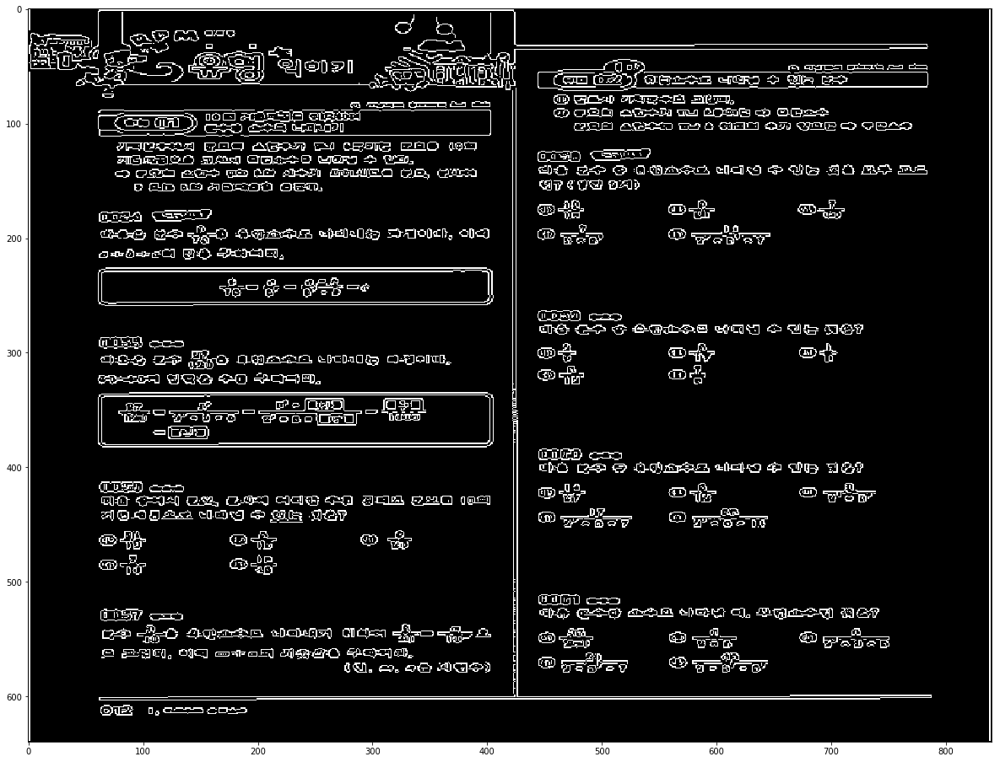

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

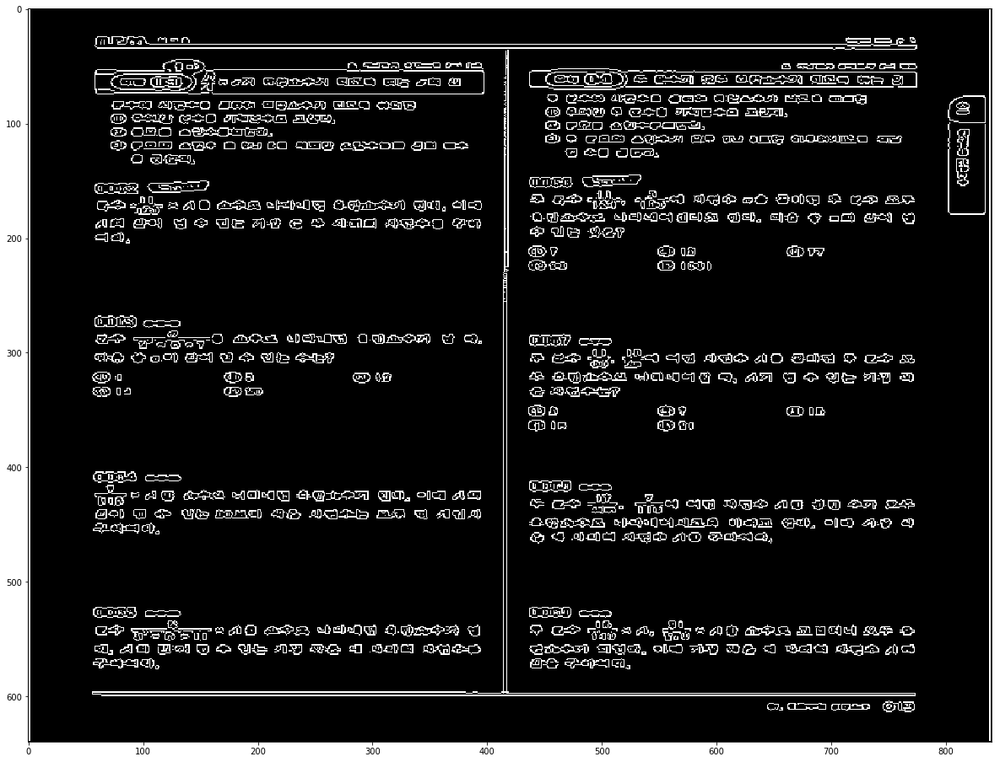

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

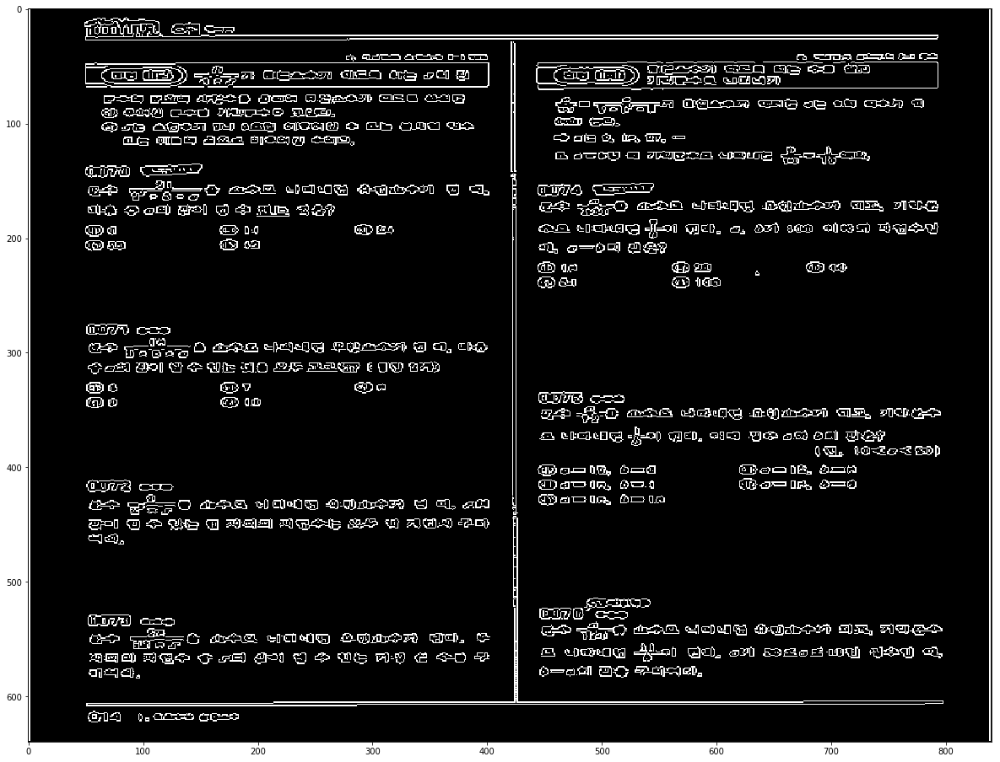

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

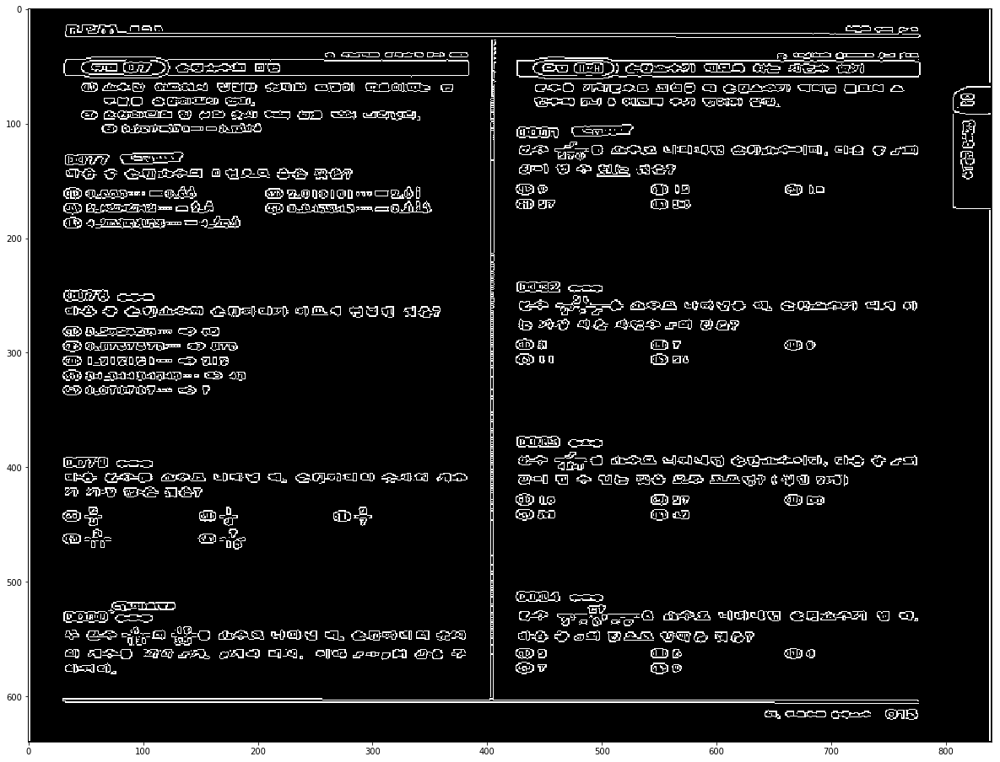

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

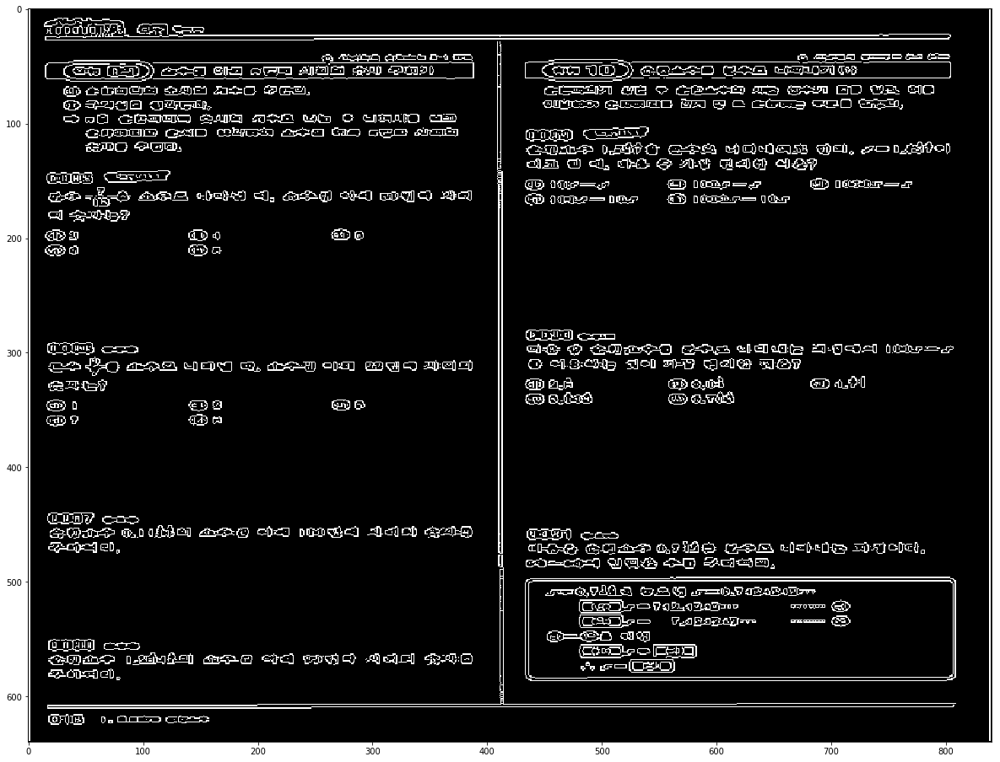

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

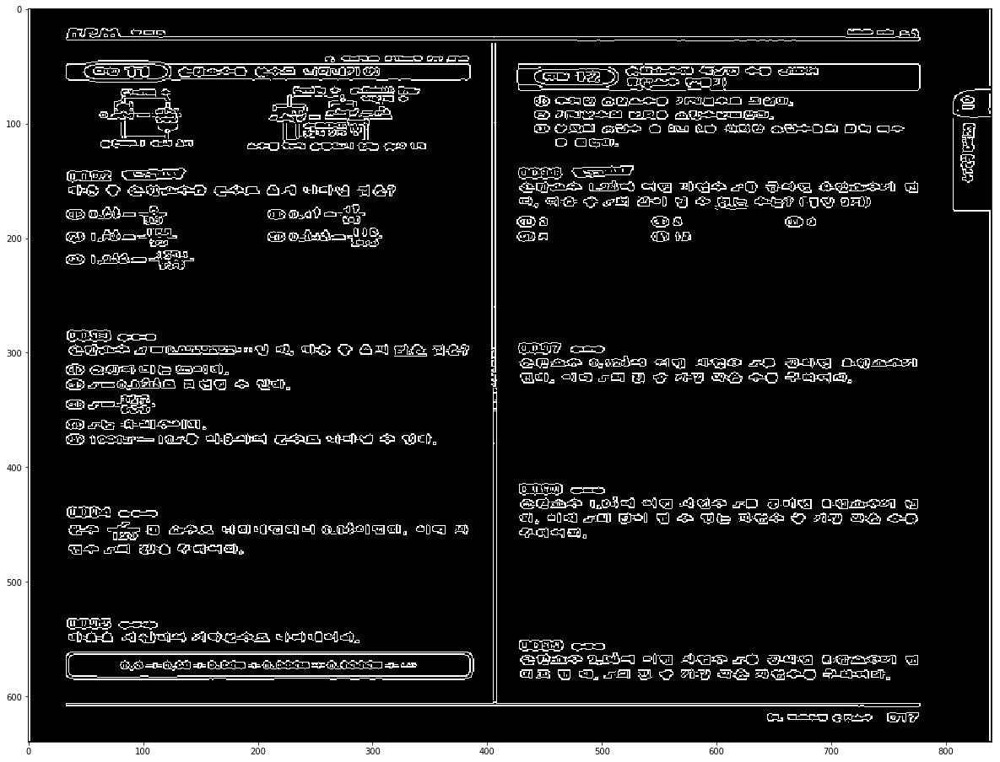

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

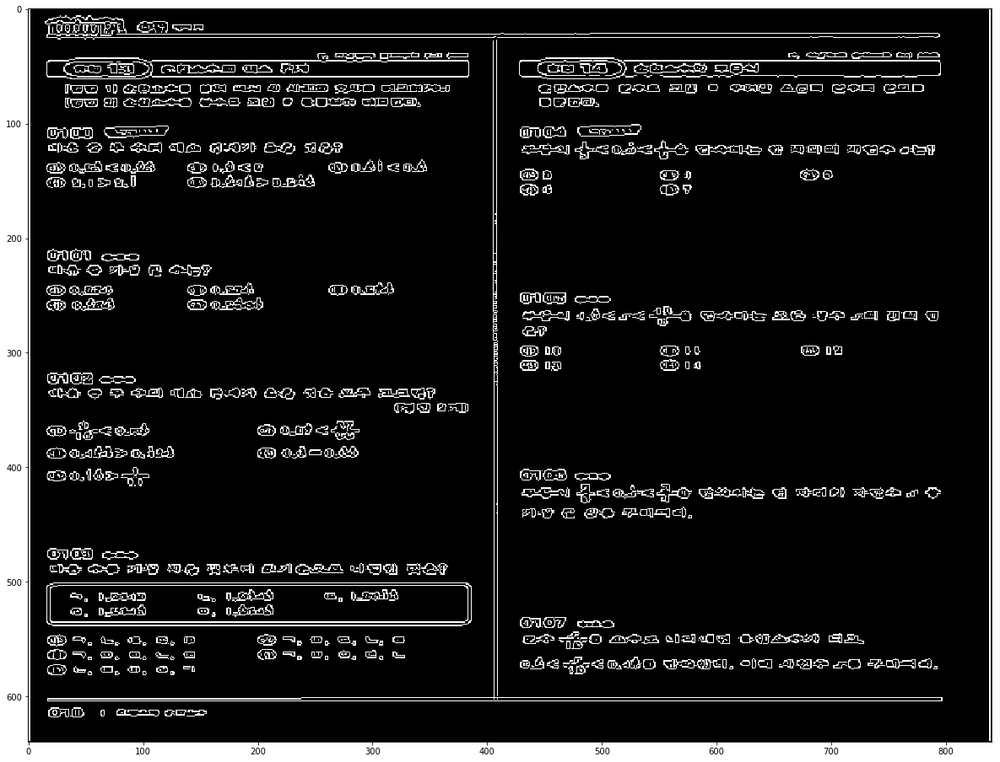

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

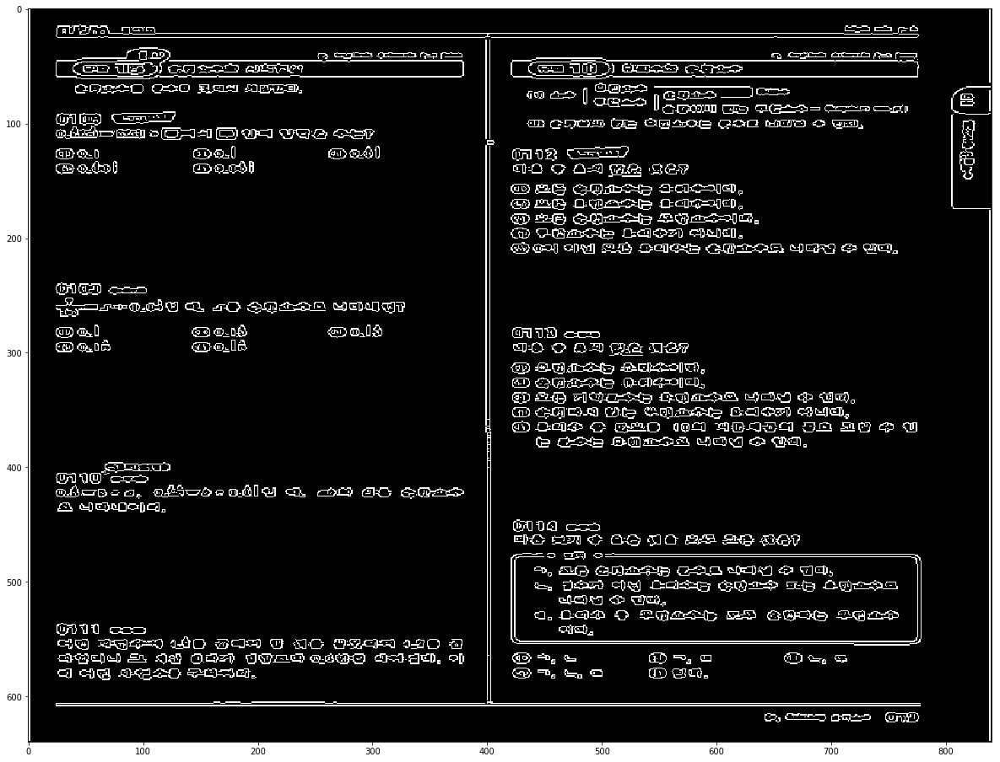

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

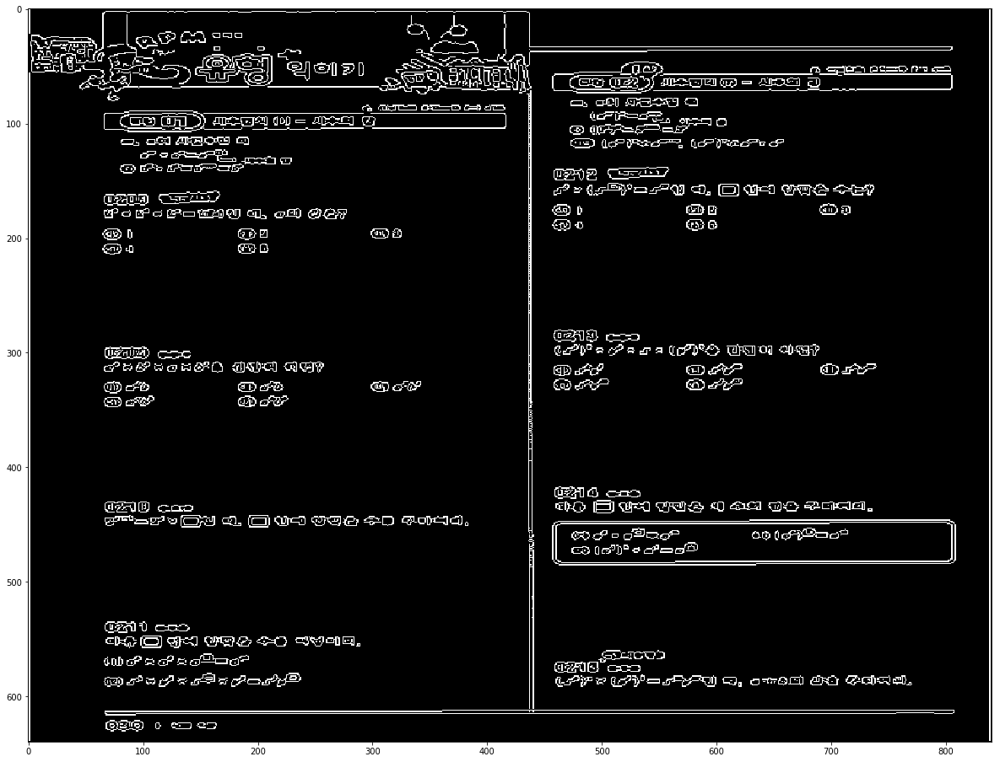

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [7]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

def denoiseWeakCon(img, y_value):
    height, width = img.shape
    upper_img = img[:y_value]
    upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
    img[:y_value] = upper_img
    return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
        fig, ax = plt.subplots(figsize=(30, 16))
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
            
        vmap = filters.median(vmap, selem=np.ones((12,12)))
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseWeakCon(vmap, int(h/4))
        vmap = standardize(vmap)
        
        ax1.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = removeFirst(vmap)
        vmap = denoiseBoundary(vmap, 5, 10)
        if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

        contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.

        for n, contour in enumerate(contours):
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()

#     edges = canny(img, sigma=.5)
#     thresh_val = threshold_otsu(img)
#     img = img > thresh_val
    img = canny(img)
    fig, ax = plt.subplots(figsize=(30, 16))
    ax.imshow(img, interpolation='nearest', cmap=plt.cm.gray)
#     p = Page(edges)
#     p.getContour()

    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

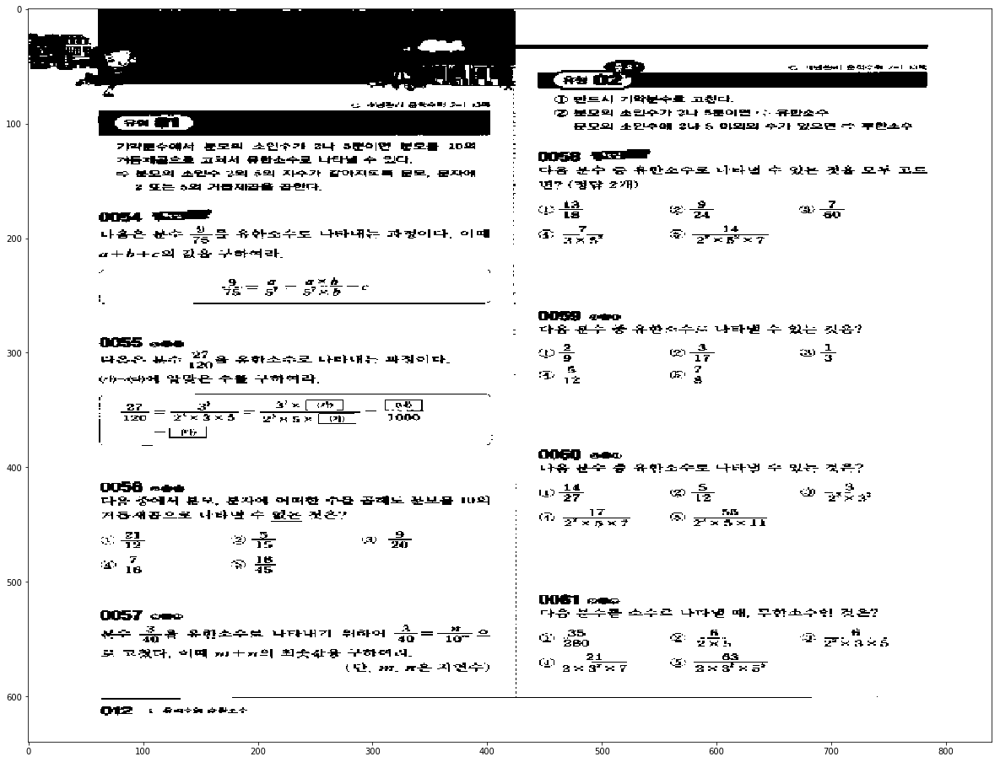

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

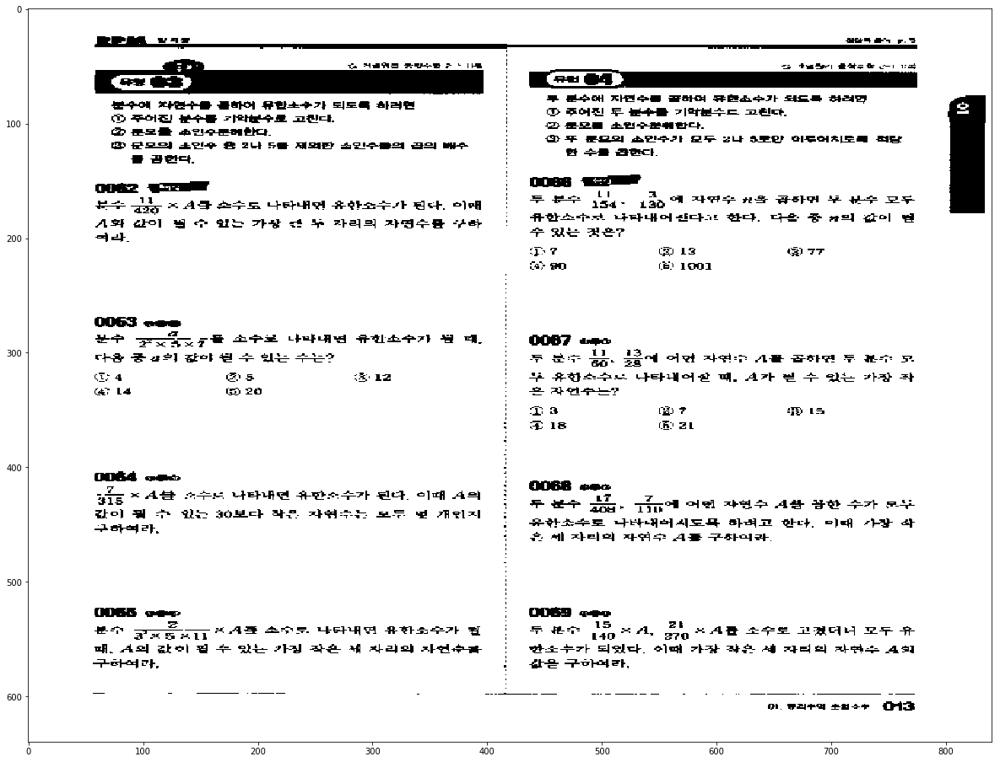

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

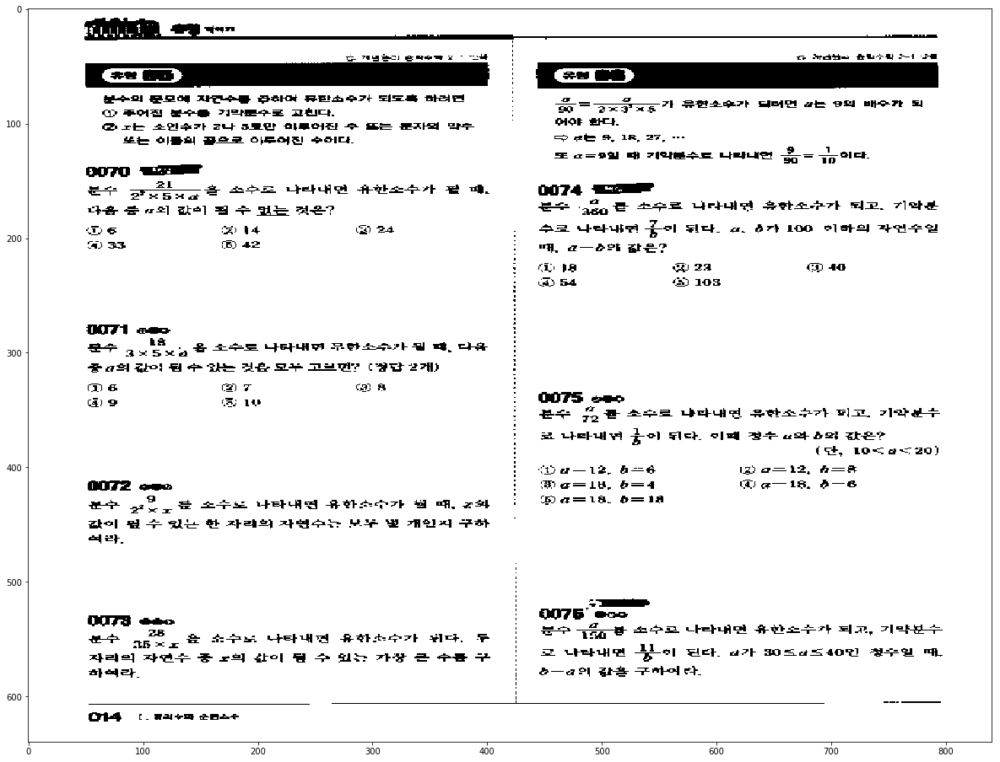

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

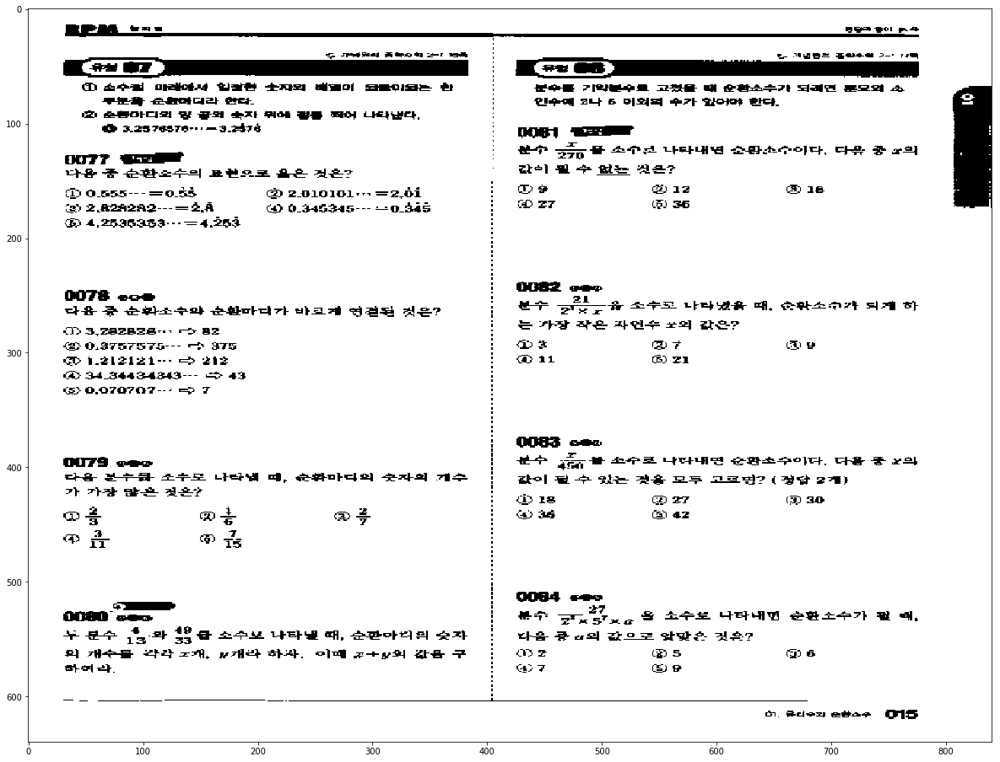

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

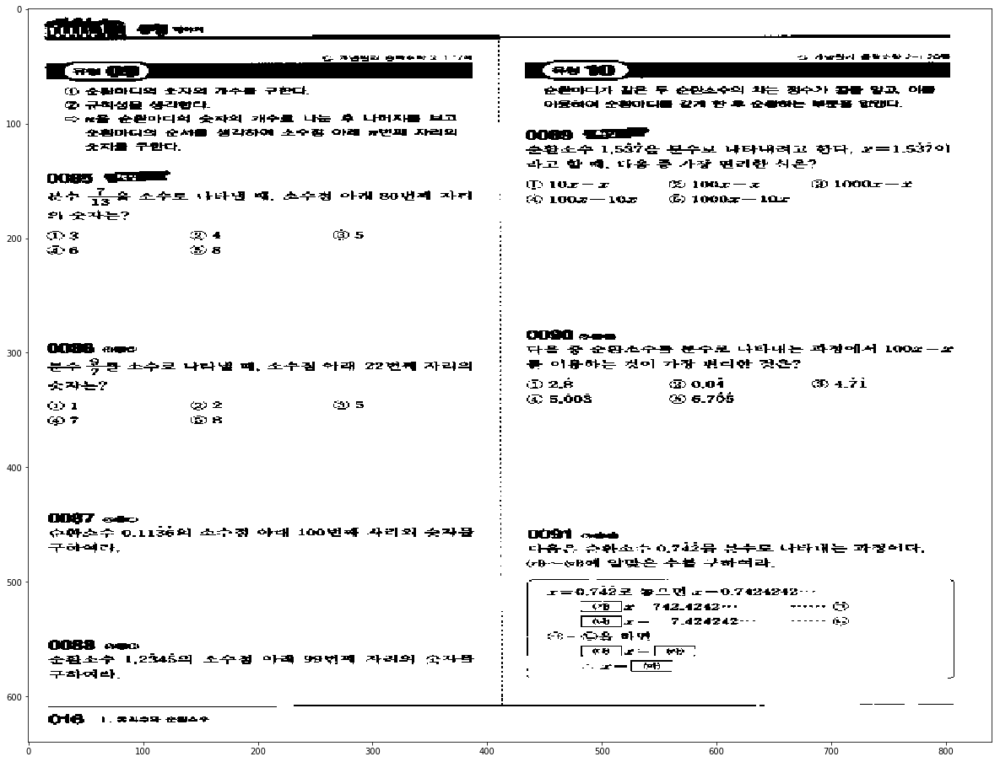

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

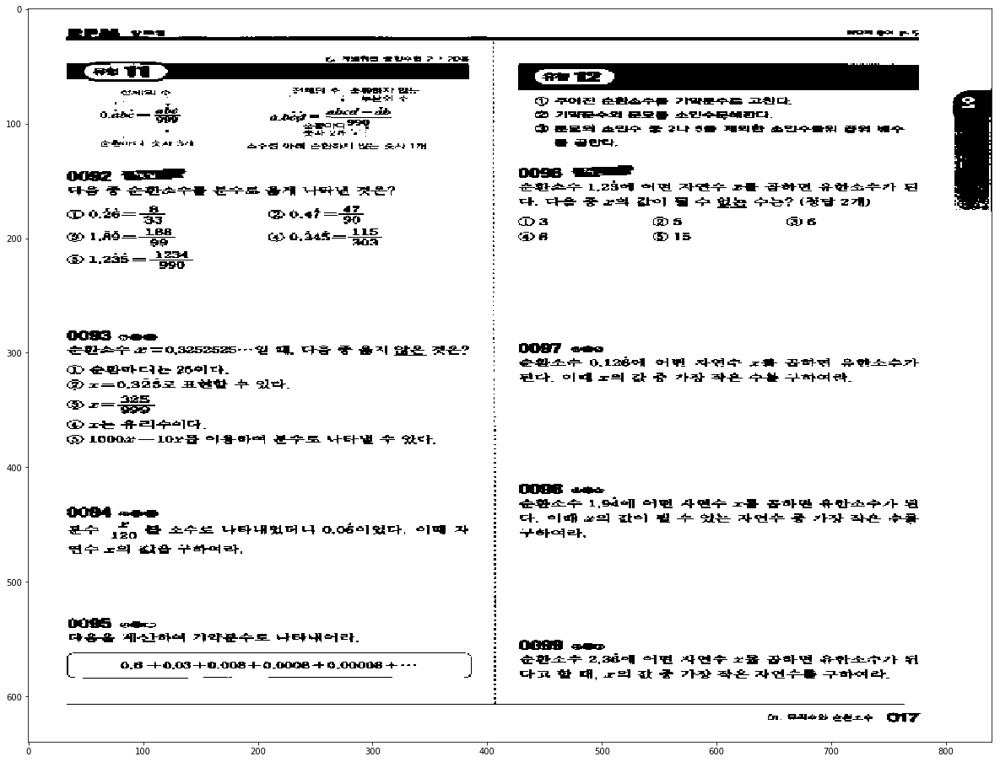

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

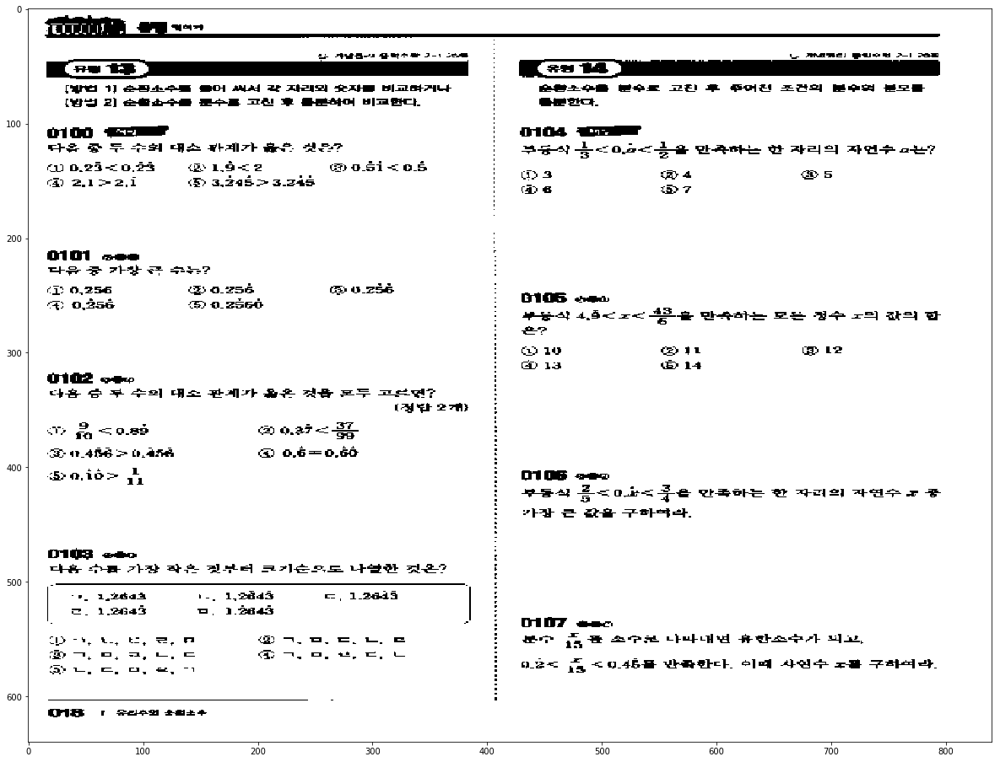

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

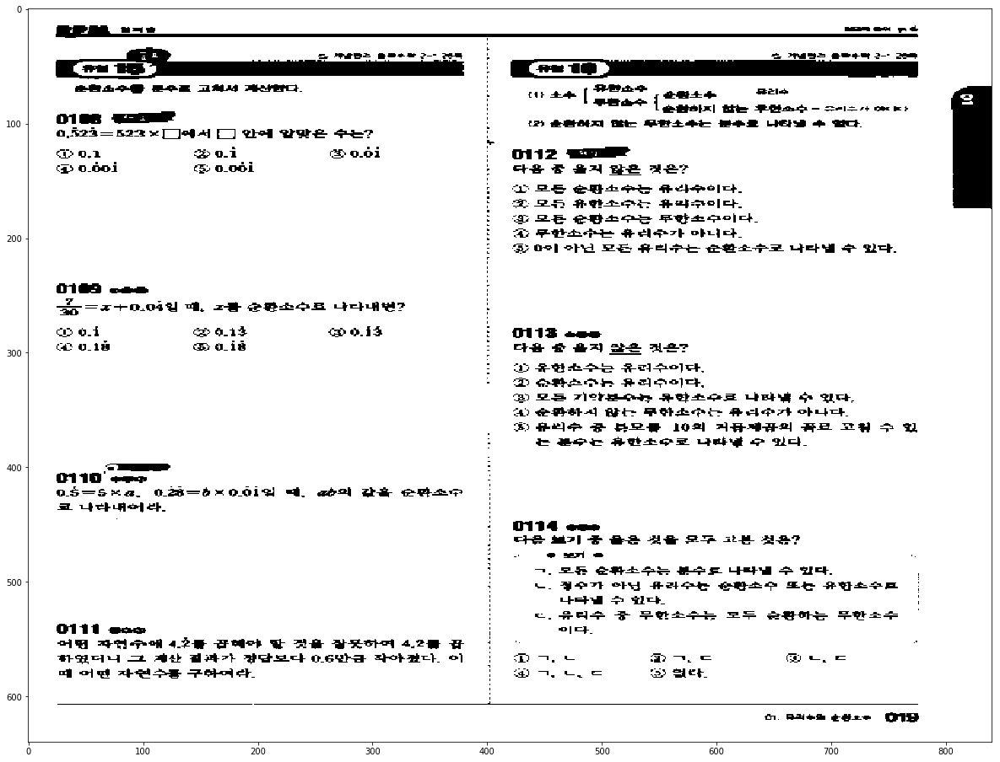

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

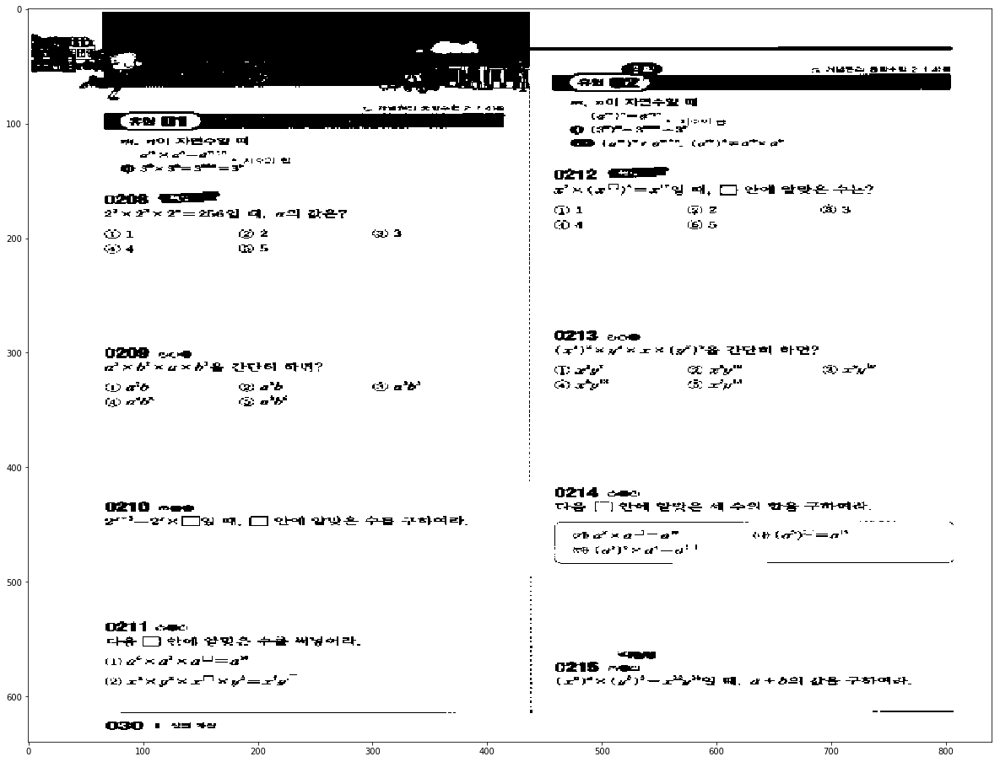

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

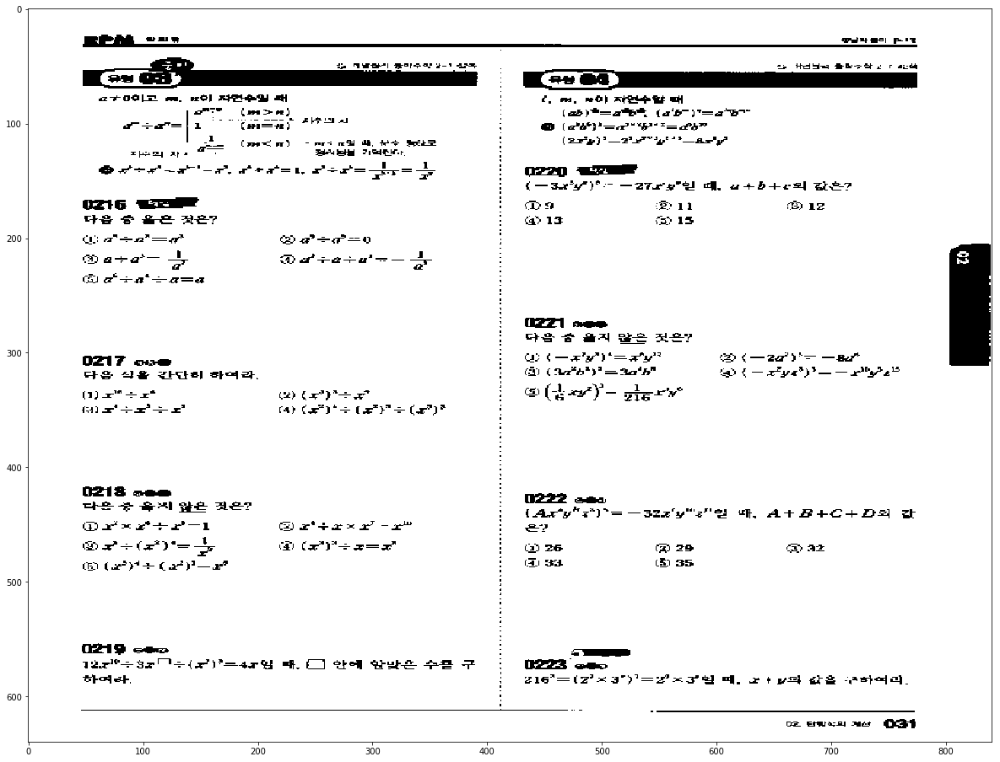

0  Pattern
IMG =  032 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

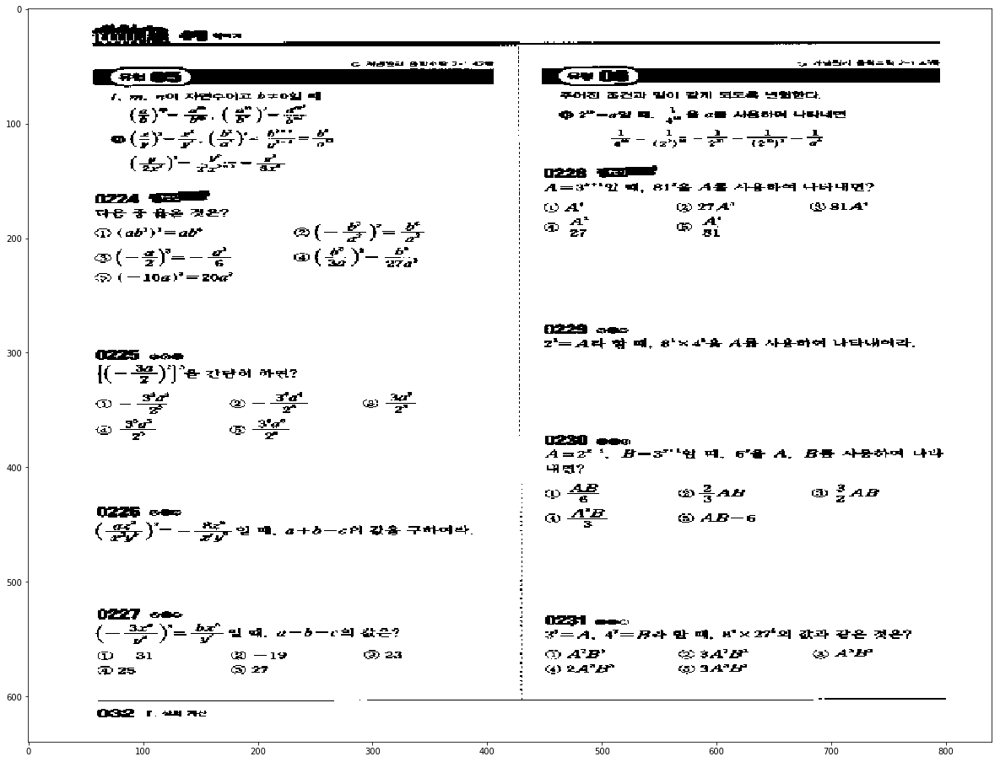

3  Pattern
IMG =  033 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

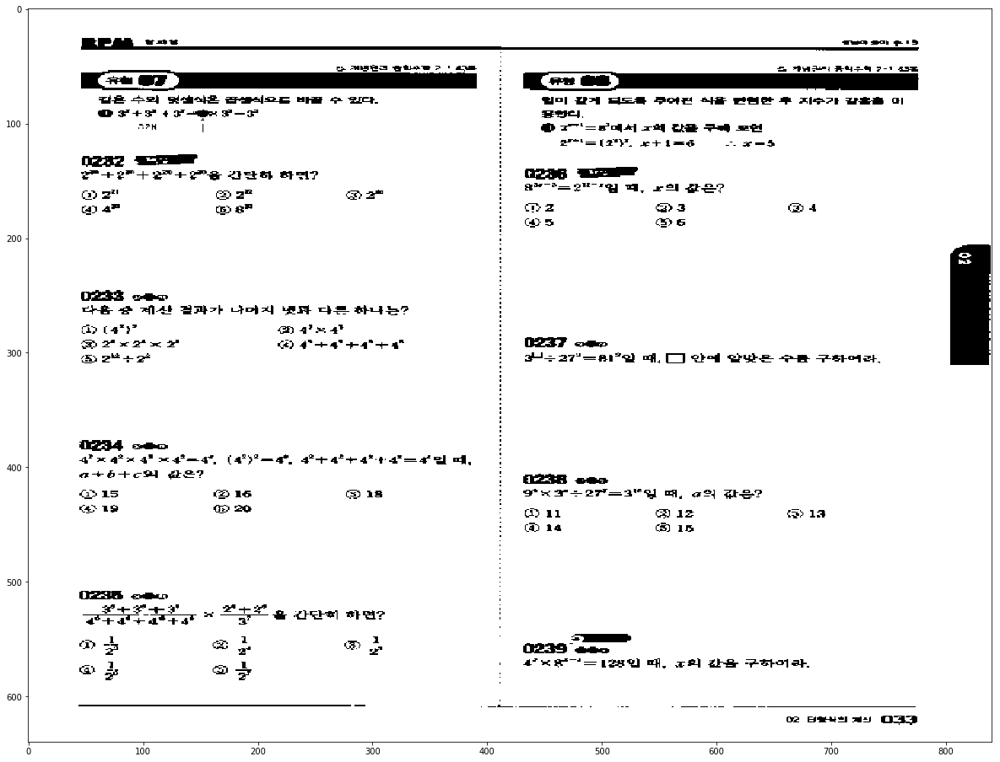

3  Pattern
IMG =  034 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

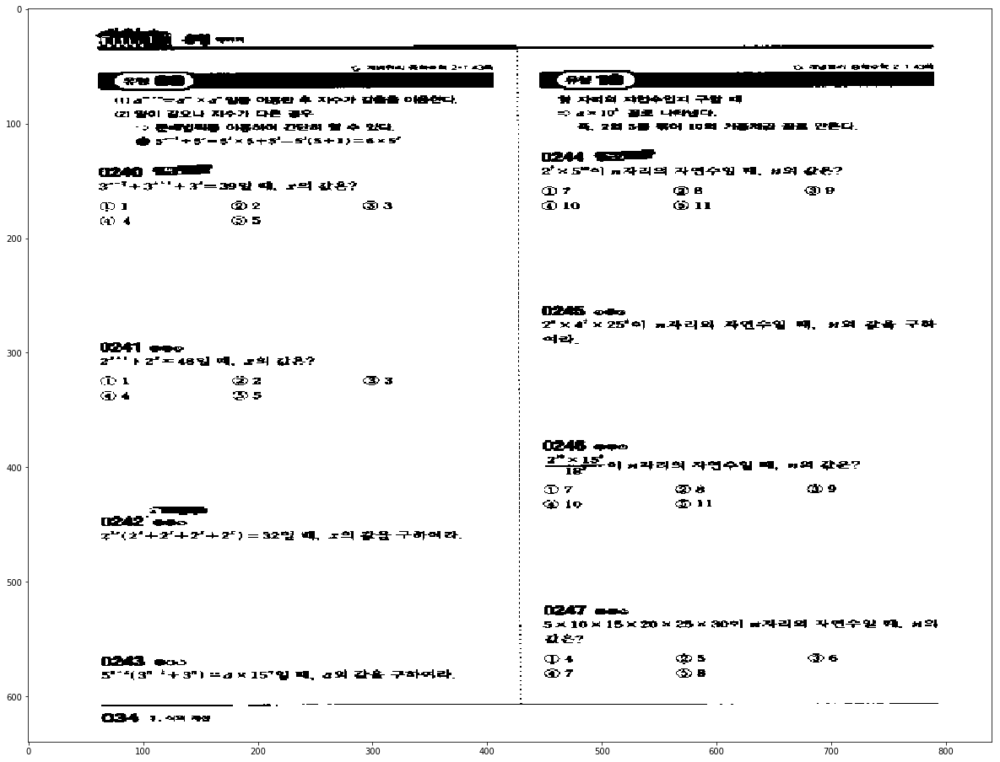

0  Pattern
IMG =  035 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

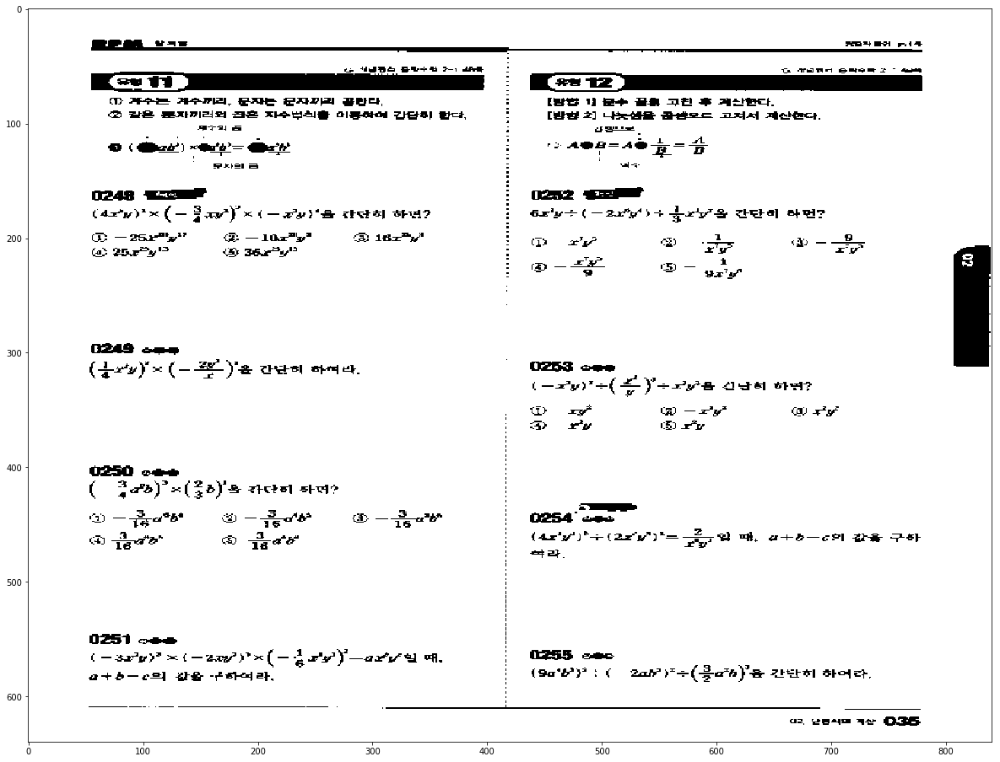

2  Pattern
IMG =  036 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

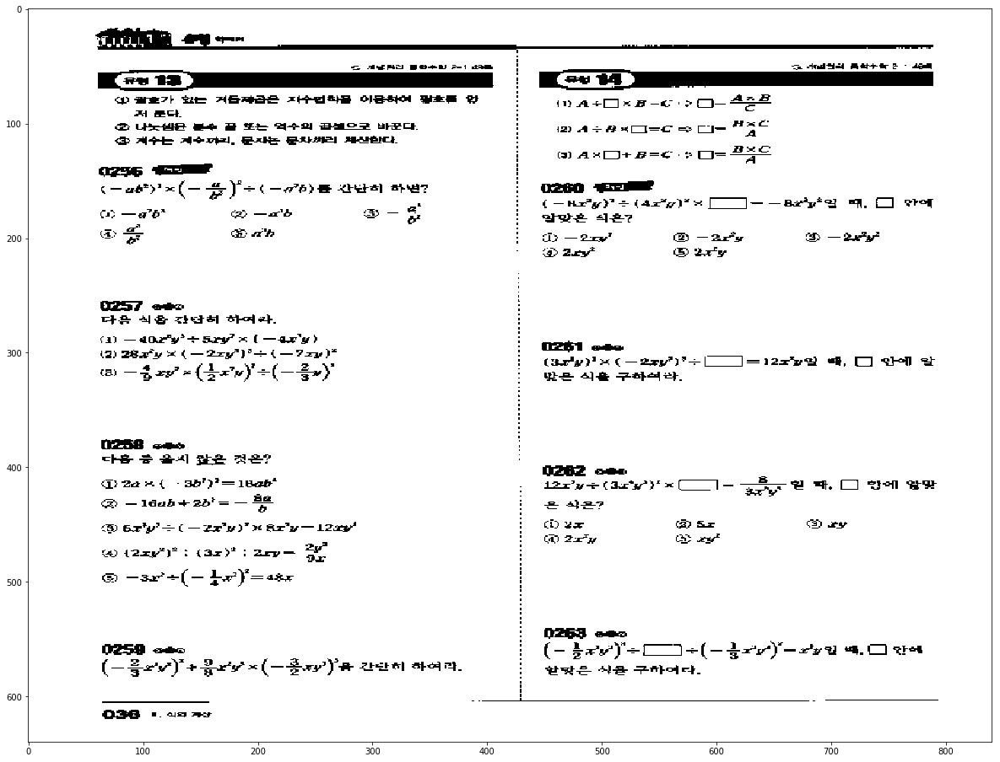

1  Pattern
IMG =  037 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

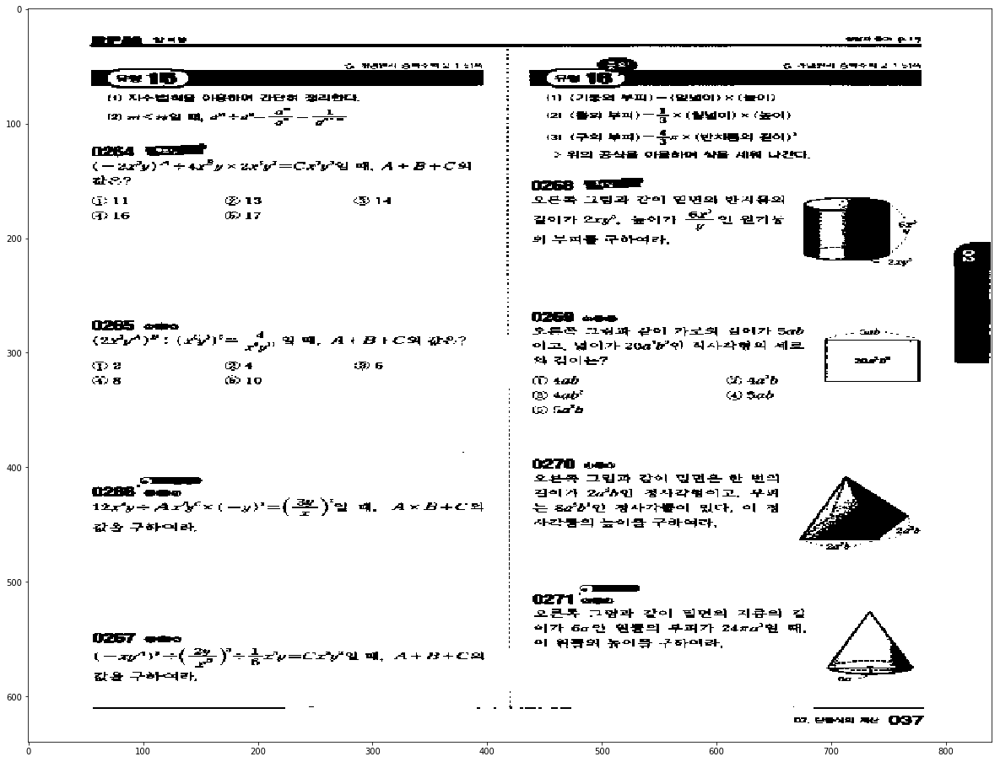

1  Pattern
IMG =  046 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

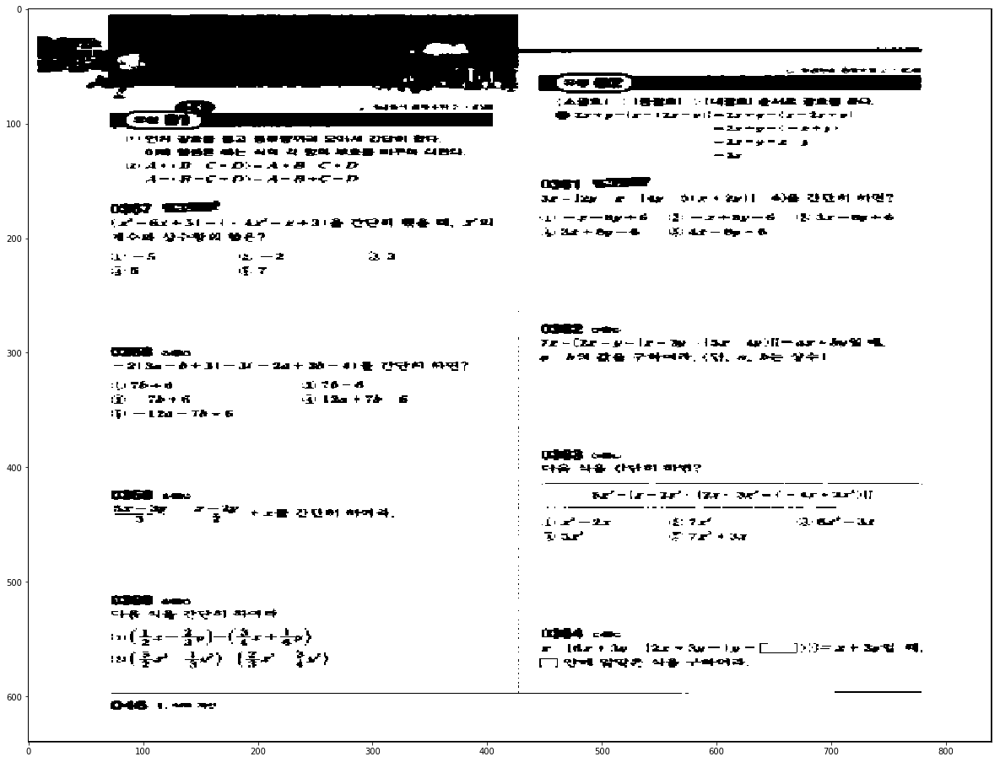

2  Pattern
IMG =  047 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

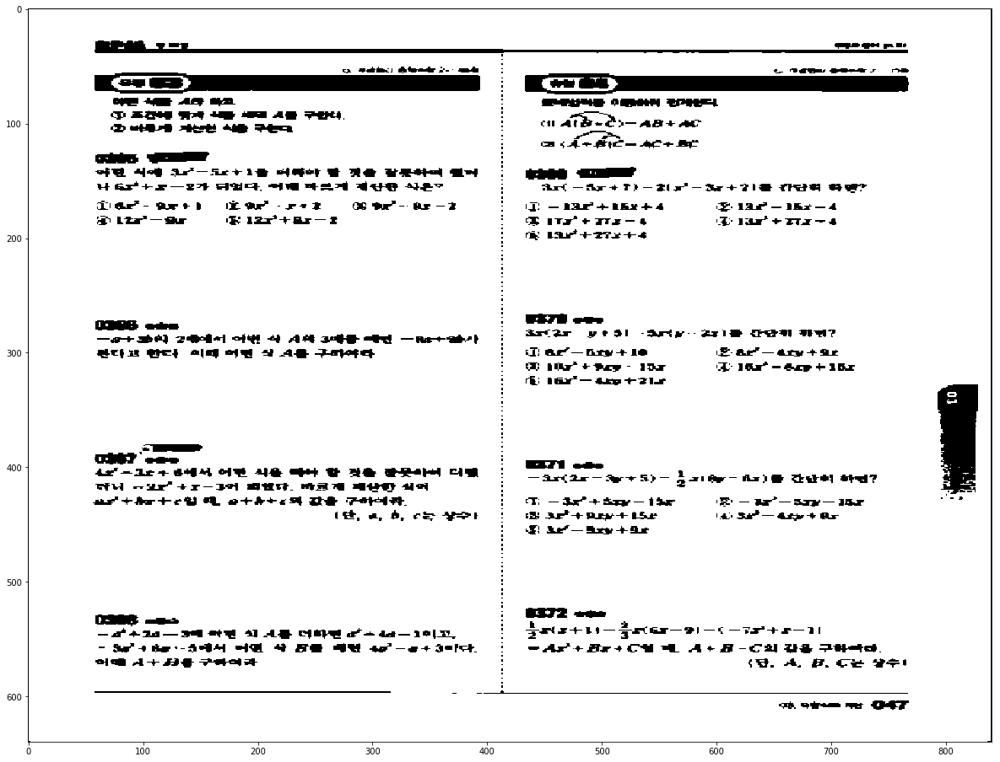

0  Pattern
IMG =  048 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

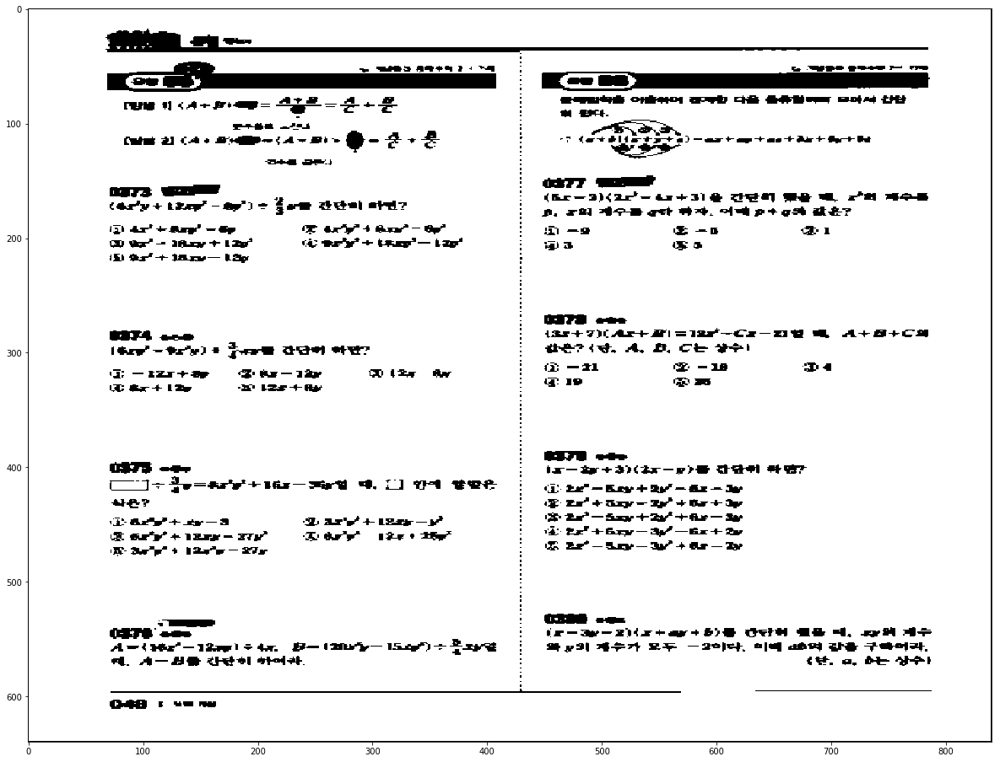

3  Pattern
IMG =  049 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

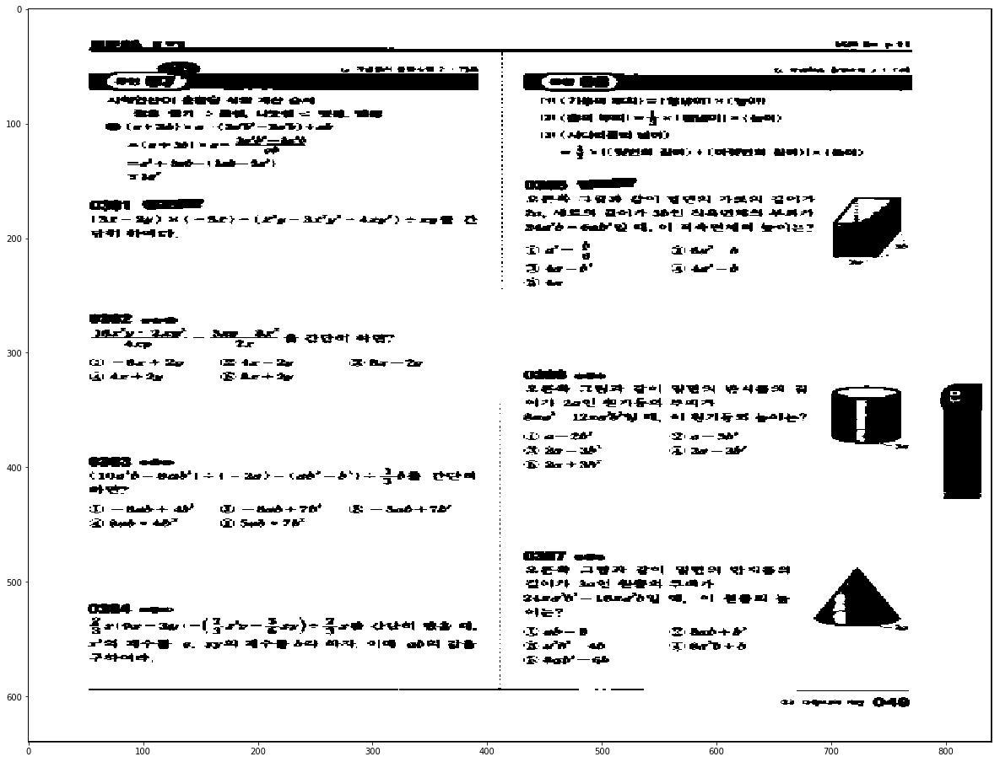

3  Pattern
IMG =  050 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

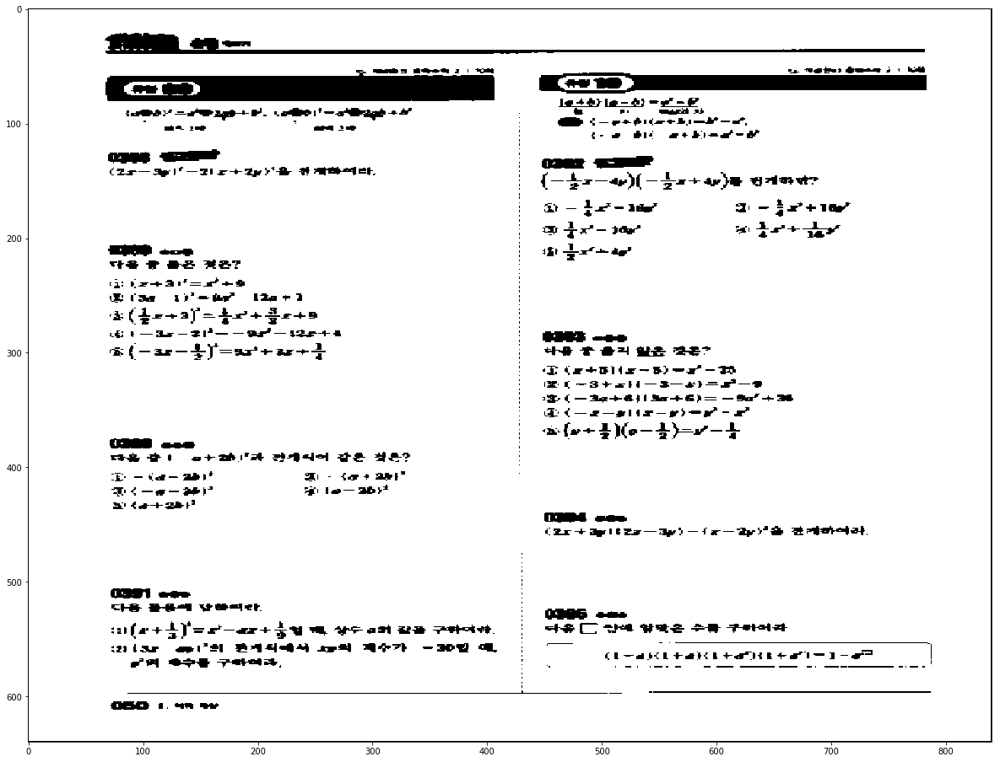

0  Pattern
IMG =  051 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

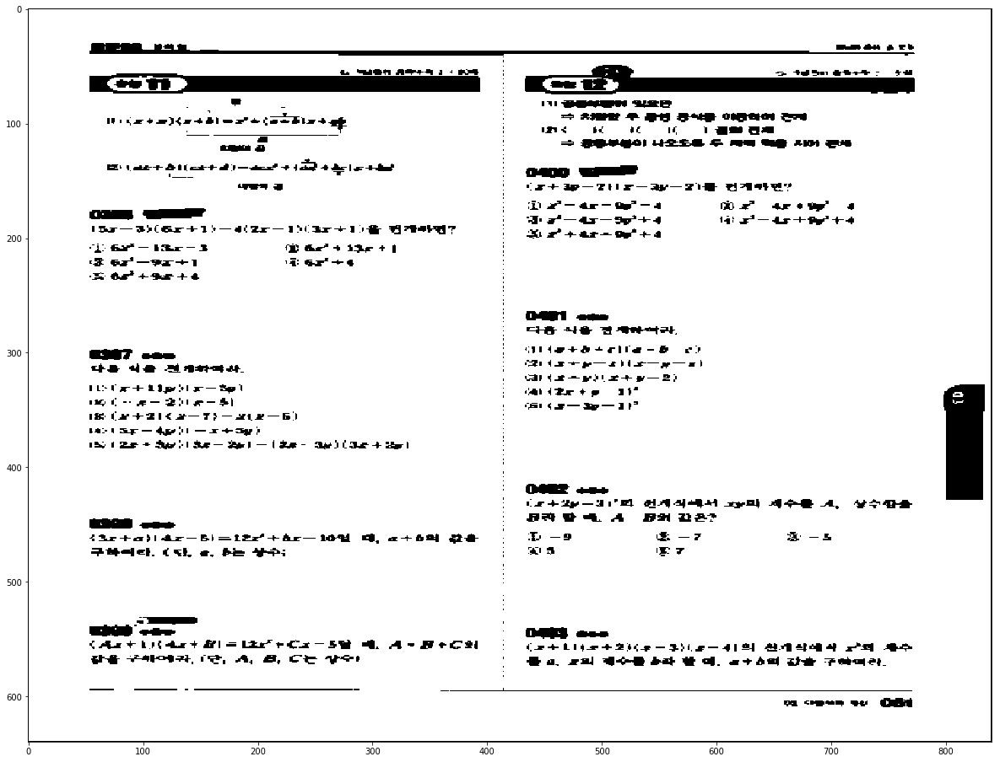

2  Pattern
IMG =  052 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

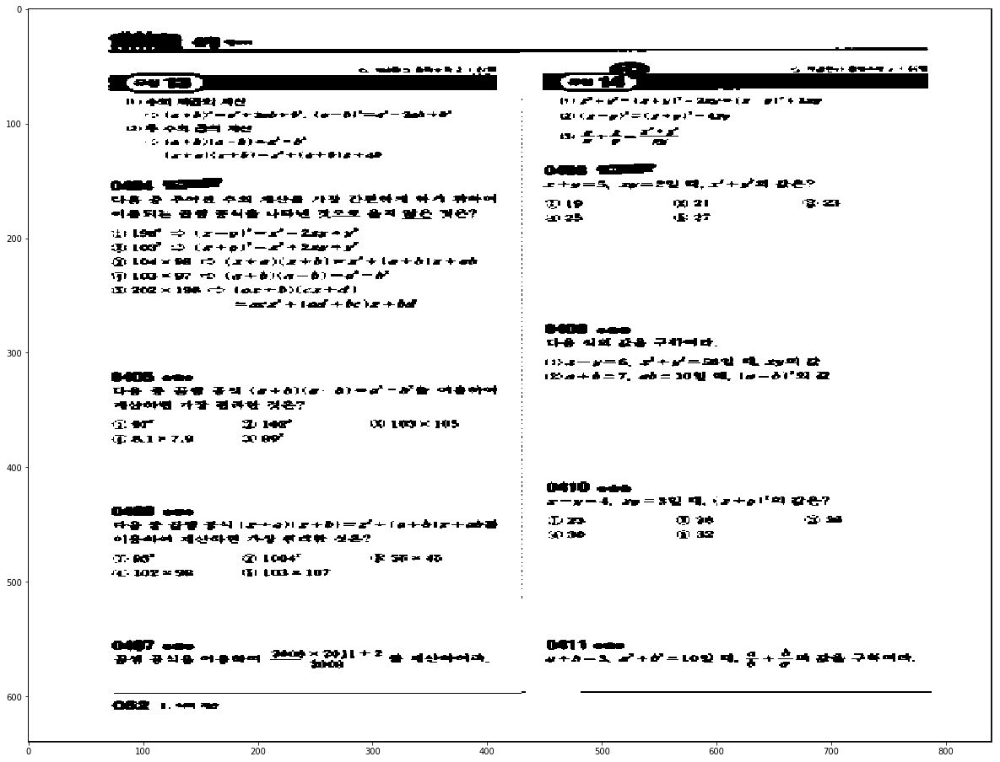

1  Pattern
IMG =  053 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

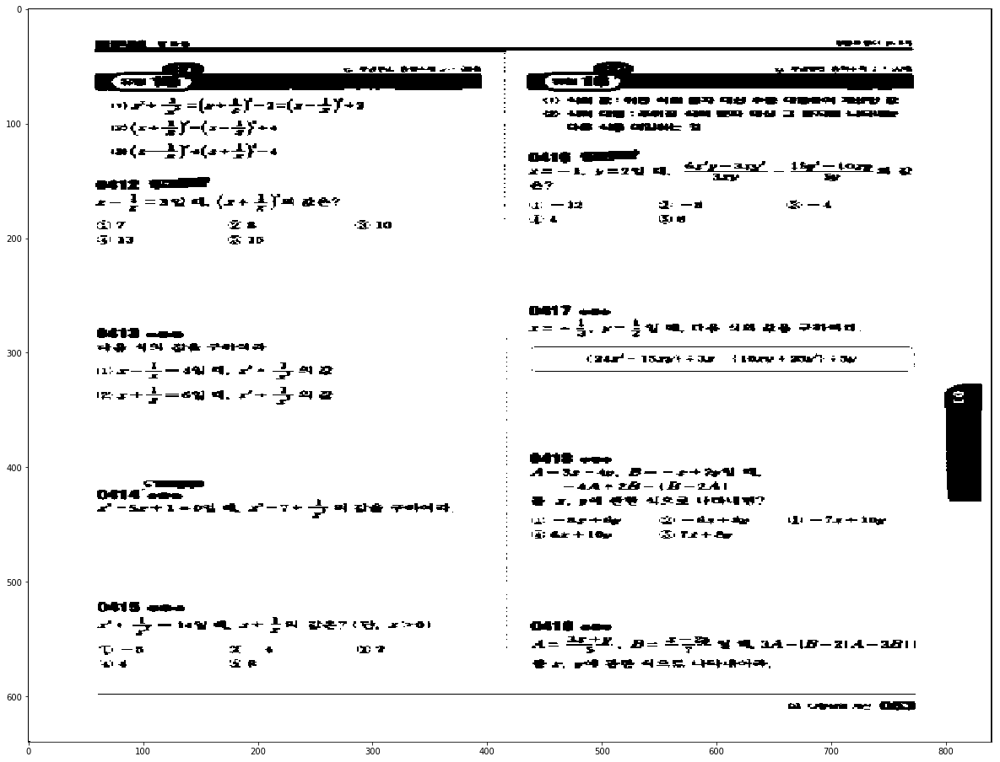

1  Pattern
IMG =  054 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

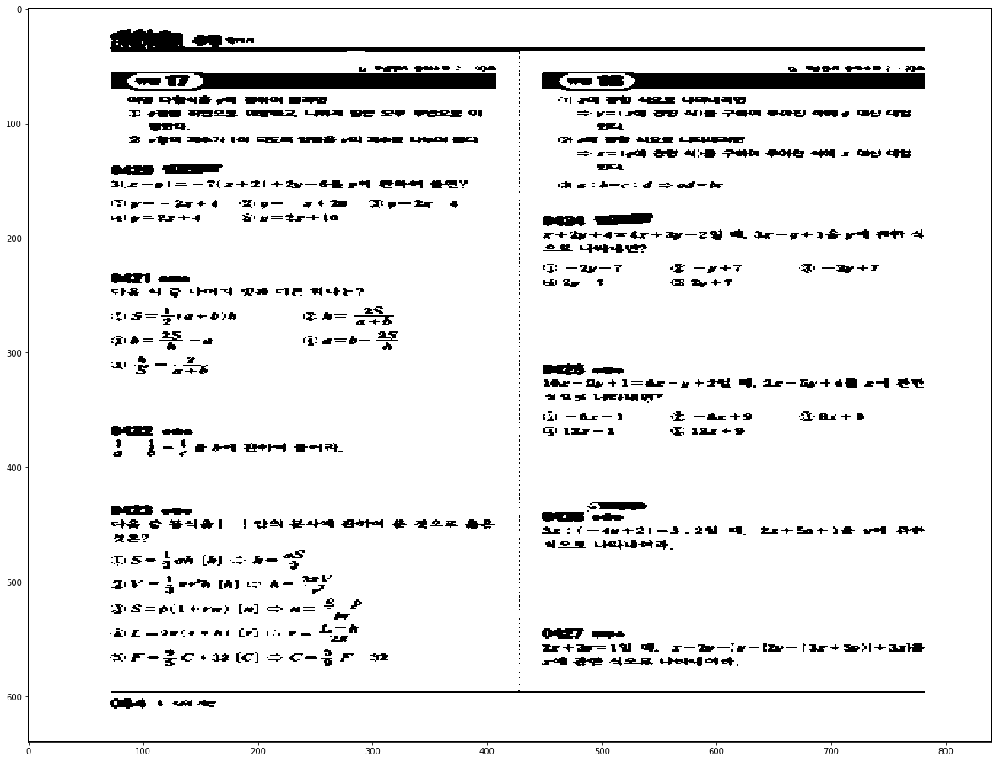

2  Pattern
IMG =  055 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

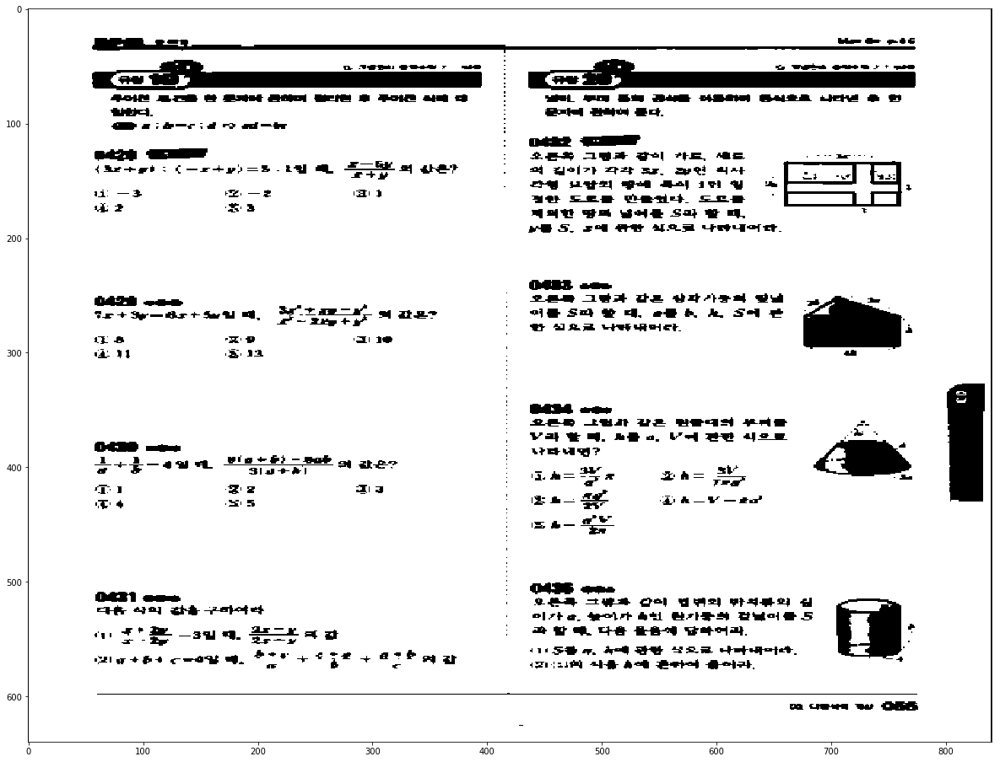

0  Pattern
IMG =  066 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

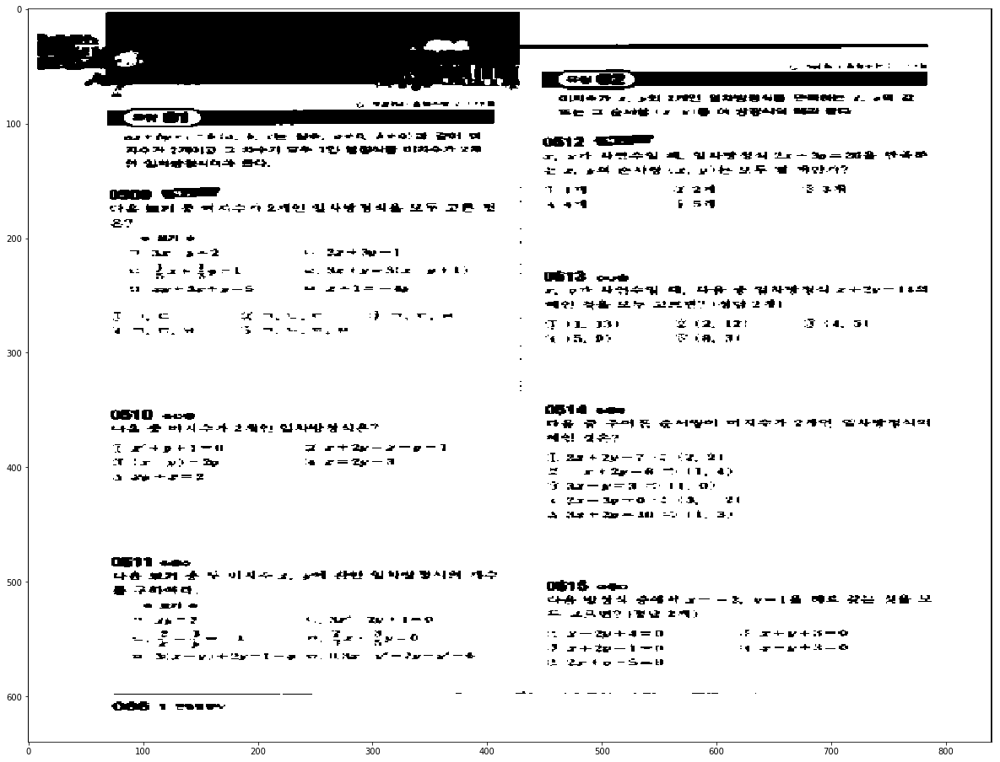

3  Pattern
IMG =  068 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

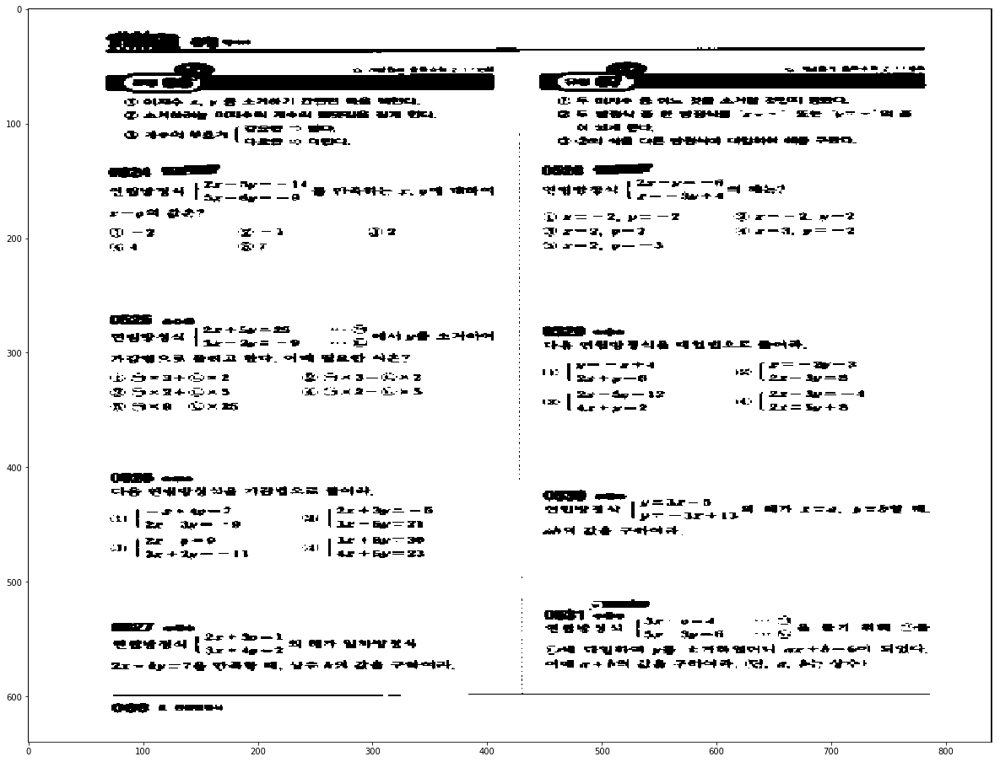

3  Pattern
IMG =  069 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

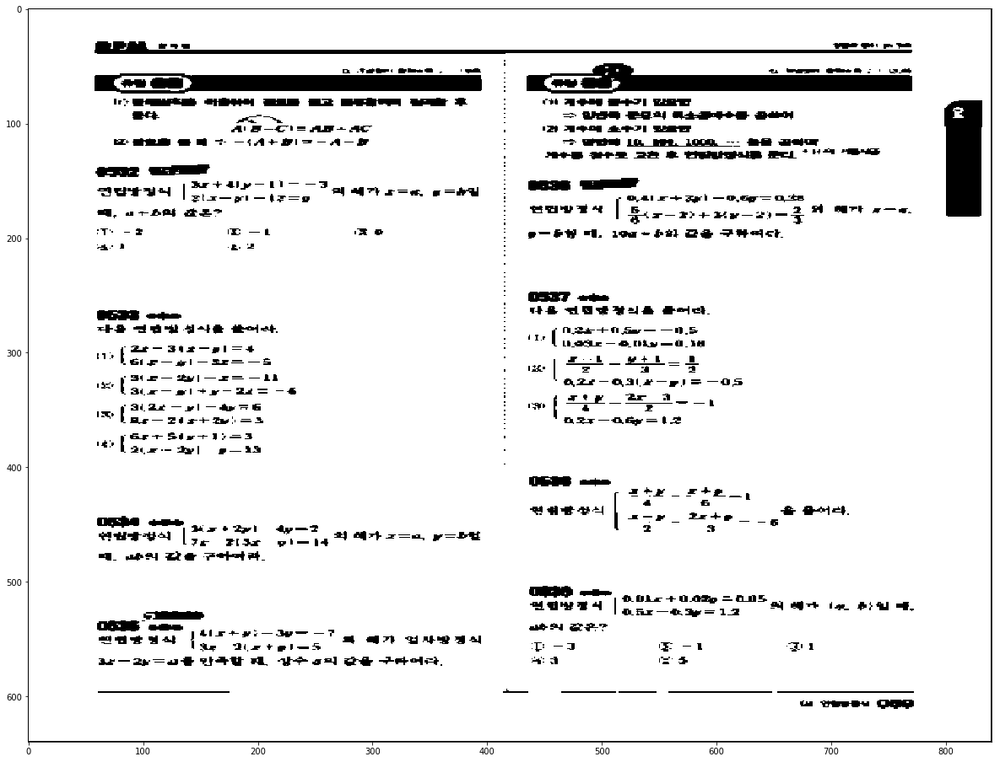

0  Pattern
IMG =  071 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

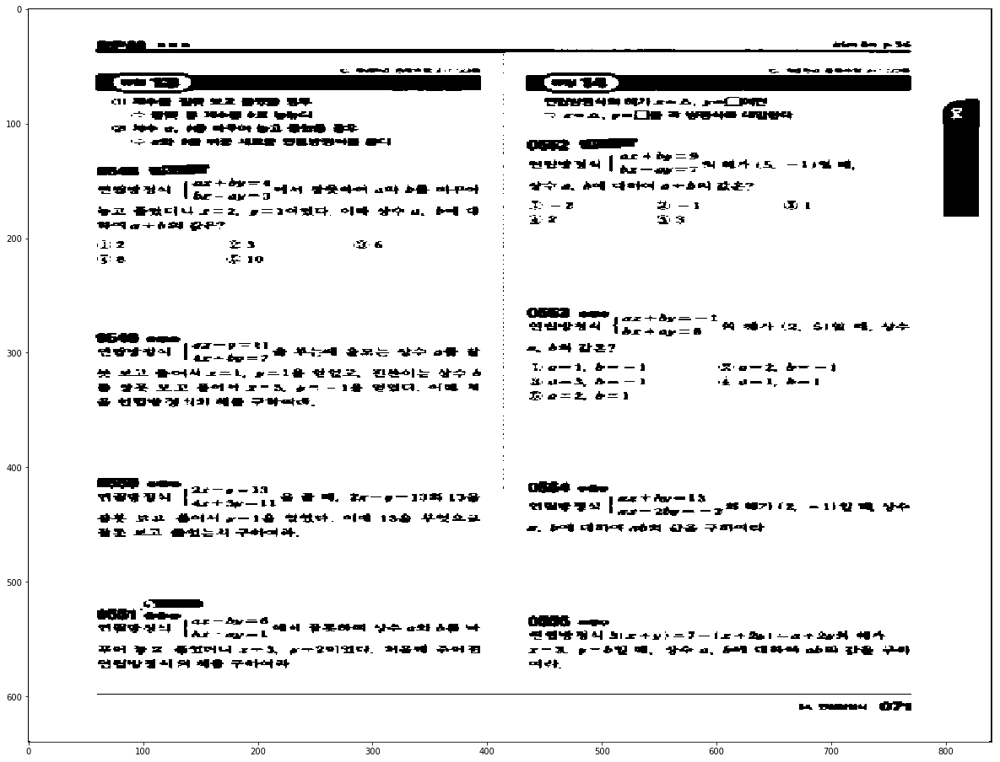

2  Pattern
IMG =  072 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

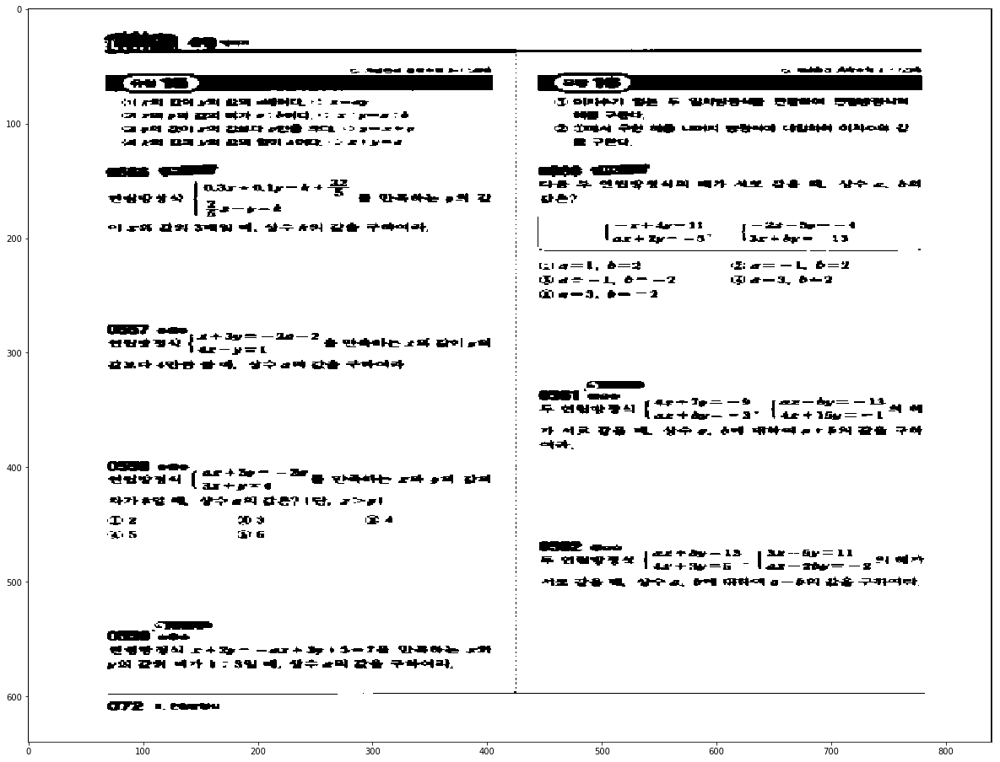

1  Pattern
IMG =  073 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

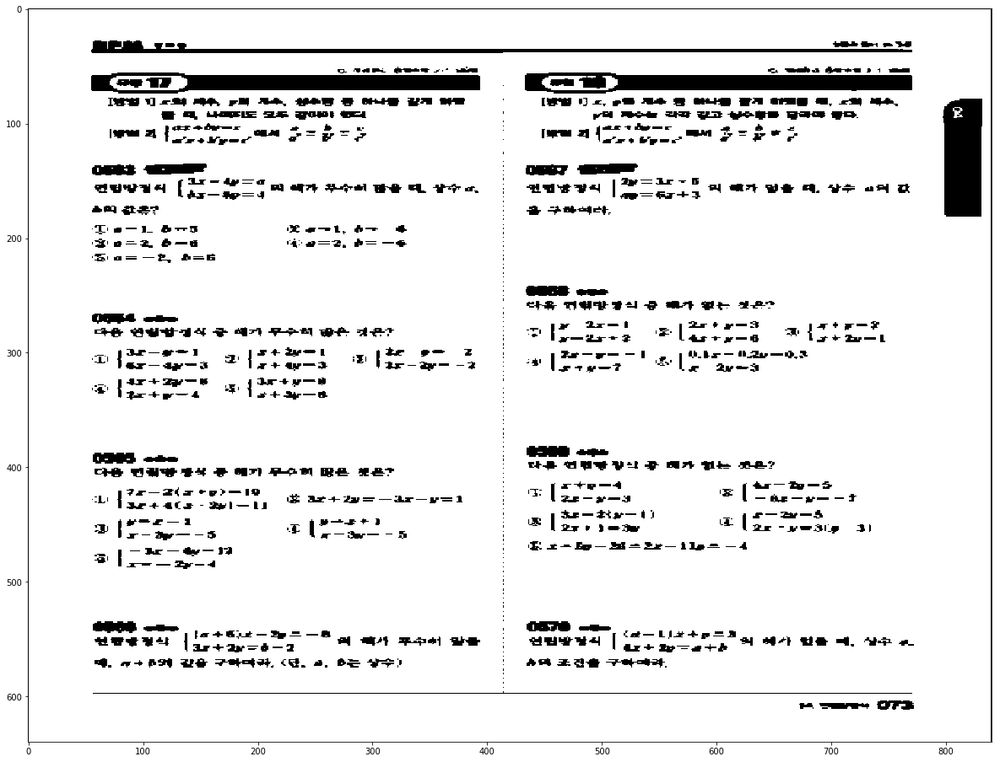

1  Pattern
IMG =  081 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

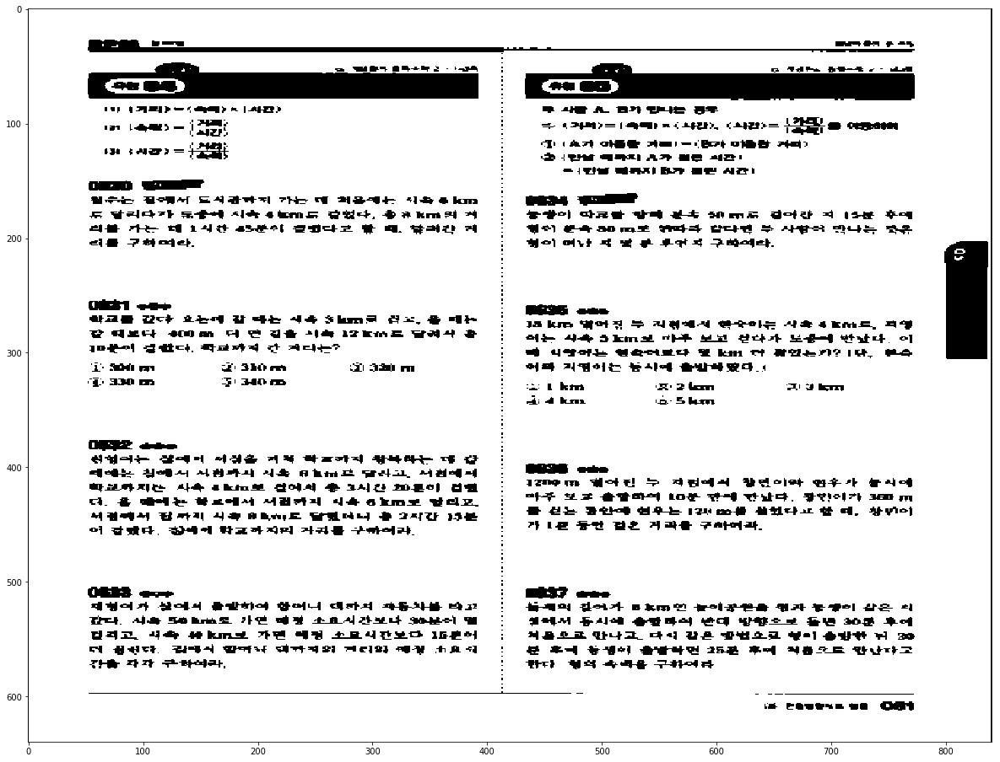

2  Pattern
IMG =  082 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

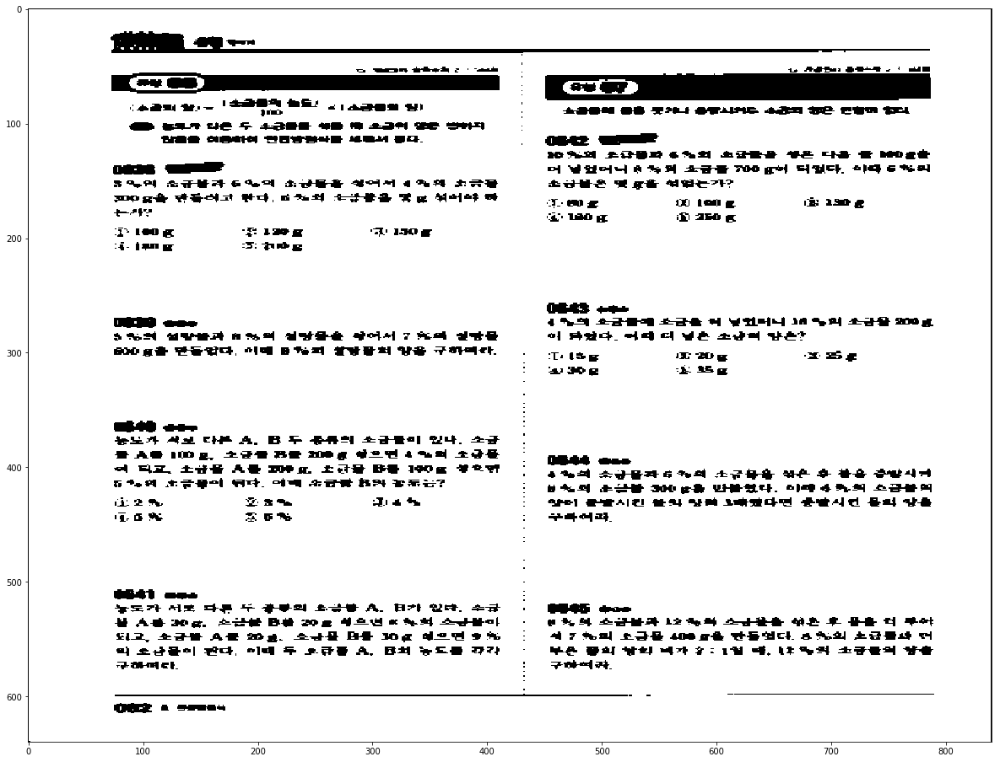

0  Pattern
IMG =  083 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

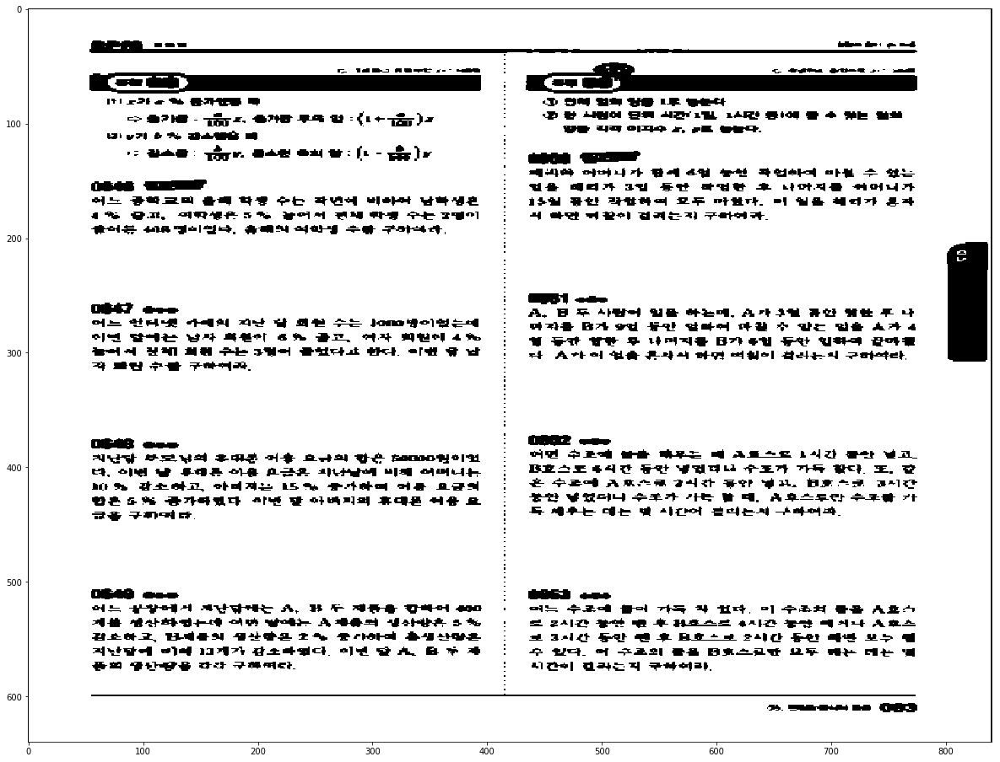

3  Pattern
IMG =  097 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

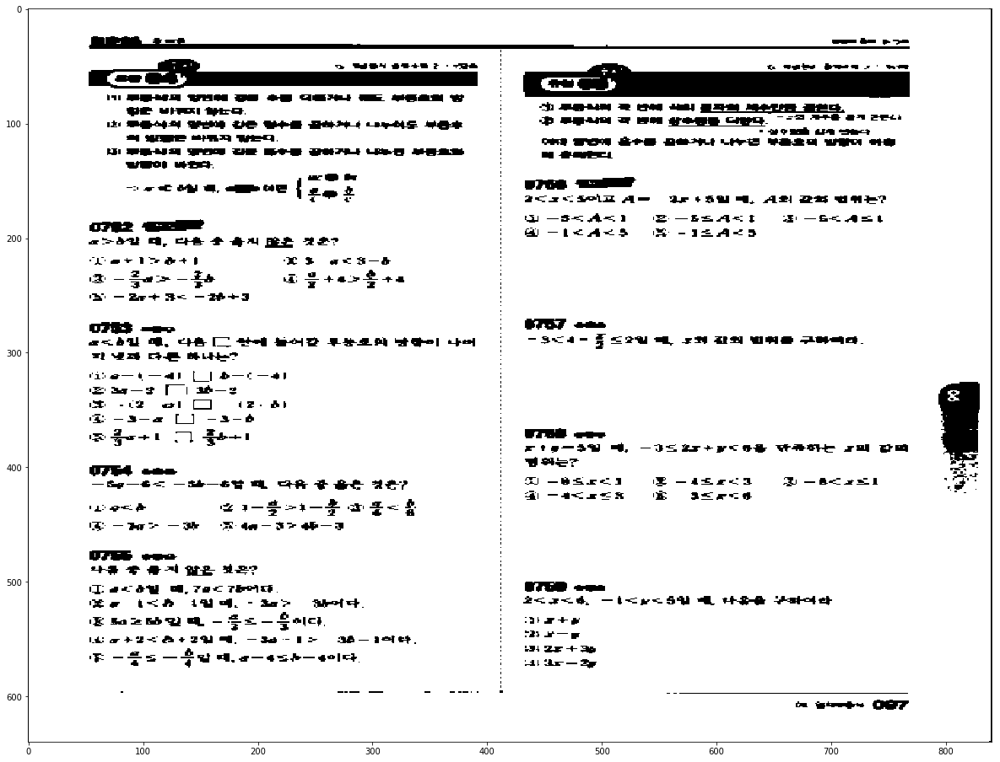

3  Pattern
IMG =  099 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

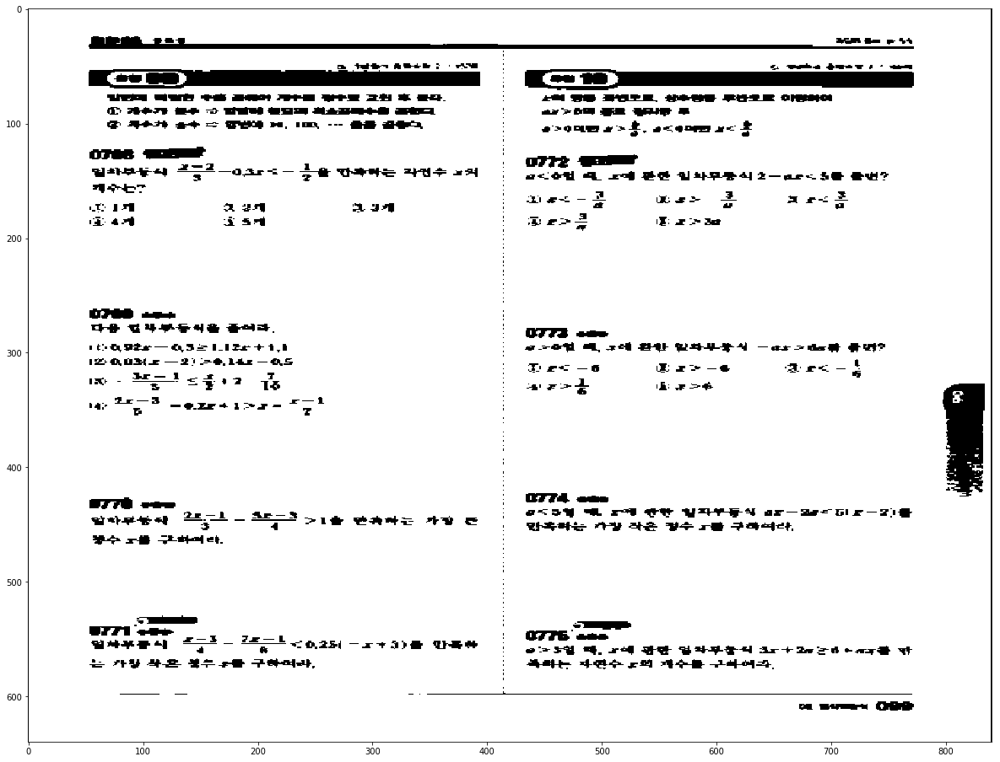

0  Pattern
IMG =  100 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

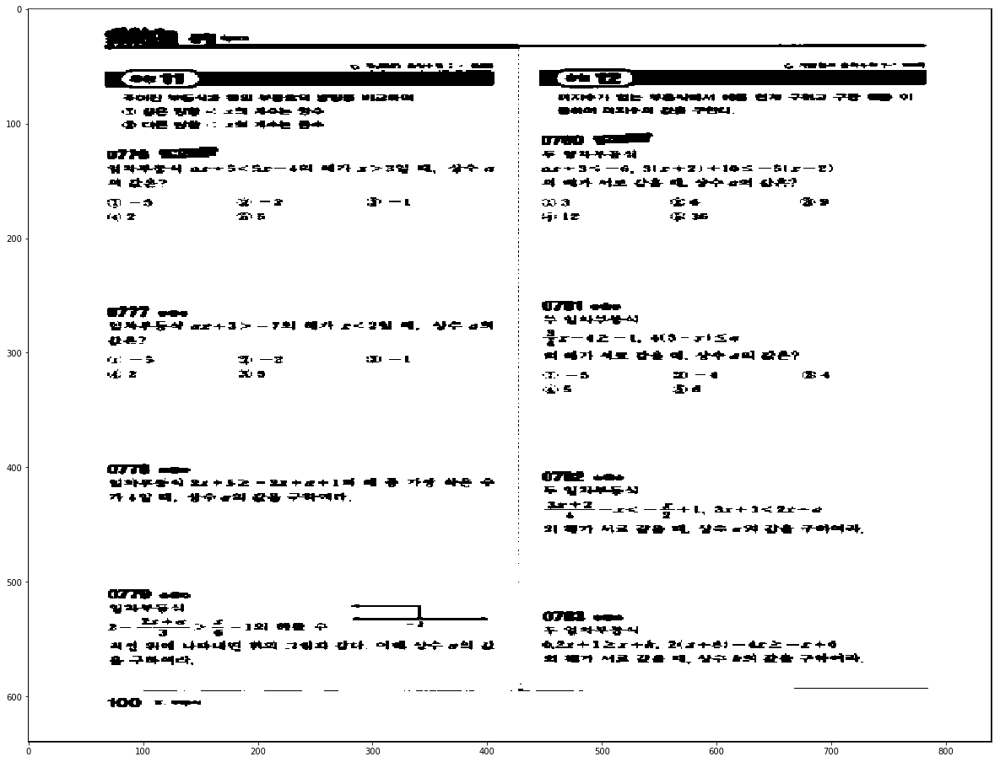

2  Pattern
IMG =  102 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

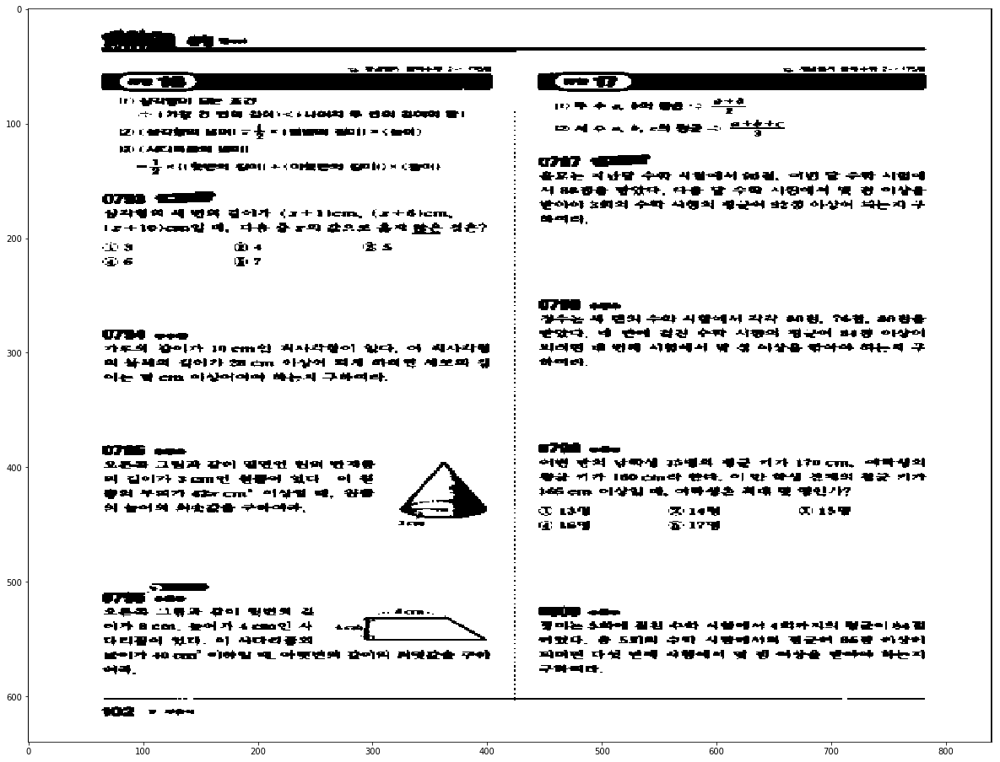

1  Pattern
IMG =  103 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

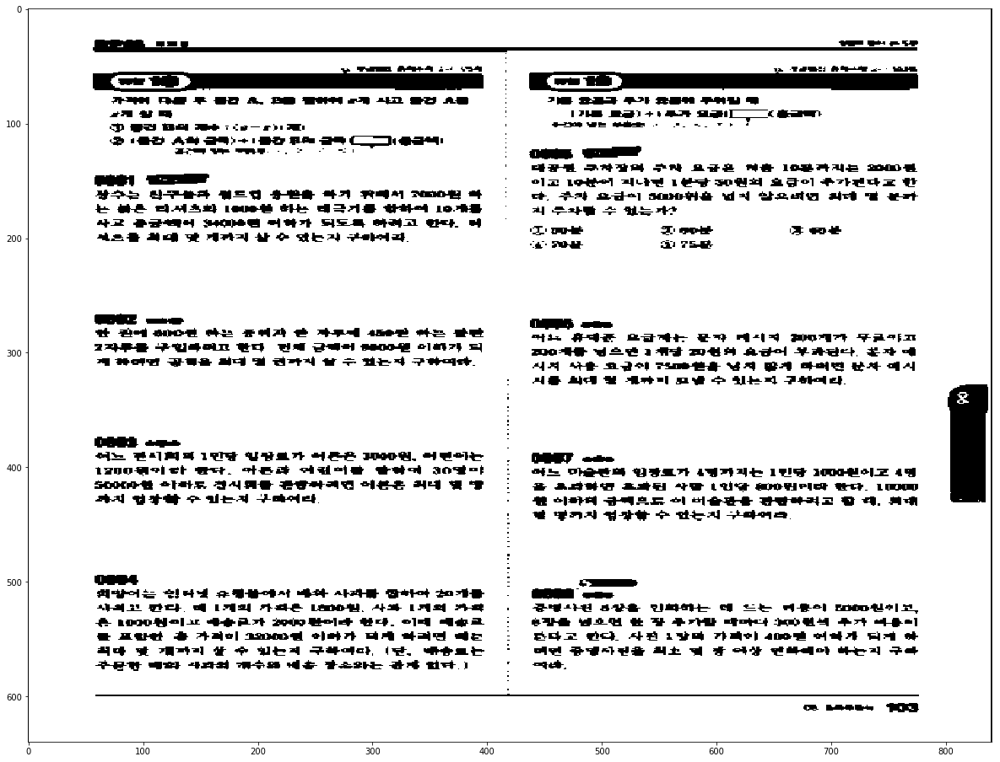

1  Pattern
IMG =  104 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

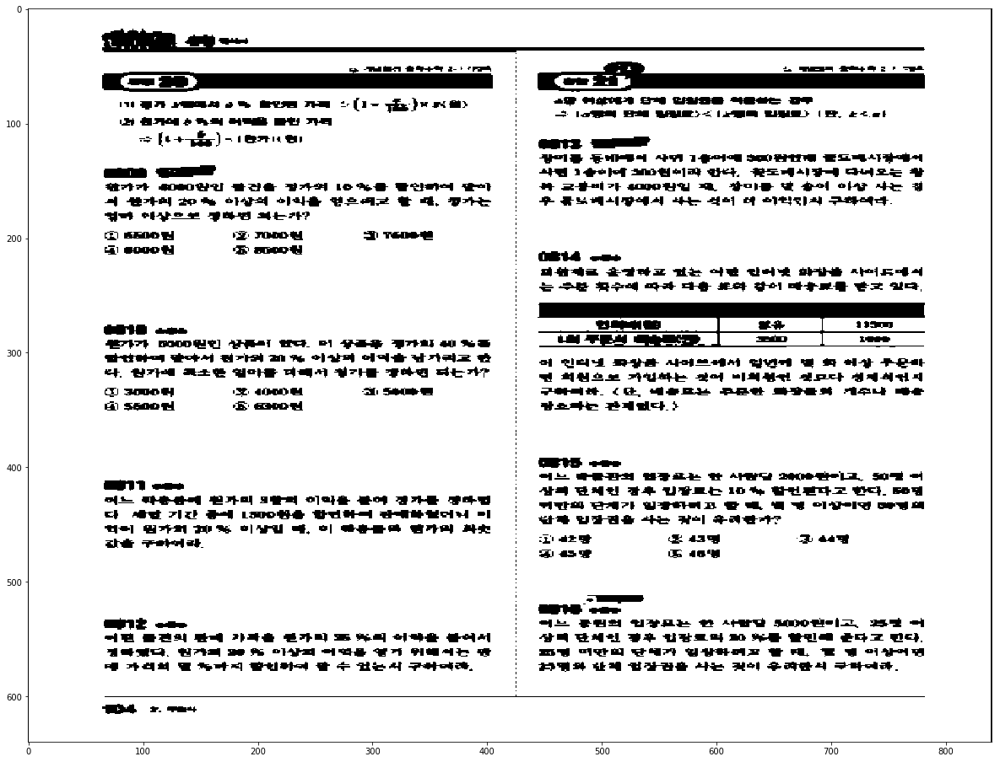

2  Pattern
IMG =  105 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

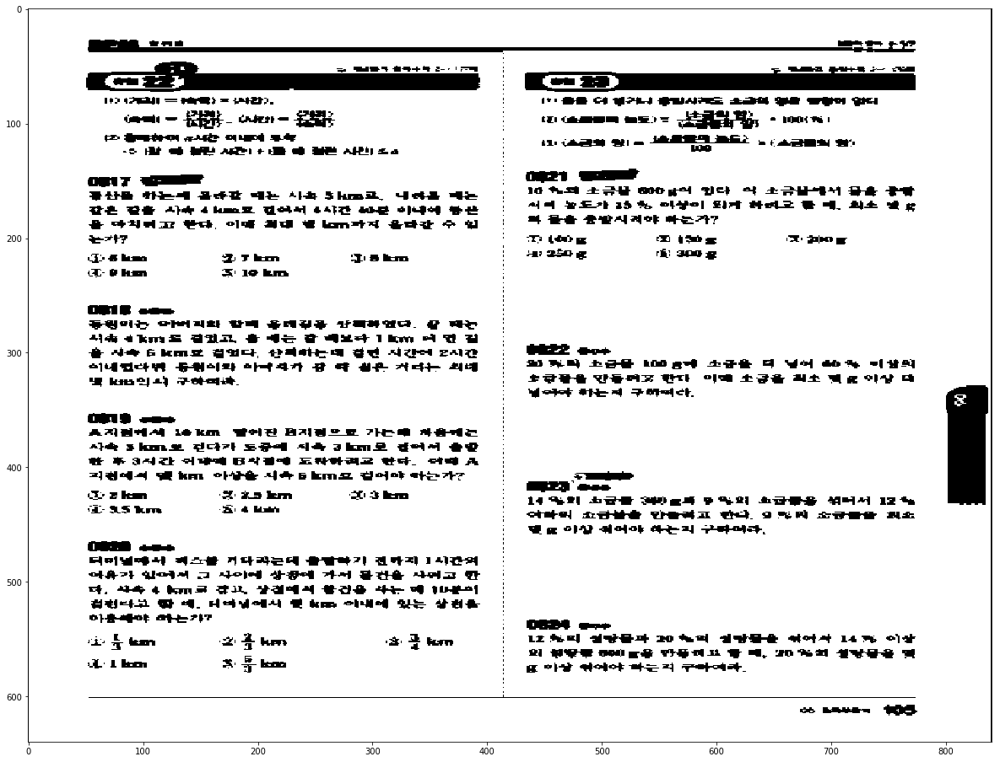

0  Pattern
IMG =  114 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

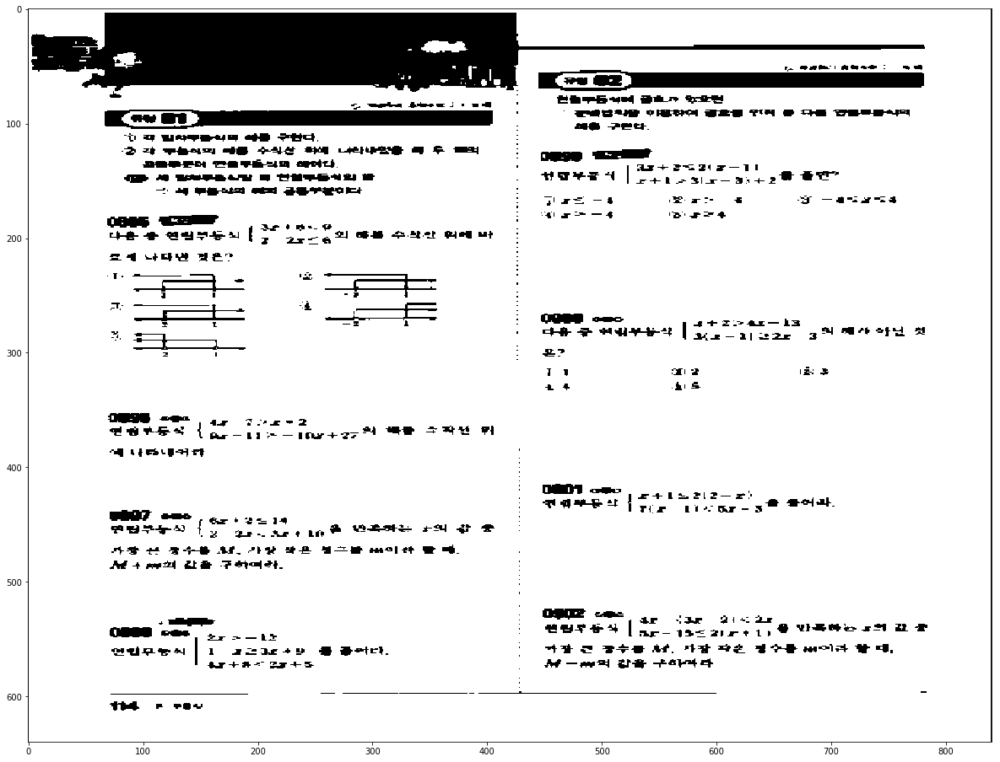

3  Pattern
IMG =  115 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

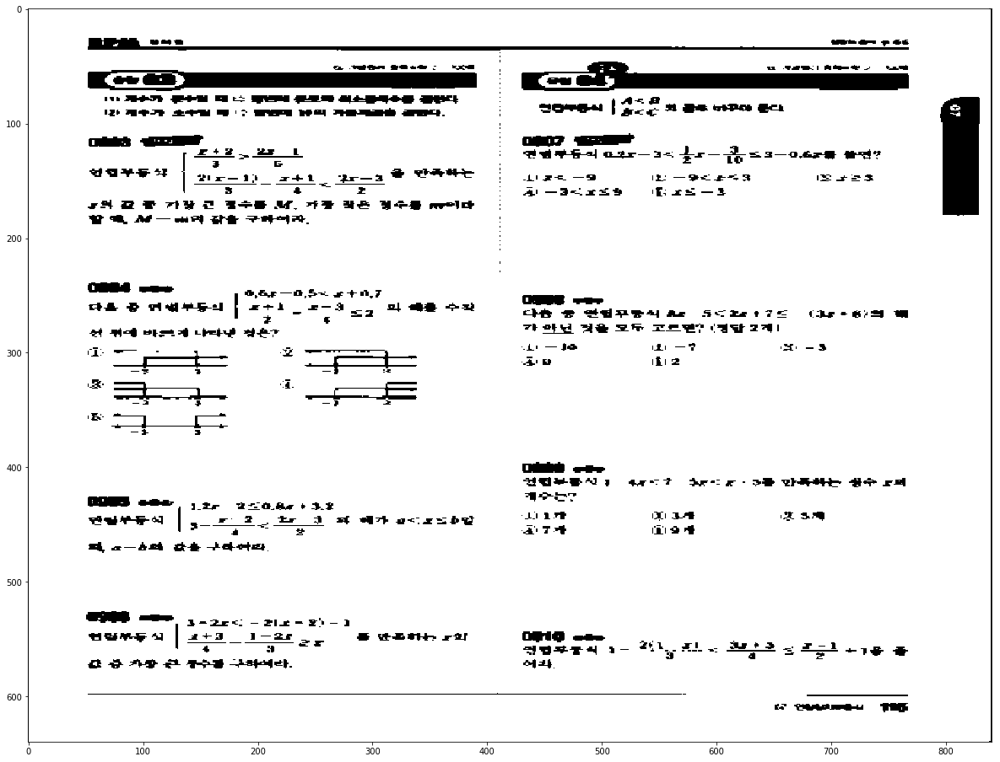

3  Pattern
IMG =  116 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

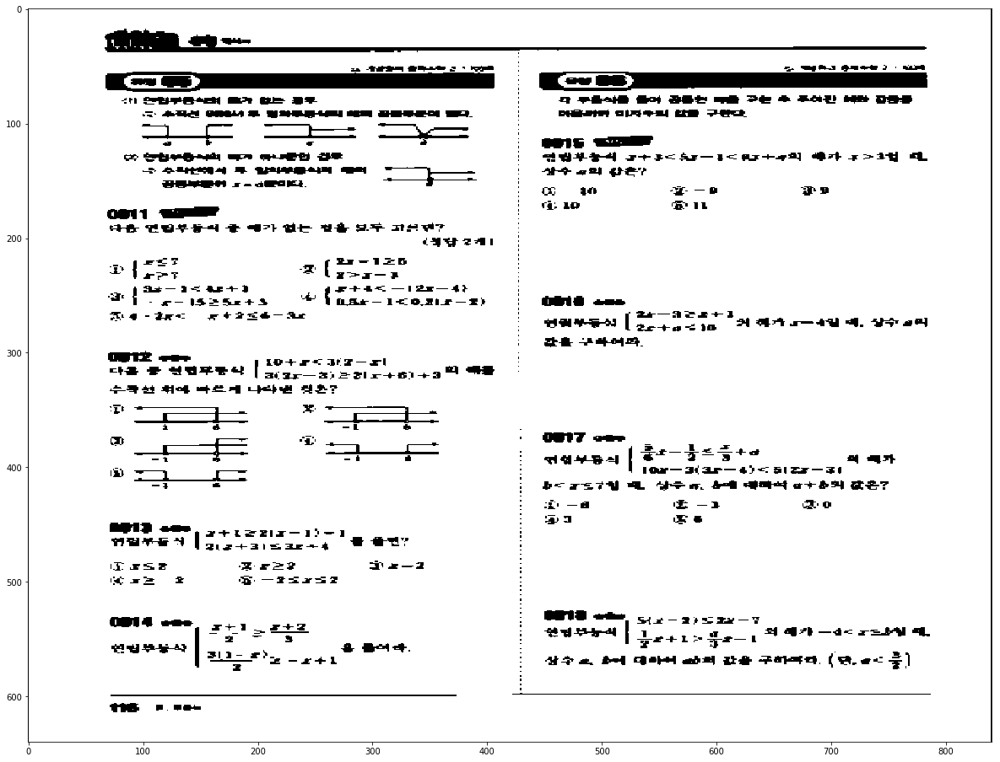

0  Pattern
IMG =  117 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

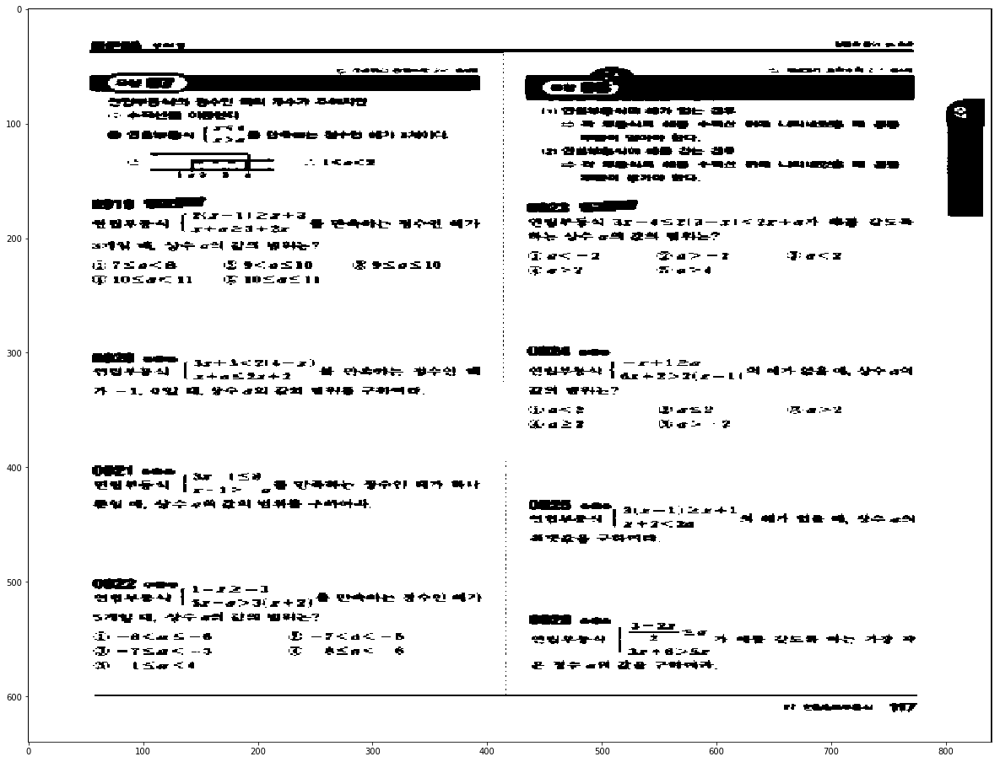

2  Pattern
IMG =  118 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

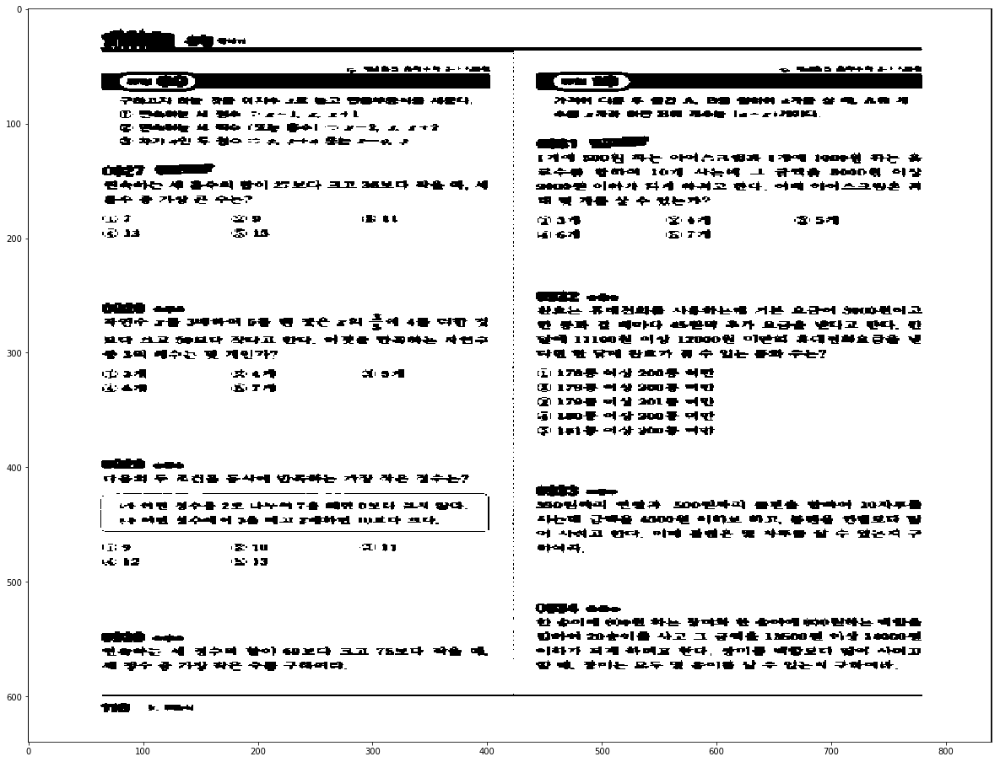

1  Pattern
IMG =  119 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

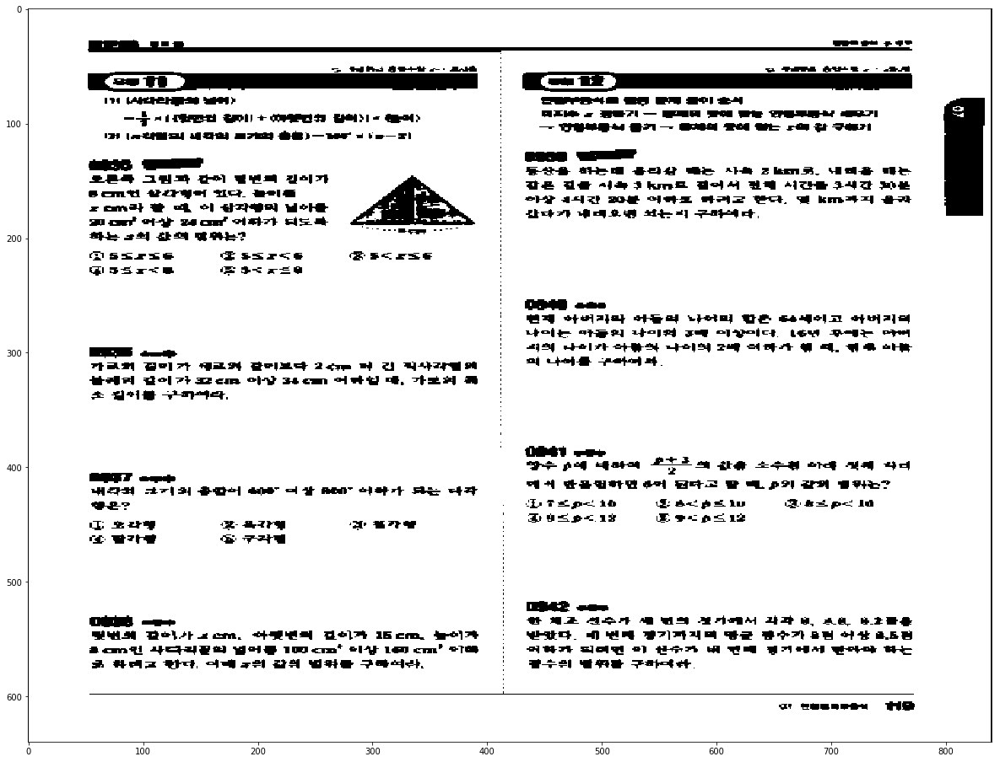

1  Pattern
IMG =  120 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

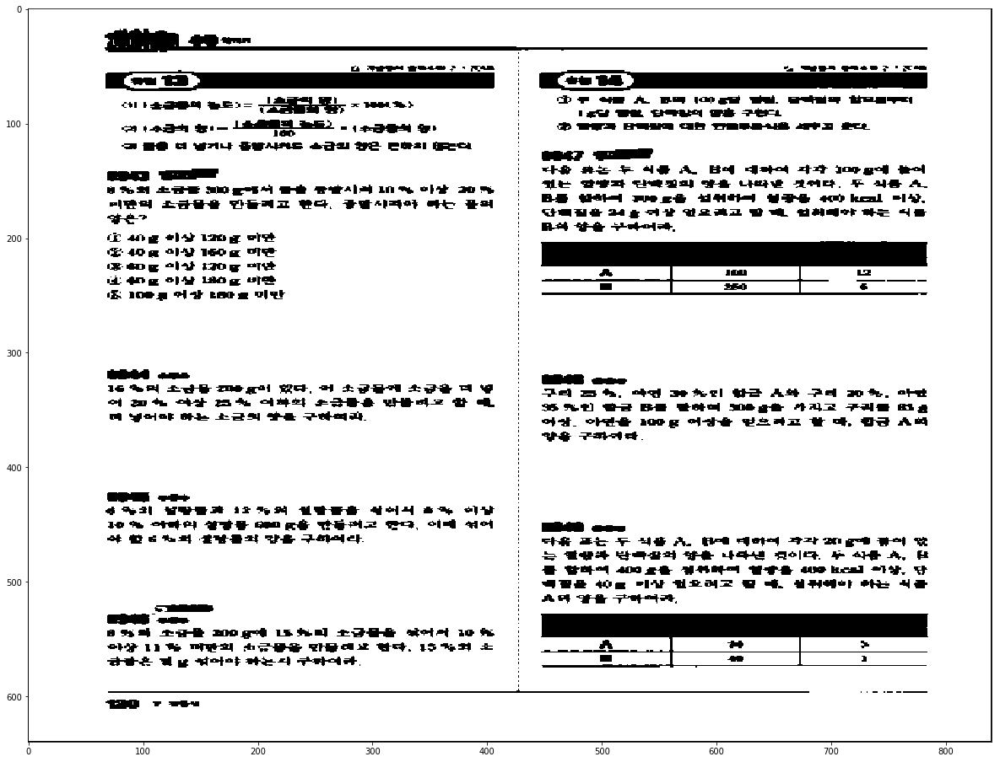

2  Pattern
IMG =  121 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

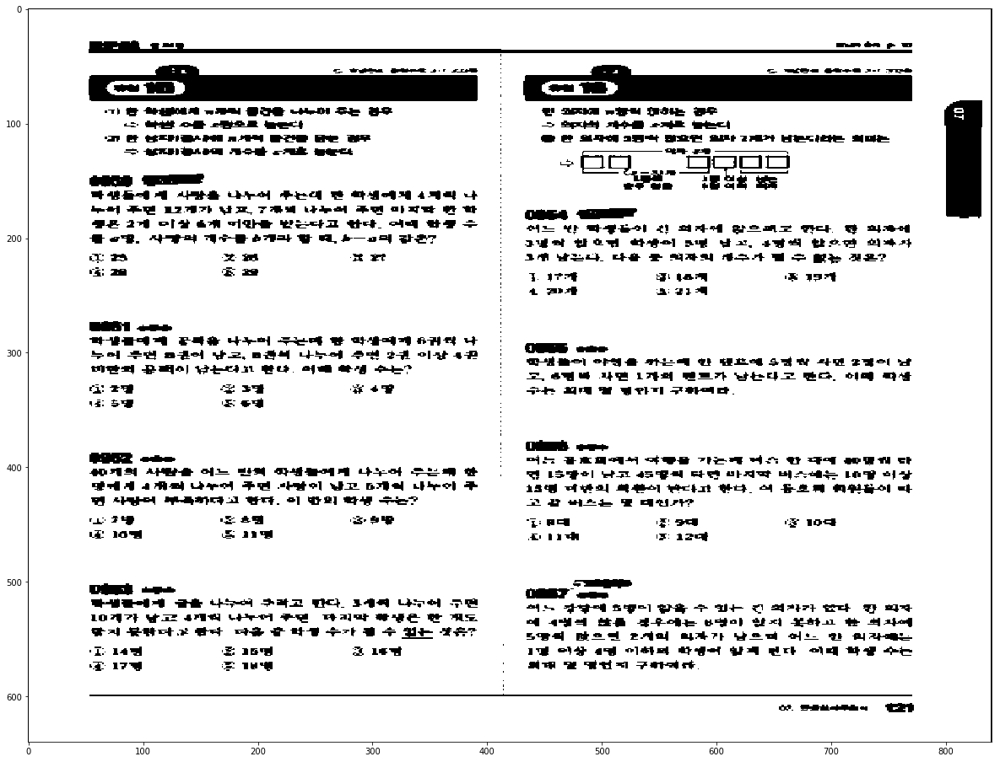

0  Pattern
IMG =  132 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

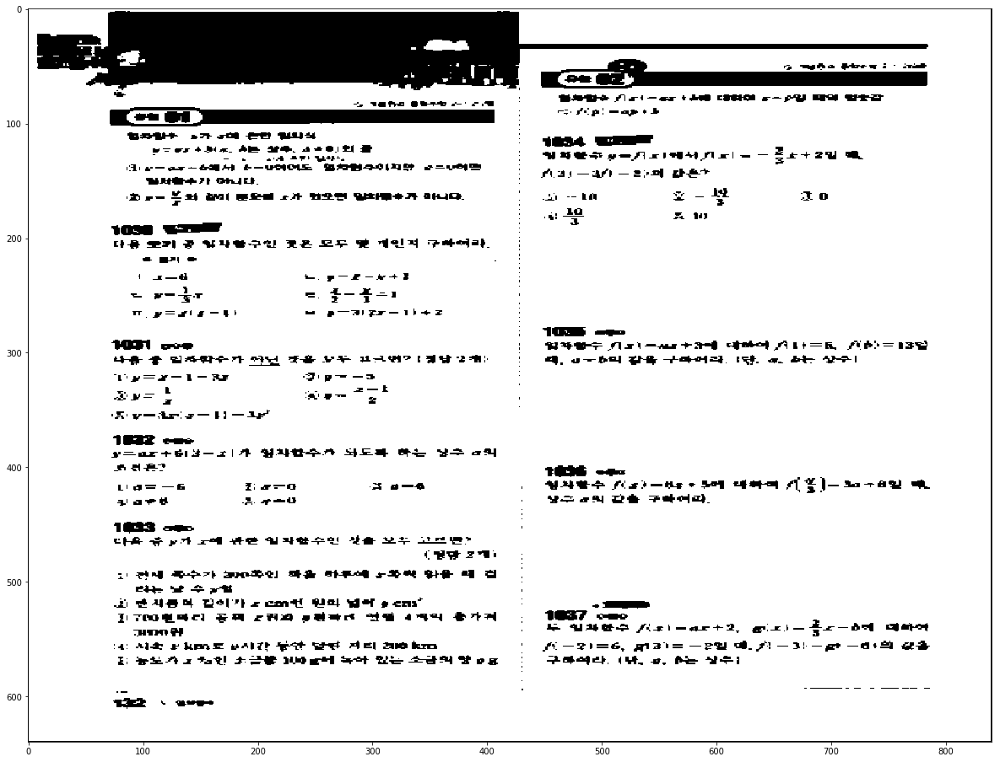

3  Pattern
IMG =  133 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

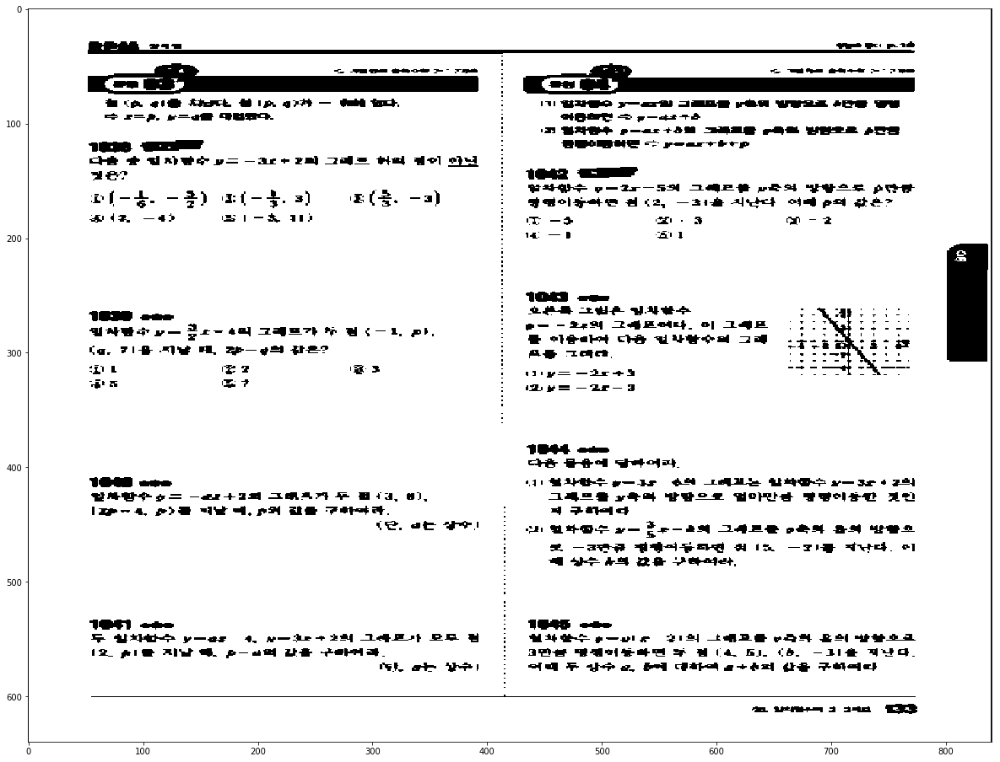

3  Pattern
IMG =  134 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

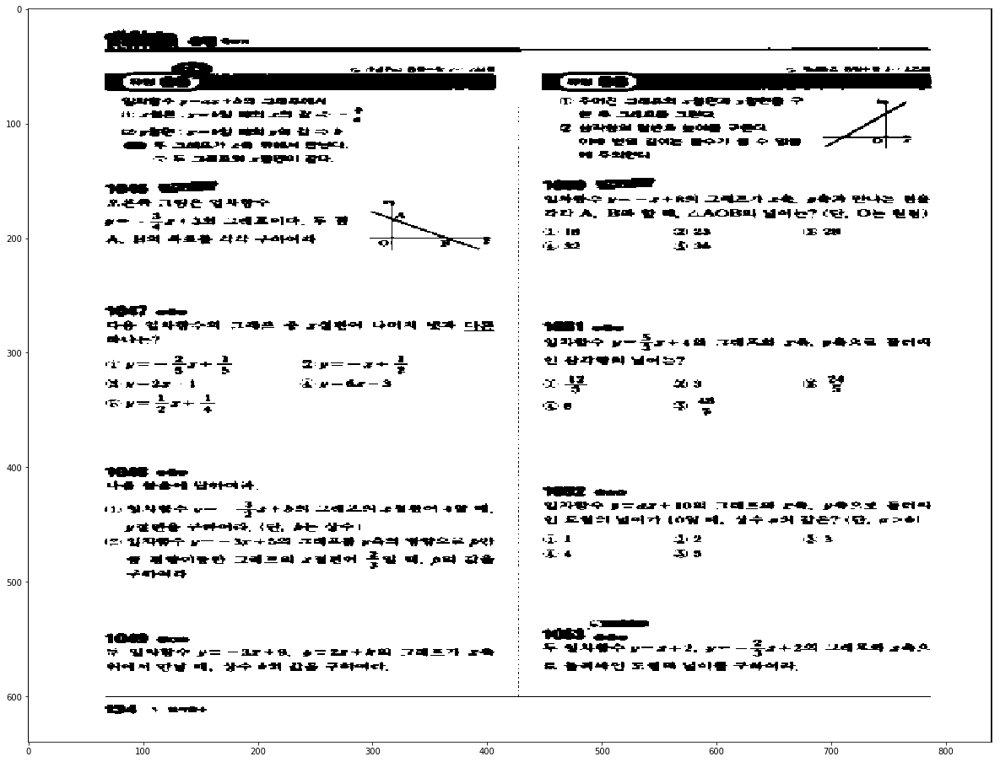

0  Pattern
IMG =  135 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

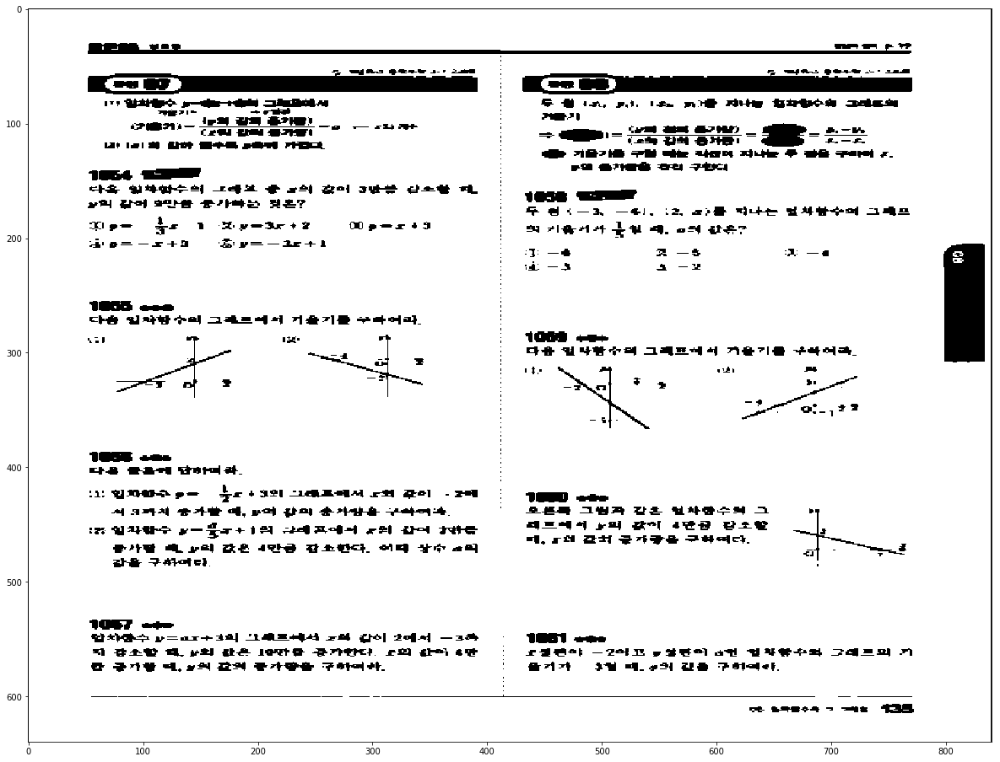

2  Pattern
IMG =  137 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

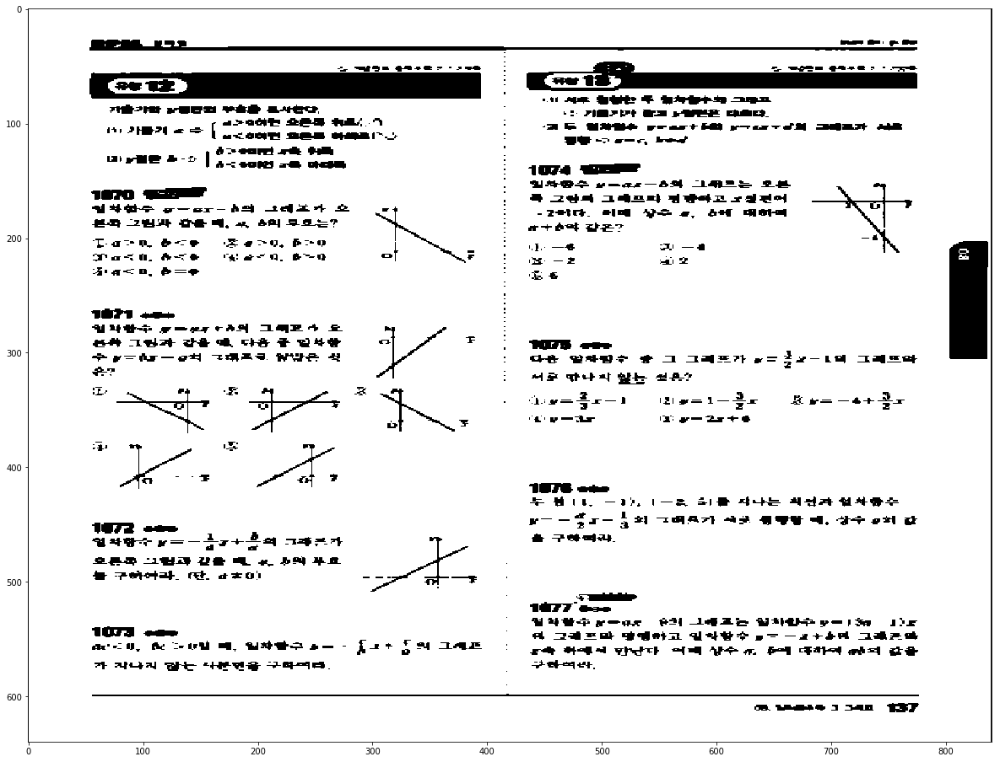

1  Pattern
IMG =  138 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

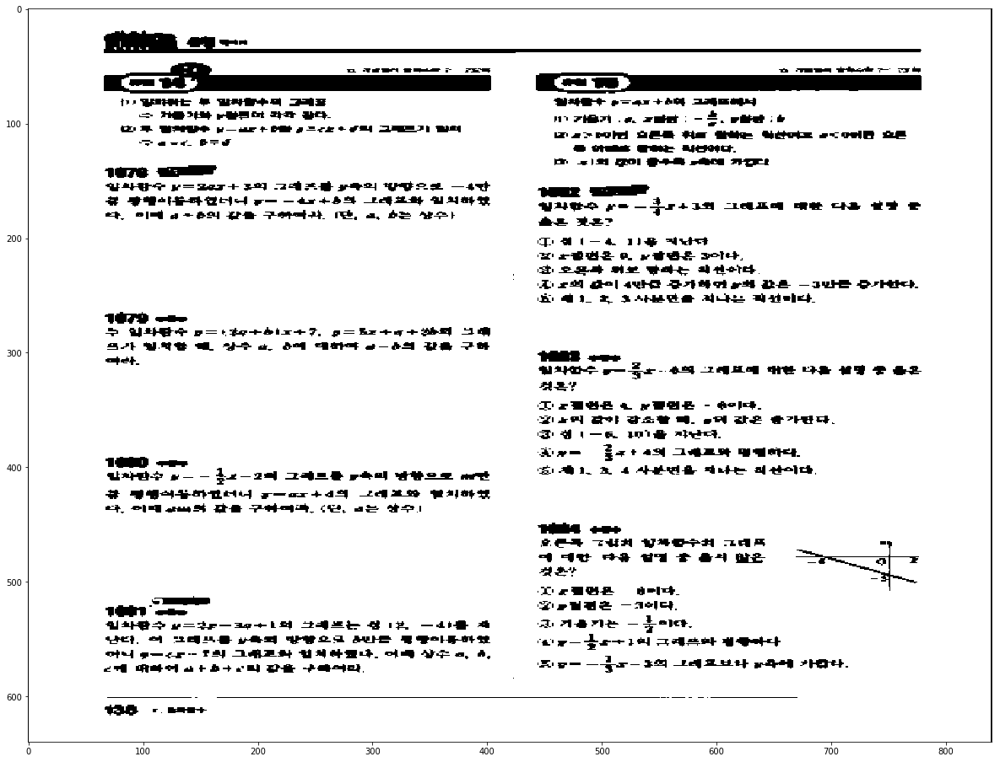

1  Pattern
IMG =  139 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

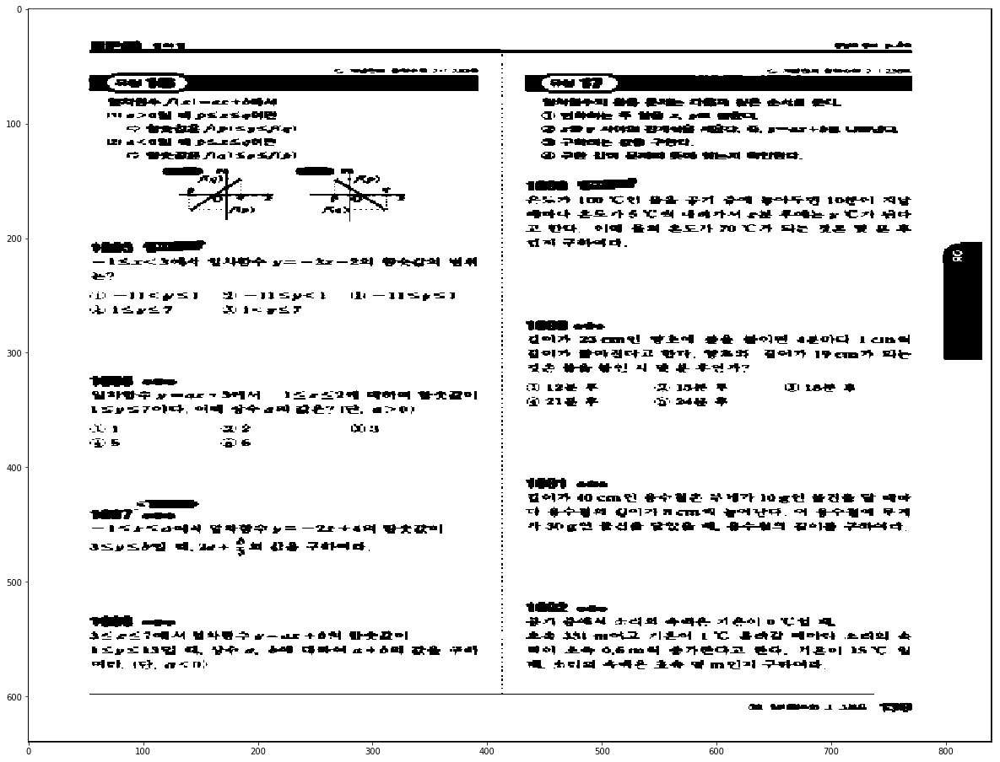

2  Pattern
IMG =  140 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [8]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

def denoiseWeakCon(img, y_value):
    height, width = img.shape
    upper_img = img[:y_value]
    upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
    img[:y_value] = upper_img
    return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
        fig, ax = plt.subplots(figsize=(30, 16))
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
            
        vmap = filters.median(vmap, selem=np.ones((12,12)))
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseWeakCon(vmap, int(h/4))
        vmap = standardize(vmap)
        
        ax1.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = removeFirst(vmap)
        vmap = denoiseBoundary(vmap, 5, 10)
        if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

        contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.

        for n, contour in enumerate(contours):
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()

#     edges = canny(img, sigma=.5)
    thresh_val = threshold_otsu(img)
    img = img > thresh_val
#     img = canny(img)
    fig, ax = plt.subplots(figsize=(30, 16))
    ax.imshow(img, interpolation='nearest', cmap=plt.cm.gray)
#     p = Page(edges)
#     p.getContour()

    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

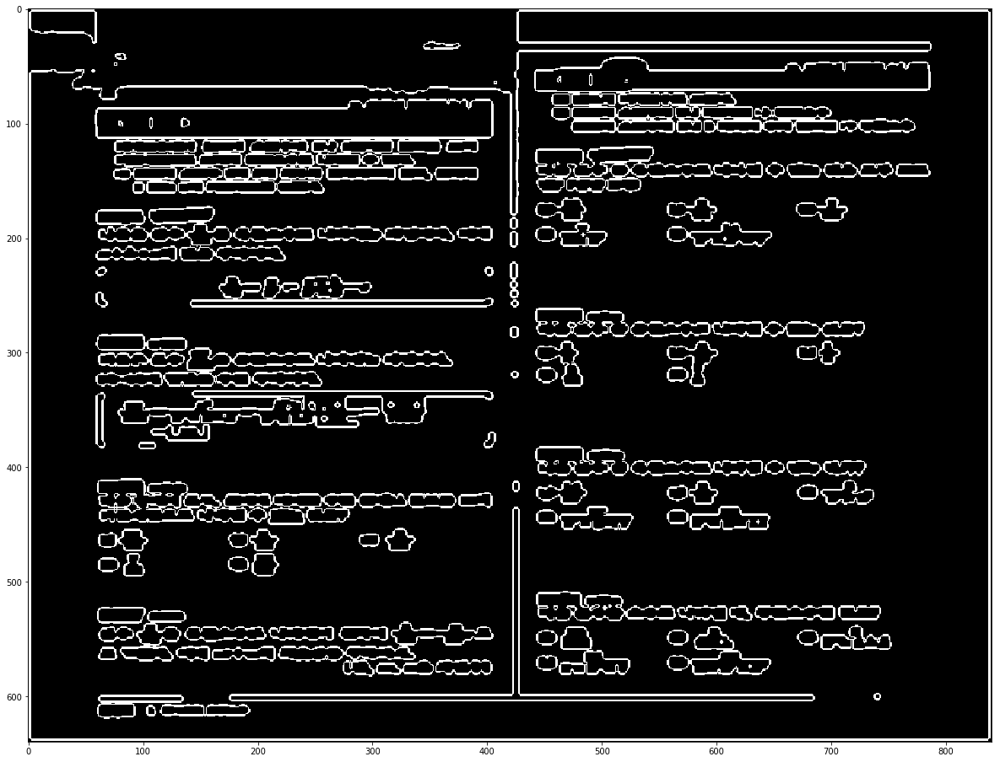

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

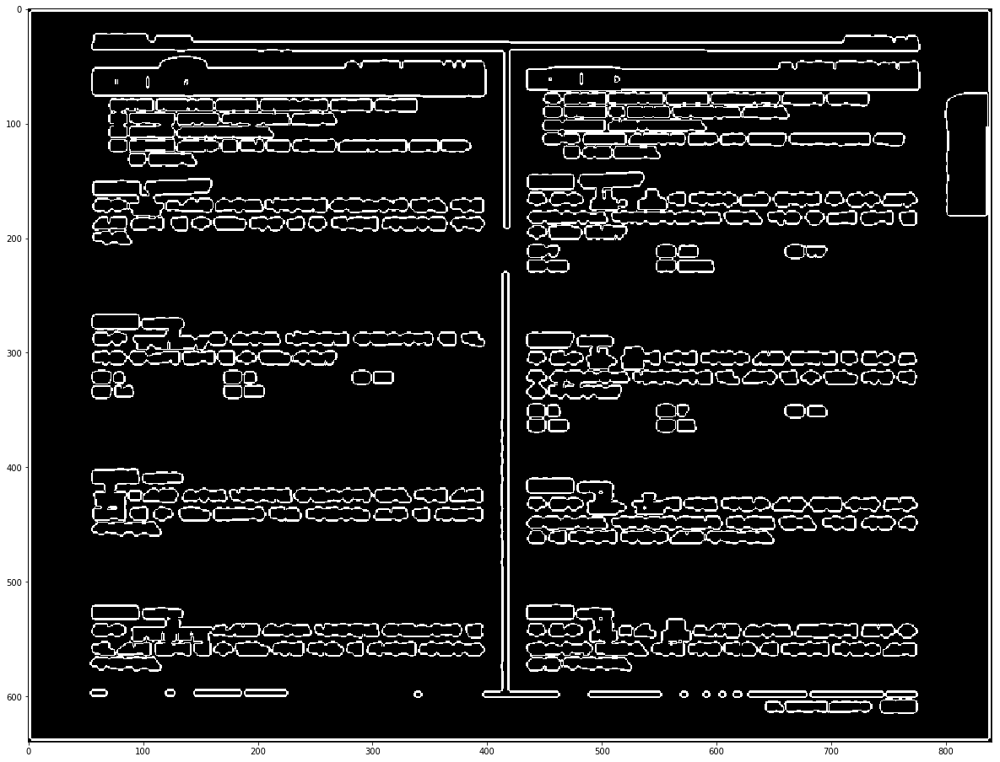

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

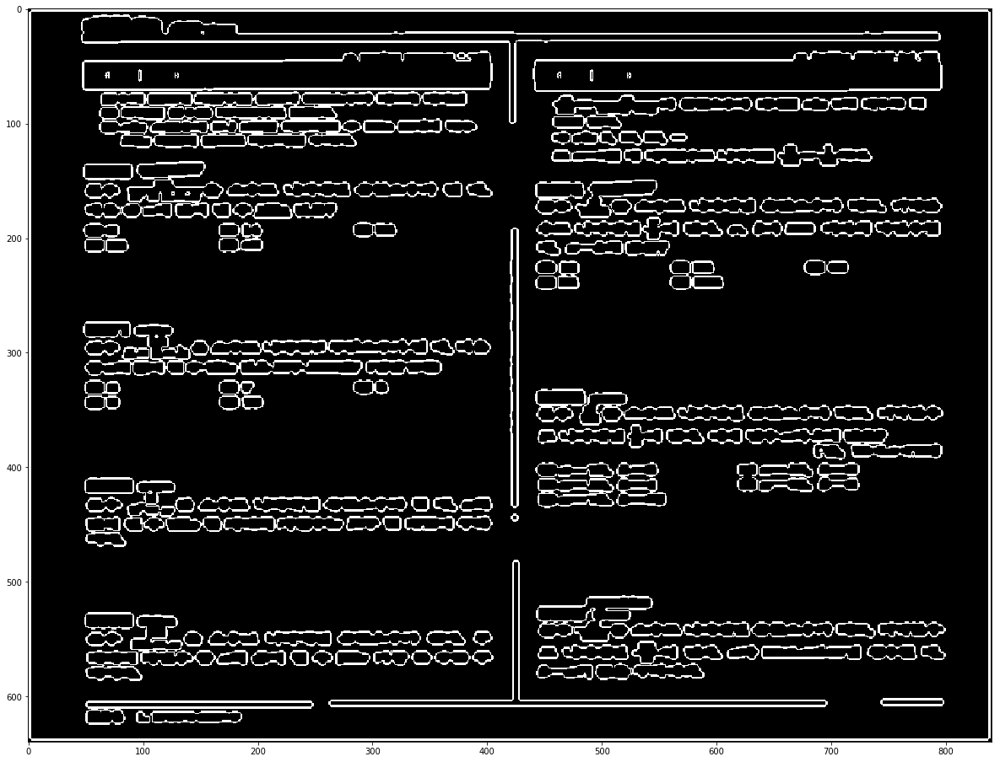

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

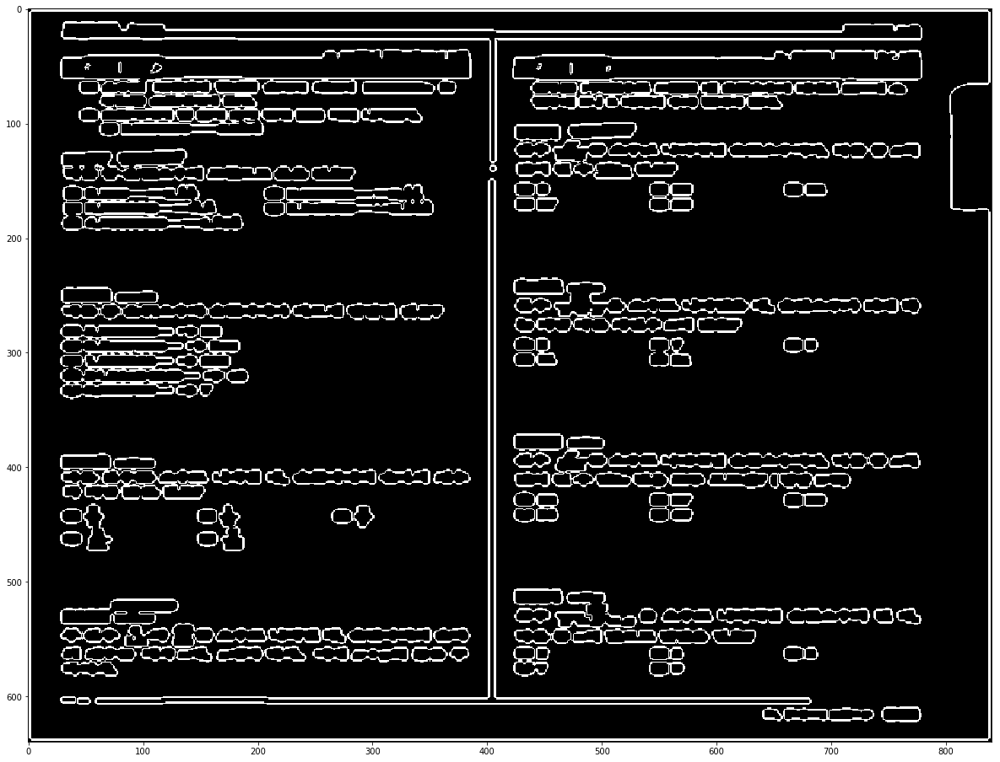

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

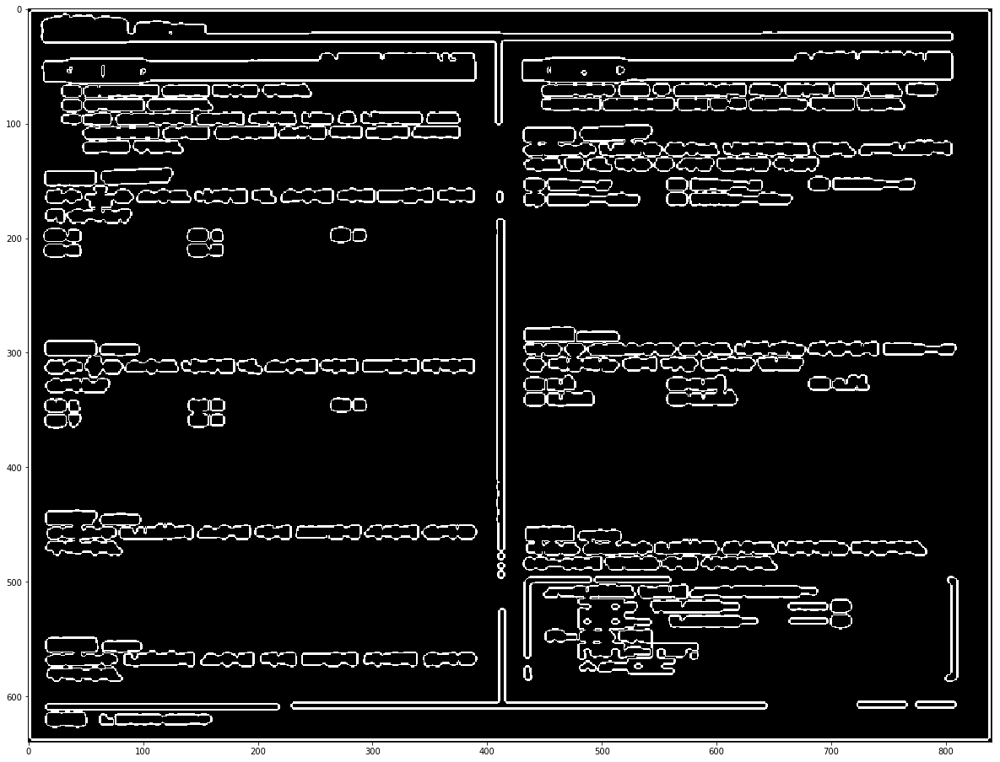

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

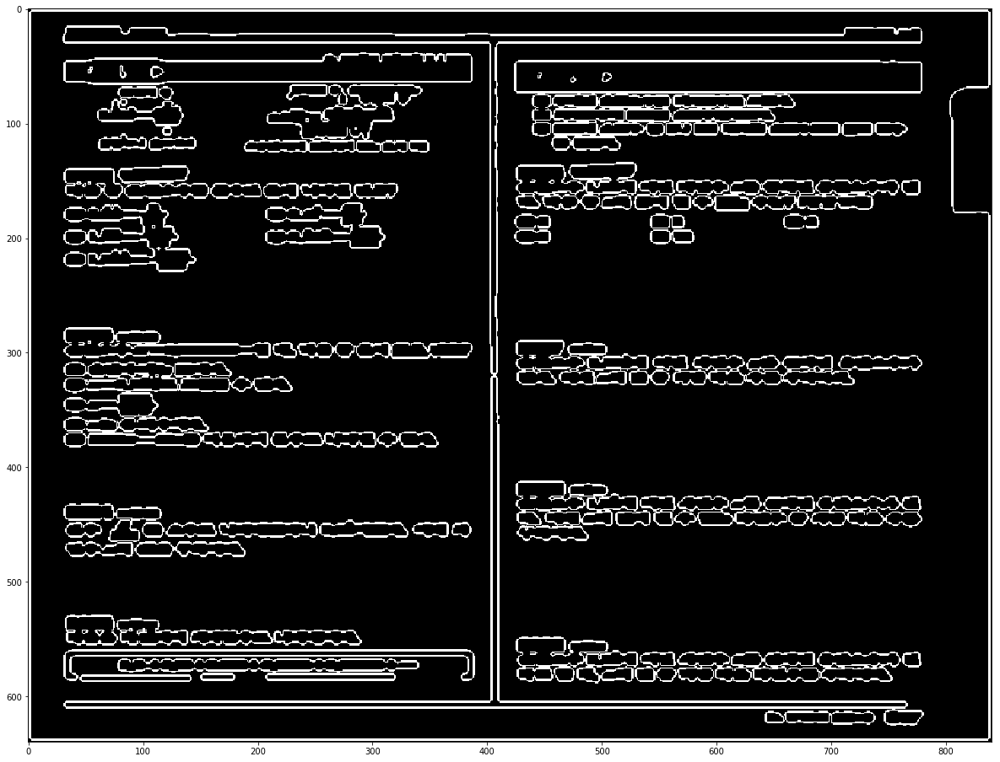

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

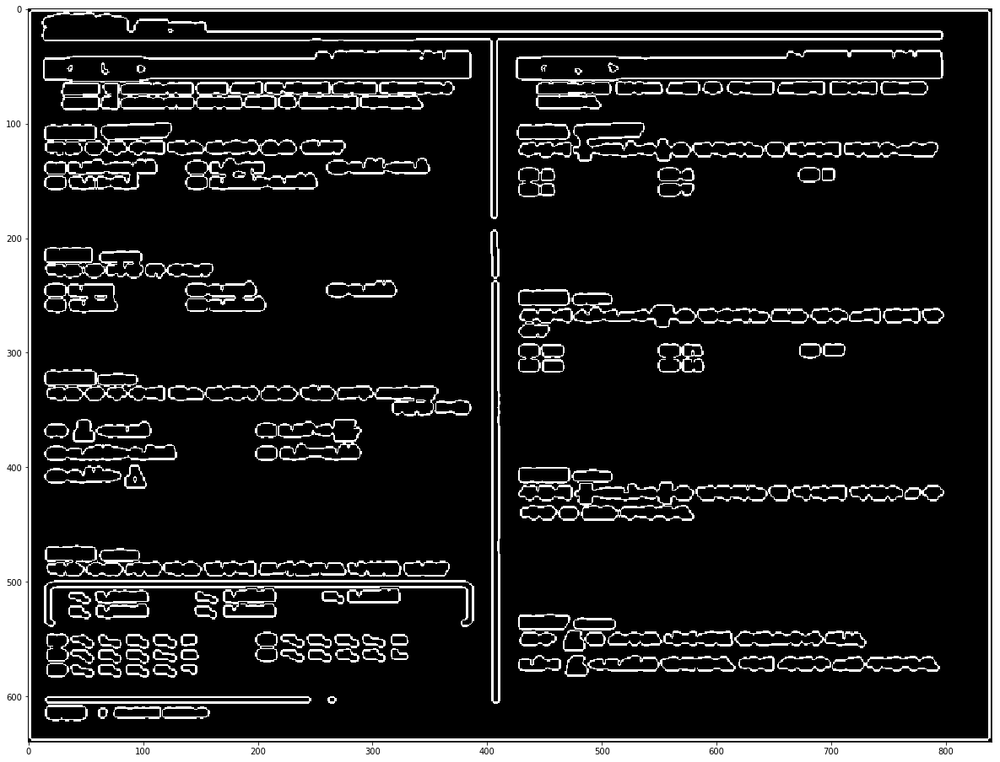

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

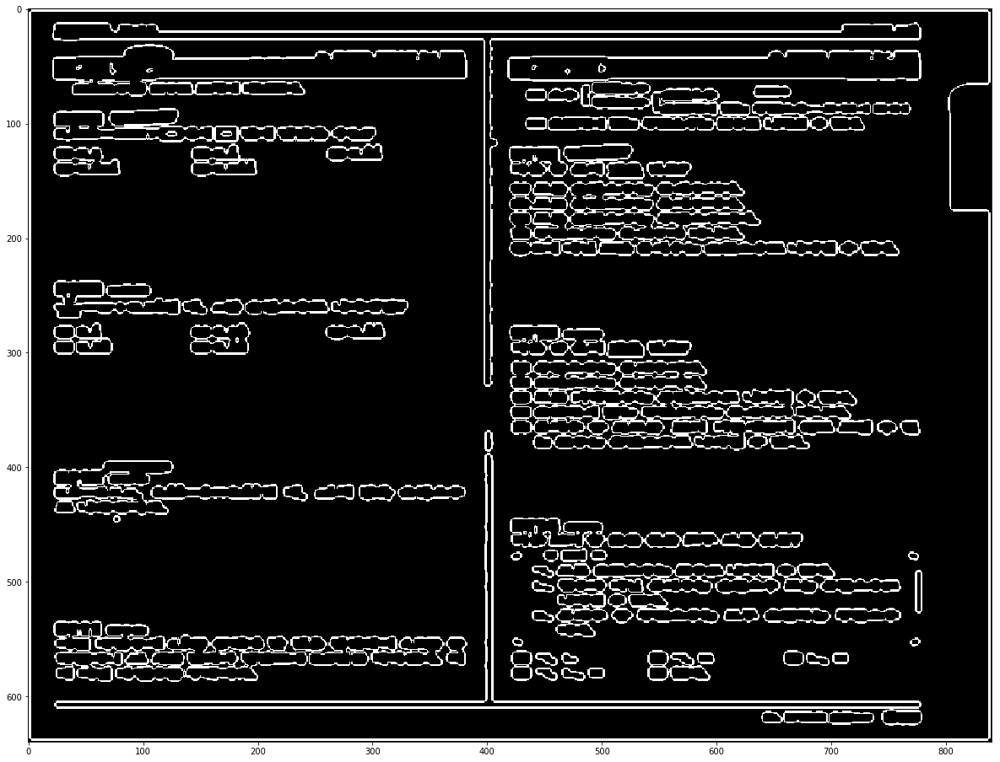

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

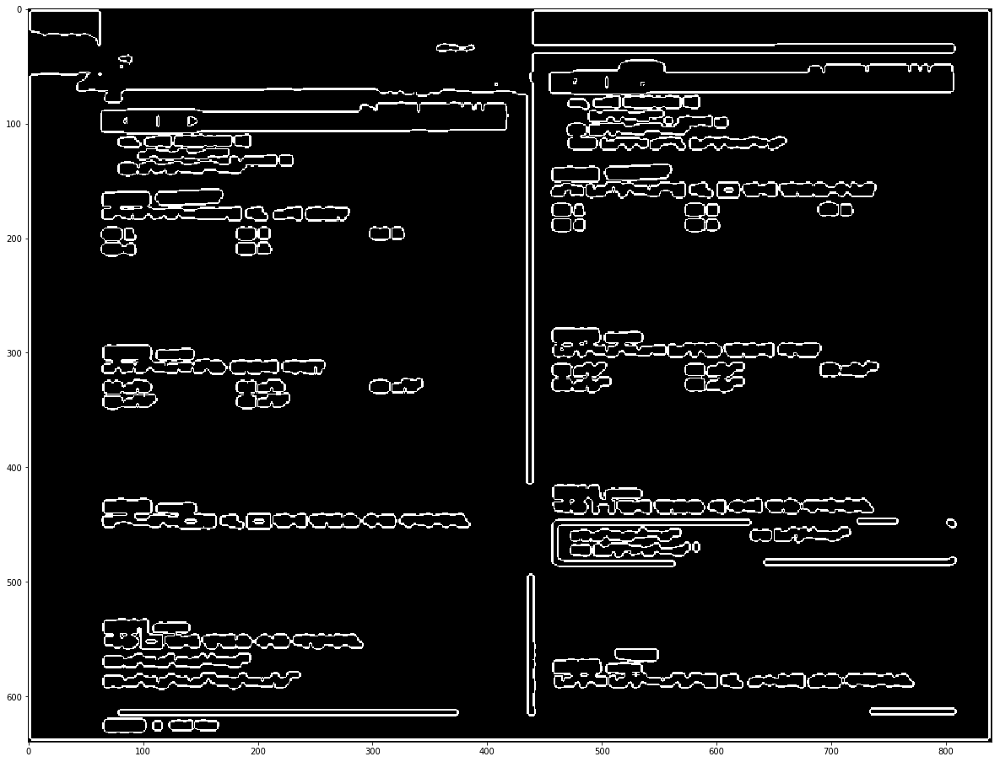

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

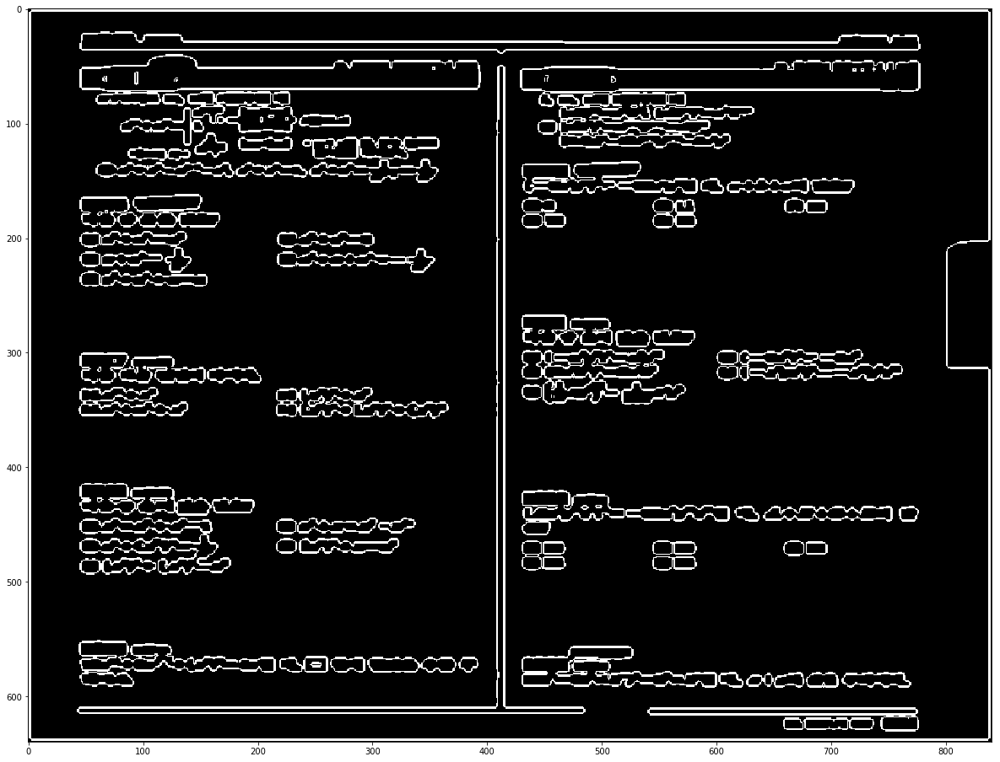

0  Pattern
IMG =  032 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

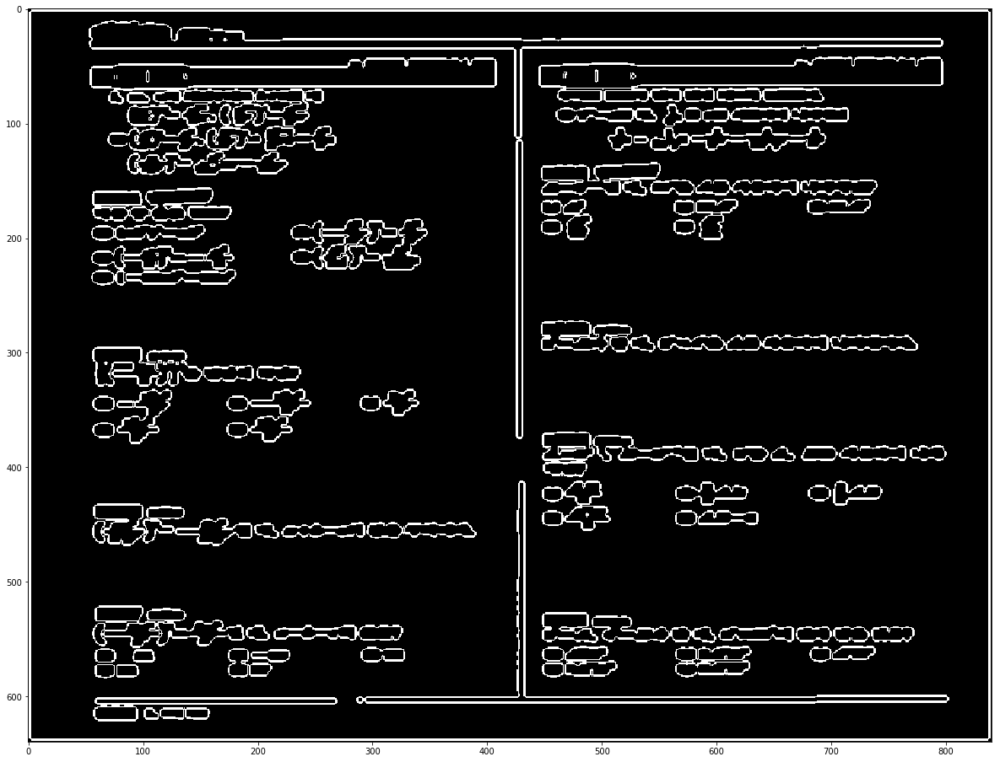

3  Pattern
IMG =  033 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

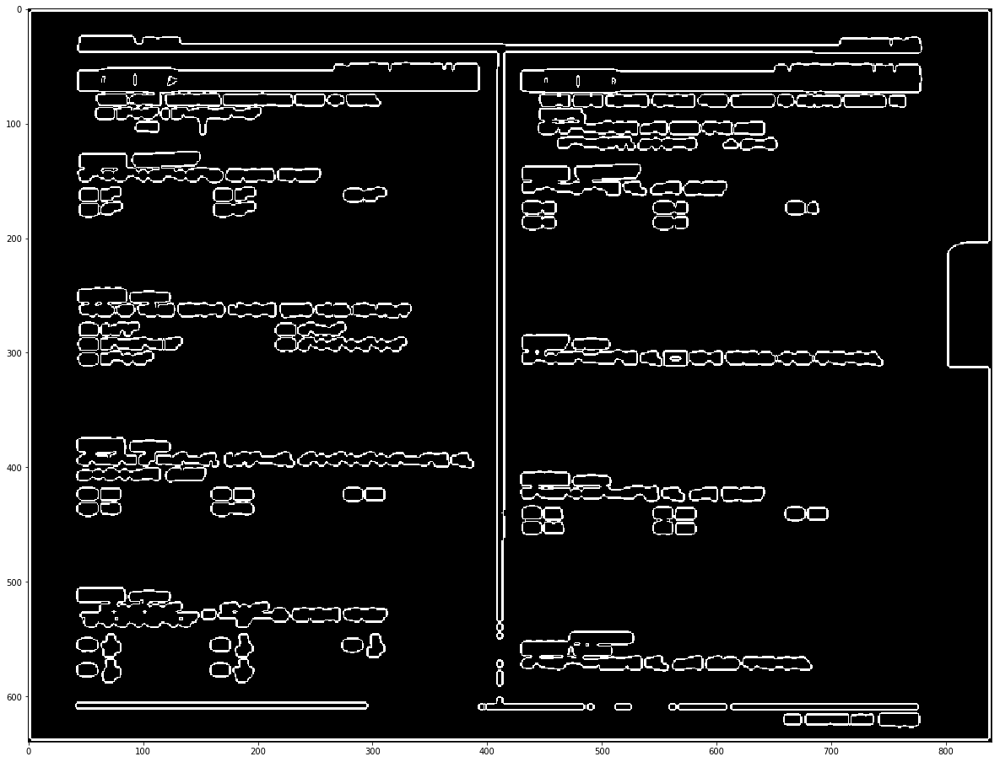

3  Pattern
IMG =  034 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

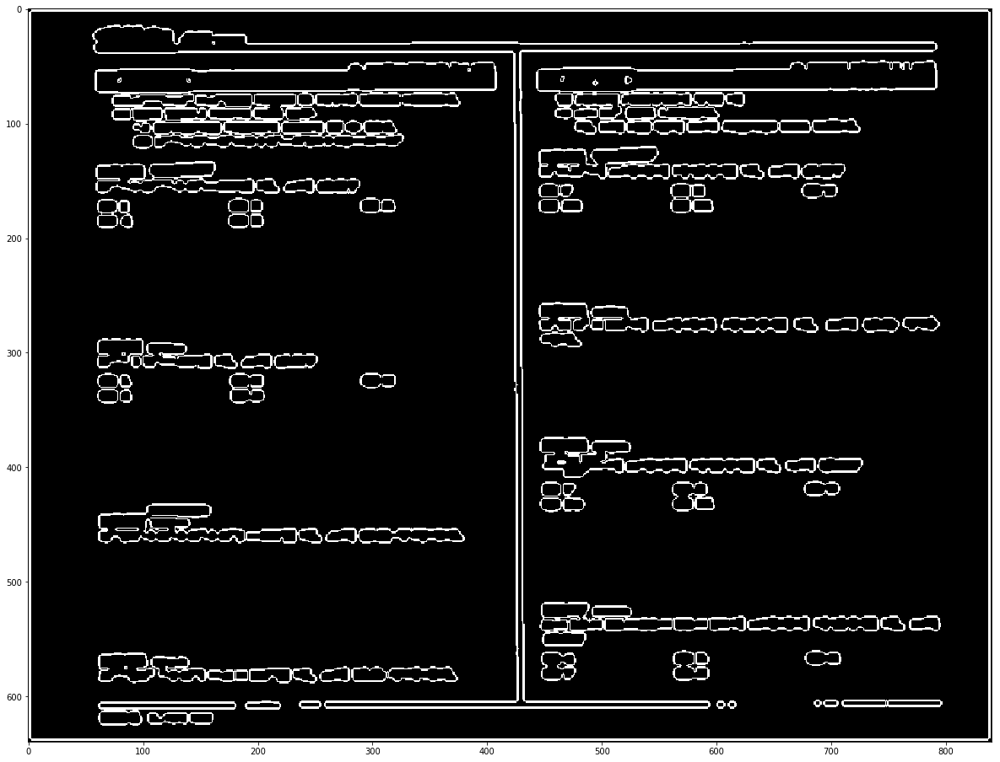

0  Pattern
IMG =  035 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

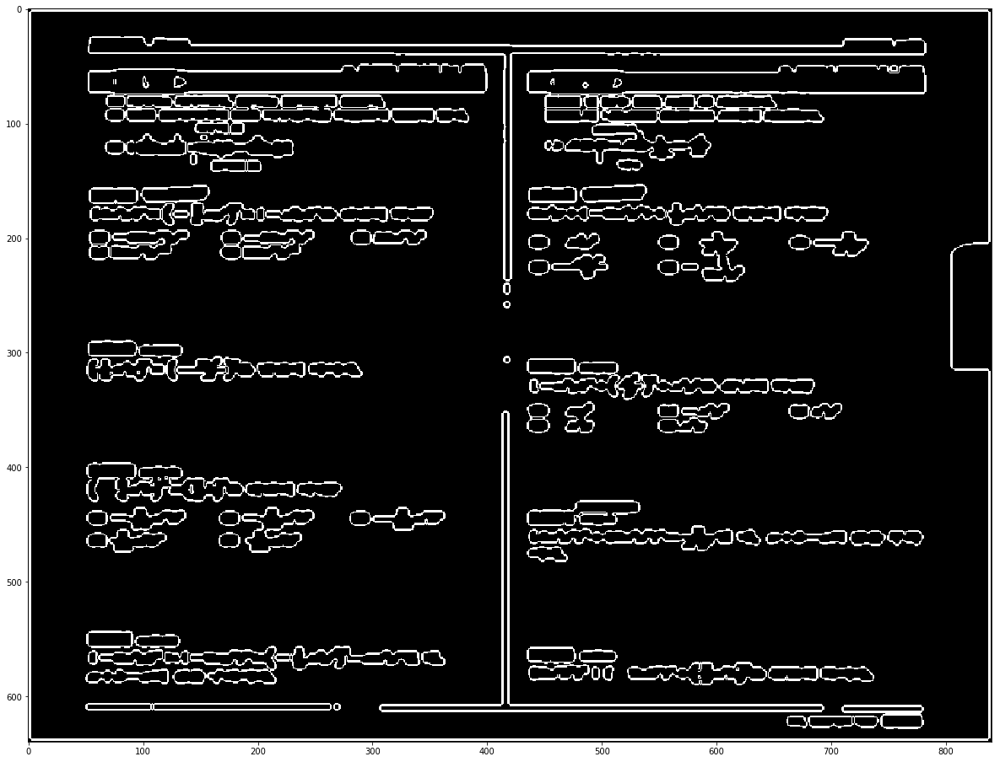

2  Pattern
IMG =  036 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

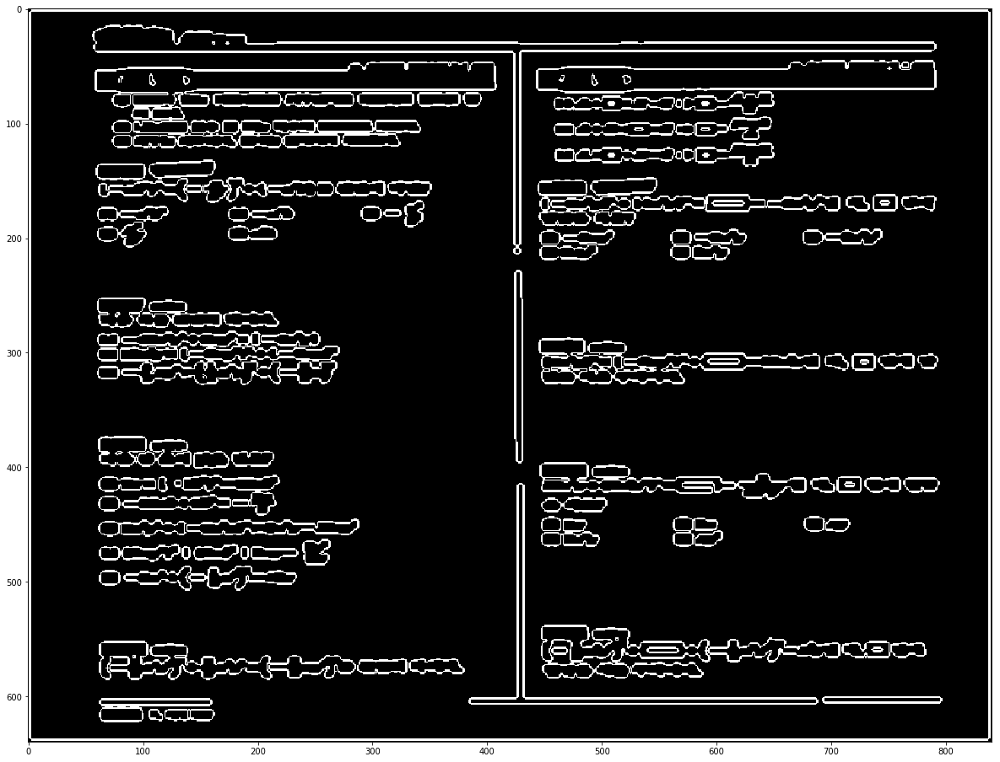

1  Pattern
IMG =  037 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

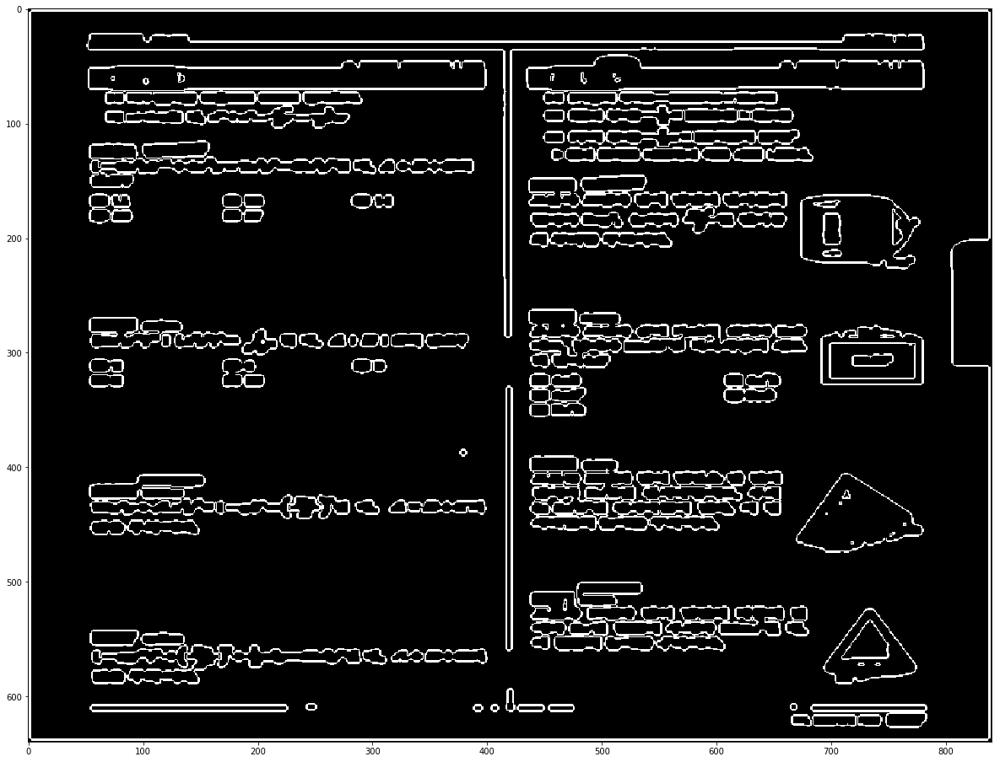

1  Pattern
IMG =  046 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

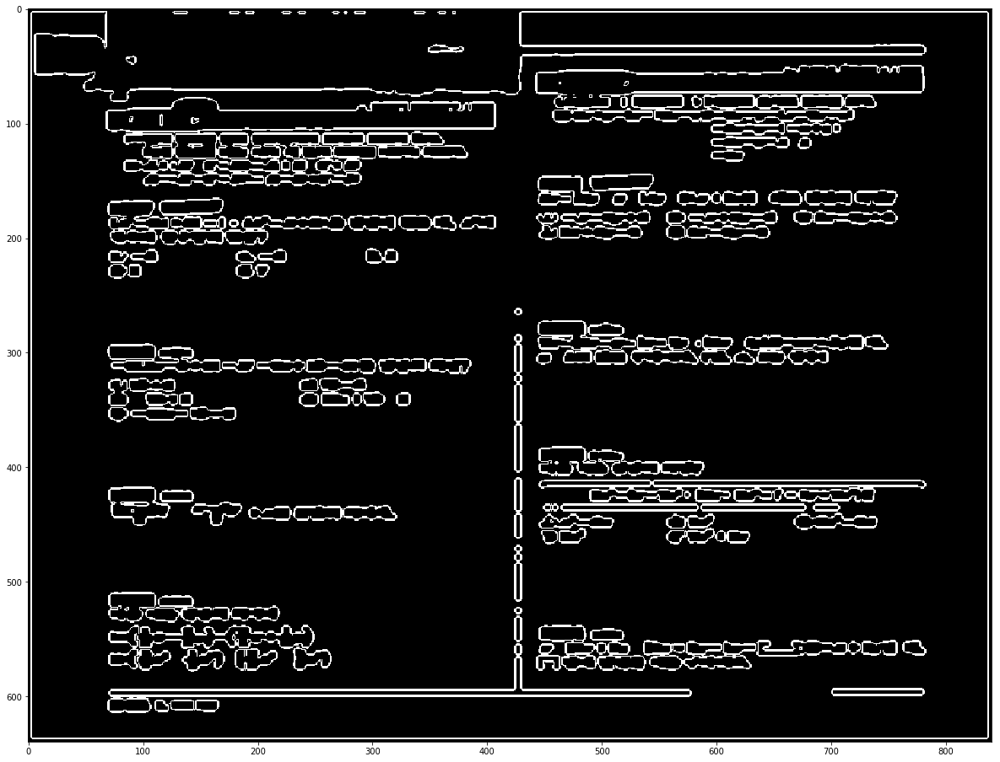

2  Pattern
IMG =  047 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

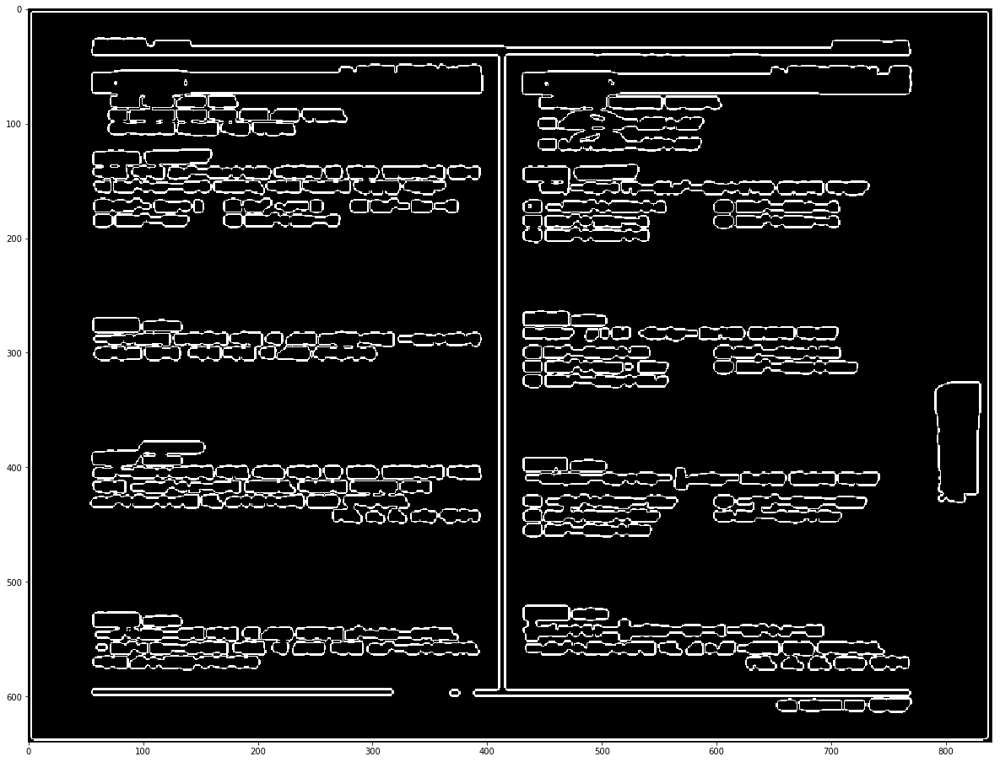

0  Pattern
IMG =  048 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

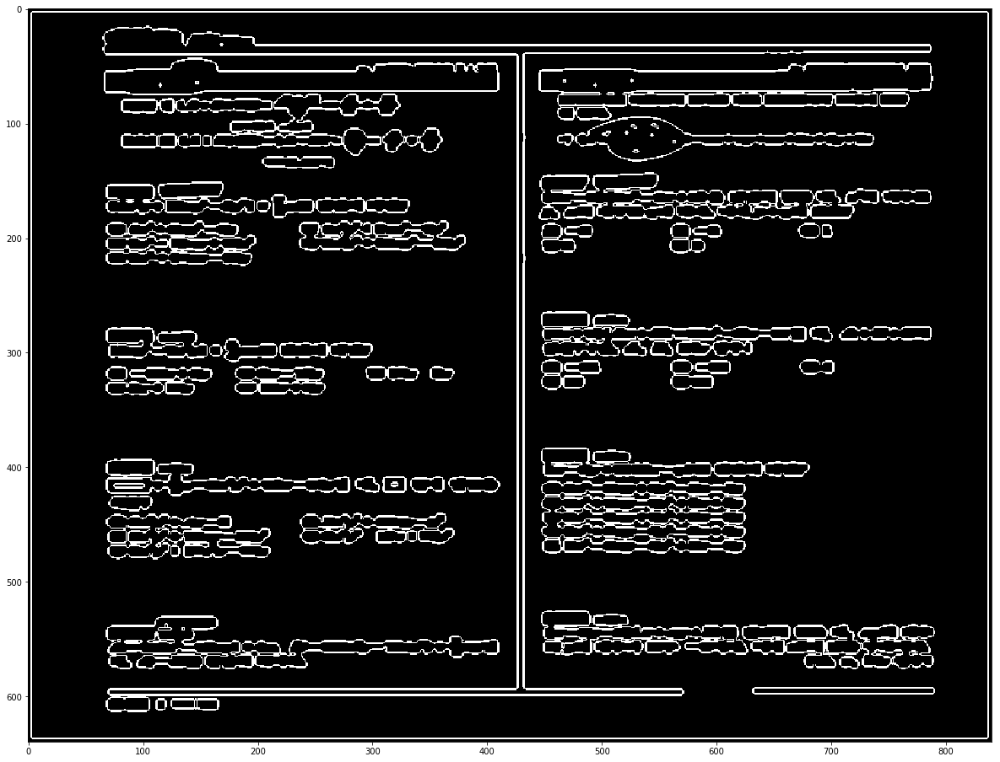

3  Pattern
IMG =  049 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

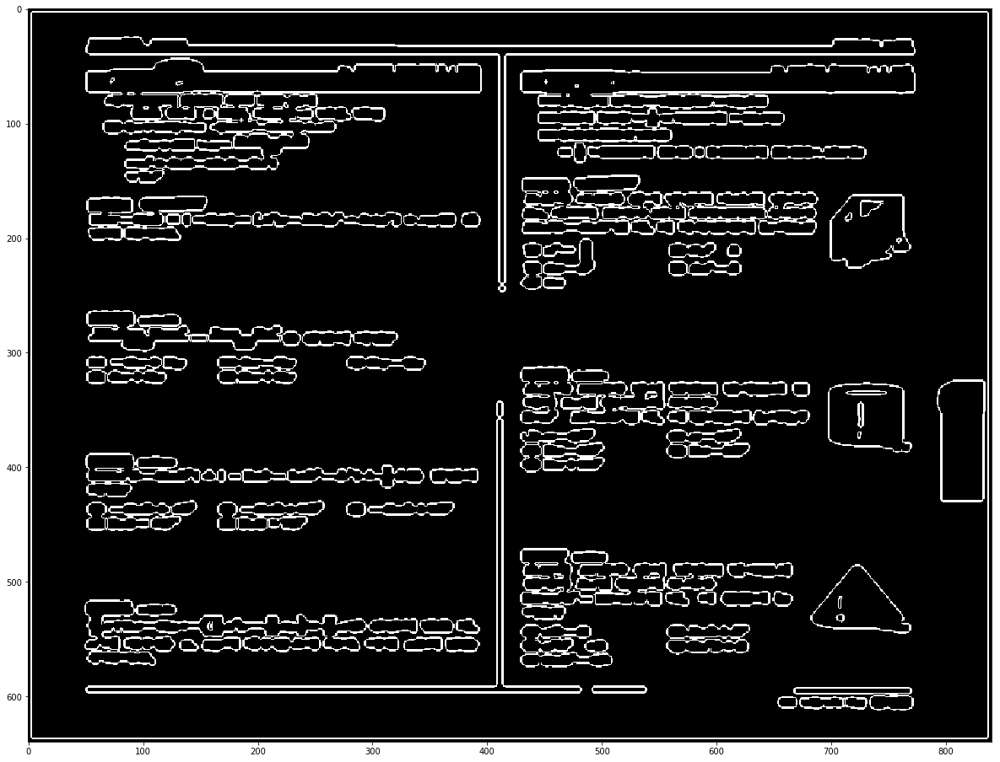

3  Pattern
IMG =  050 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

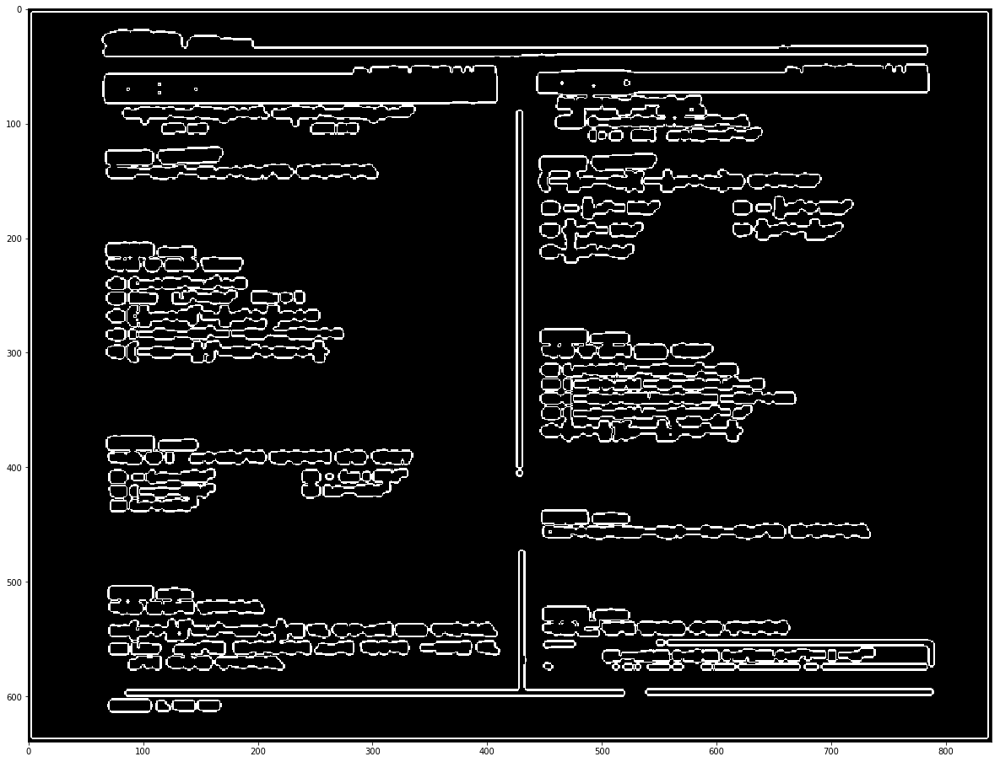

0  Pattern
IMG =  051 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

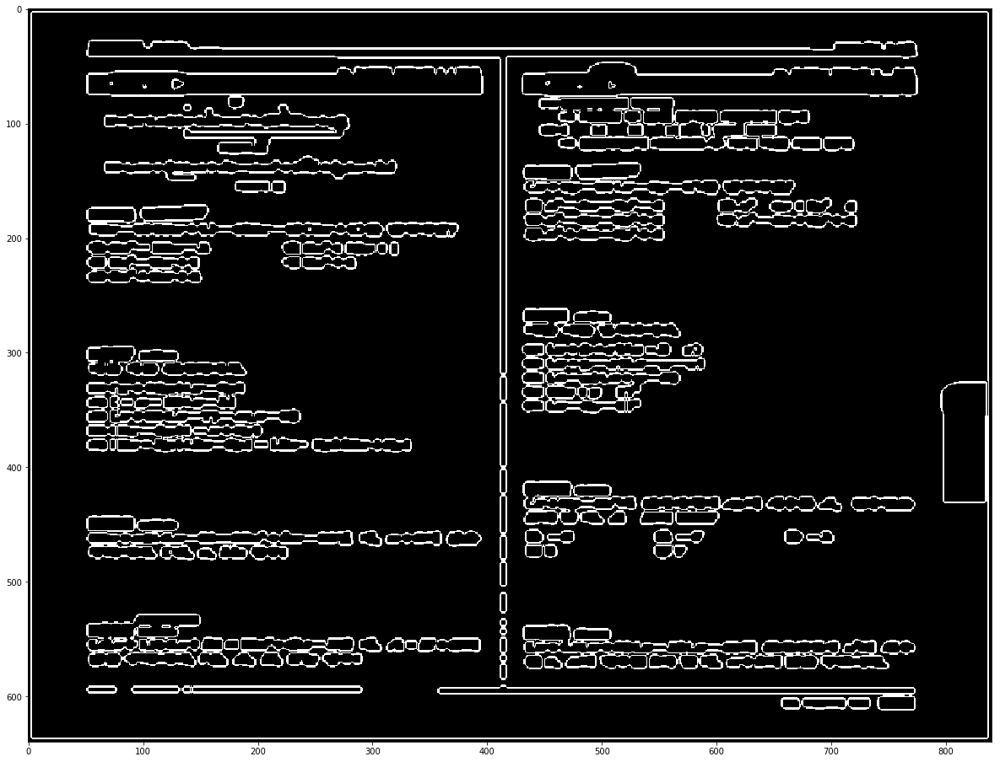

2  Pattern
IMG =  052 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

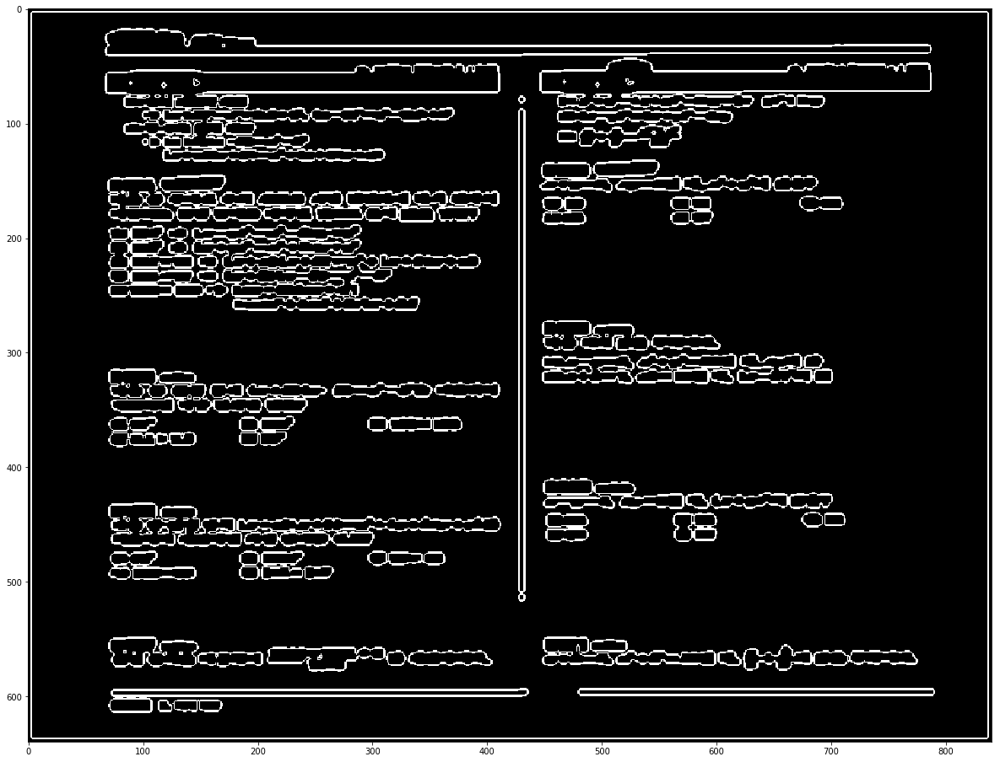

1  Pattern
IMG =  053 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

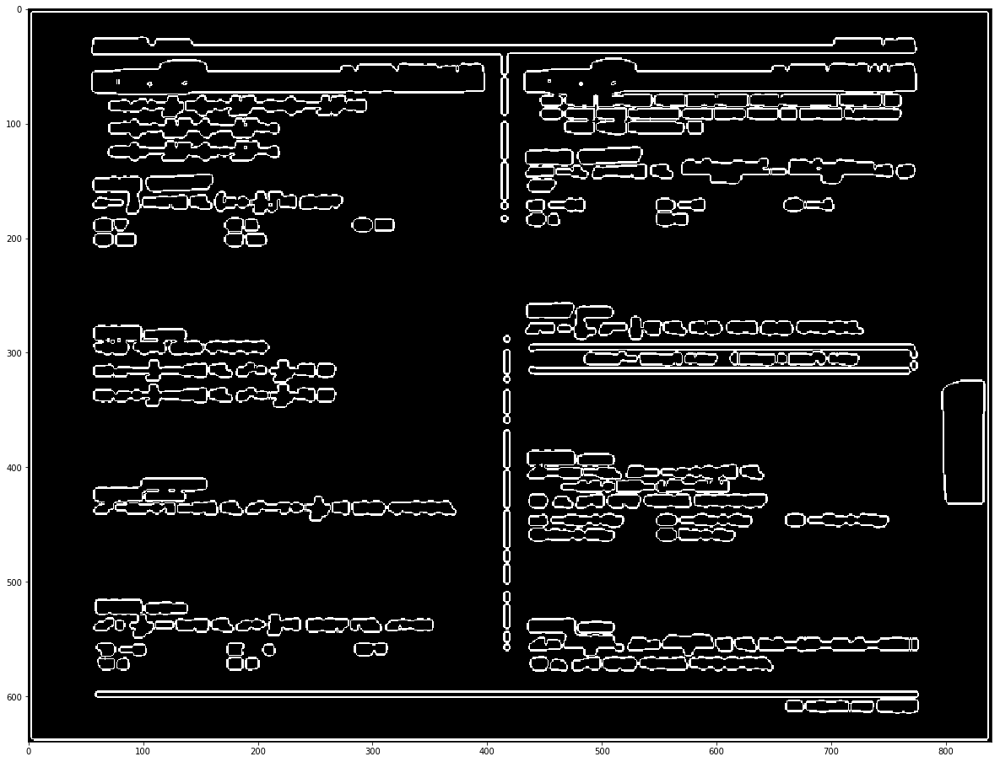

1  Pattern
IMG =  054 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

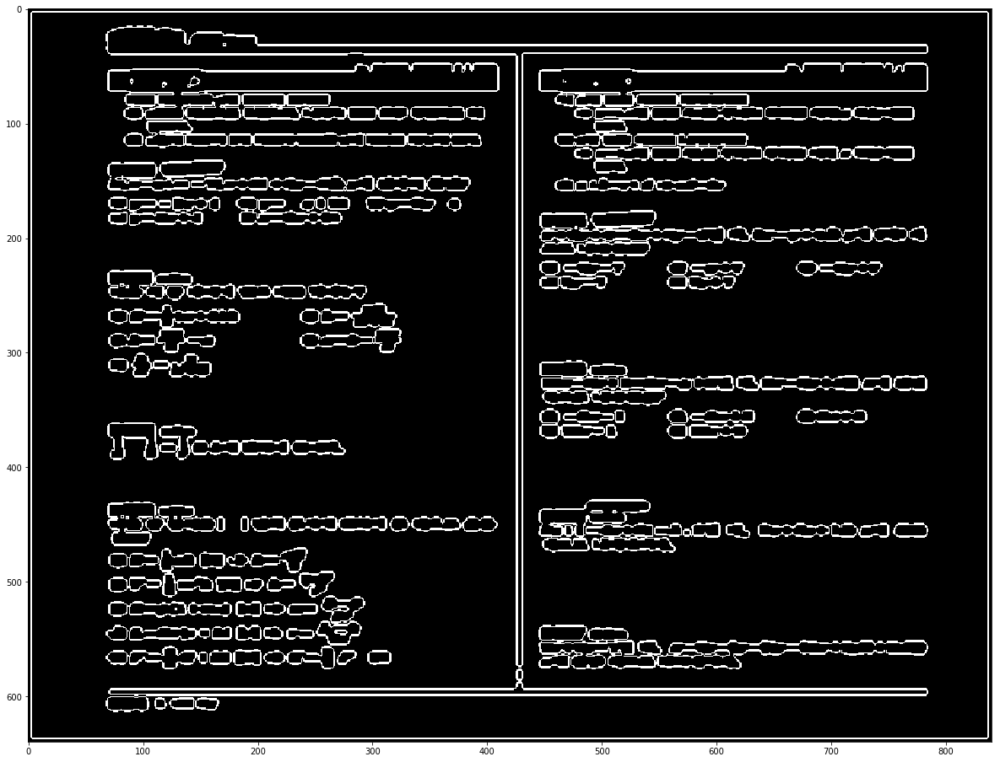

2  Pattern
IMG =  055 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

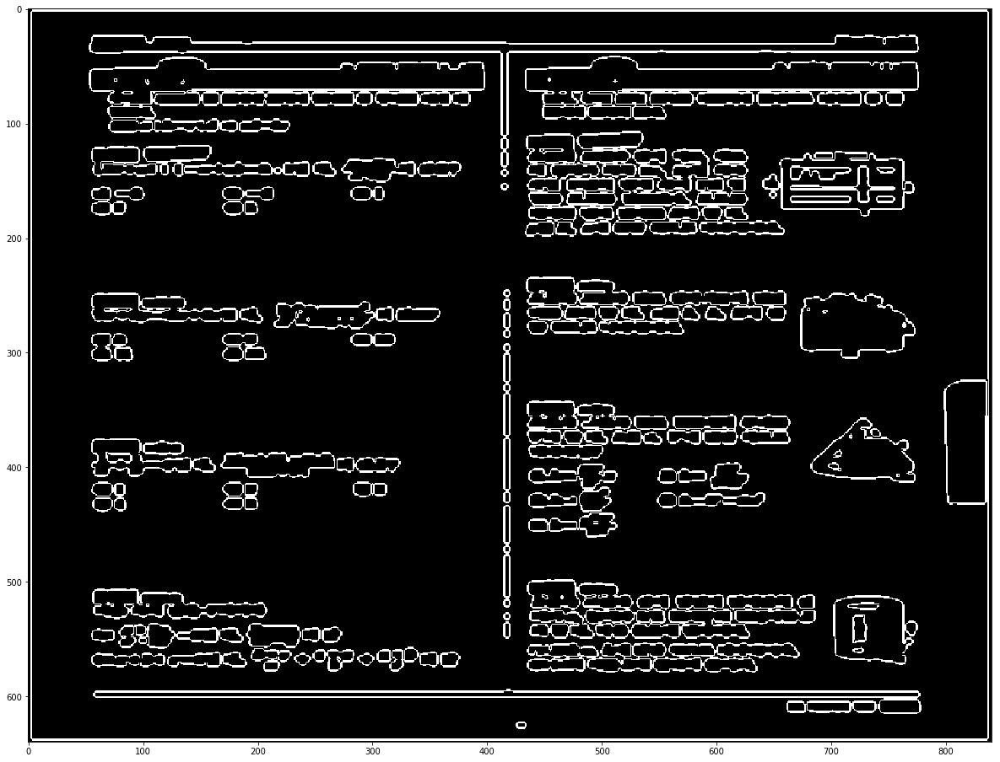

0  Pattern
IMG =  066 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

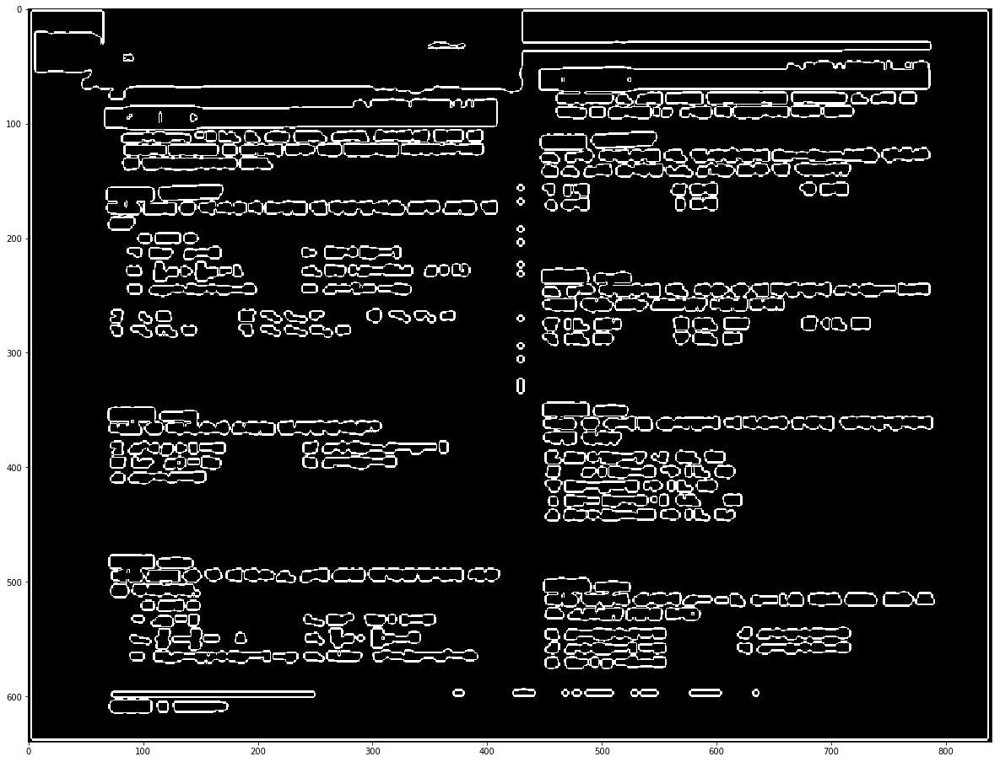

3  Pattern
IMG =  068 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

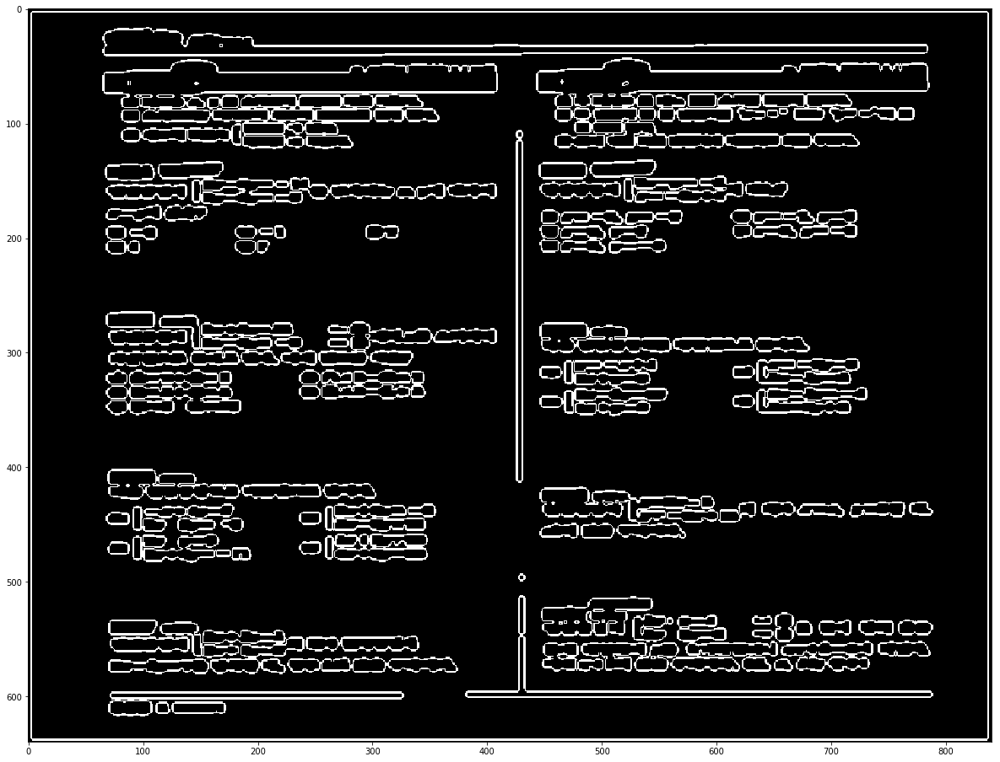

3  Pattern
IMG =  069 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

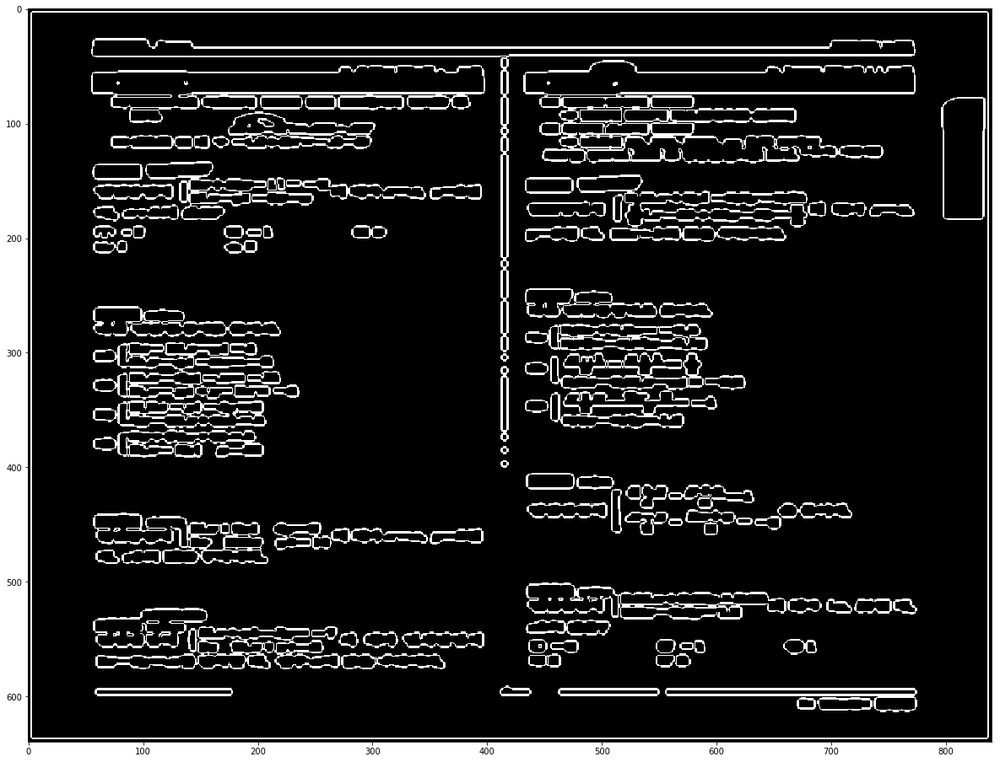

0  Pattern
IMG =  071 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

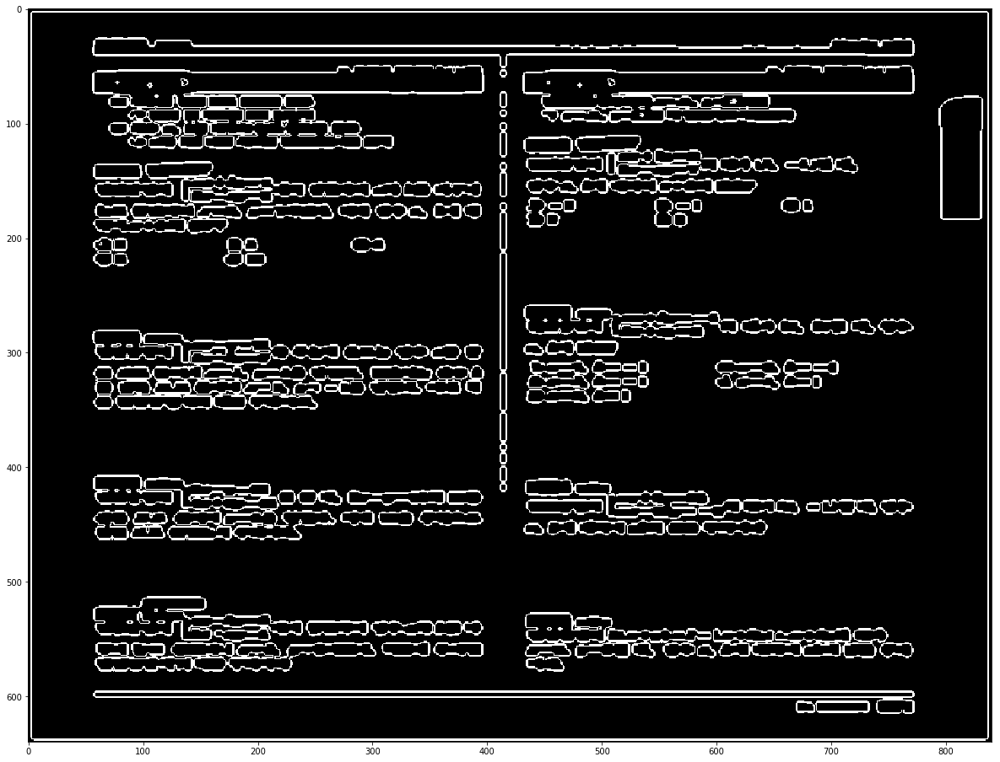

2  Pattern
IMG =  072 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

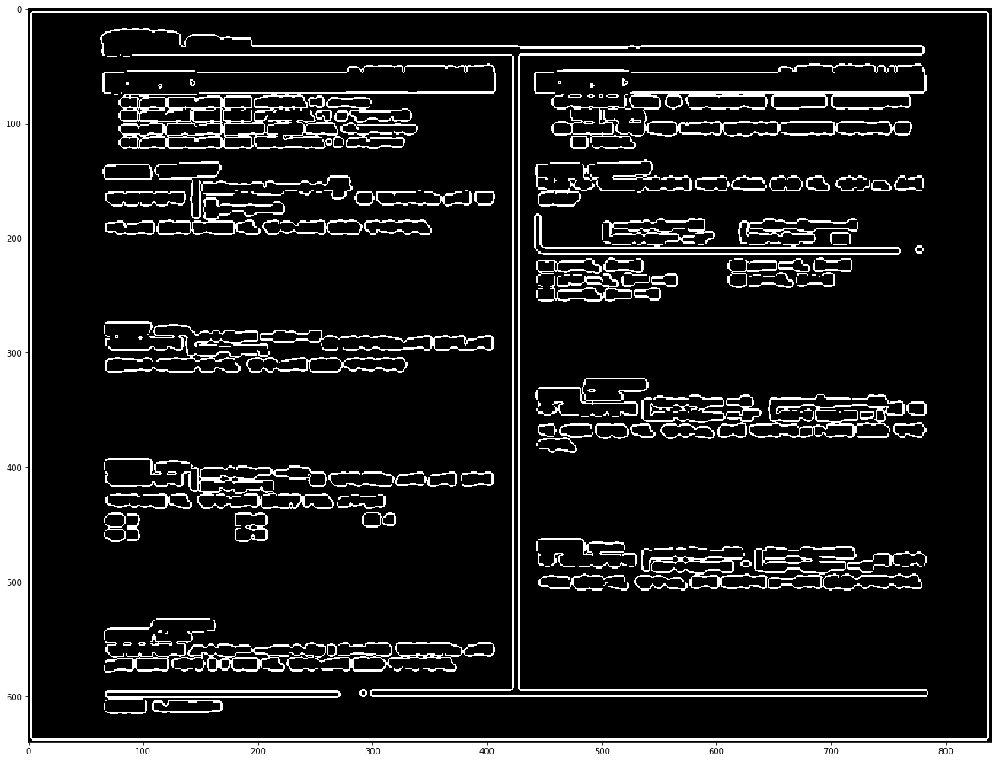

1  Pattern
IMG =  073 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

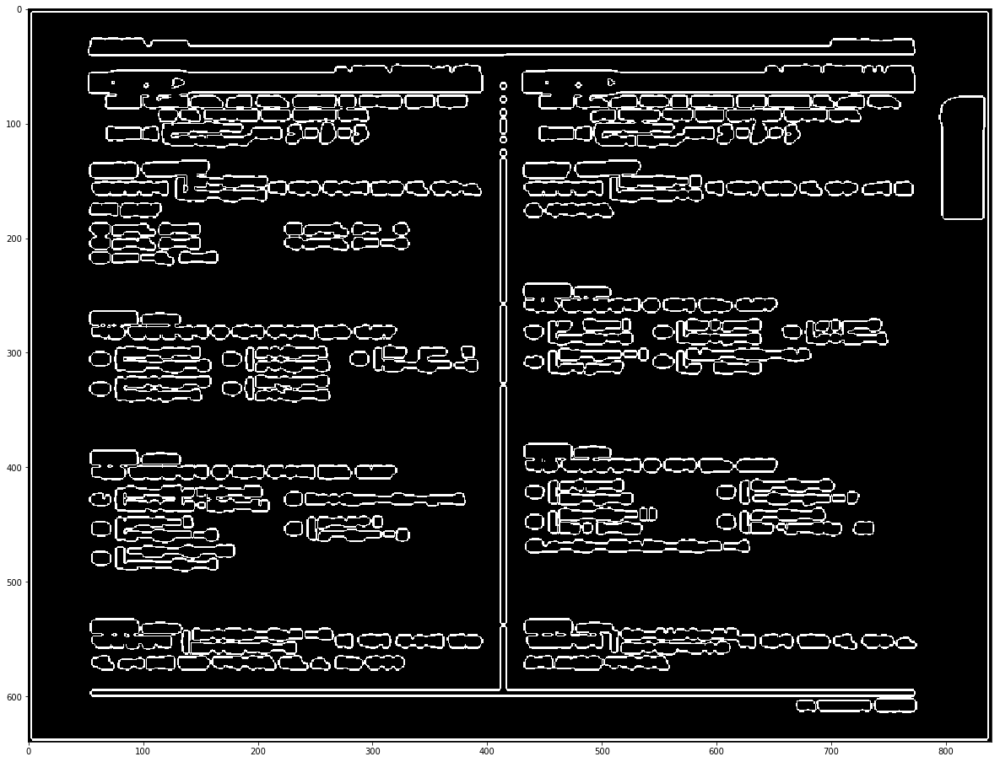

1  Pattern
IMG =  081 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

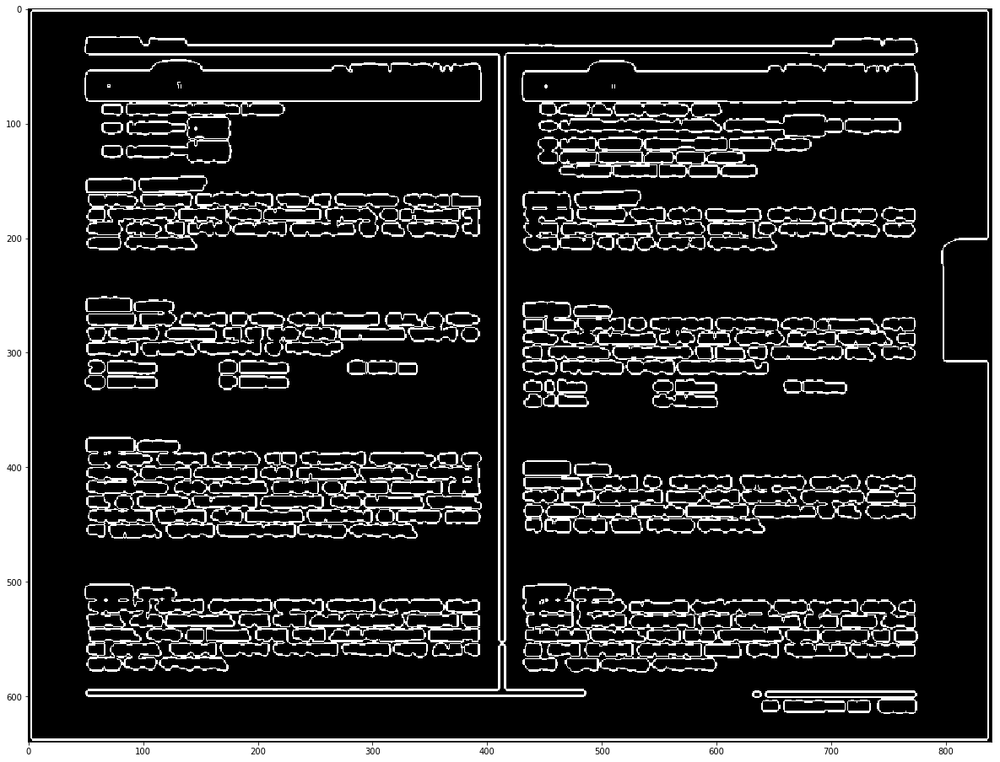

2  Pattern
IMG =  082 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

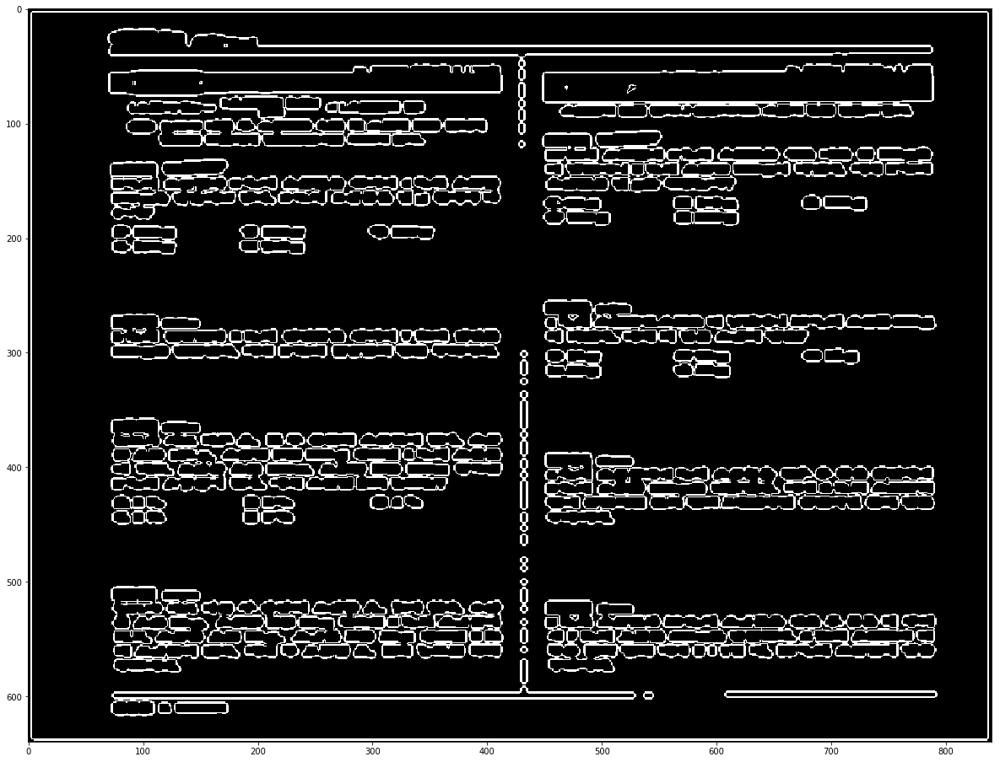

0  Pattern
IMG =  083 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

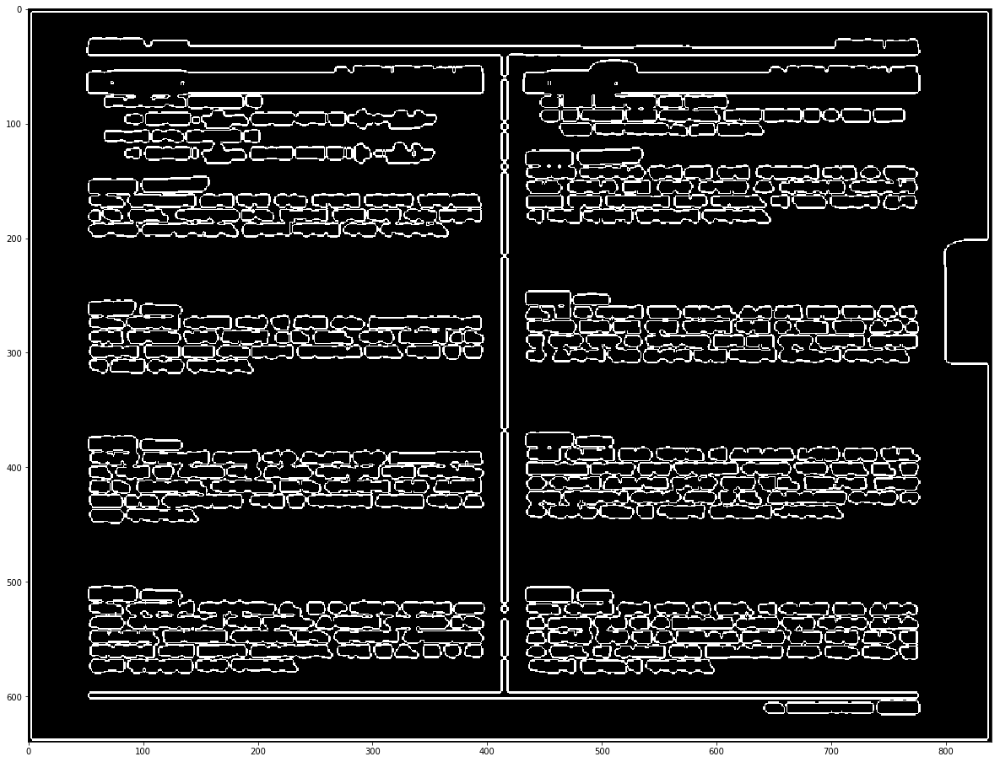

3  Pattern
IMG =  097 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

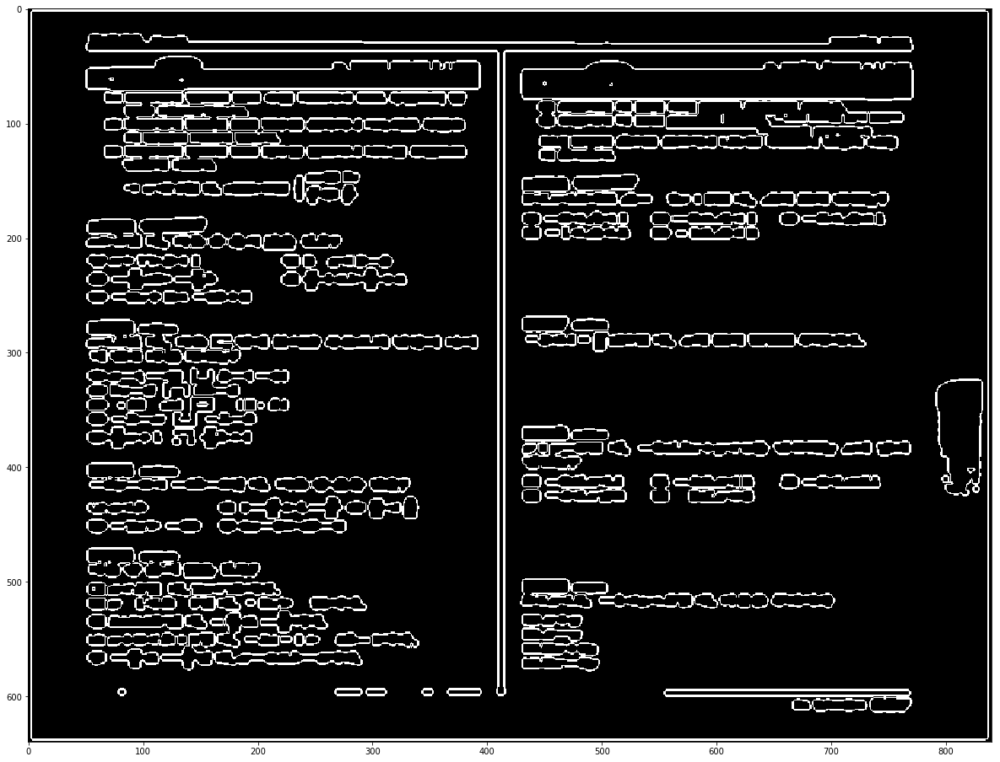

3  Pattern
IMG =  099 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

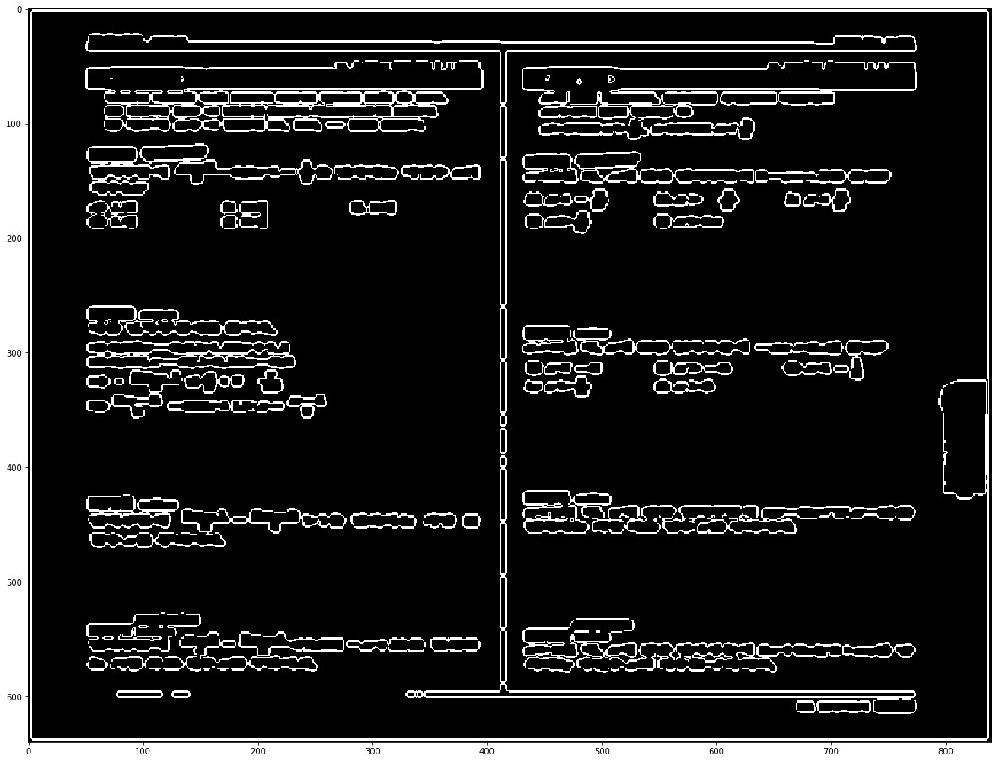

0  Pattern
IMG =  100 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

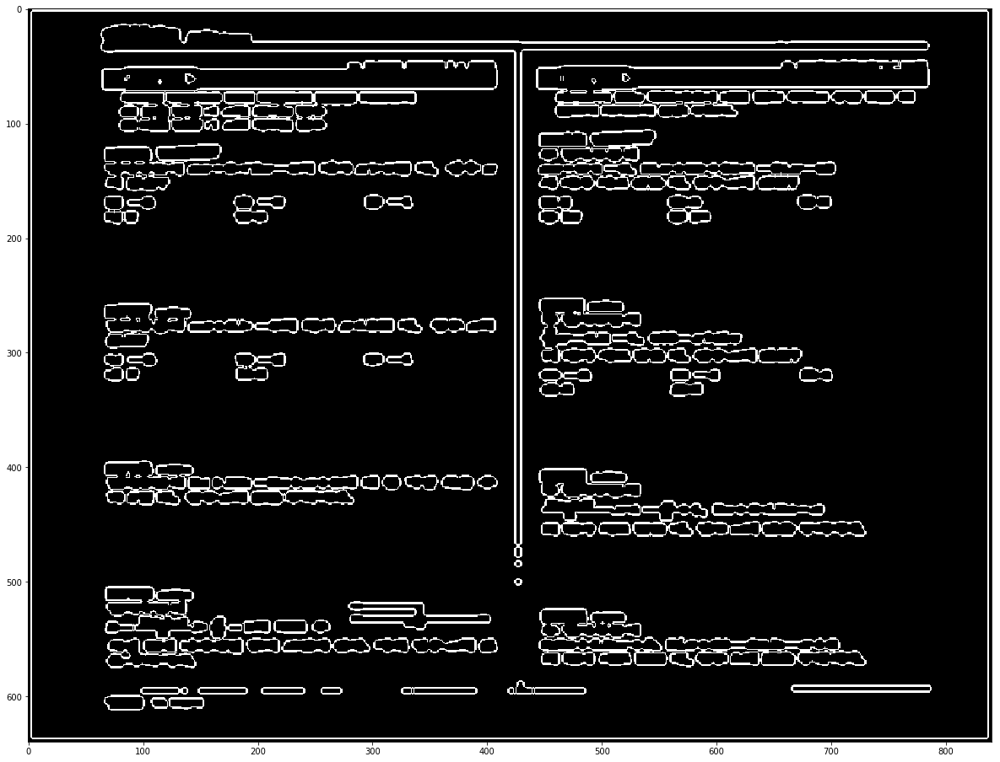

2  Pattern
IMG =  102 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

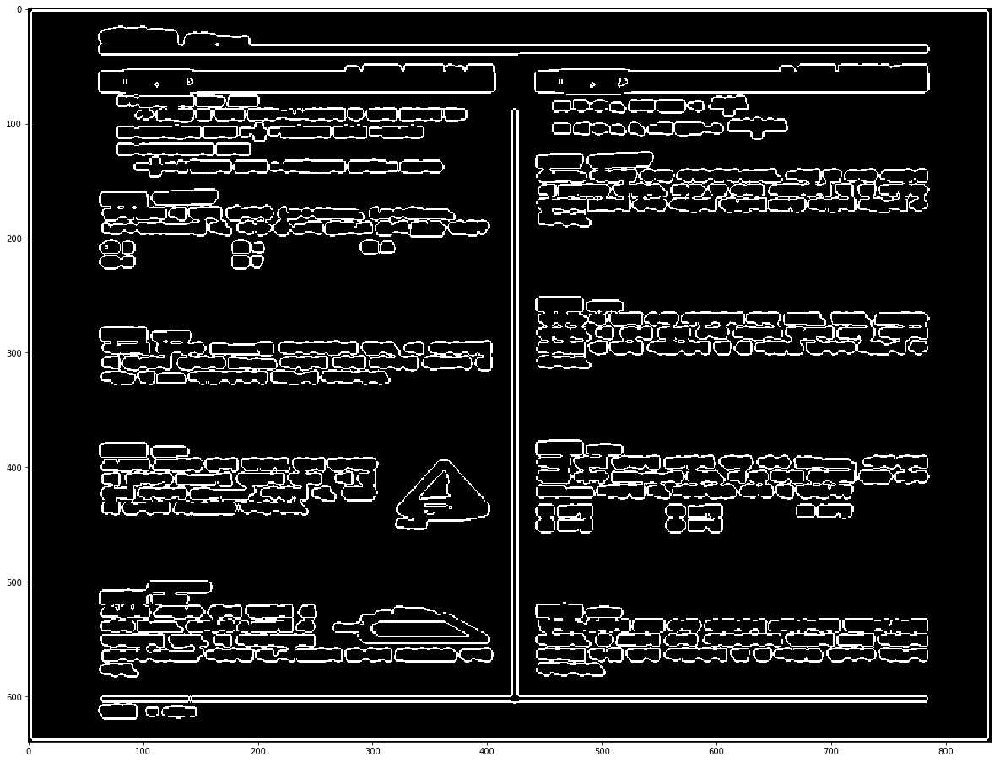

1  Pattern
IMG =  103 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

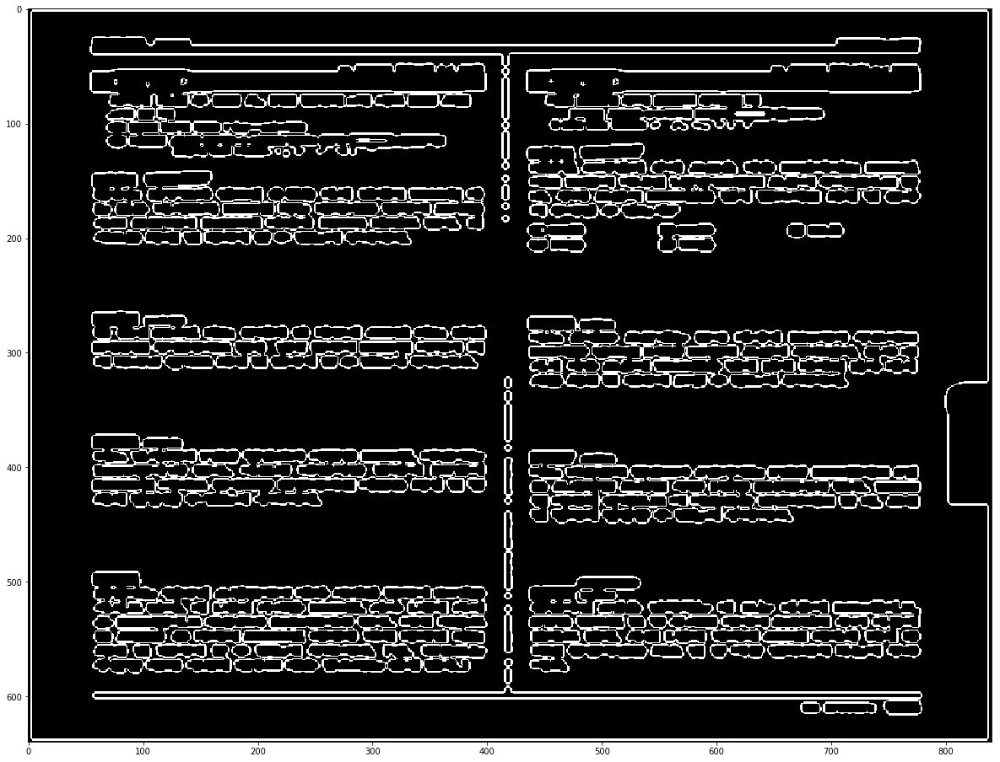

1  Pattern
IMG =  104 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

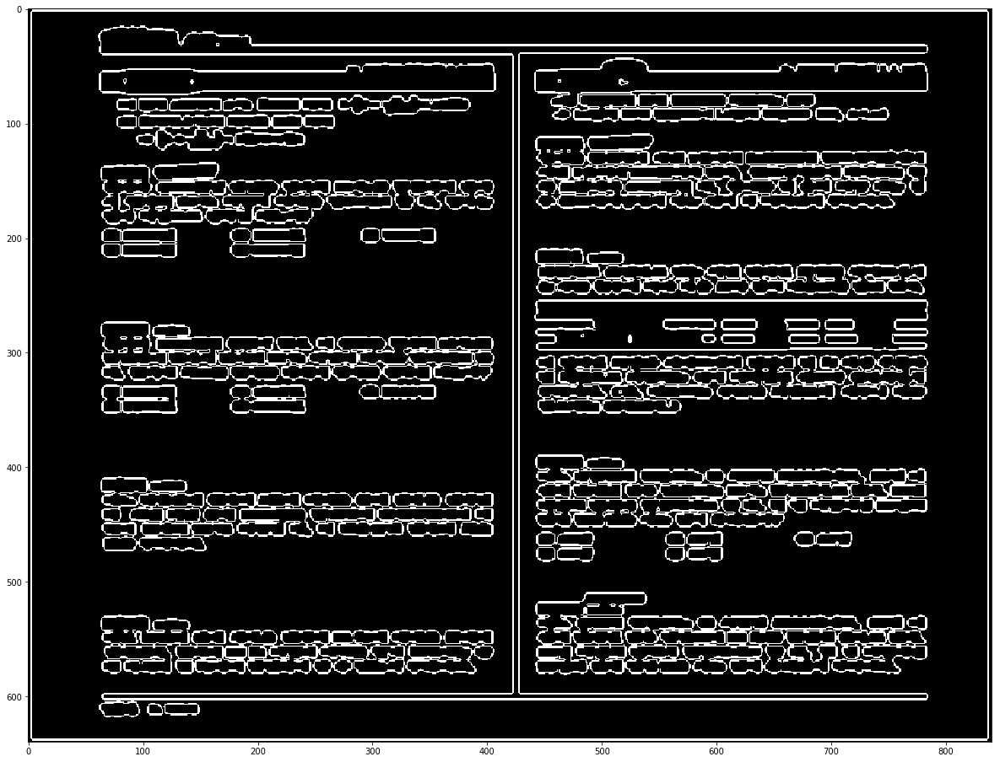

2  Pattern
IMG =  105 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

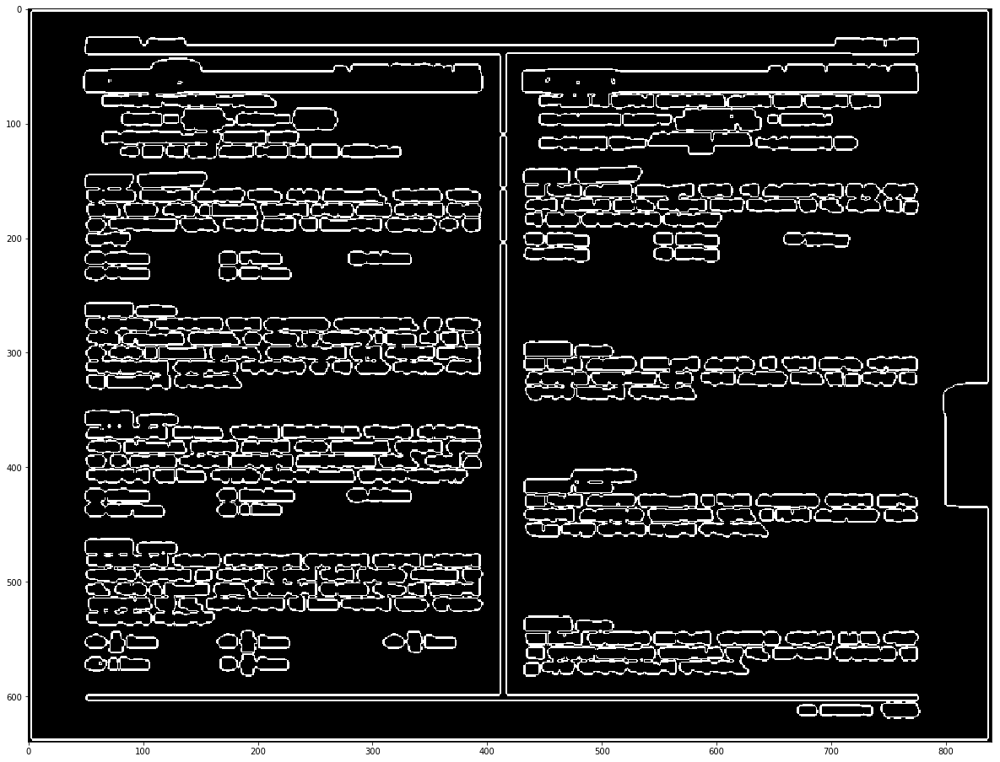

0  Pattern
IMG =  114 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

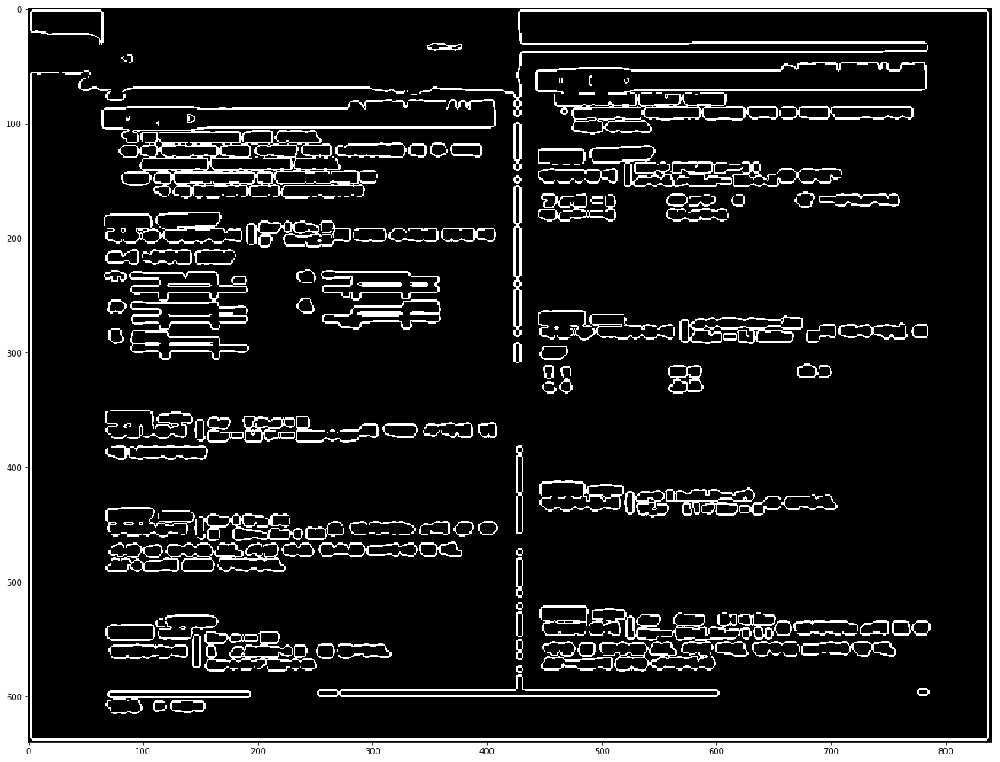

3  Pattern
IMG =  115 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

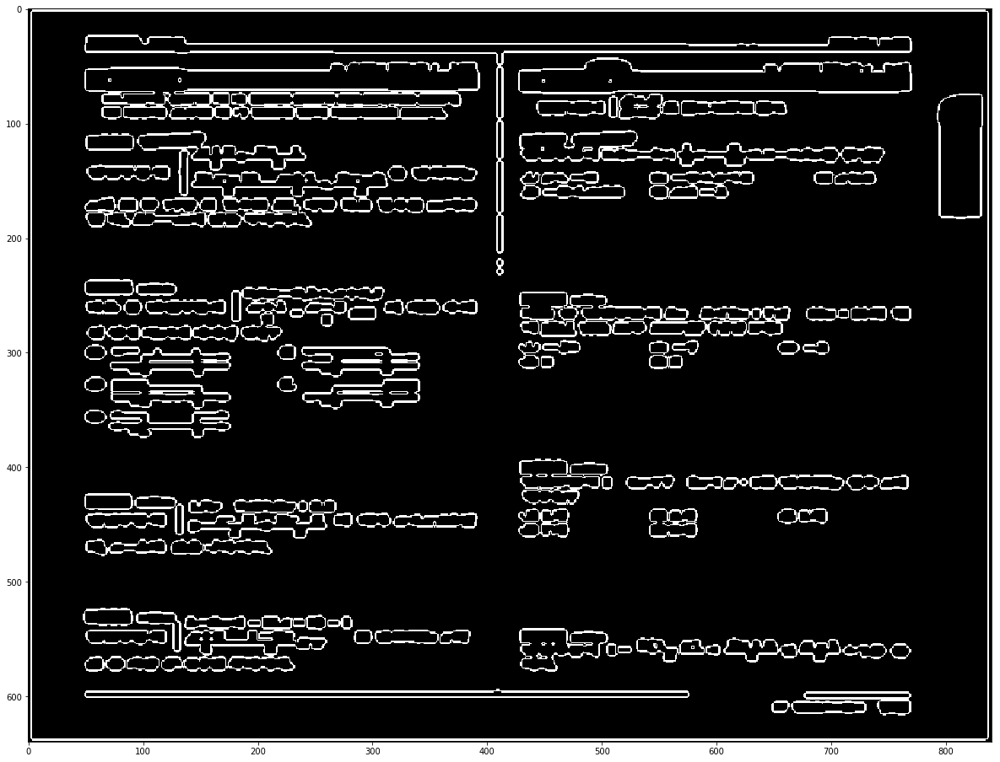

3  Pattern
IMG =  116 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

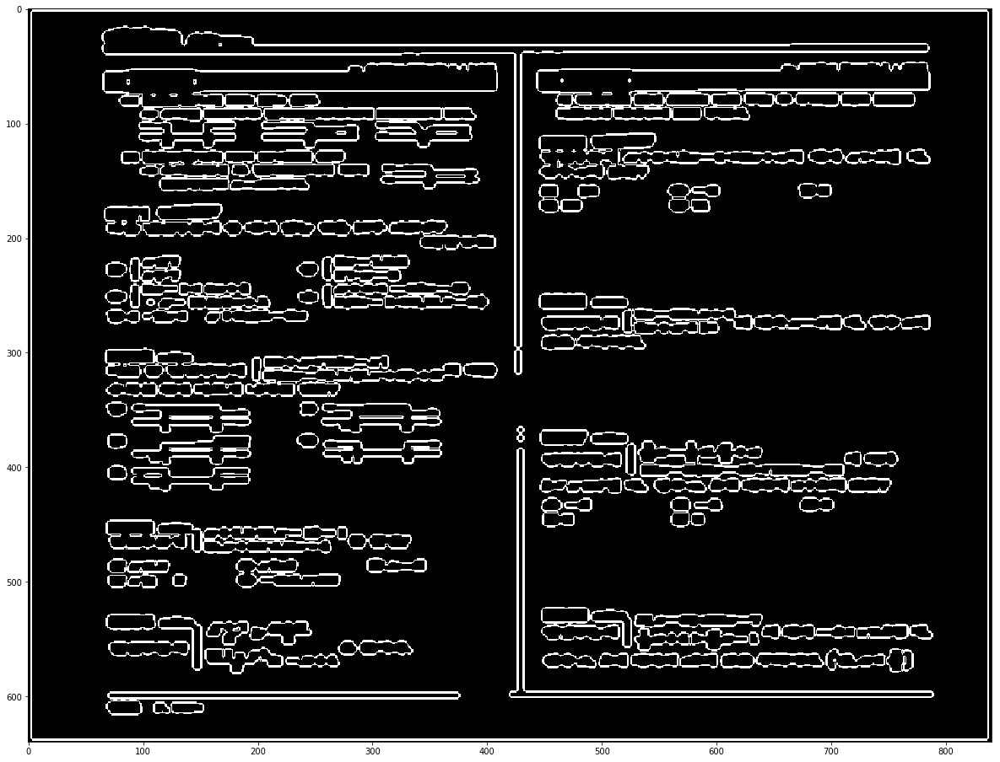

0  Pattern
IMG =  117 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

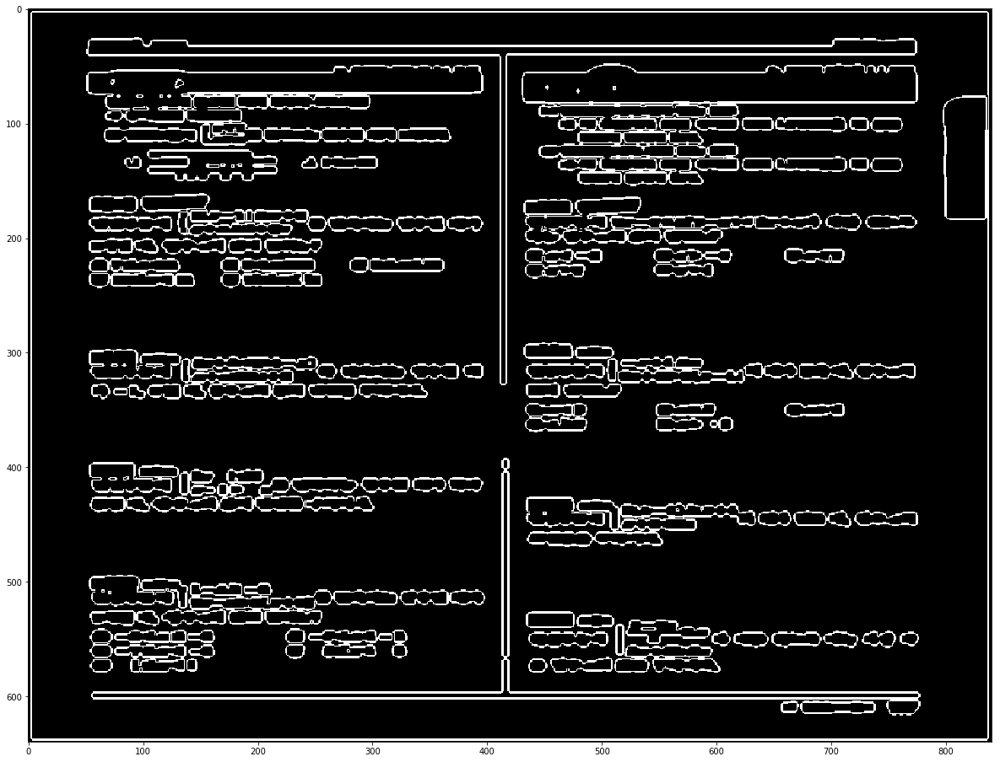

2  Pattern
IMG =  118 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

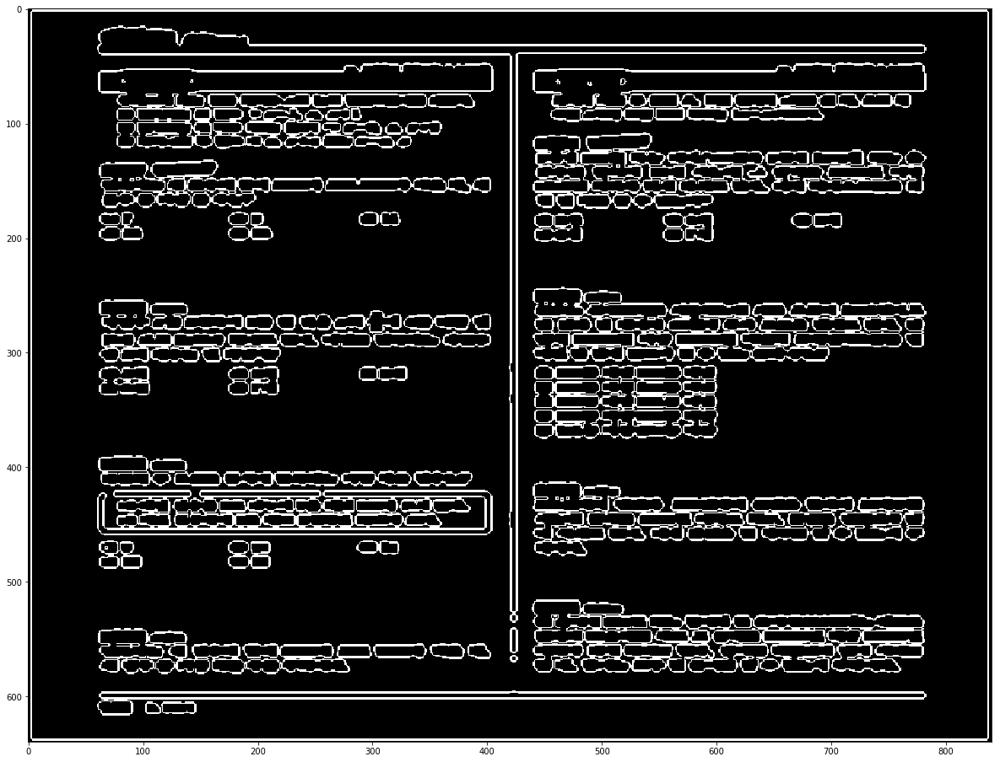

1  Pattern
IMG =  119 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

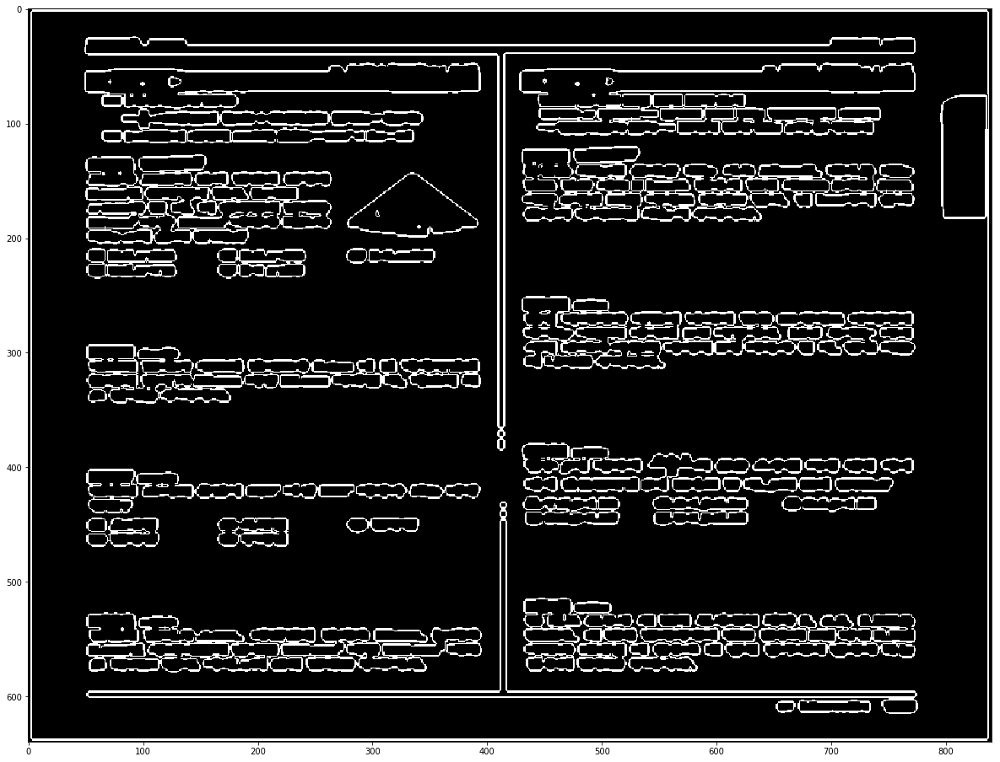

1  Pattern
IMG =  120 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

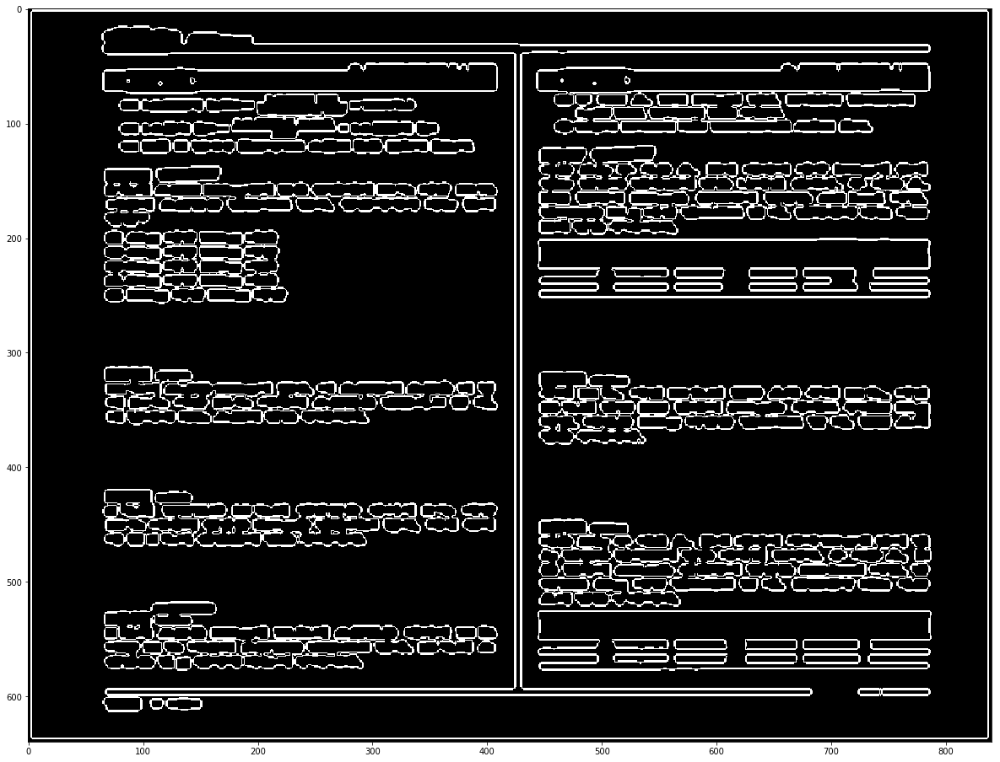

2  Pattern
IMG =  121 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

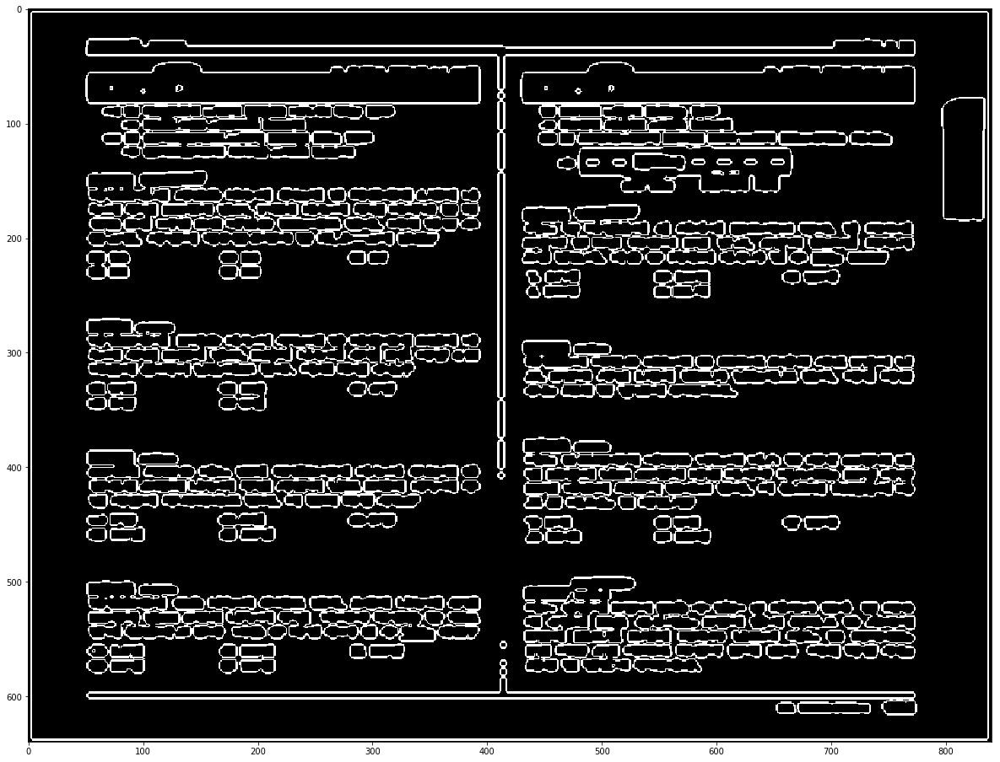

0  Pattern
IMG =  132 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

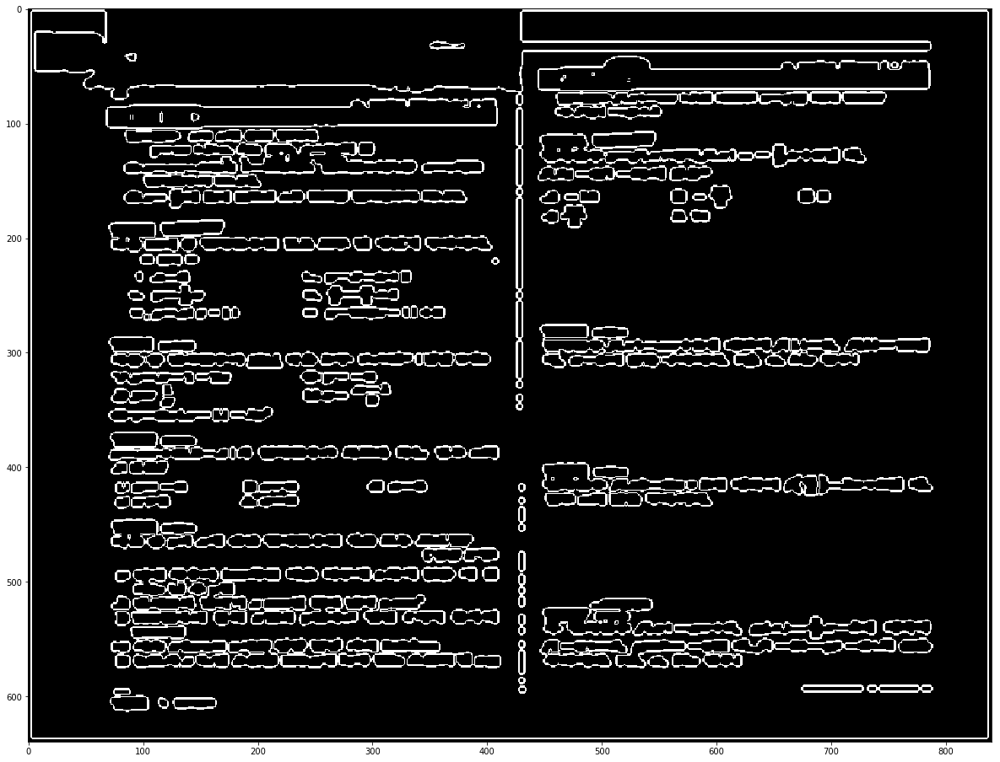

3  Pattern
IMG =  133 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

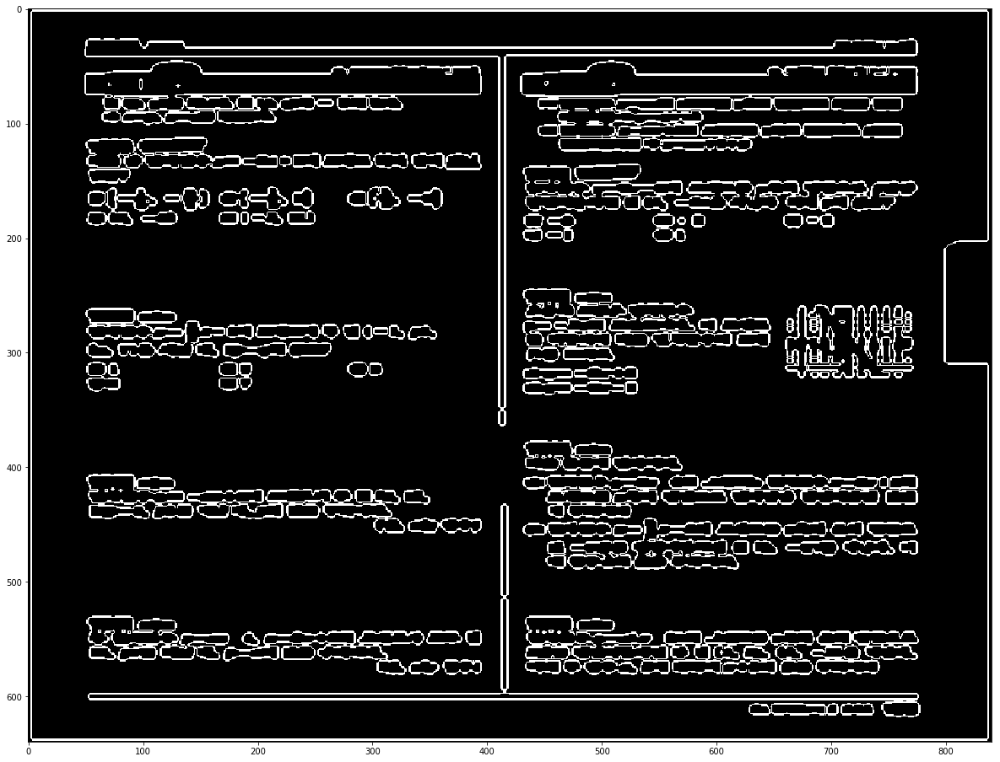

3  Pattern
IMG =  134 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

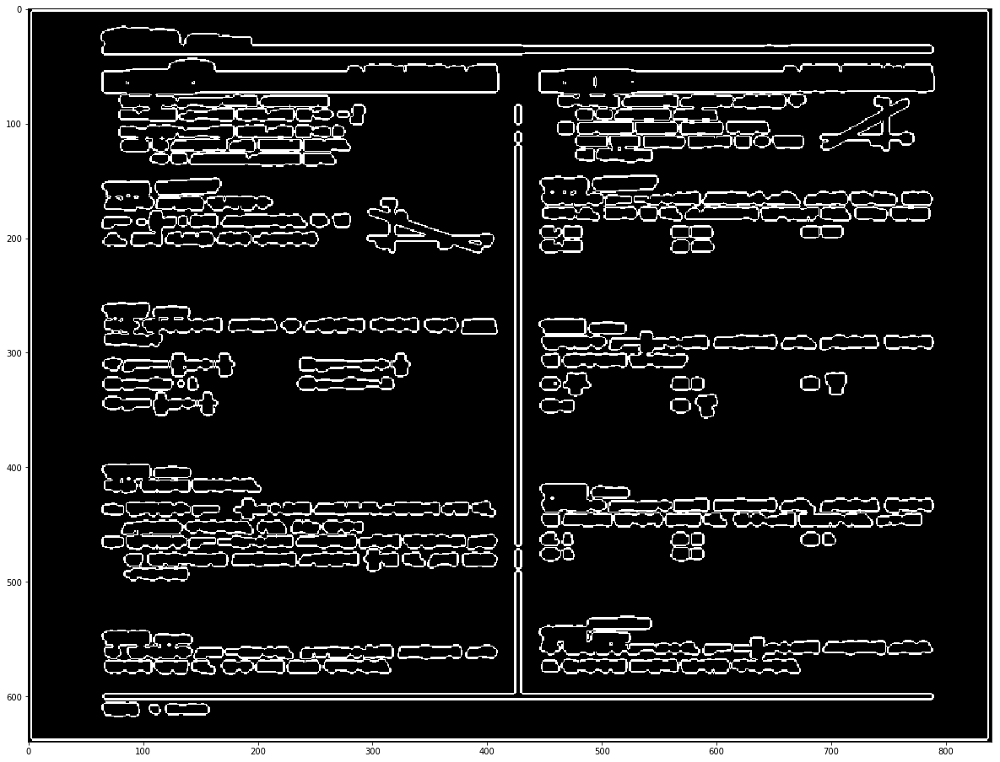

0  Pattern
IMG =  135 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

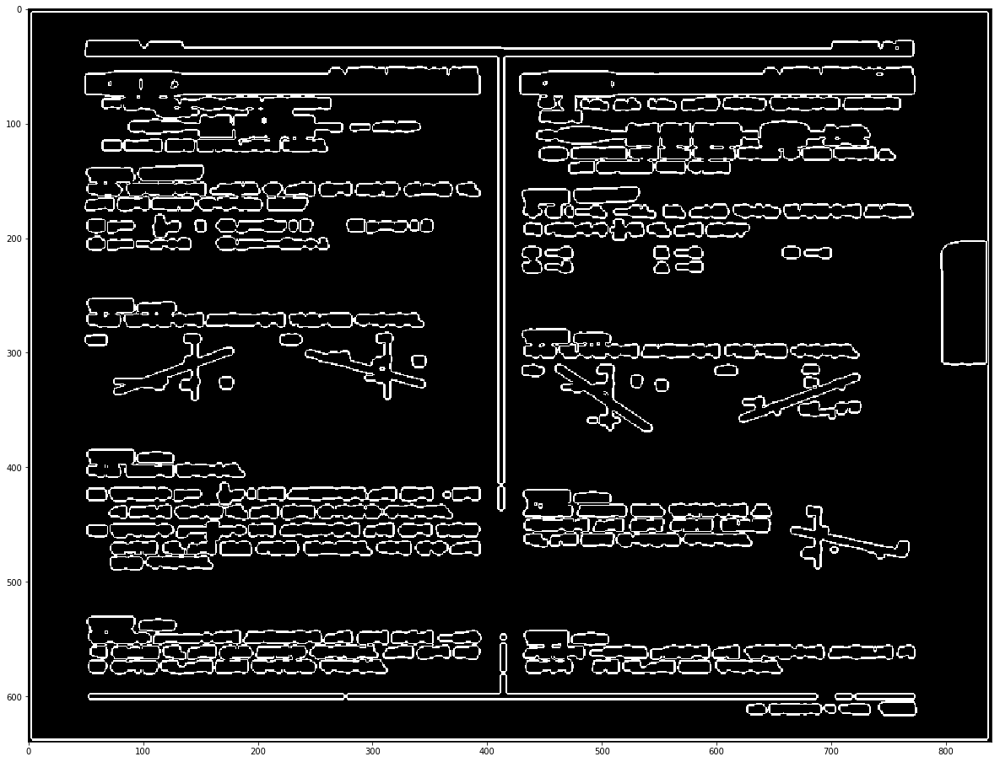

2  Pattern
IMG =  137 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

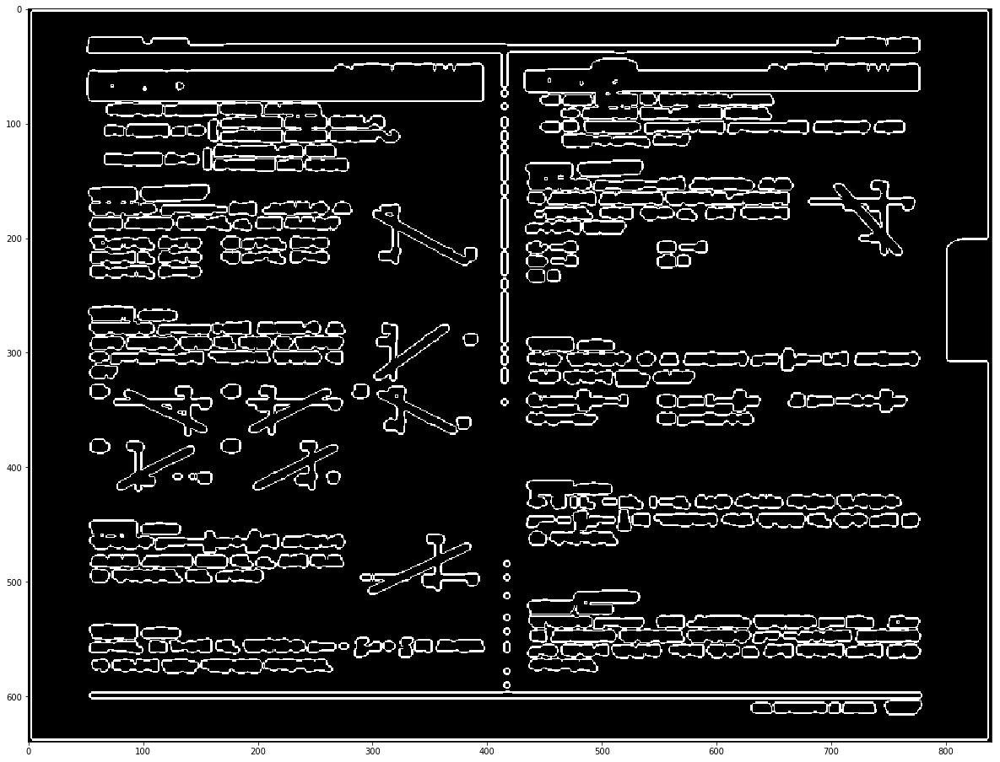

1  Pattern
IMG =  138 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

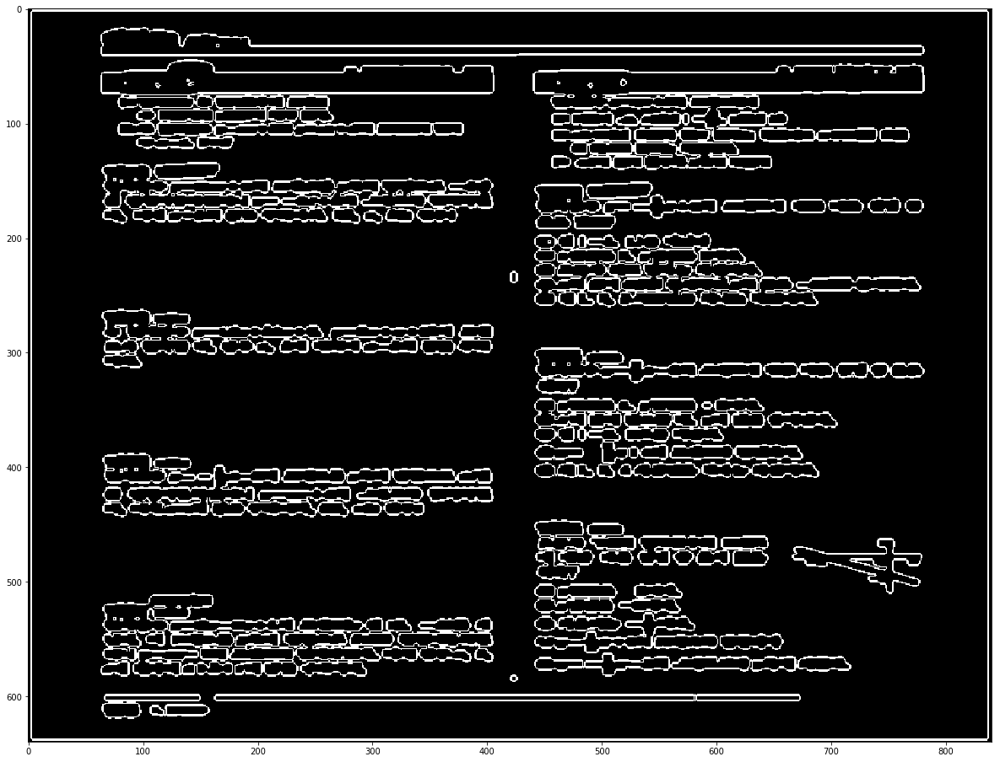

1  Pattern
IMG =  139 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

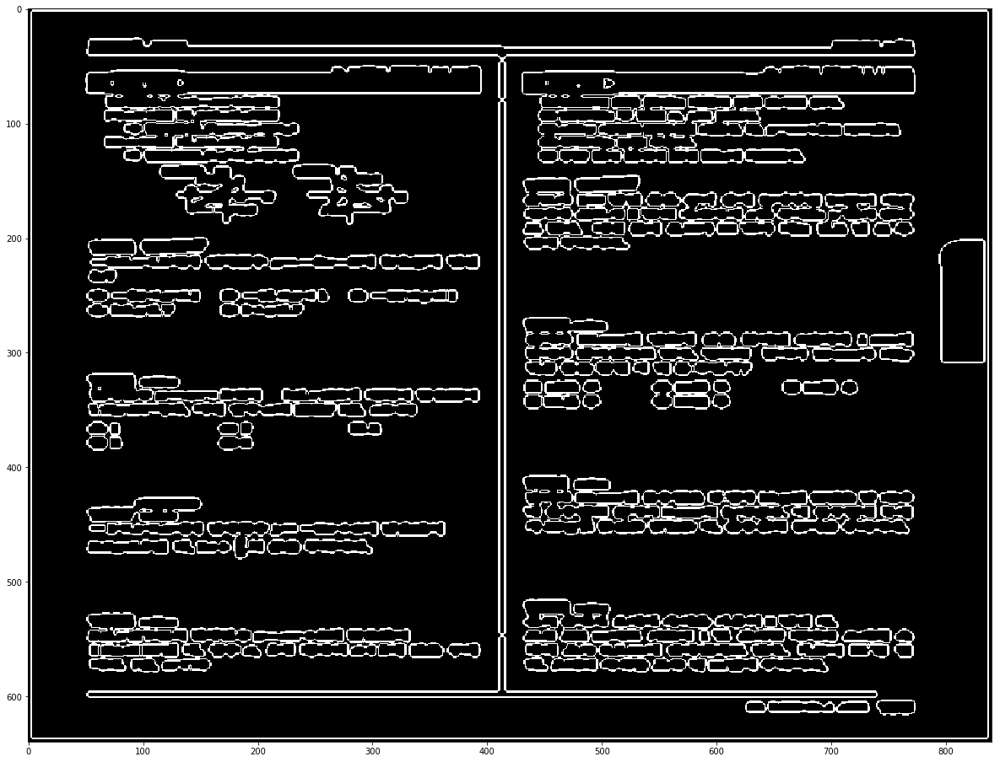

2  Pattern
IMG =  140 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

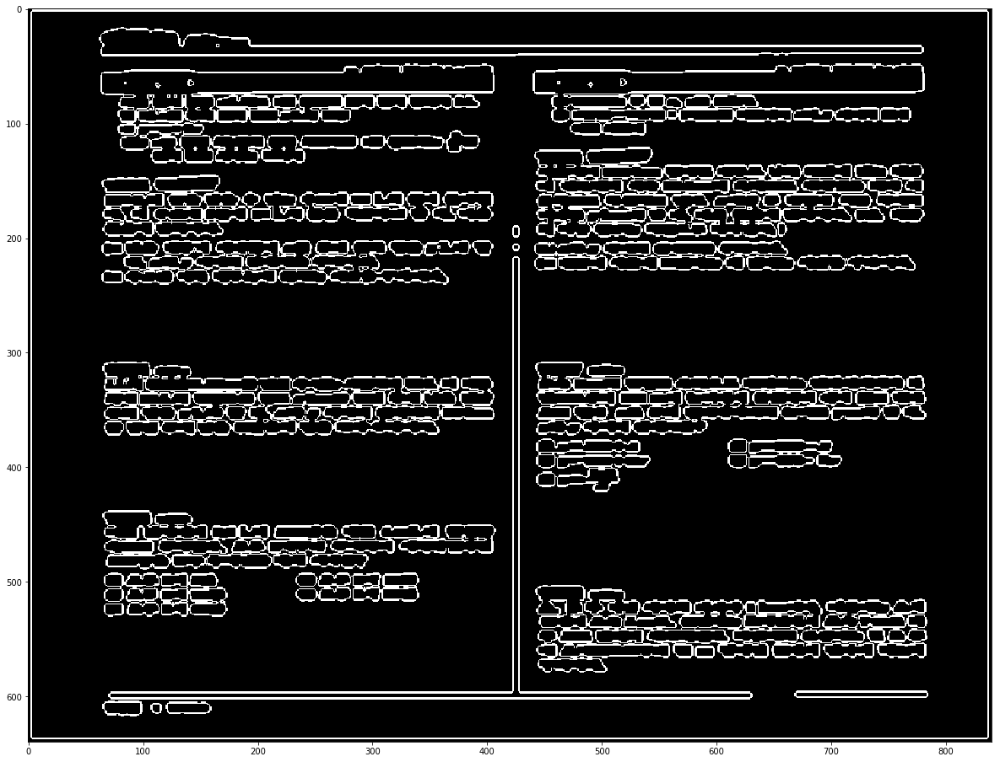

0  Pattern
IMG =  141 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

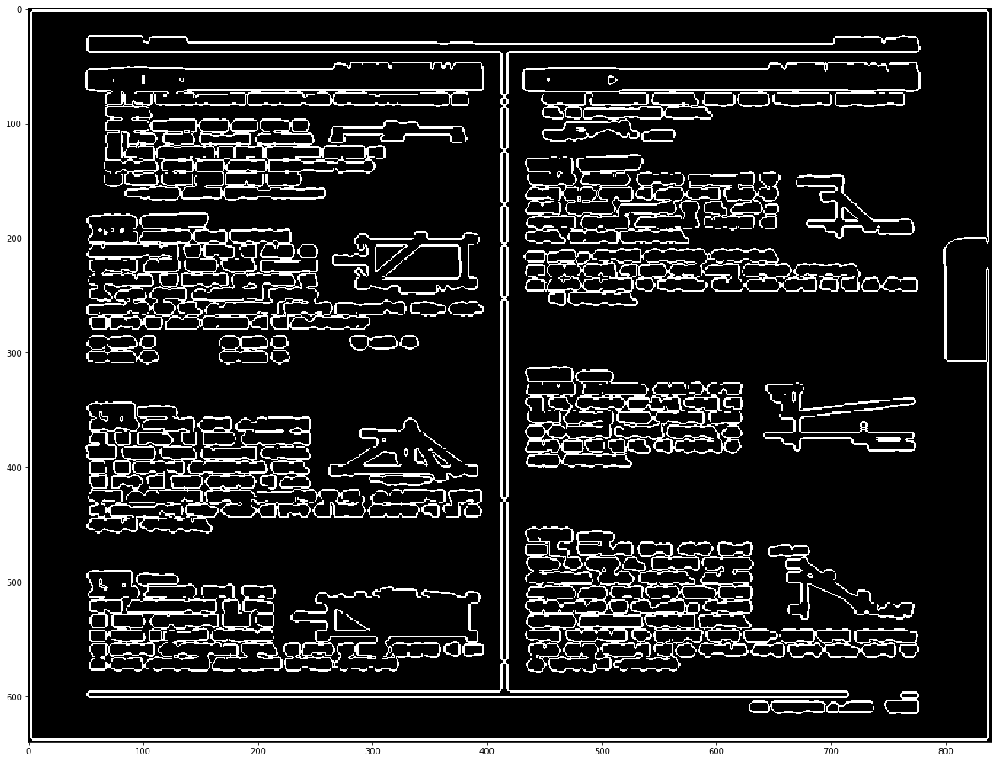

3  Pattern
IMG =  150 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

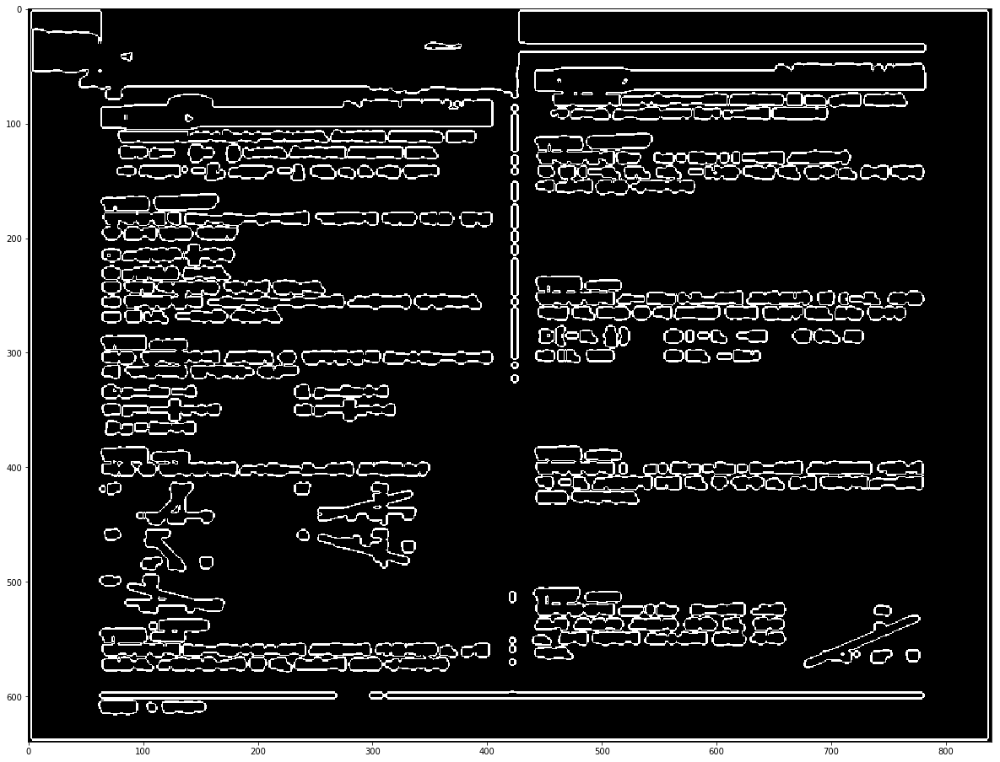

3  Pattern
IMG =  151 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

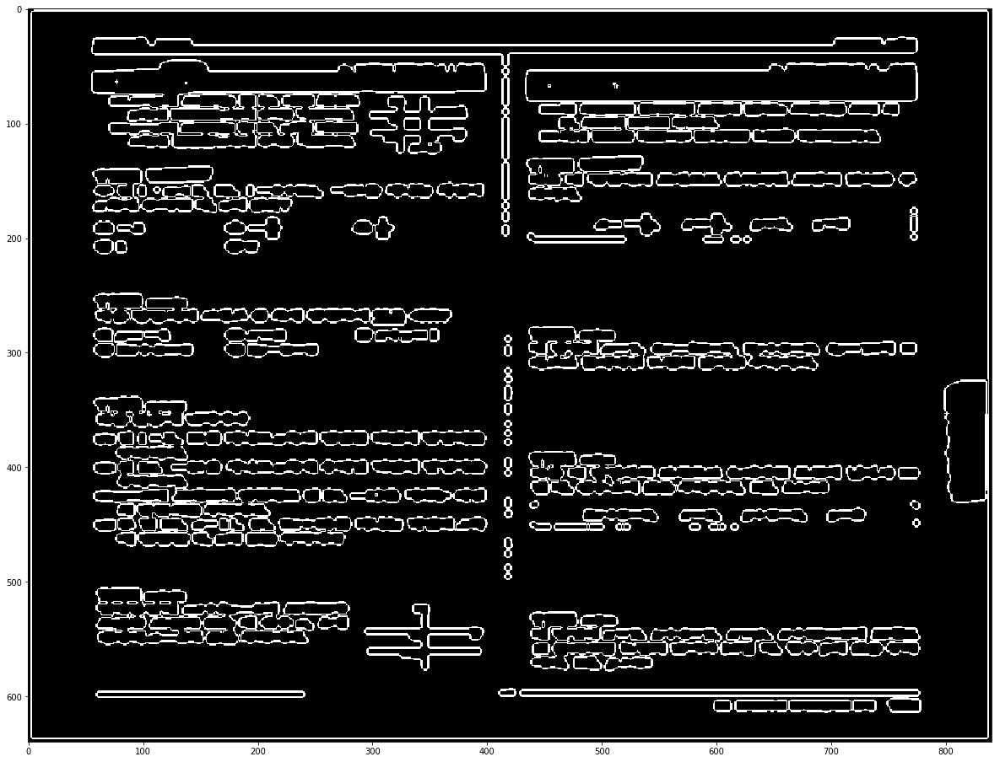

0  Pattern
IMG =  152 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

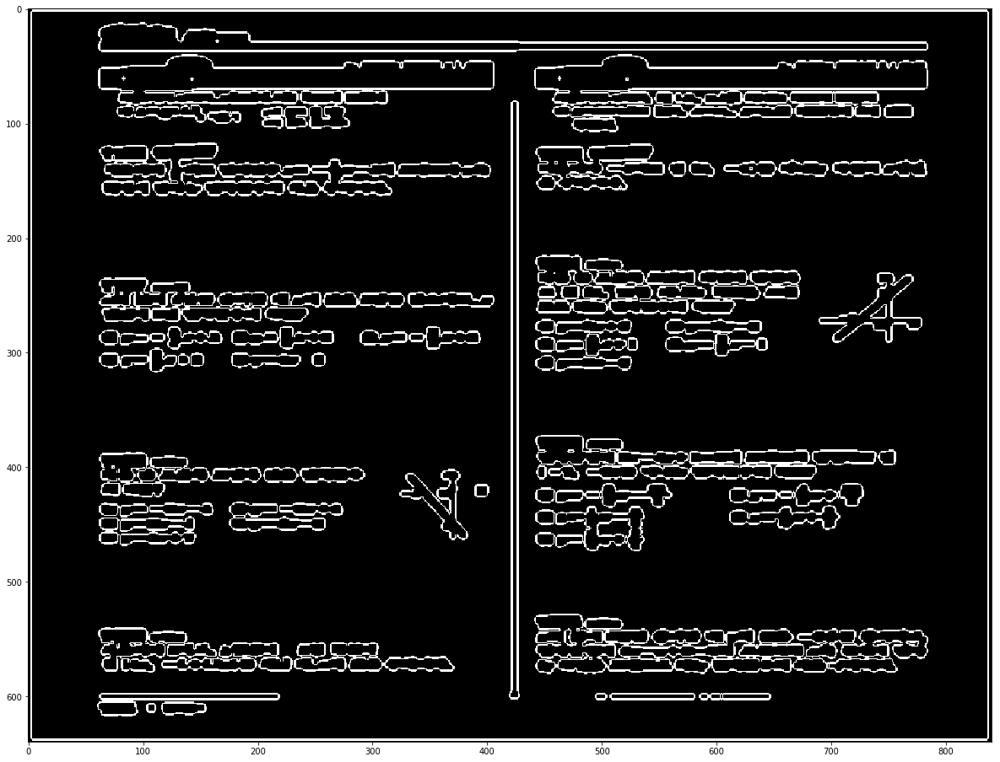

2  Pattern
IMG =  153 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

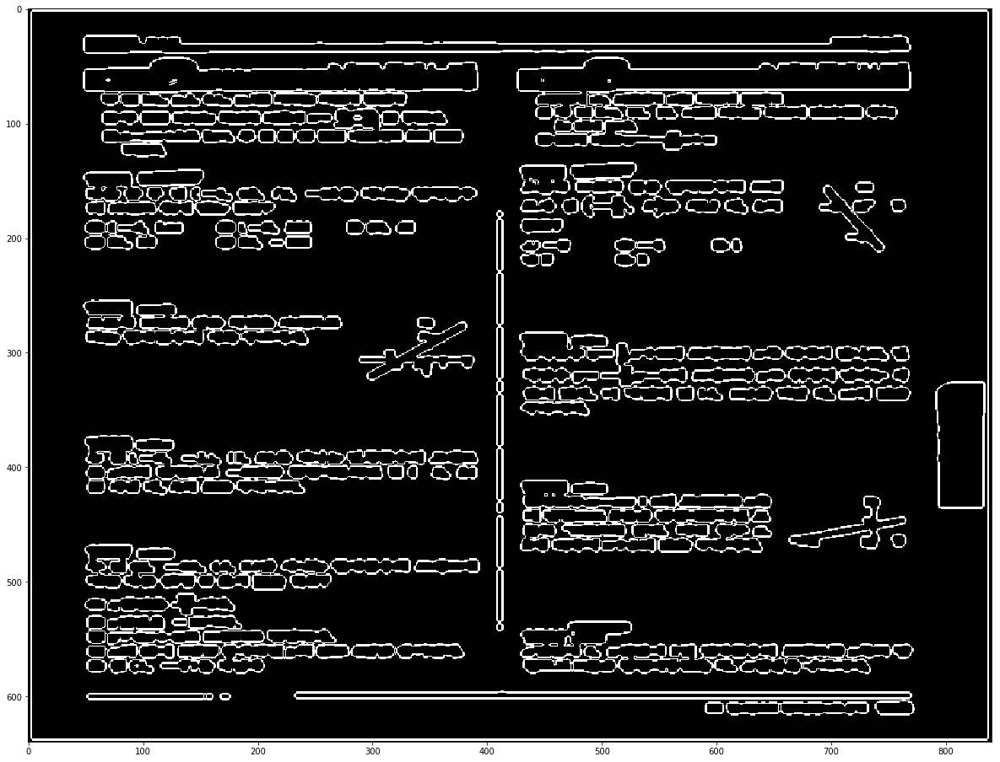

1  Pattern
IMG =  154 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

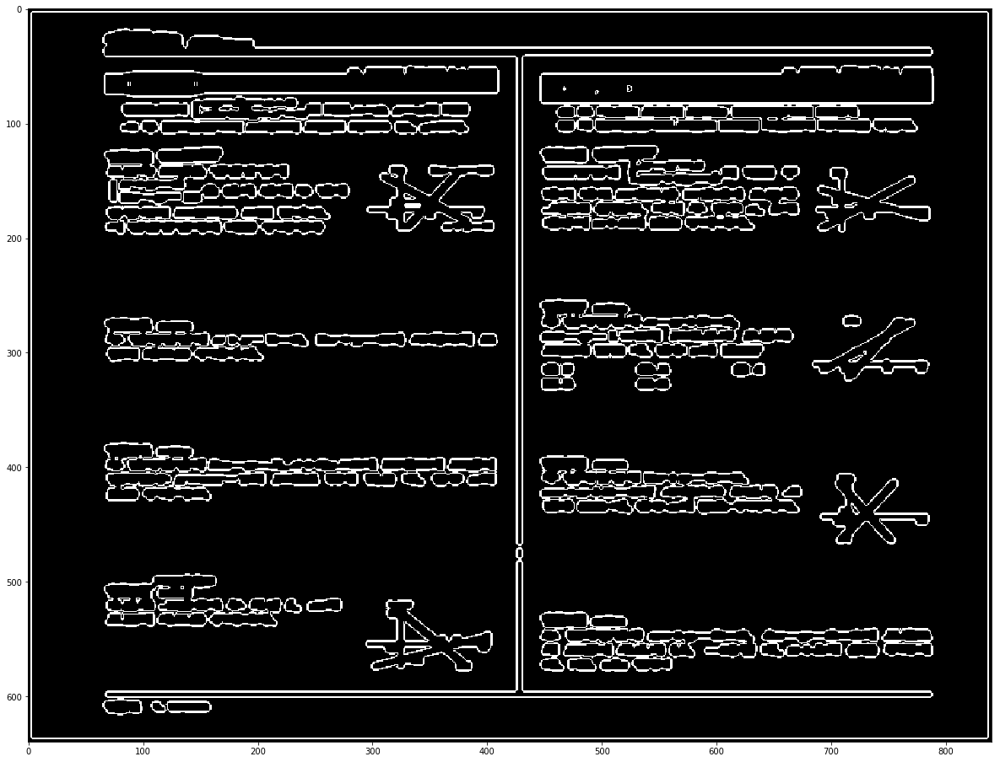

1  Pattern
IMG =  155 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

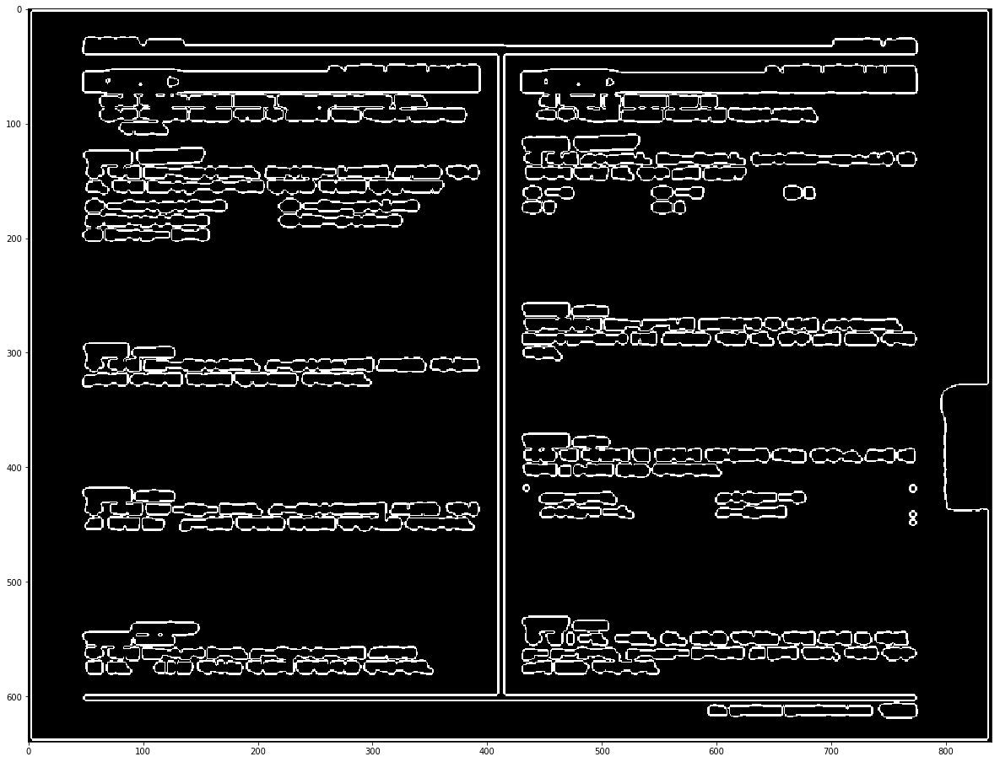

2  Pattern
IMG =  156 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

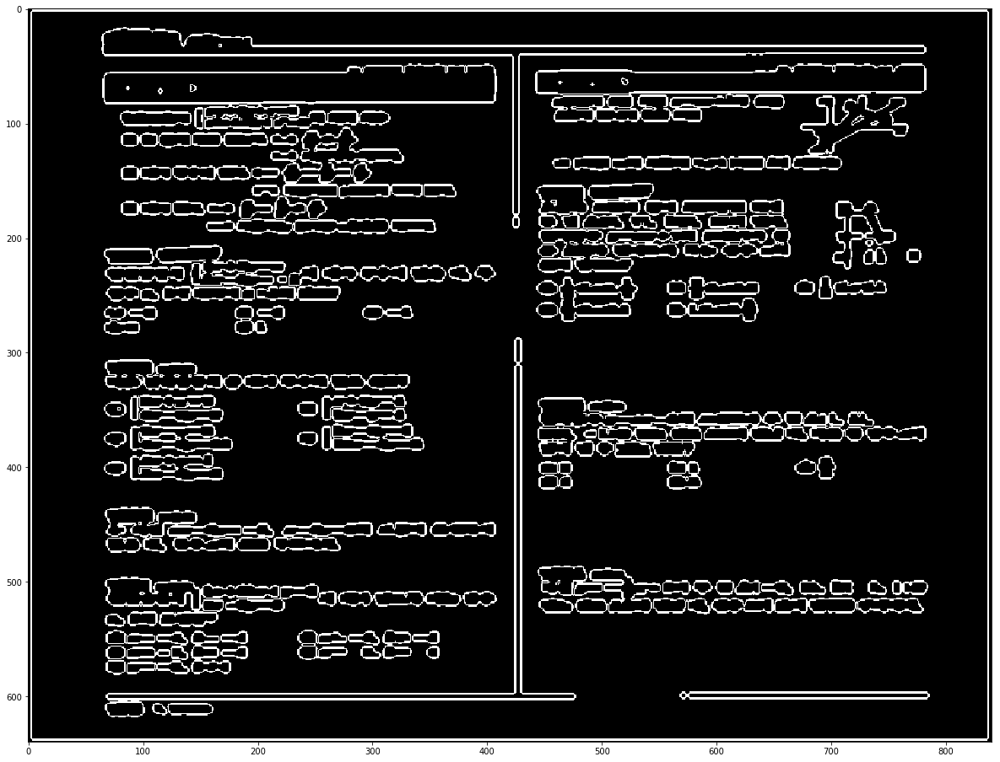

0  Pattern
IMG =  157 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

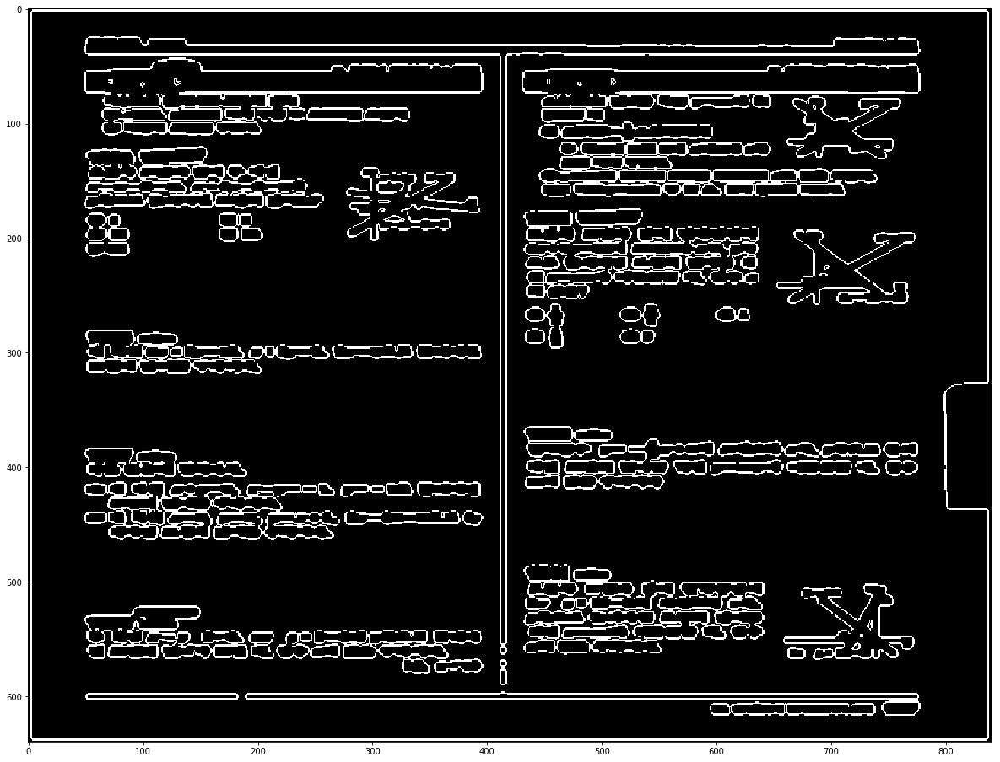

In [9]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

def denoiseWeakCon(img, y_value):
    height, width = img.shape
    upper_img = img[:y_value]
    upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
    img[:y_value] = upper_img
    return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
        fig, ax = plt.subplots(figsize=(30, 16))
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
            
        vmap = filters.median(vmap, selem=np.ones((12,12)))
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseWeakCon(vmap, int(h/4))
        vmap = standardize(vmap)
        
        ax1.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = removeFirst(vmap)
        vmap = denoiseBoundary(vmap, 5, 10)
        if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

        contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.

        for n, contour in enumerate(contours):
            ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()

#     edges = canny(img, sigma=.5)
    thresh_val = threshold_otsu(img)
    img = img > thresh_val
    img = canny(img, sigma=.5)
    fig, ax = plt.subplots(figsize=(30, 16))
    ax.imshow(img, interpolation='nearest', cmap=plt.cm.gray)
#     p = Page(edges)
#     p.getContour()

    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

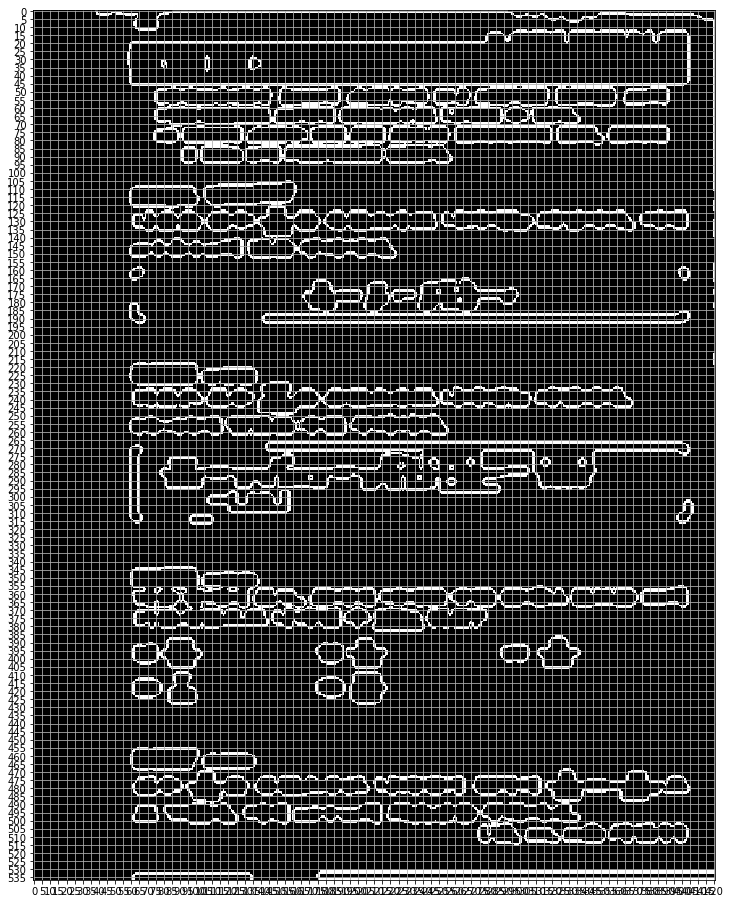

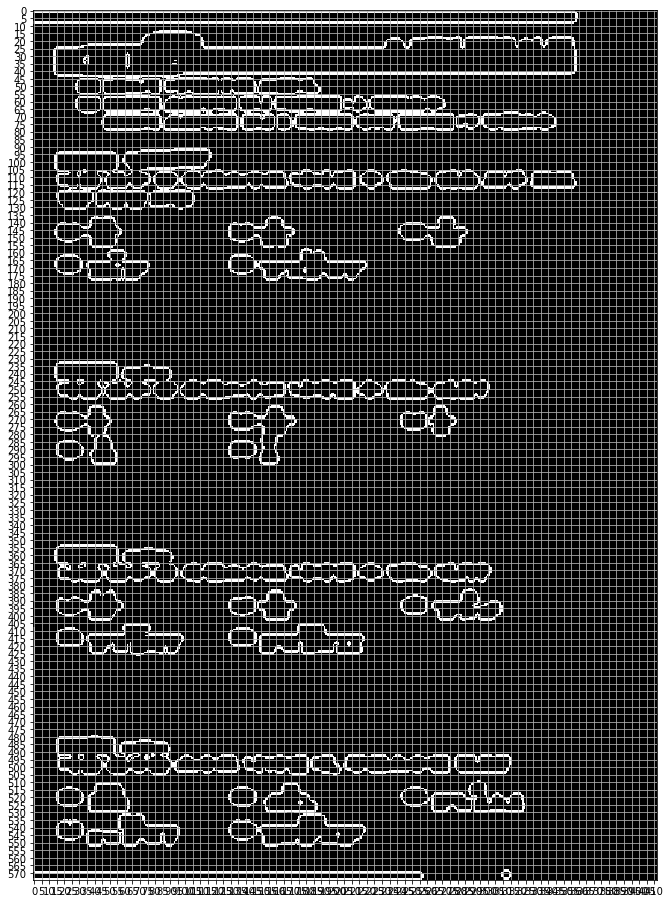

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

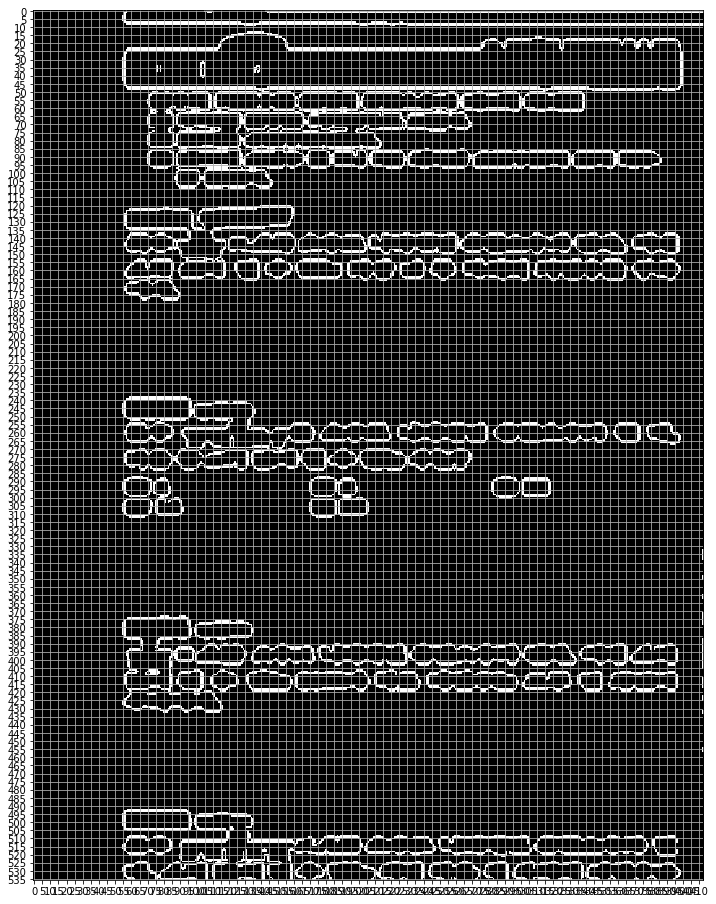

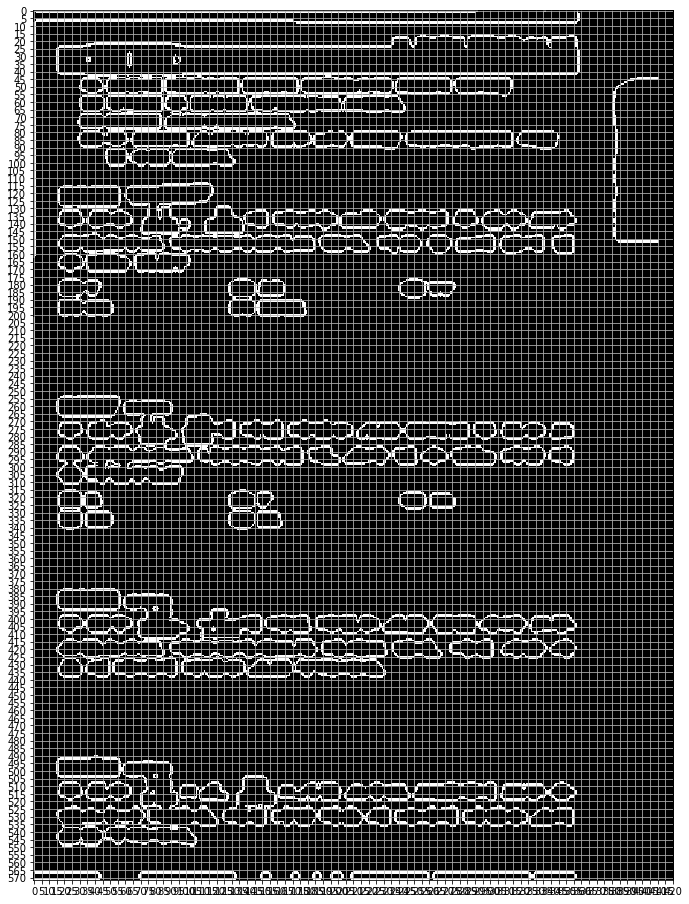

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

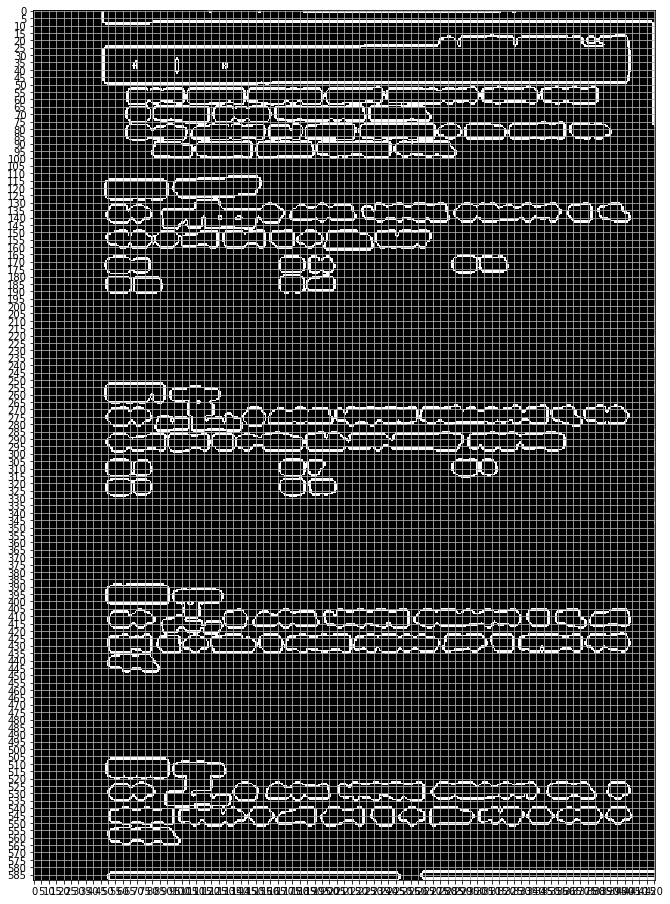

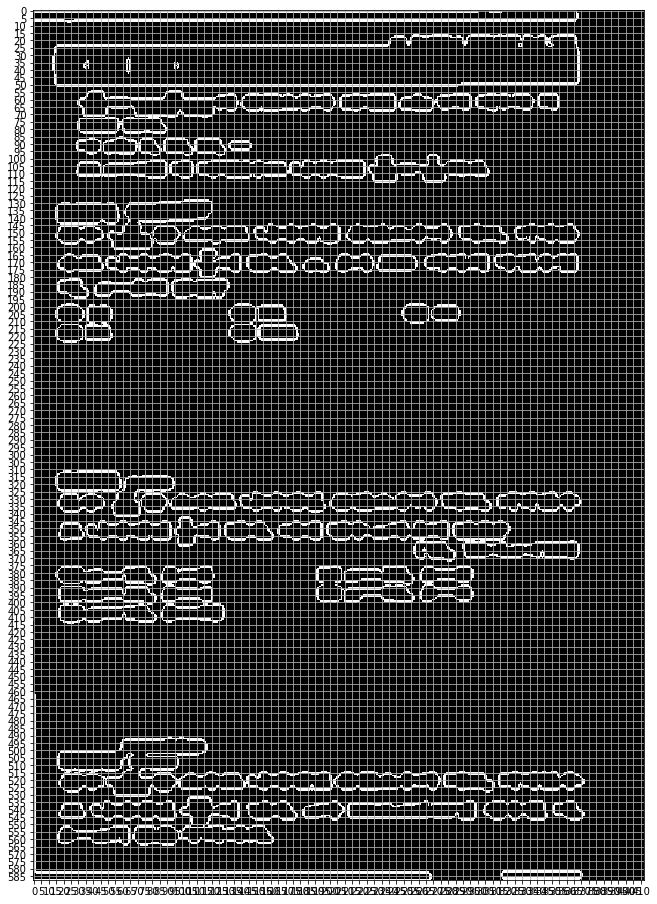

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

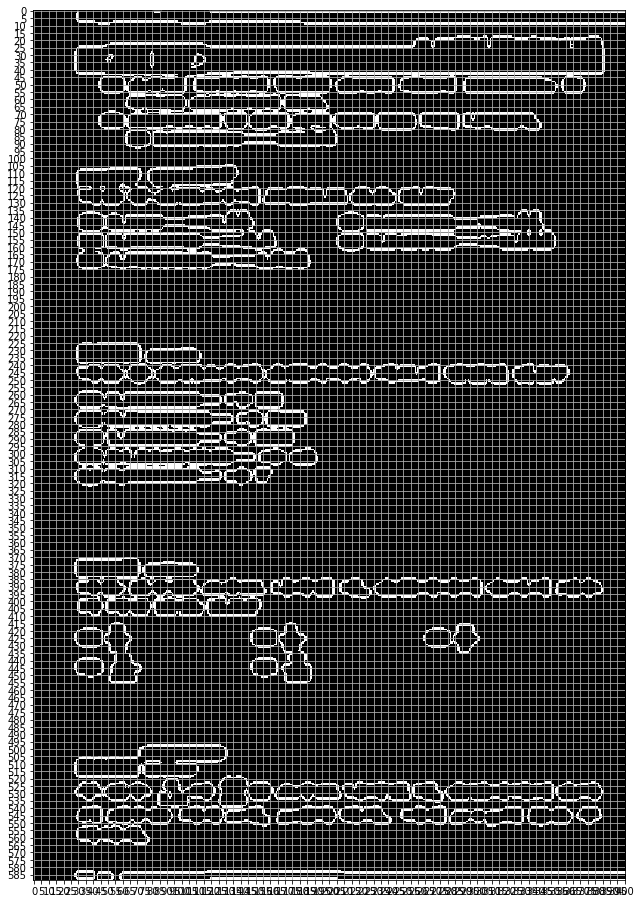

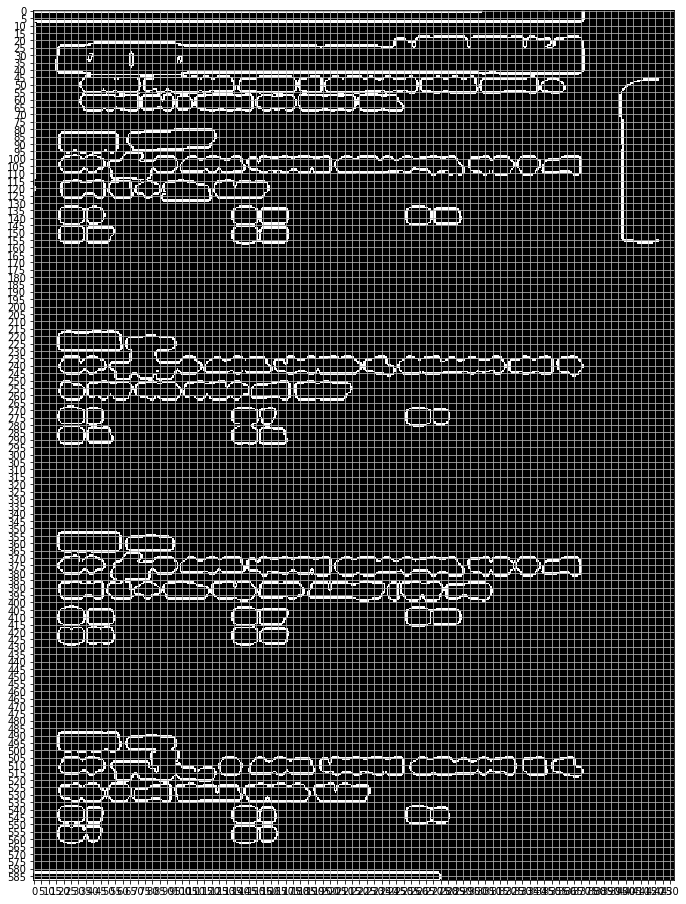

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

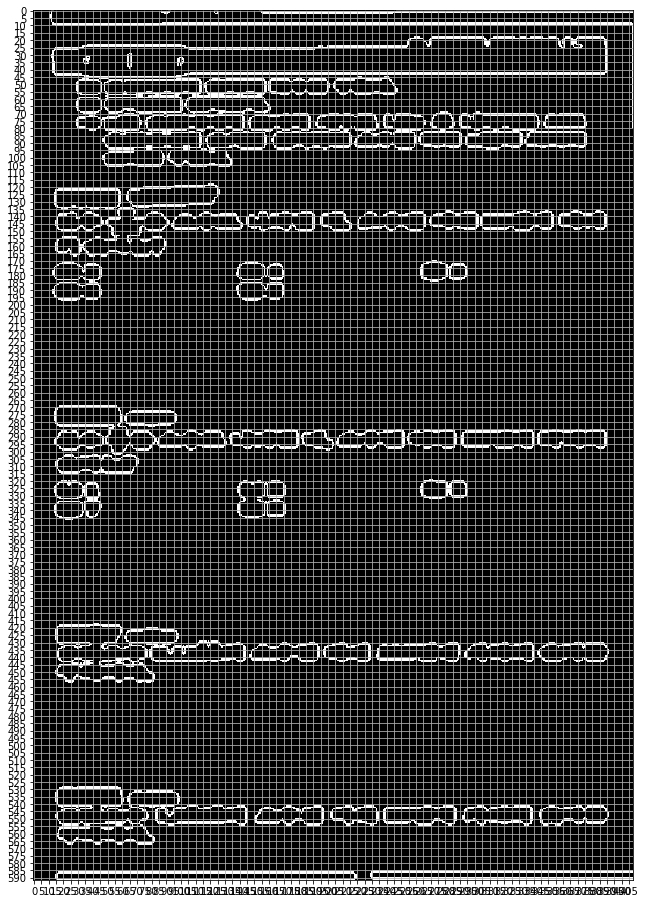

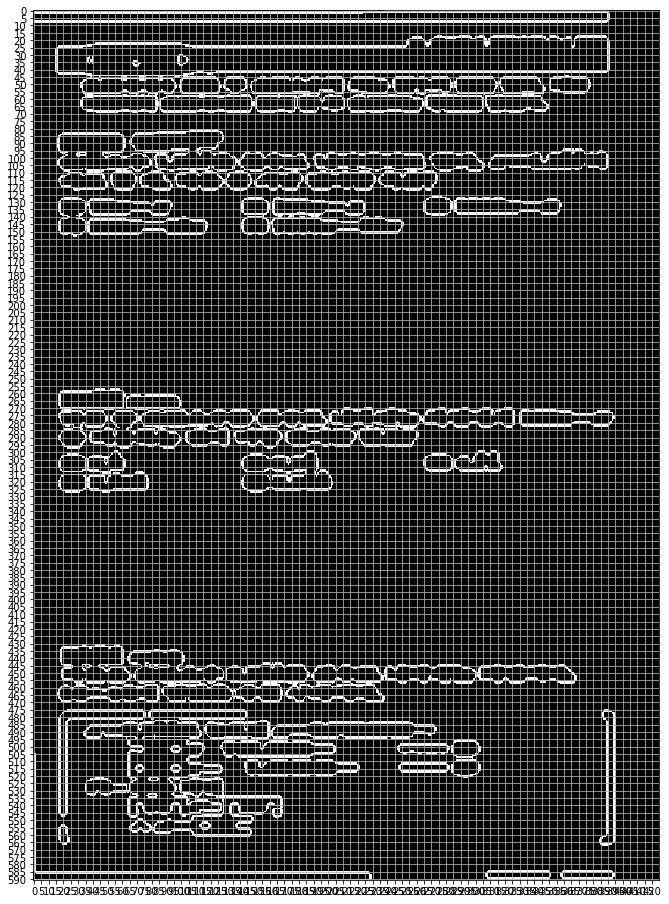

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

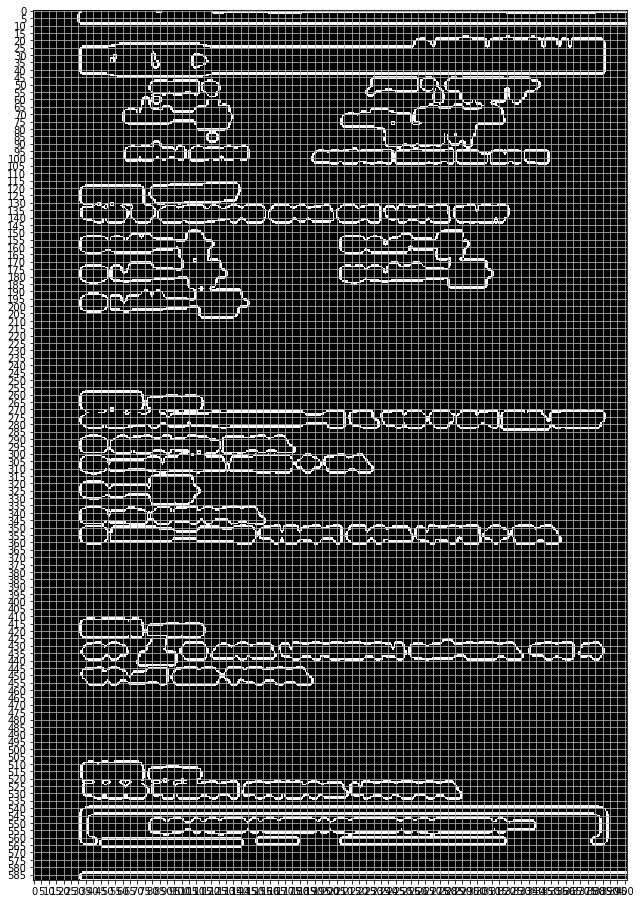

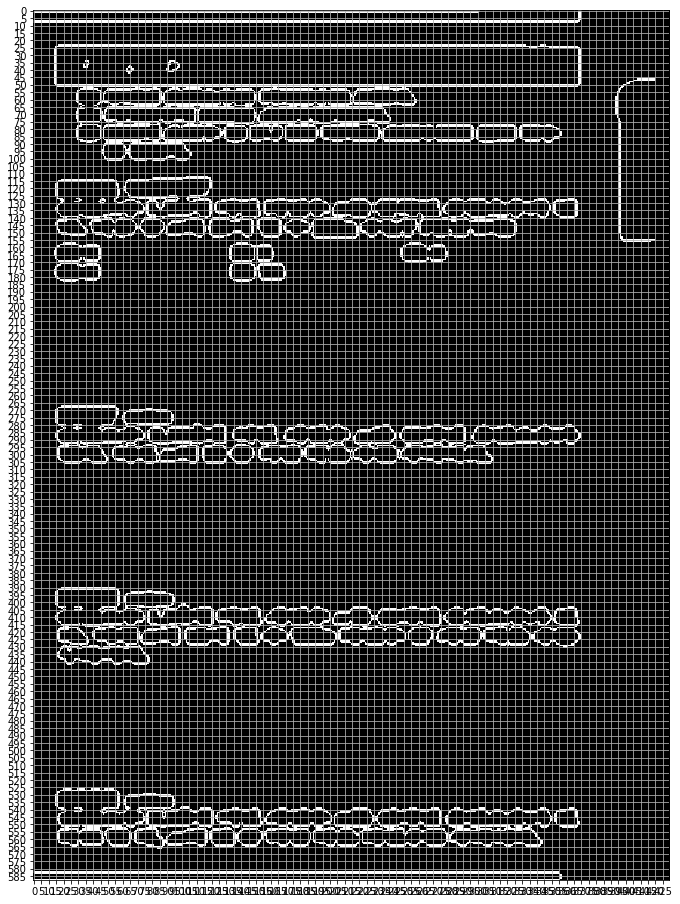

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

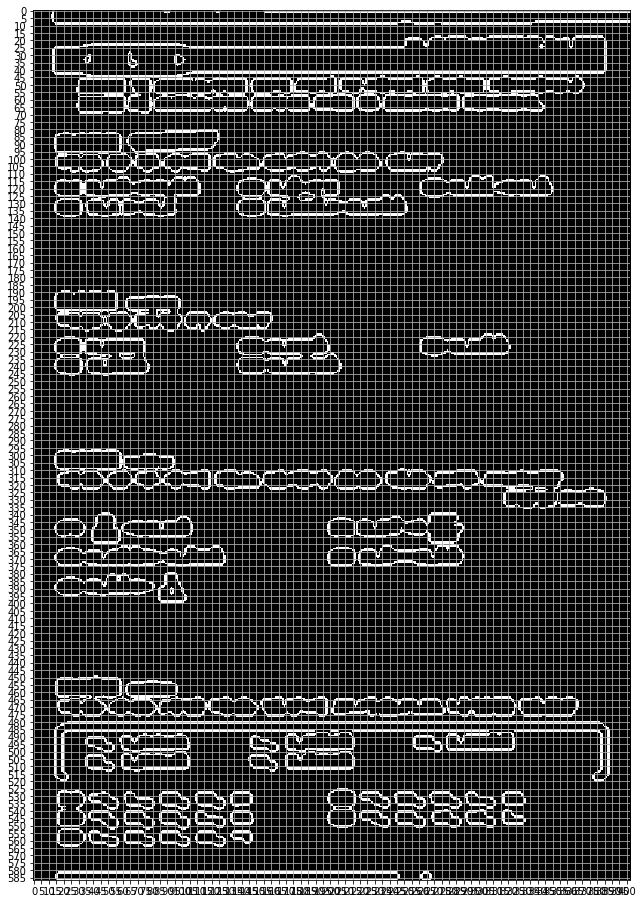

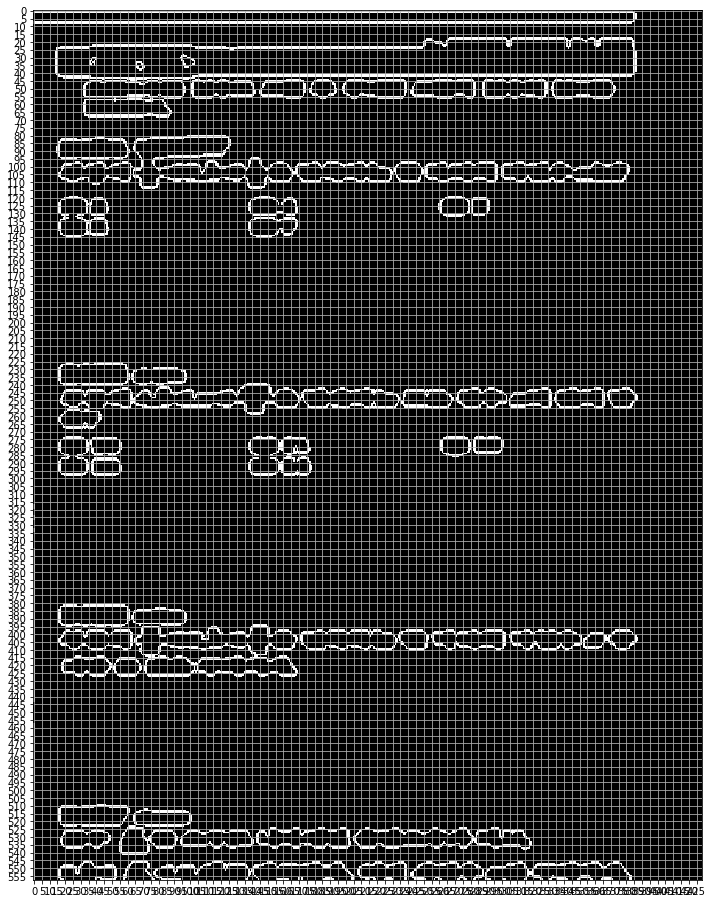

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

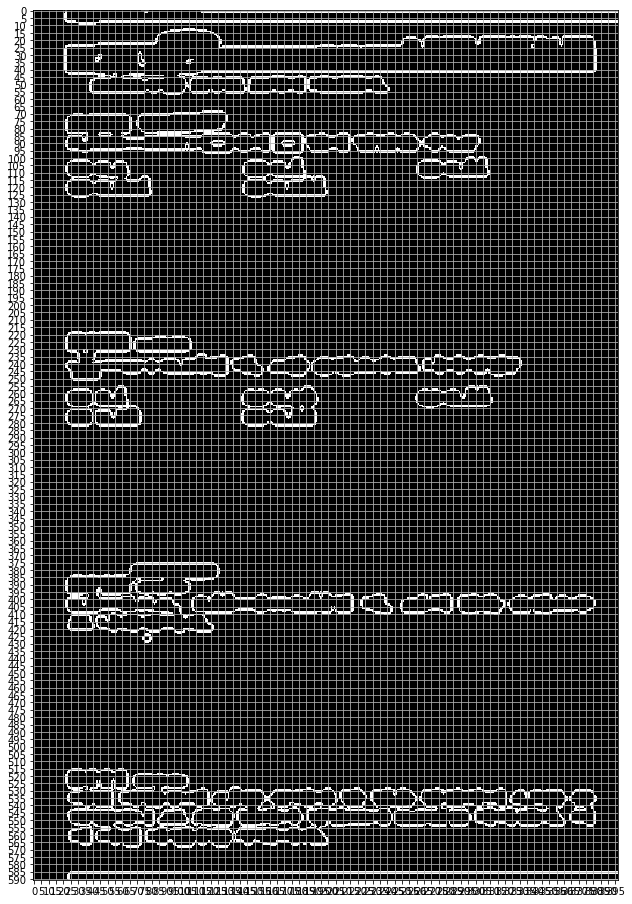

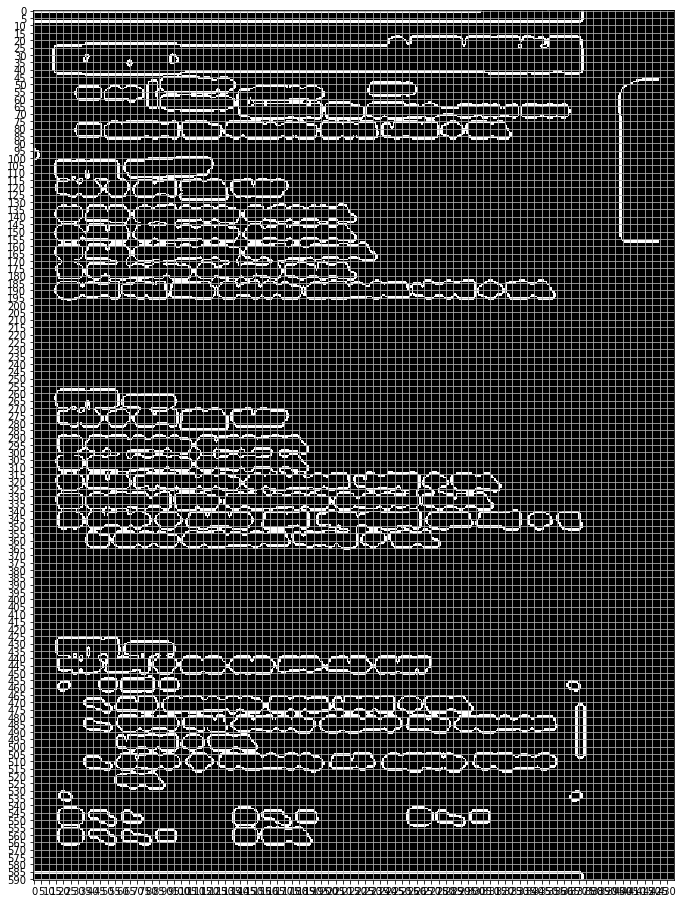

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

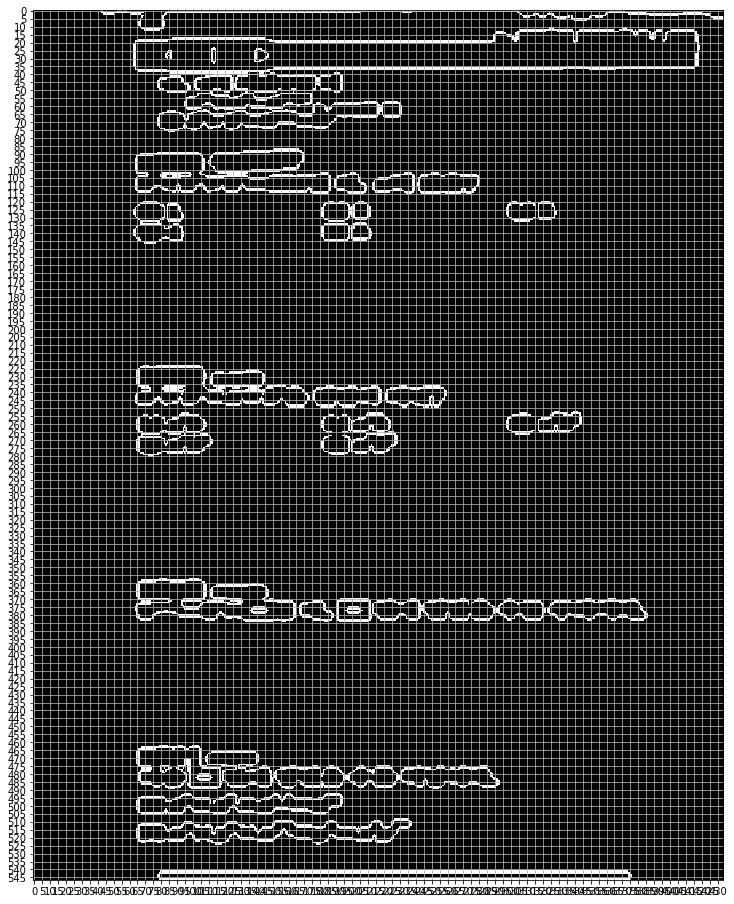

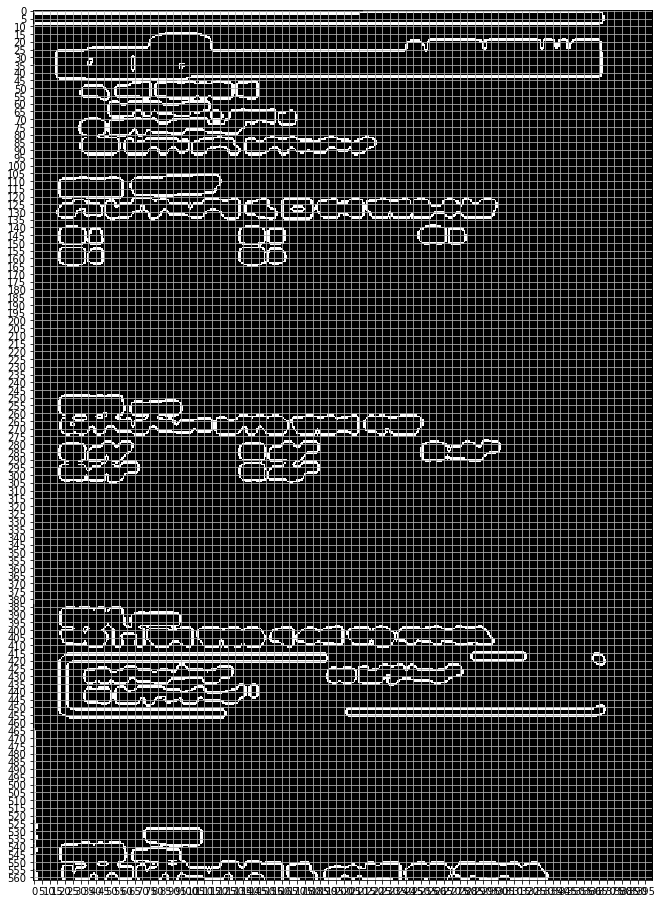

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

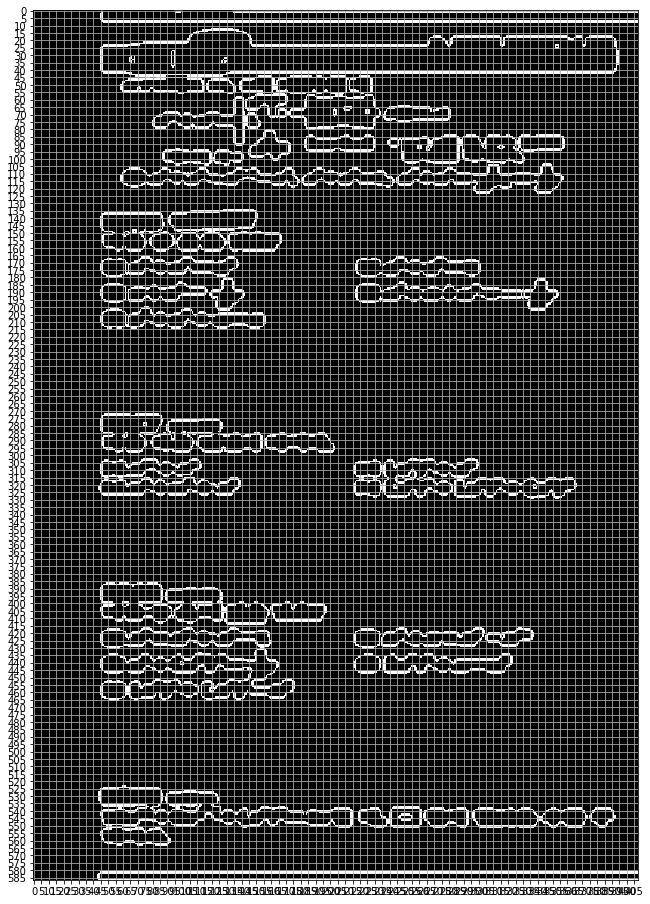

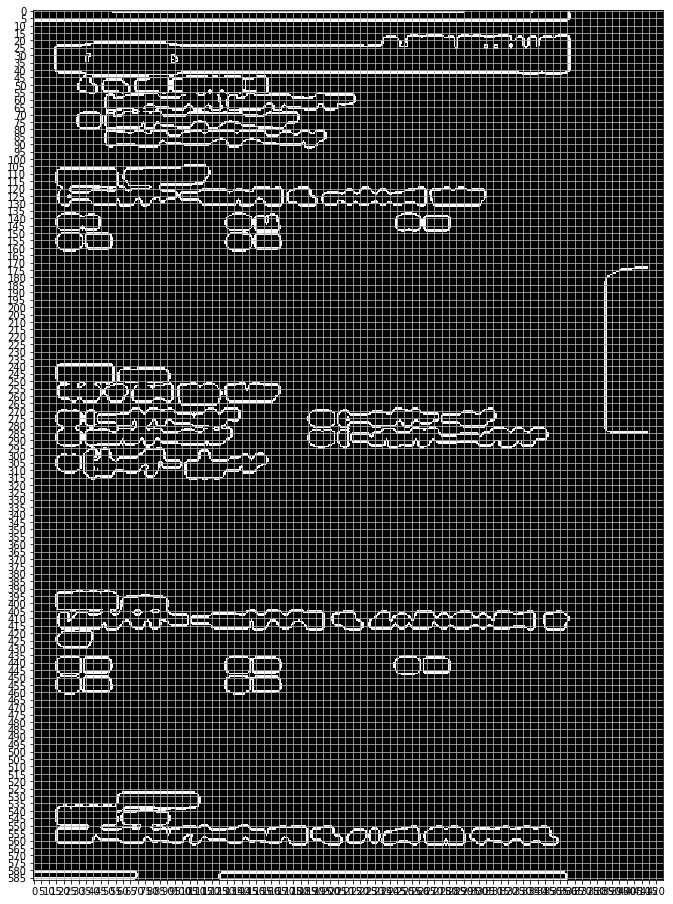

0  Pattern
IMG =  032 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

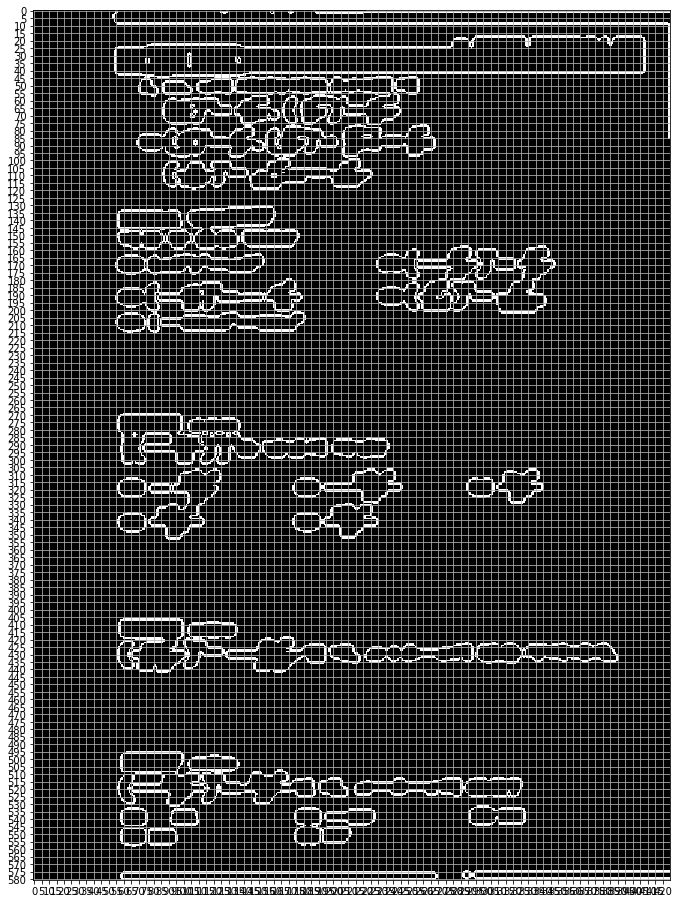

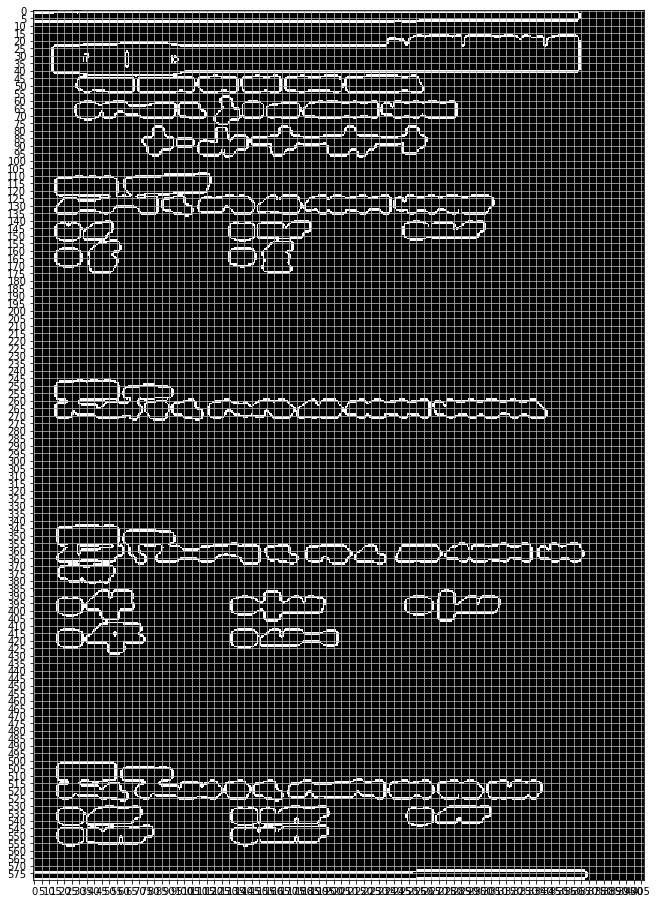

3  Pattern
IMG =  033 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

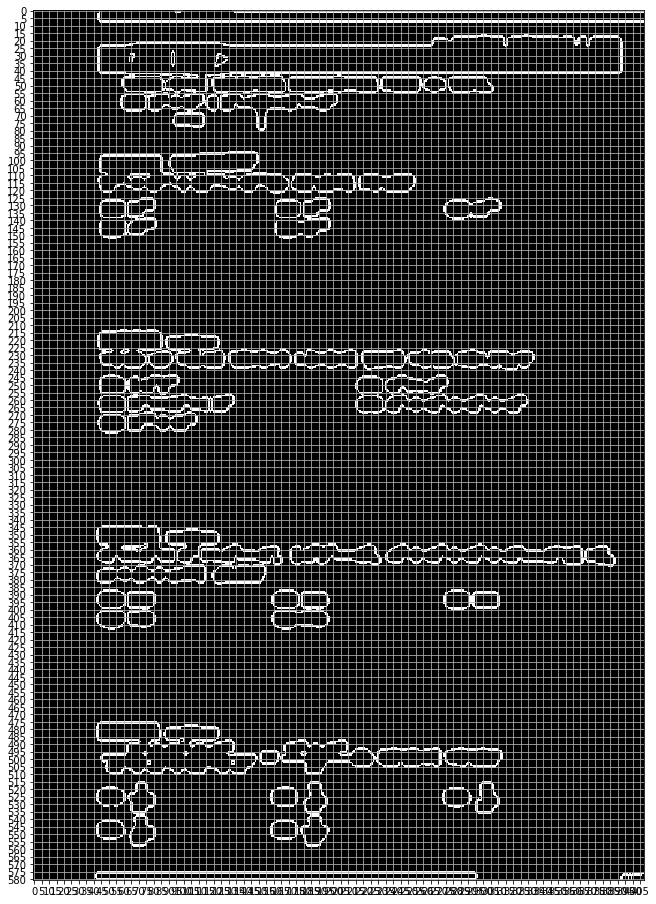

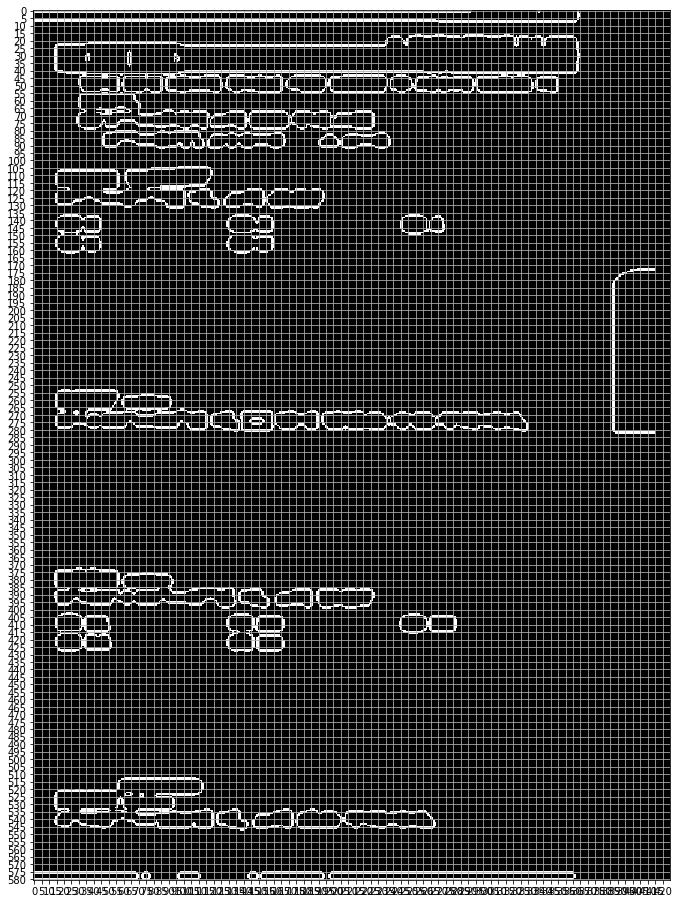

3  Pattern
IMG =  034 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

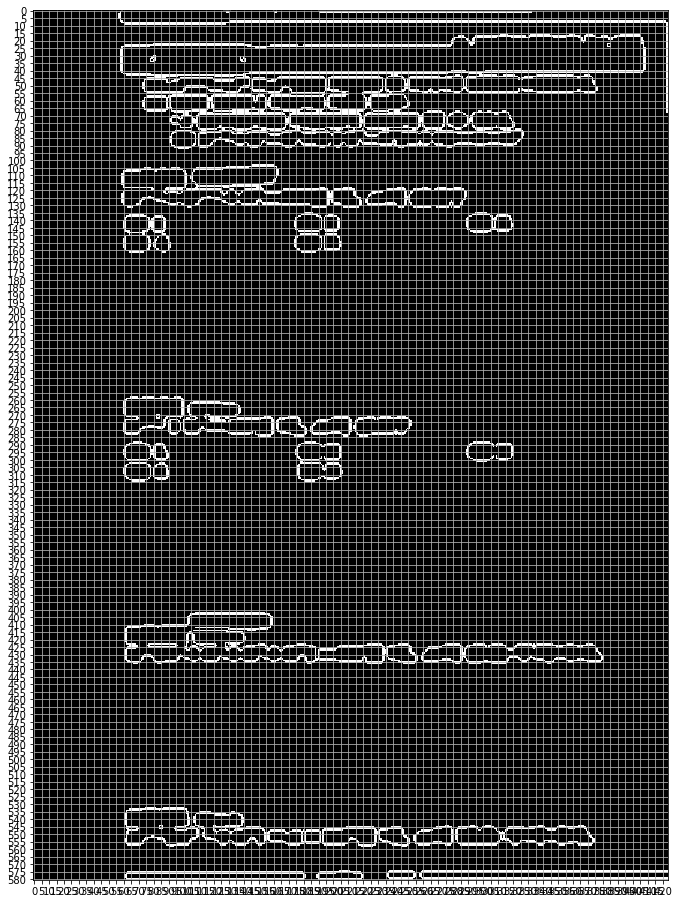

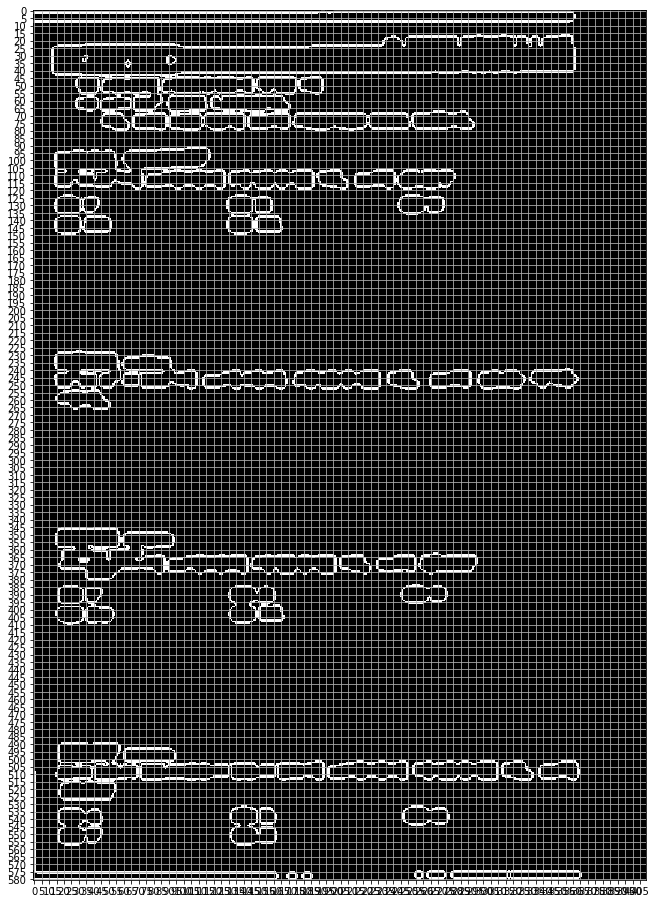

0  Pattern
IMG =  035 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

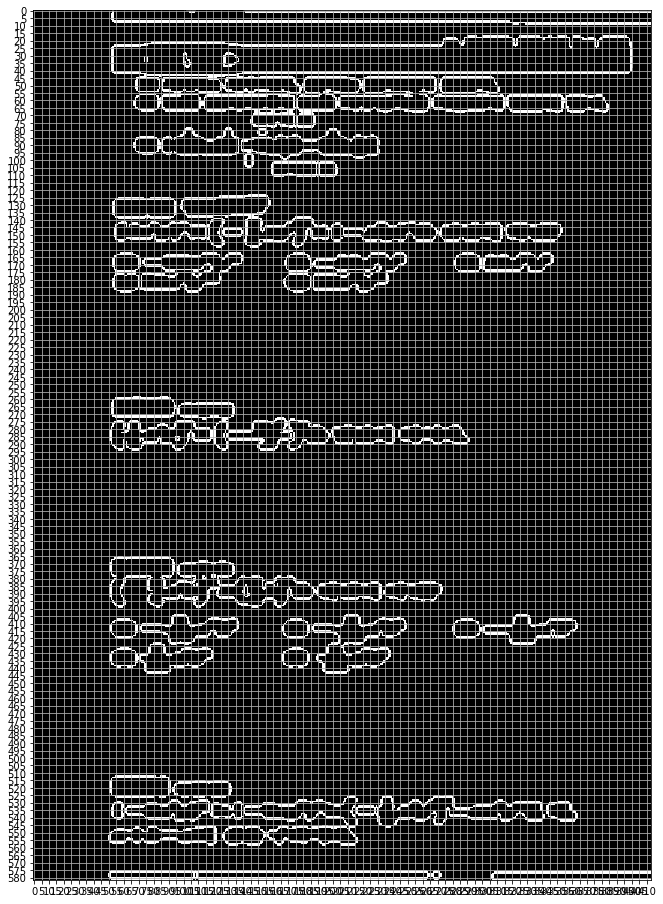

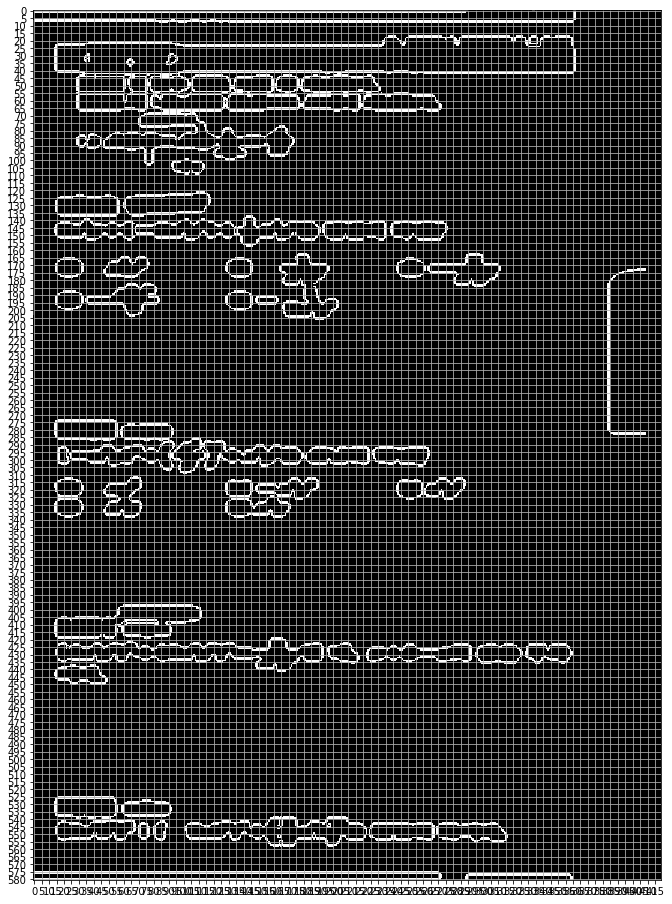

2  Pattern
IMG =  036 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

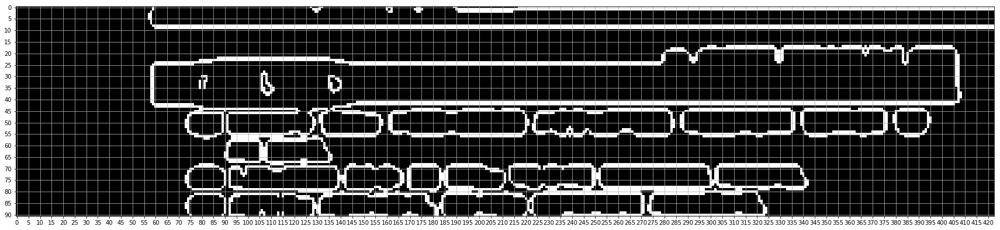

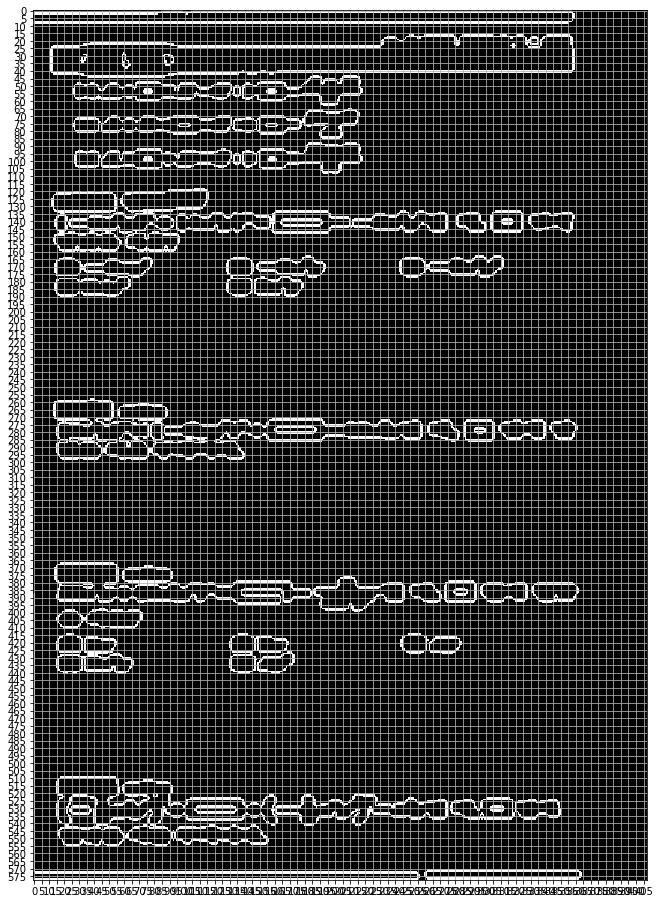

1  Pattern
IMG =  037 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

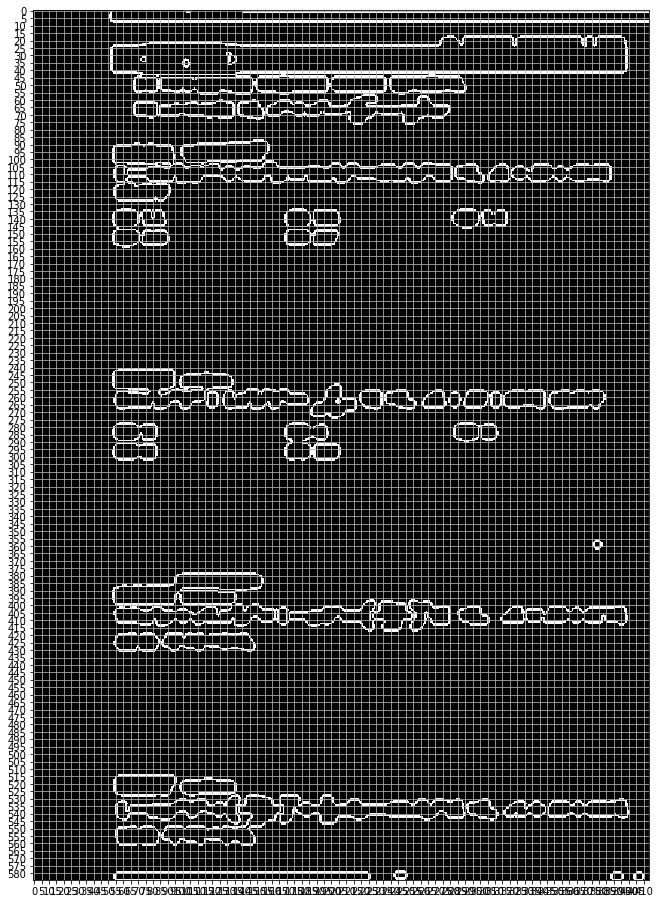

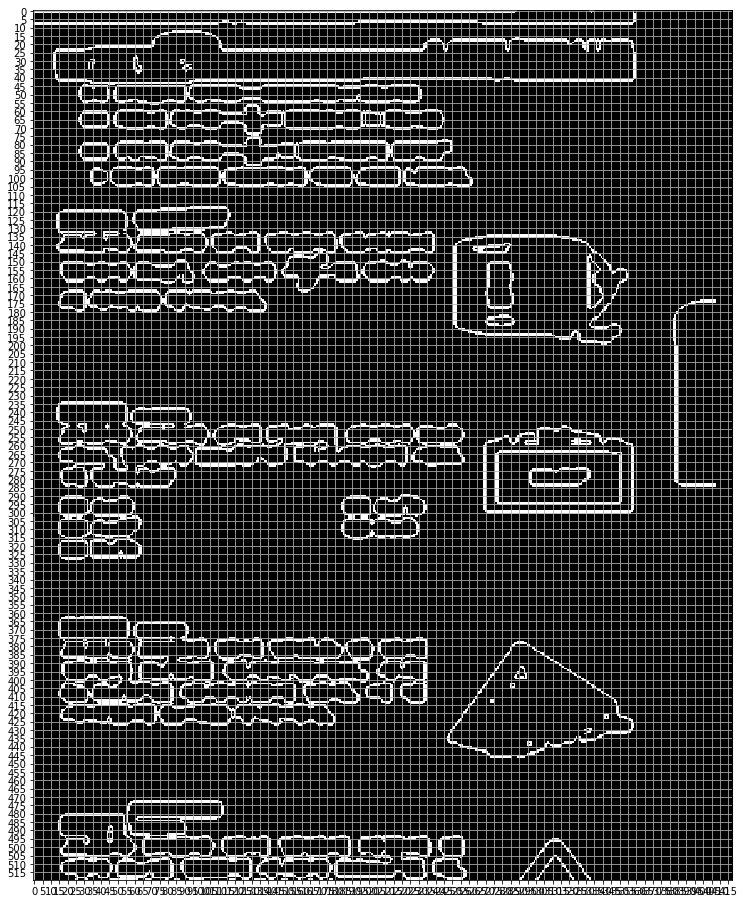

1  Pattern
IMG =  046 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

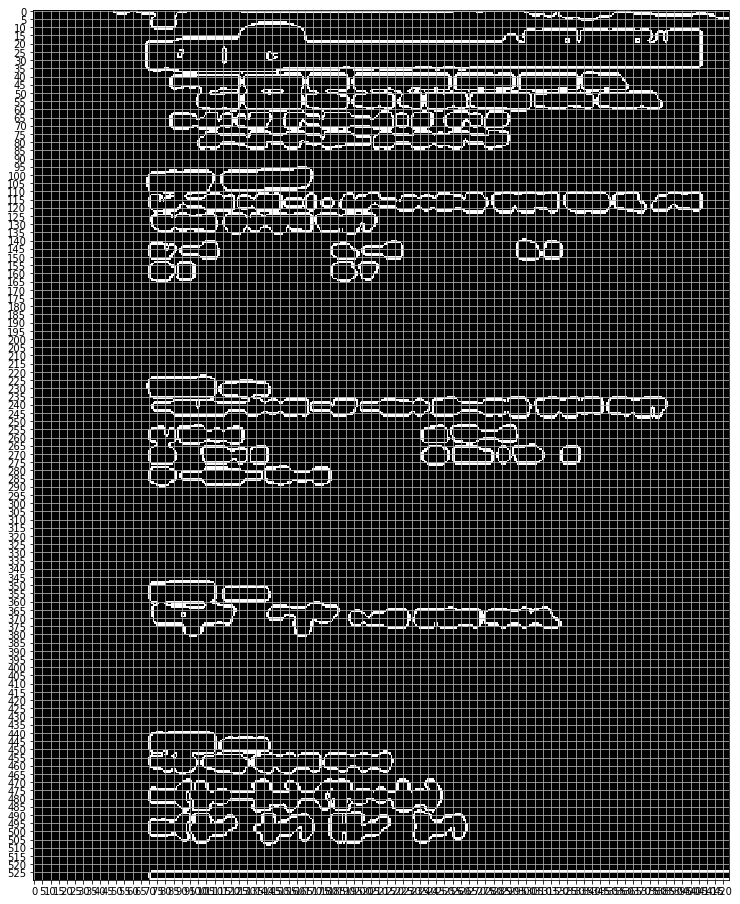

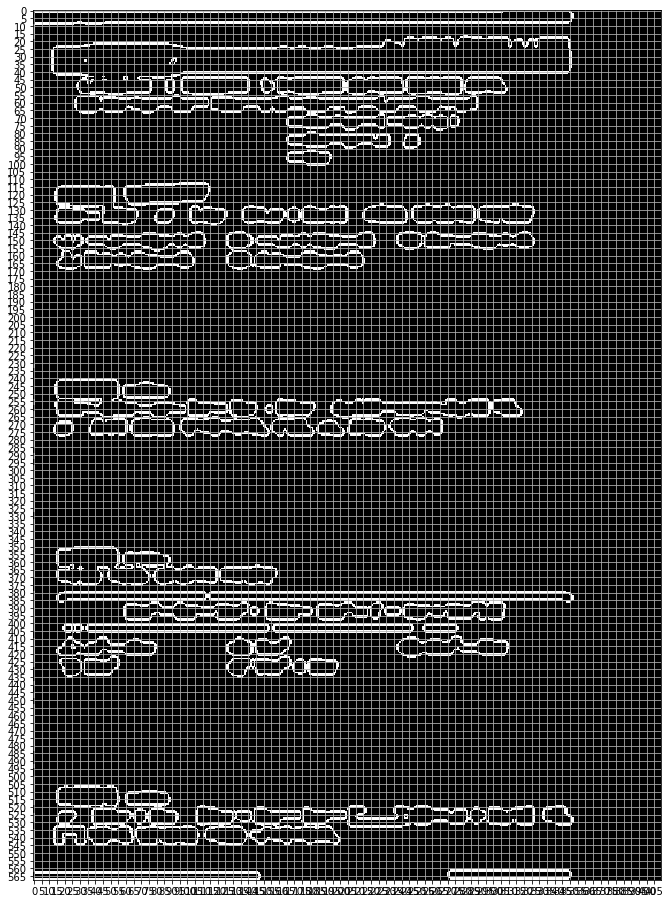

2  Pattern
IMG =  047 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

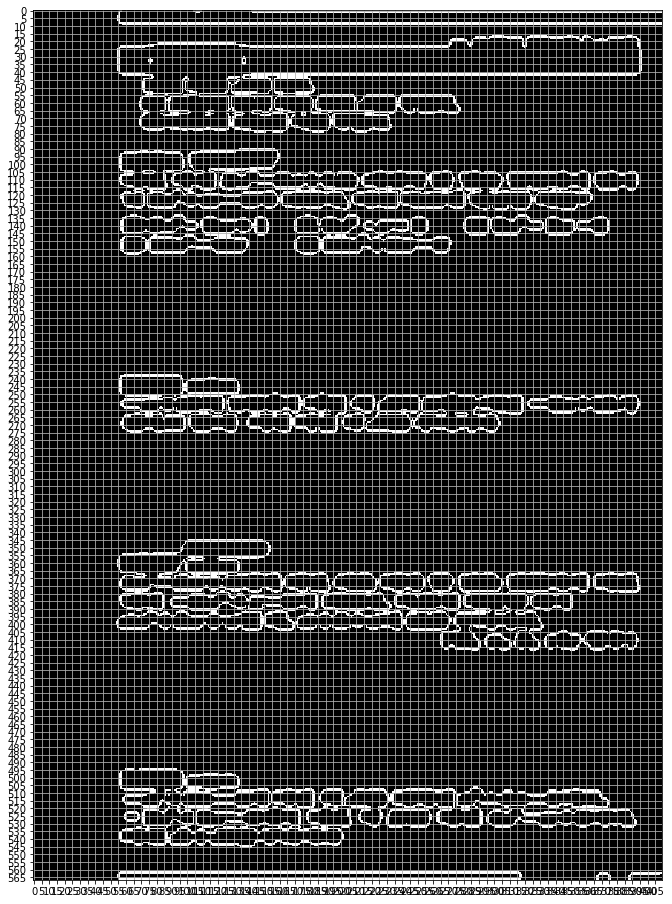

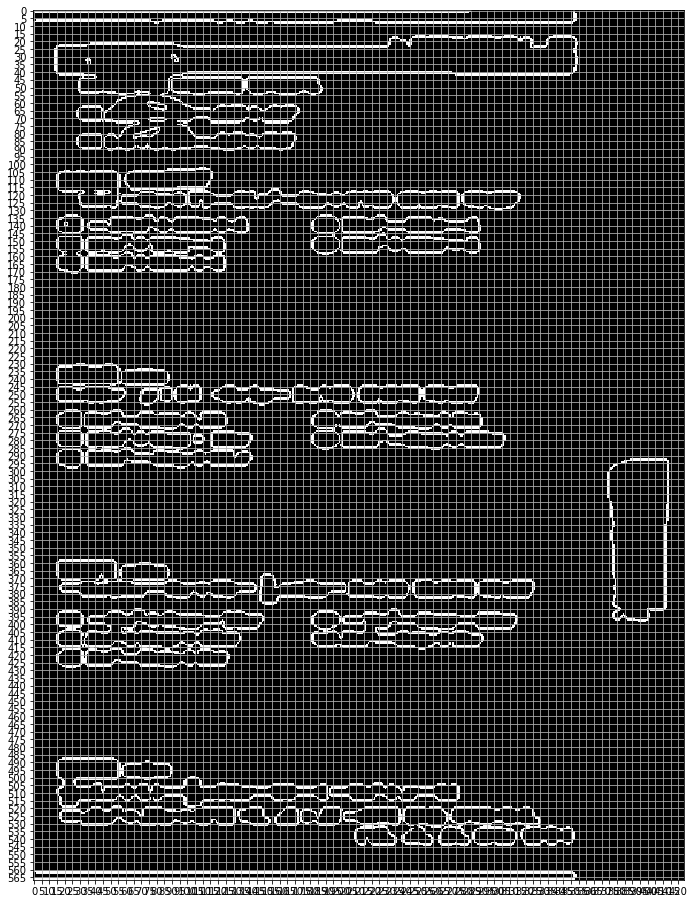

0  Pattern
IMG =  048 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

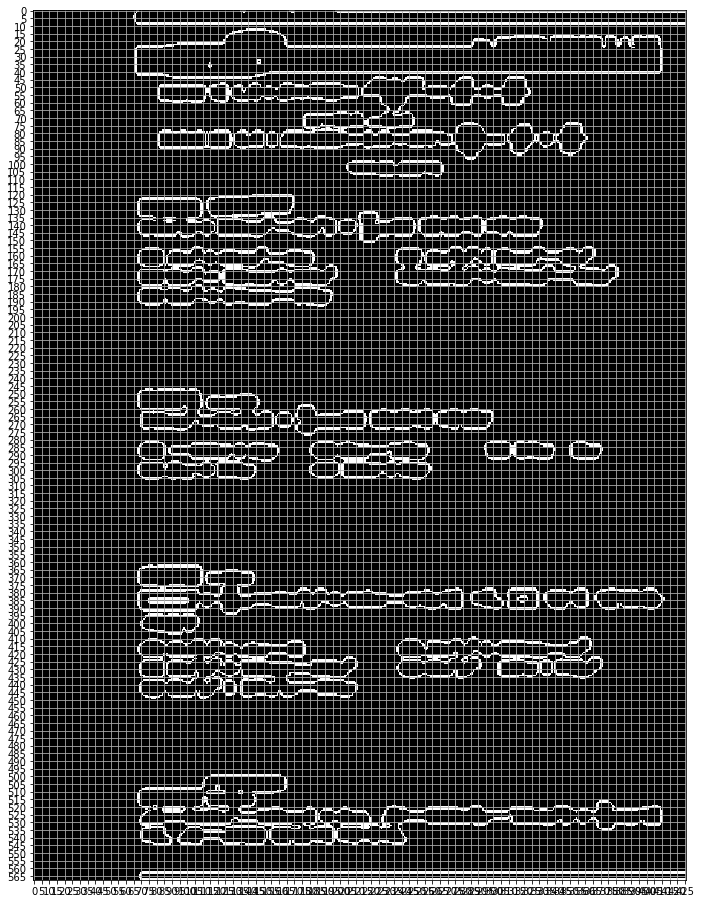

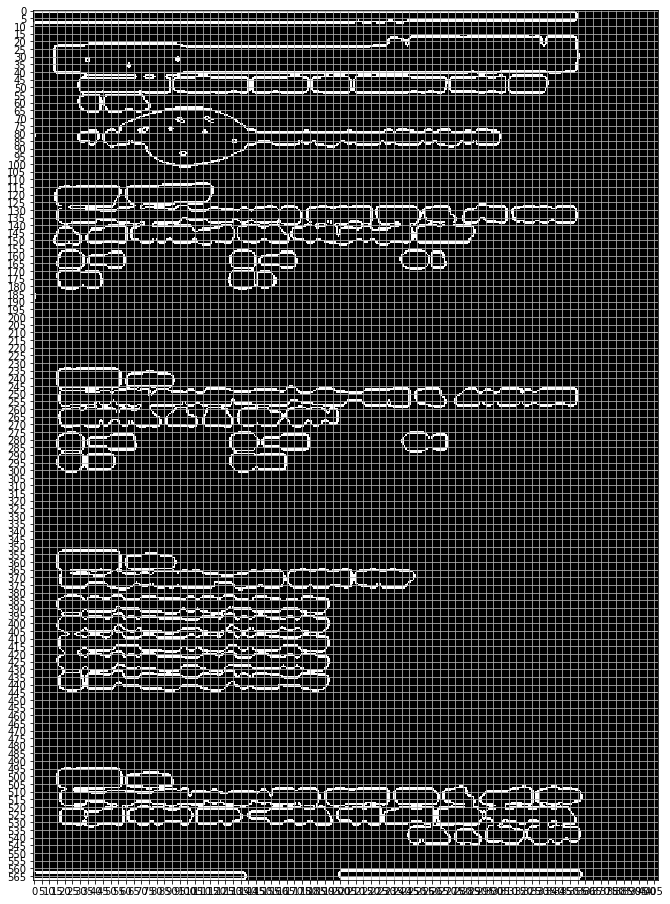

3  Pattern
IMG =  049 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

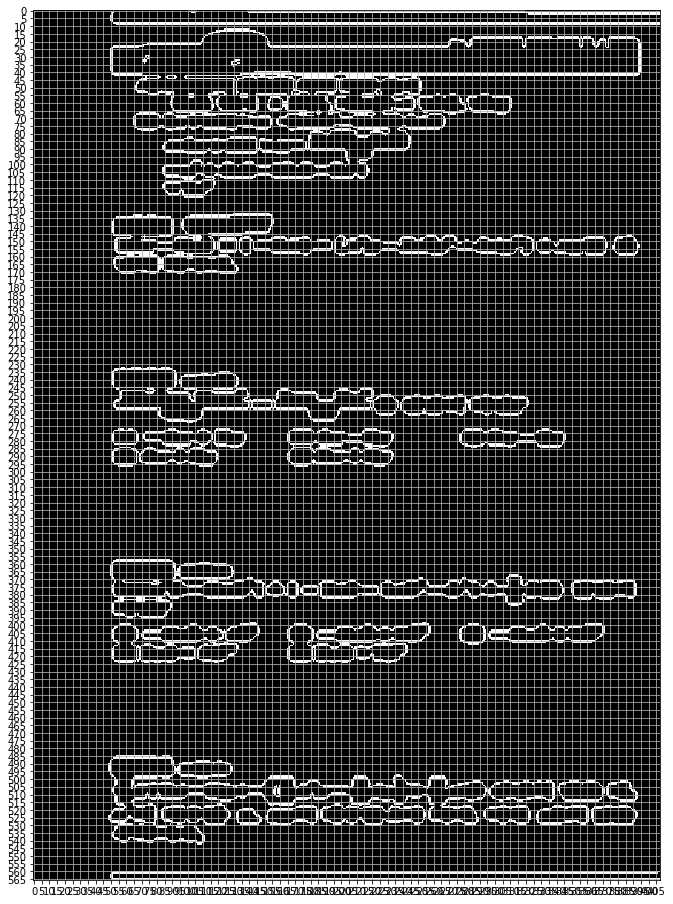

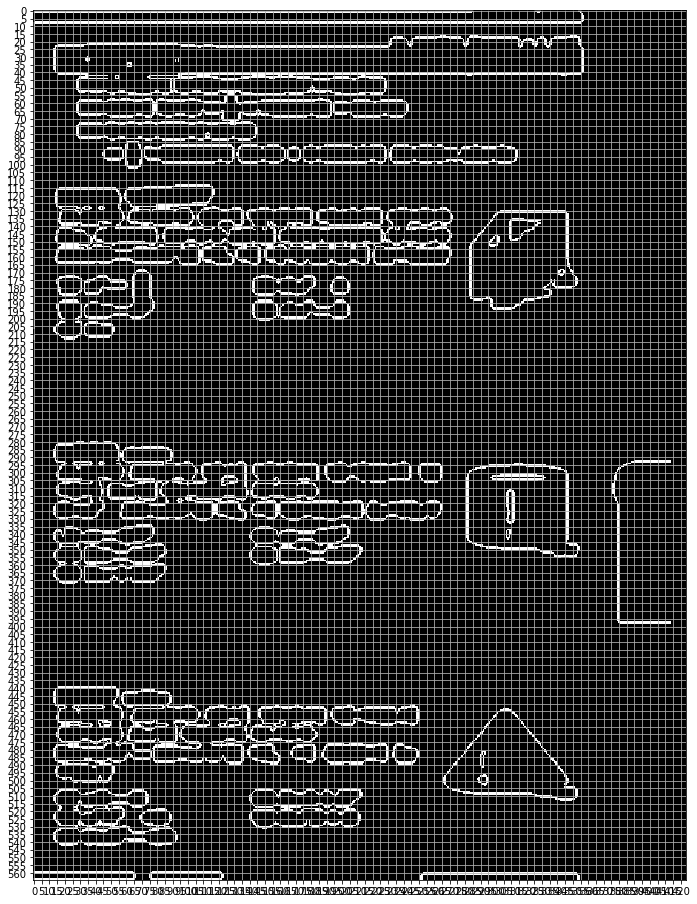

3  Pattern
IMG =  050 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

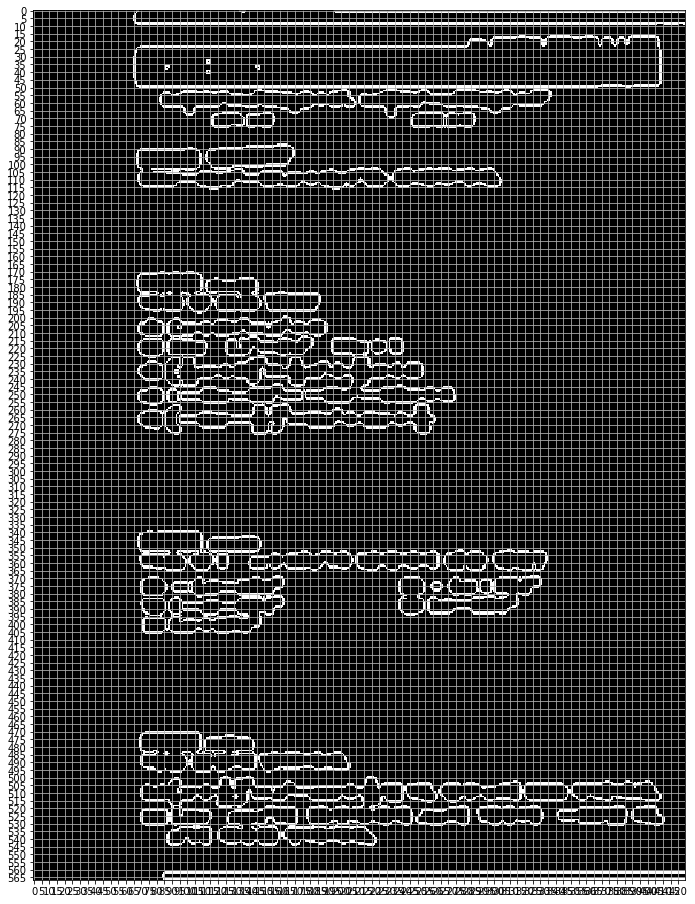

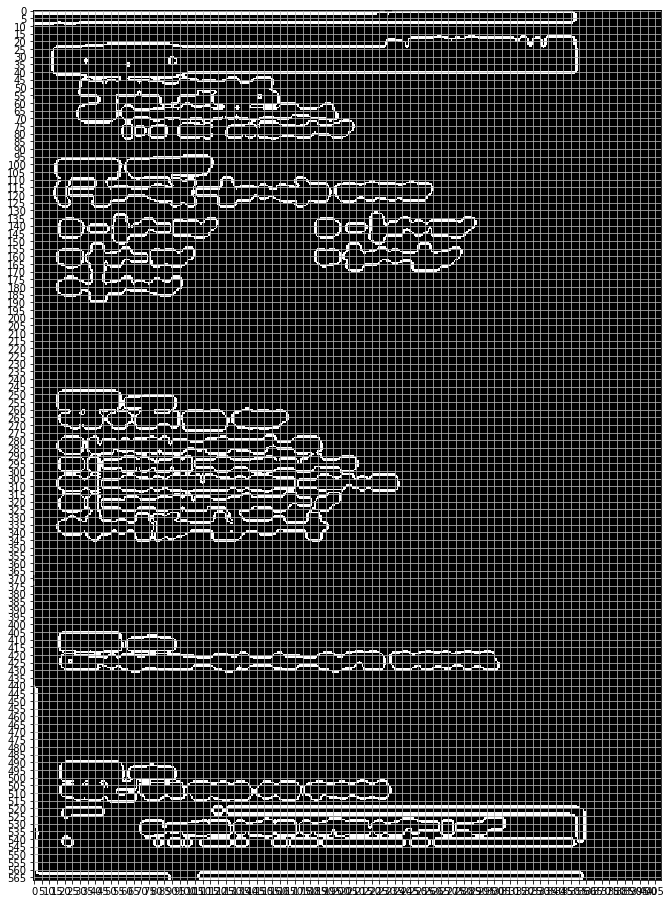

0  Pattern
IMG =  051 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

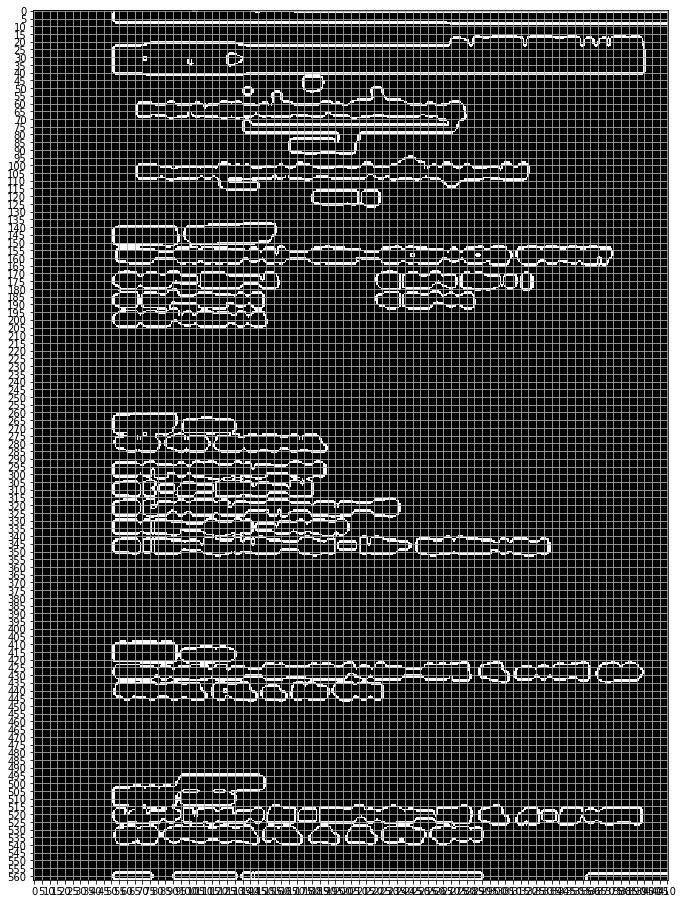

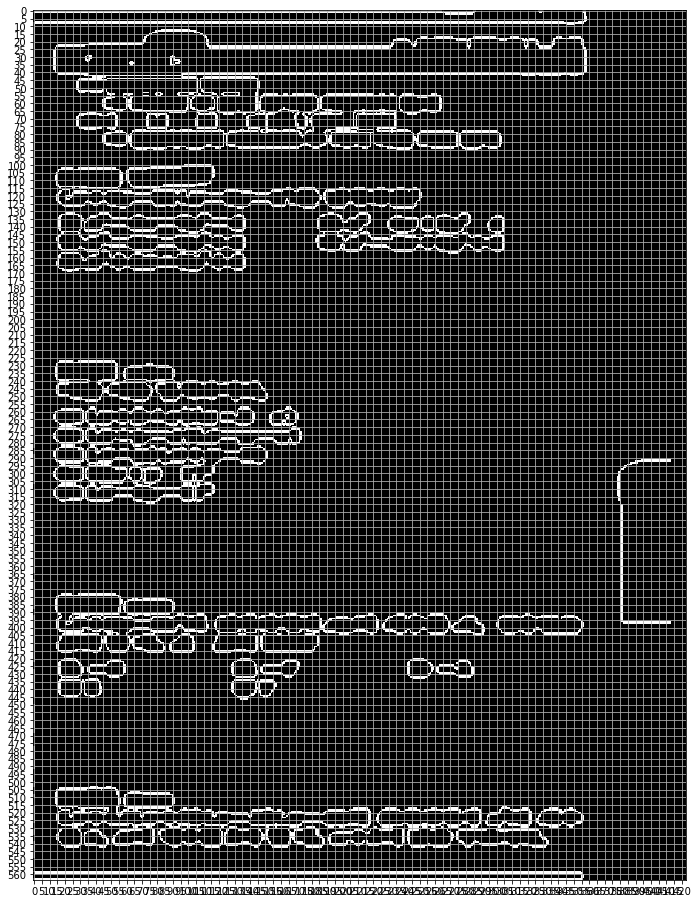

2  Pattern
IMG =  052 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

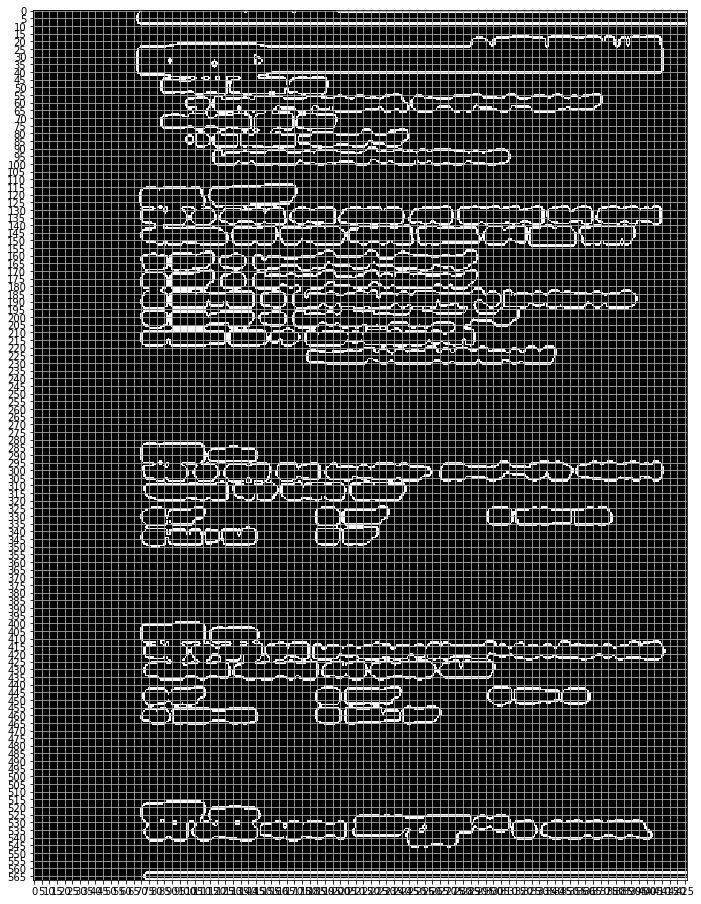

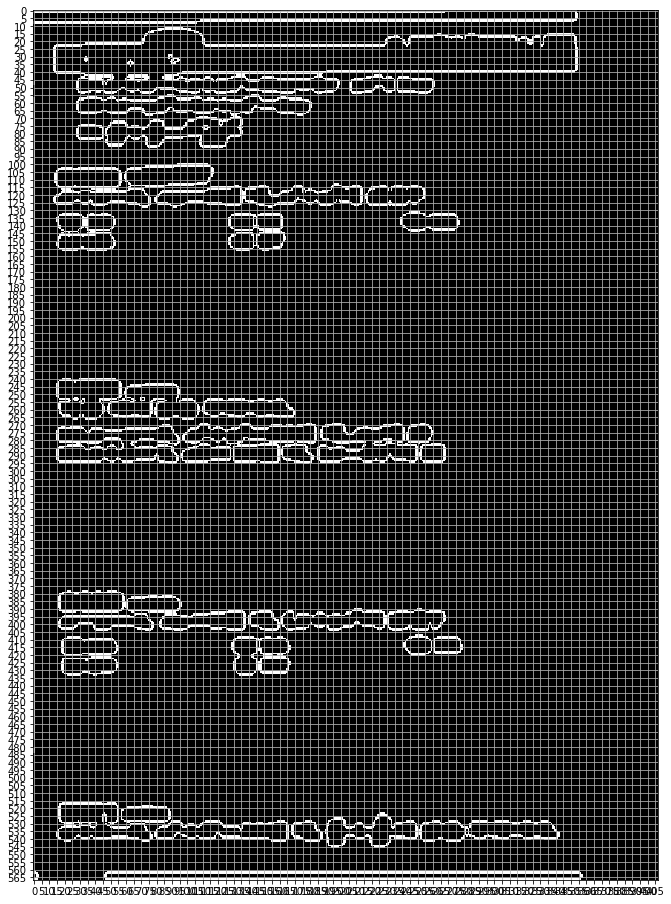

1  Pattern
IMG =  053 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

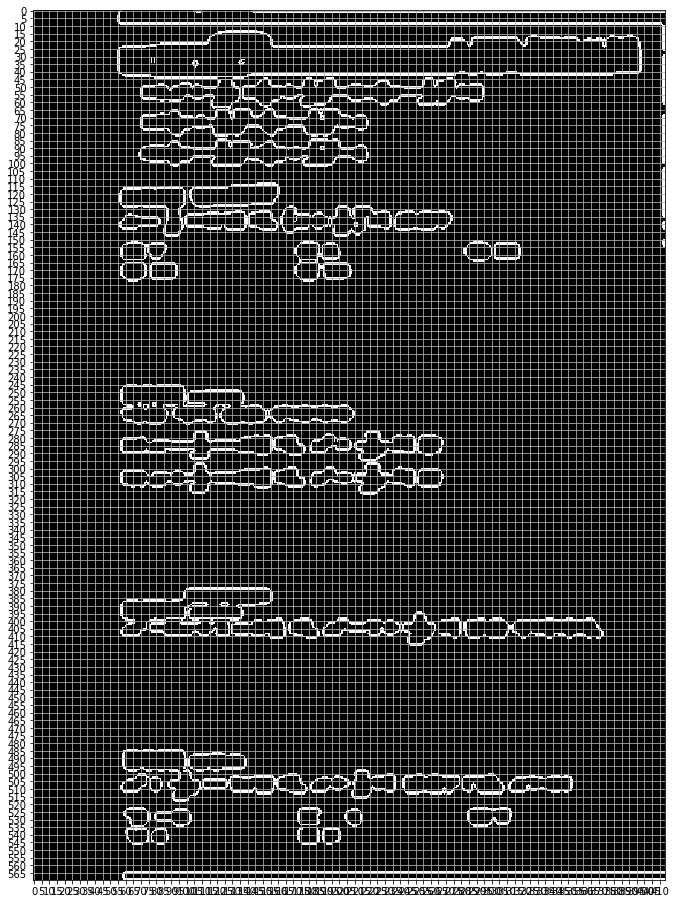

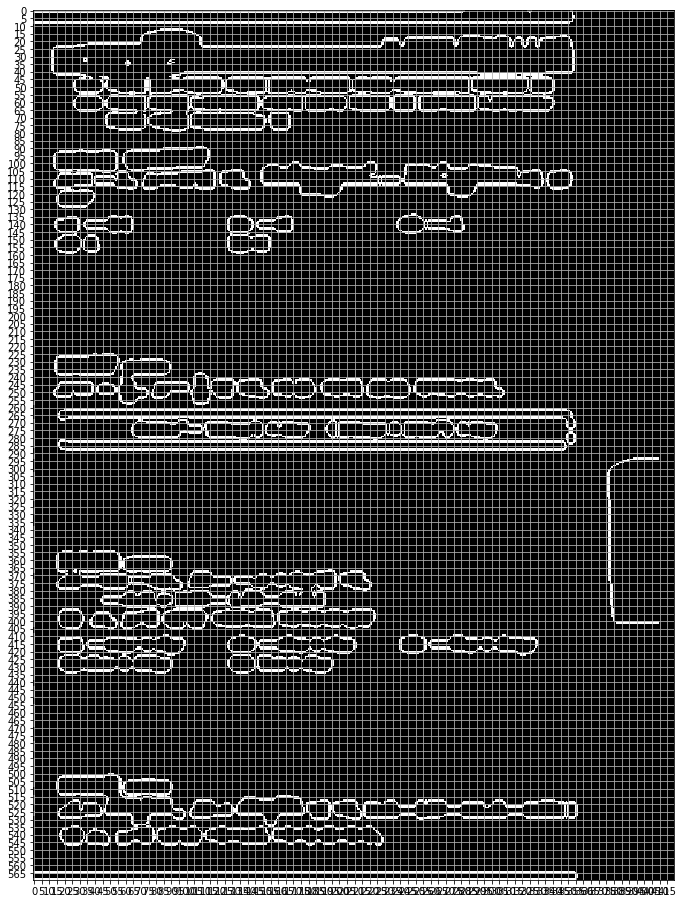

1  Pattern
IMG =  054 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

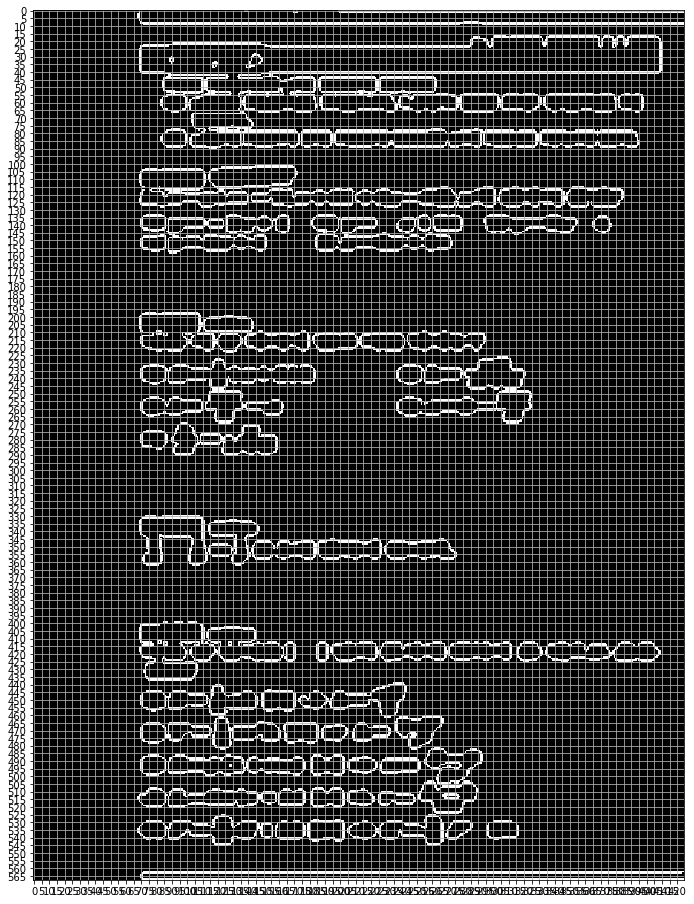

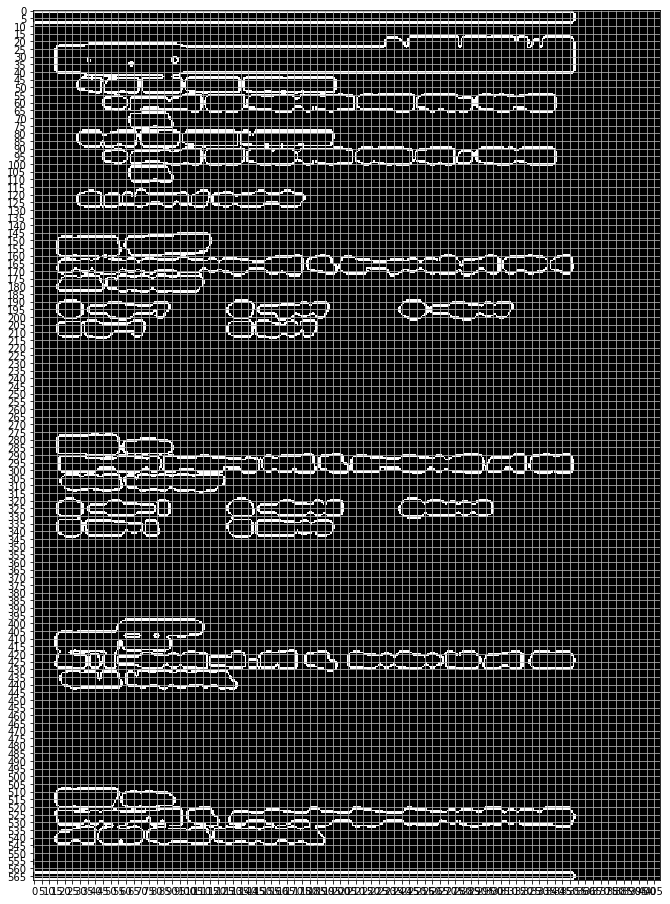

2  Pattern
IMG =  055 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

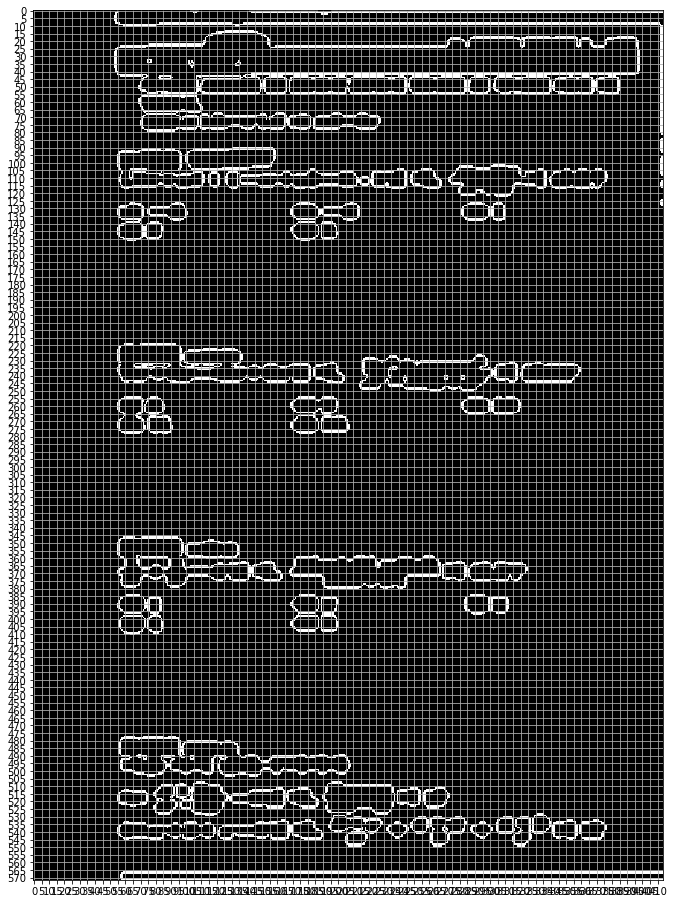

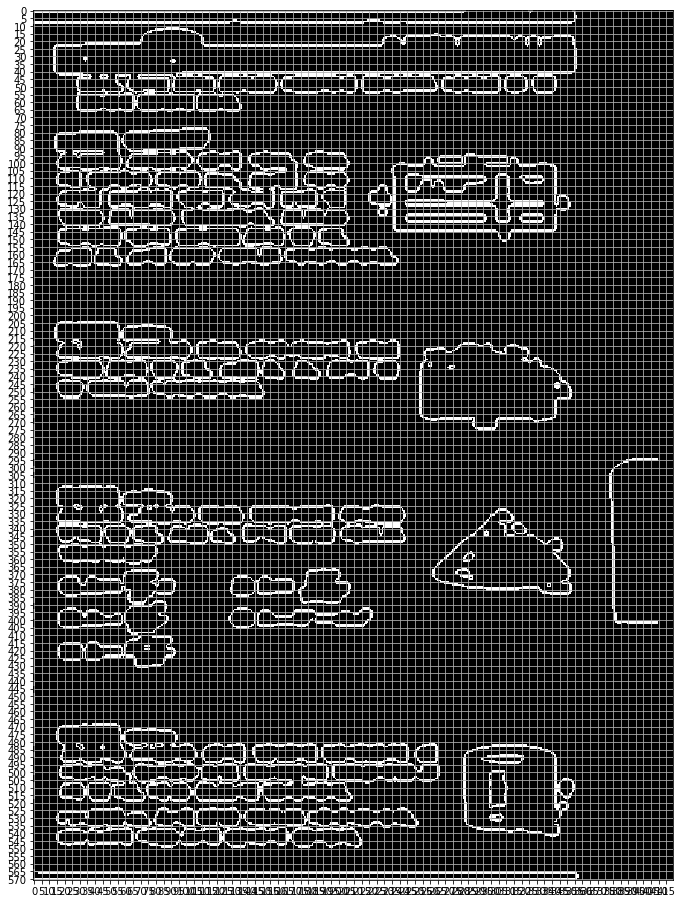

0  Pattern
IMG =  066 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

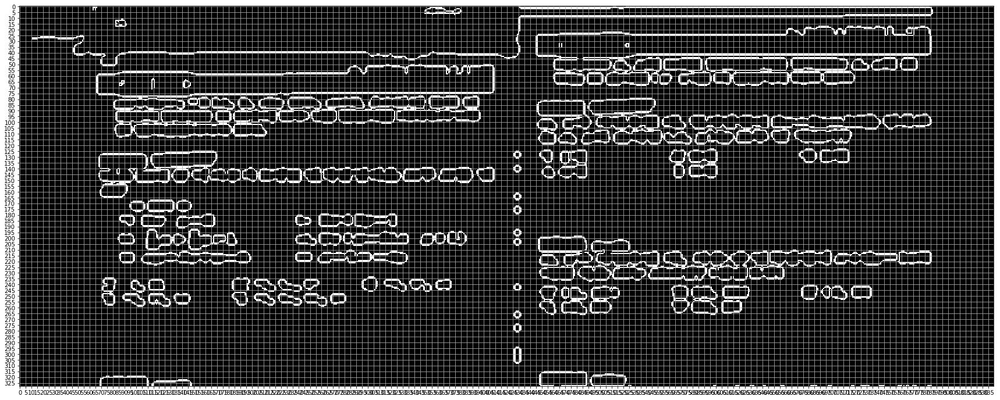

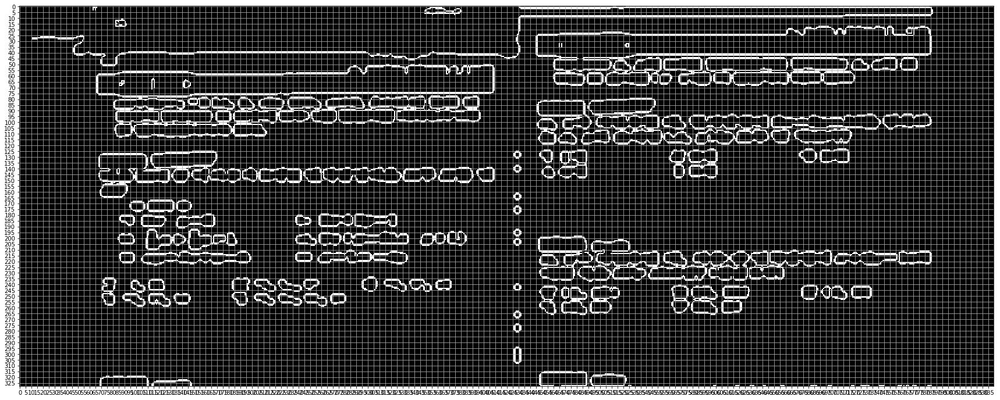

3  Pattern
IMG =  068 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

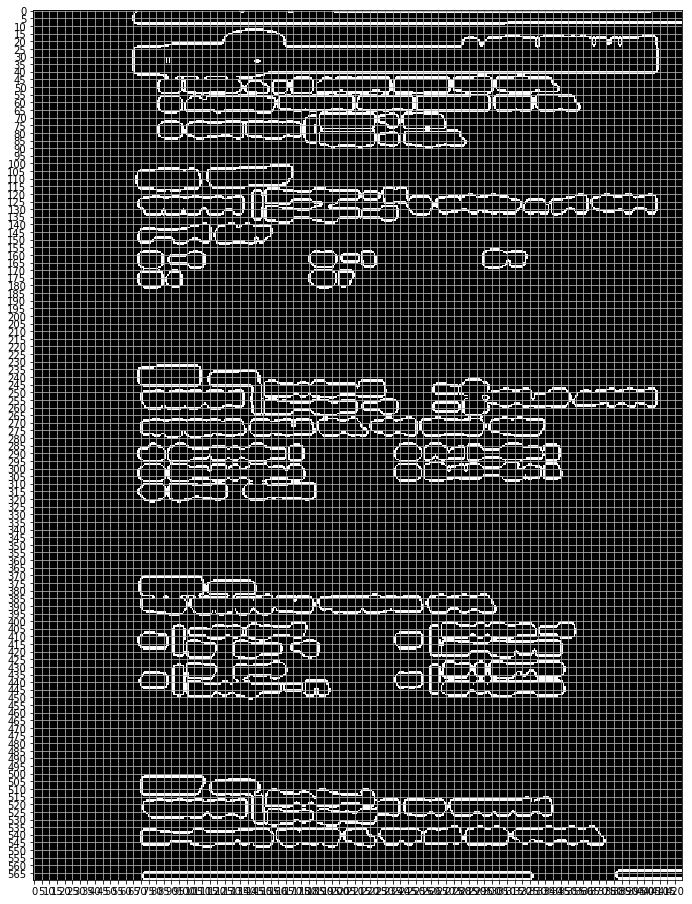

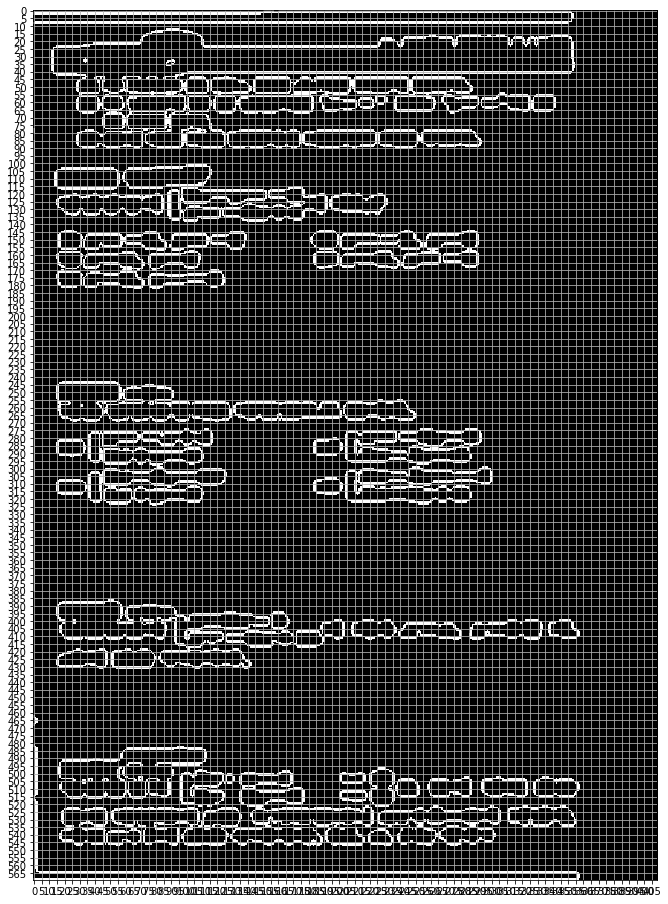

3  Pattern
IMG =  069 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

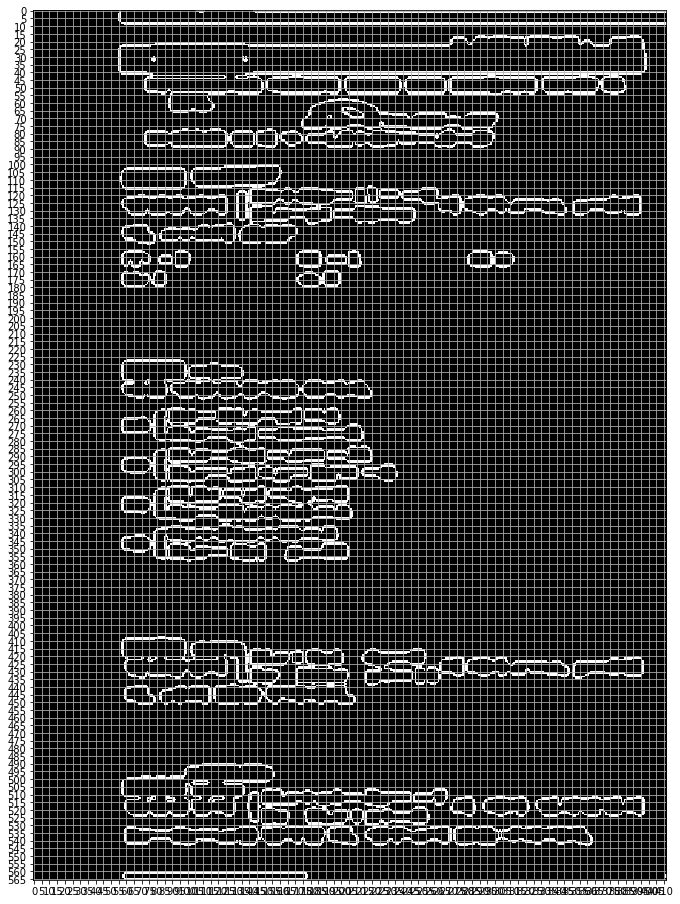

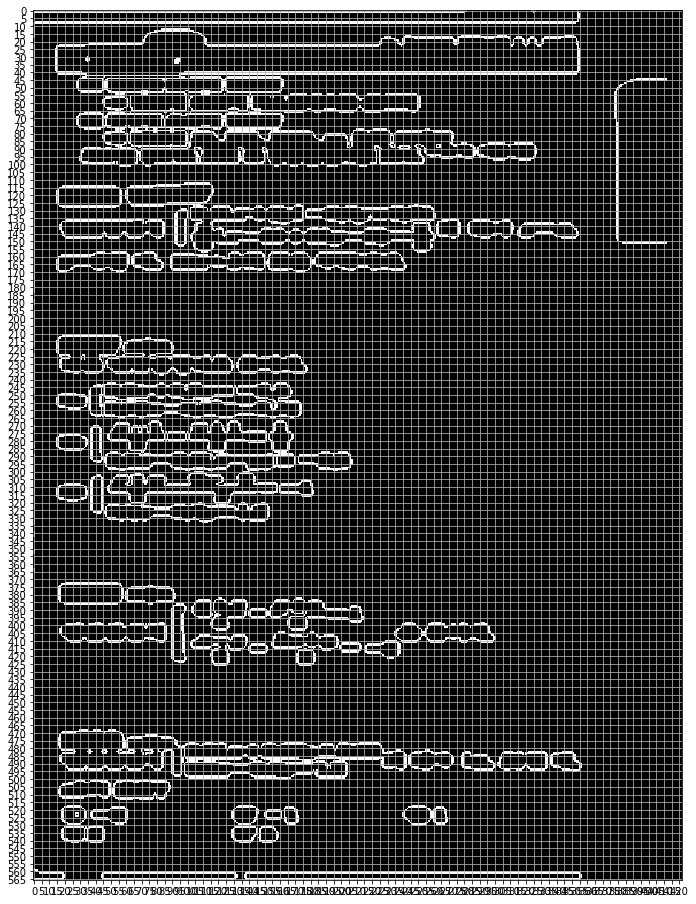

0  Pattern
IMG =  071 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

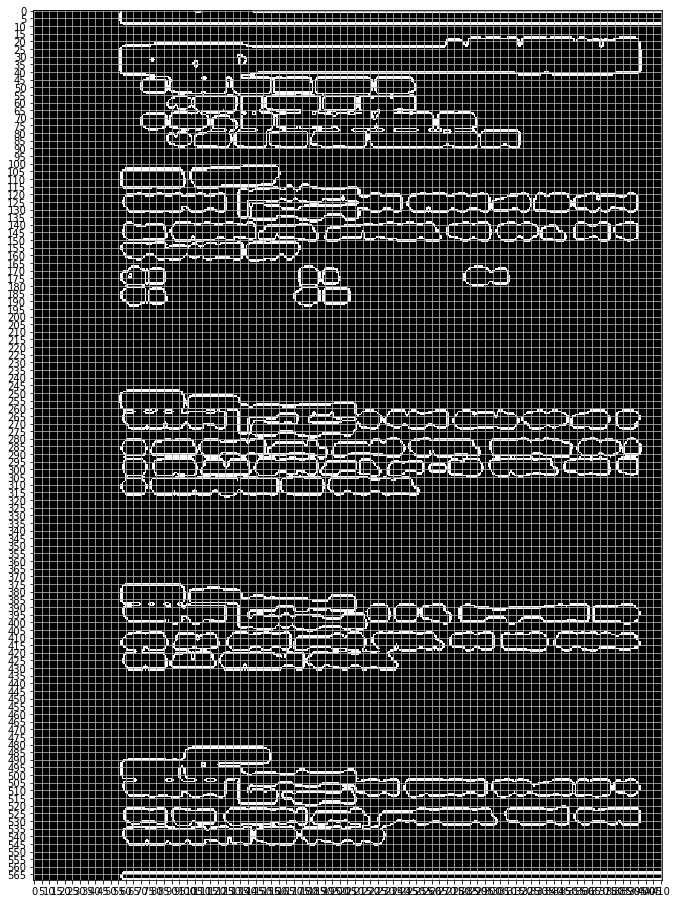

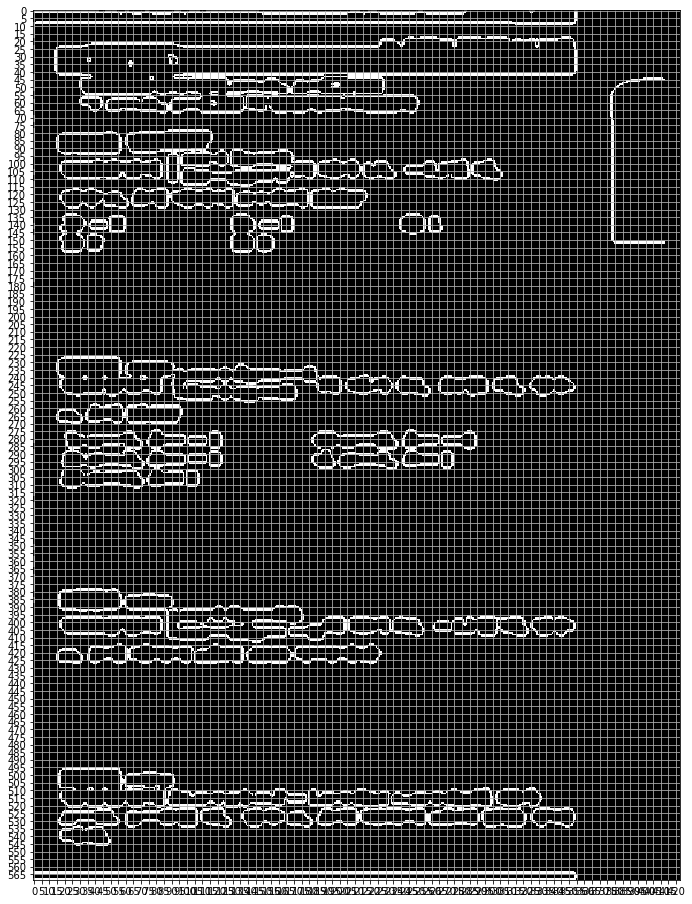

2  Pattern
IMG =  072 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

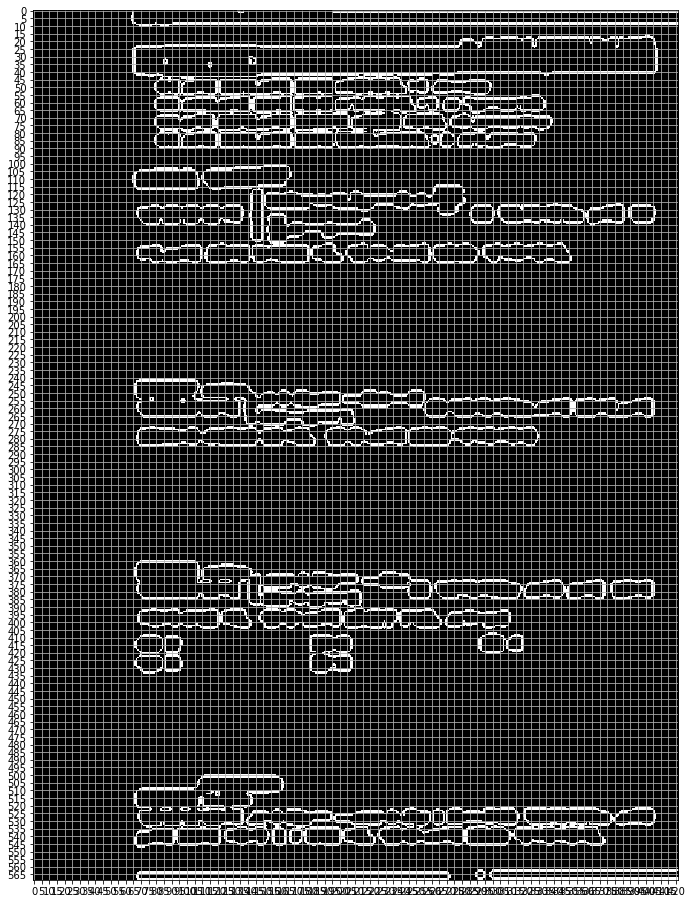

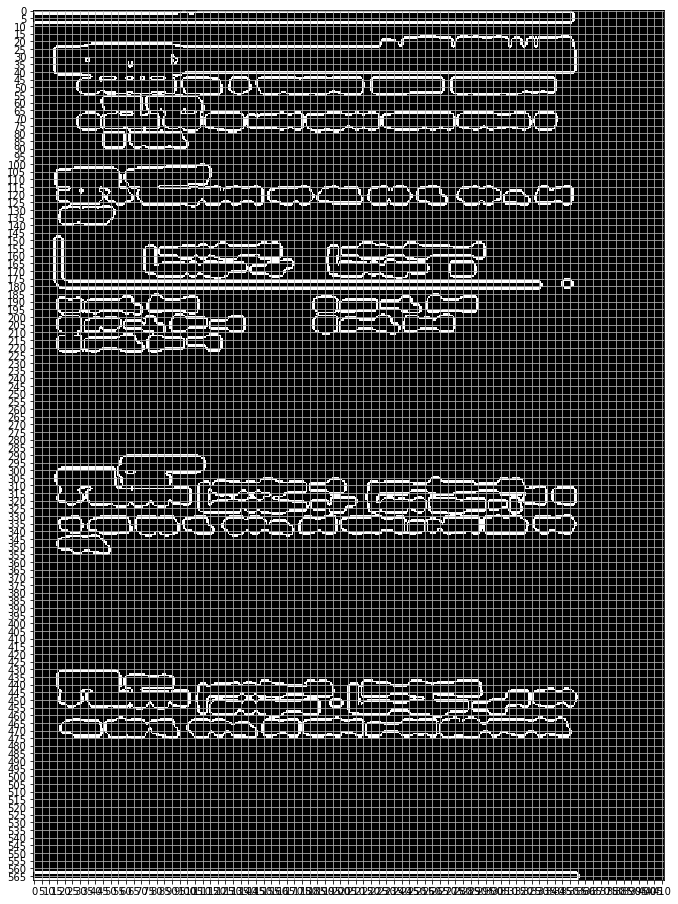

1  Pattern
IMG =  073 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

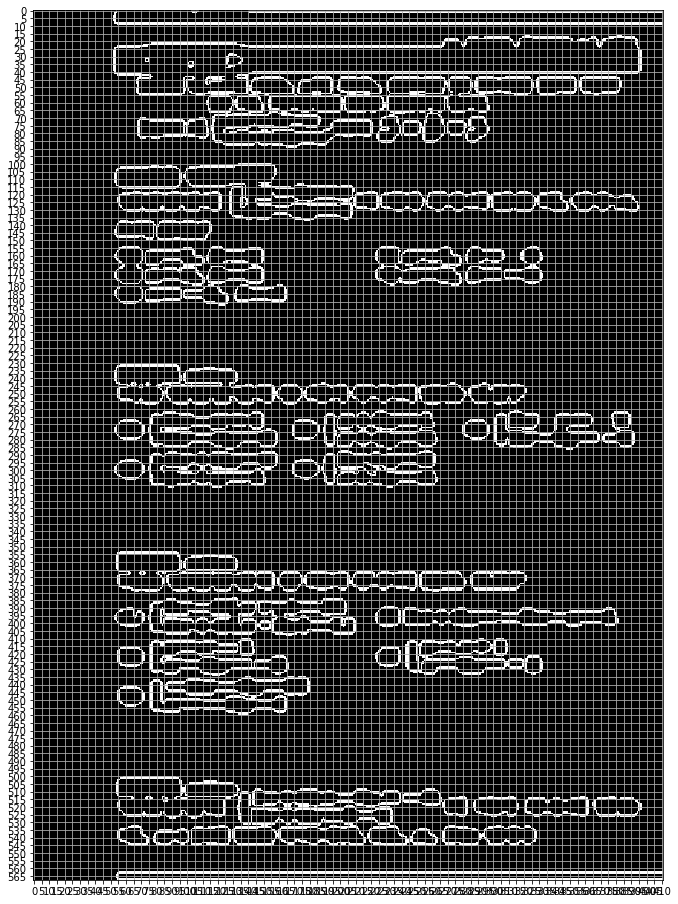

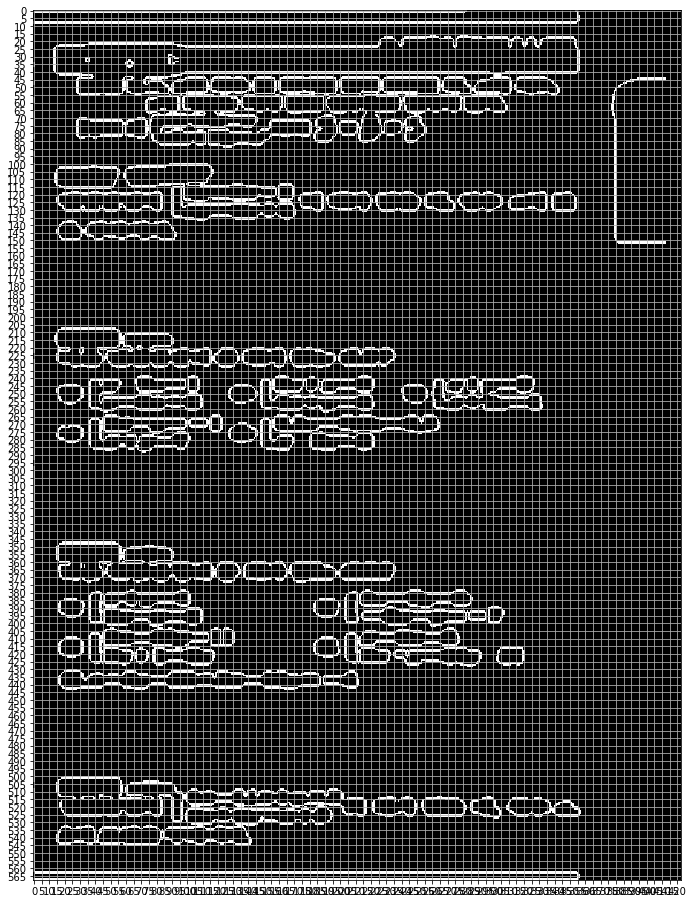

1  Pattern
IMG =  081 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

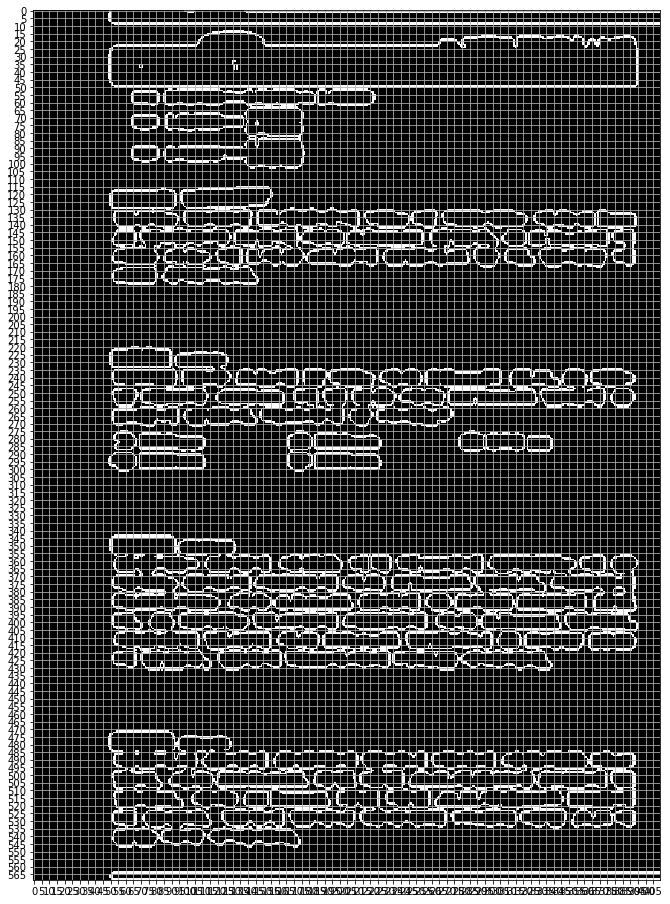

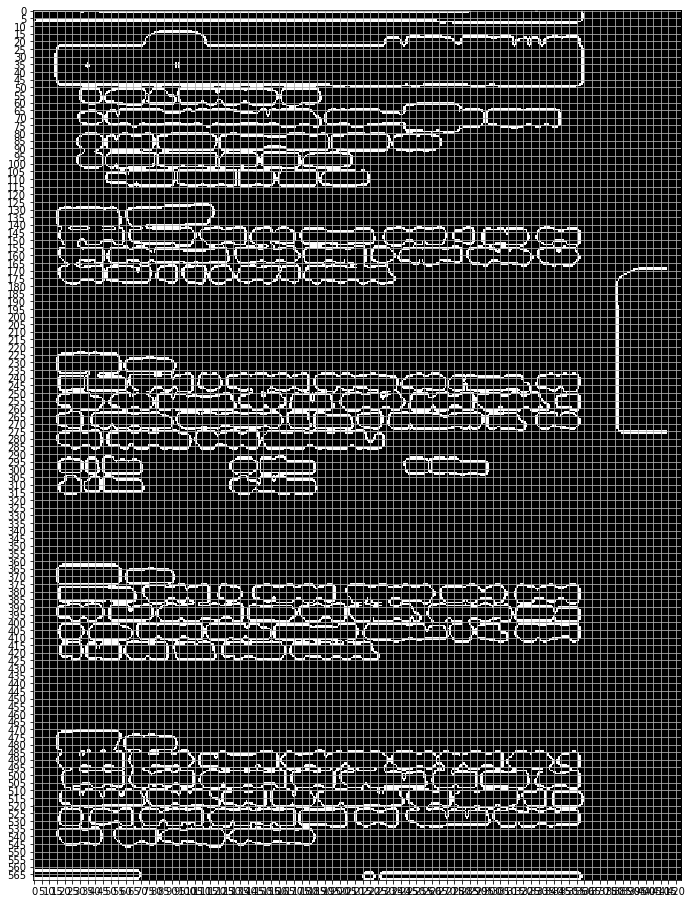

2  Pattern
IMG =  082 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

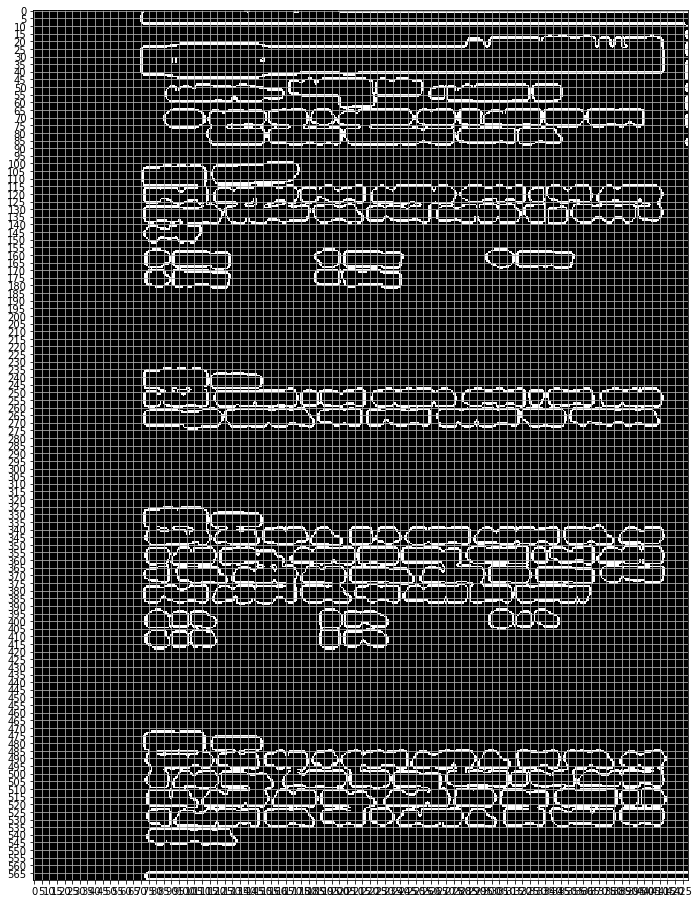

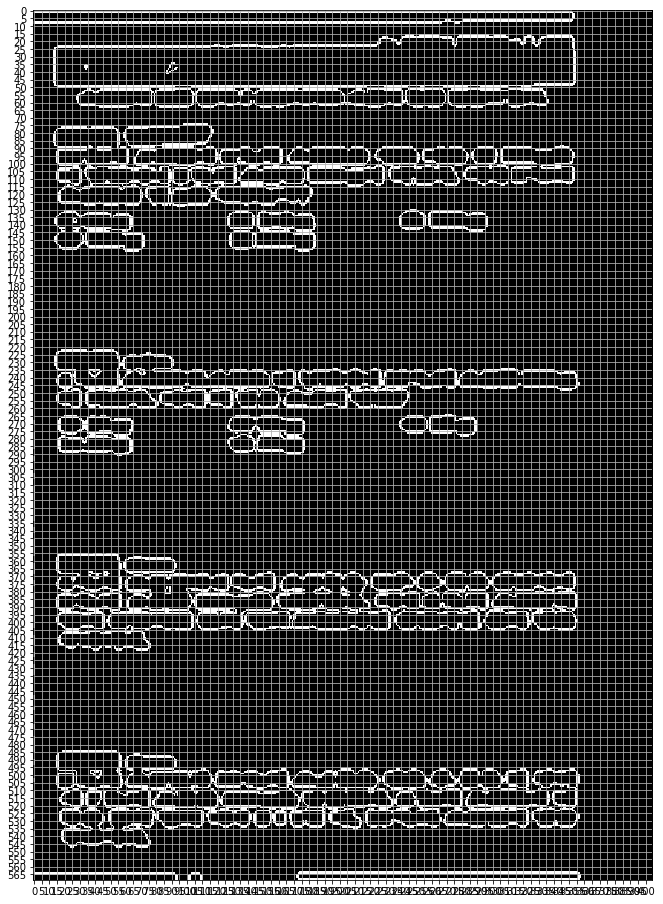

0  Pattern
IMG =  083 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

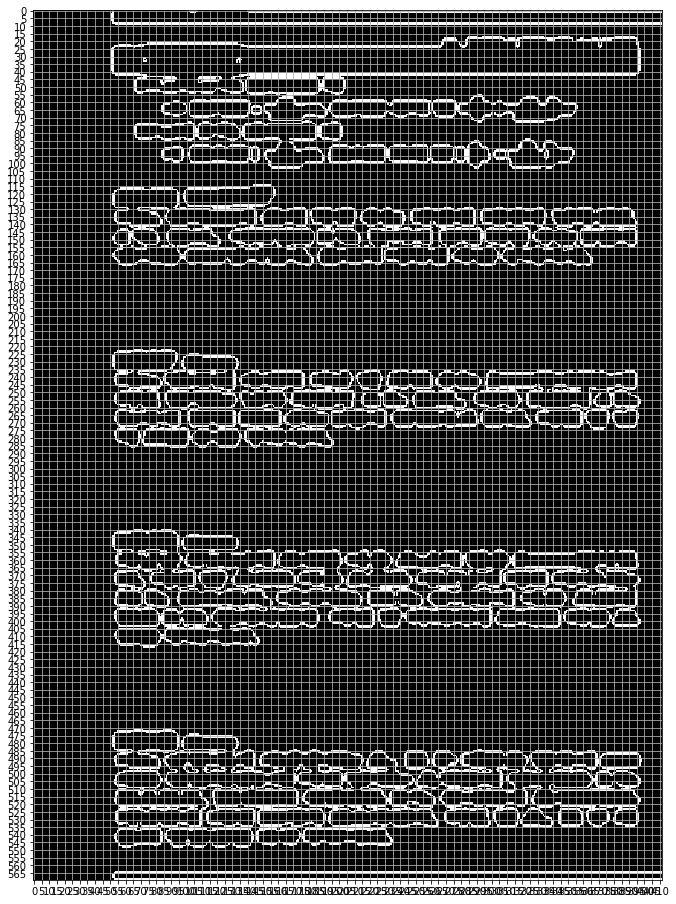

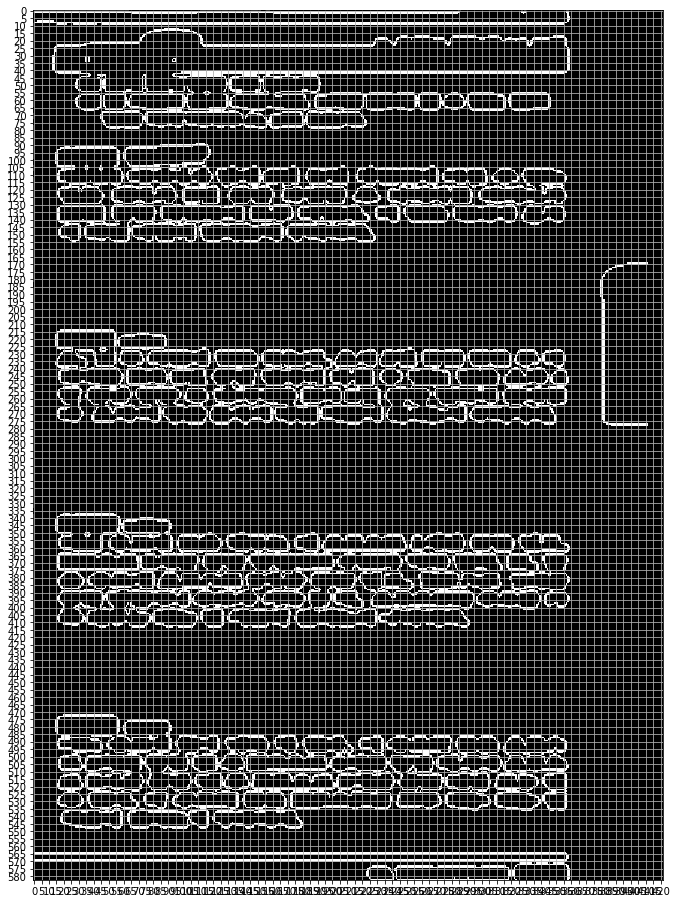

3  Pattern
IMG =  097 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

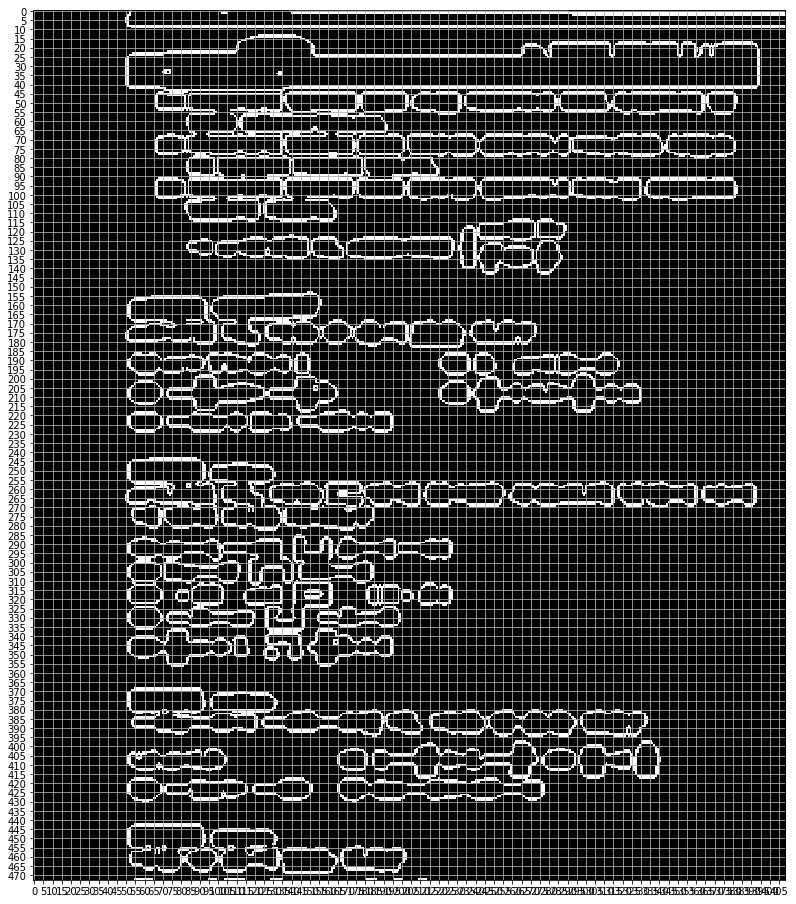

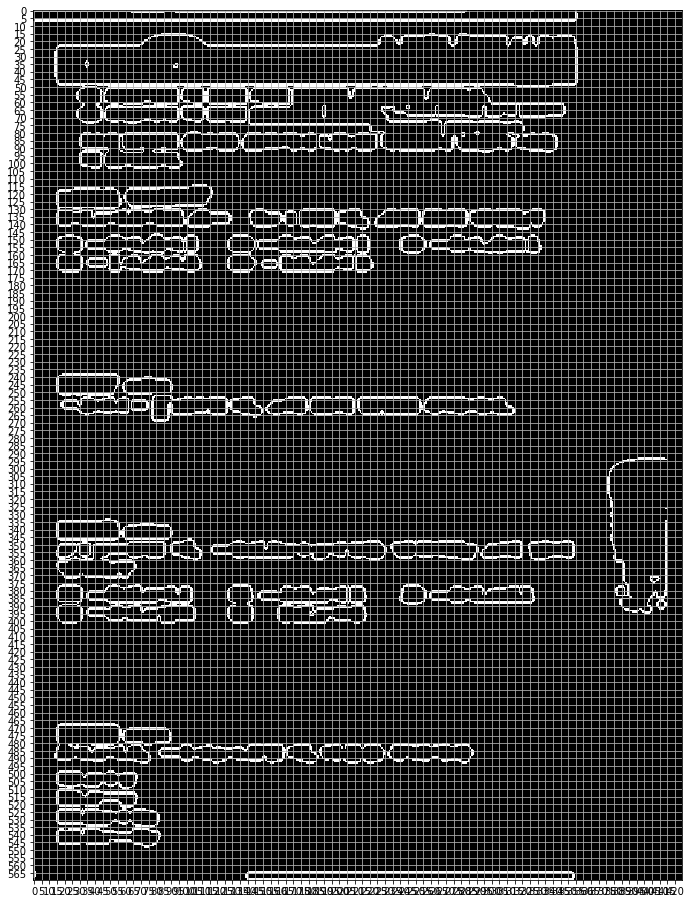

3  Pattern
IMG =  099 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

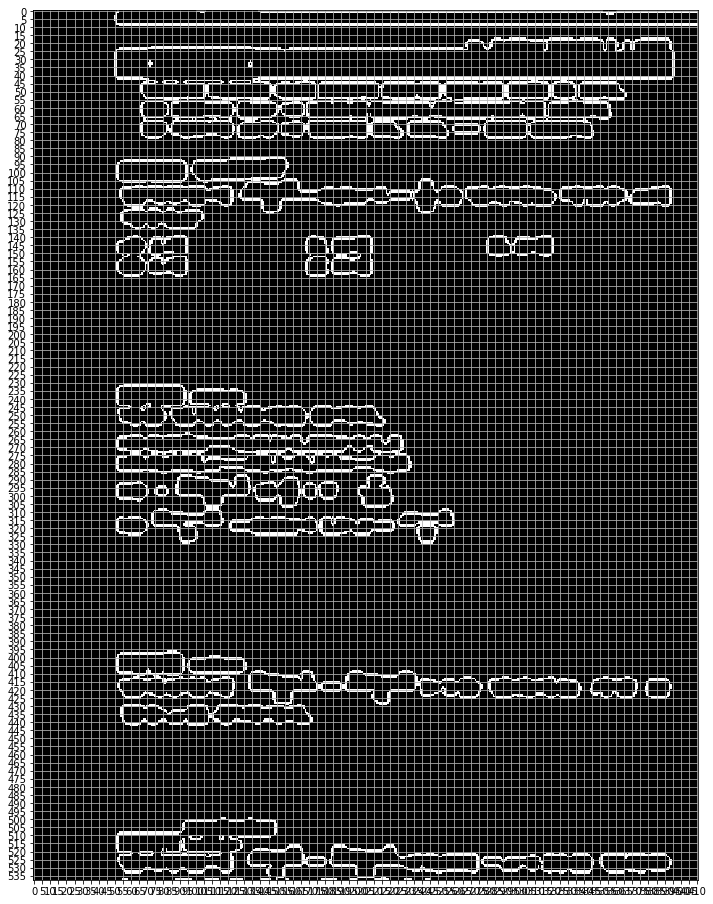

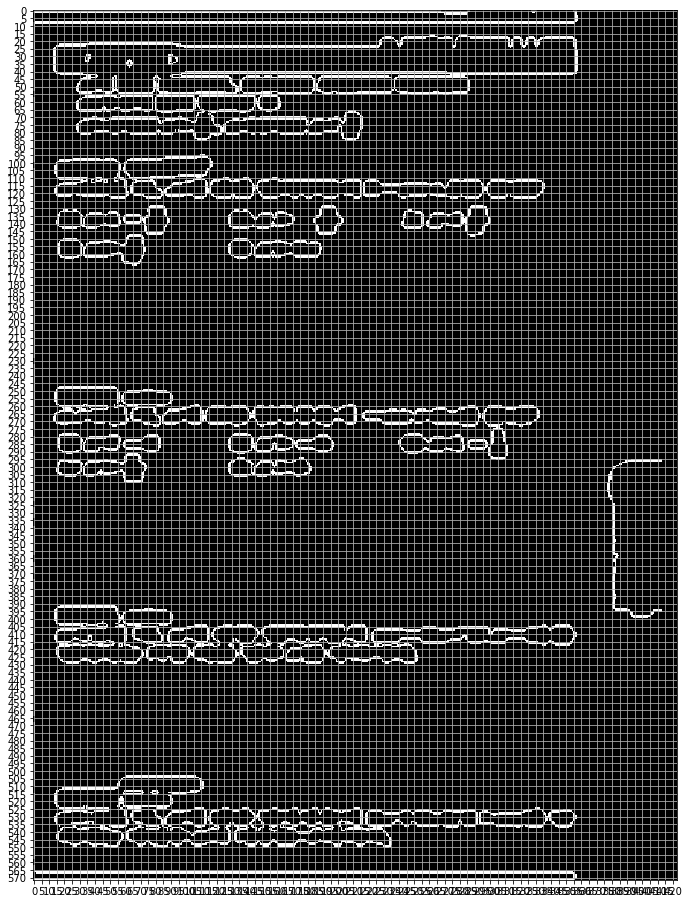

0  Pattern
IMG =  100 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

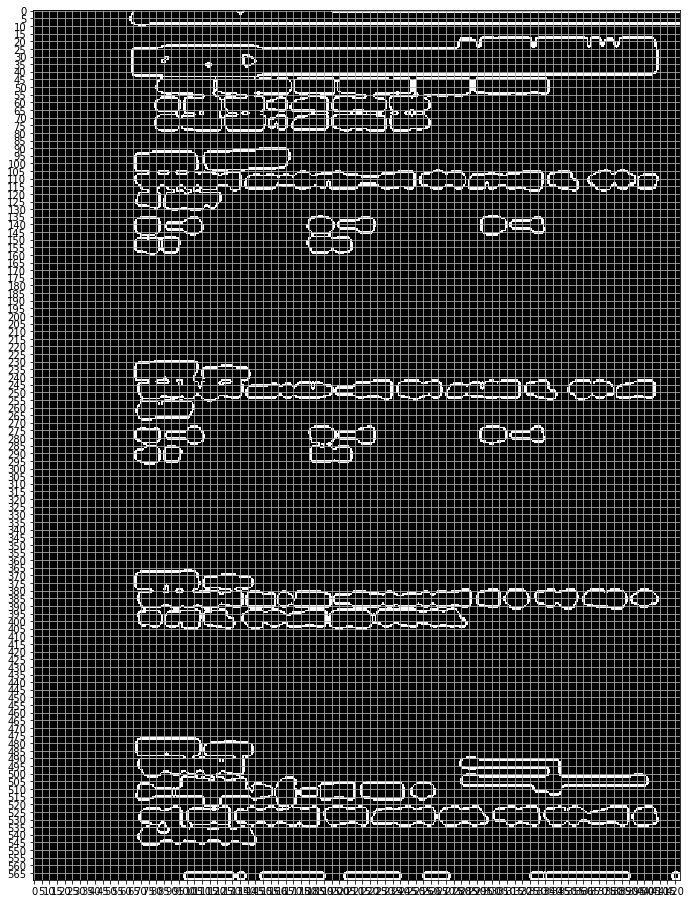

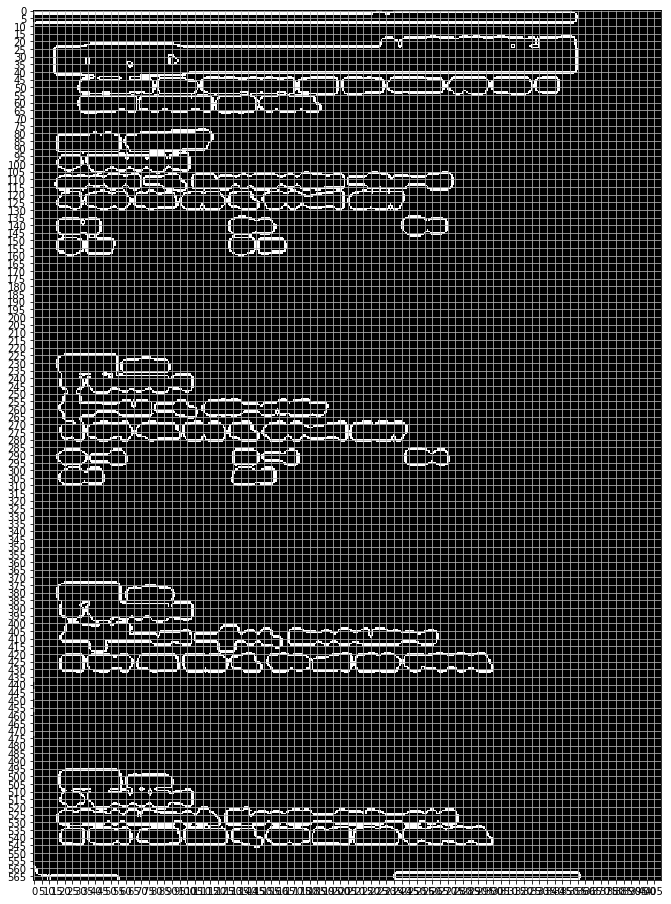

2  Pattern
IMG =  102 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

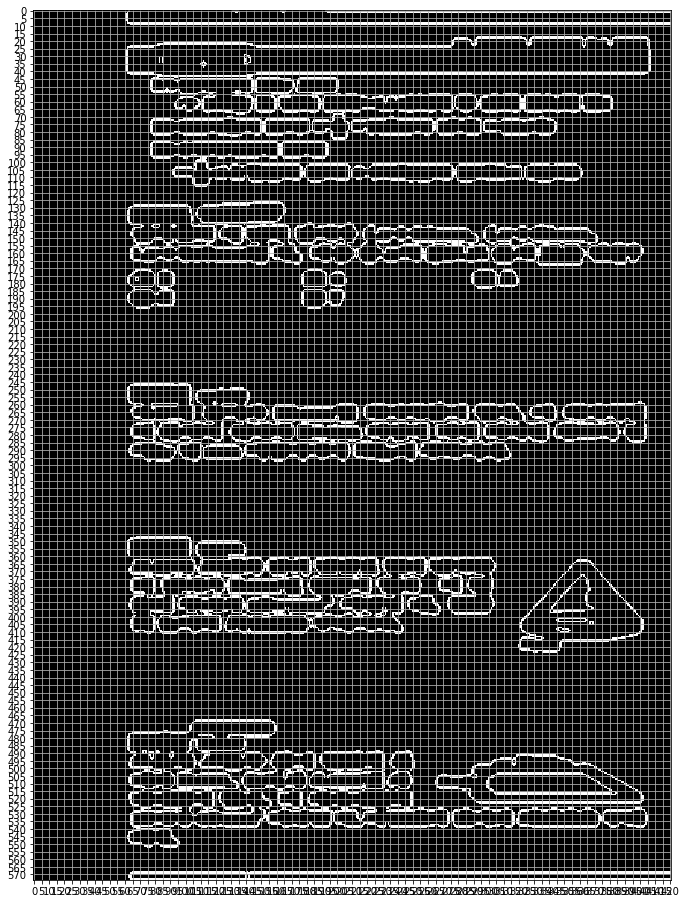

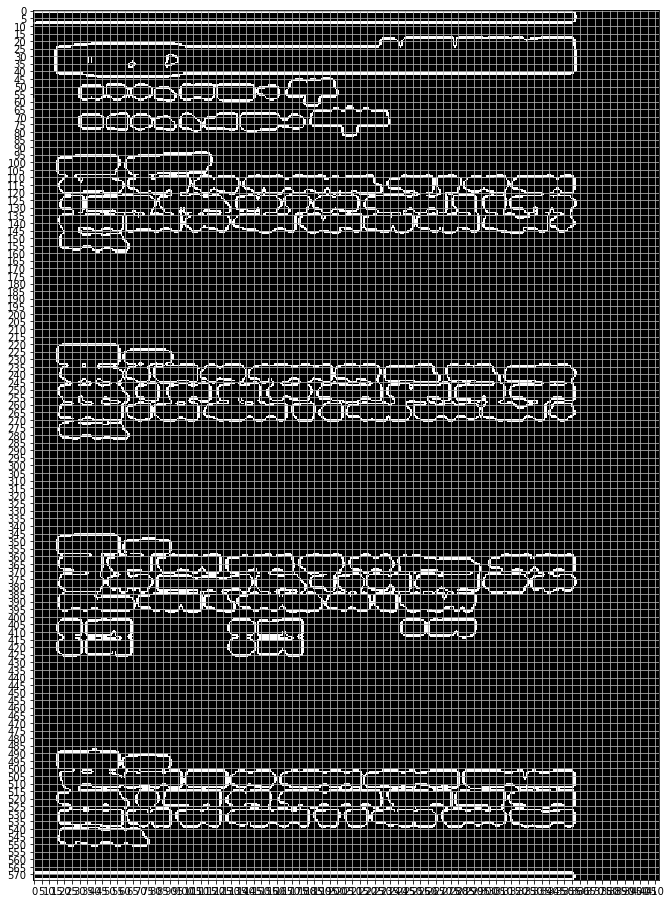

1  Pattern
IMG =  103 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

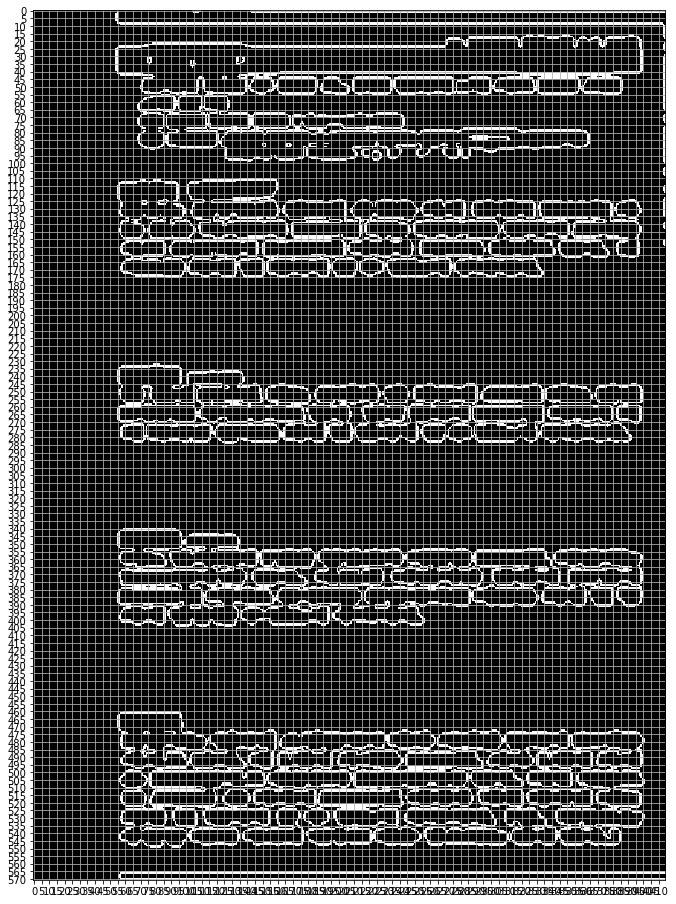

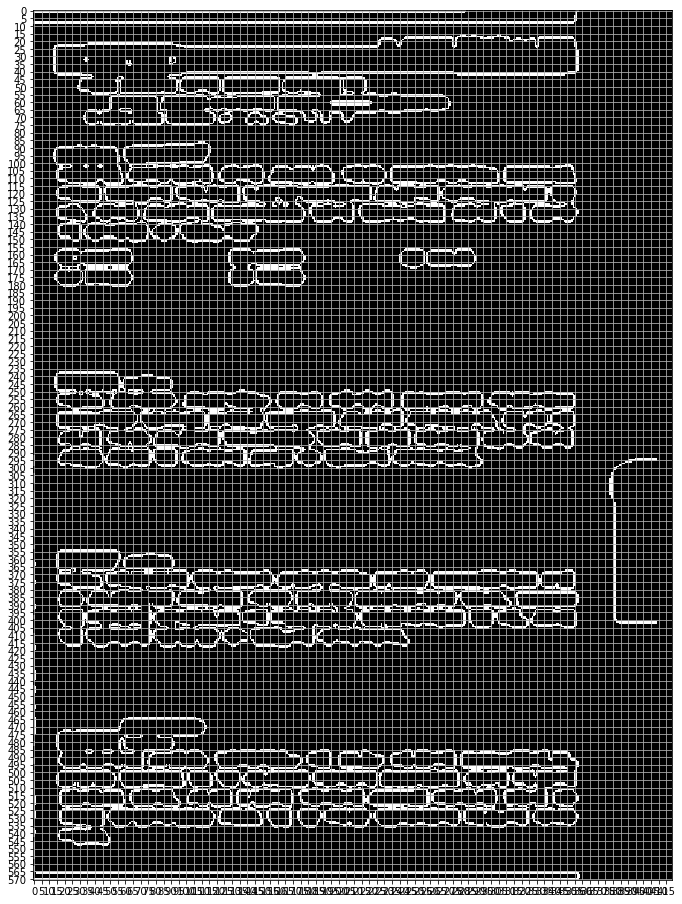

1  Pattern
IMG =  104 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

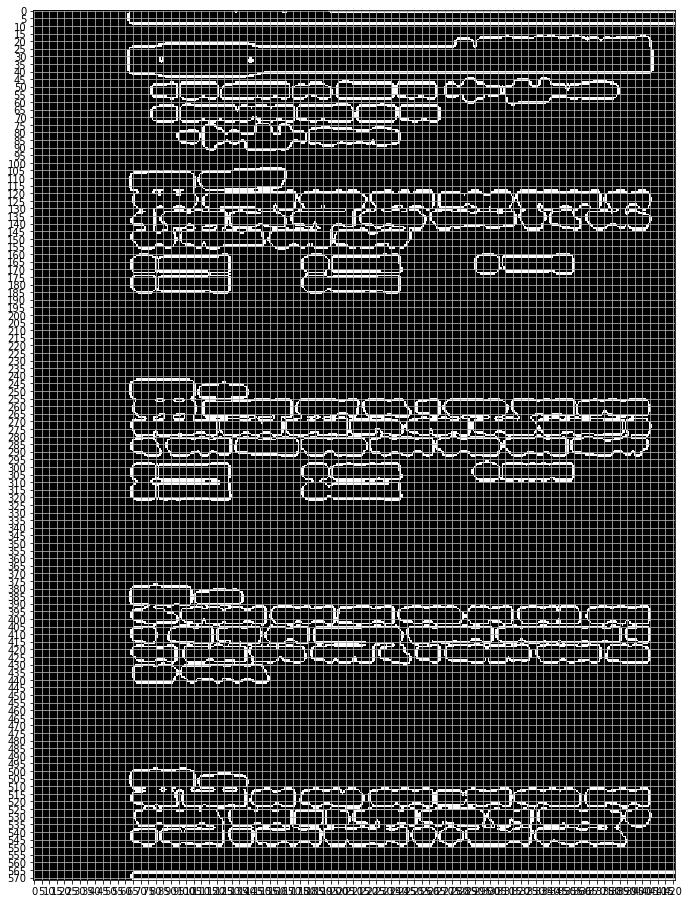

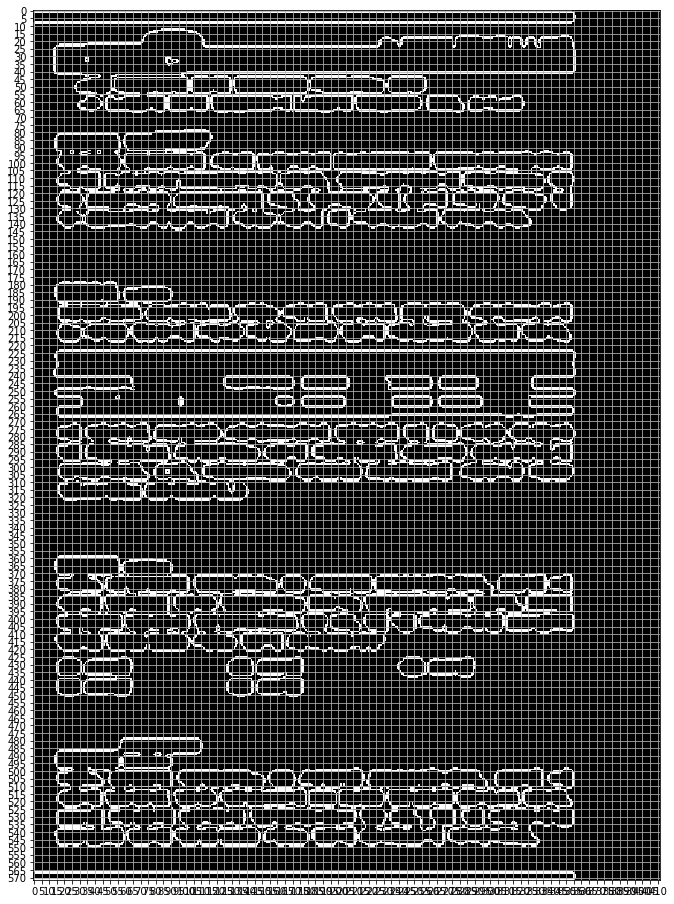

2  Pattern
IMG =  105 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

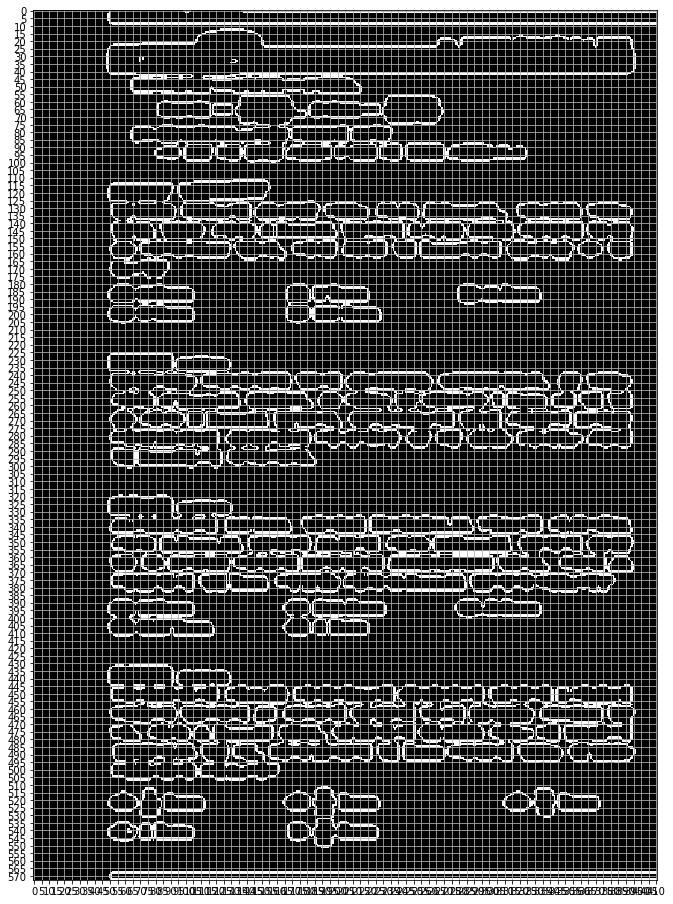

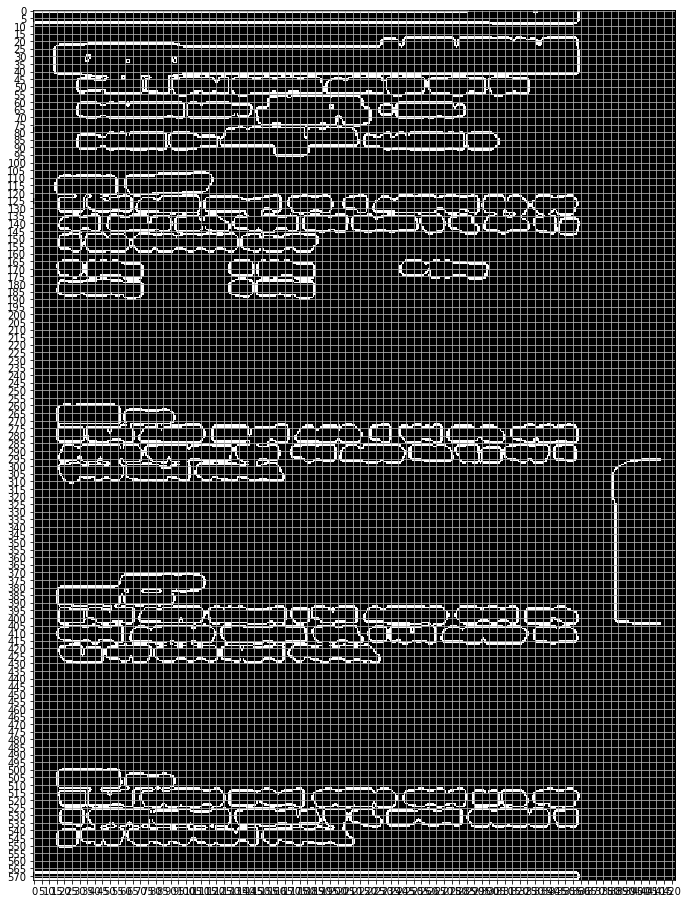

0  Pattern
IMG =  114 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

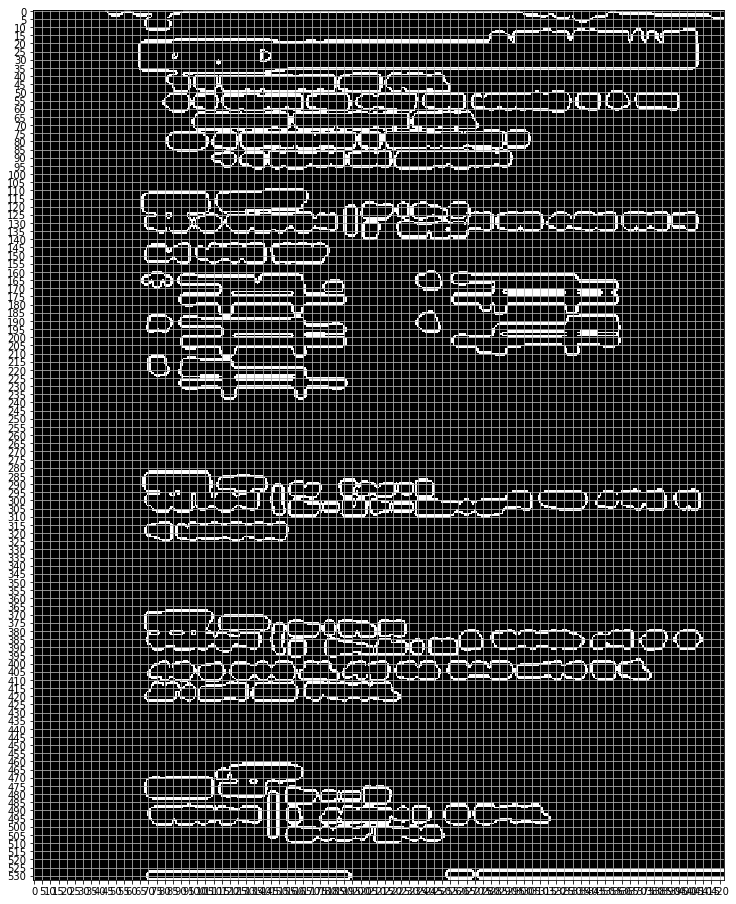

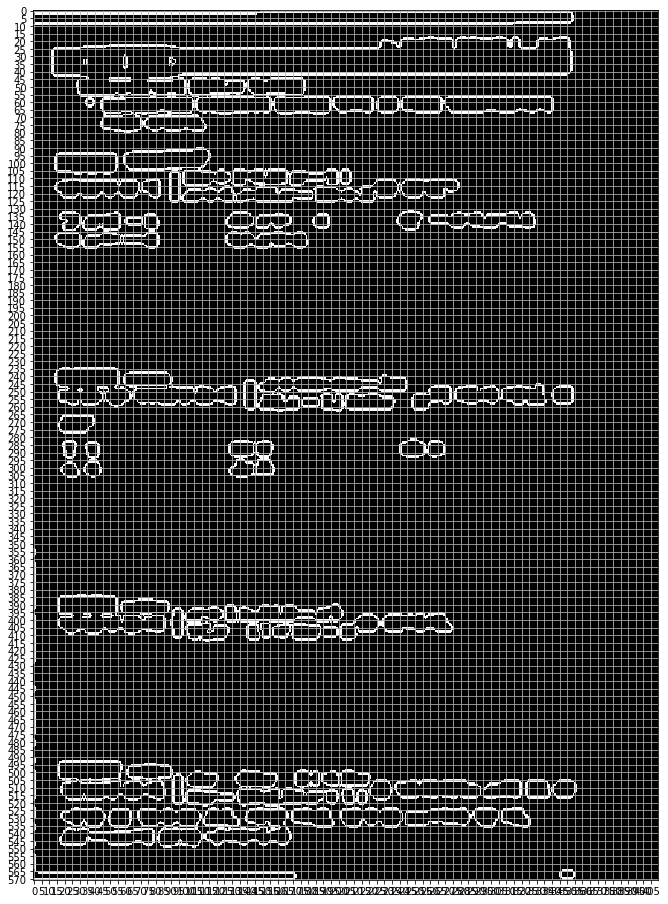

3  Pattern
IMG =  115 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

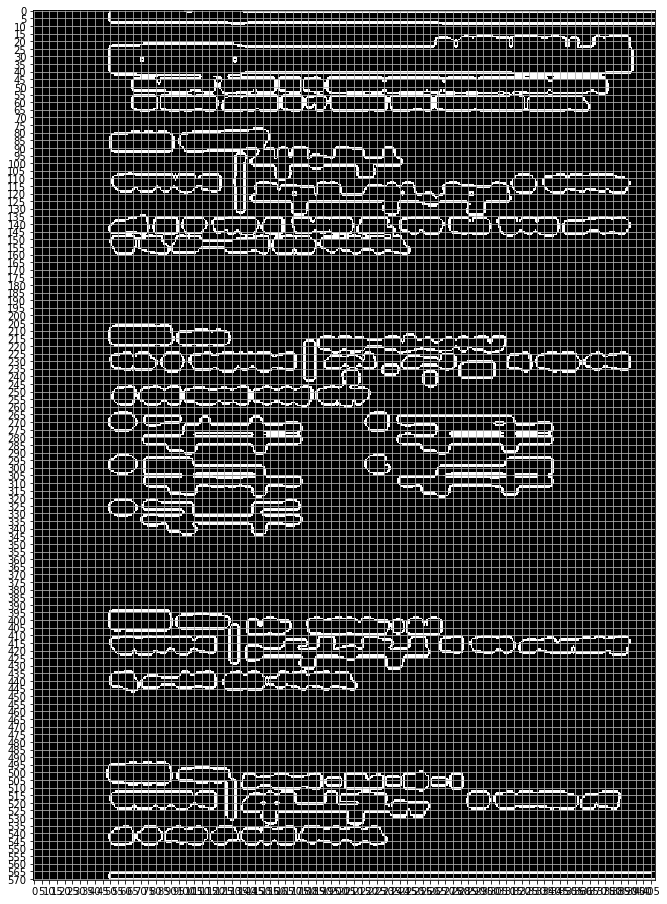

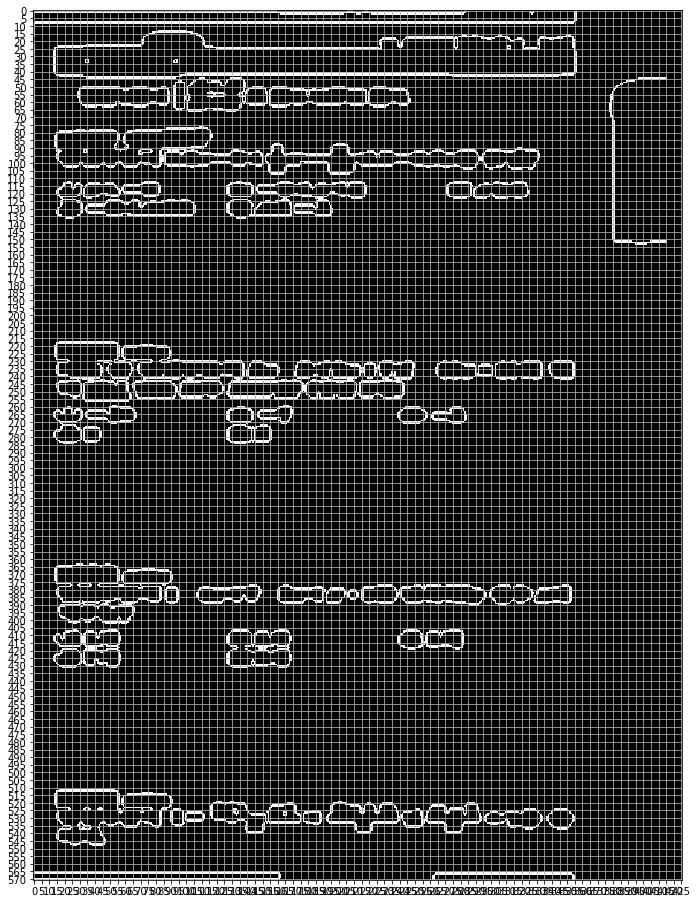

3  Pattern
IMG =  116 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

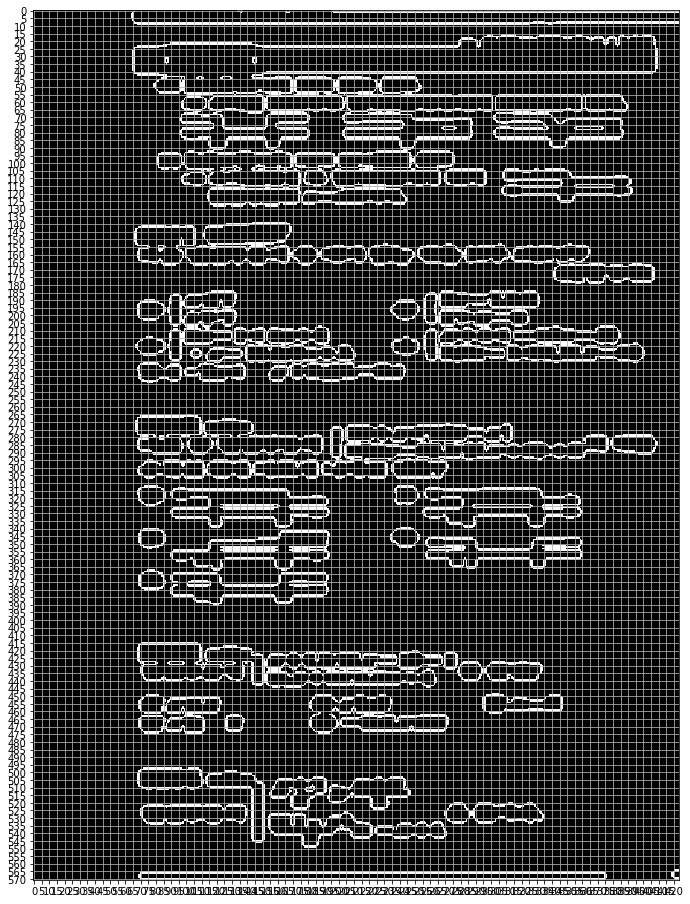

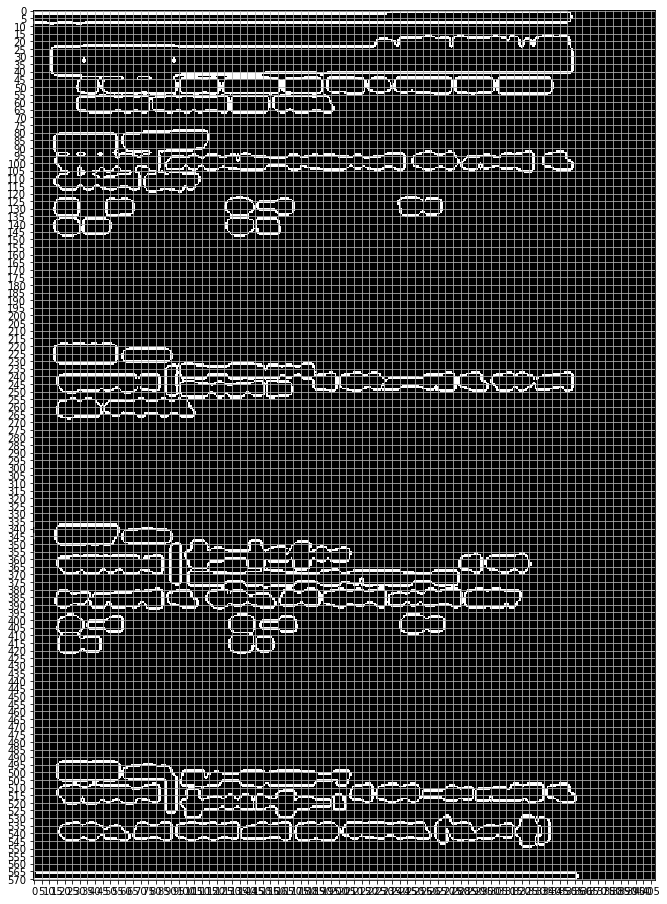

0  Pattern
IMG =  117 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

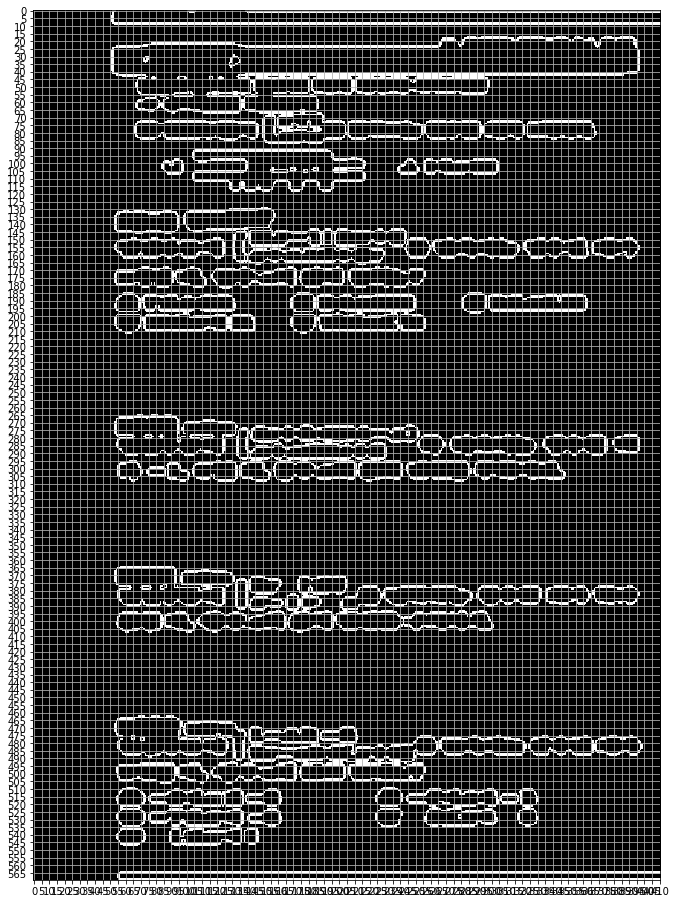

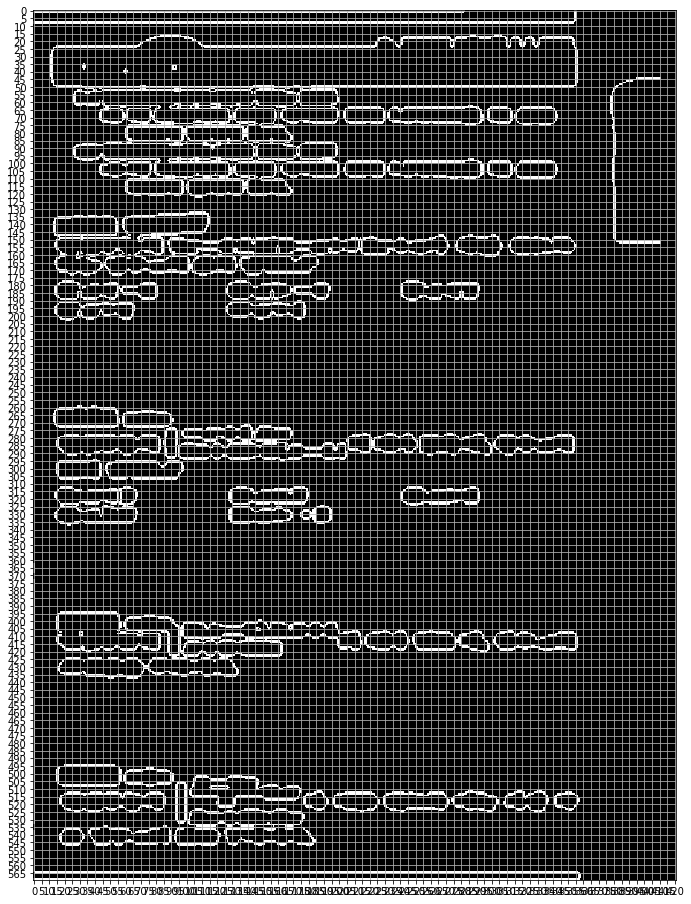

2  Pattern
IMG =  118 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

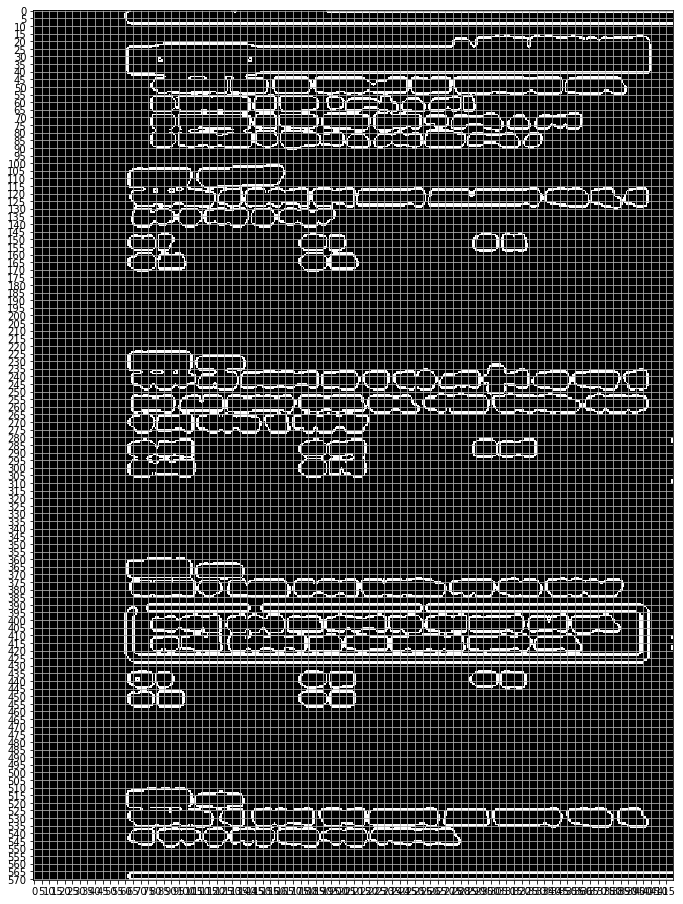

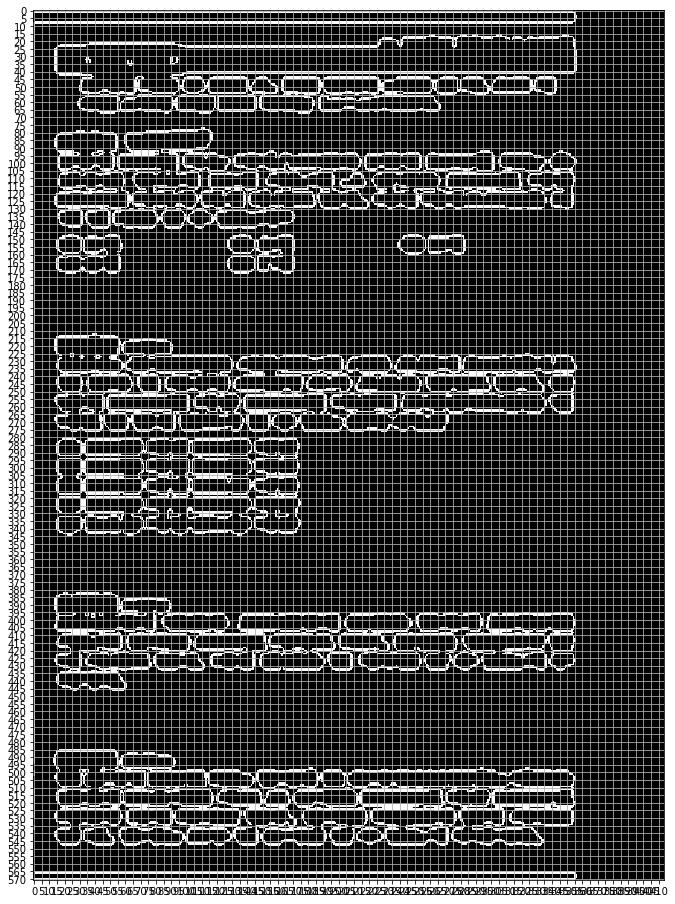

1  Pattern
IMG =  119 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

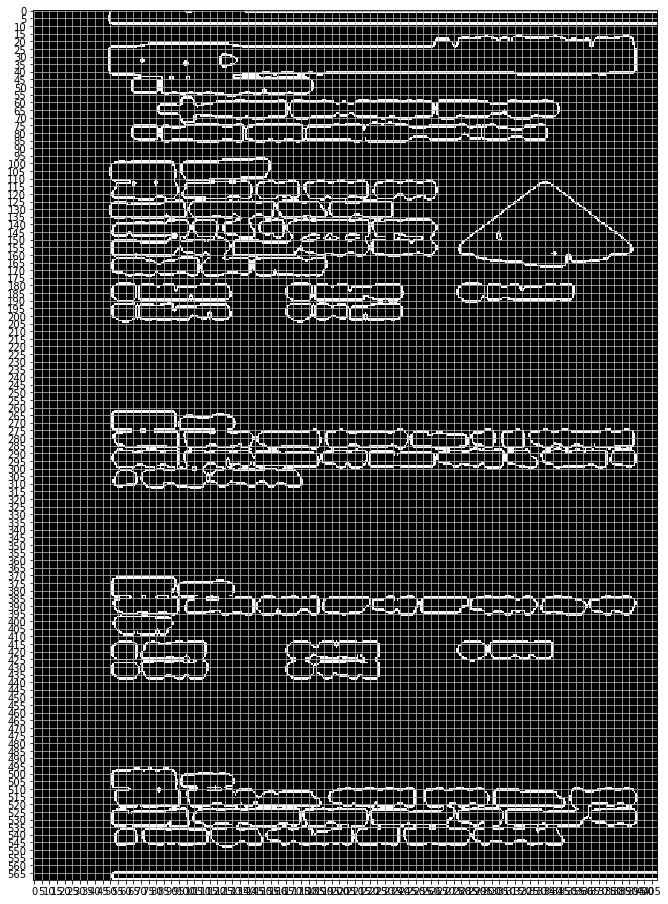

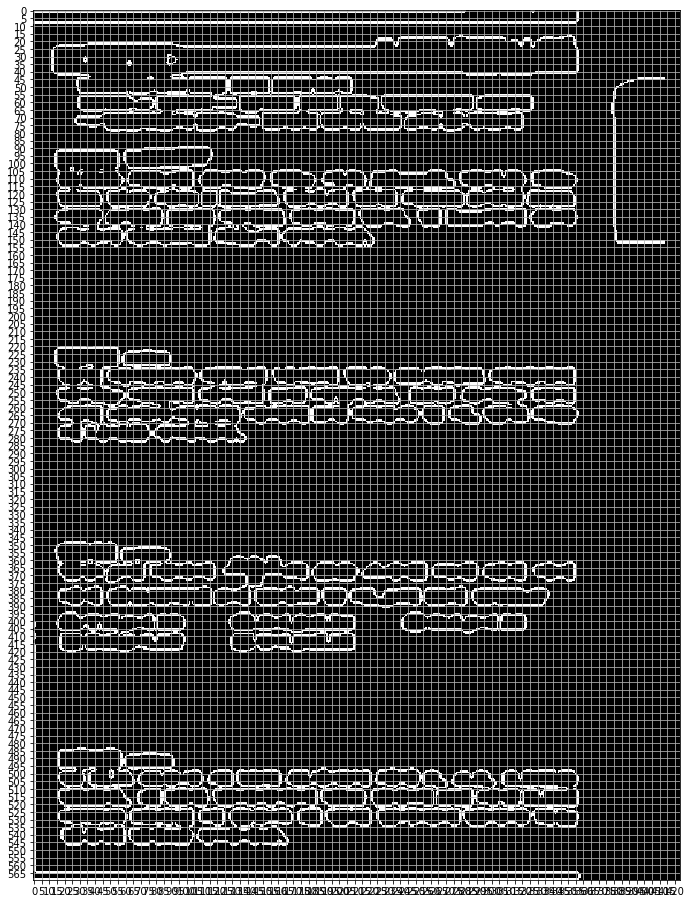

1  Pattern
IMG =  120 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

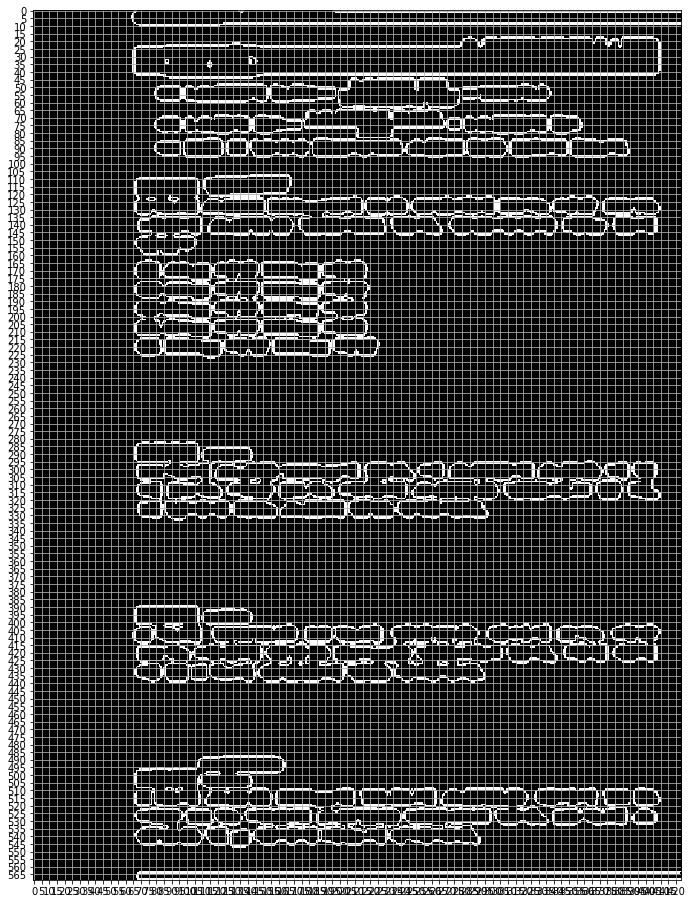

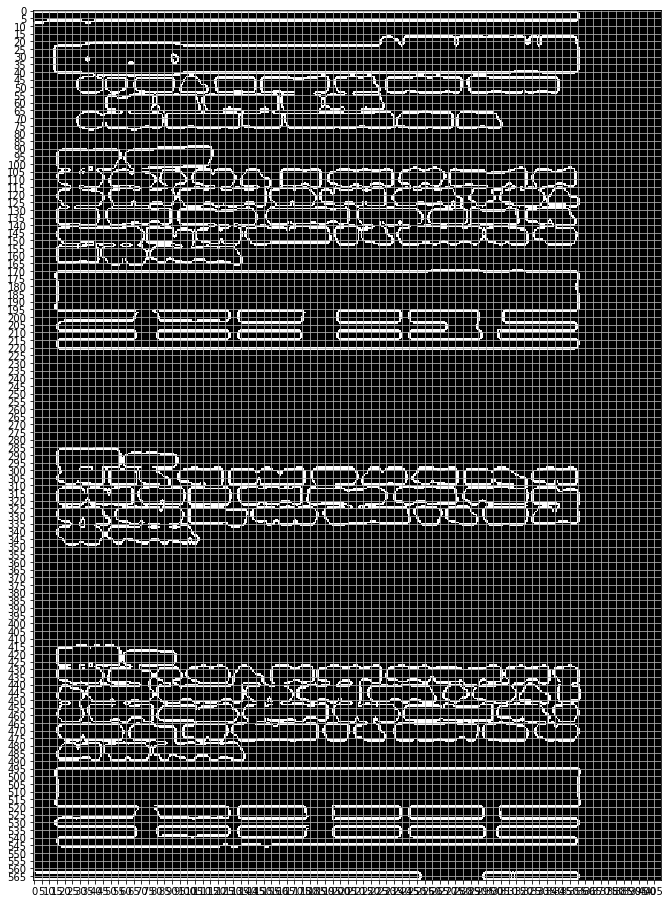

2  Pattern
IMG =  121 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

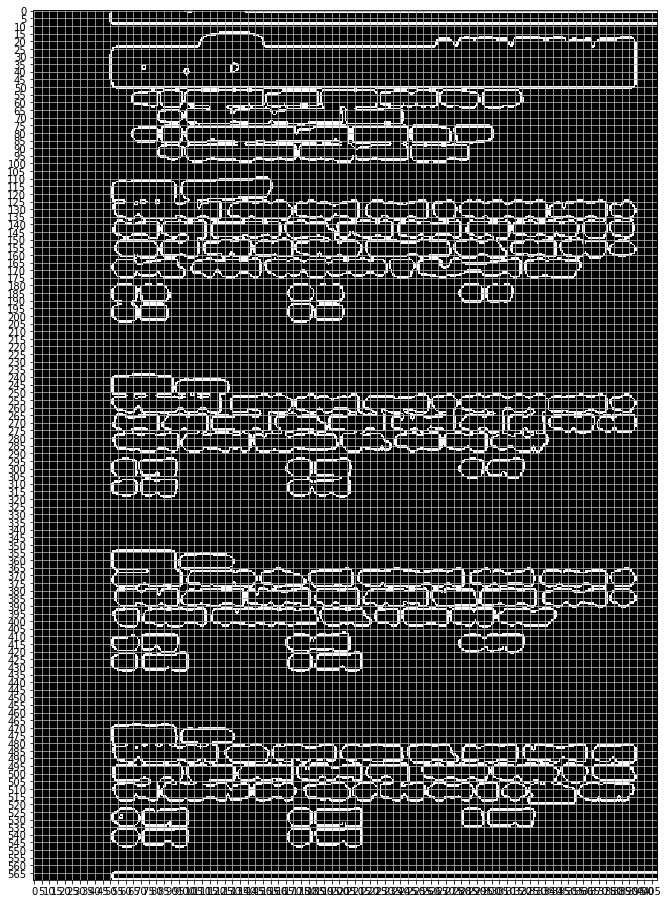

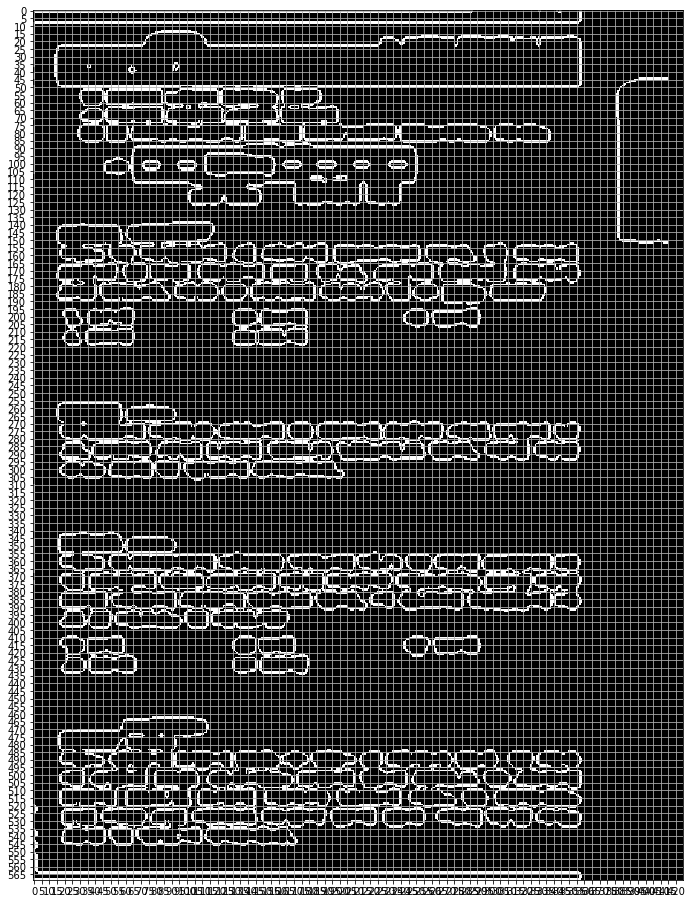

0  Pattern
IMG =  132 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

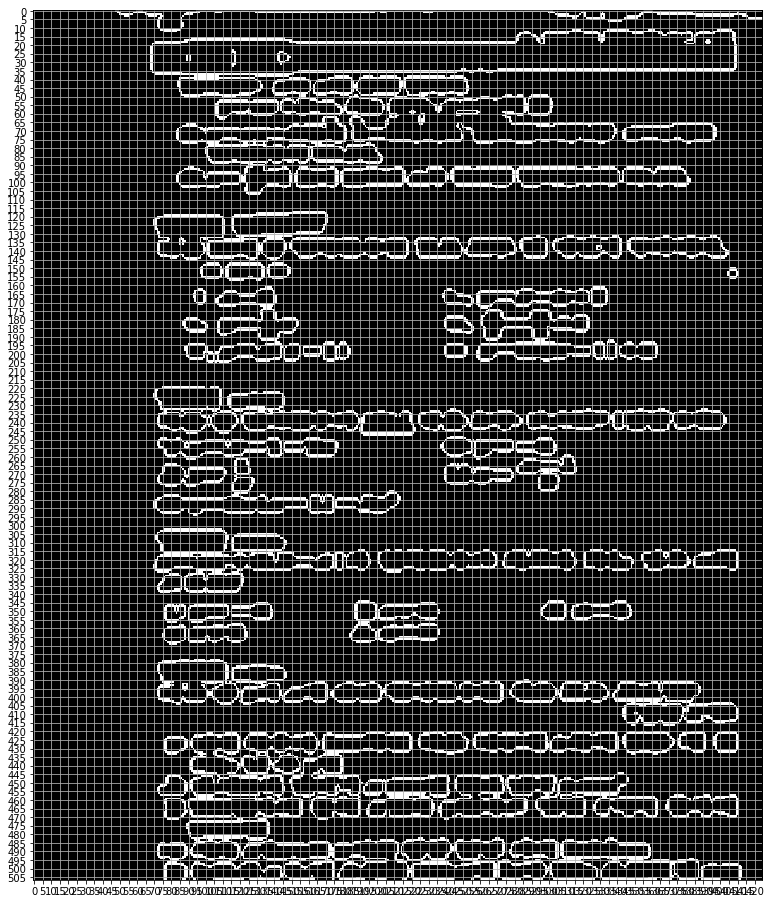

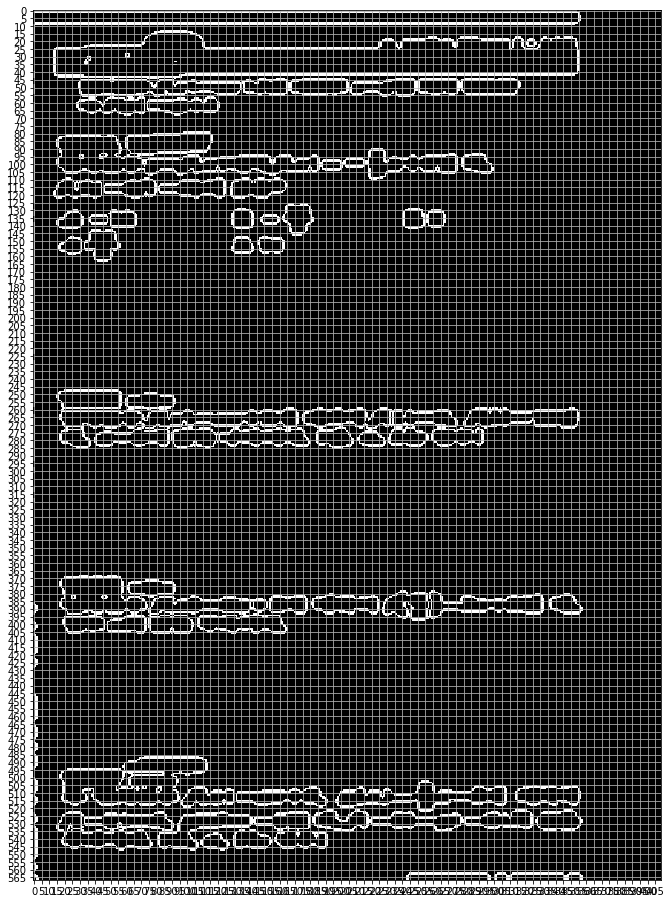

3  Pattern
IMG =  133 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

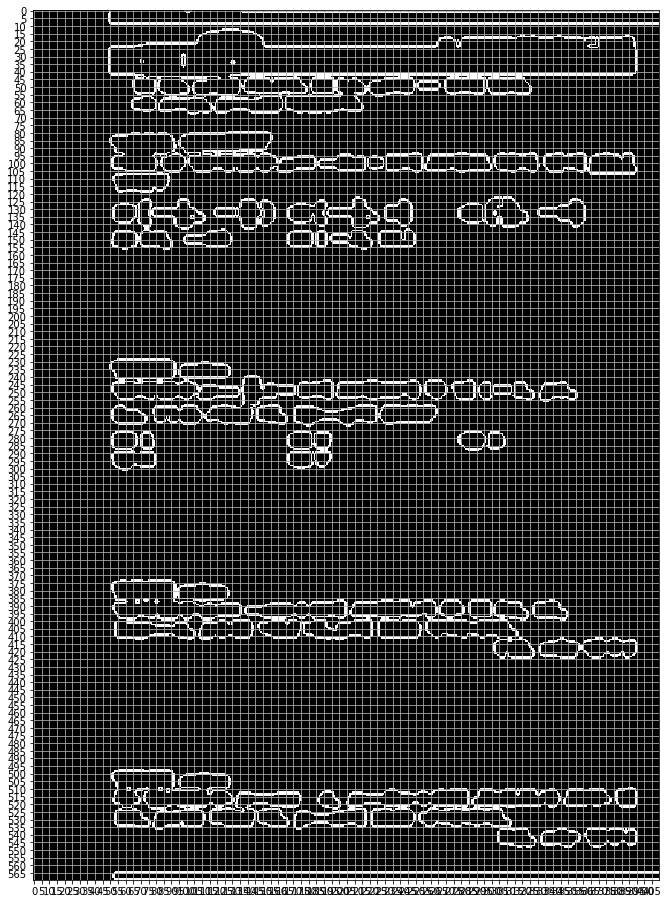

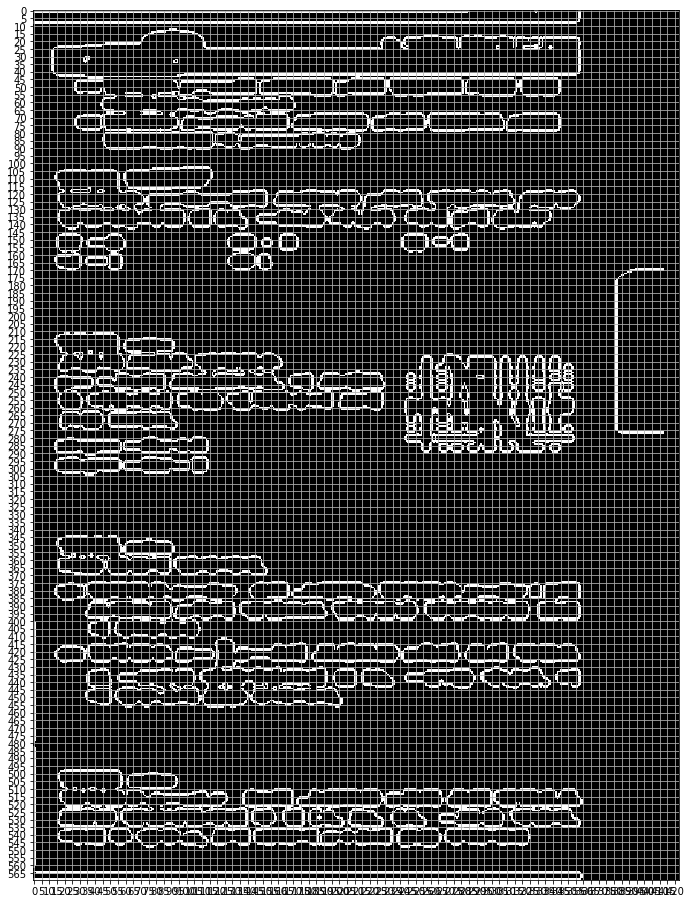

3  Pattern
IMG =  134 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

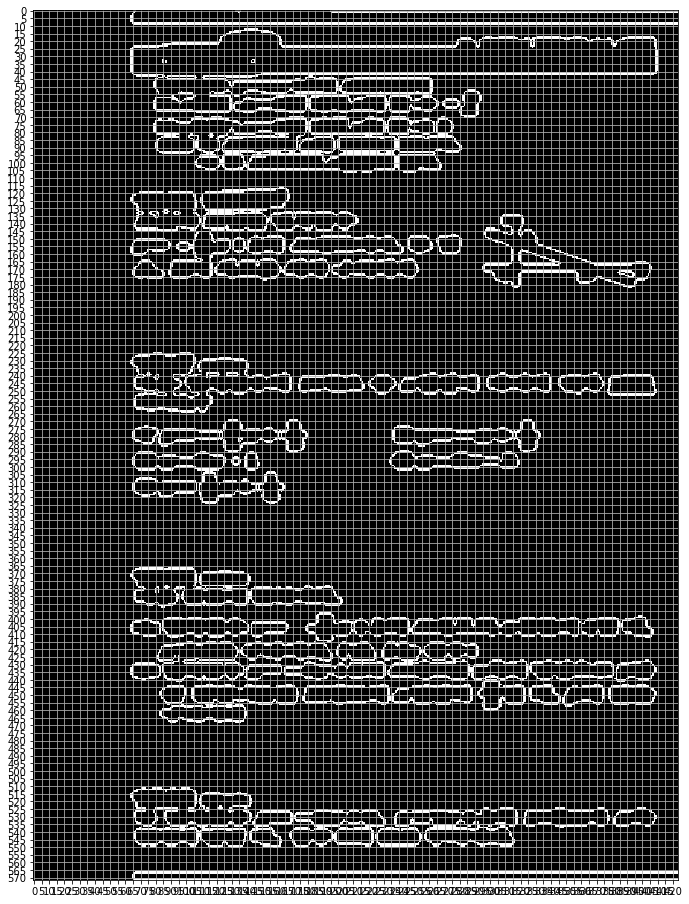

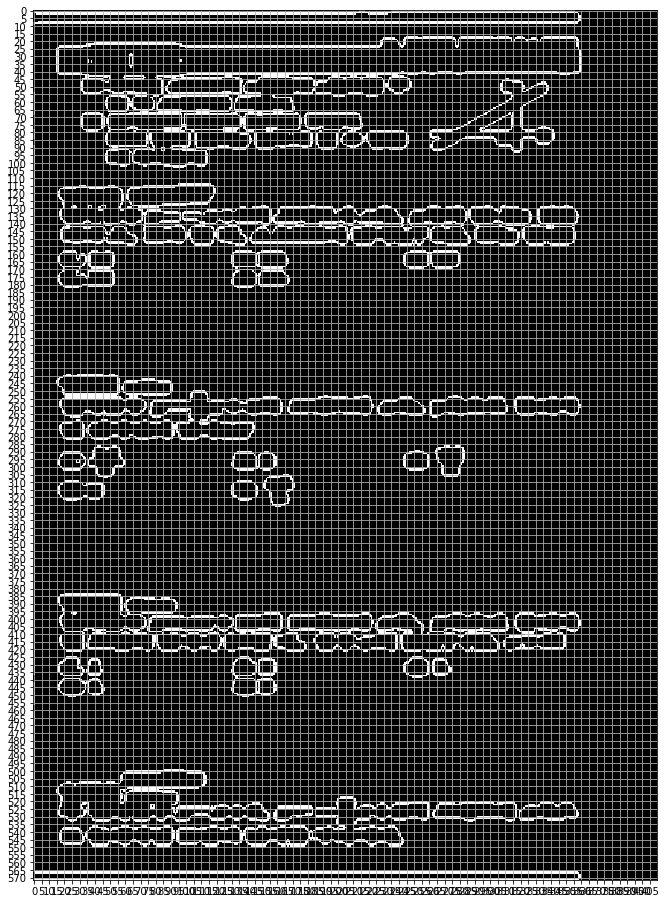

0  Pattern
IMG =  135 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

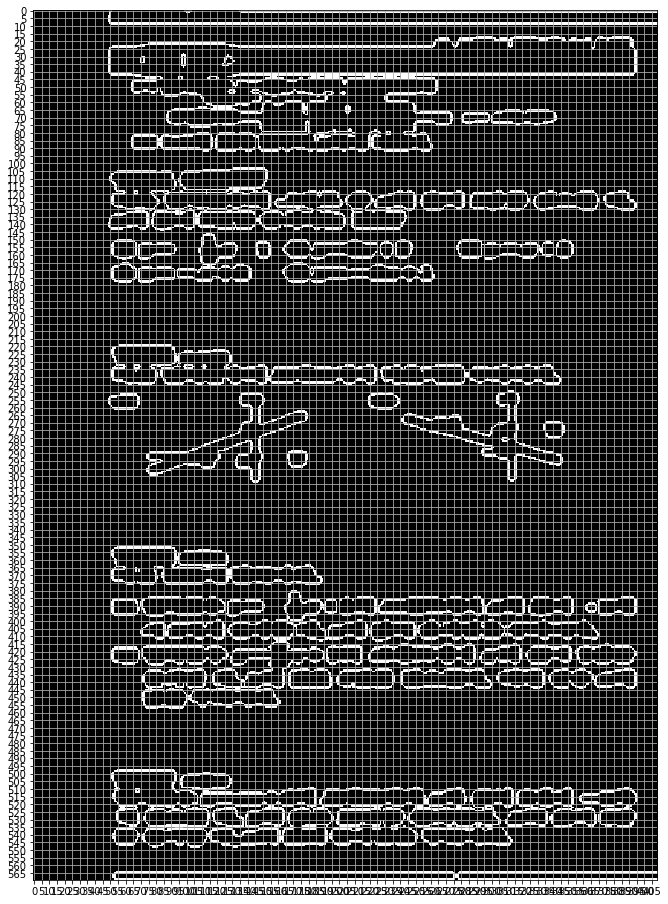

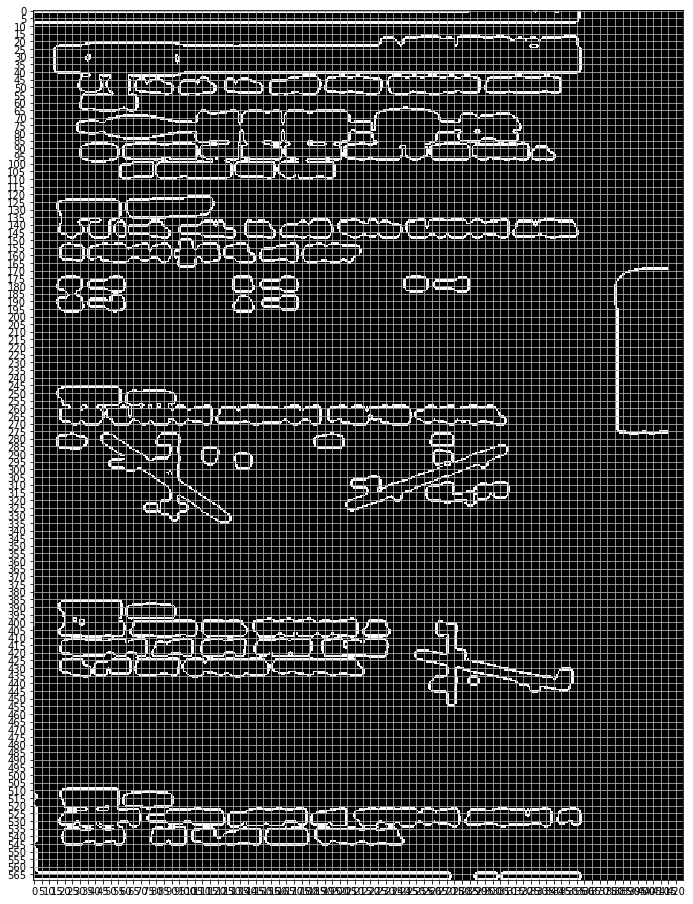

2  Pattern
IMG =  137 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

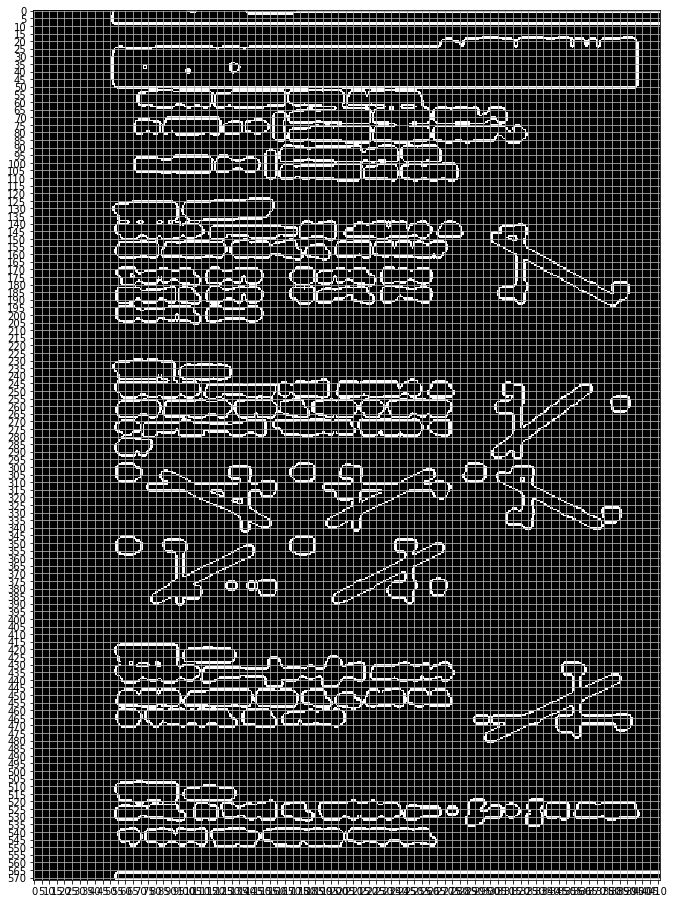

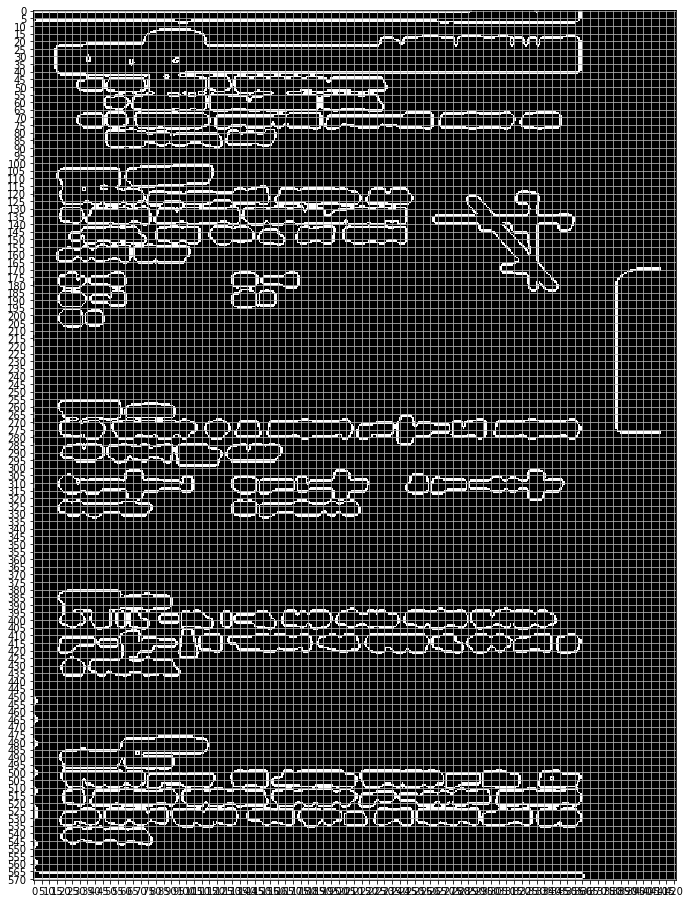

1  Pattern
IMG =  138 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

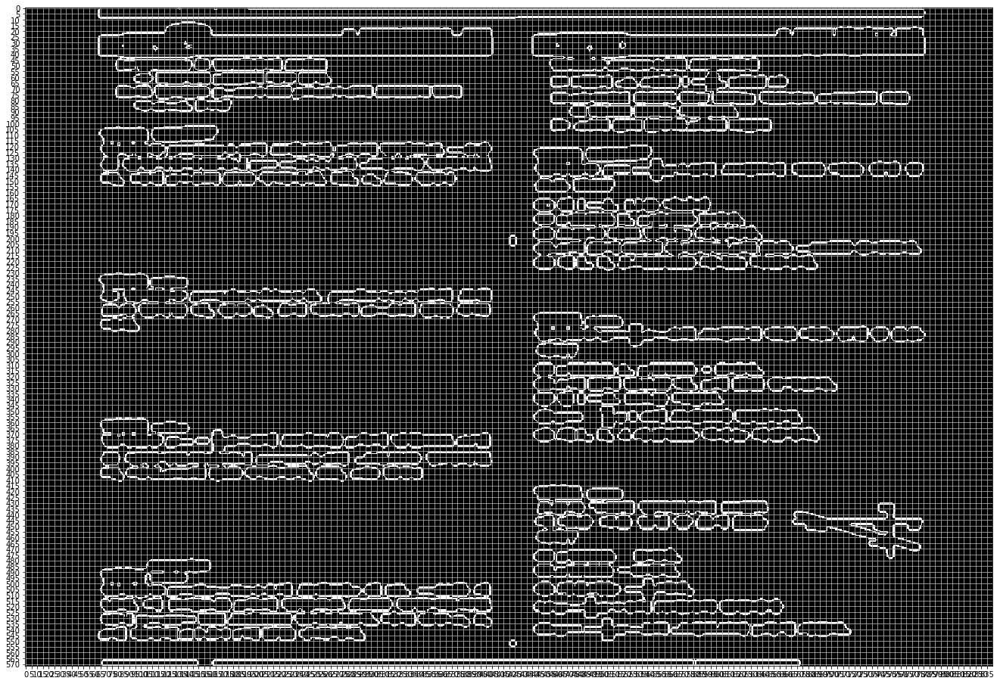

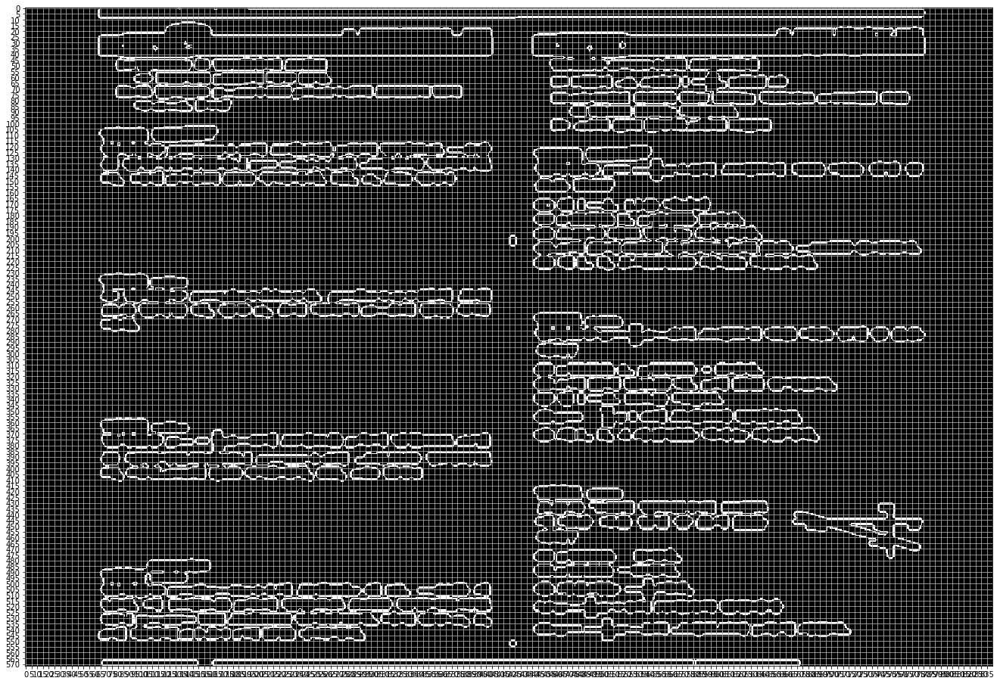

1  Pattern
IMG =  139 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

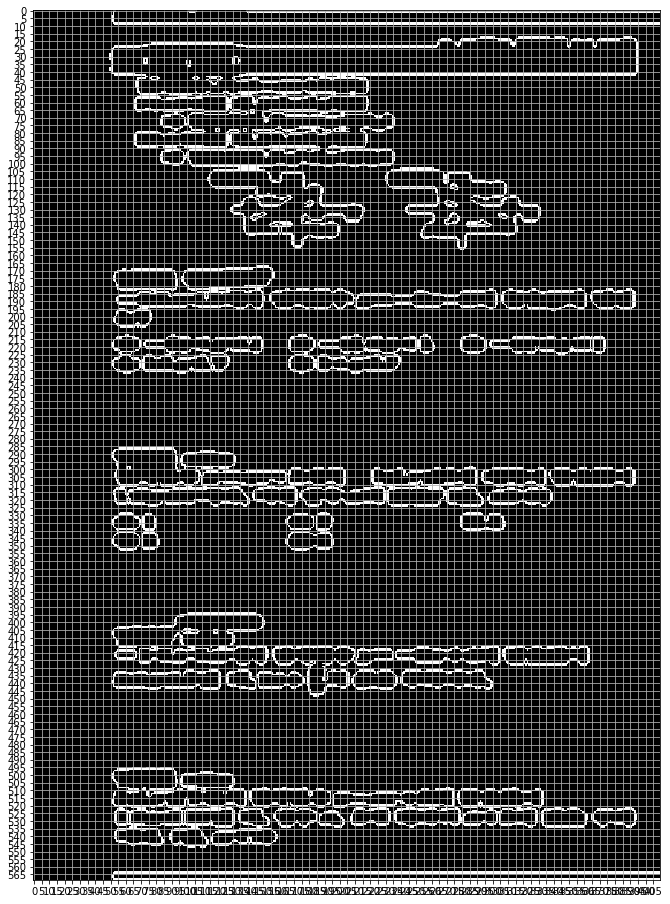

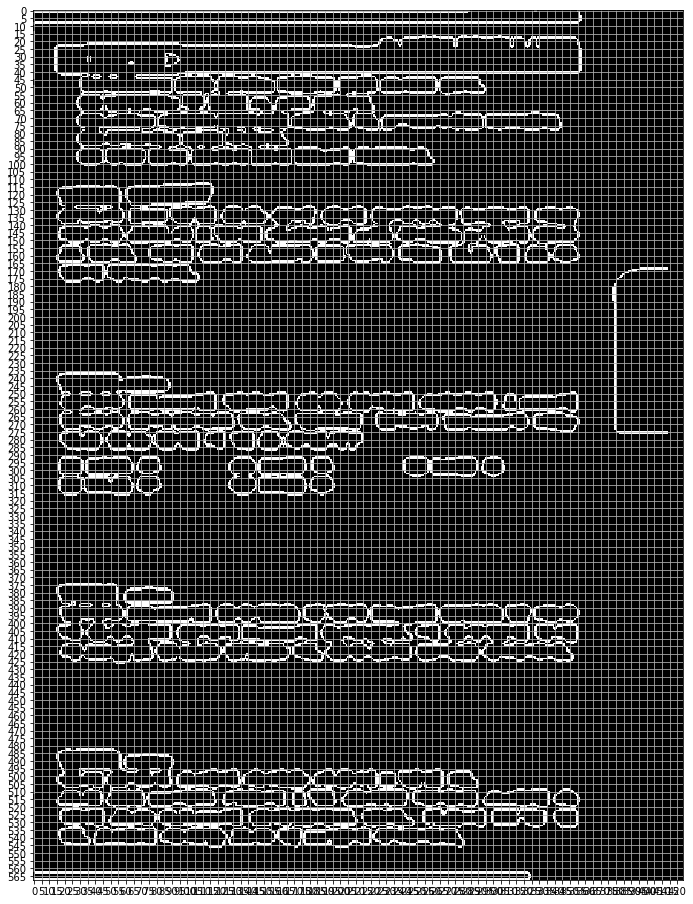

2  Pattern
IMG =  140 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

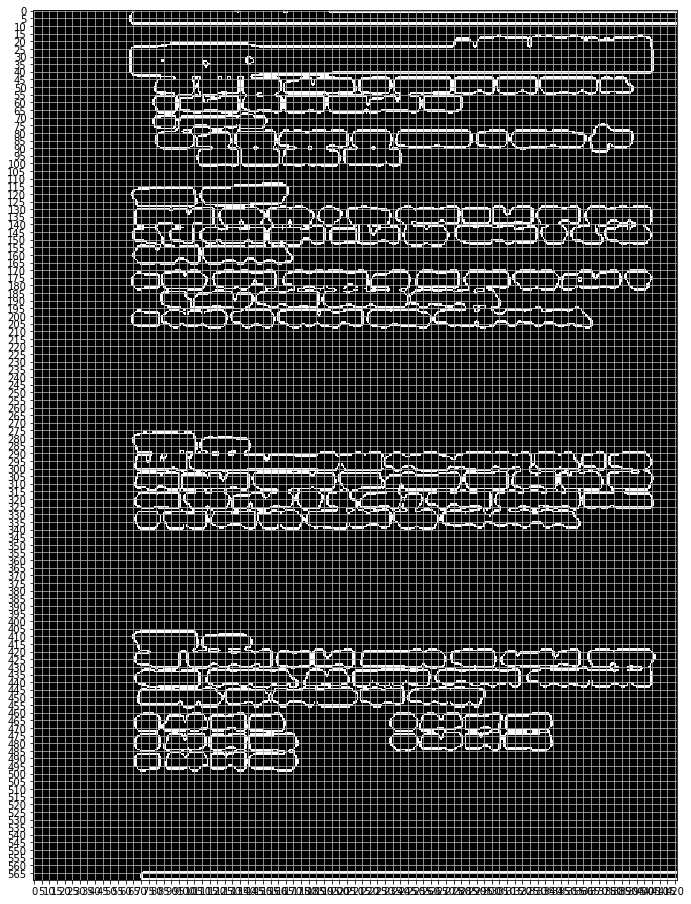

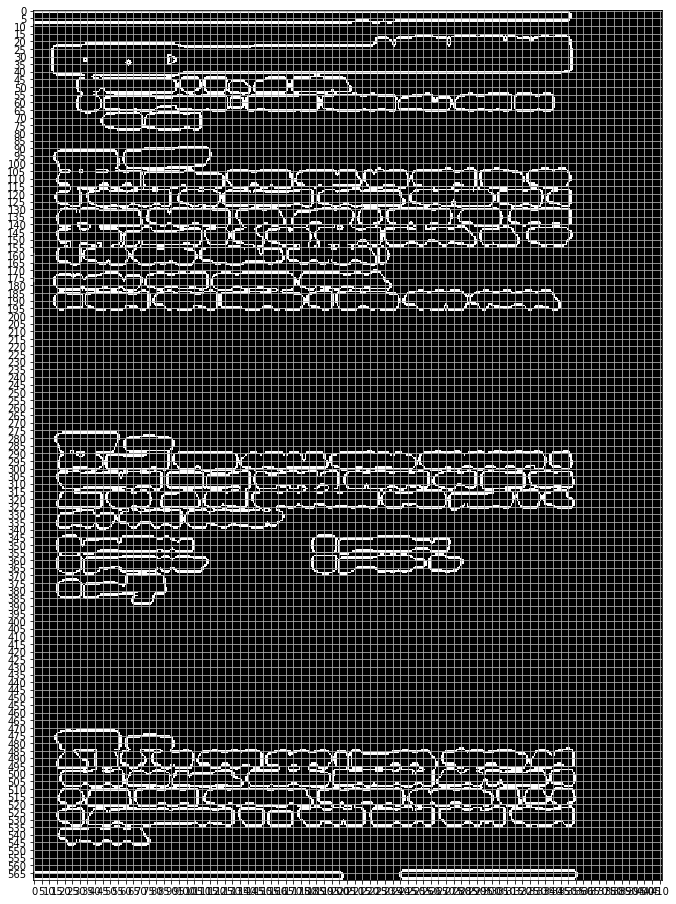

0  Pattern
IMG =  141 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

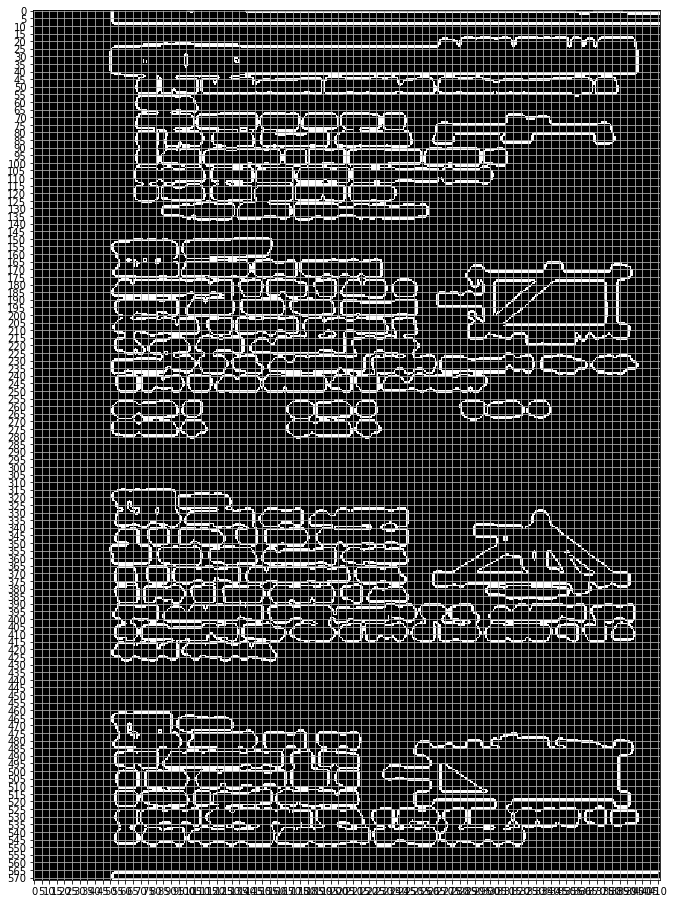

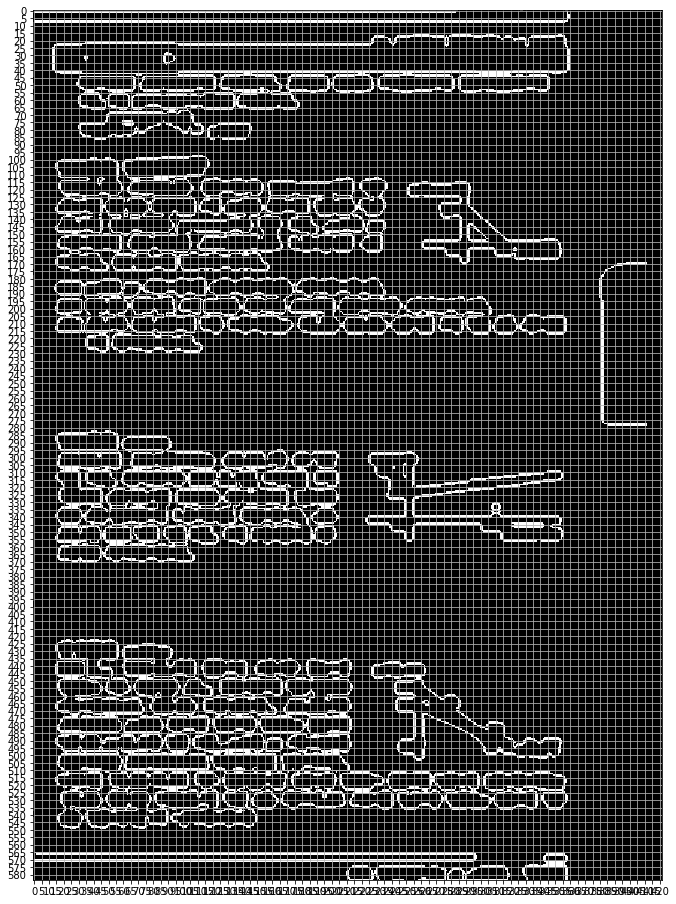

3  Pattern
IMG =  150 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

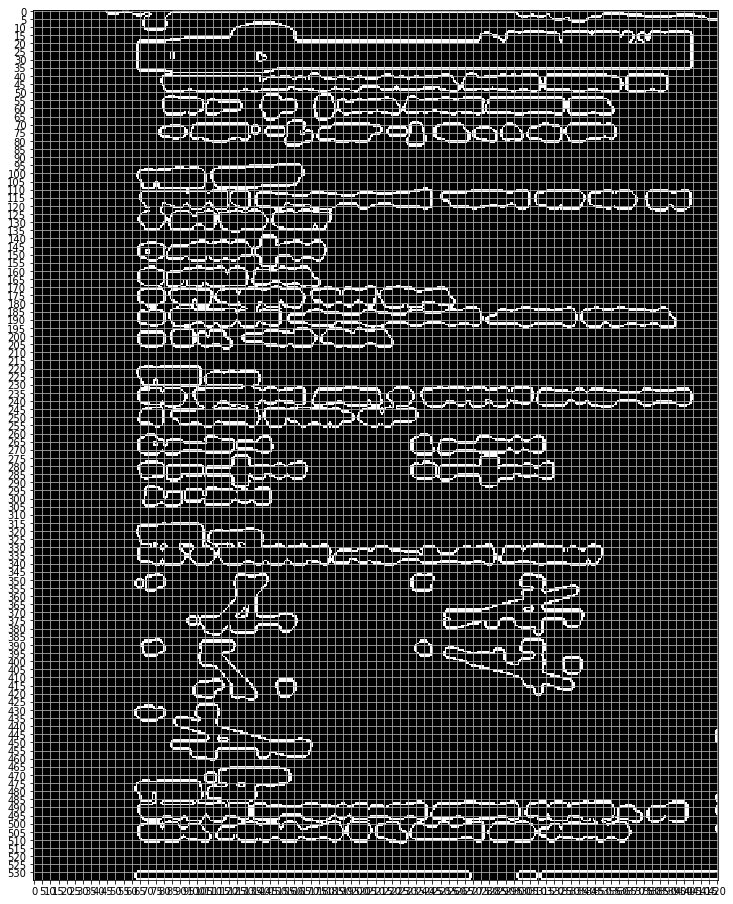

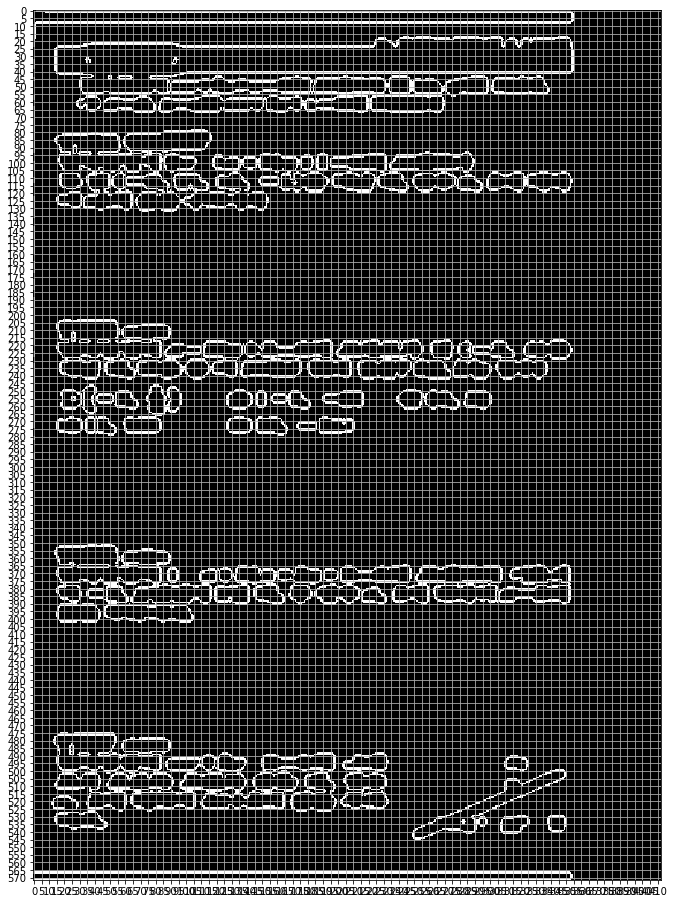

3  Pattern
IMG =  151 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

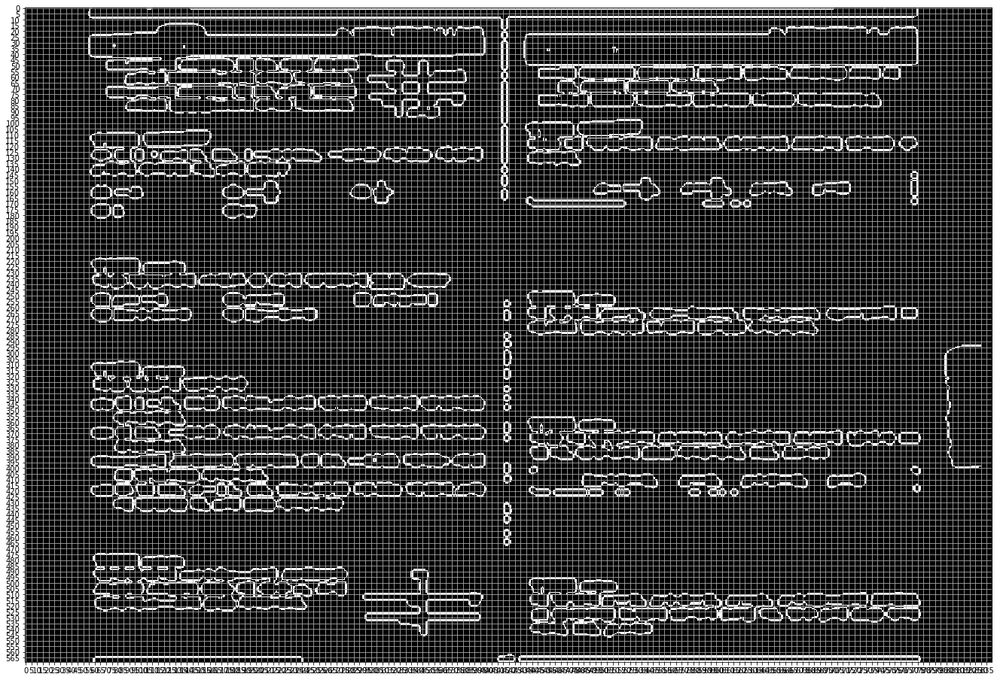

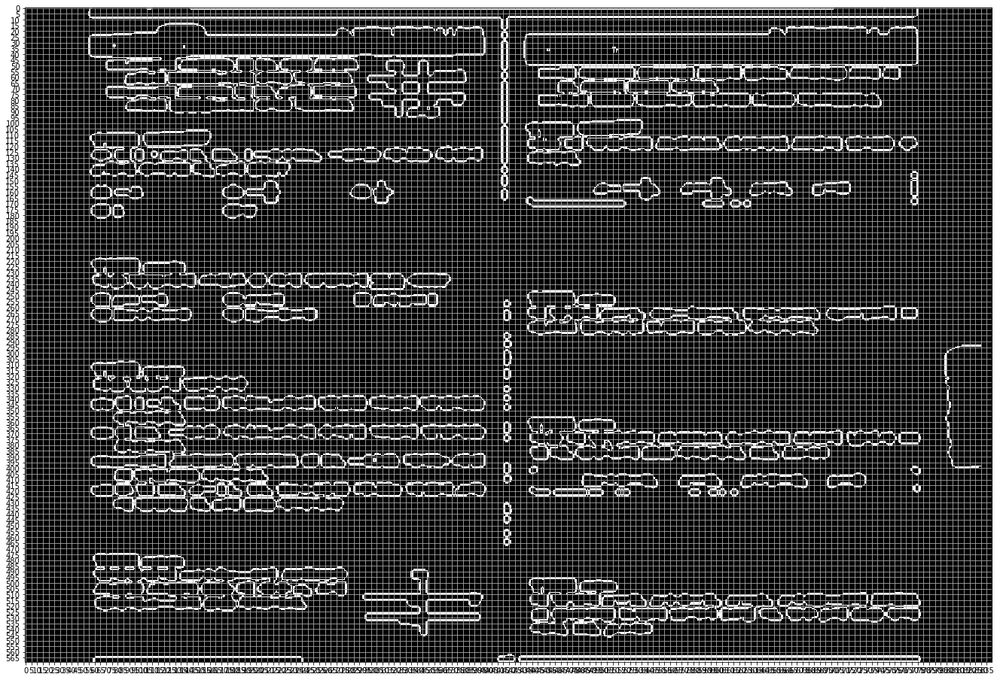

0  Pattern
IMG =  152 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

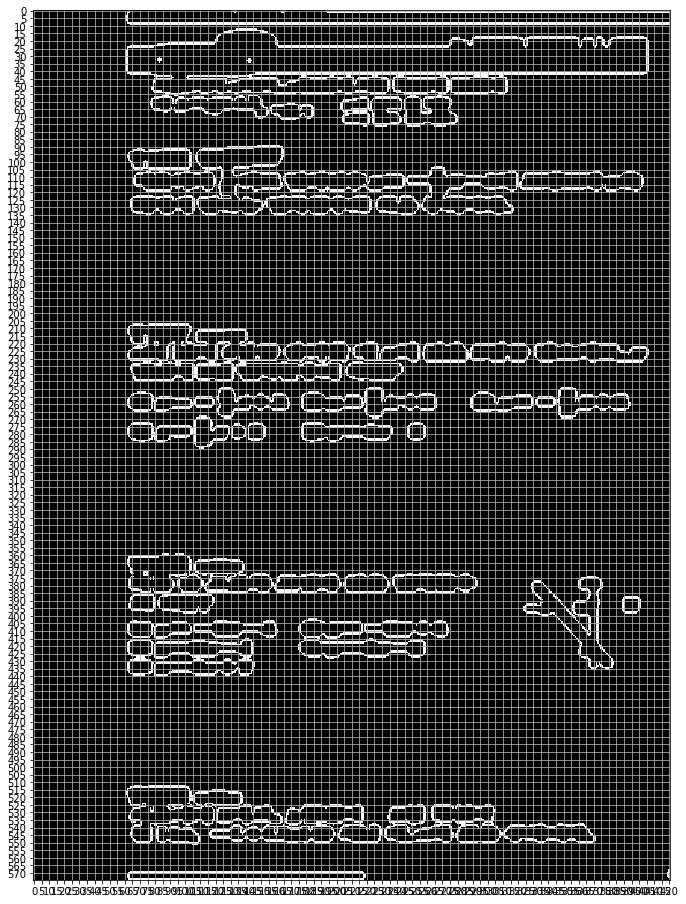

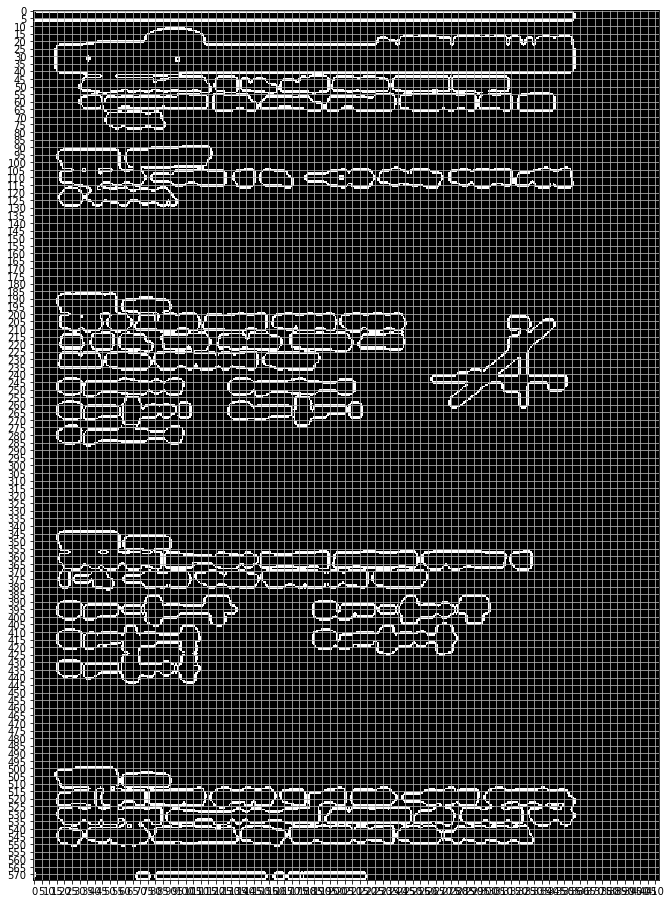

2  Pattern
IMG =  153 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

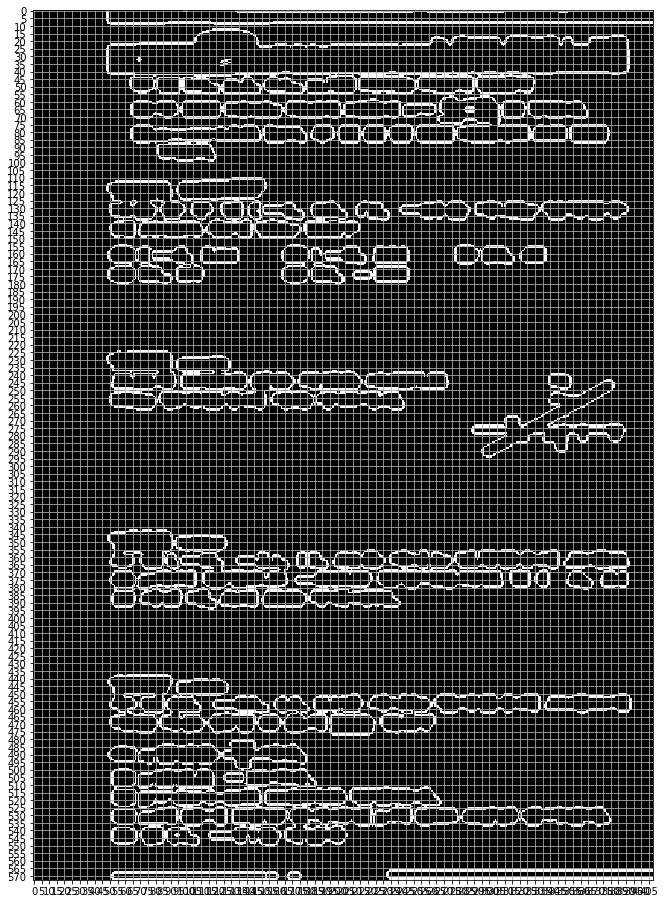

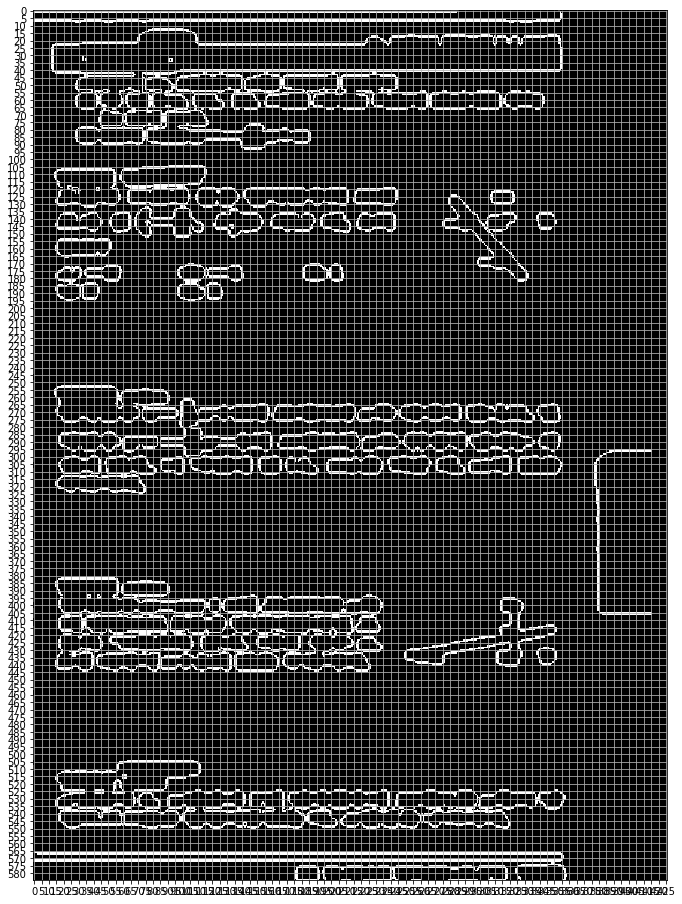

1  Pattern
IMG =  154 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

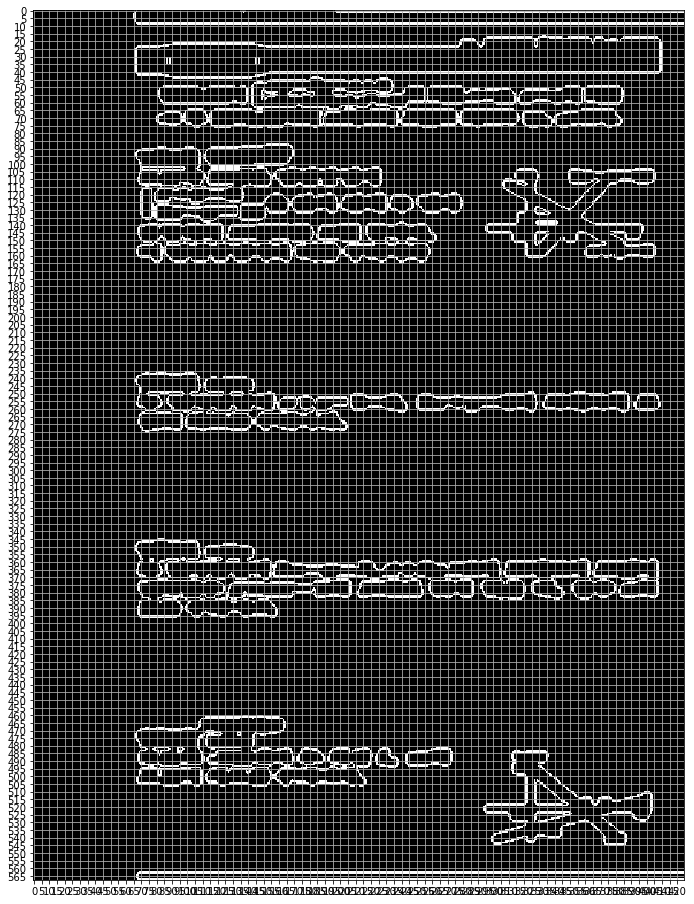

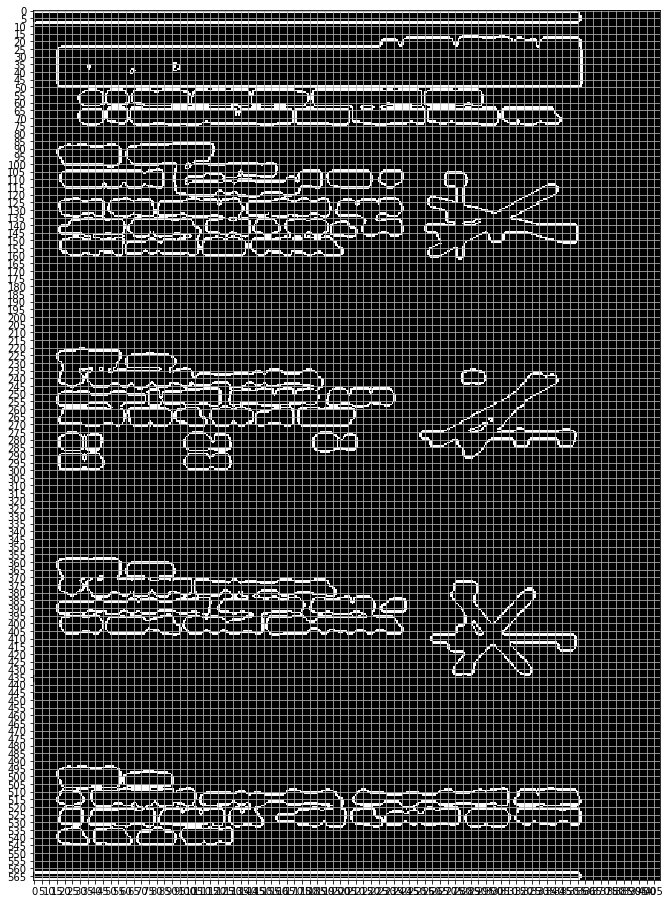

1  Pattern
IMG =  155 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

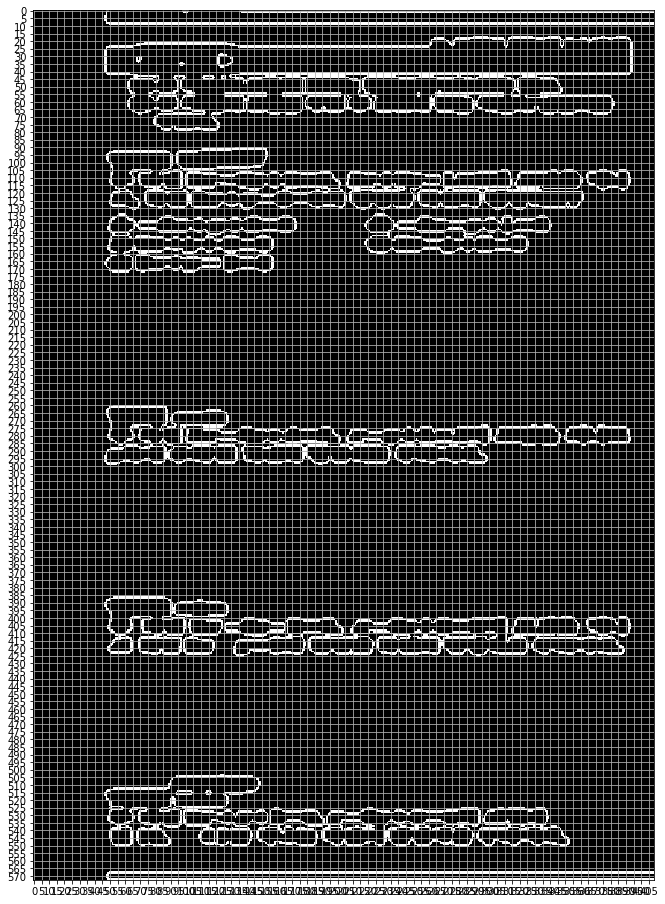

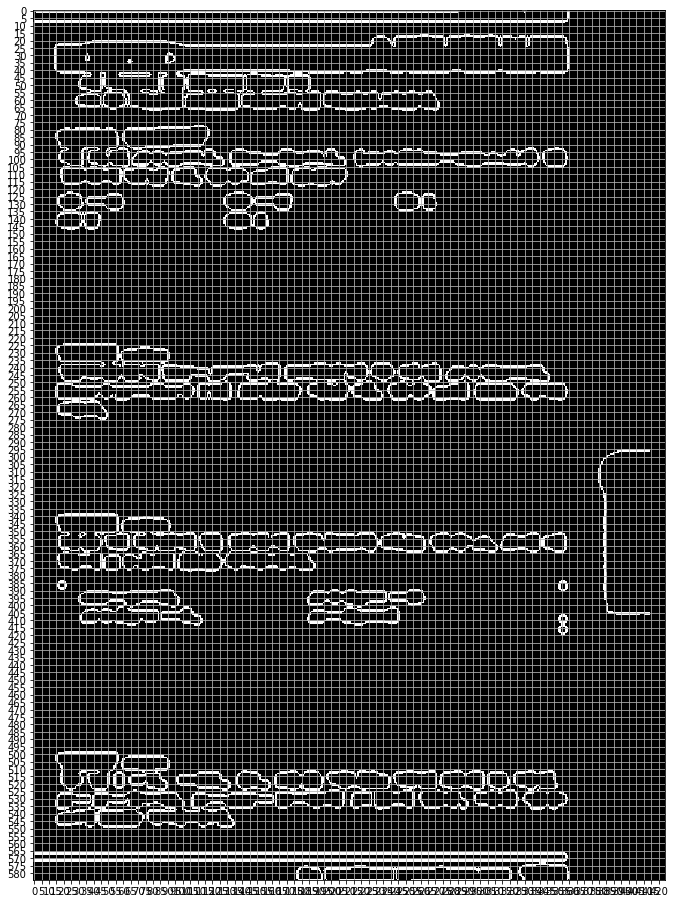

2  Pattern
IMG =  156 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

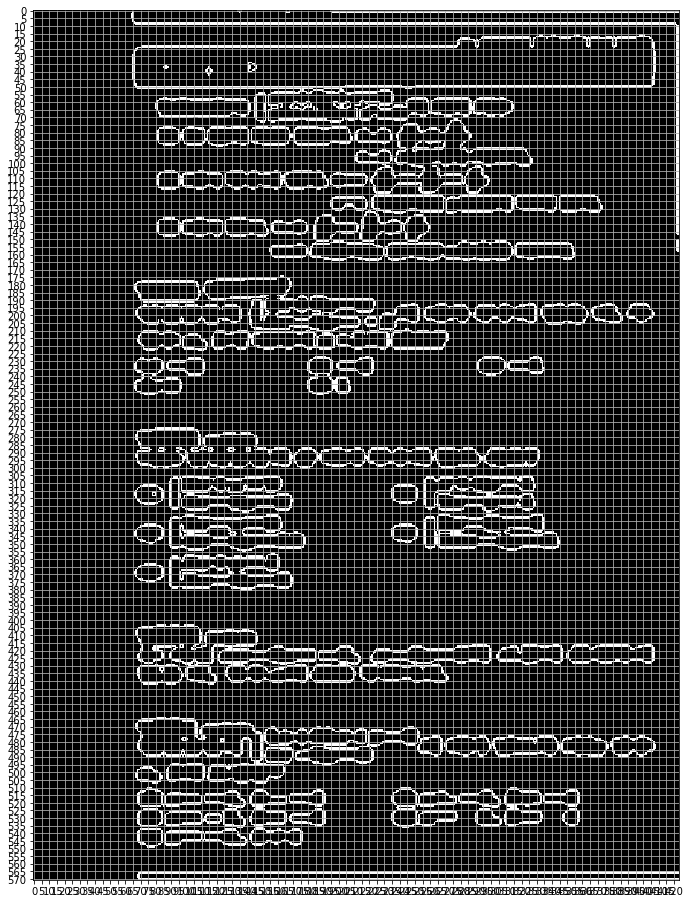

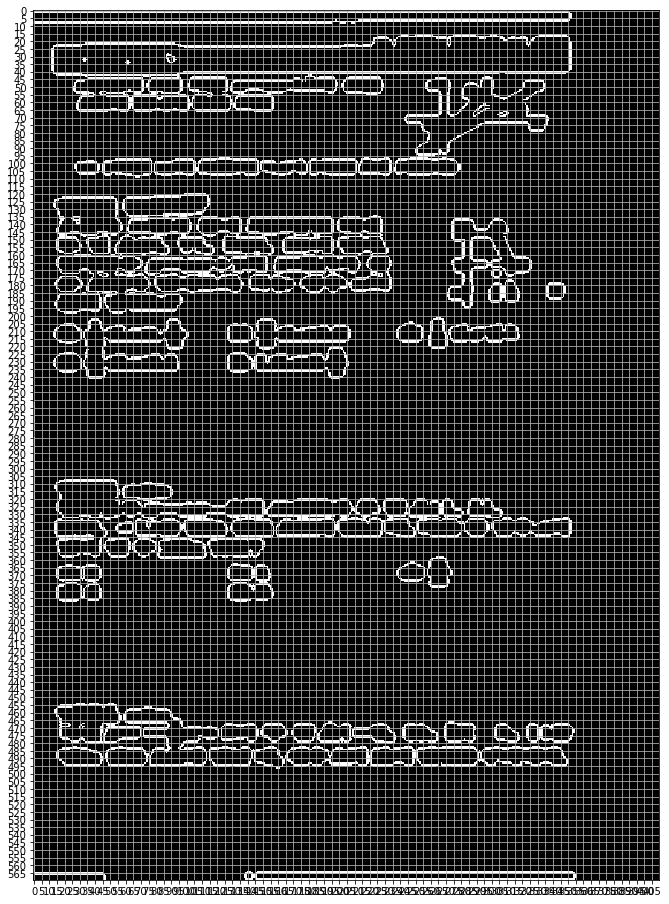

0  Pattern
IMG =  157 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

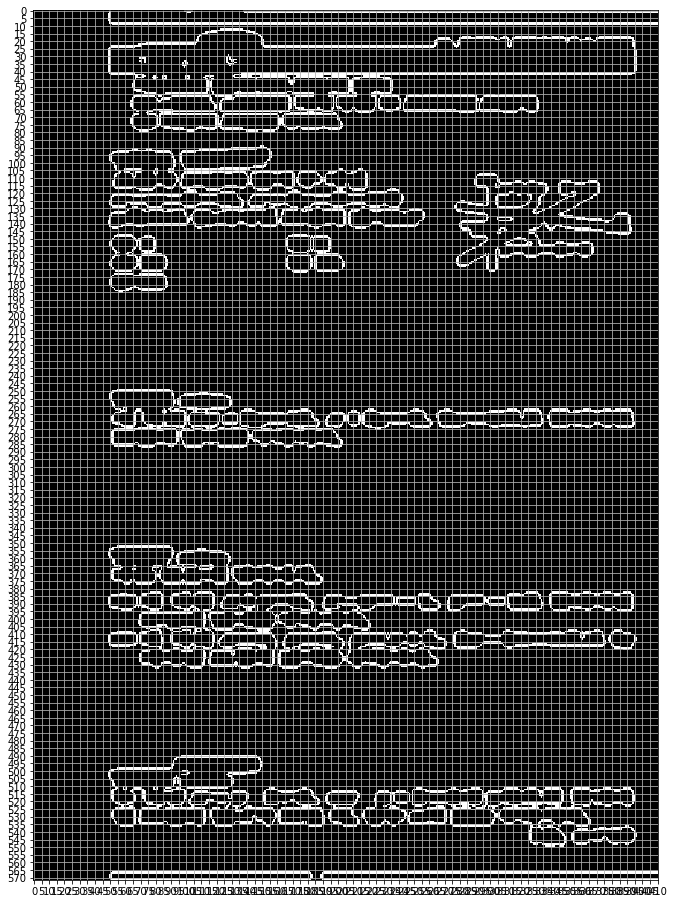

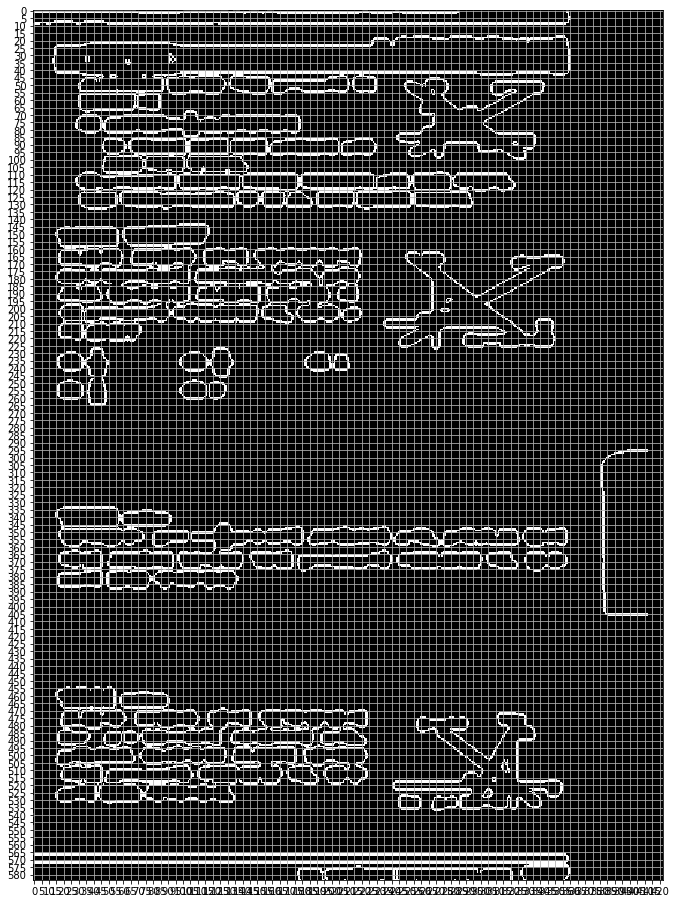

In [15]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

# def denoiseWeakCon(img, y_value):
#     height, width = img.shape
#     upper_img = img[:y_value]
#     upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
#     img[:y_value] = upper_img
#     return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        h, w = self.body.shape
        ticks = [np.arange(0, w, 5), np.arange(0, h, 5)]
        ax.set_xticks(ticks[0])
        ax.set_yticks(ticks[1])
        ax.grid(which='both')
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
#         fig, ax = plt.subplots(figsize=(30, 16))
#         fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
        
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
#         vmap = standardize(vmap)
        
#         ax1.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = removeFirst(vmap)
        vmap = denoiseBoundary(vmap, 5, 10)
        if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

        contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.

#         for n, contour in enumerate(contours):
#             ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
#         ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        img = denoiseBoundary(img, 10, 8)
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()

    thresh_val = threshold_otsu(img)
    img_bin = img > thresh_val
    edges = canny(img_bin, sigma=.5)
    p = Page(edges)
    p.showColumnCont(1,"body")
    p.showColumnCont(2,"body")
#     p.getContour()
    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

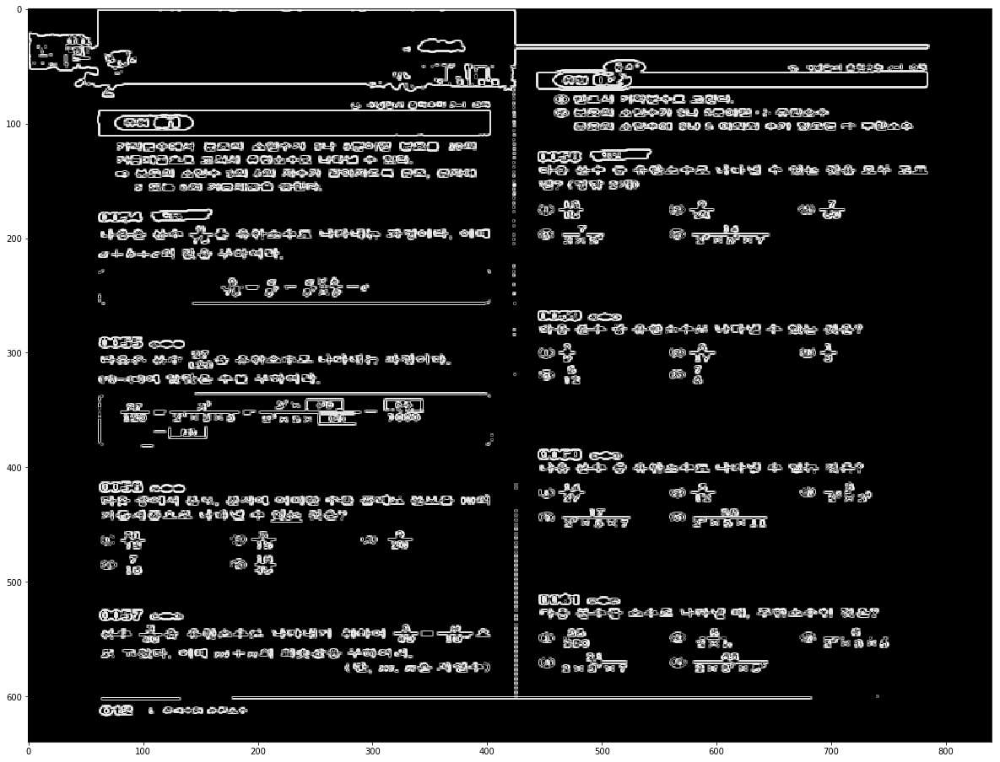

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

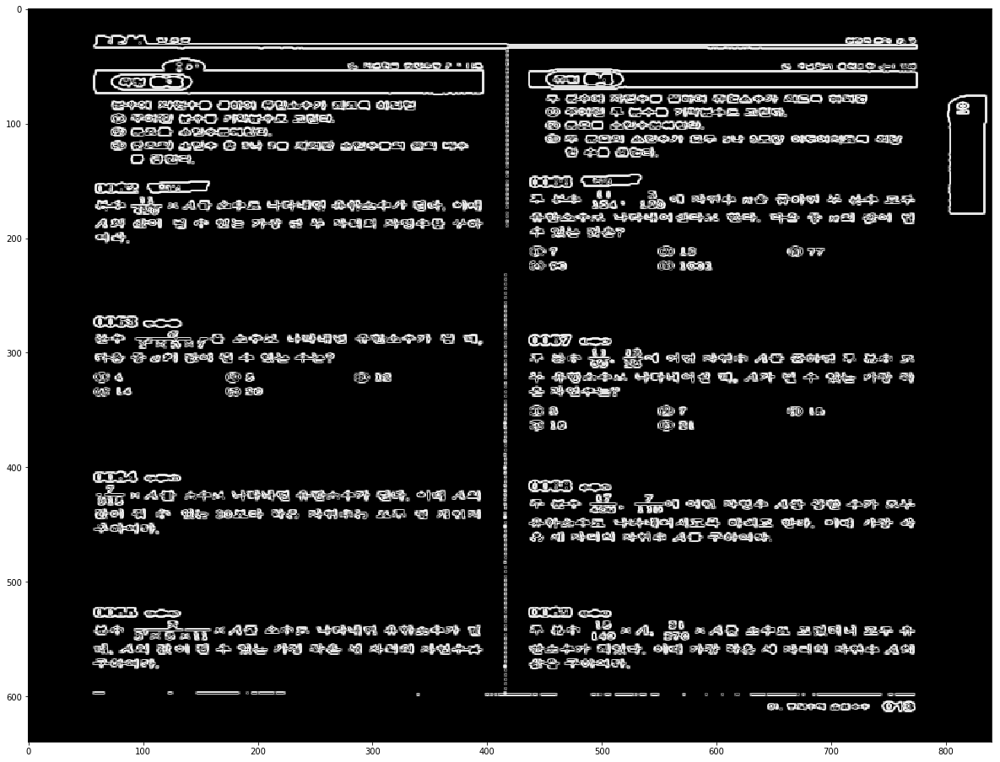

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

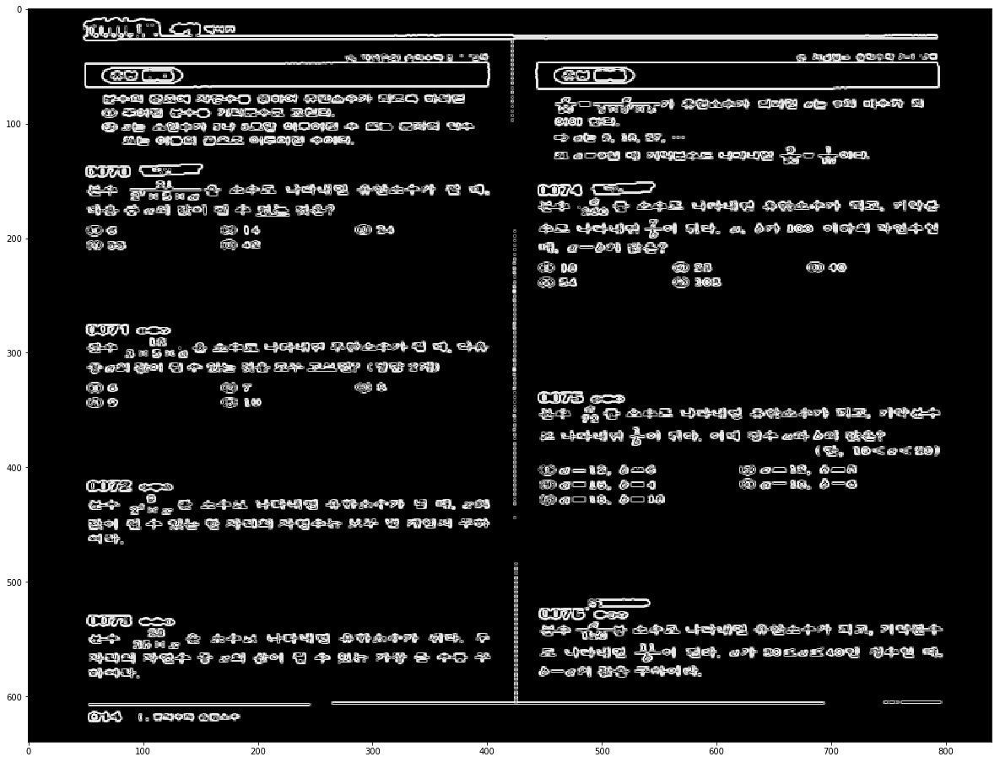

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

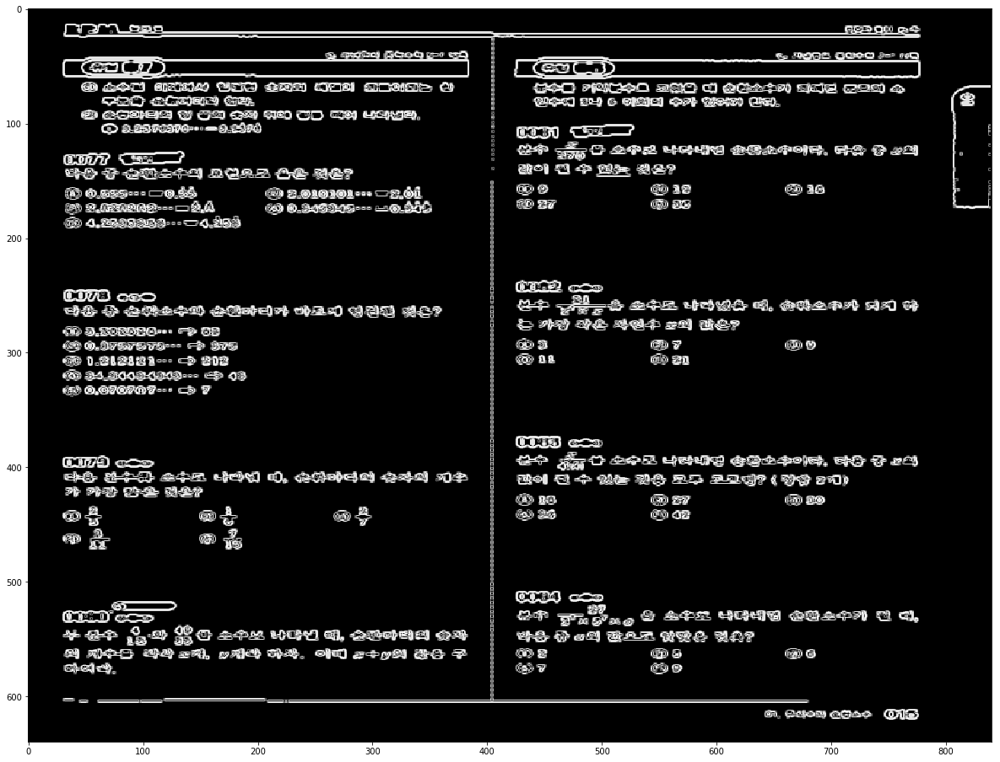

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

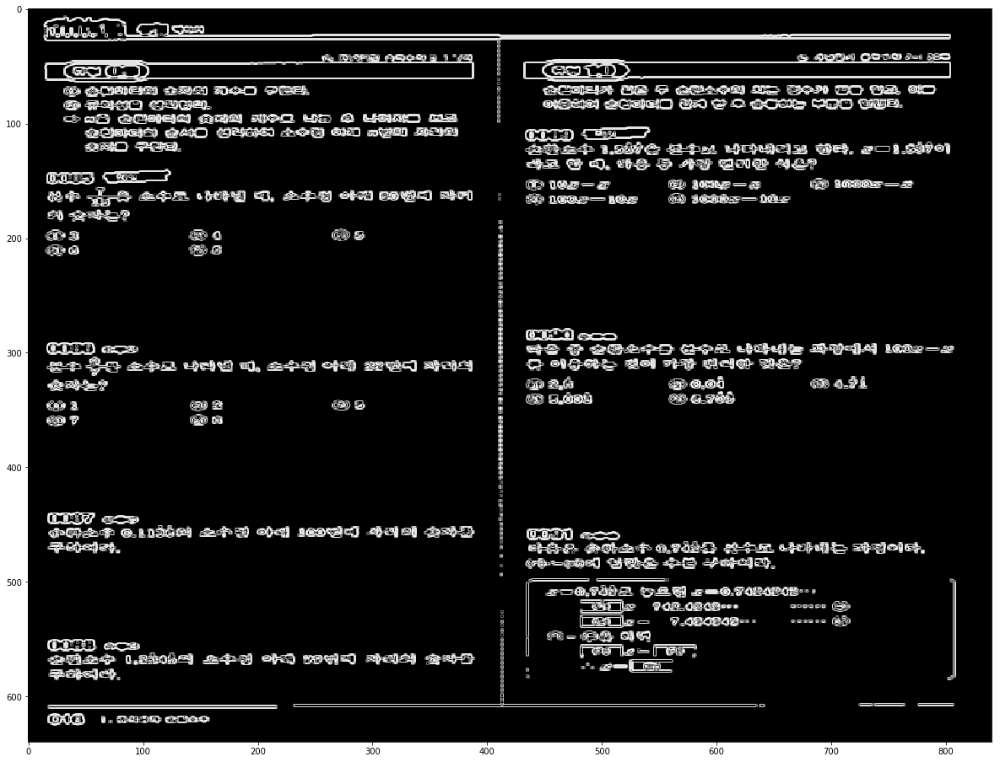

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

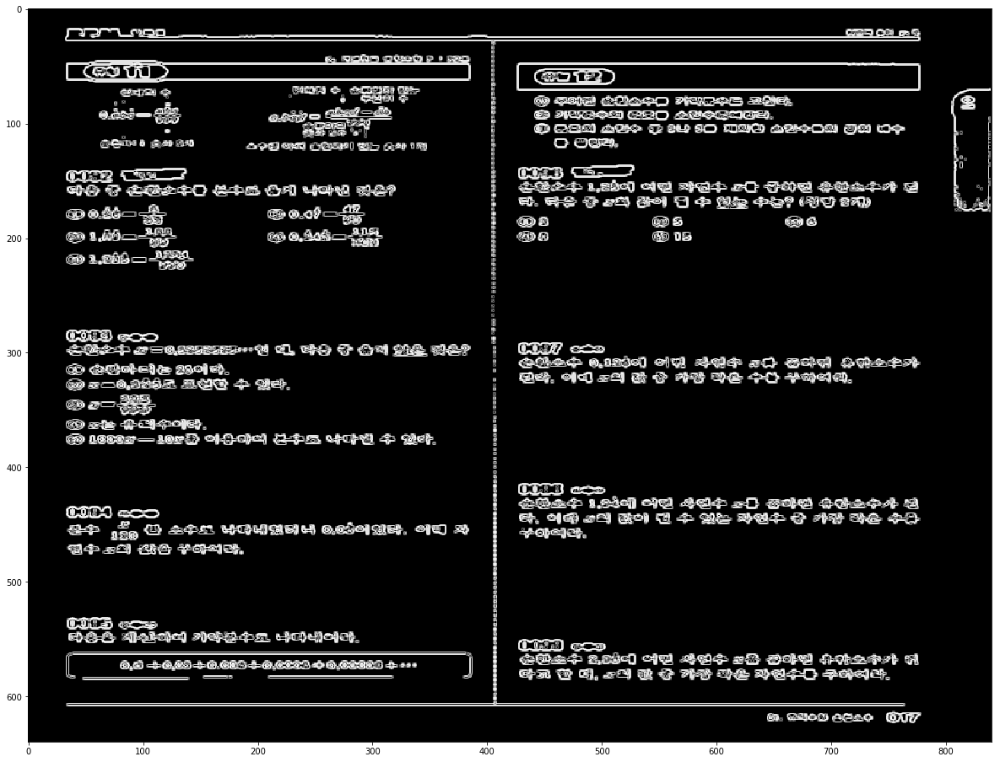

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

KeyboardInterrupt: 

In [33]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt
from skimage.morphology import reconstruction

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

# def denoiseWeakCon(img, y_value):
#     height, width = img.shape
#     upper_img = img[:y_value]
#     upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
#     img[:y_value] = upper_img
#     return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        h, w = self.body.shape
        ticks = [np.arange(0, w, 5), np.arange(0, h, 5)]
        ax.set_xticks(ticks[0])
        ax.set_yticks(ticks[1])
        ax.grid(which='both')
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
#         fig, ax = plt.subplots(figsize=(30, 16))
#         fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        ticks = [np.arange(0, w, 5), np.arange(0, h, 10)]
        ax2.set_xticks(ticks[0])
        ax2.set_yticks(ticks[1])
        ax2.grid(which='both')
        
#         ax1.imshow(filled, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
        
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
#         vmap = standardize(vmap)
        
#         vmap = removeFirst(vmap)
#         vmap = denoiseBoundary(vmap, 5, 10)
#         if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
#         if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

#         contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.
#         for n, contour in enumerate(contours):
#             ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
#         ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        img = denoiseBoundary(img, 10, 8)
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()
    
    fig, ax = plt.subplots(figsize=(30, 16))
    
    thresh_val = threshold_otsu(img)
    img_bin = img > thresh_val
    
    ax.imshow(img_bin, interpolation='nearest', cmap=plt.cm.gray)
#     edges = canny(img_bin, sigma=.5)
#     p = Page(edges)
#     p.showColumnCont(1,"body")
#     p.showColumnCont(2,"body")
#     p.getContour()
    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

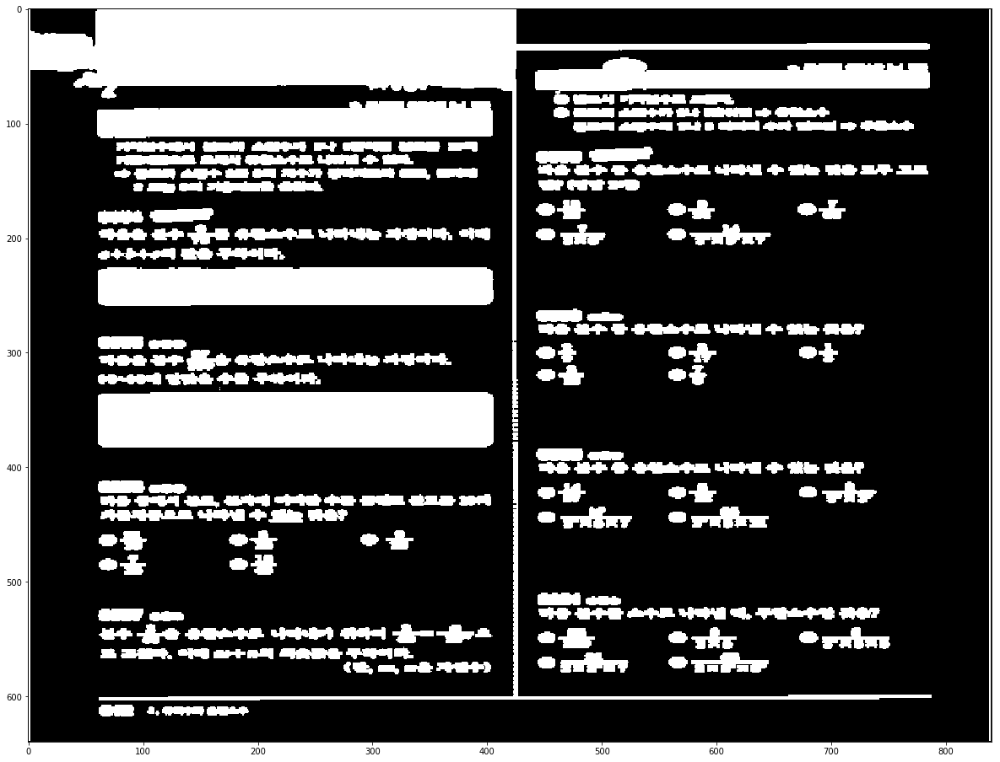

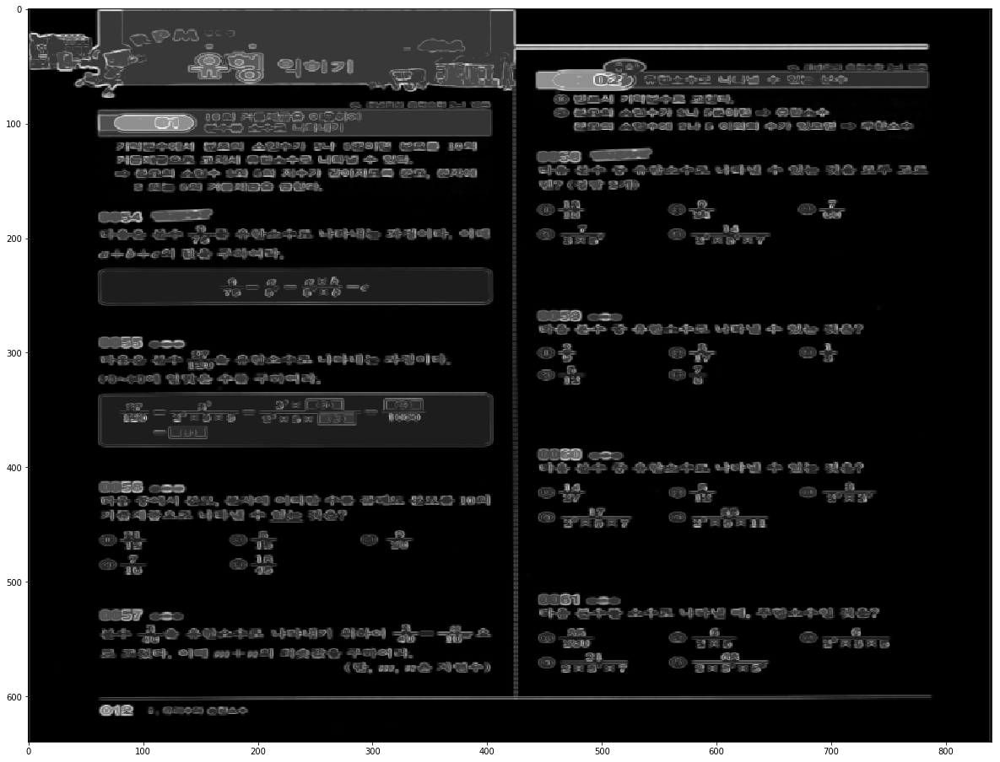

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

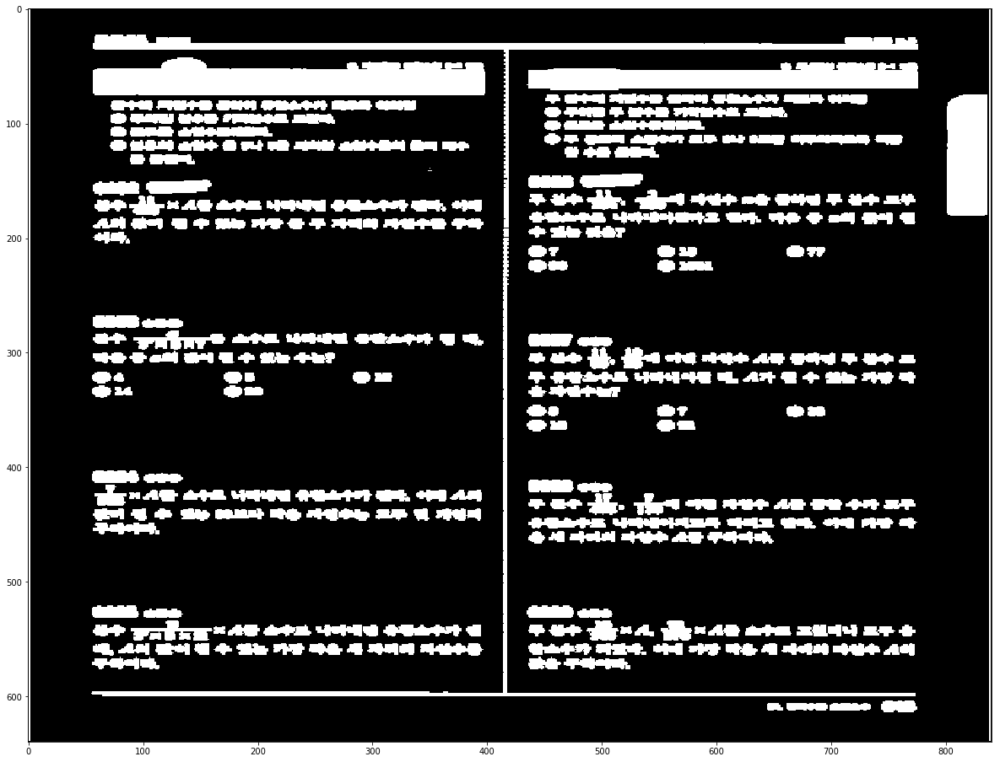

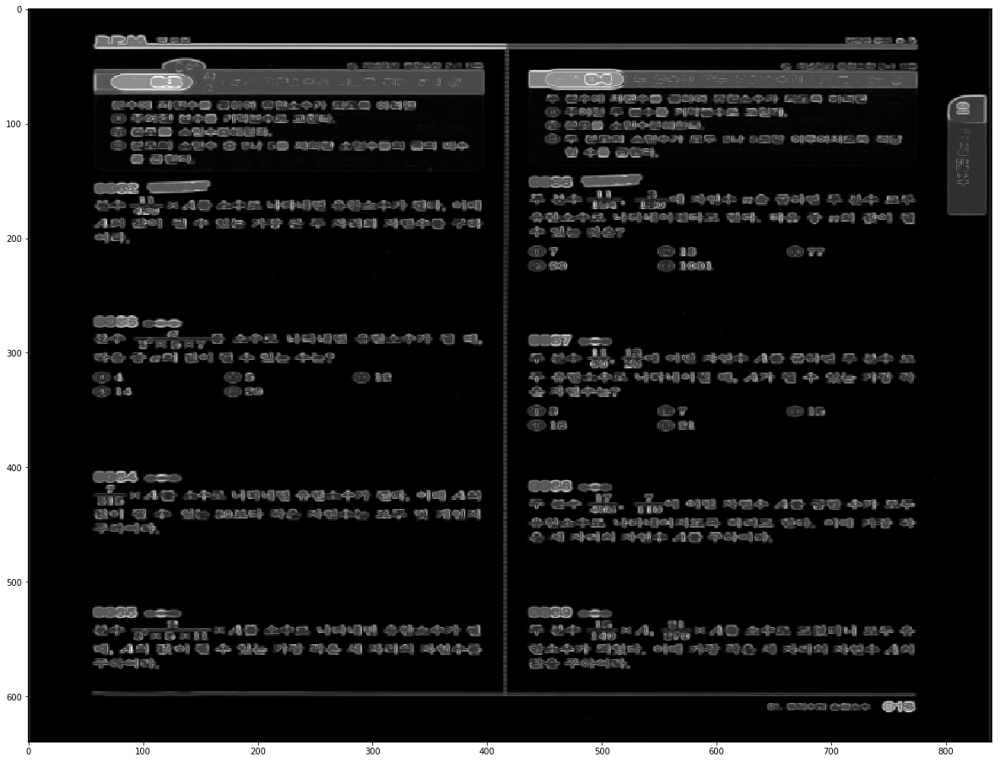

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

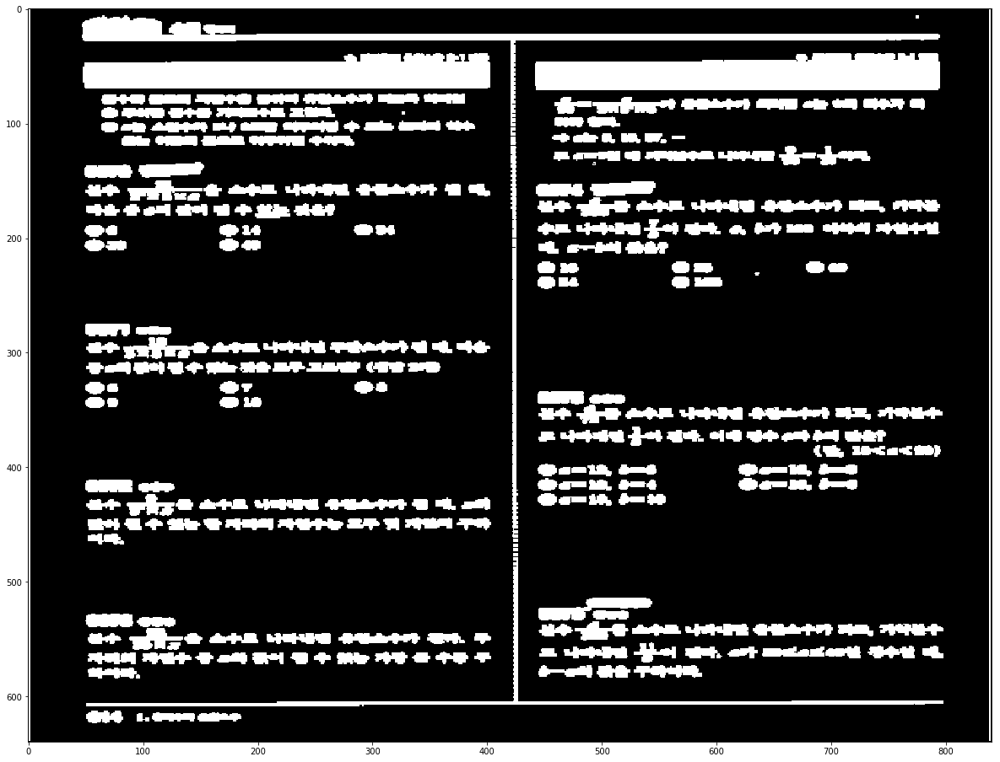

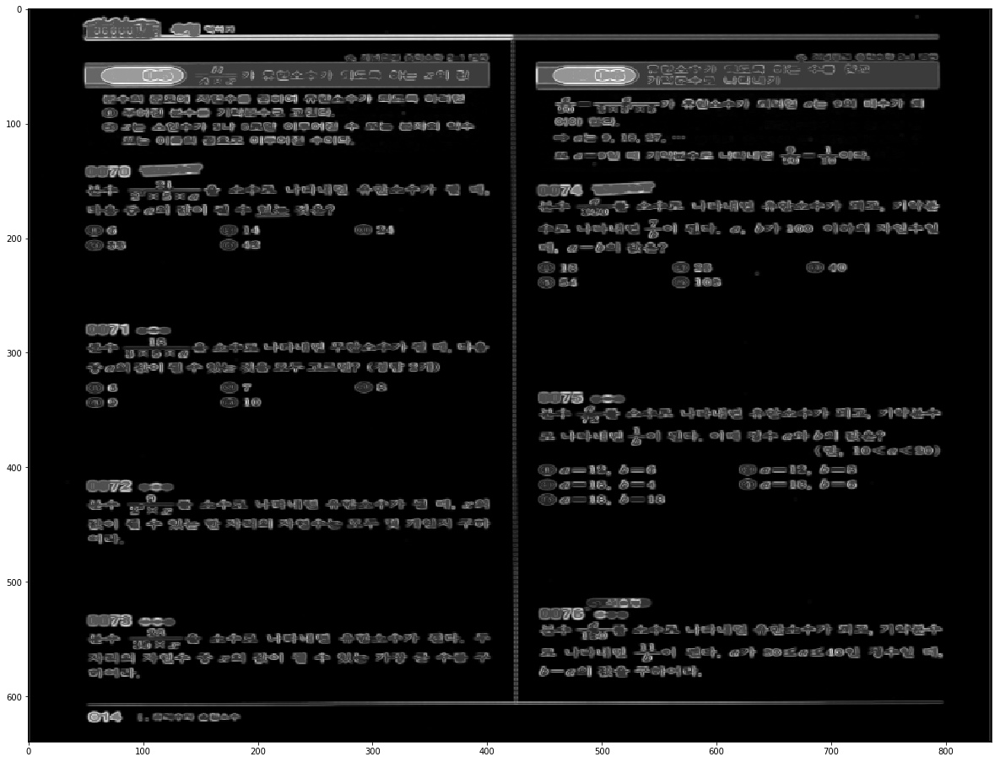

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

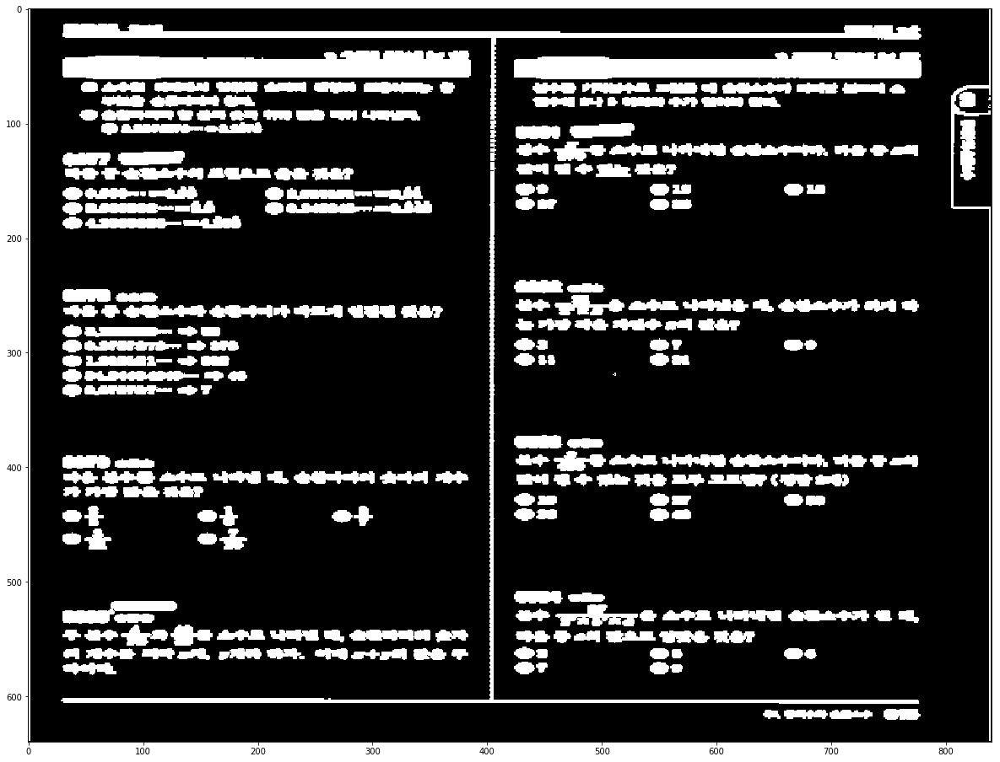

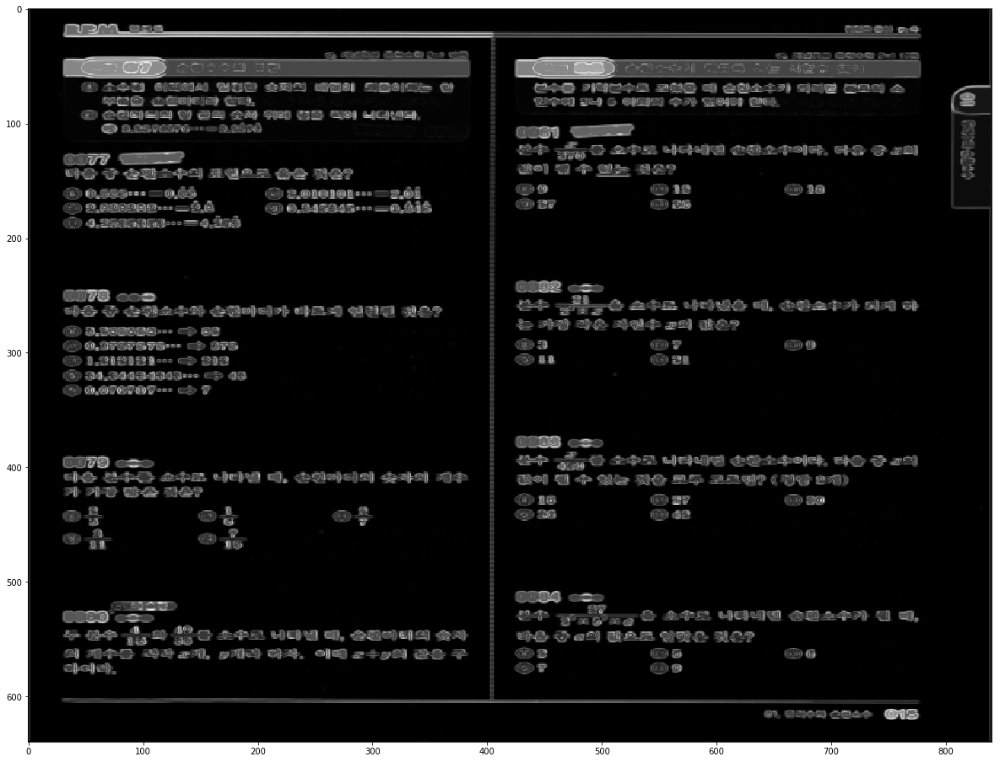

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

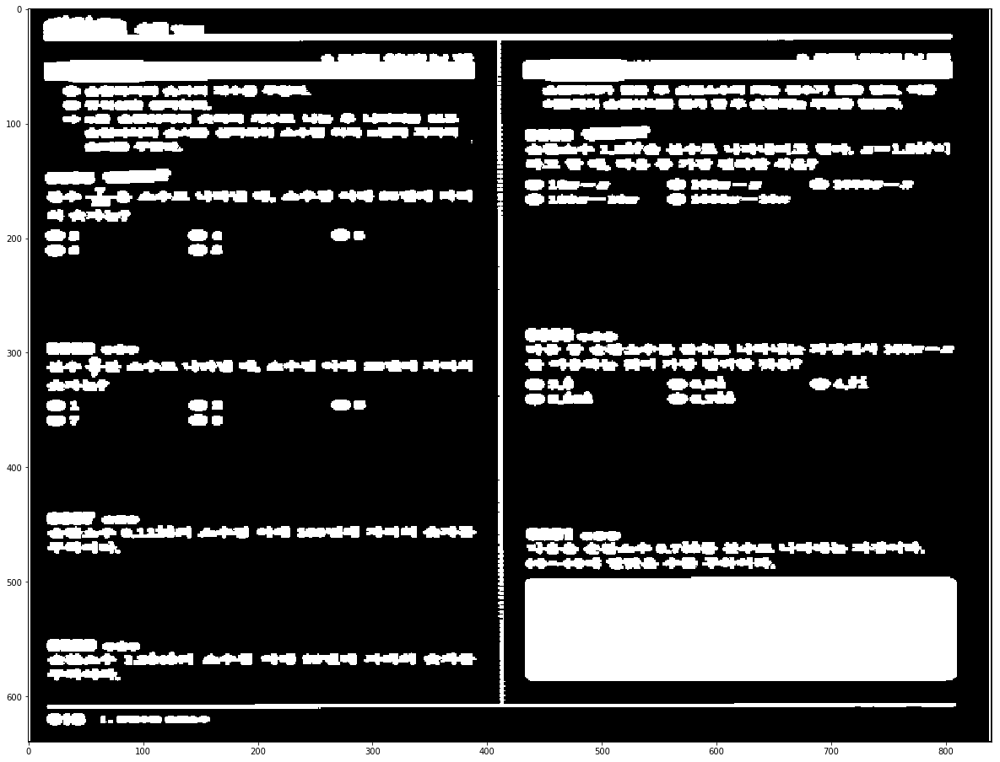

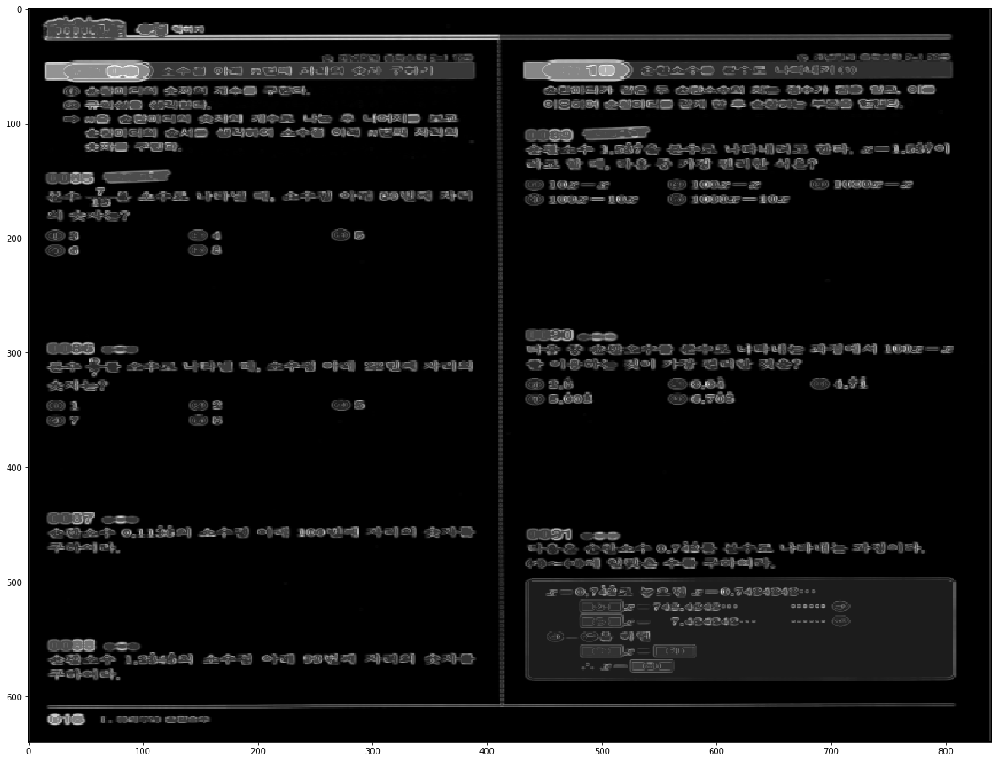

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

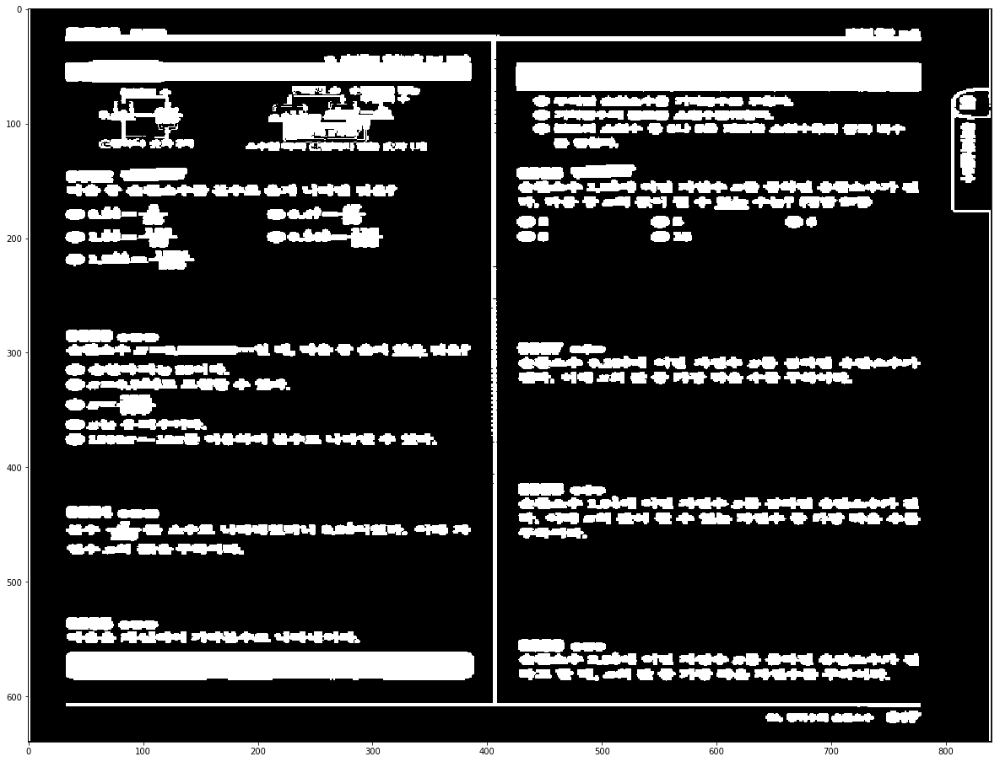

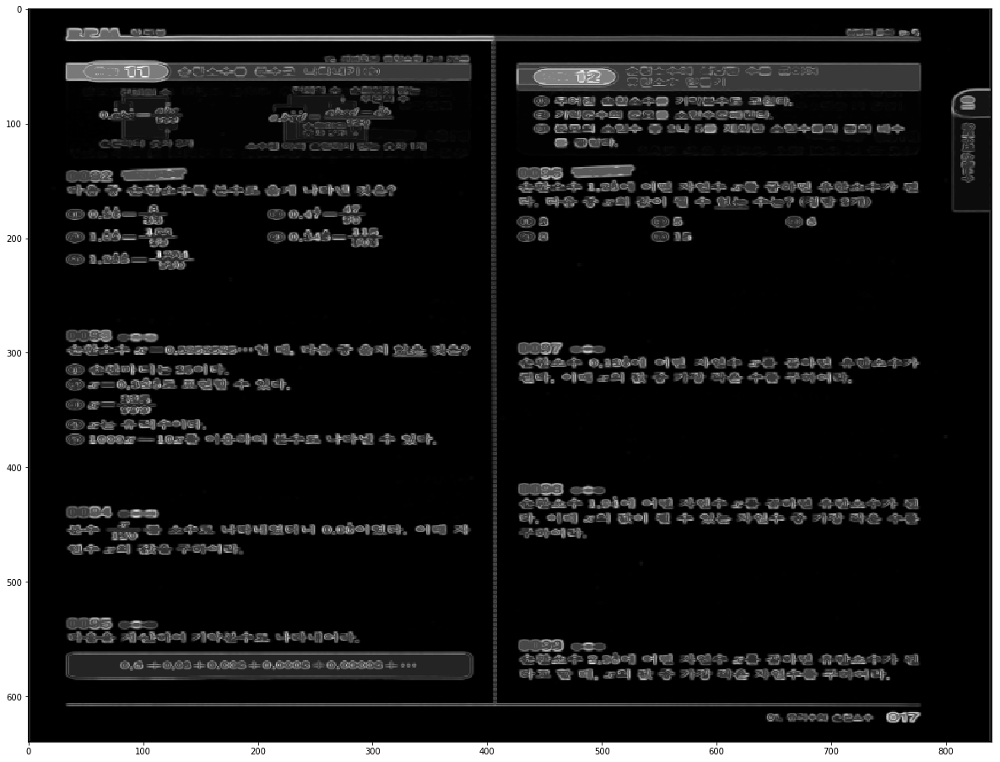

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

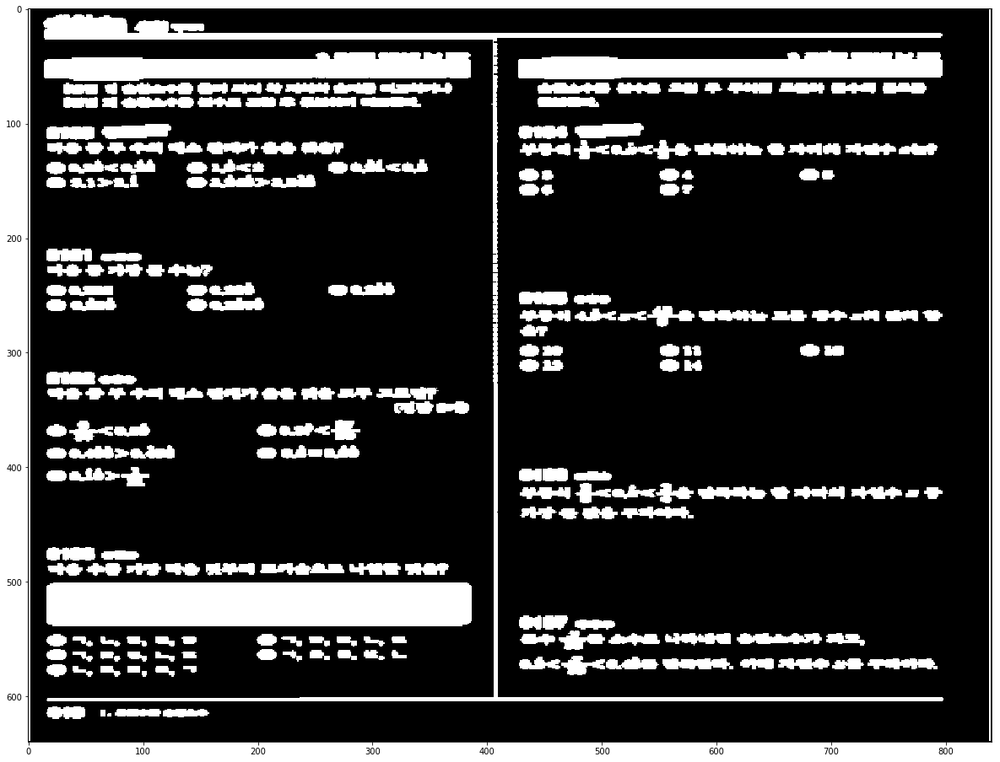

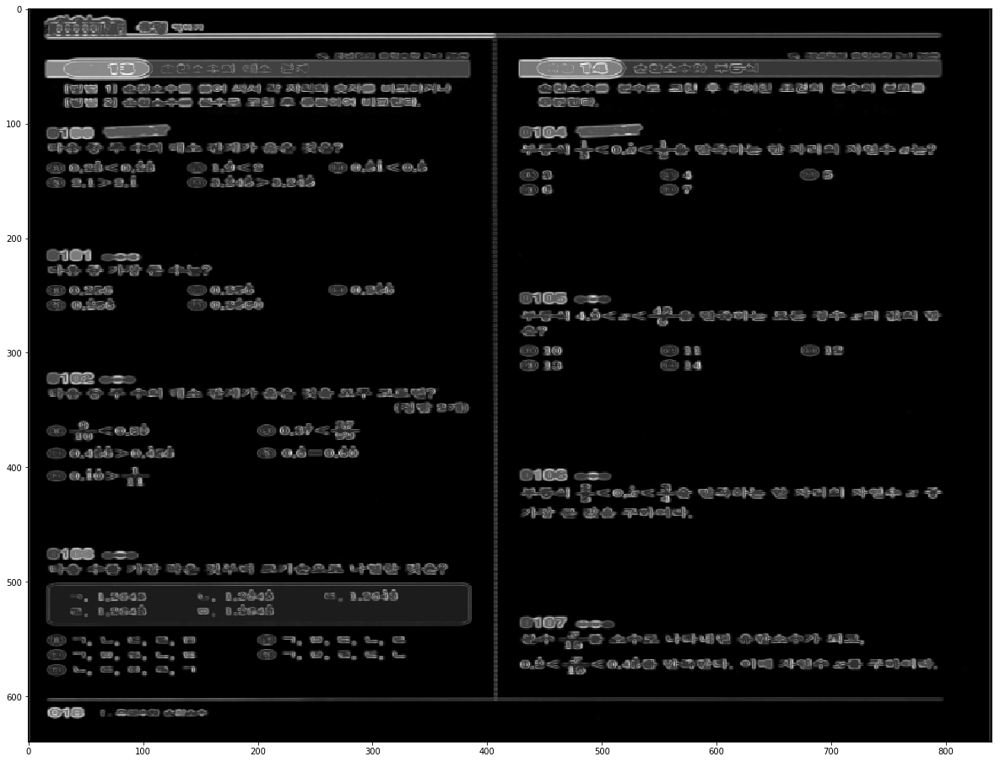

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

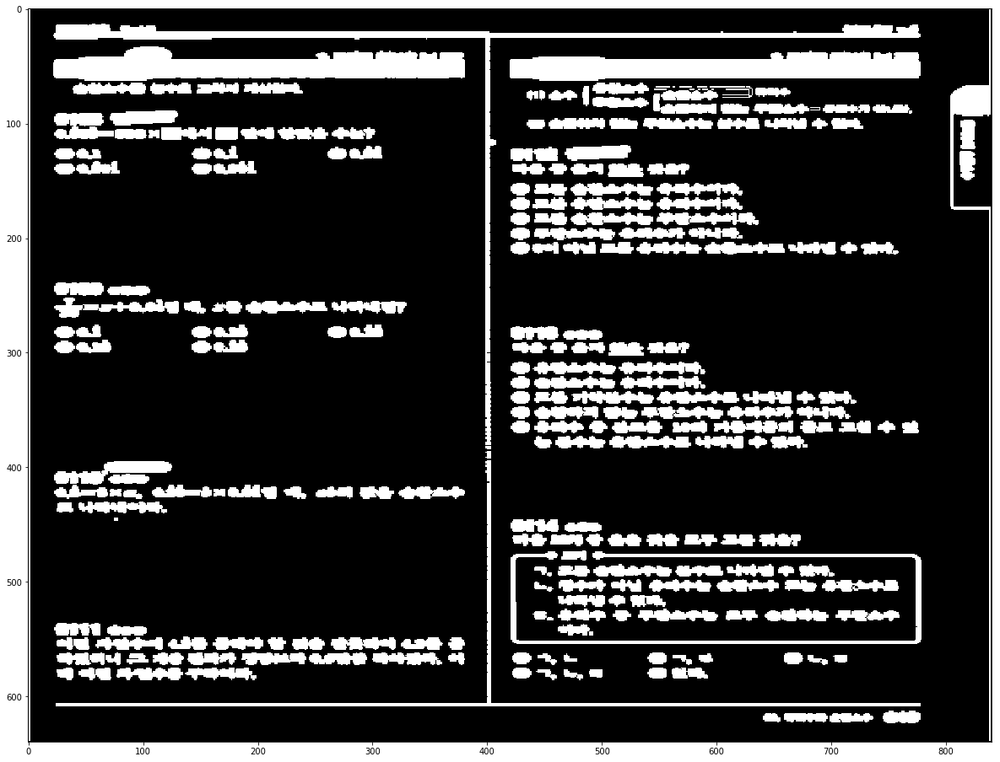

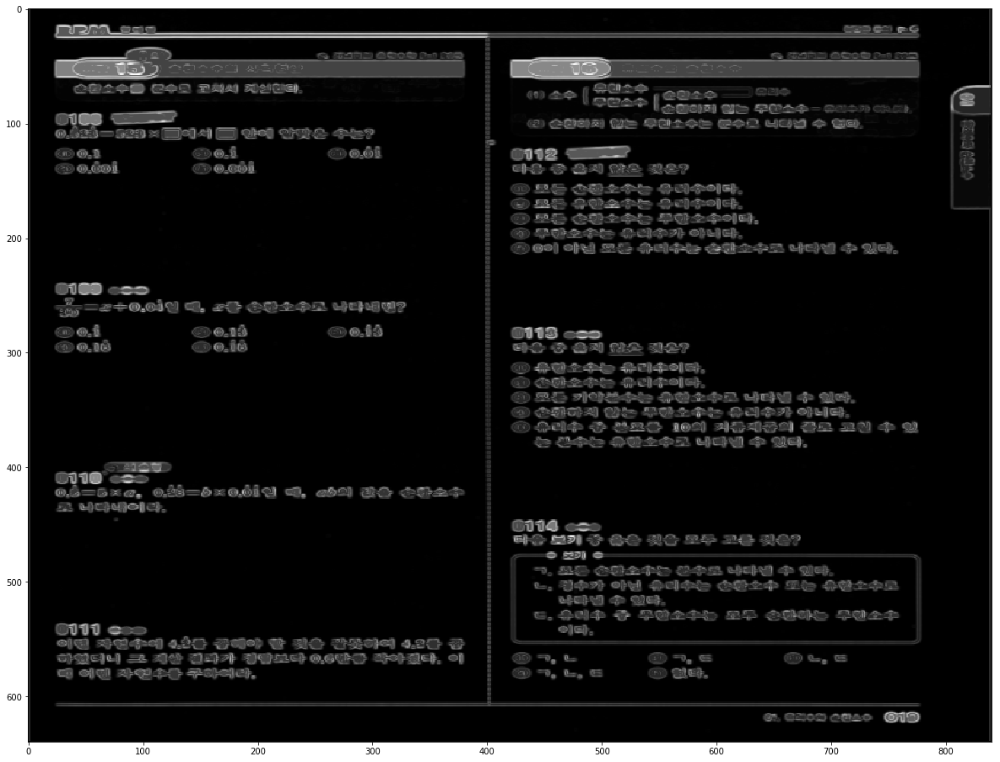

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

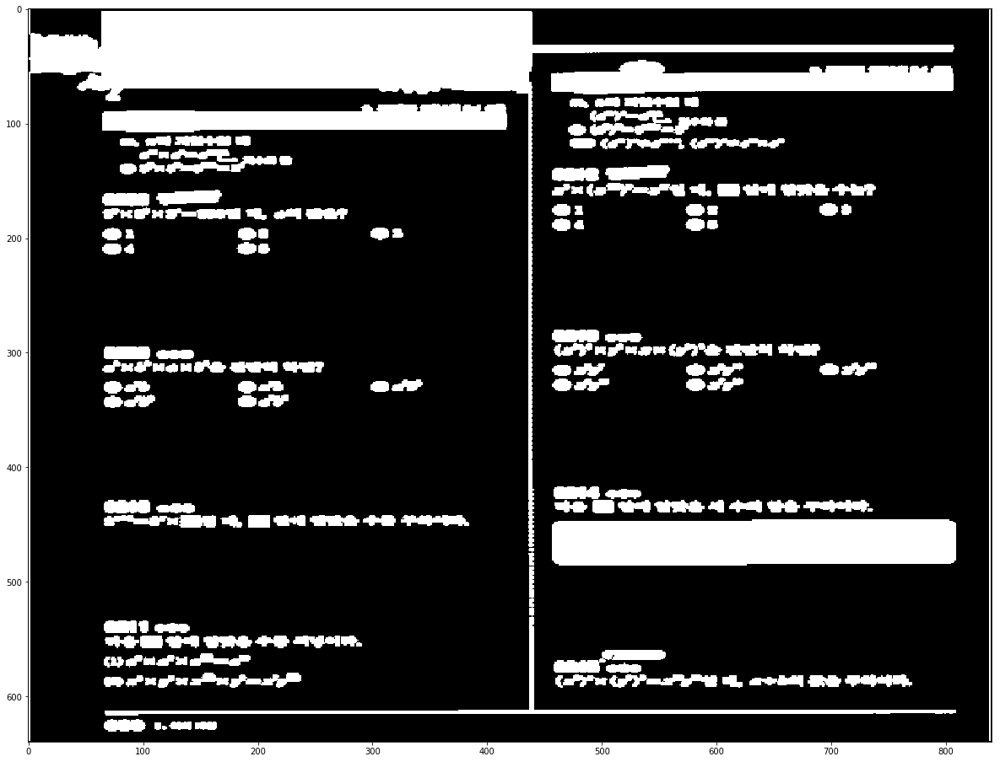

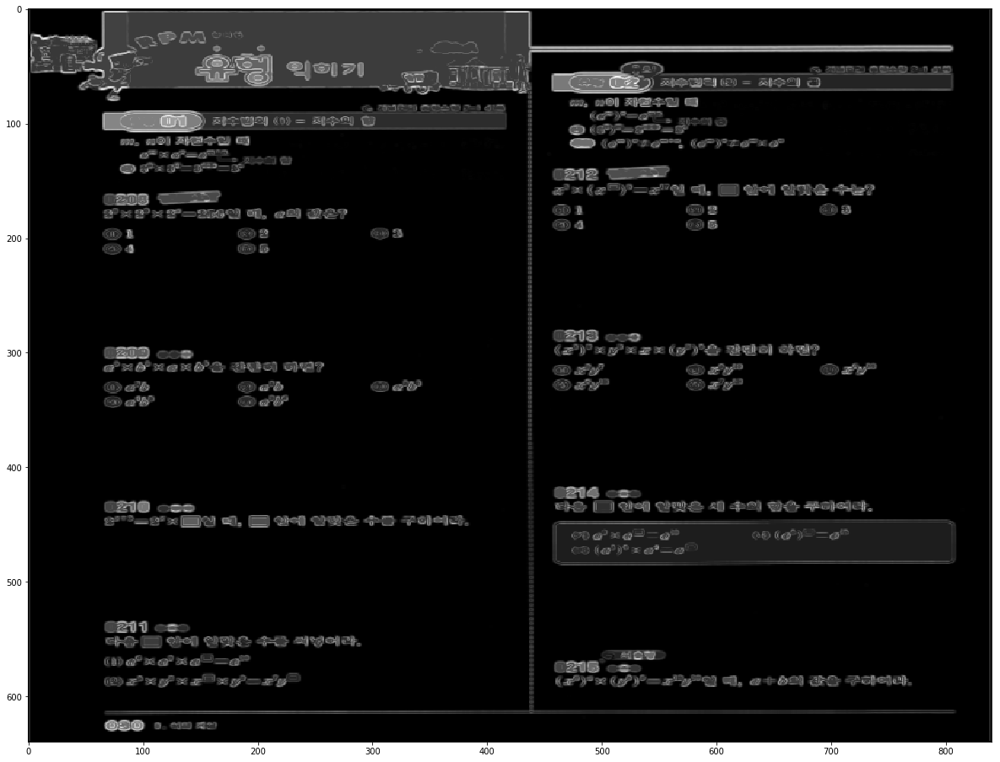

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

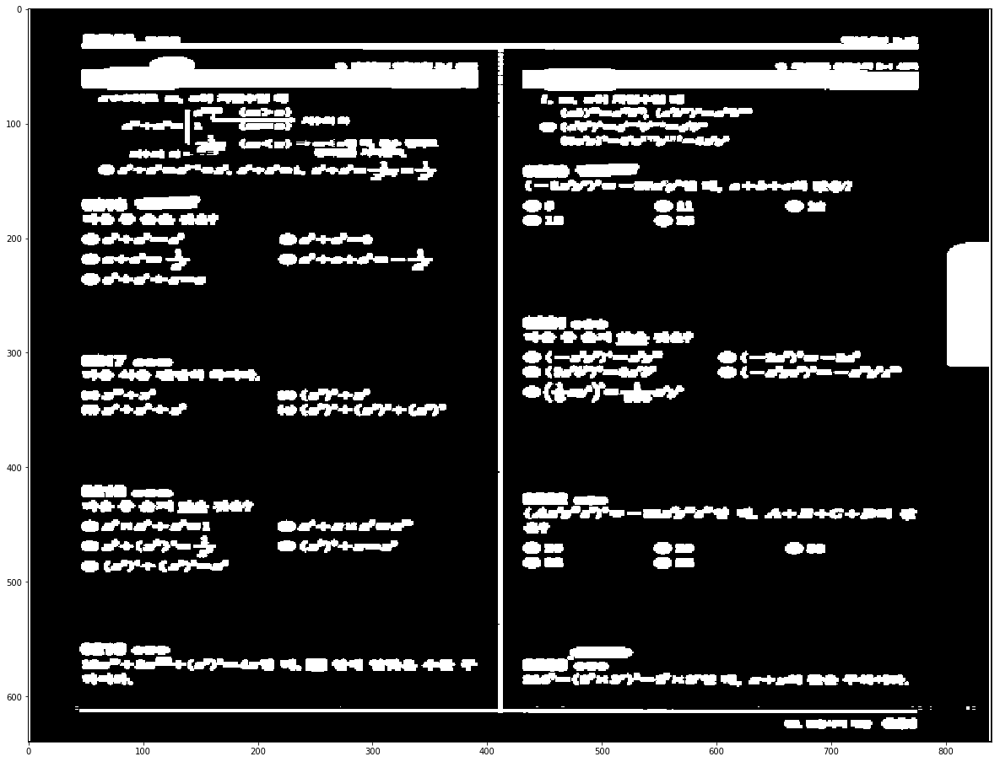

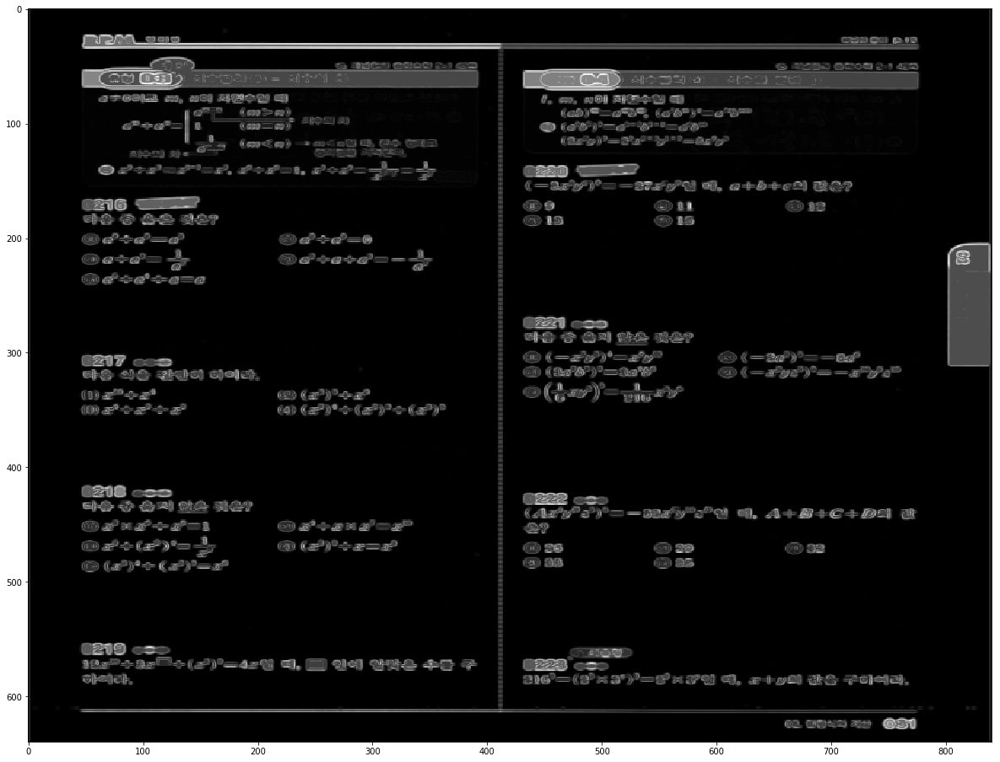

0  Pattern
IMG =  032 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

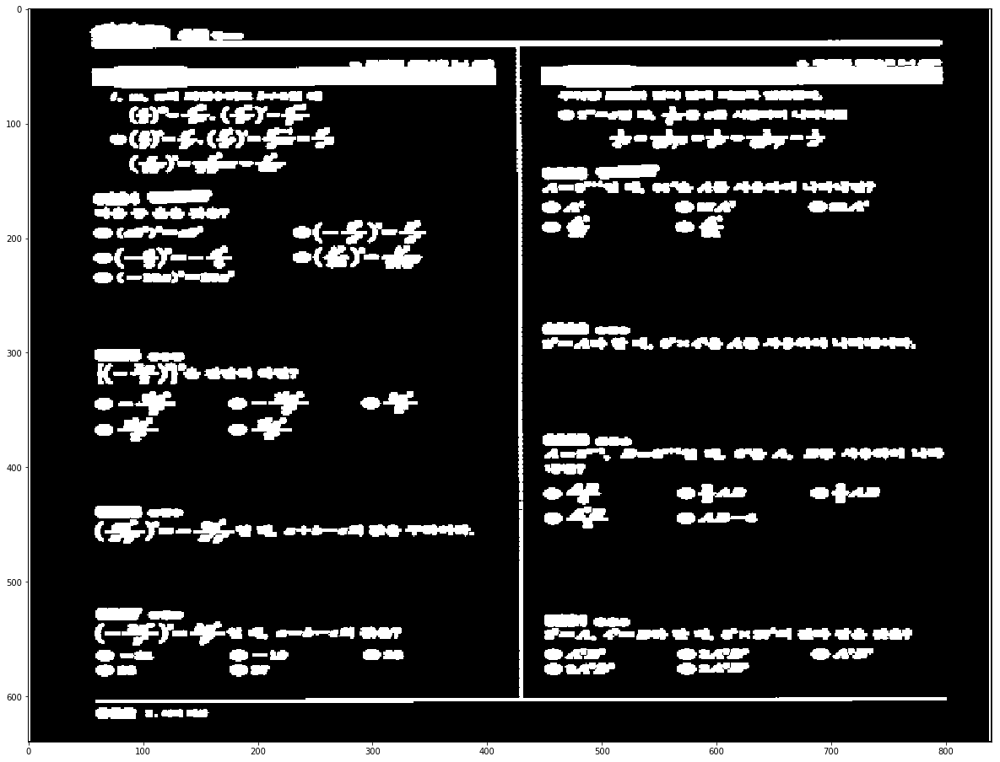

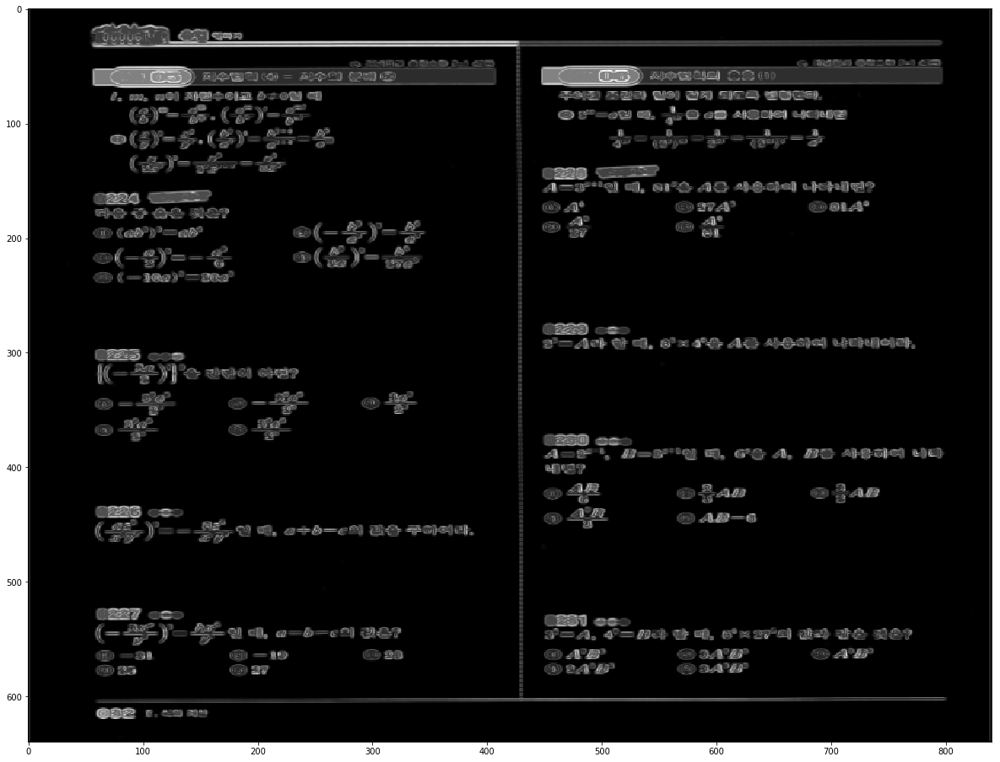

3  Pattern
IMG =  033 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

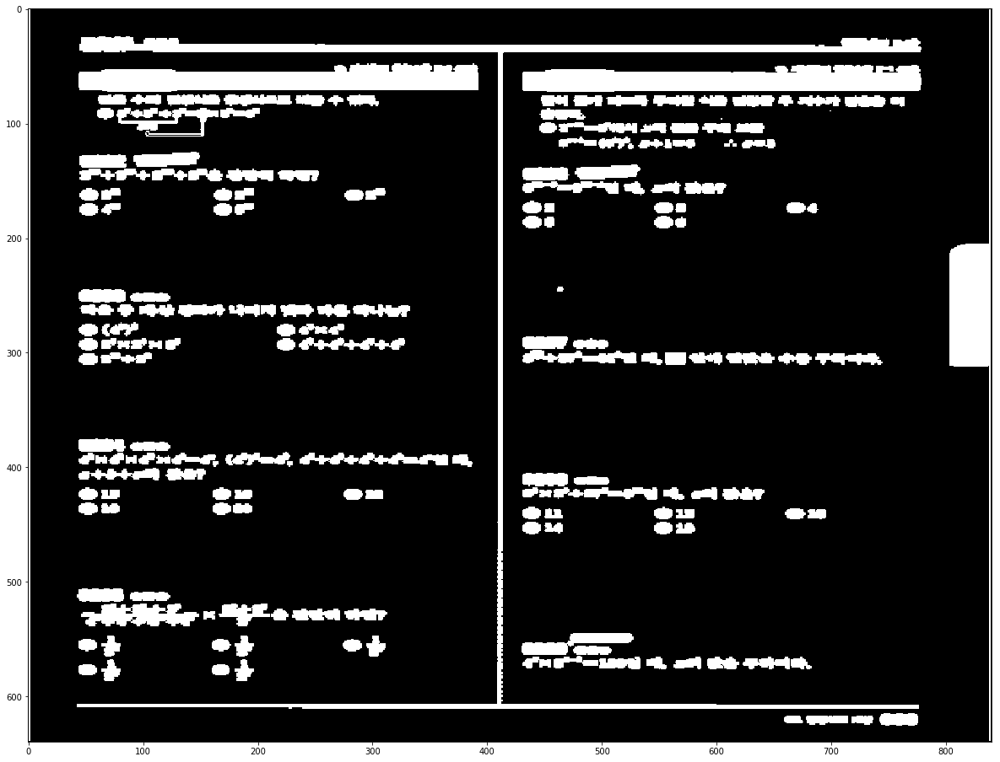

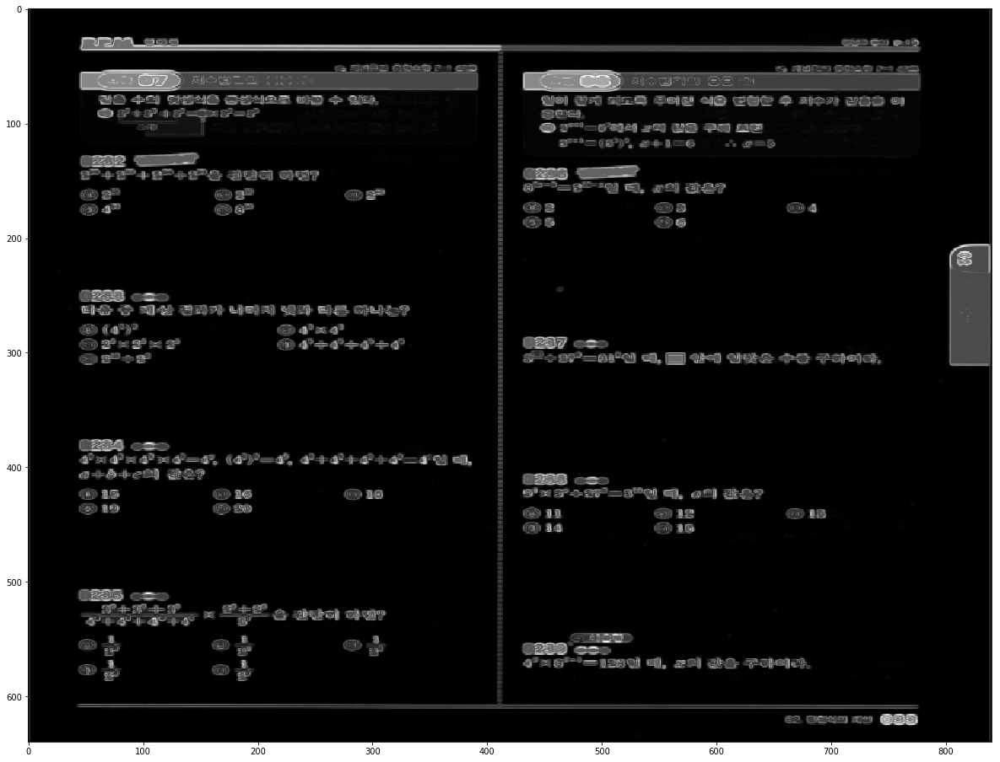

3  Pattern
IMG =  034 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

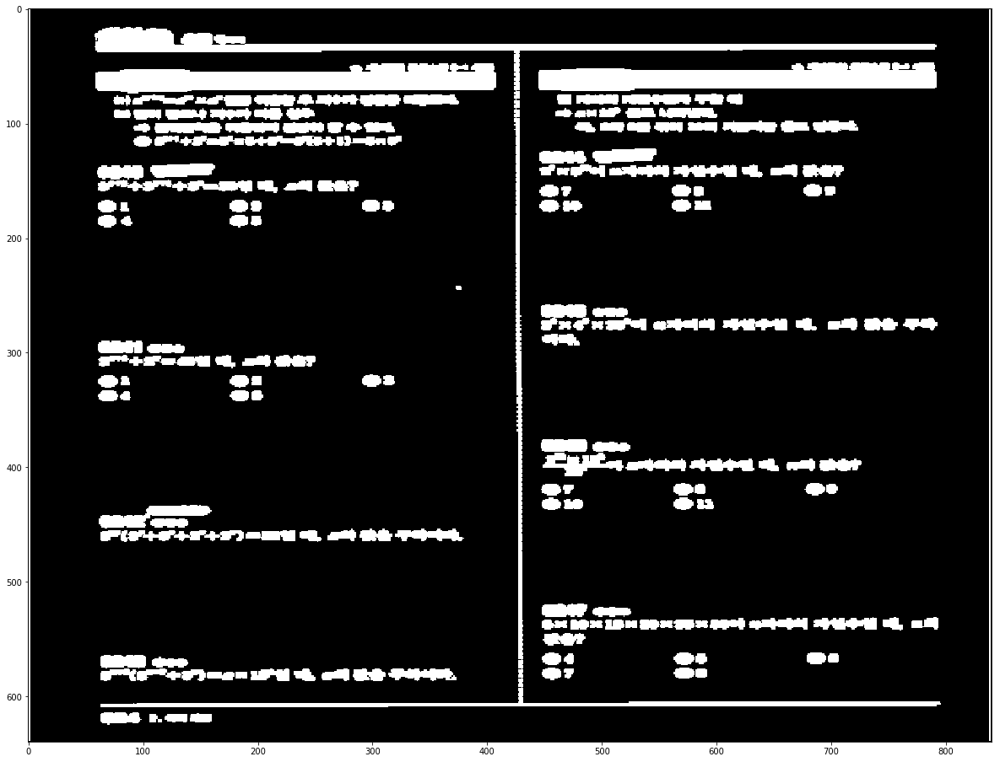

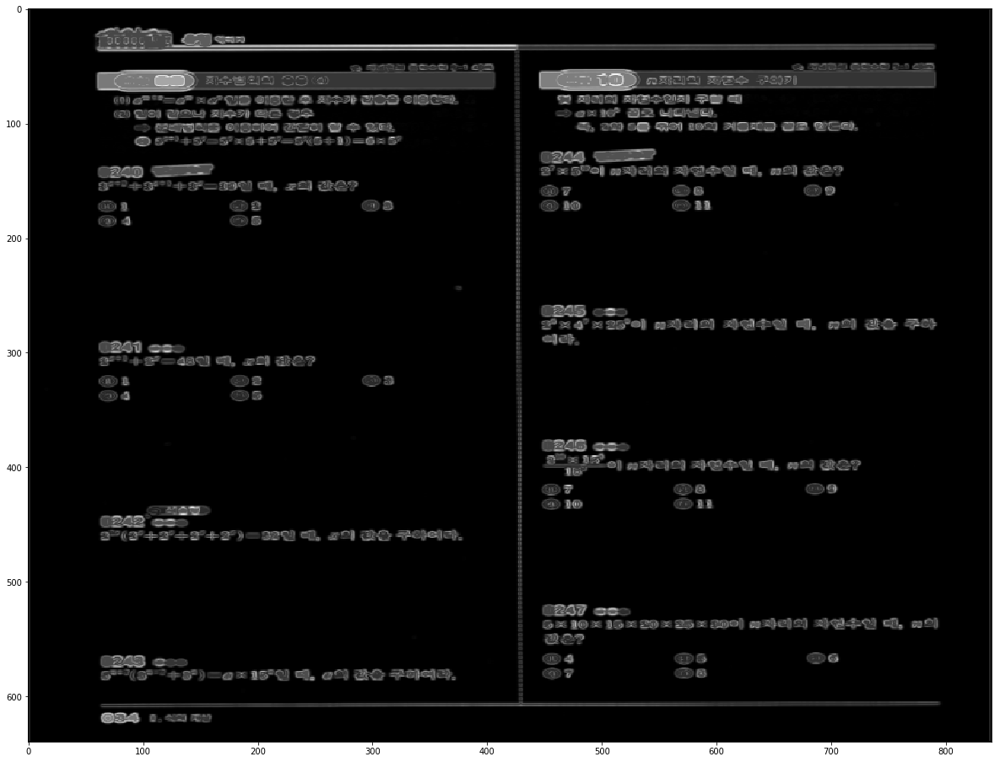

0  Pattern
IMG =  035 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

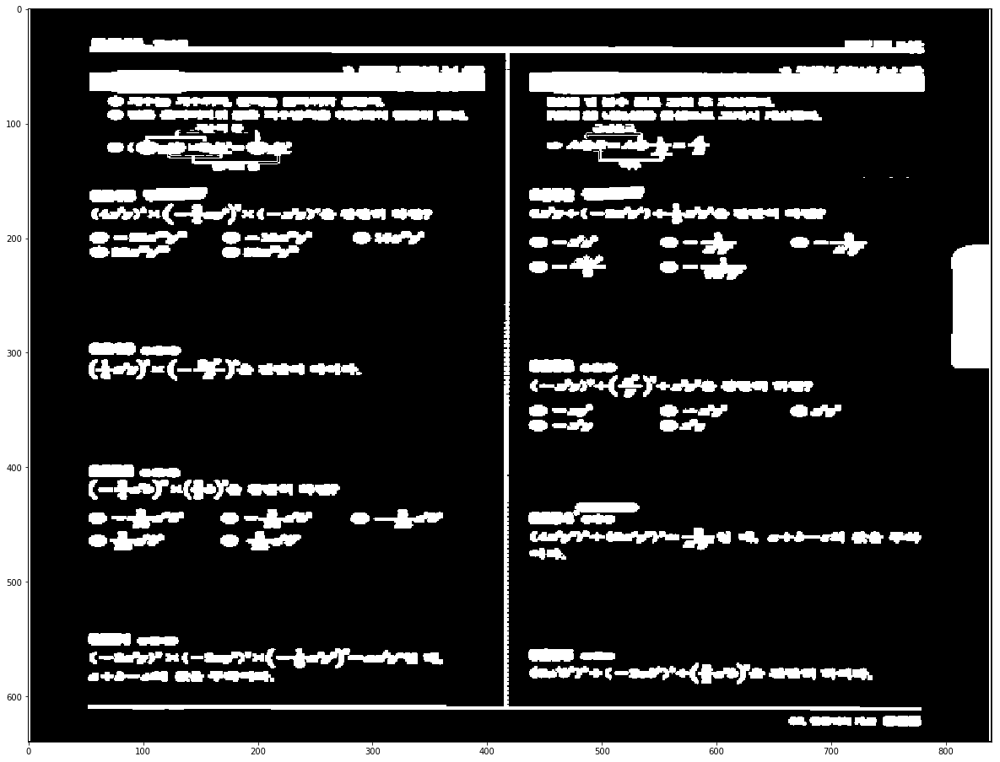

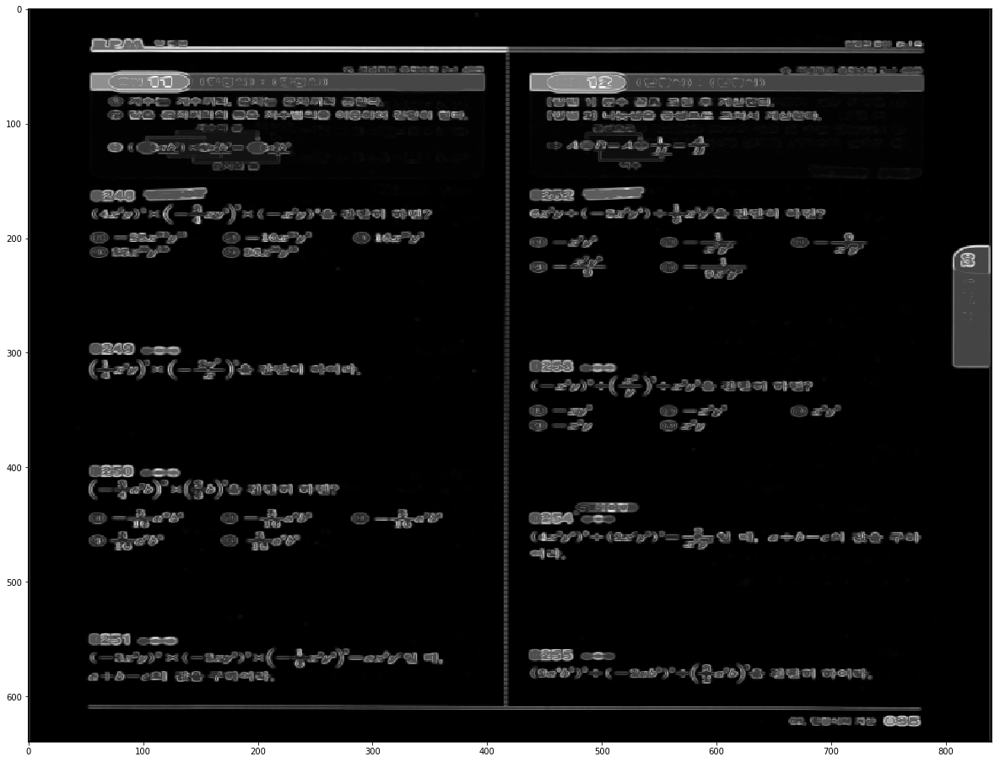

2  Pattern
IMG =  036 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

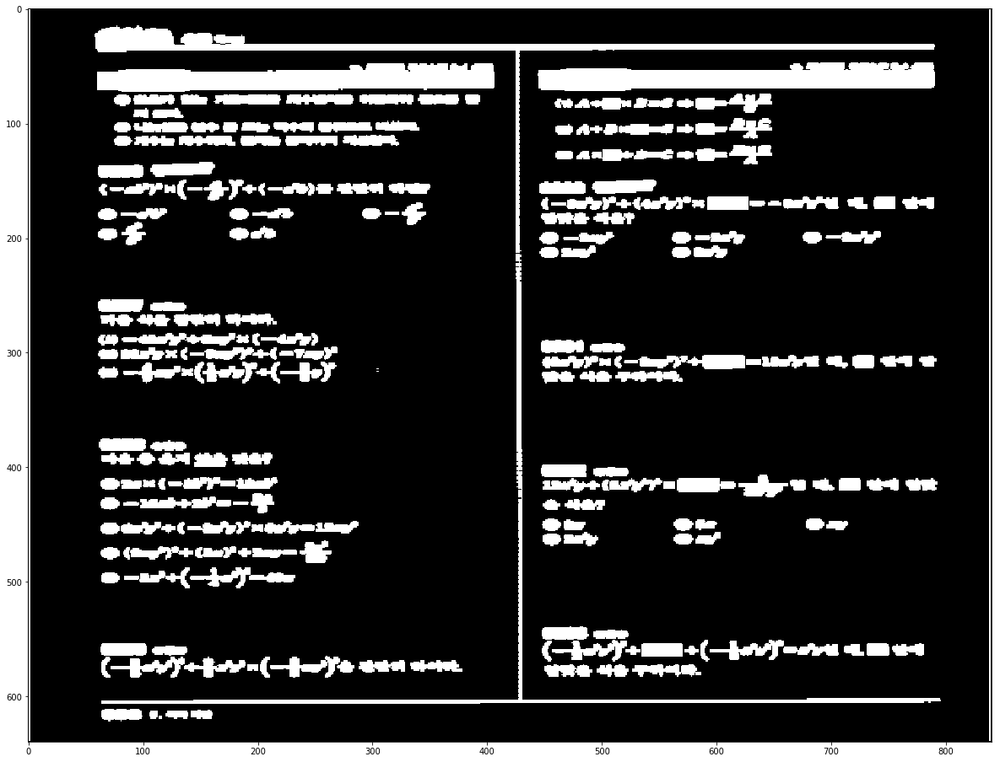

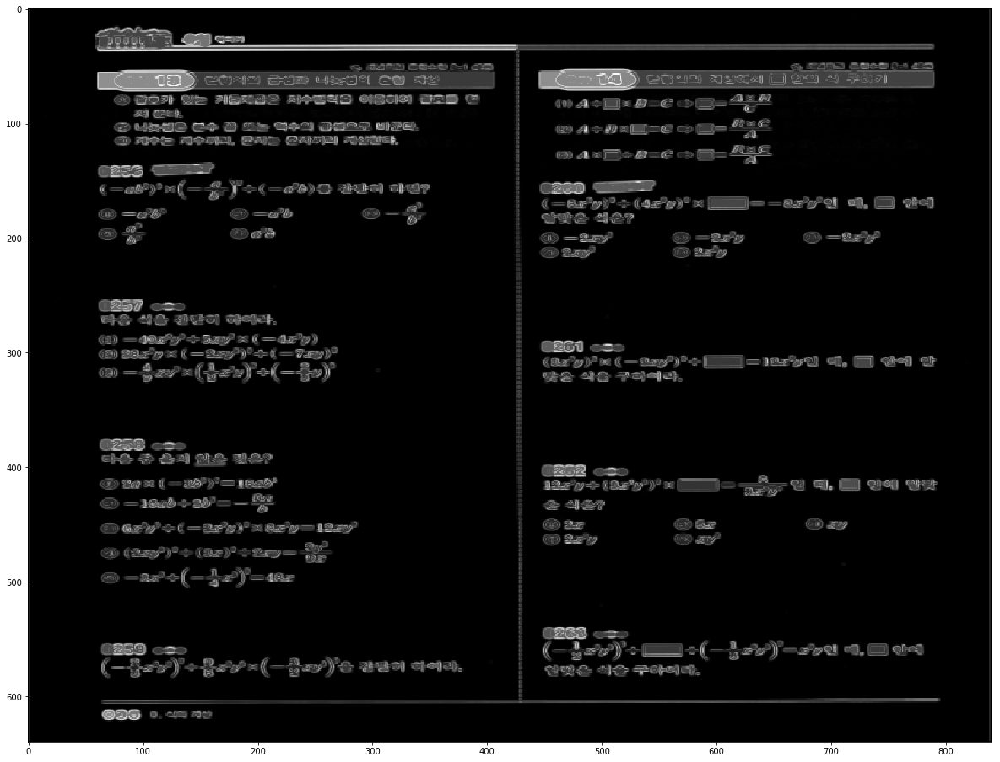

1  Pattern
IMG =  037 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

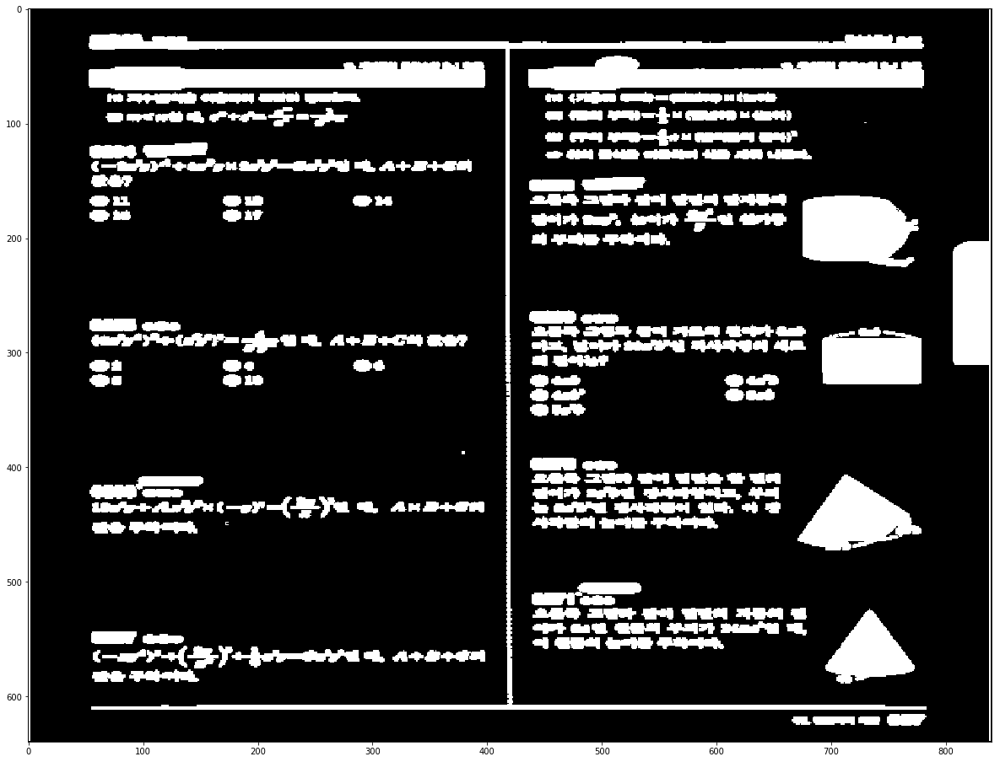

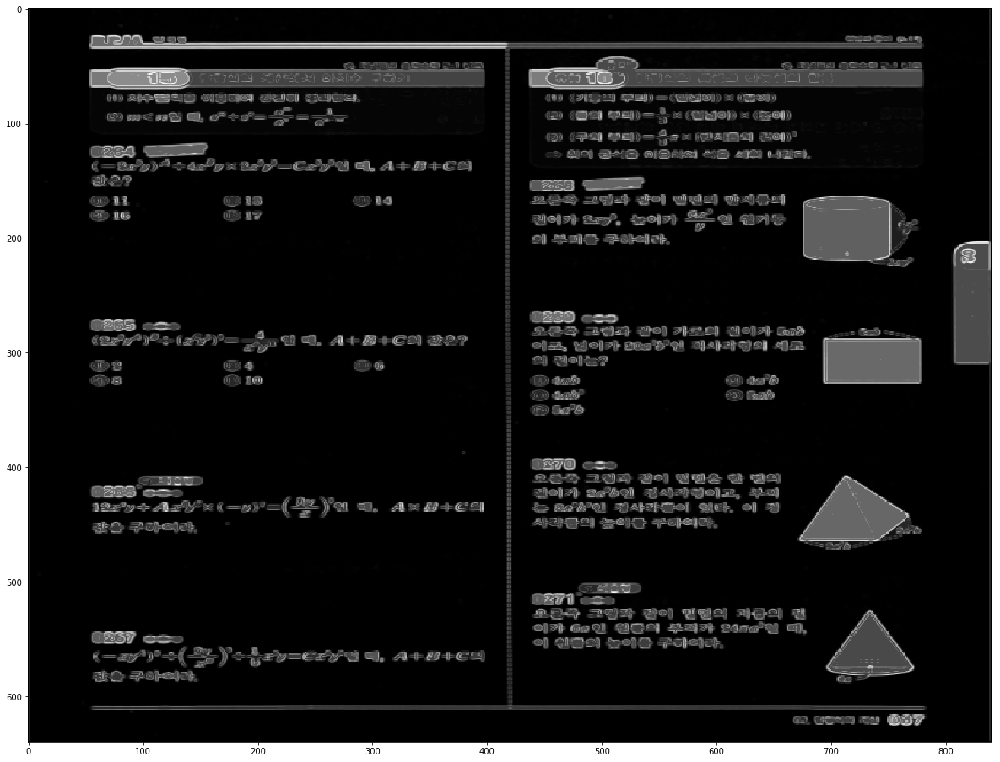

1  Pattern
IMG =  046 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

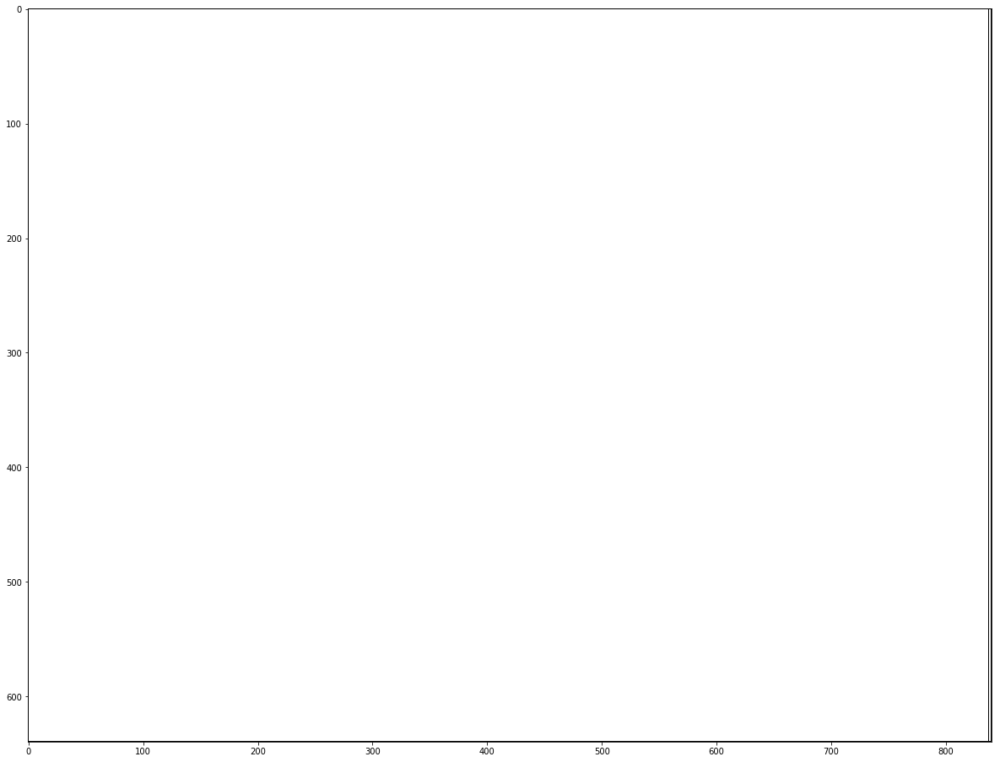

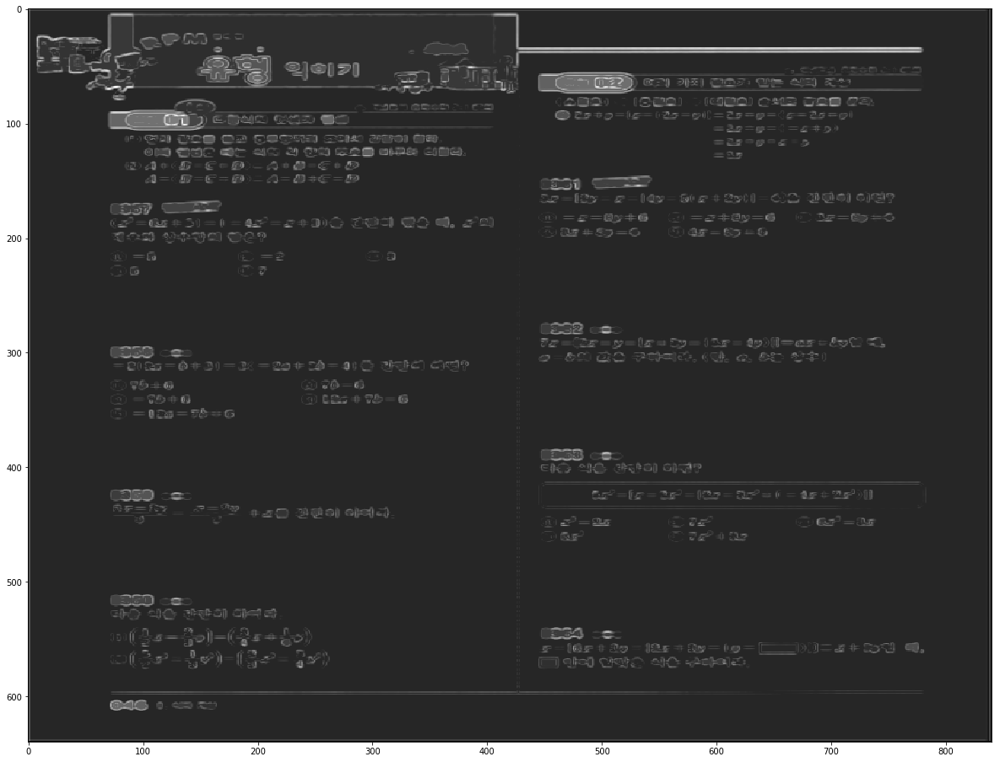

2  Pattern
IMG =  047 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

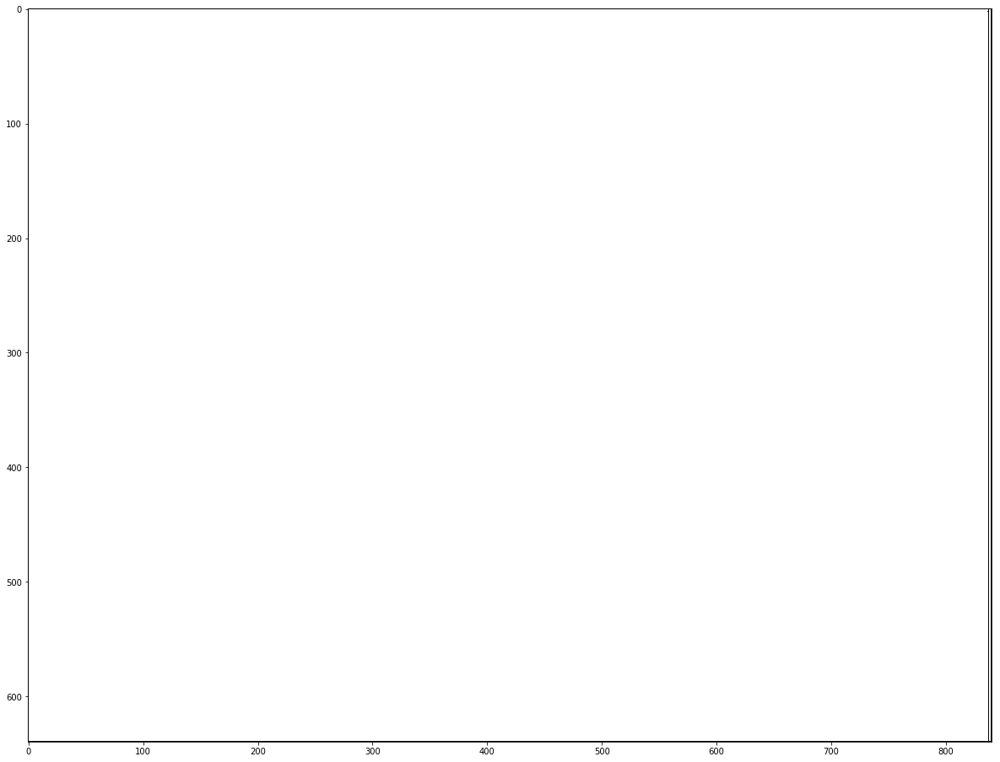

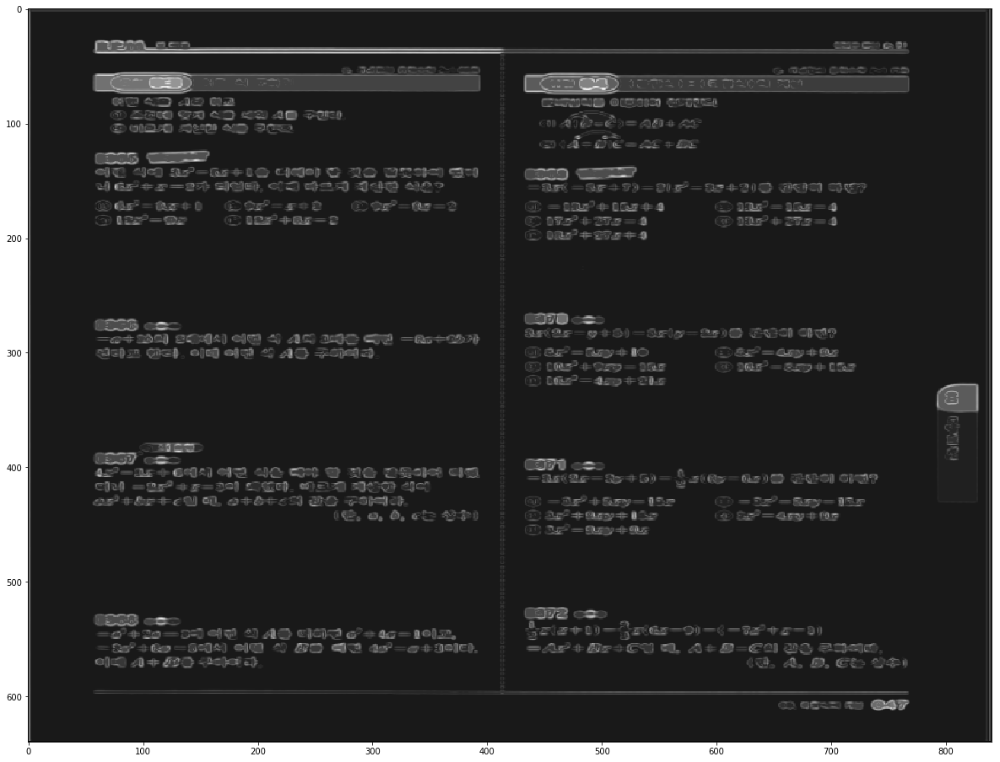

0  Pattern
IMG =  048 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

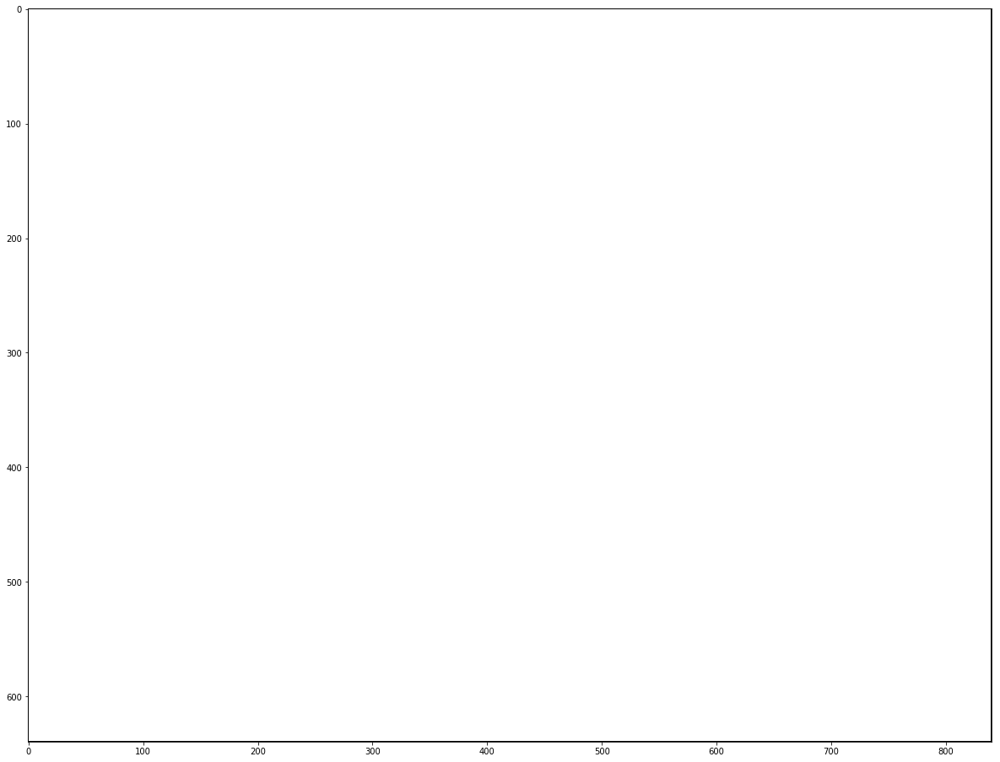

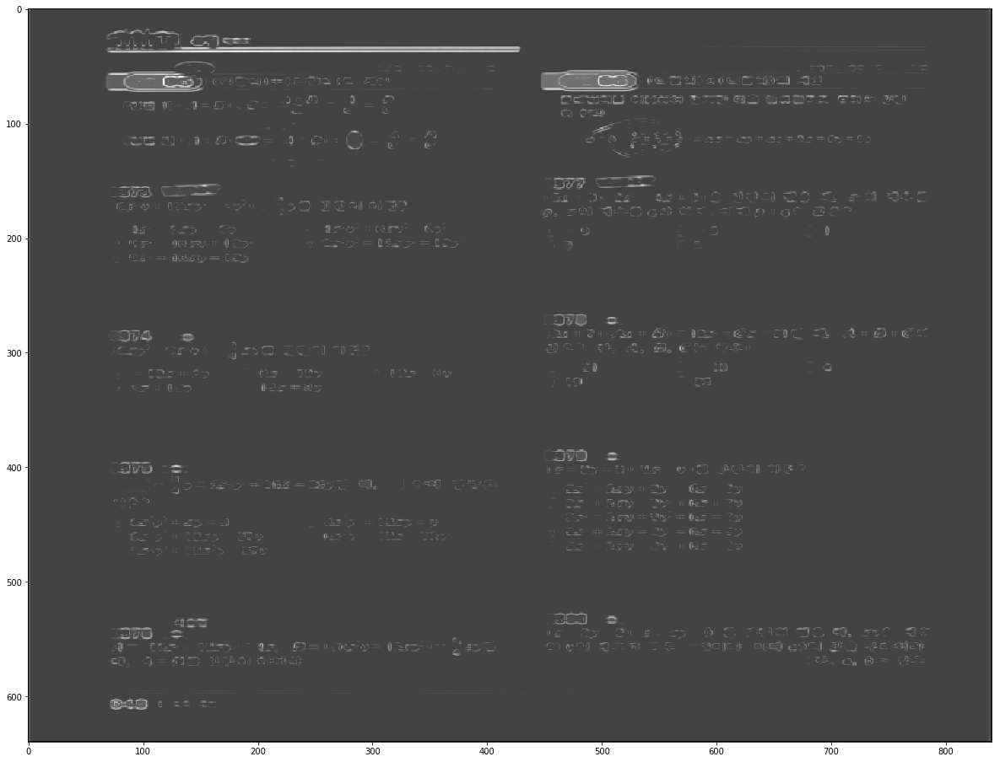

3  Pattern
IMG =  049 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

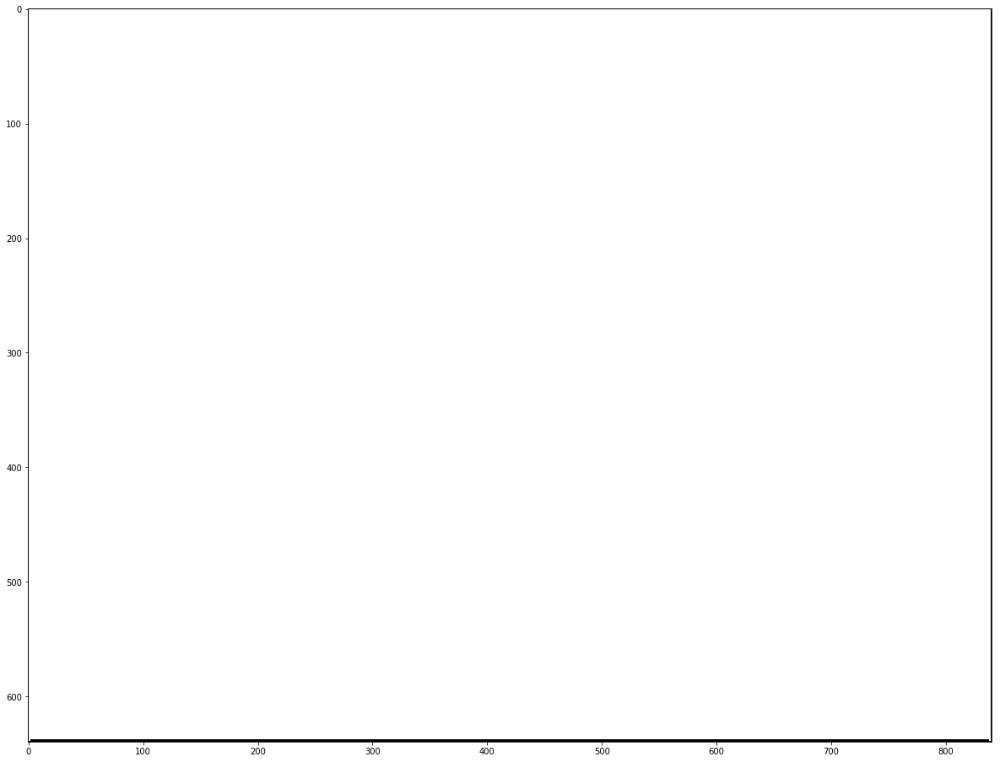

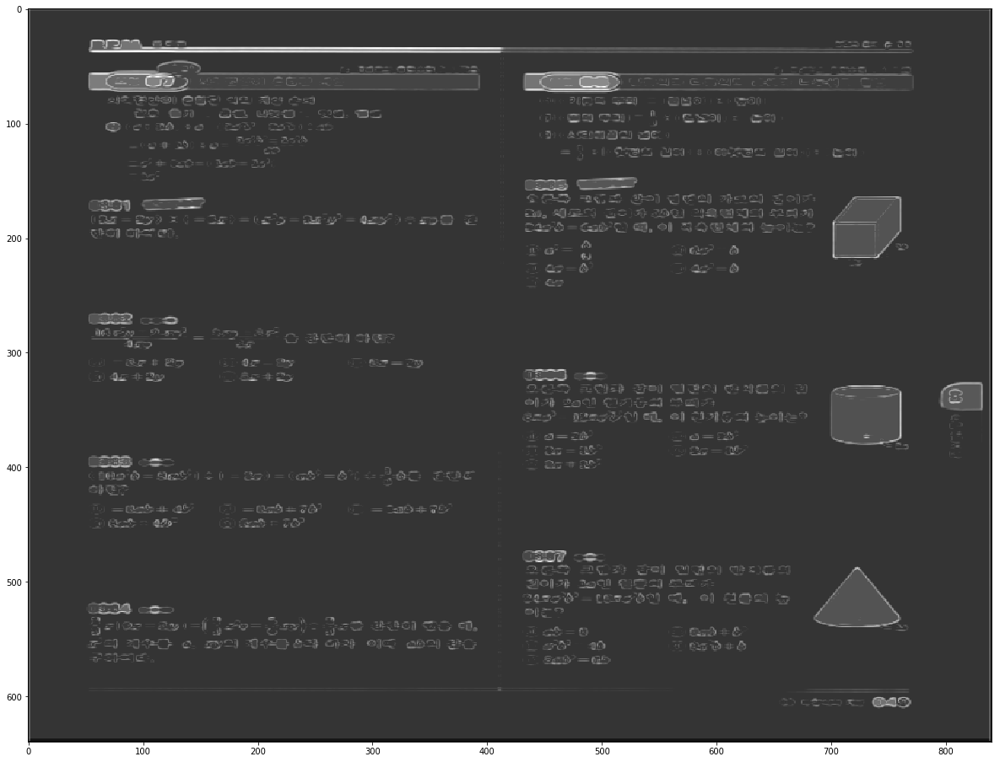

3  Pattern
IMG =  050 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

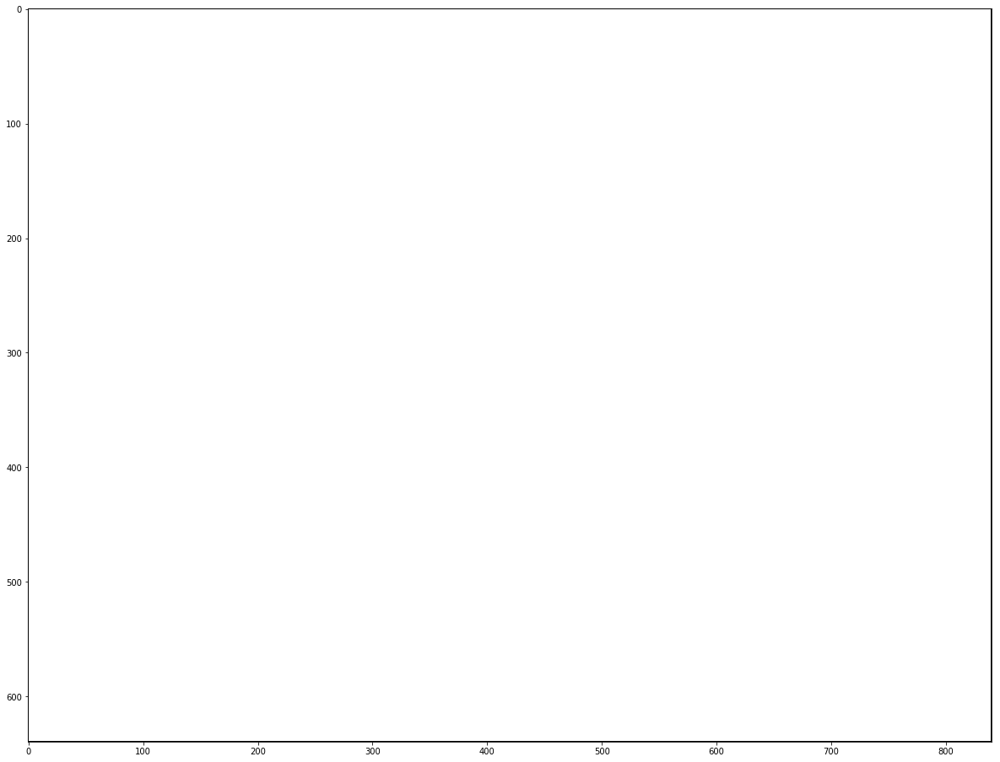

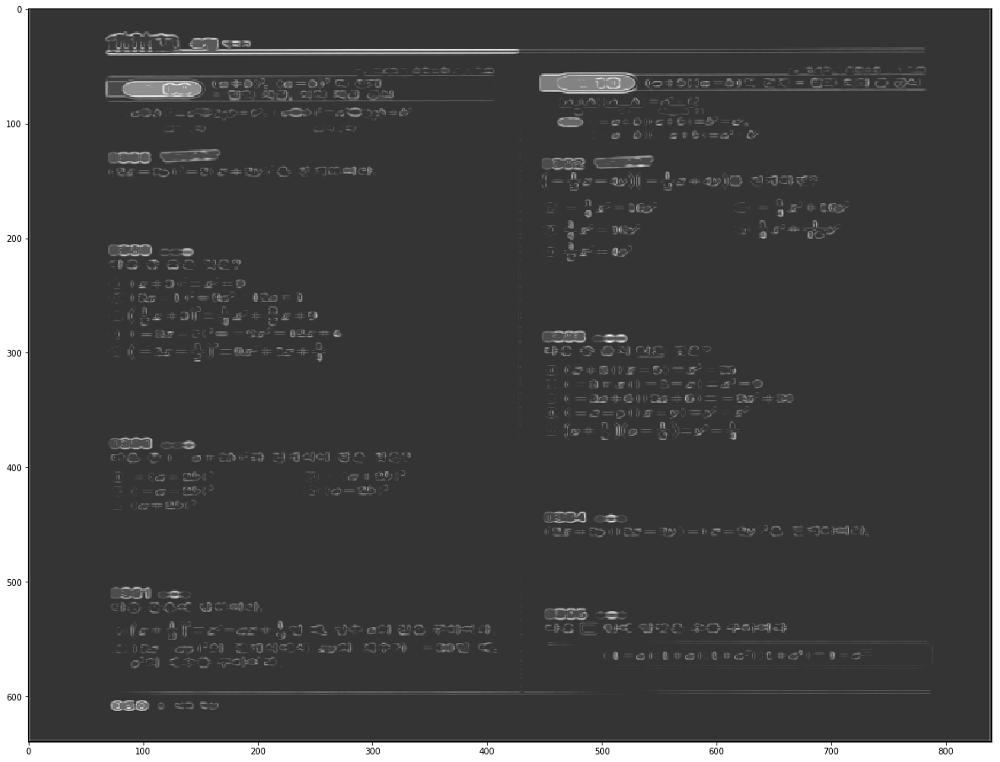

0  Pattern
IMG =  051 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

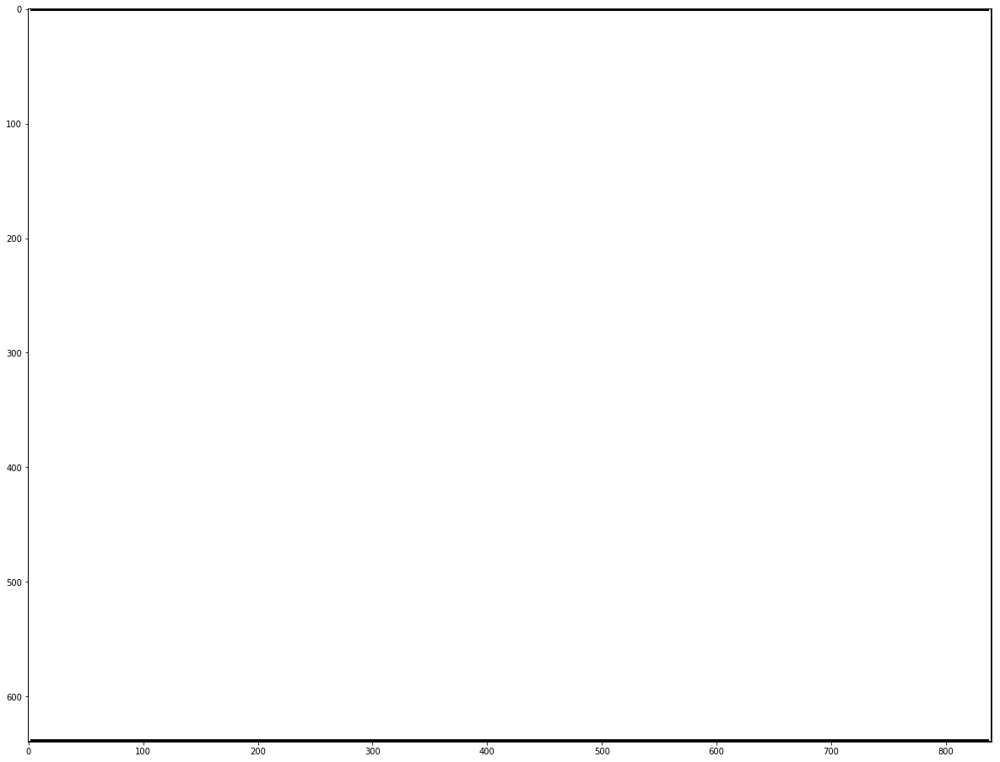

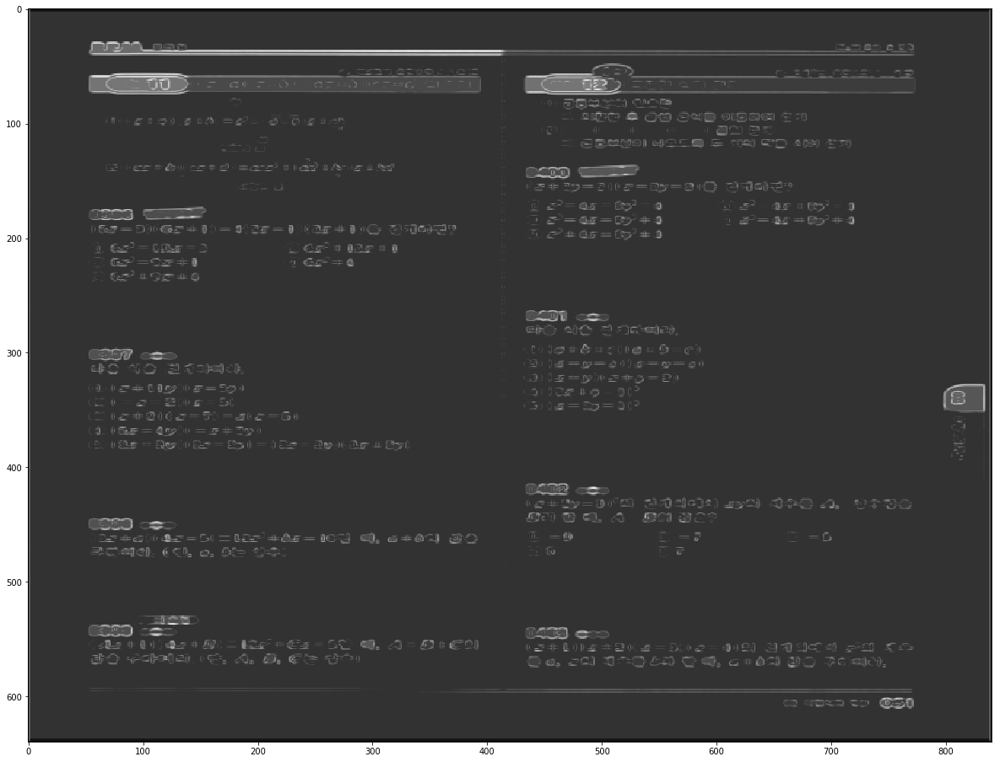

2  Pattern
IMG =  052 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

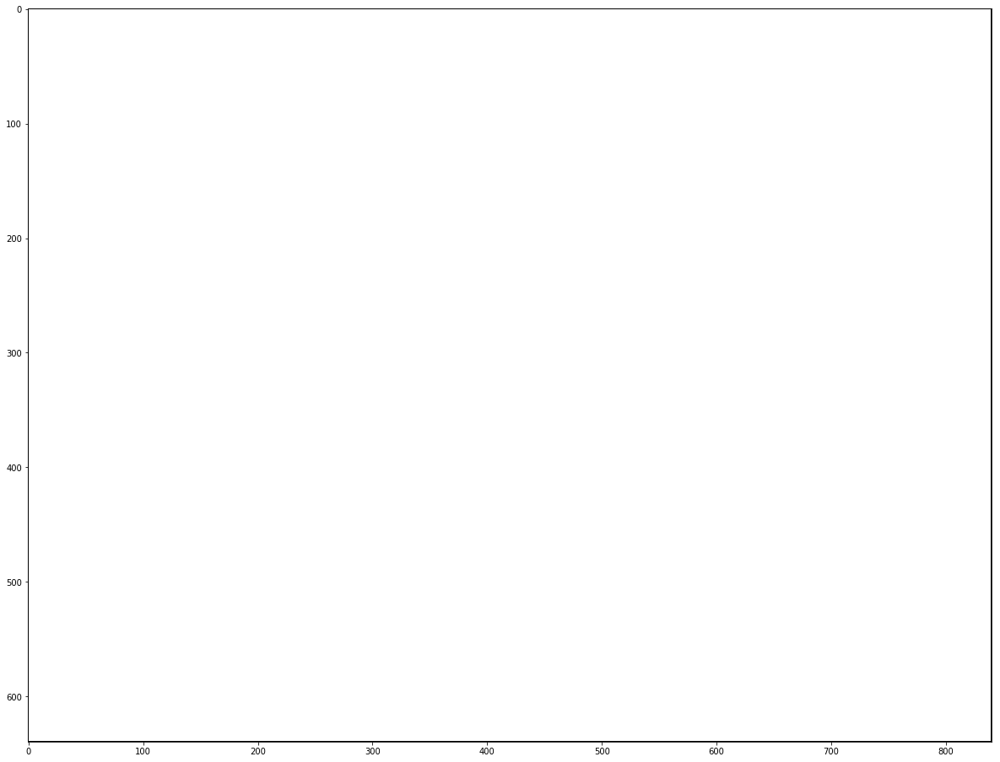

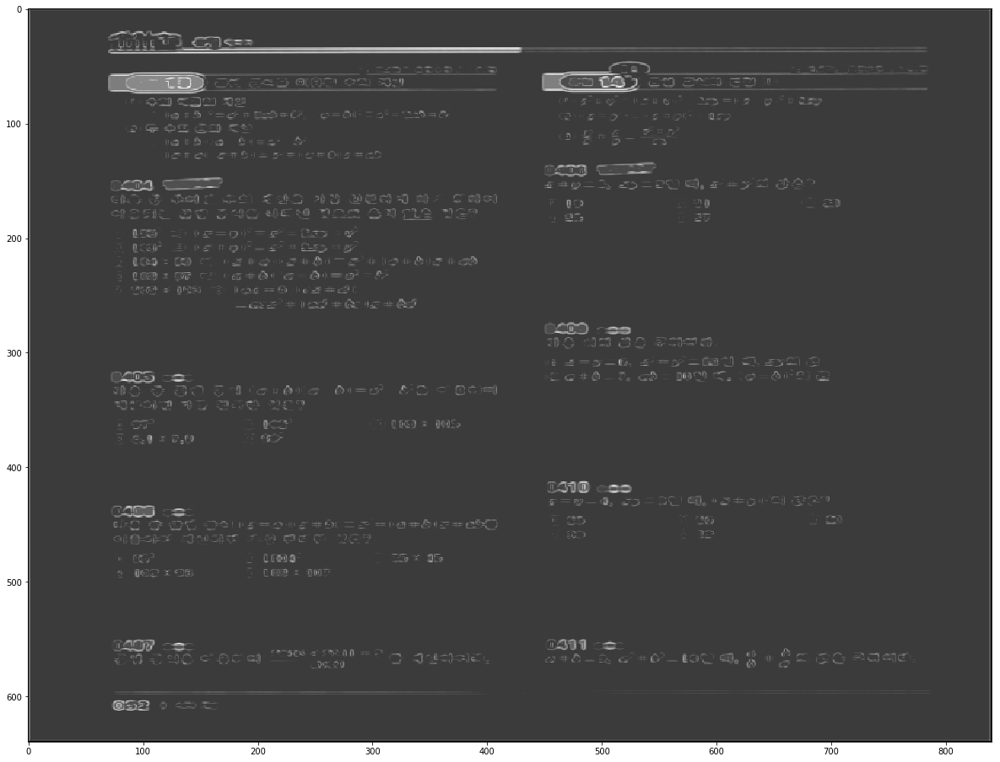

1  Pattern
IMG =  053 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

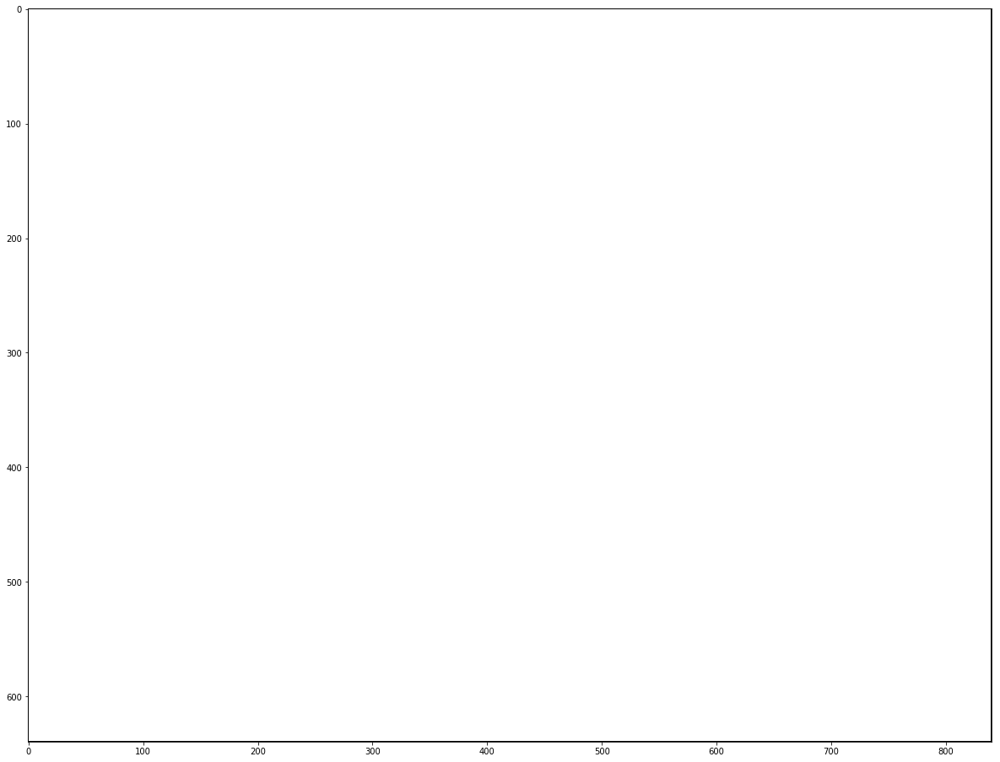

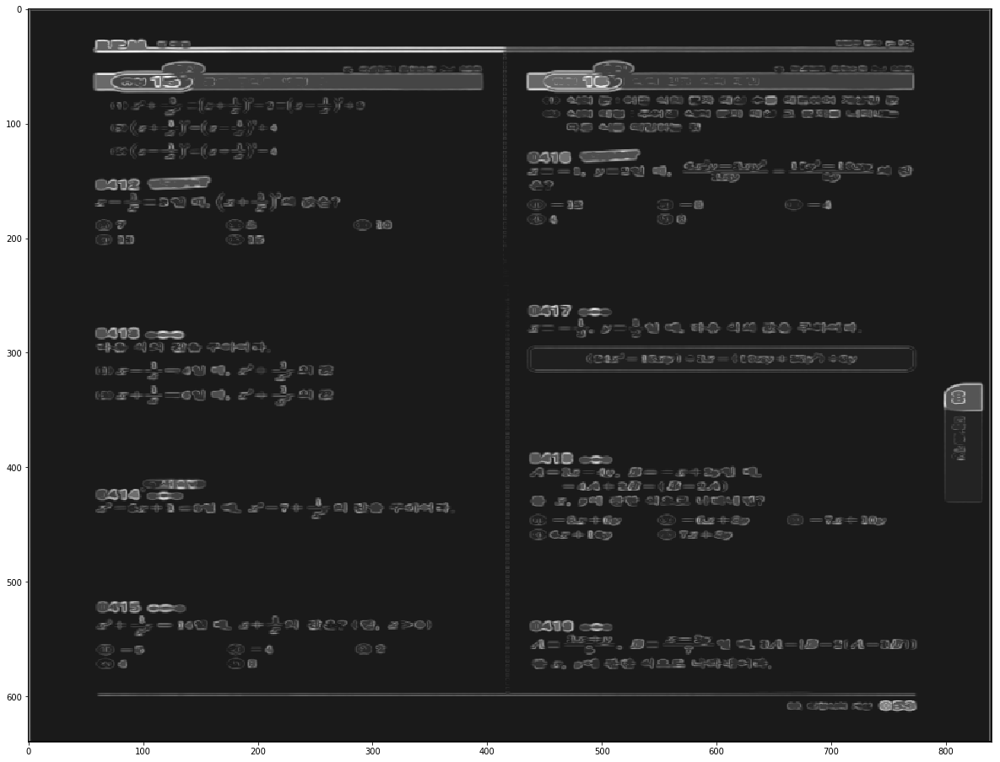

1  Pattern
IMG =  054 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

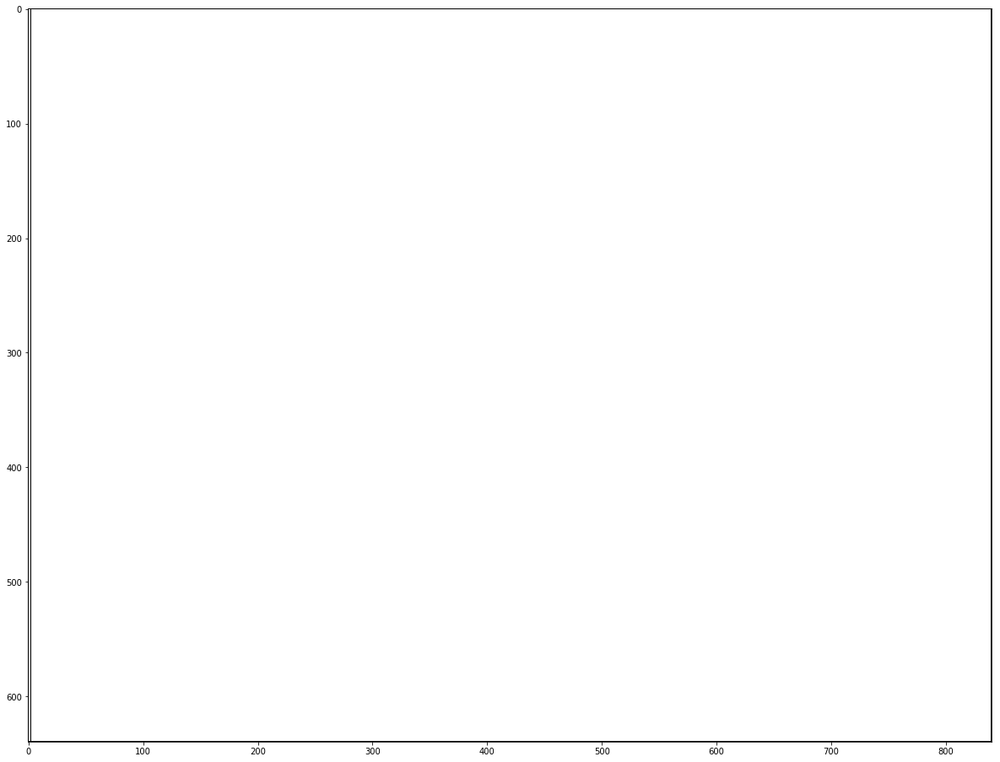

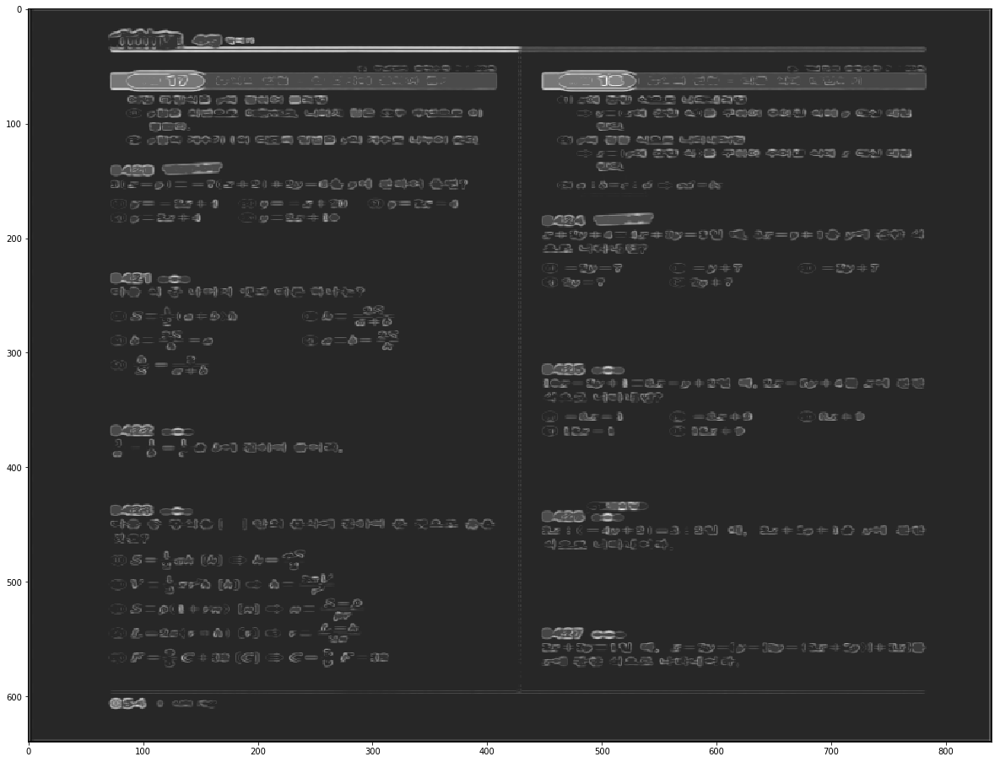

2  Pattern
IMG =  055 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

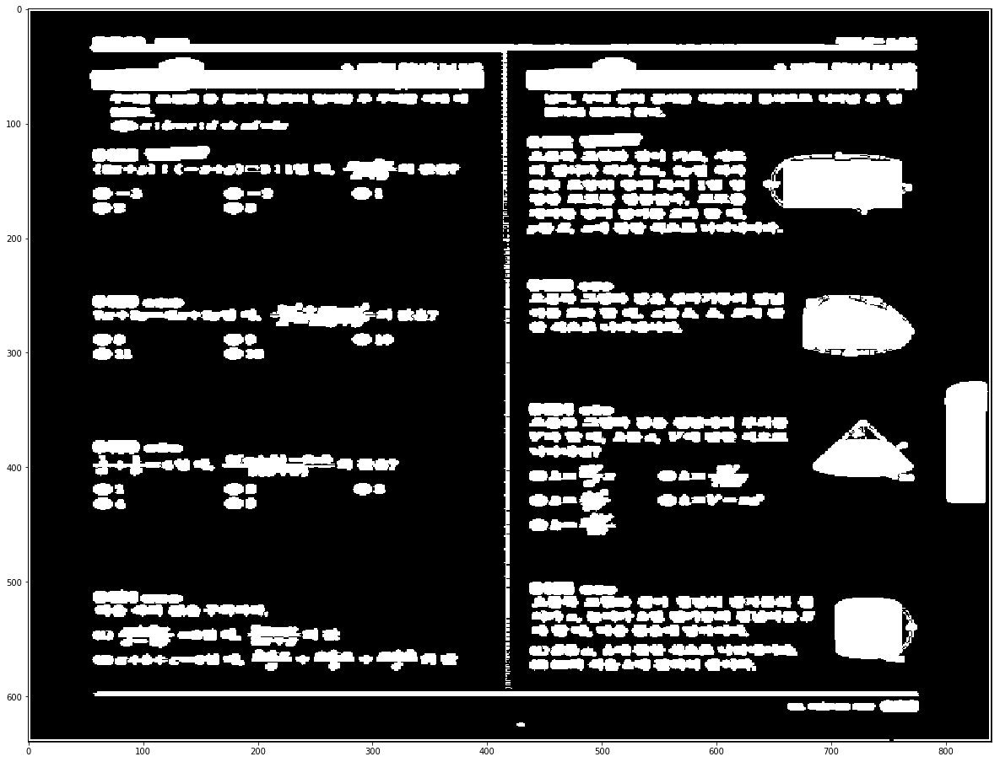

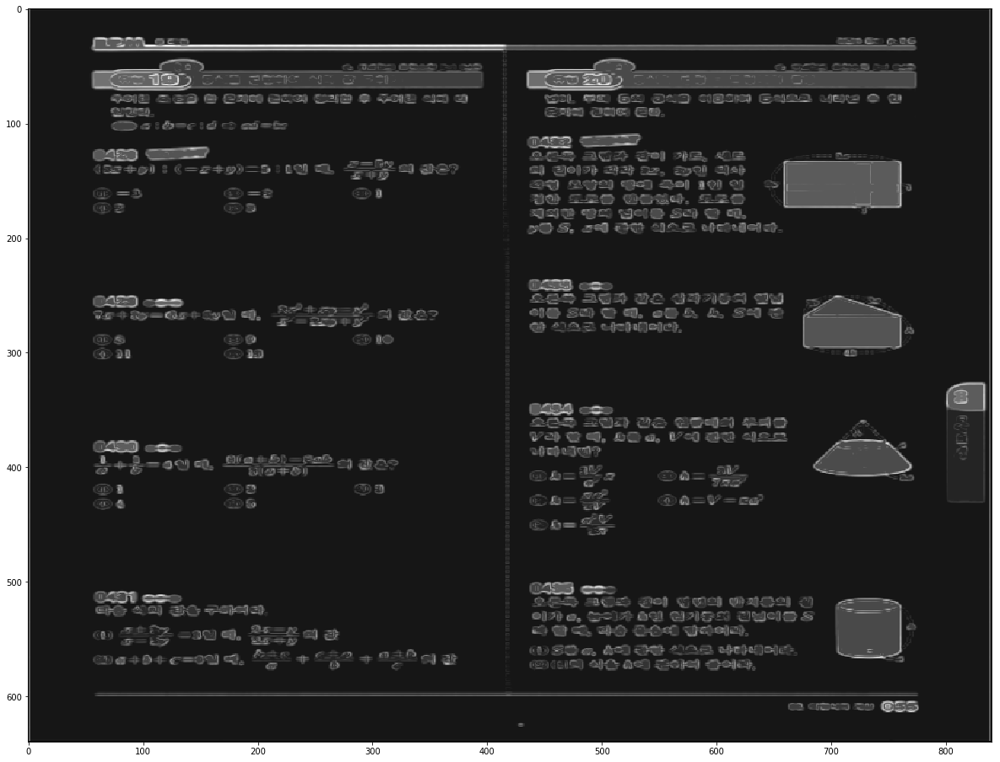

0  Pattern
IMG =  066 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

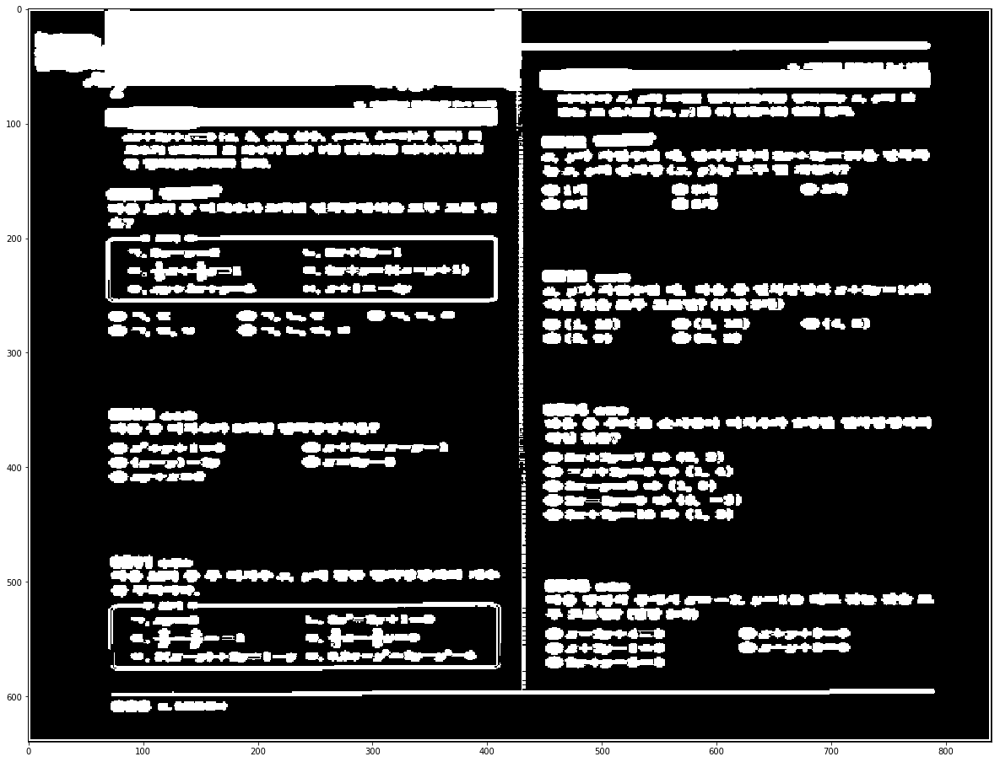

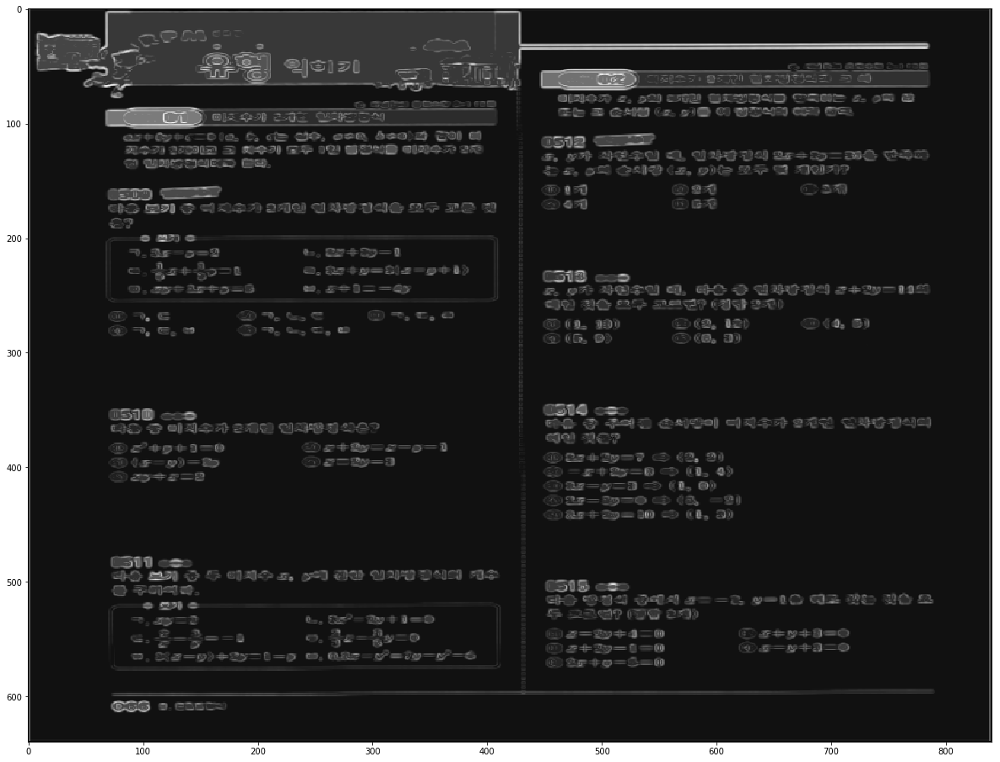

3  Pattern
IMG =  068 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

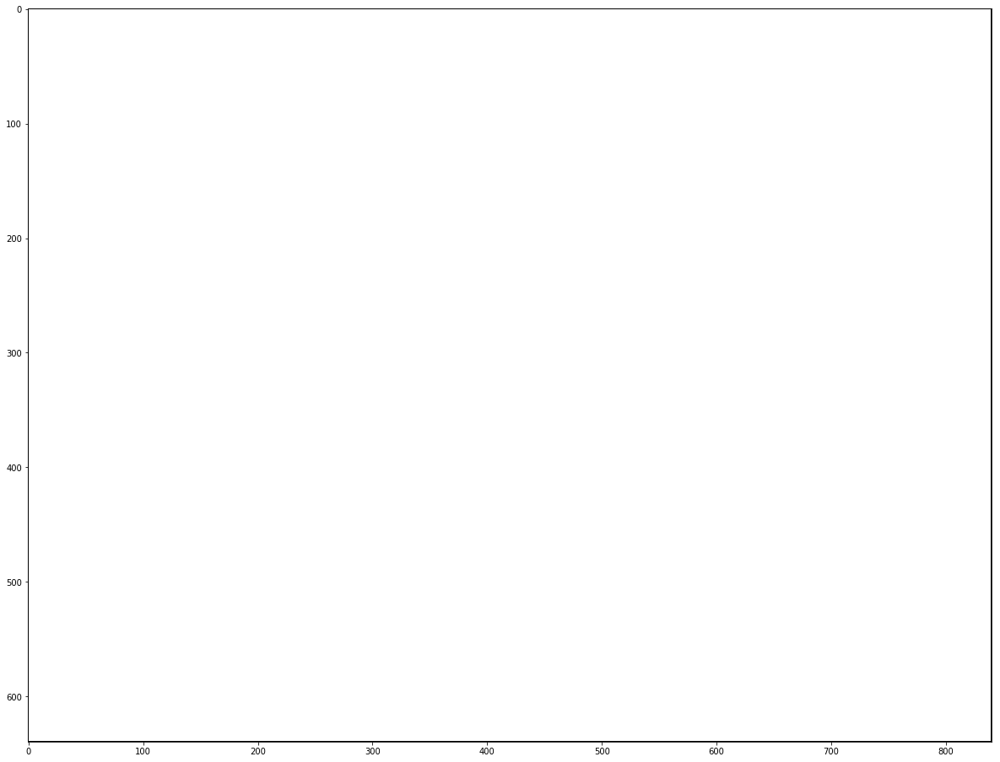

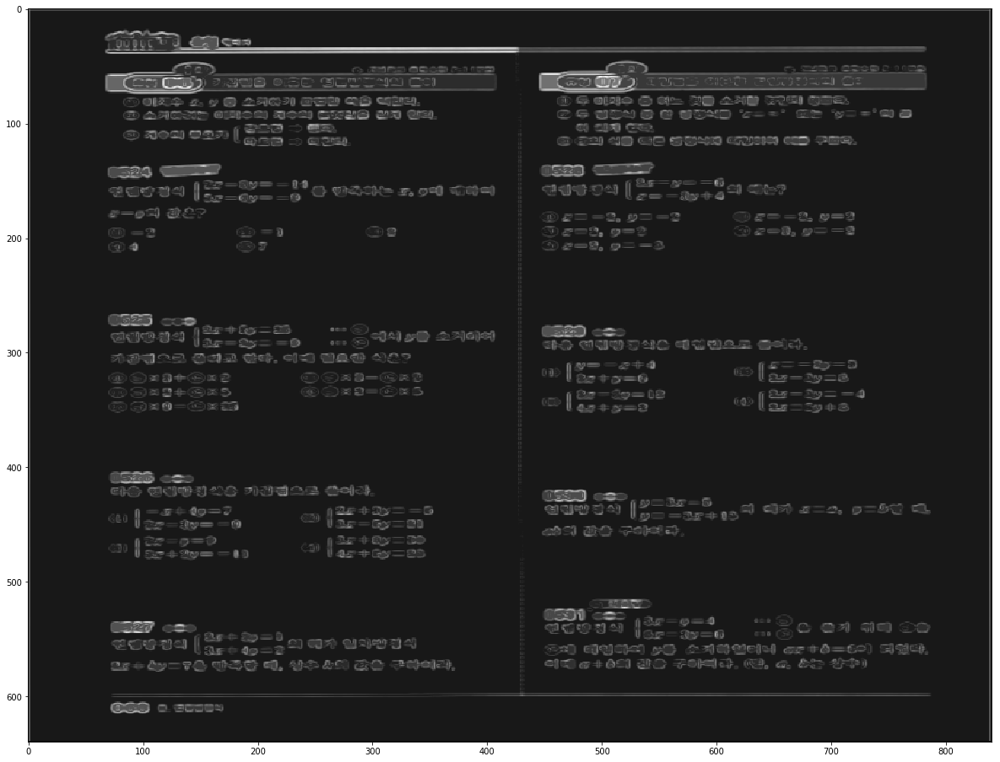

3  Pattern
IMG =  069 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

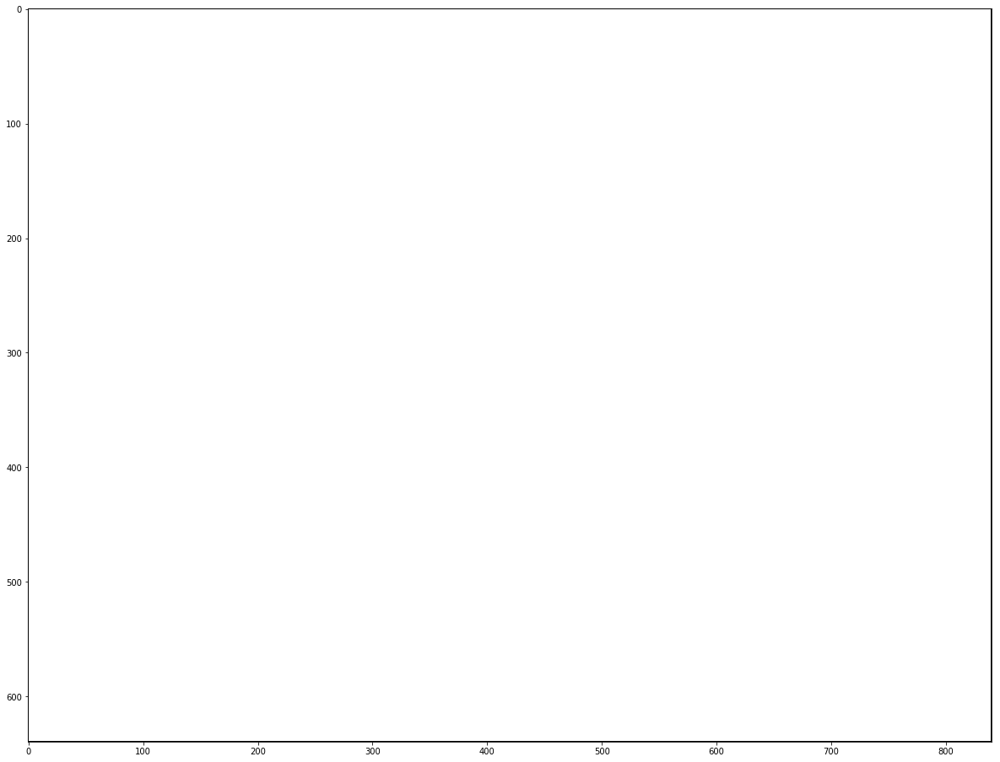

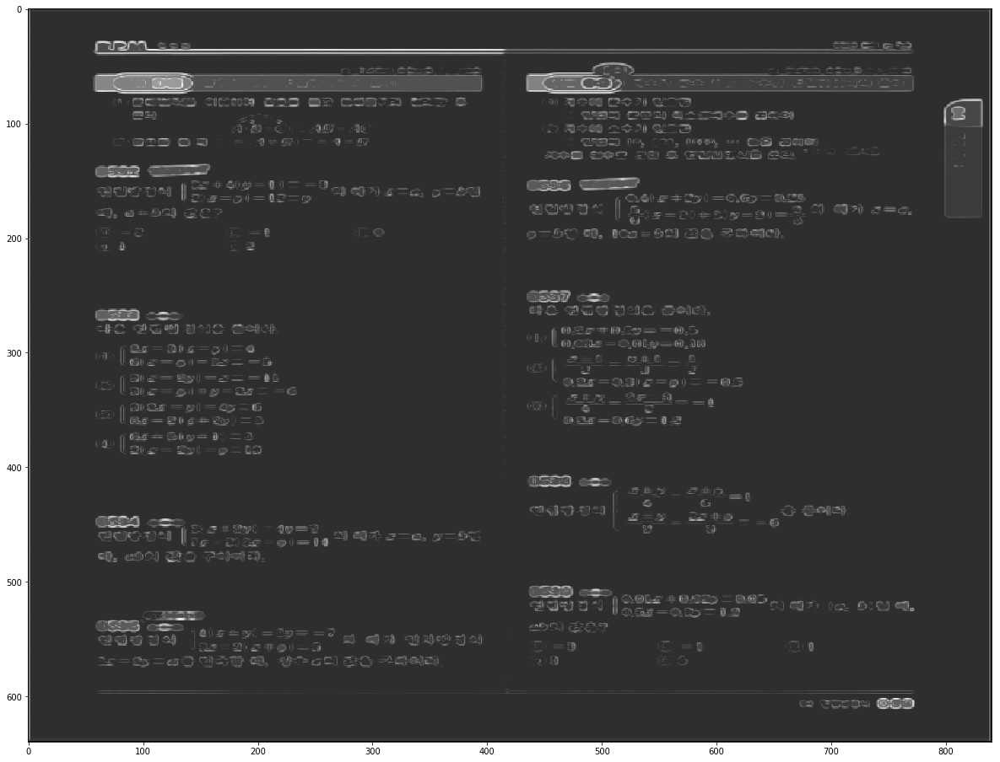

0  Pattern
IMG =  071 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

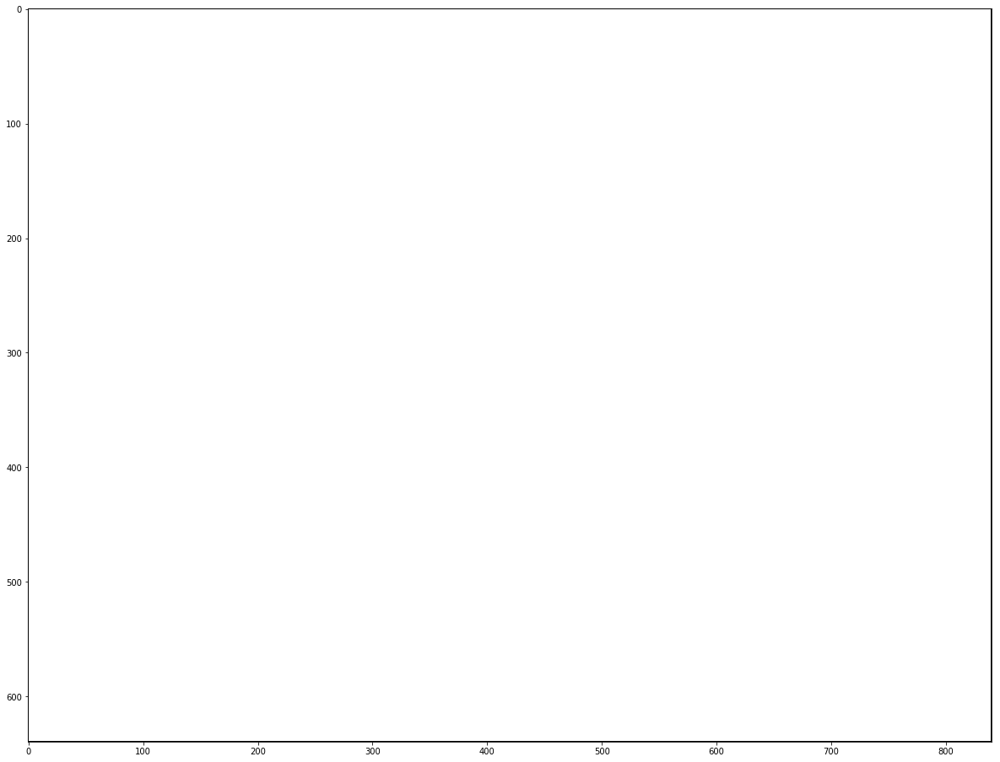

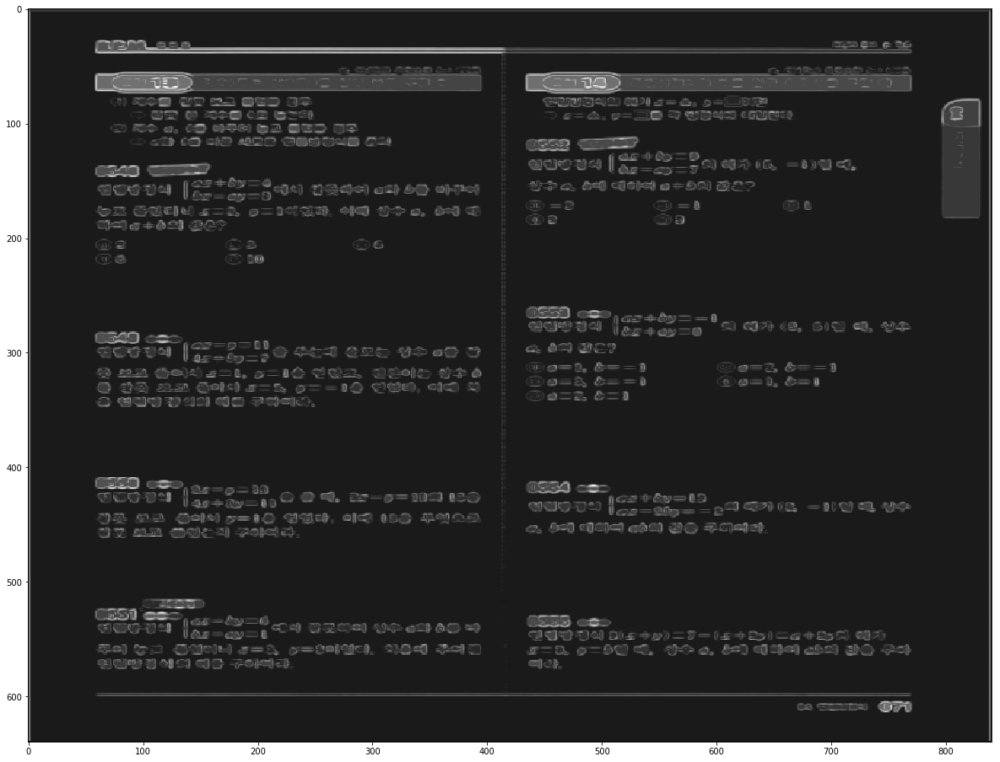

2  Pattern
IMG =  072 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

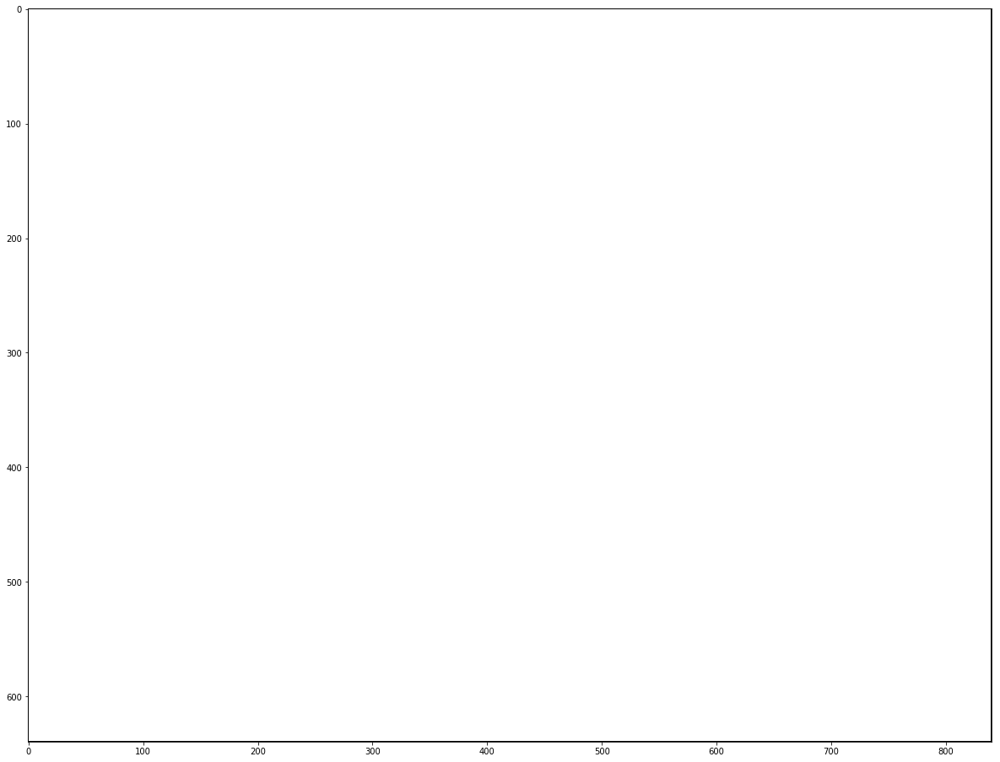

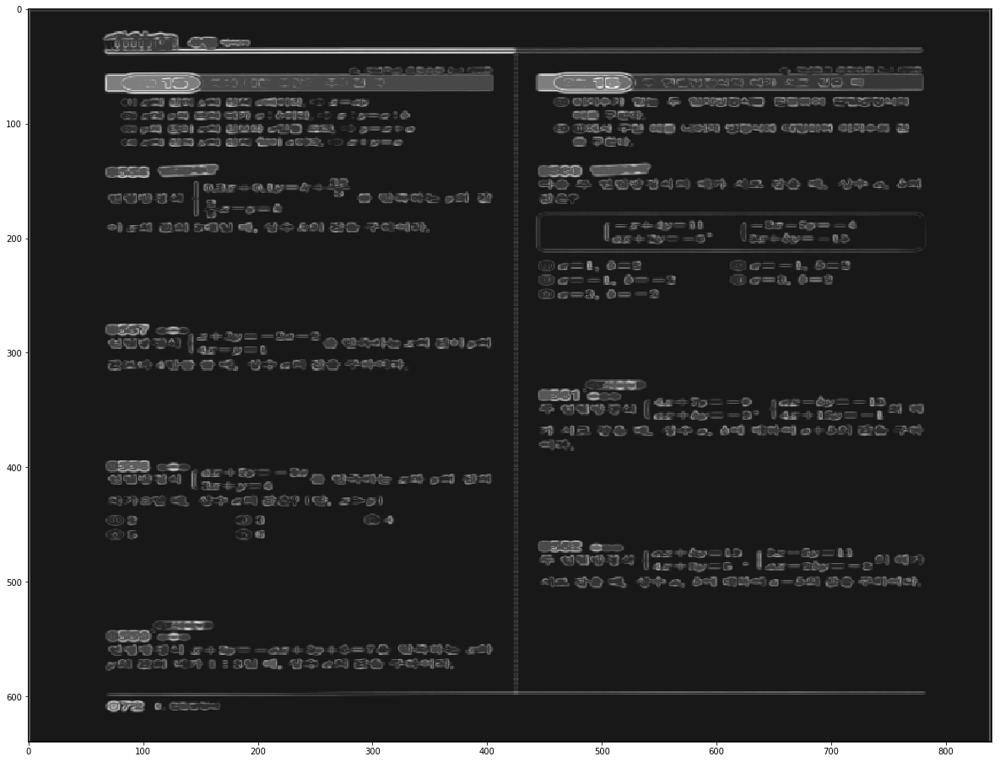

1  Pattern
IMG =  073 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

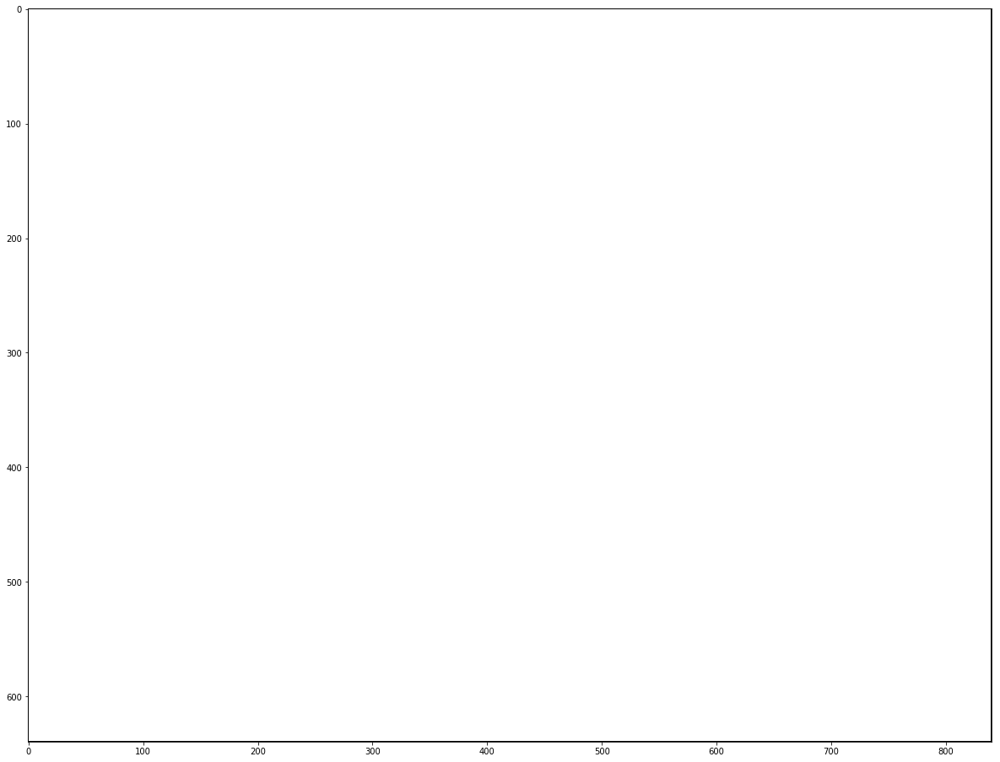

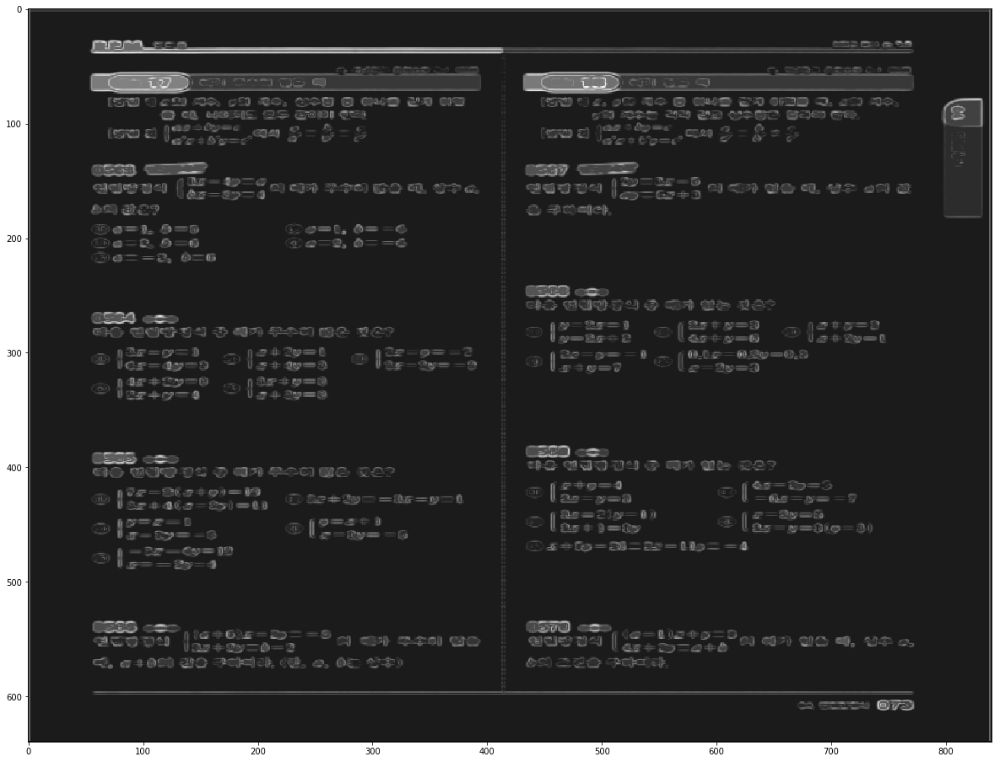

1  Pattern
IMG =  081 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

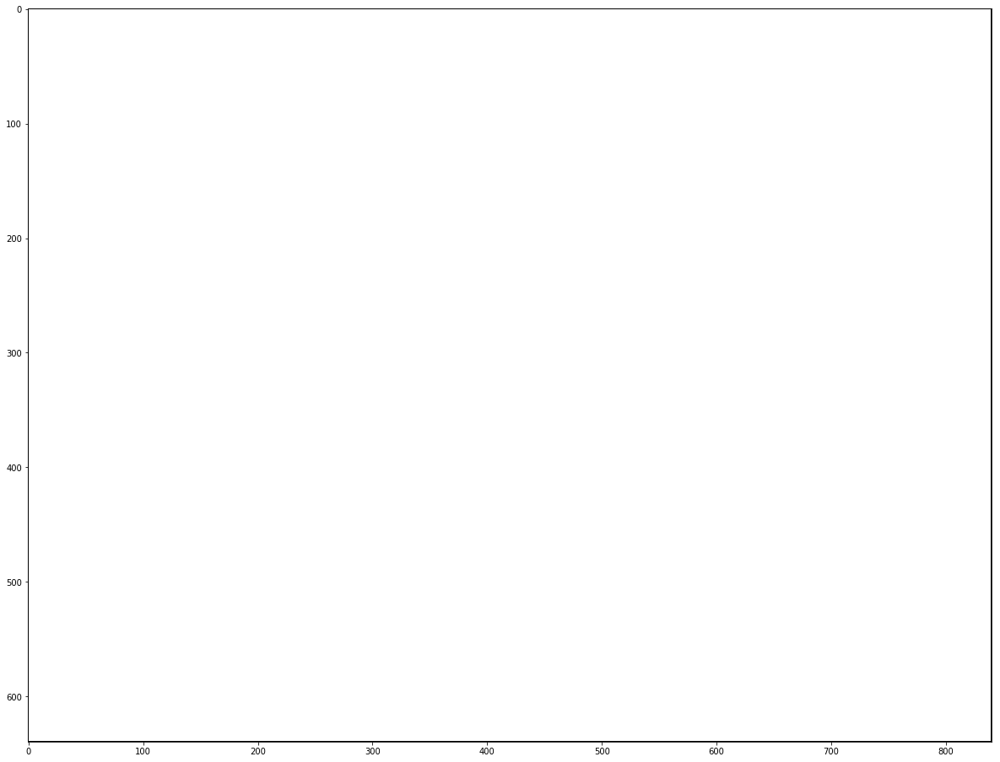

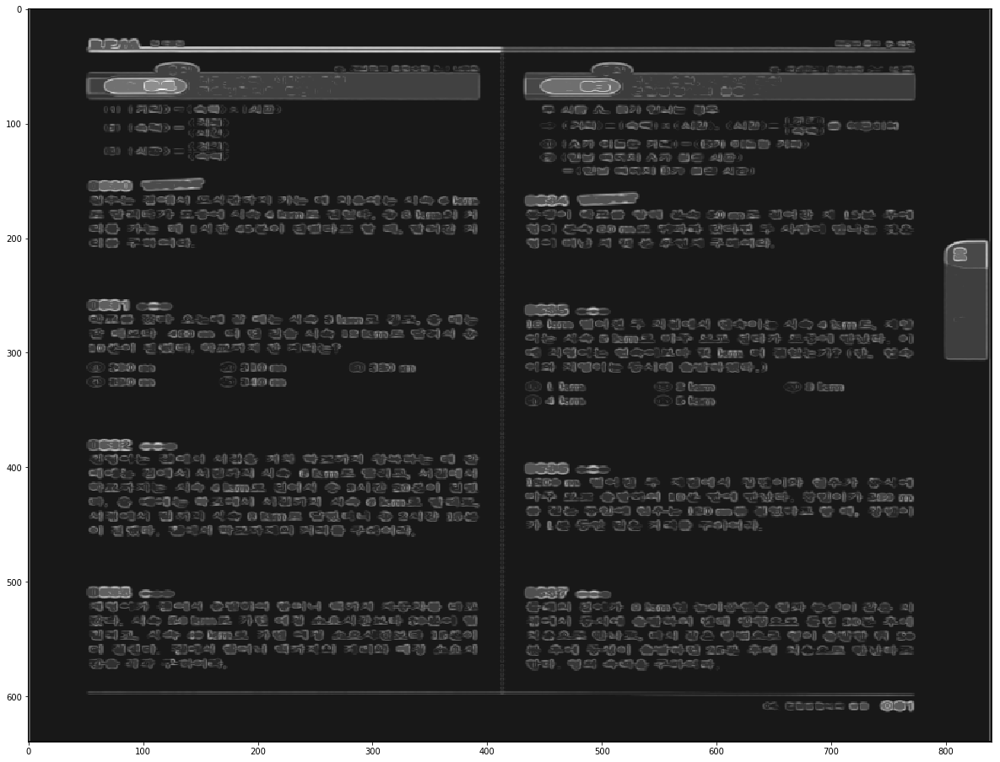

2  Pattern
IMG =  082 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

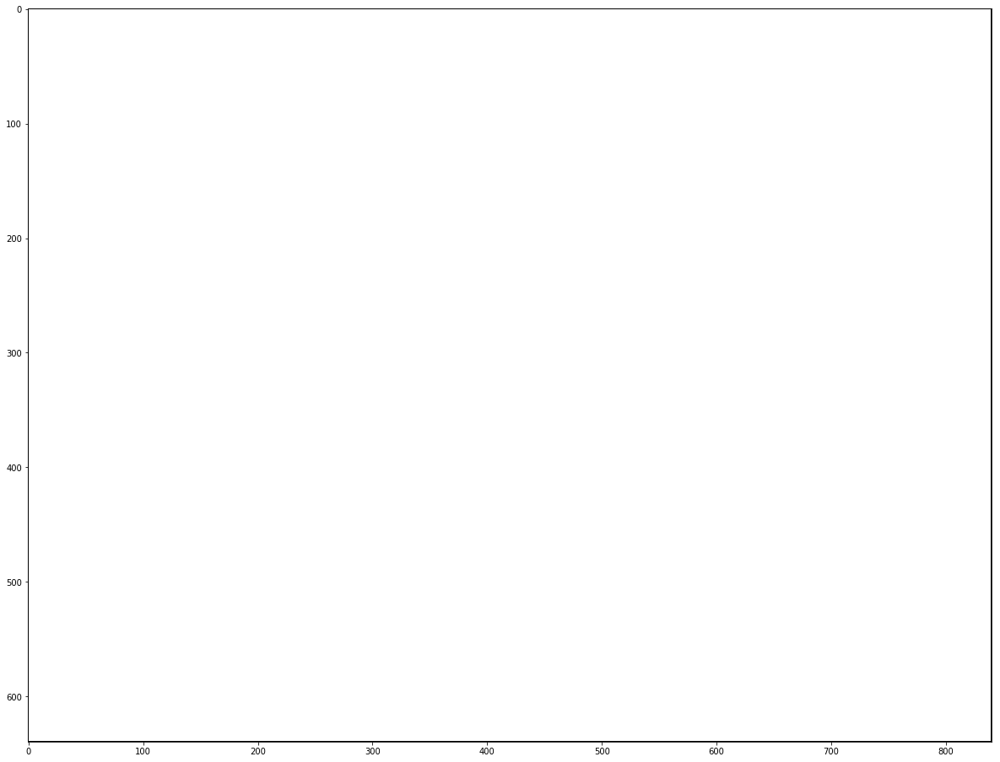

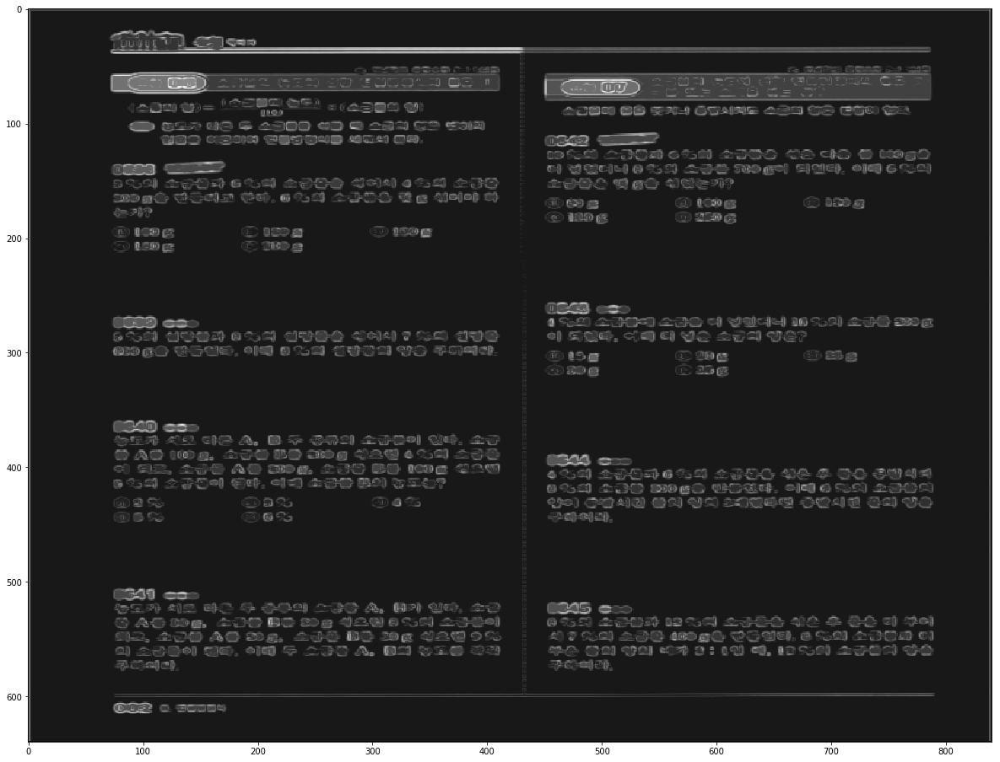

0  Pattern
IMG =  083 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

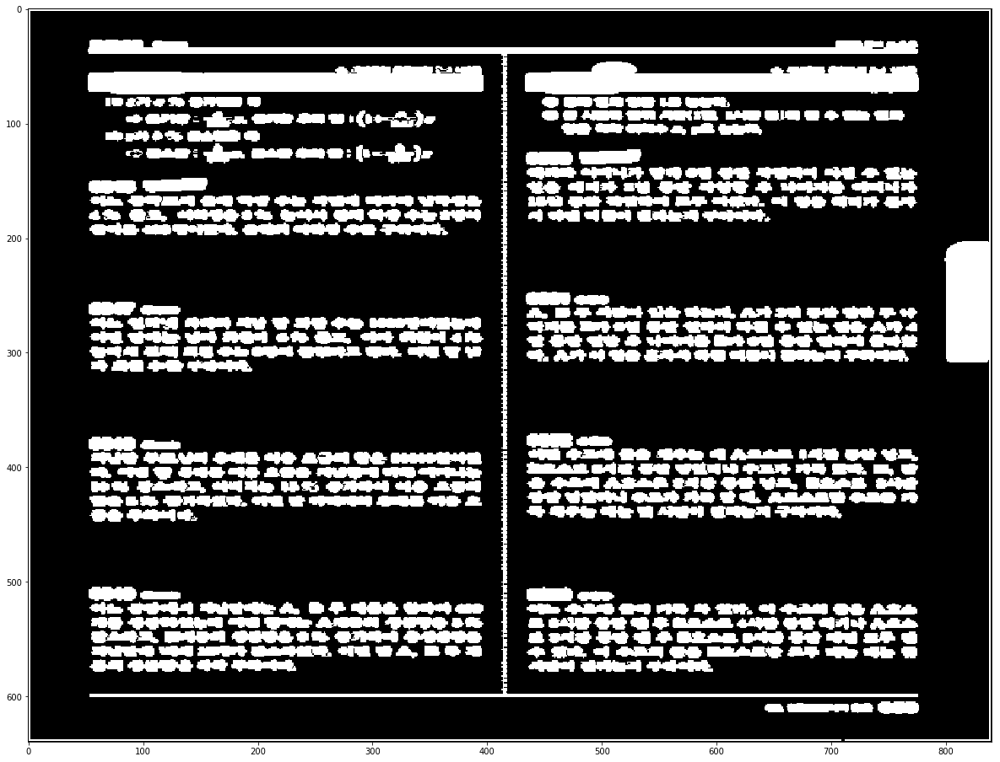

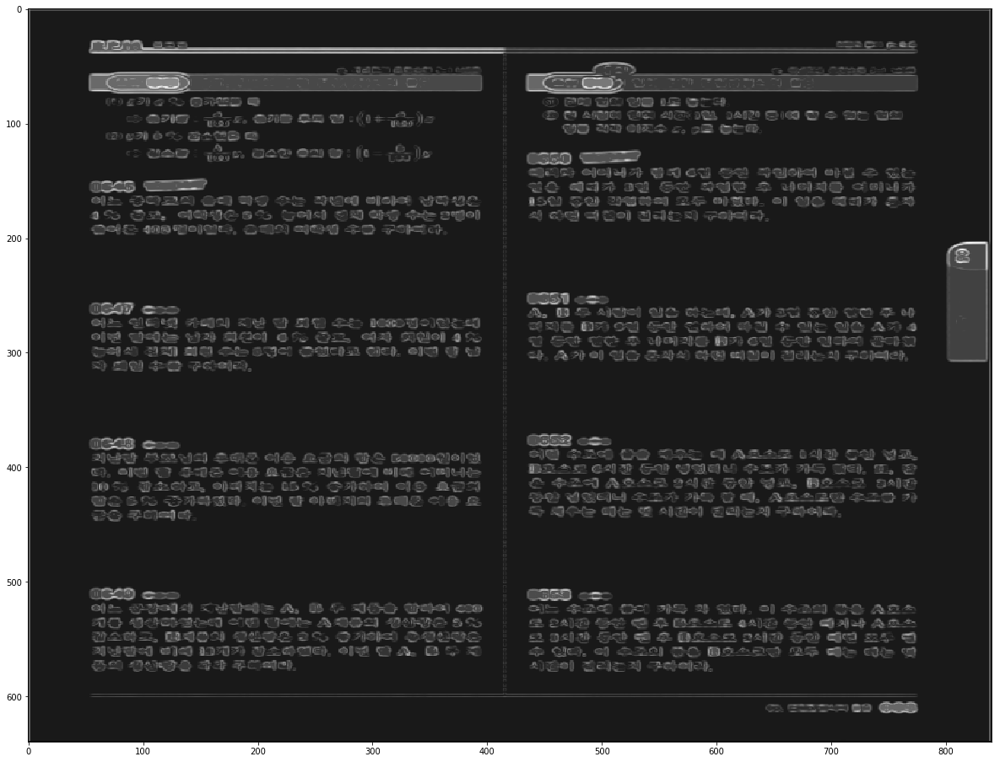

3  Pattern
IMG =  097 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

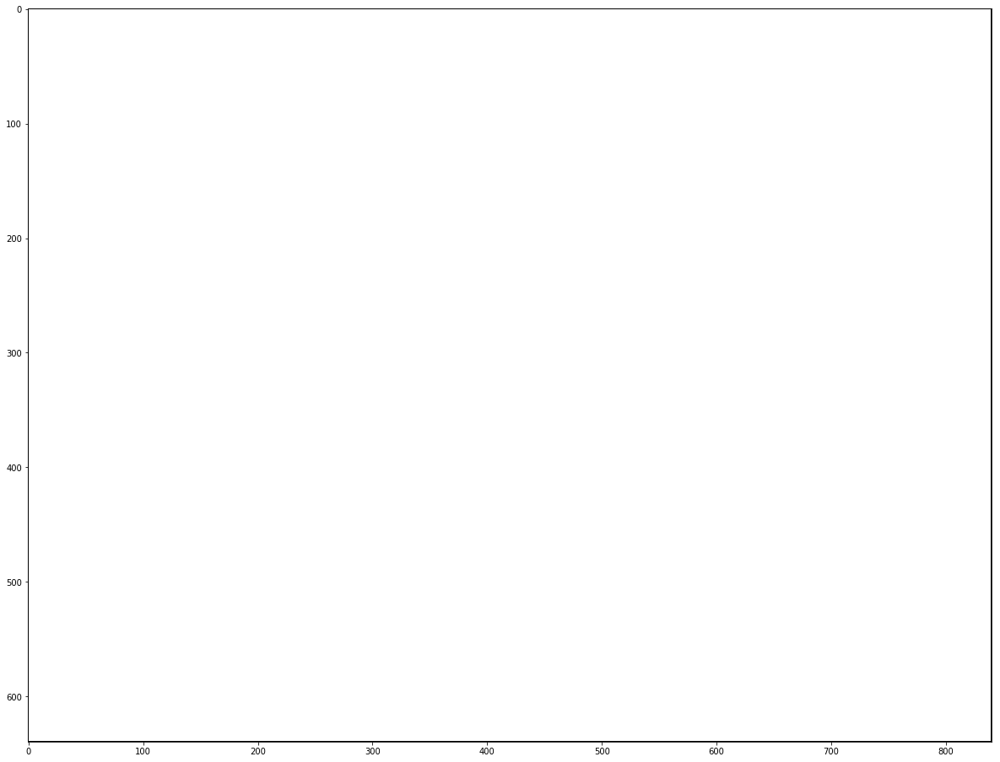

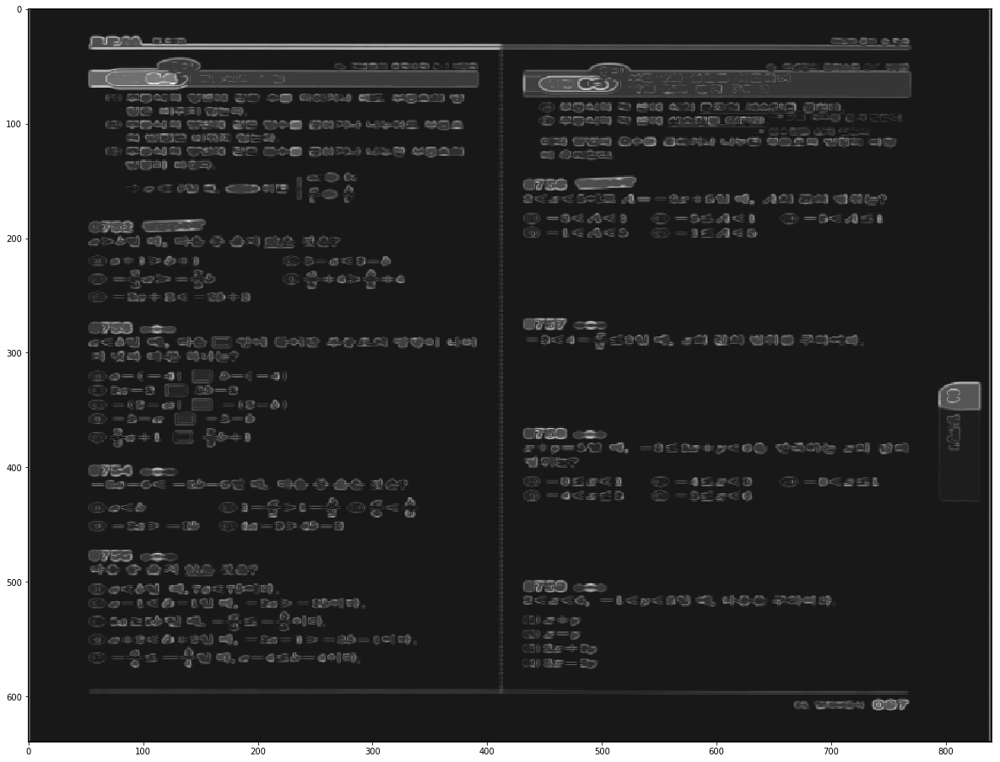

3  Pattern
IMG =  099 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

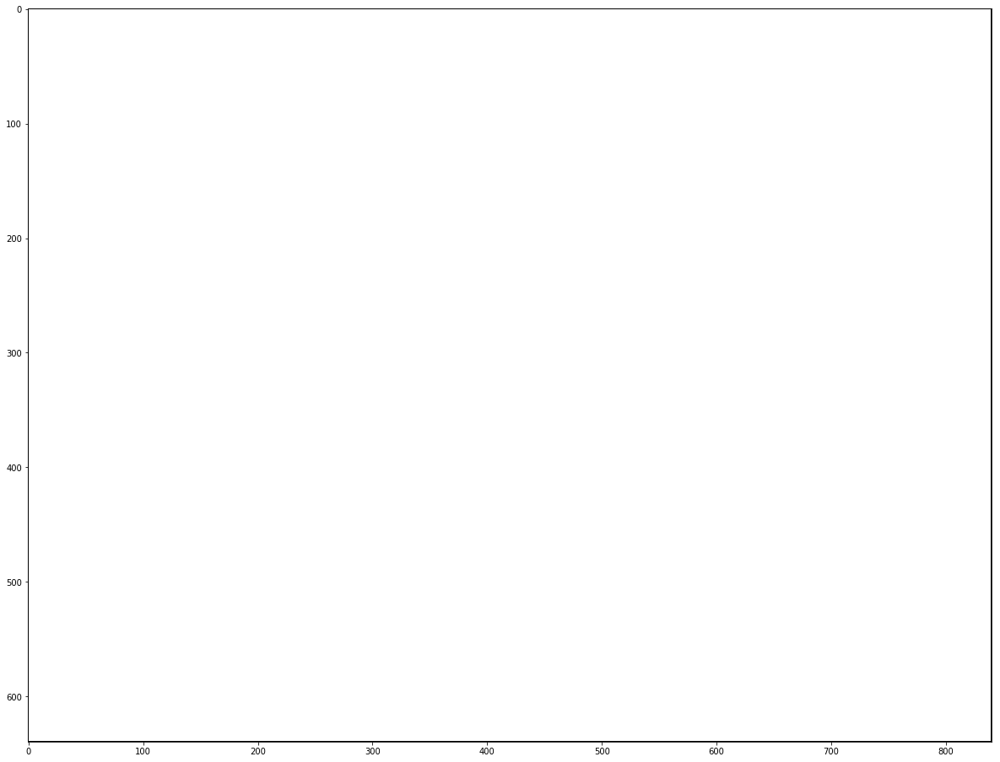

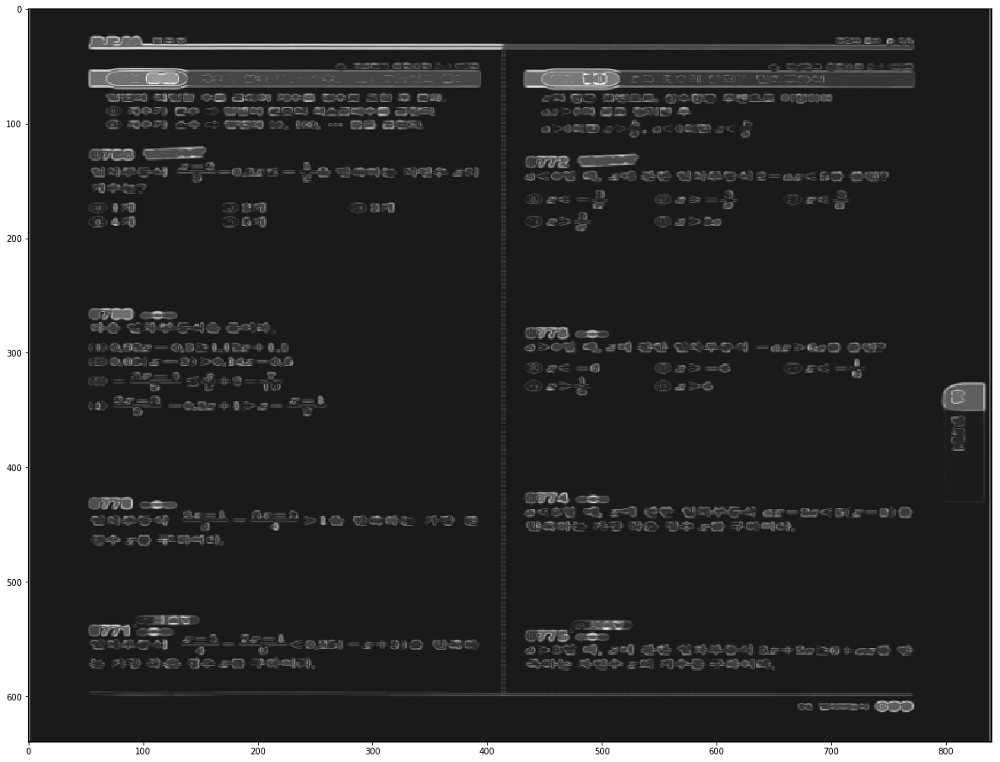

0  Pattern
IMG =  100 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

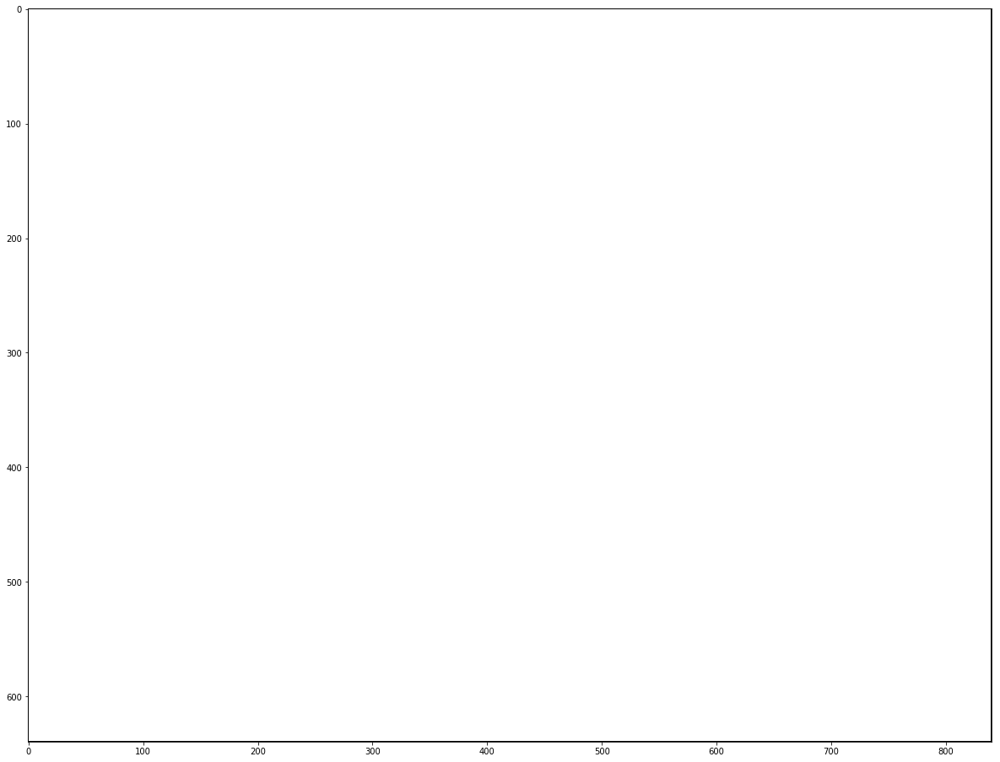

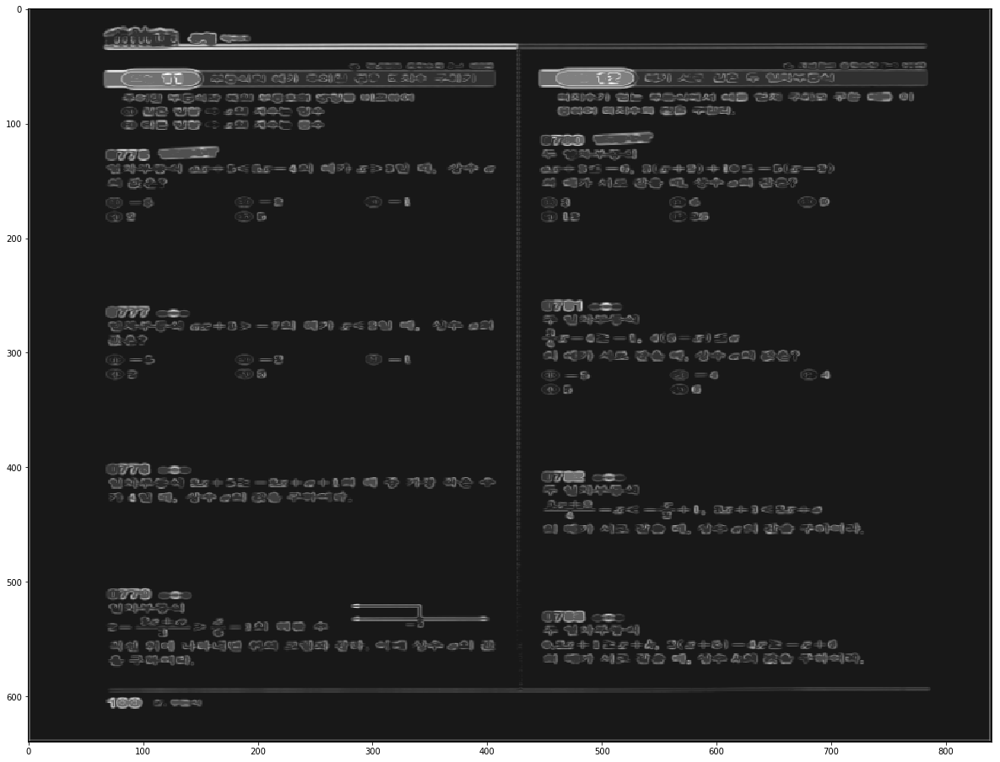

2  Pattern
IMG =  102 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

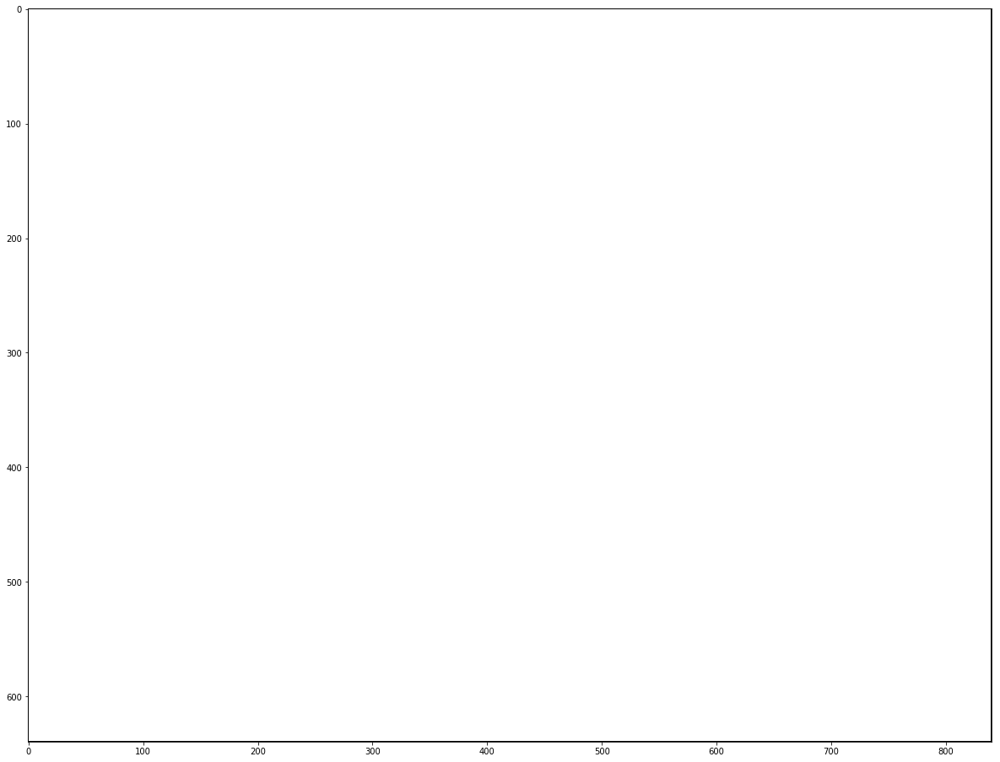

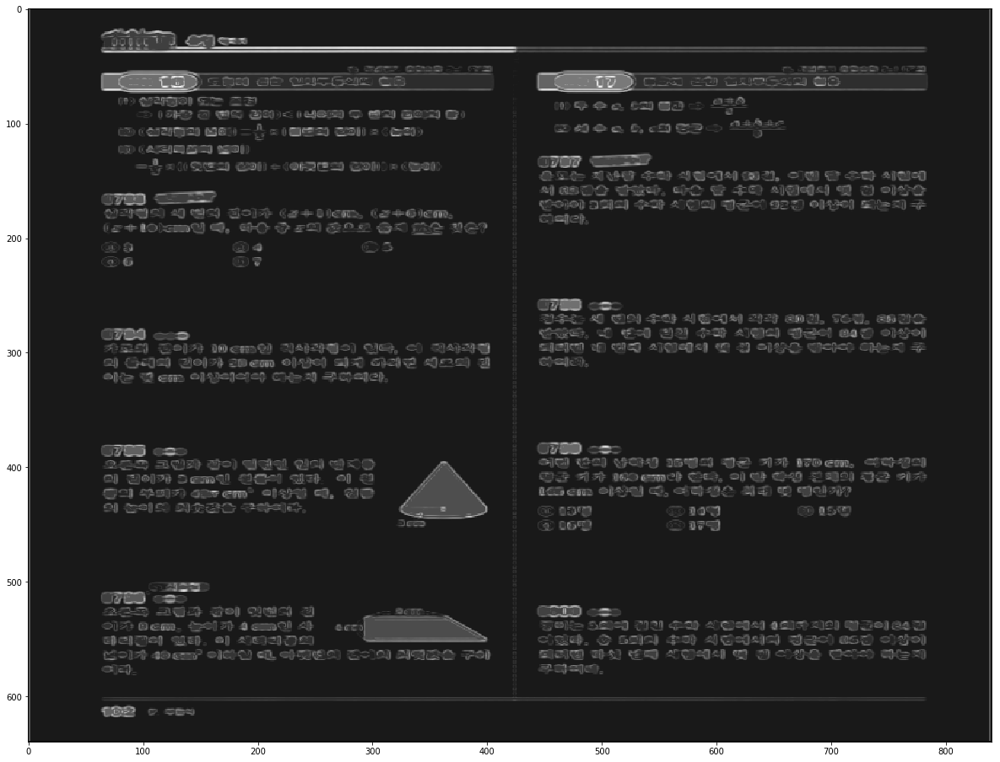

1  Pattern
IMG =  103 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

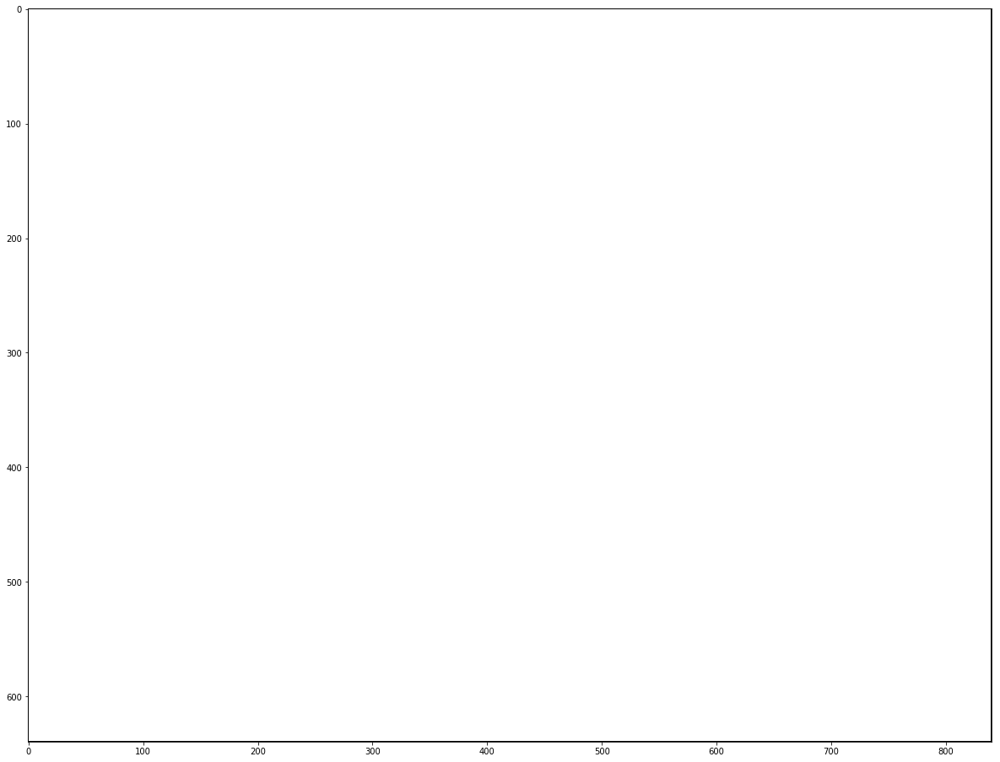

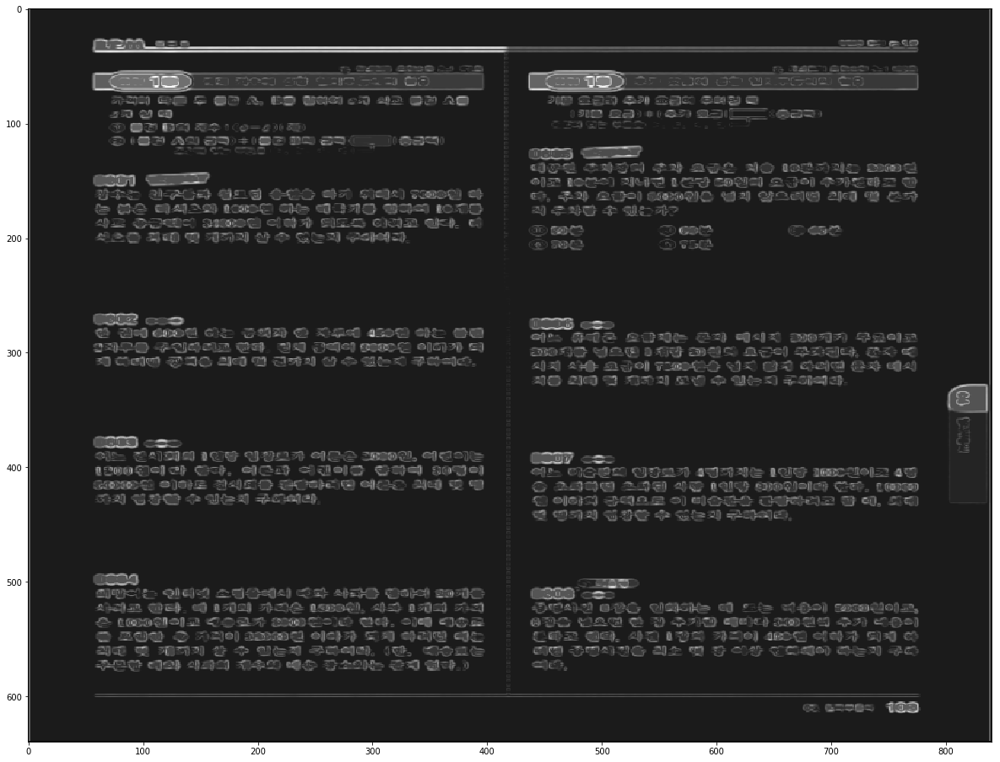

1  Pattern
IMG =  104 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

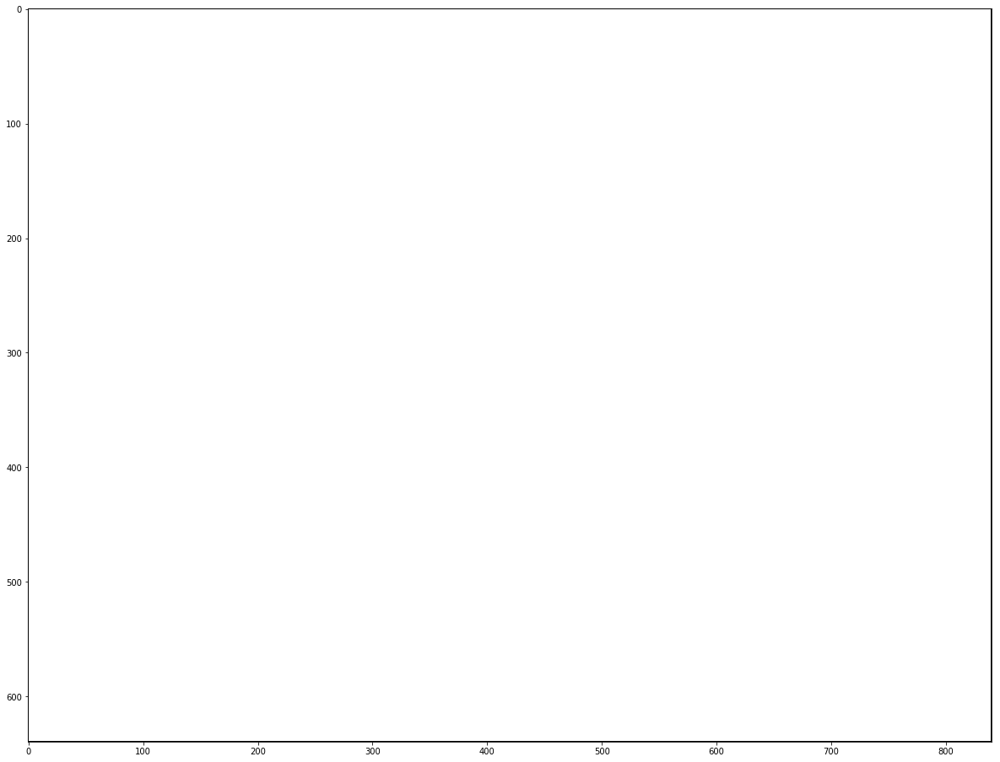

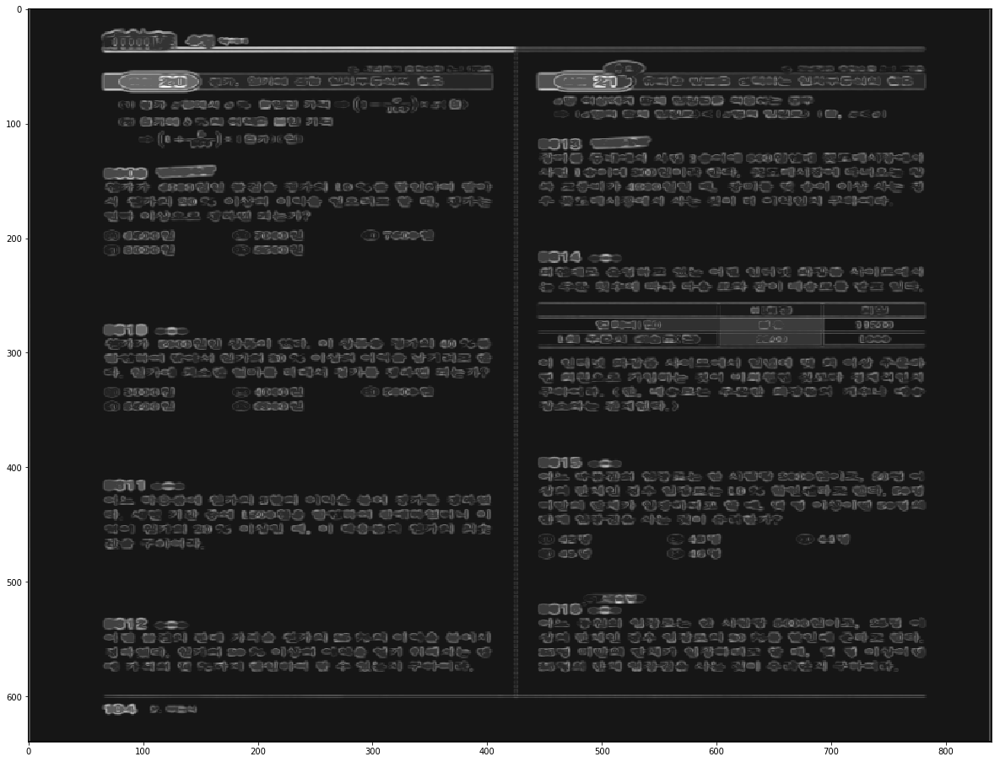

2  Pattern
IMG =  105 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

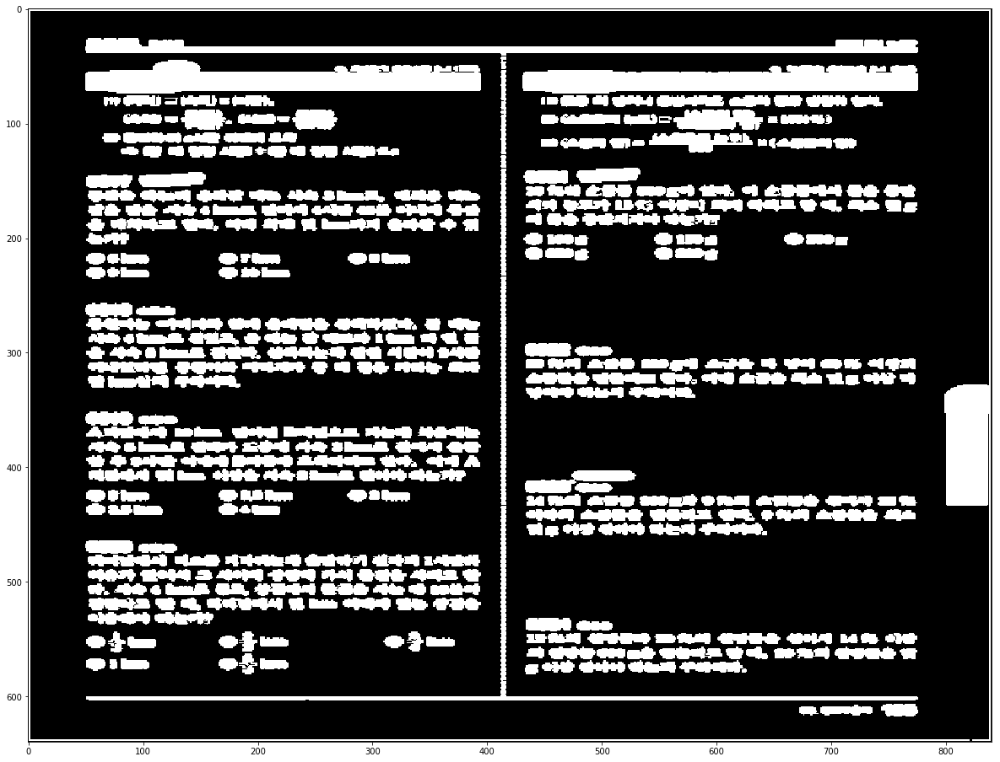

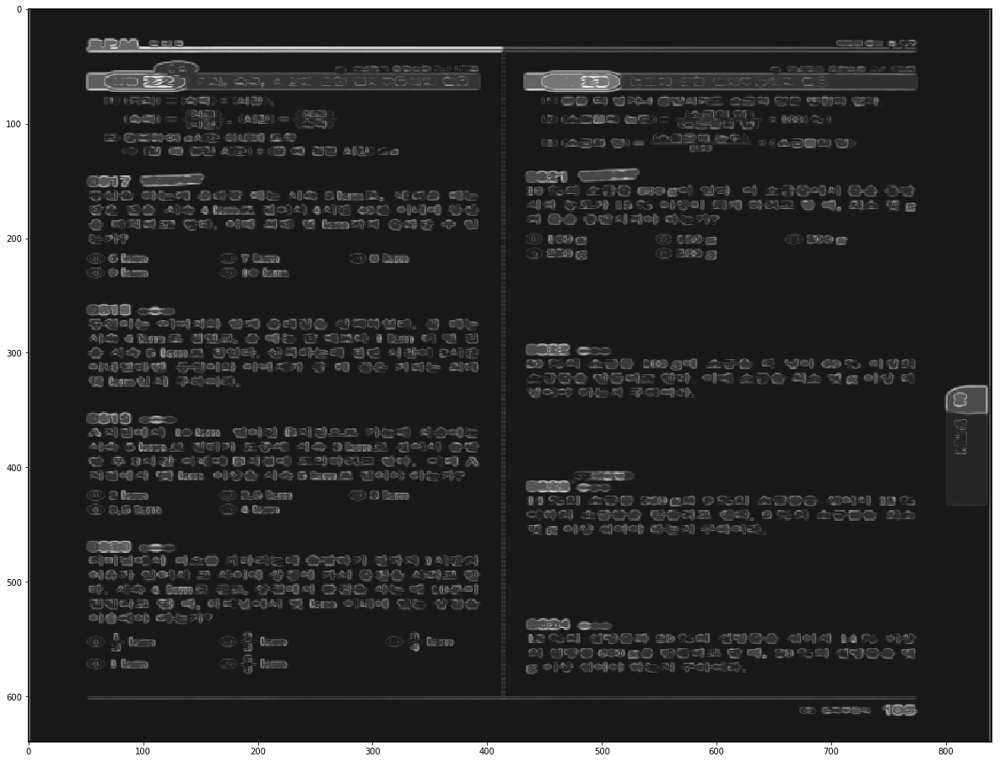

0  Pattern
IMG =  114 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

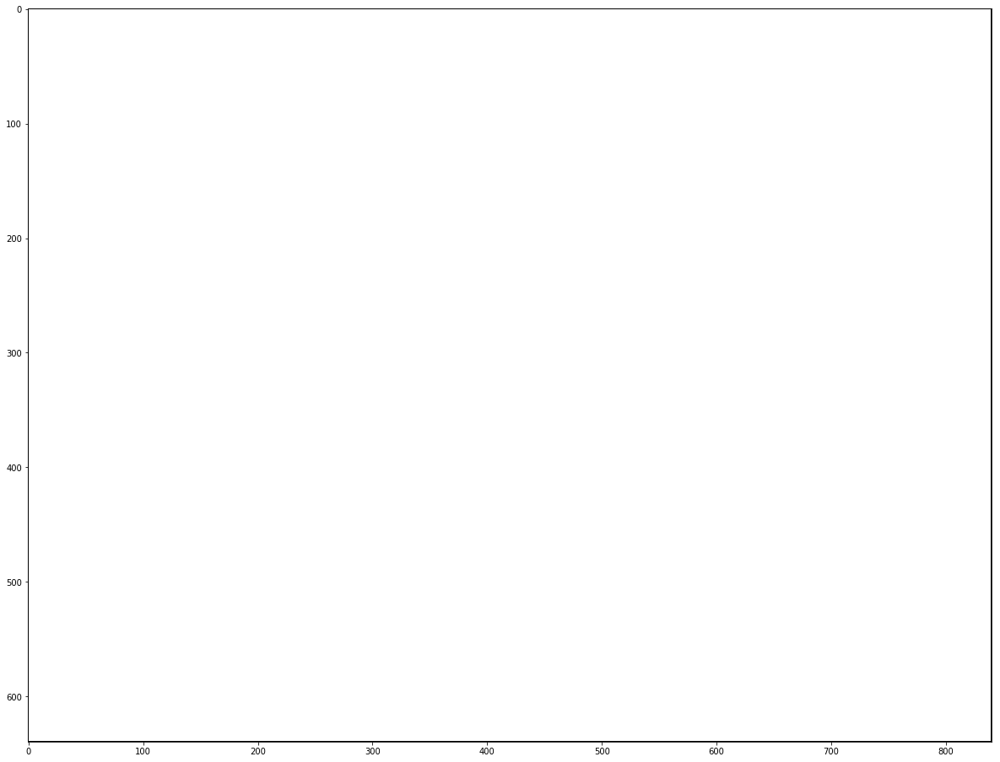

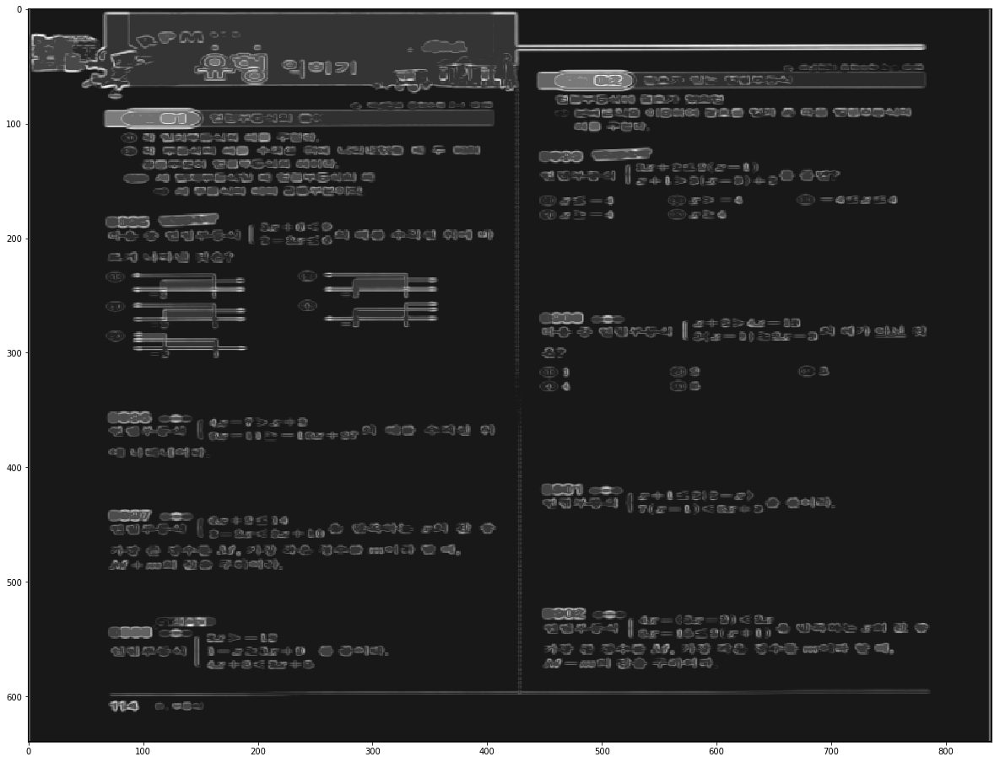

3  Pattern
IMG =  115 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

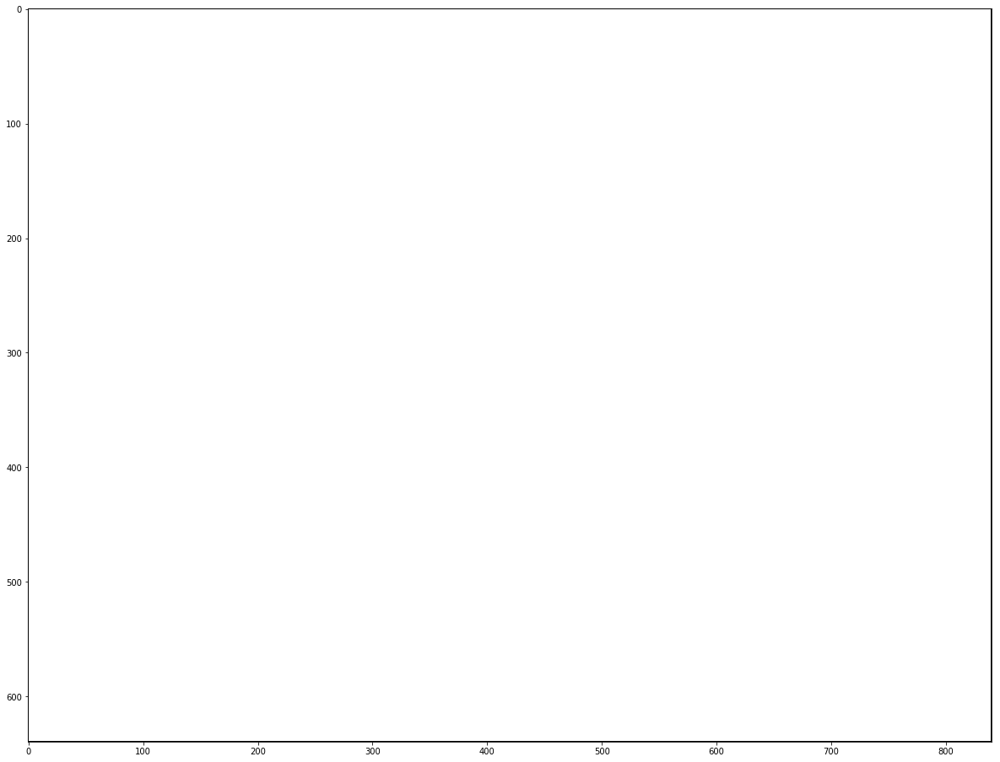

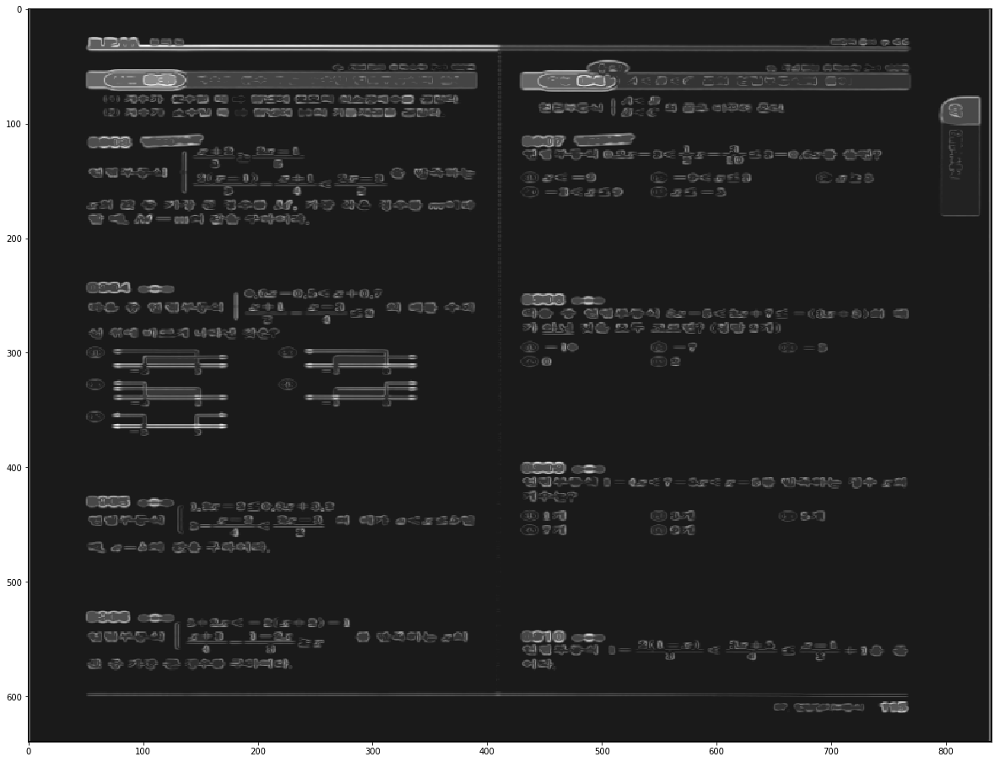

3  Pattern
IMG =  116 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

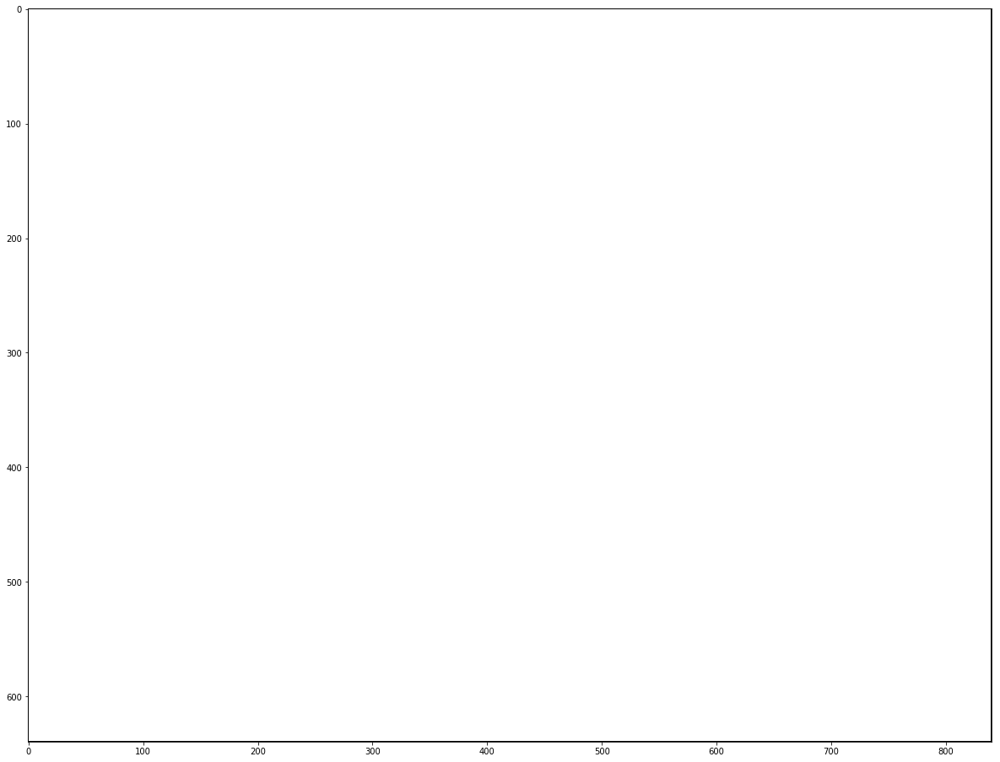

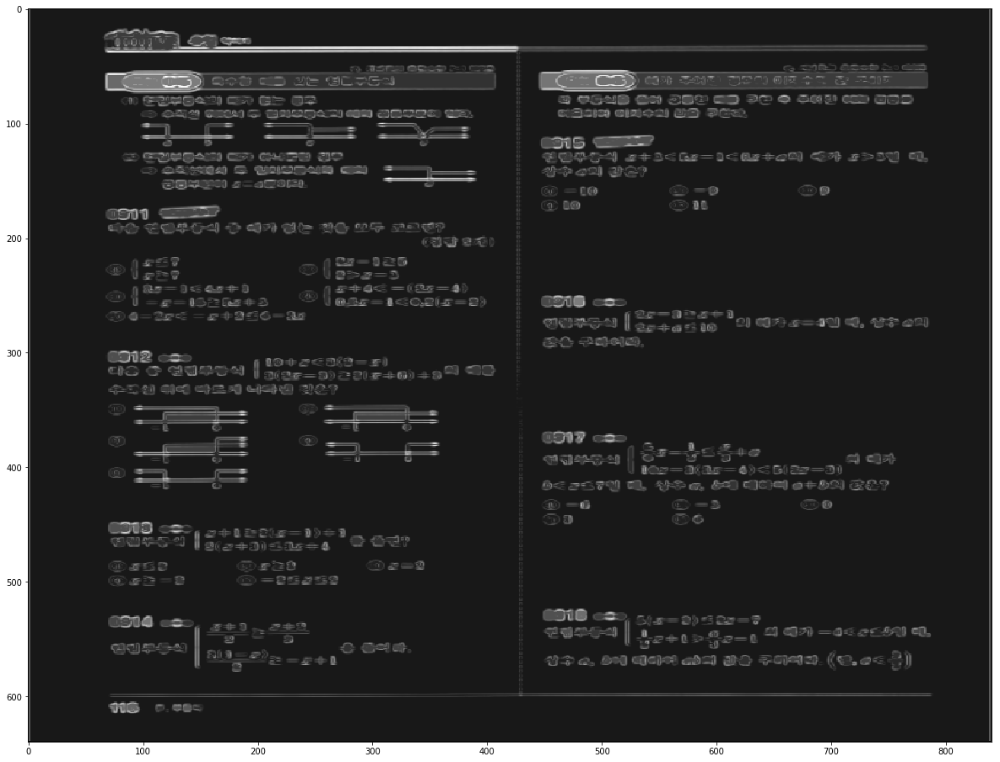

0  Pattern
IMG =  117 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

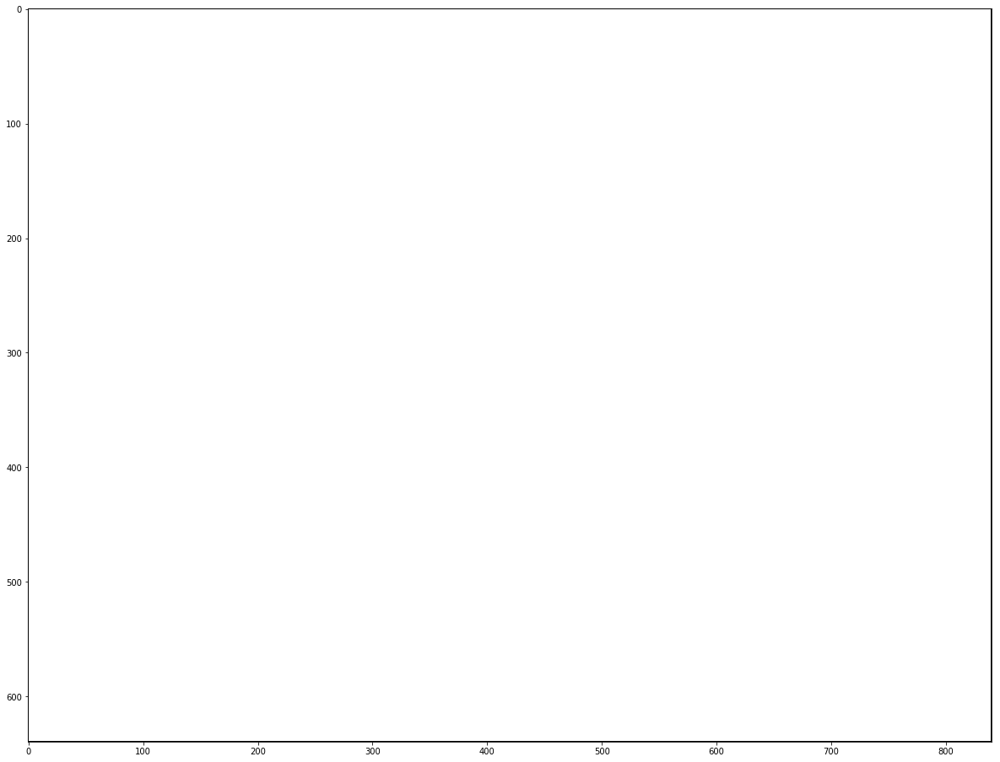

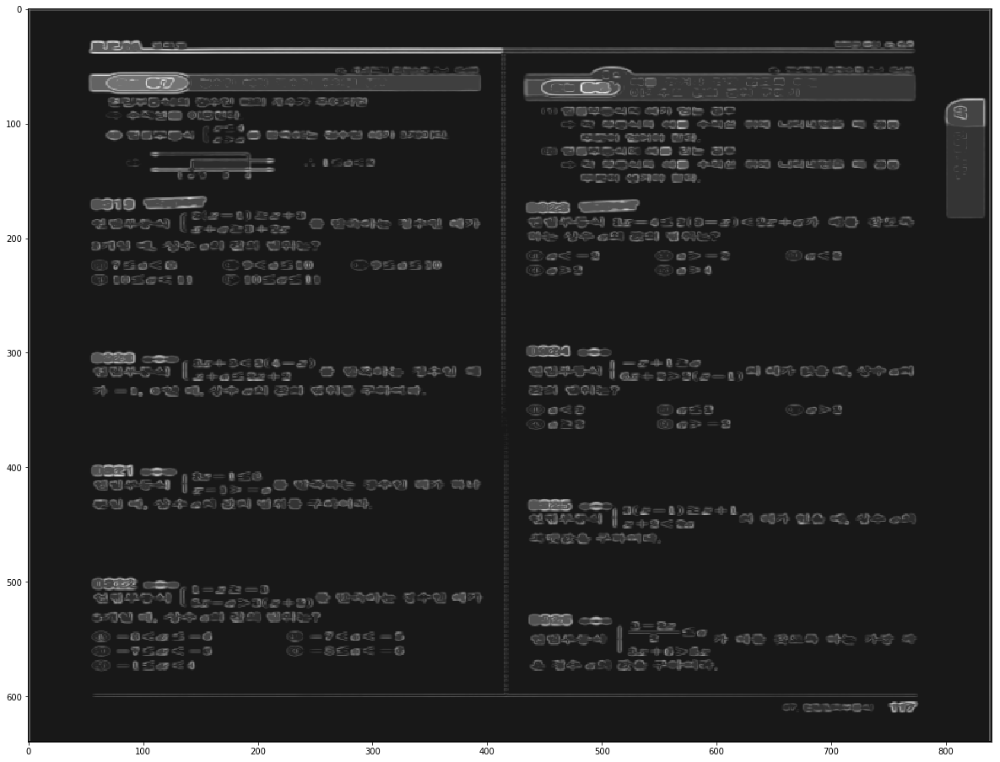

2  Pattern
IMG =  118 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

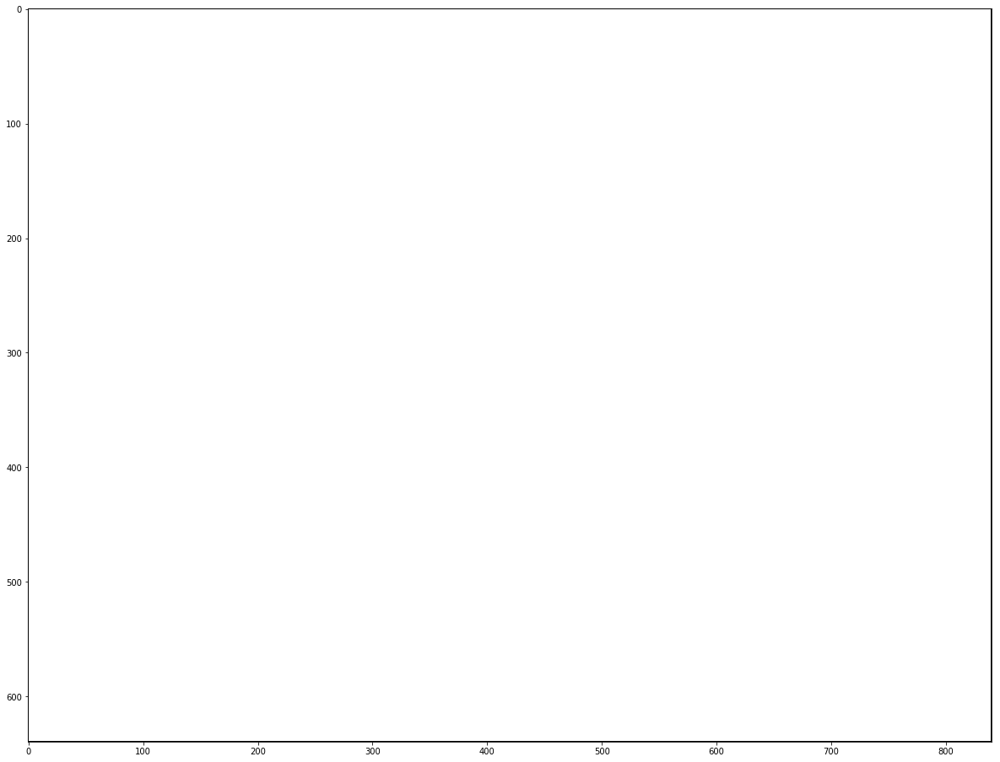

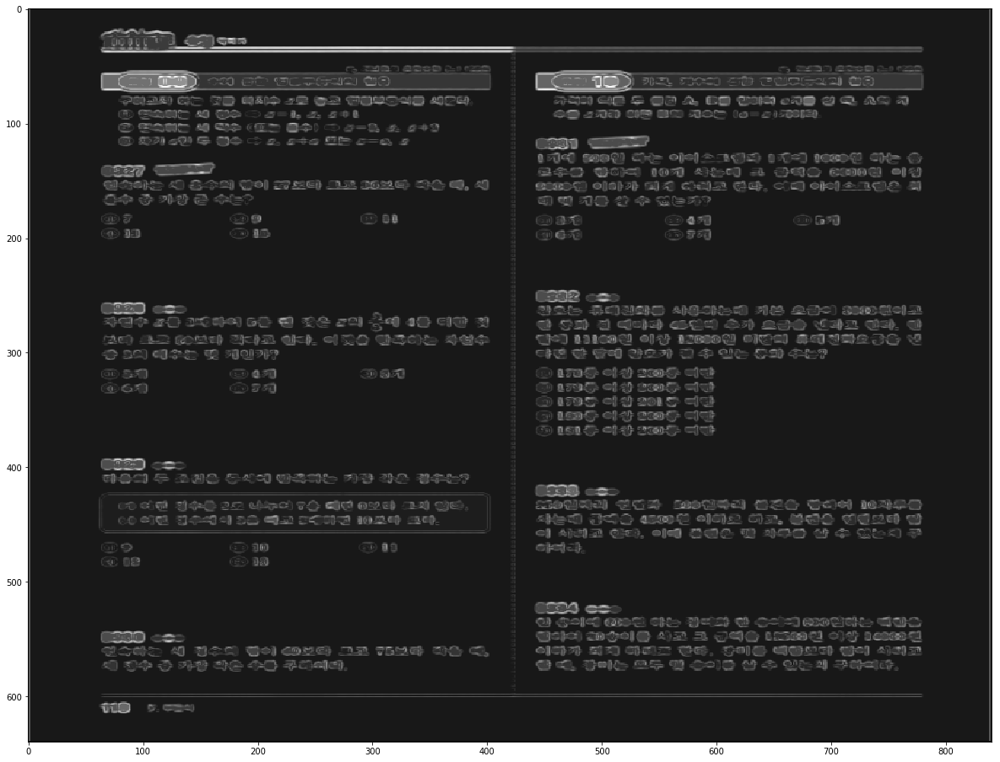

1  Pattern
IMG =  119 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

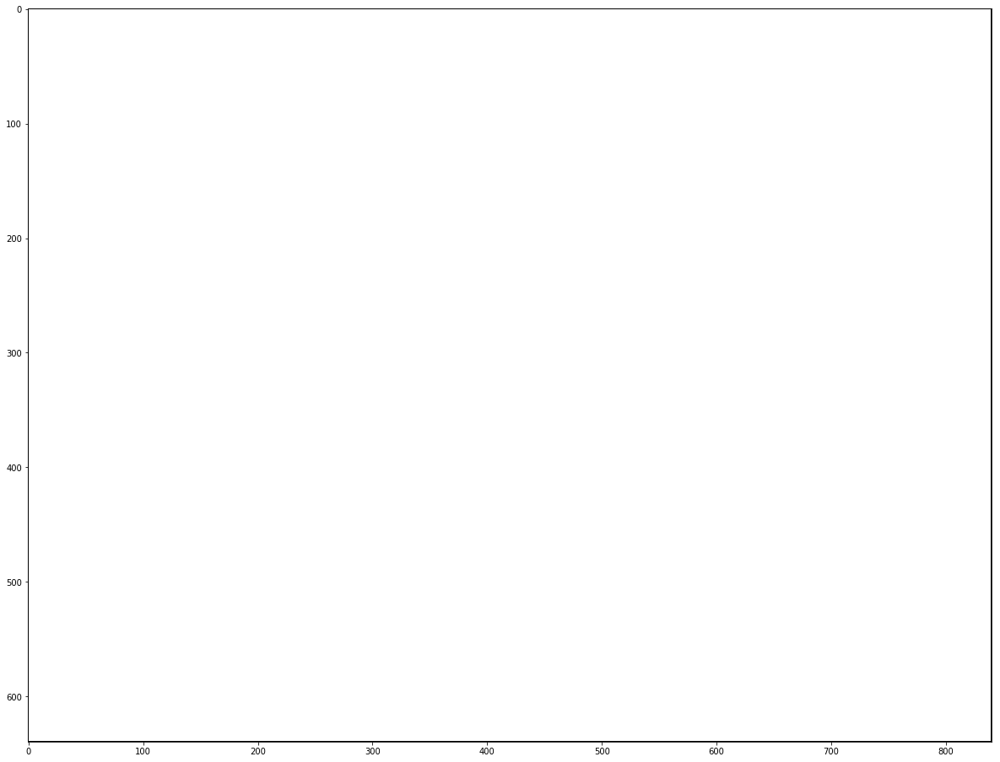

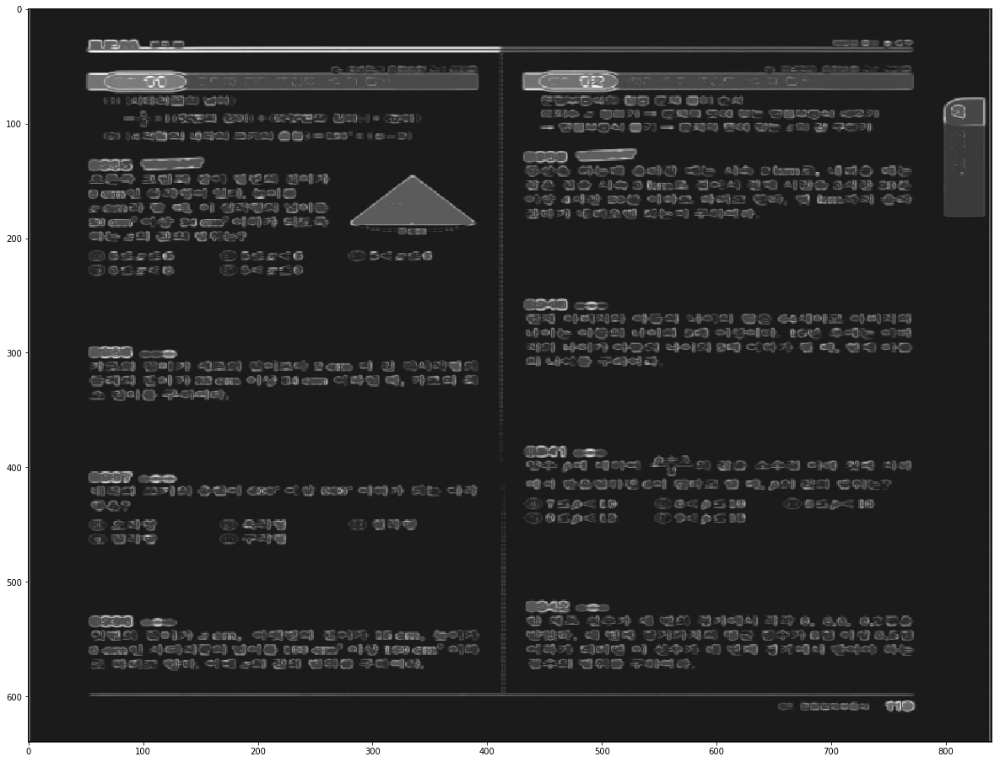

1  Pattern
IMG =  120 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

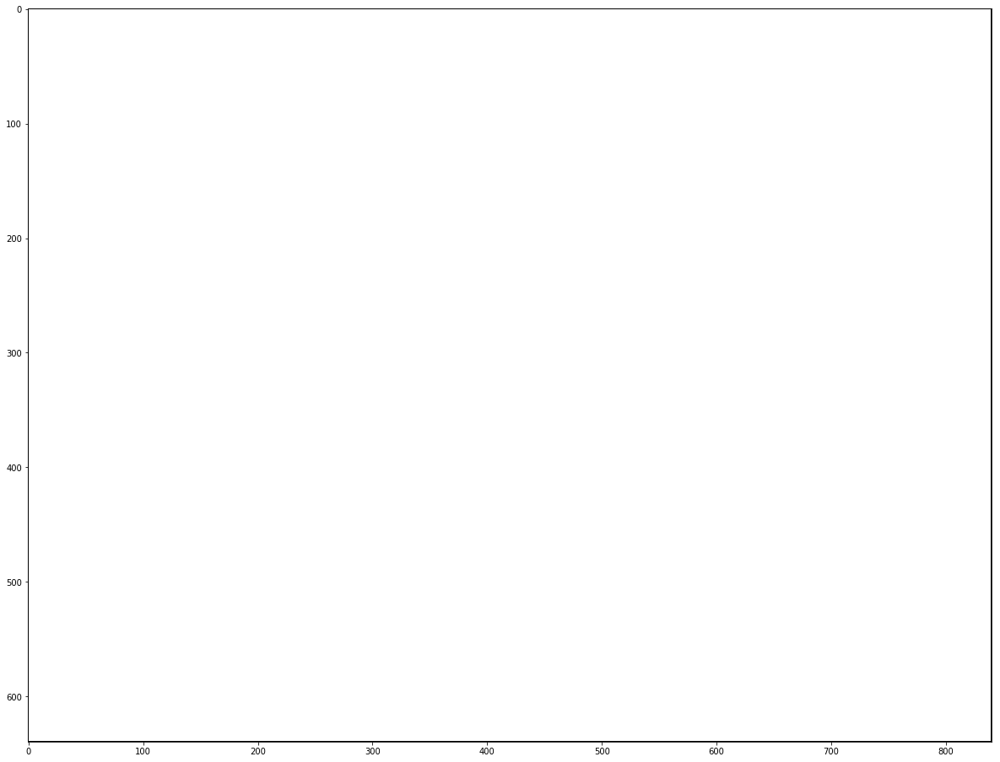

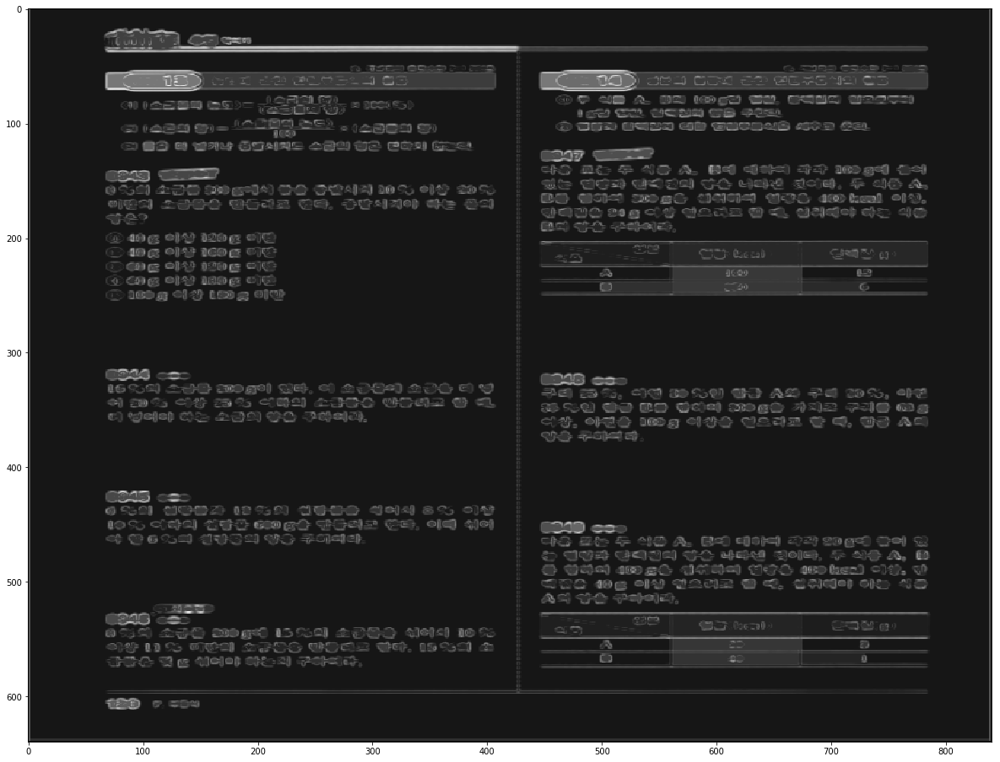

2  Pattern
IMG =  121 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

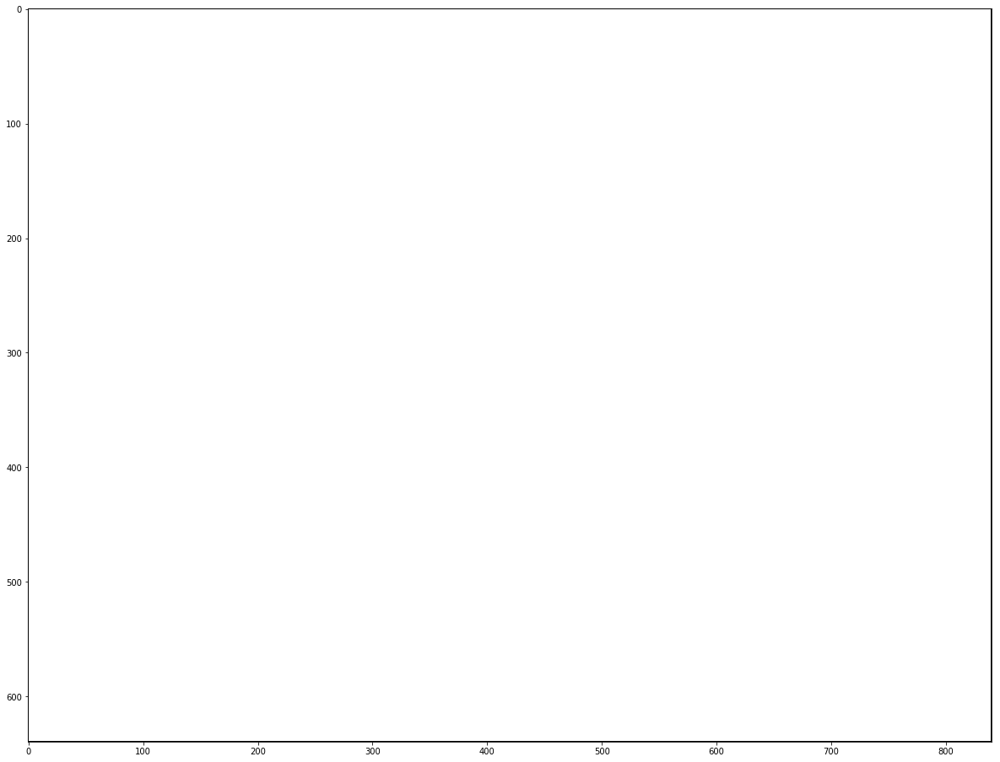

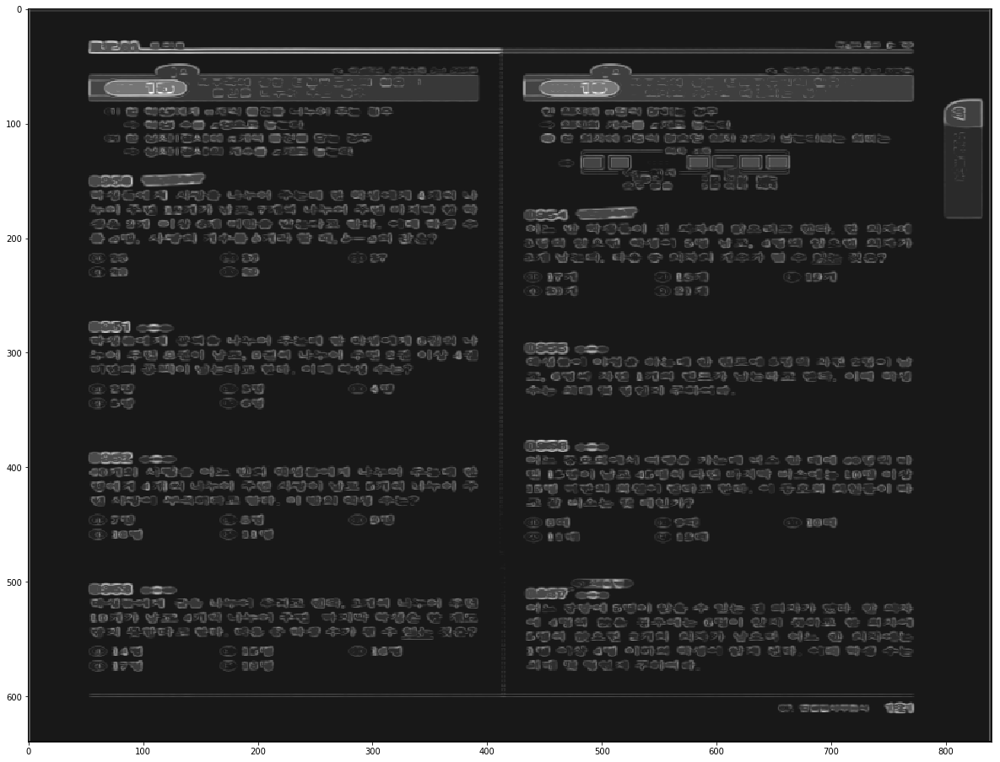

0  Pattern
IMG =  132 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

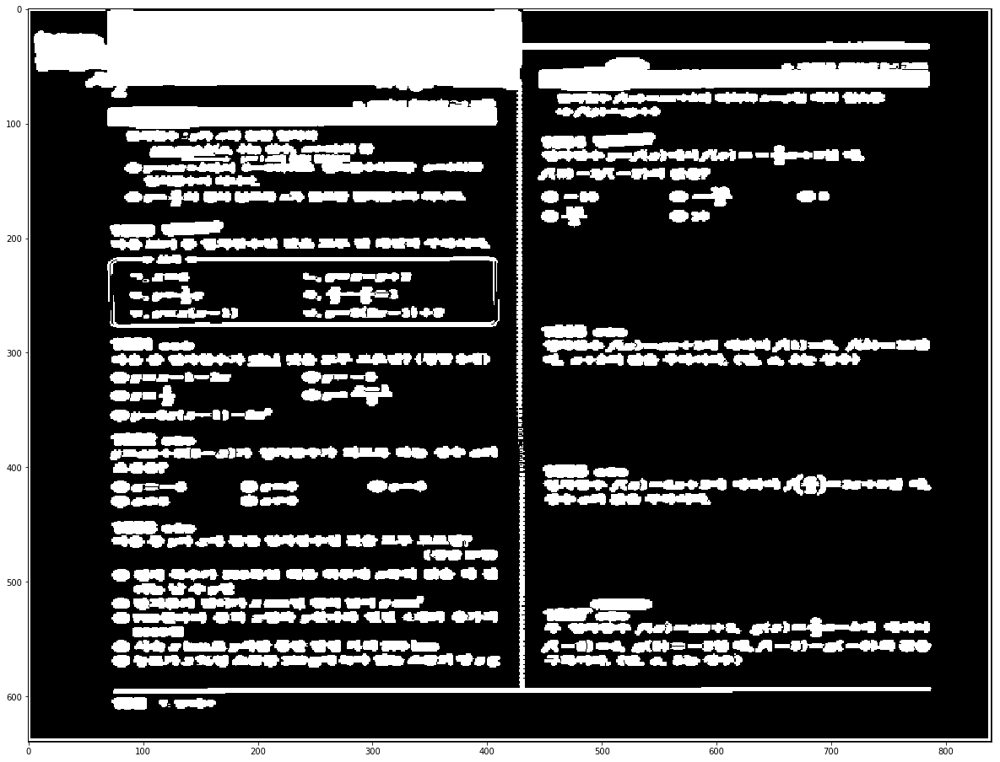

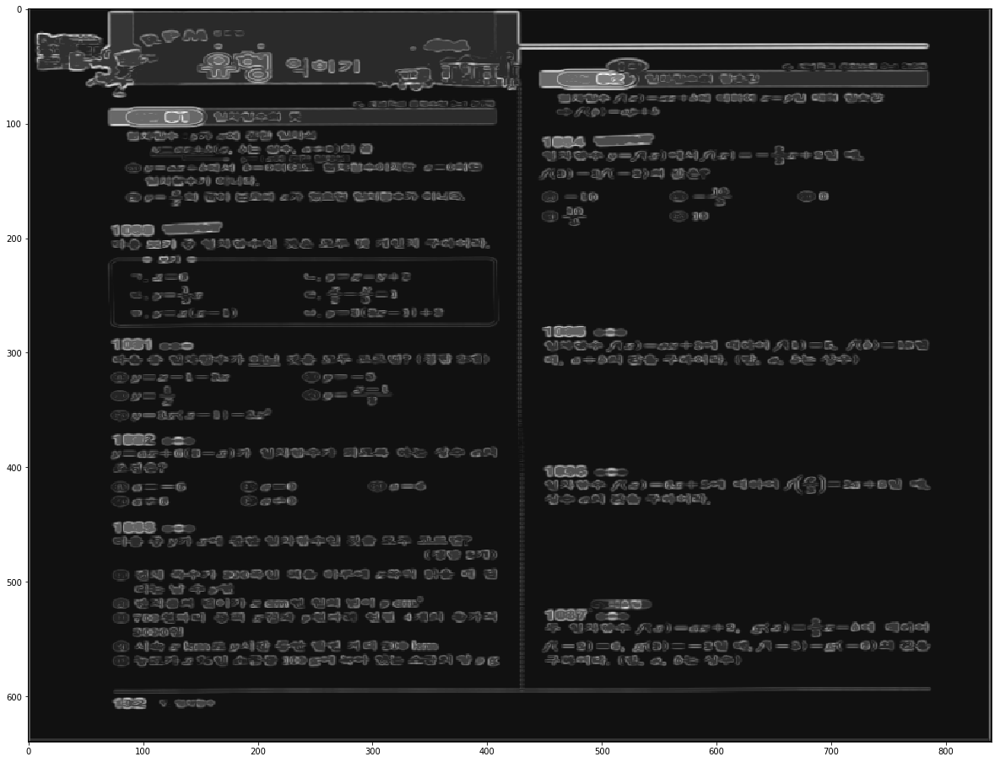

3  Pattern
IMG =  133 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

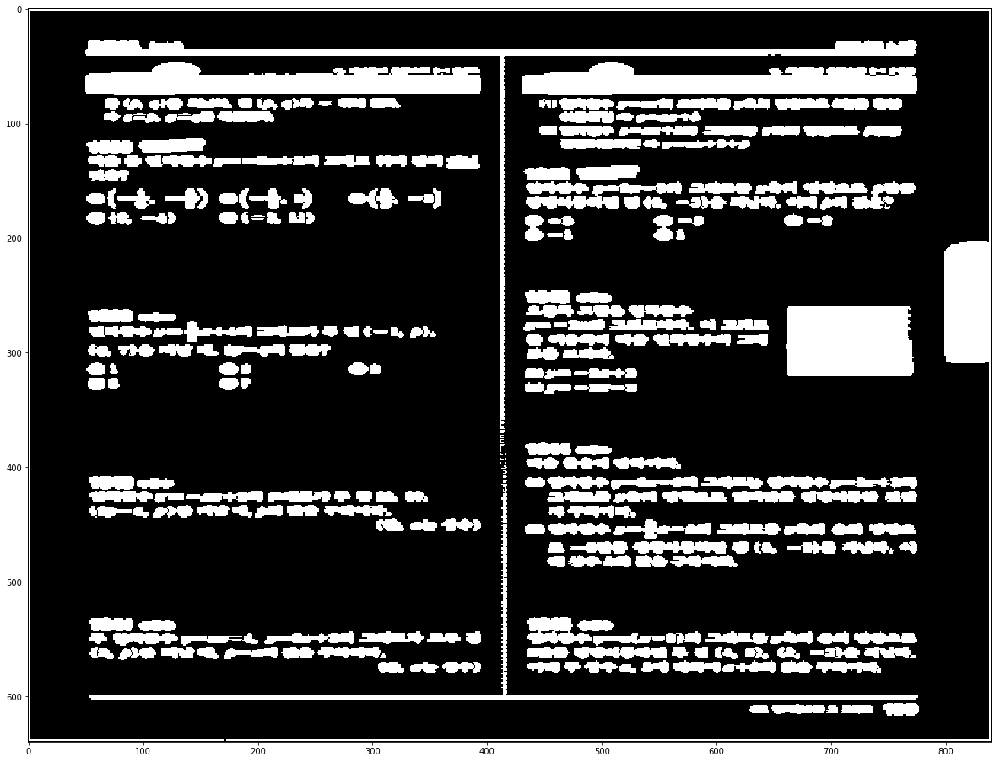

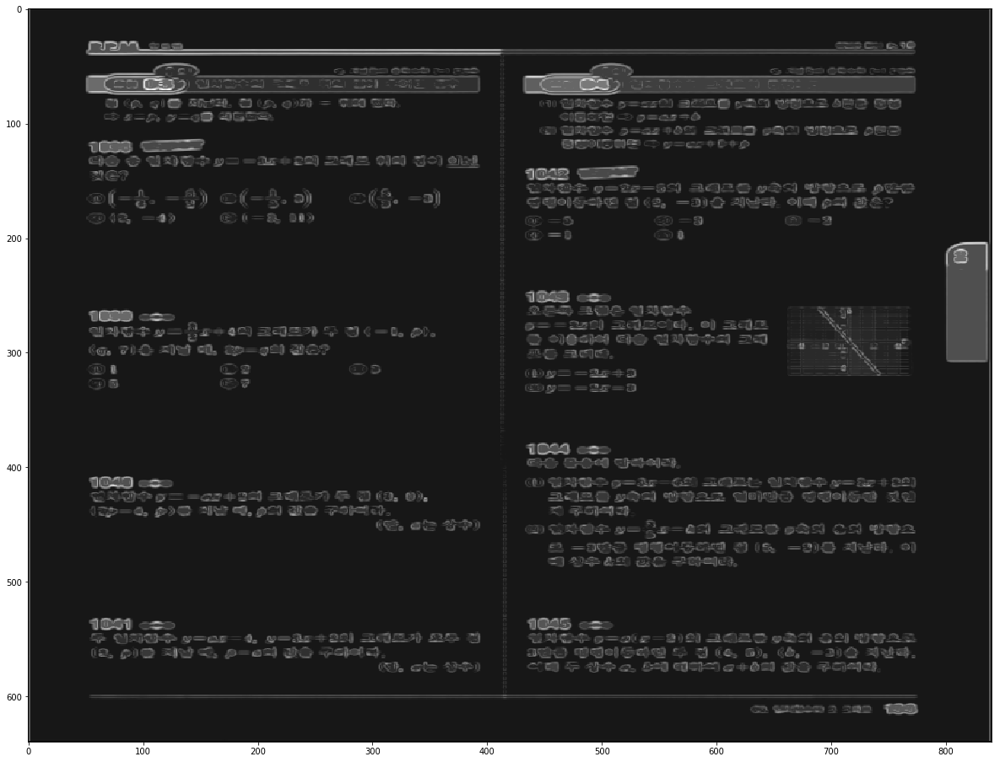

3  Pattern
IMG =  134 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

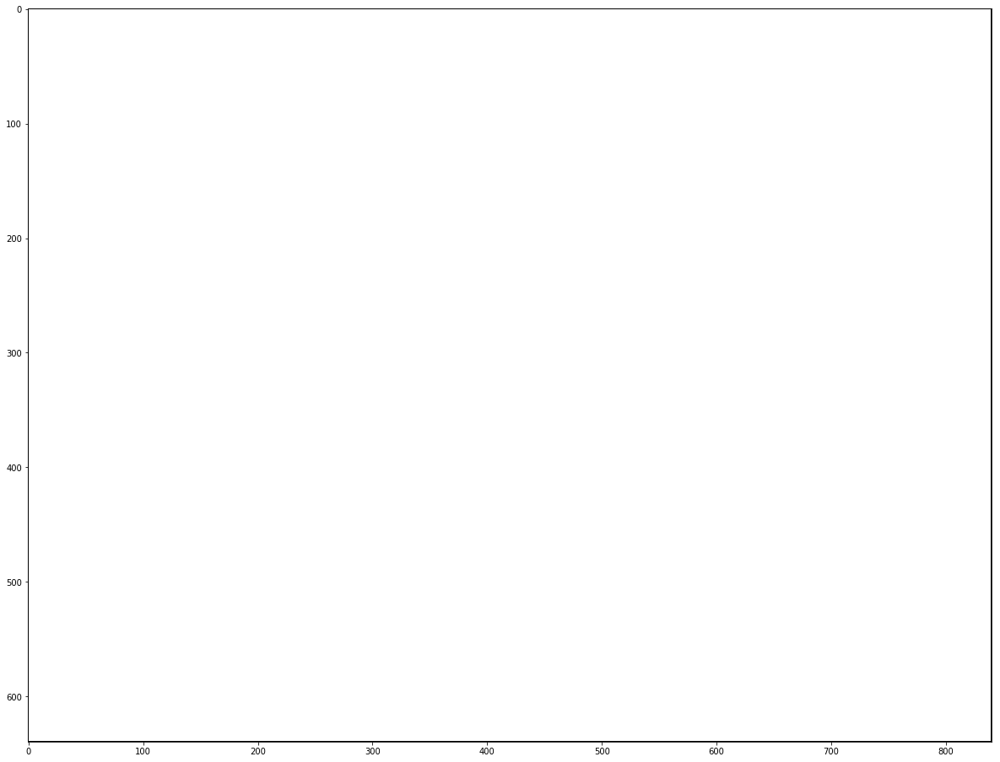

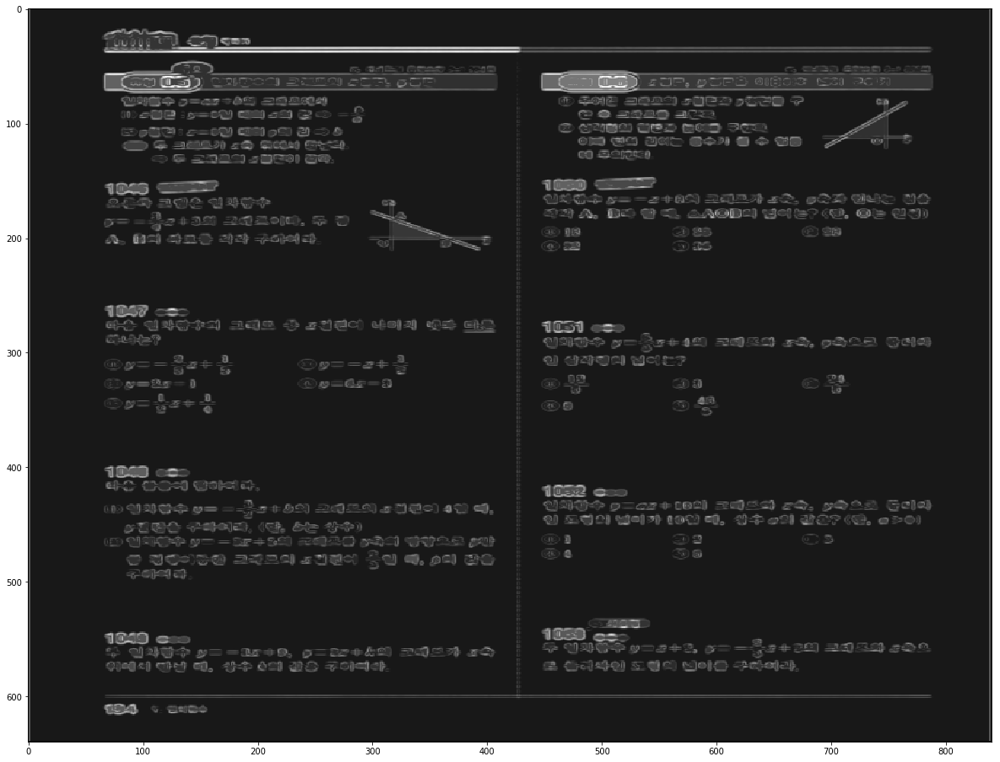

0  Pattern
IMG =  135 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

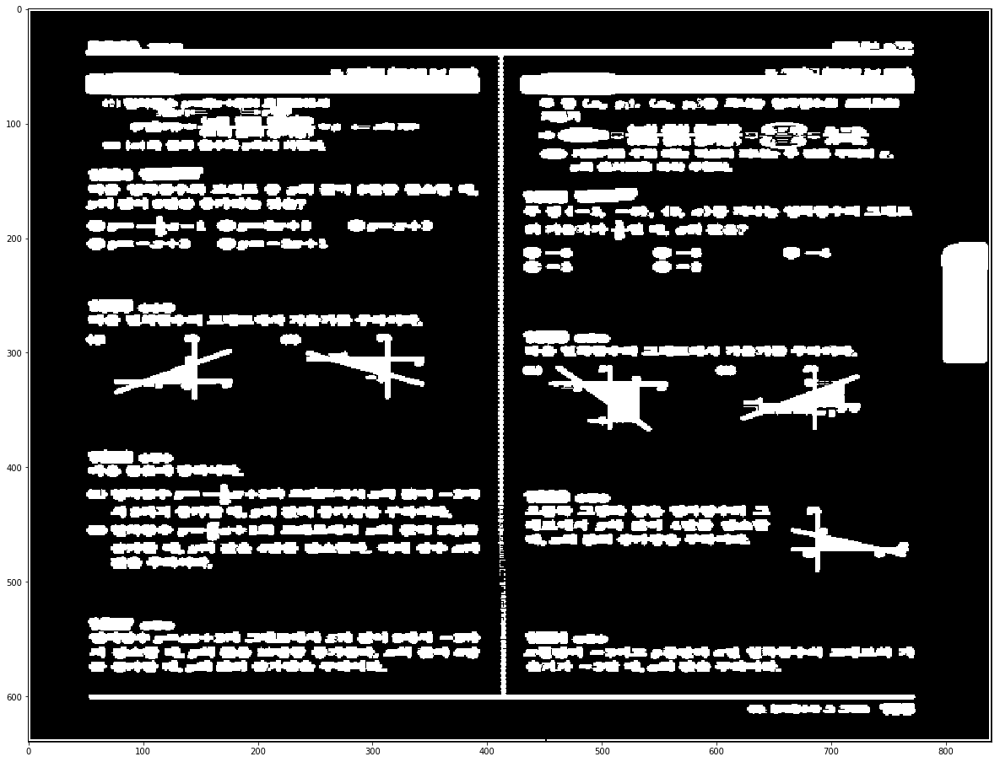

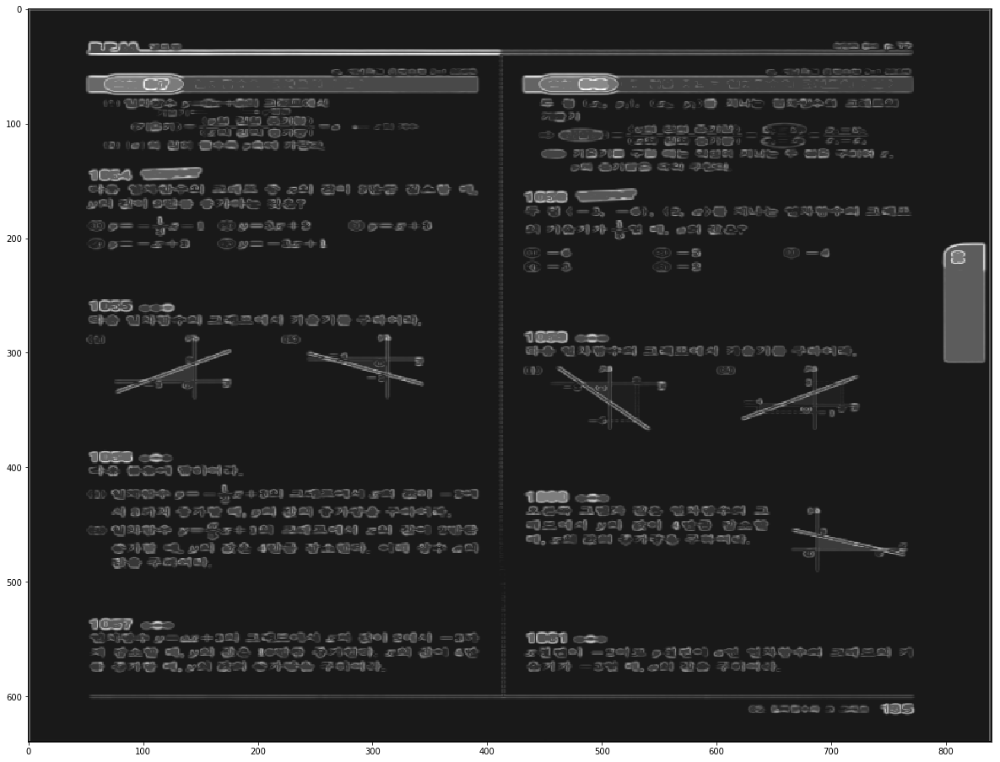

2  Pattern
IMG =  137 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

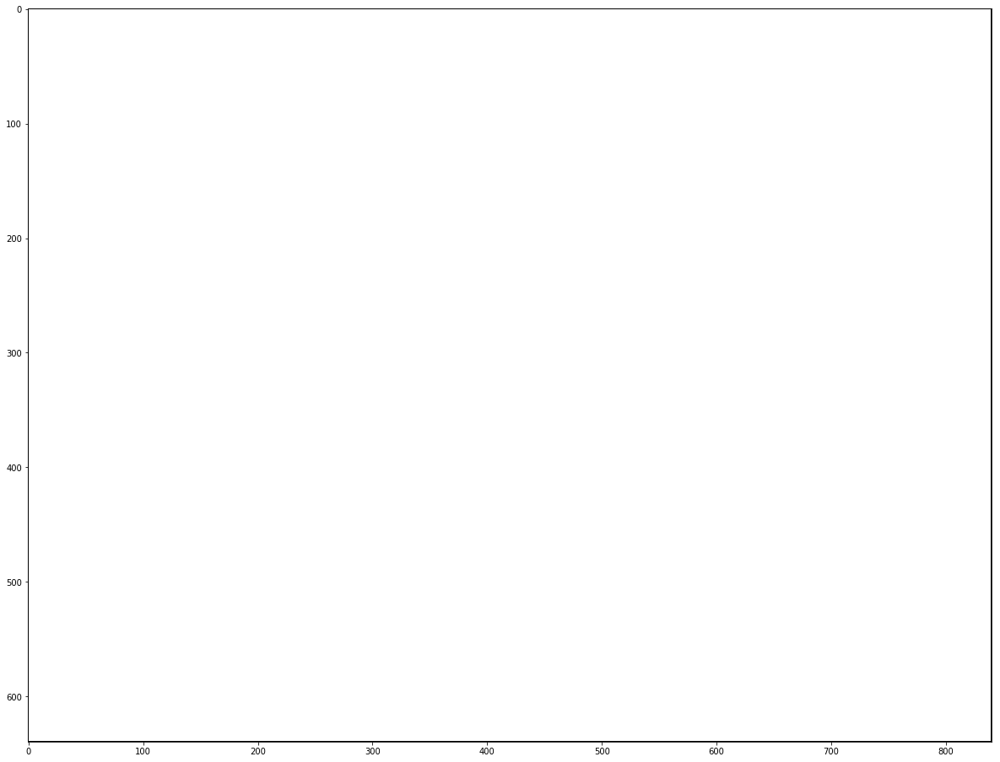

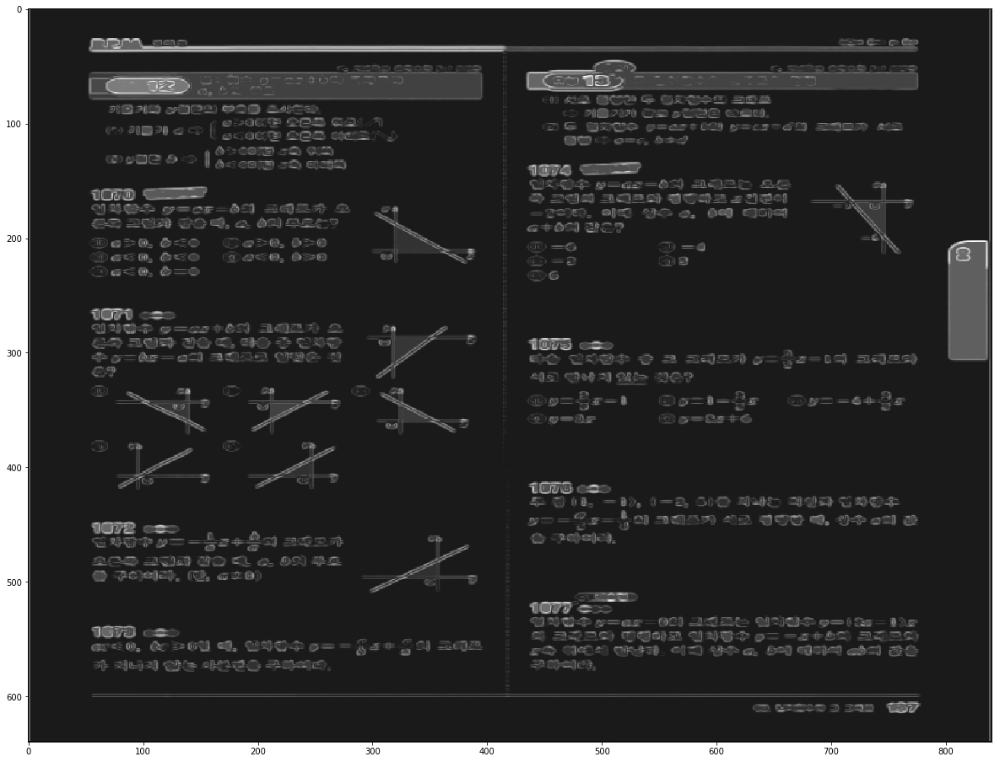

1  Pattern
IMG =  138 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

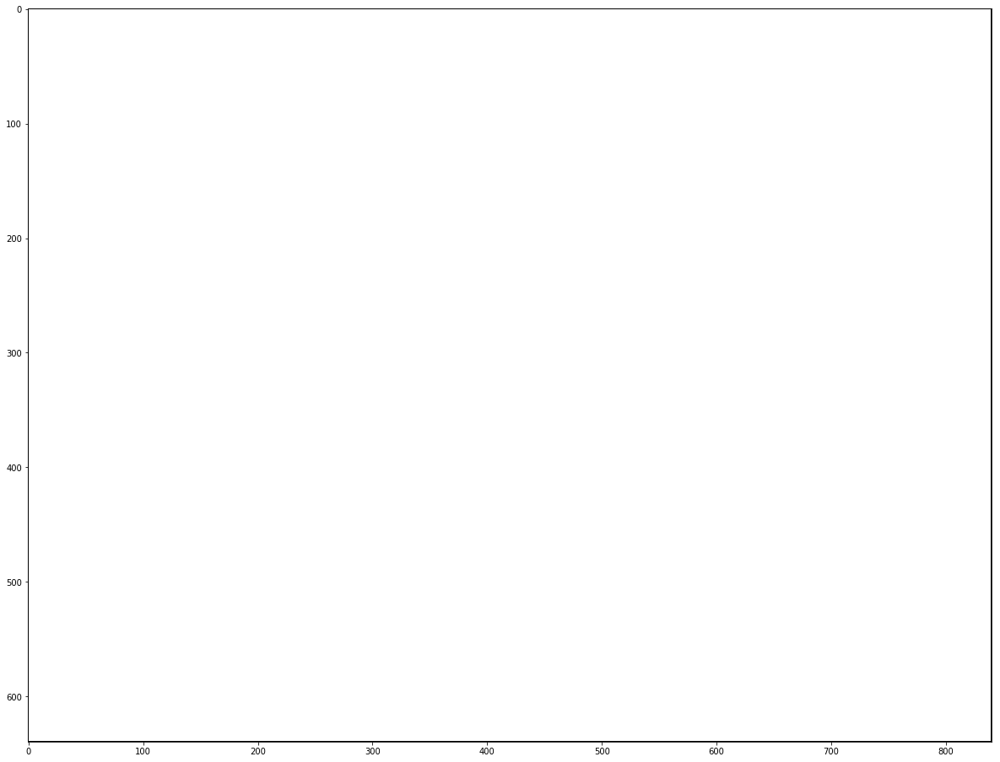

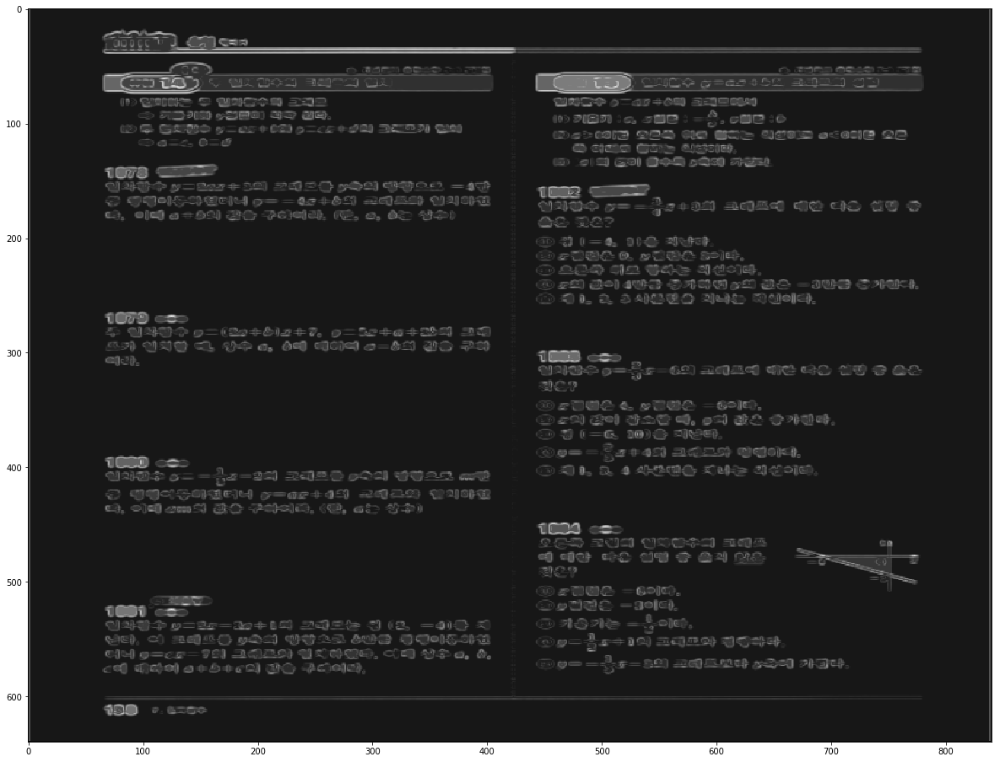

1  Pattern
IMG =  139 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

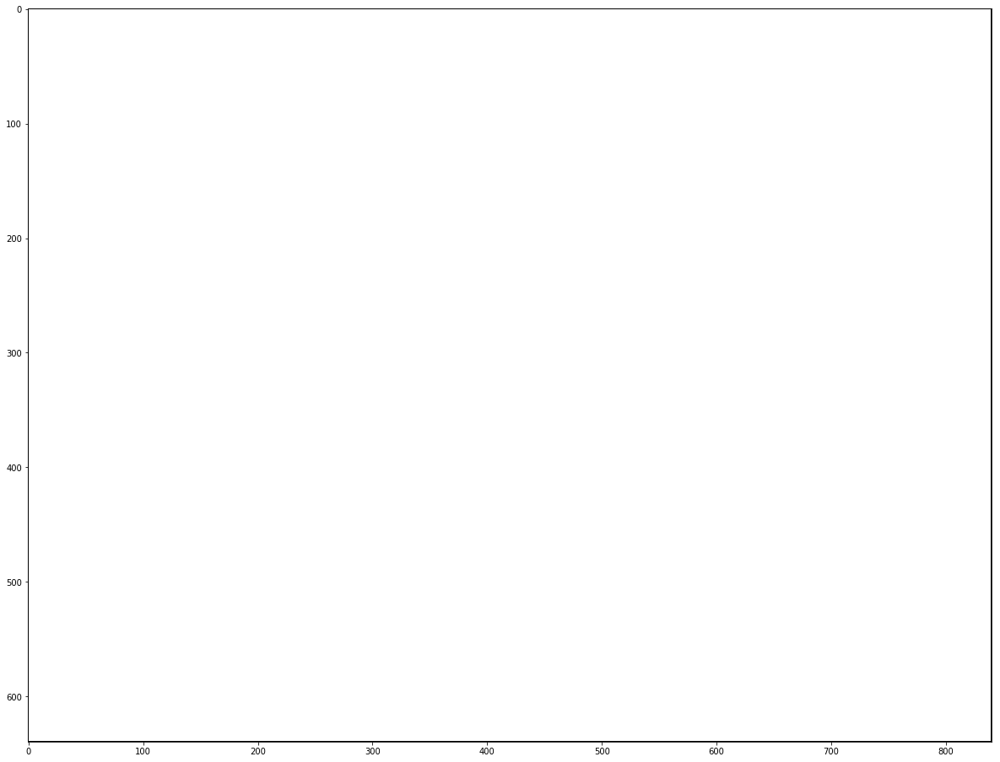

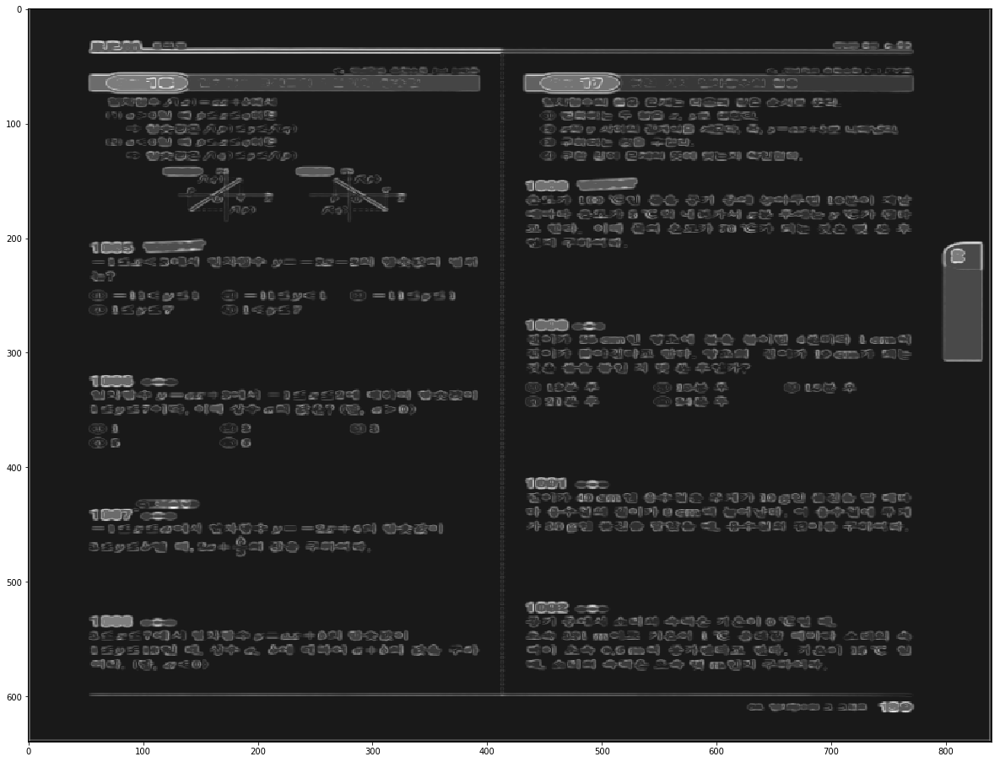

2  Pattern
IMG =  140 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

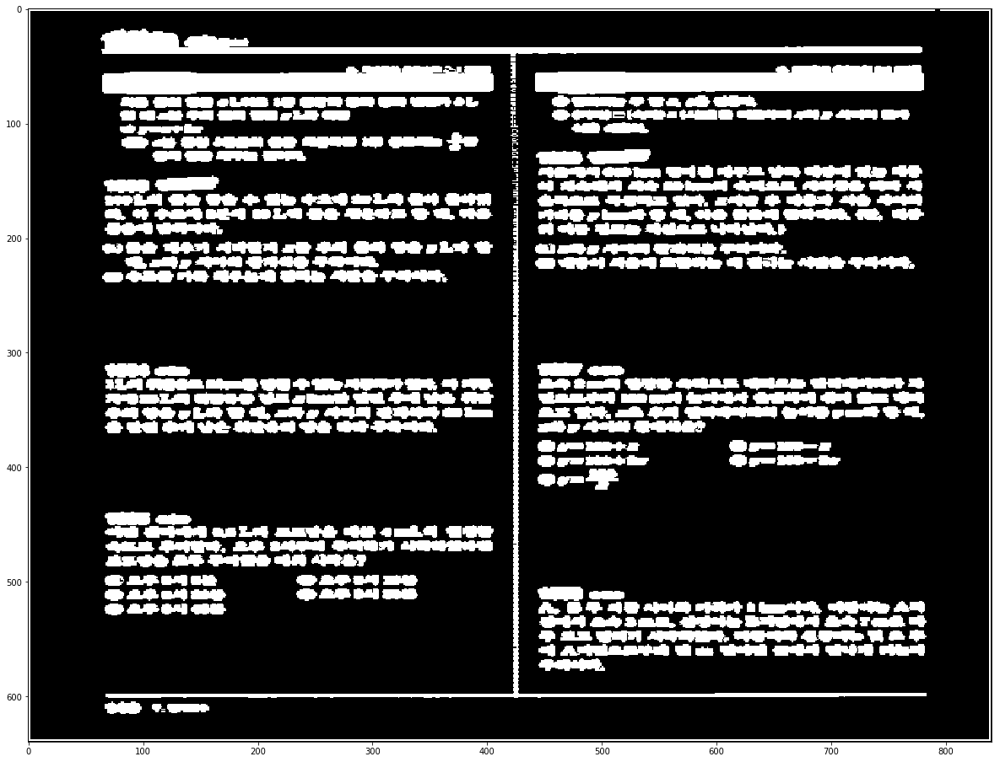

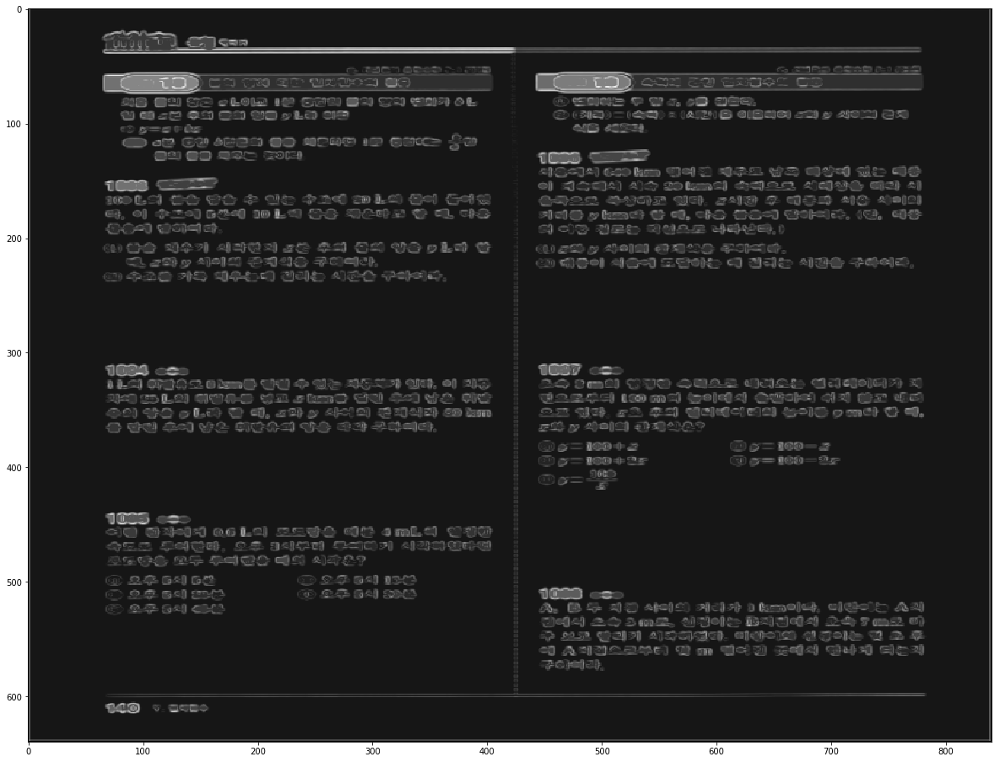

0  Pattern
IMG =  141 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

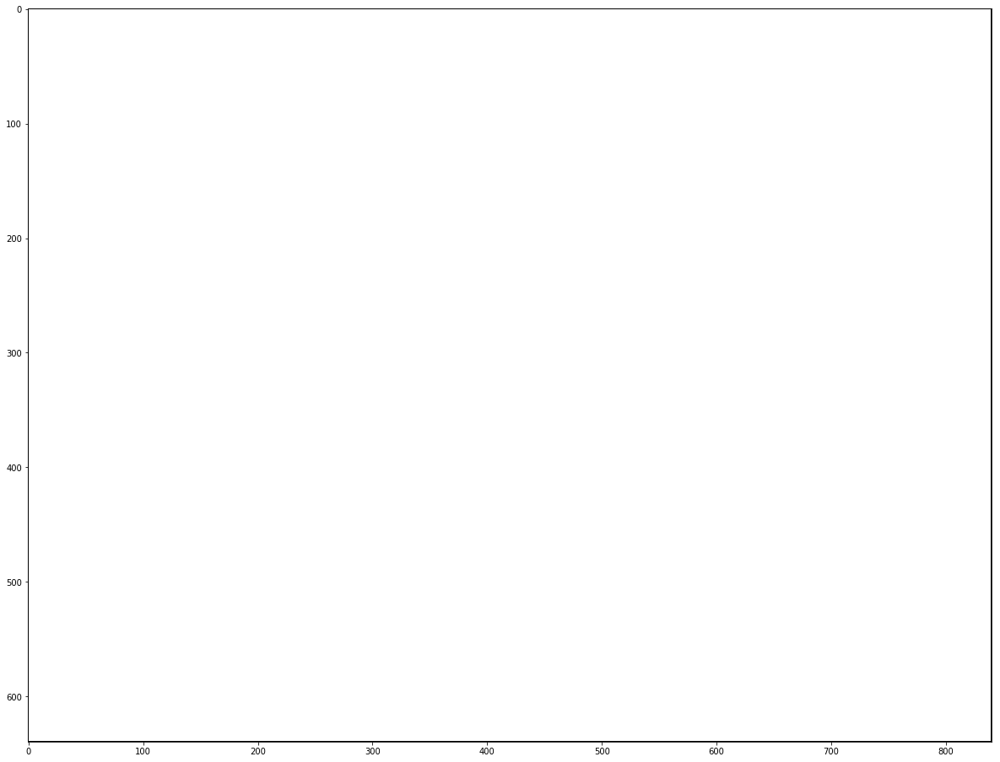

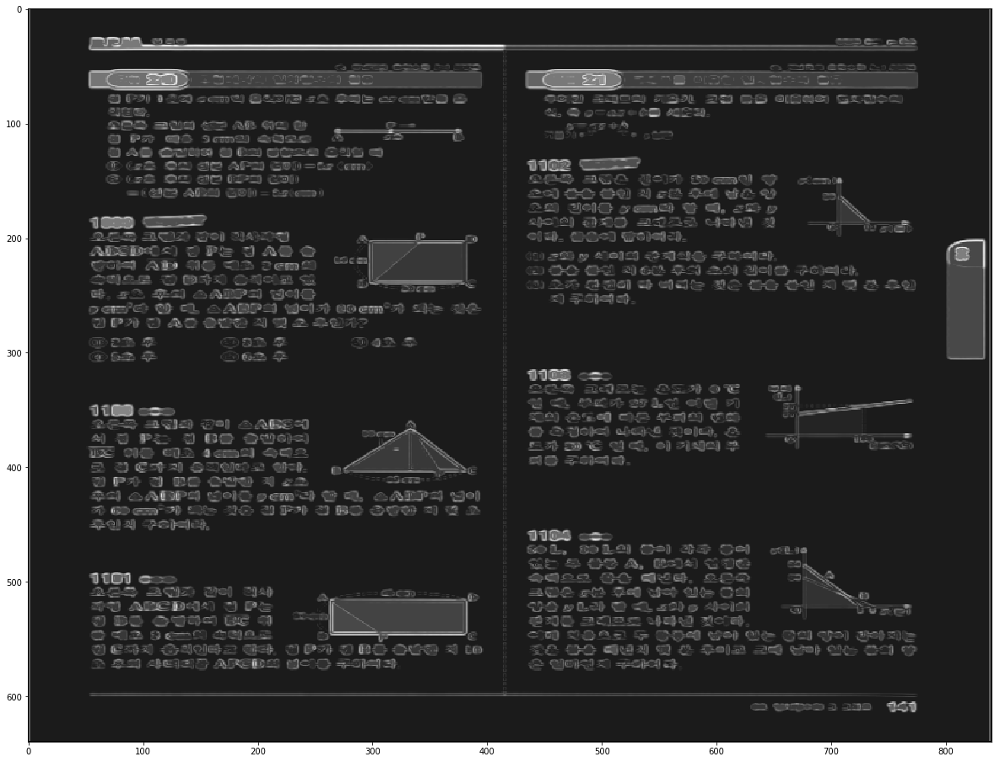

3  Pattern
IMG =  150 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

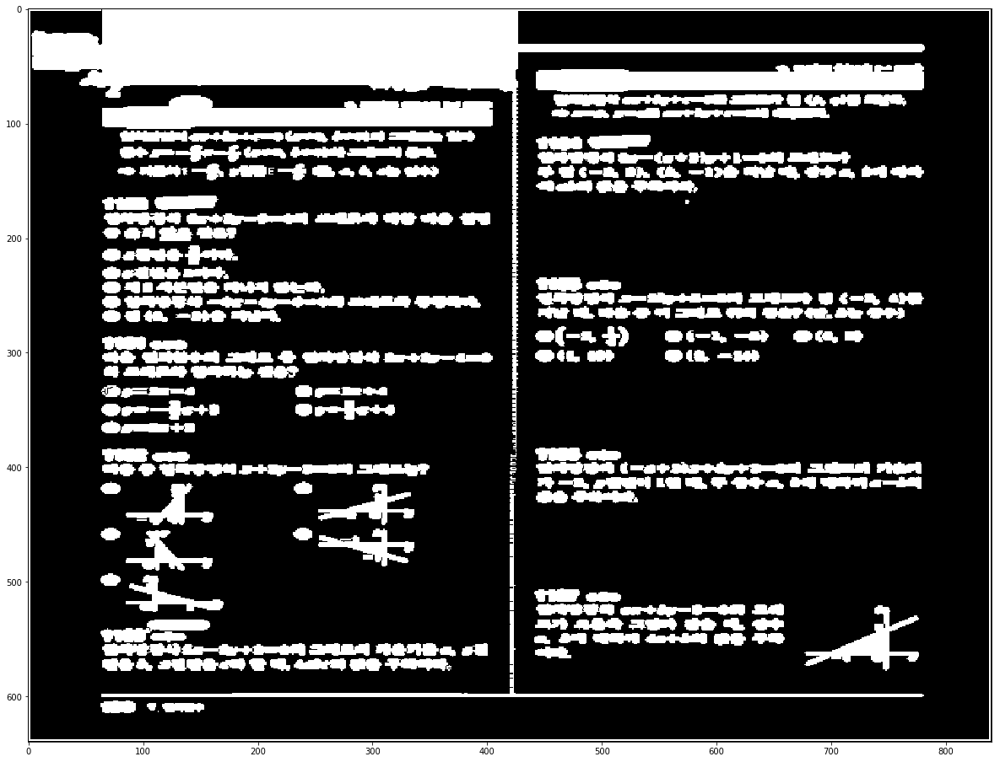

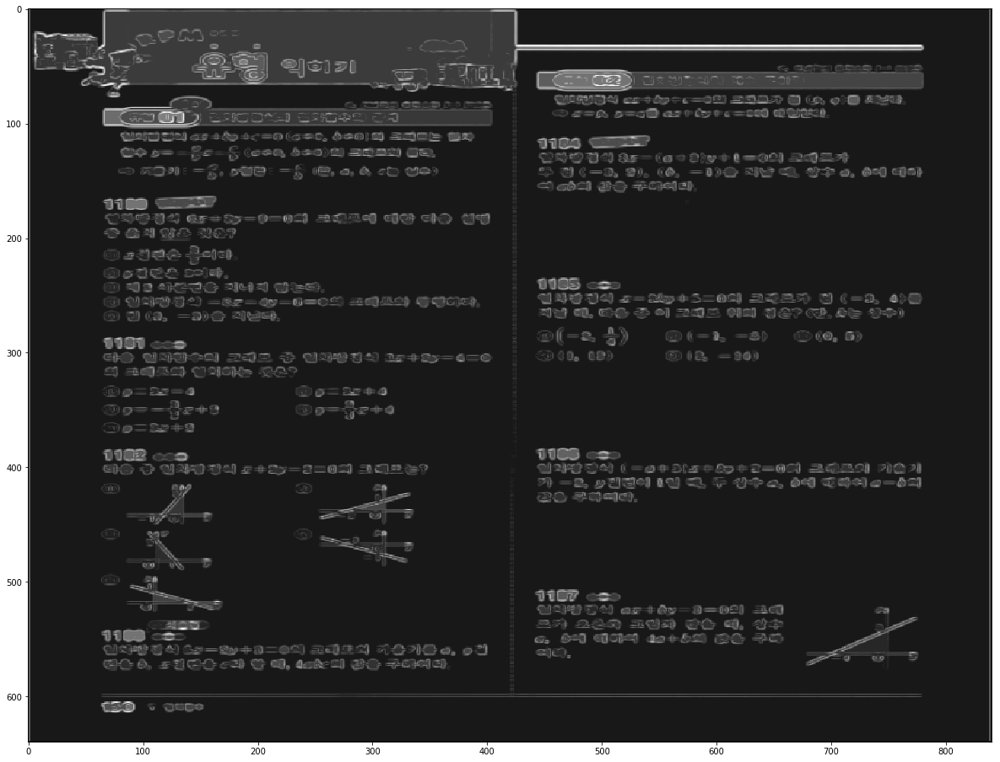

3  Pattern
IMG =  151 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

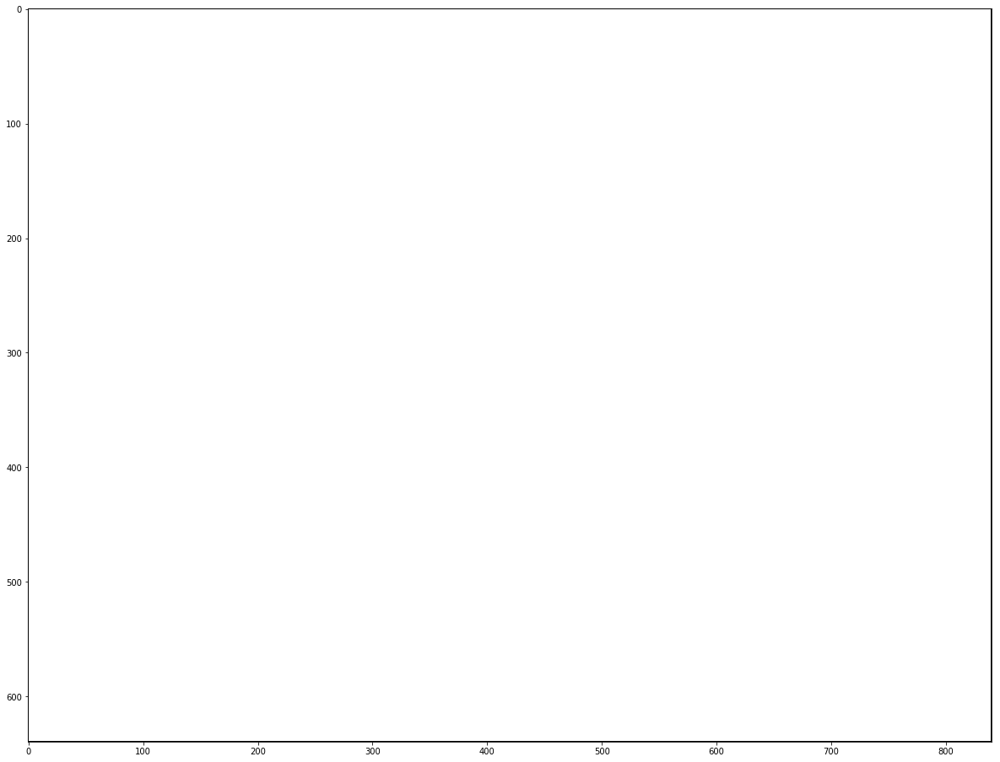

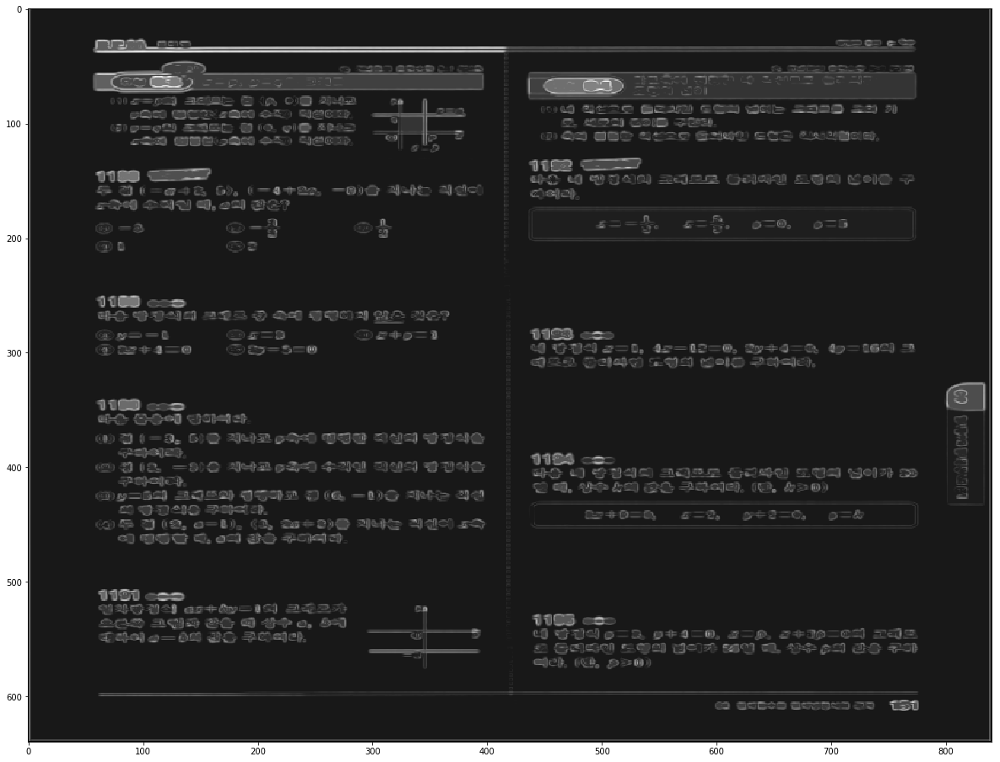

0  Pattern
IMG =  152 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

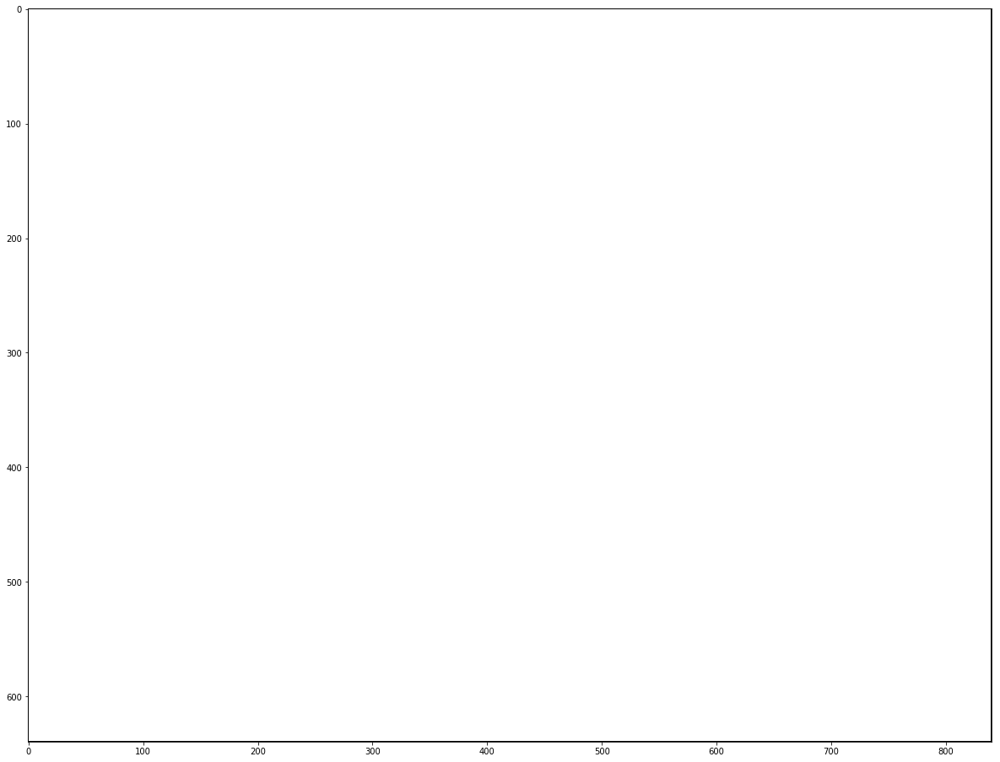

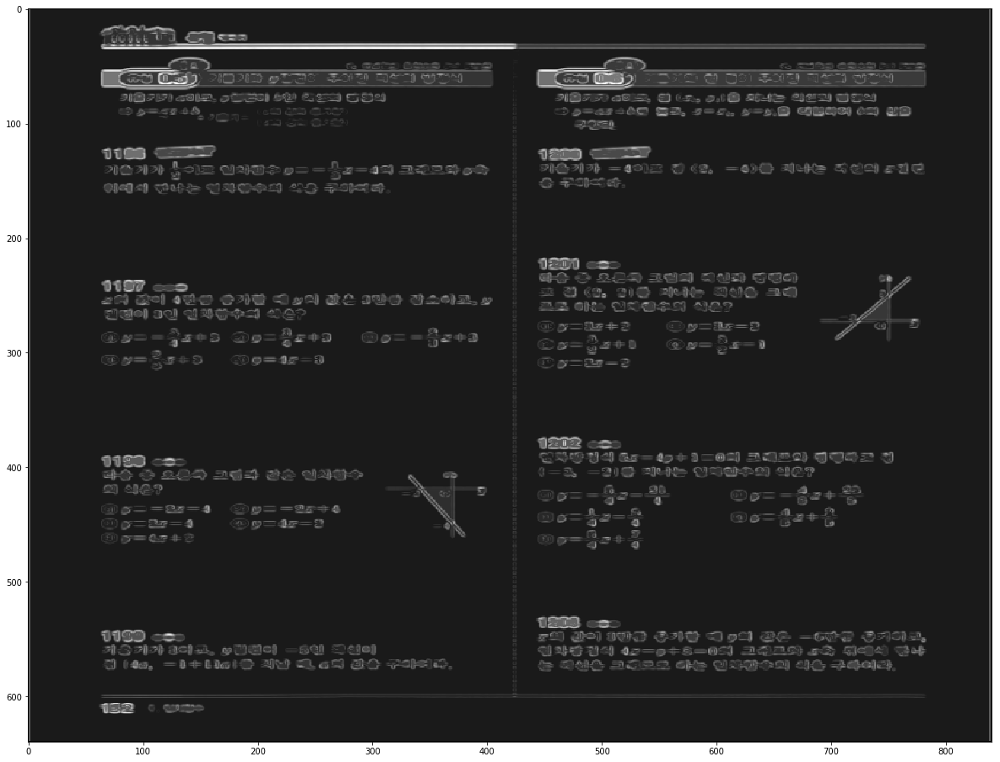

2  Pattern
IMG =  153 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

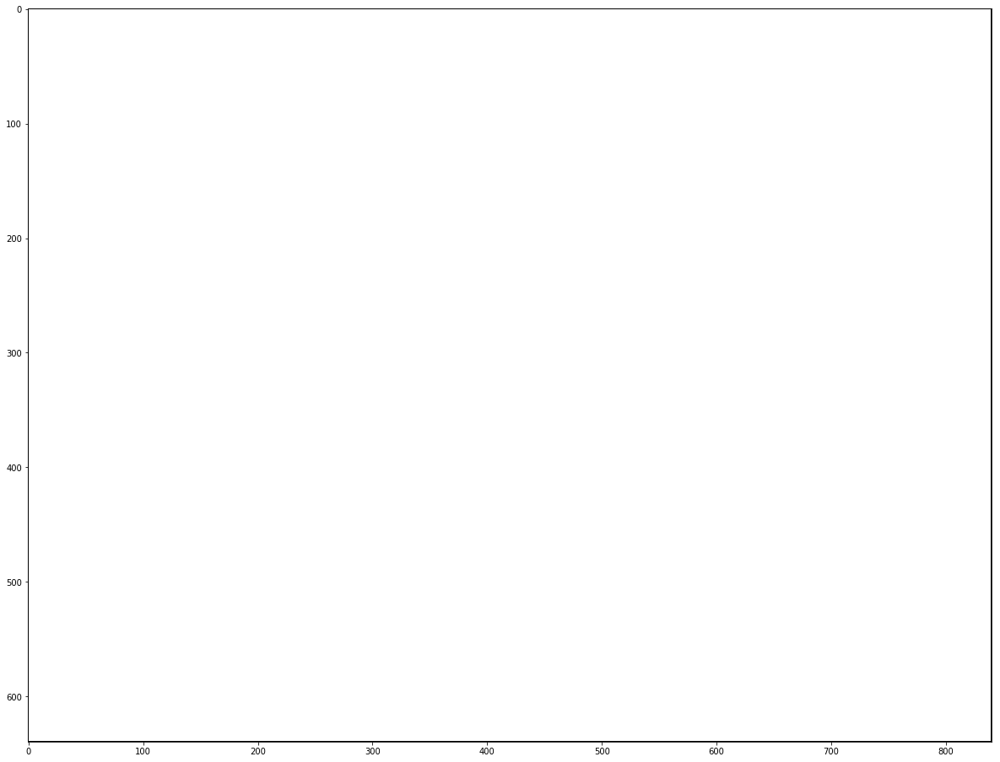

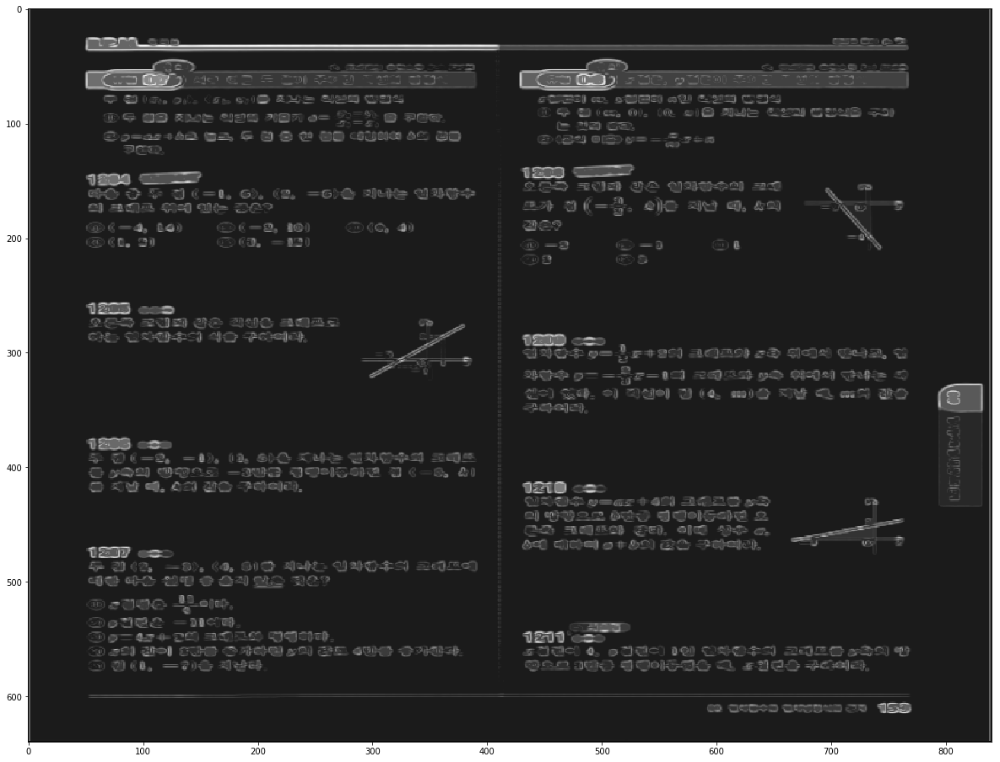

1  Pattern
IMG =  154 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

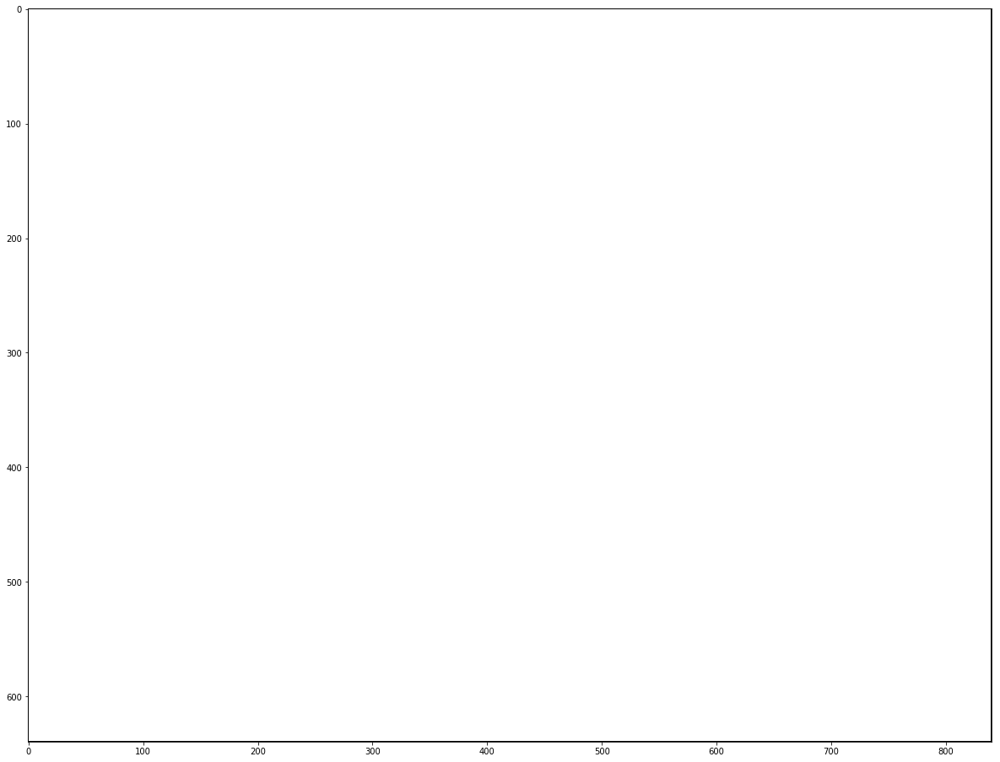

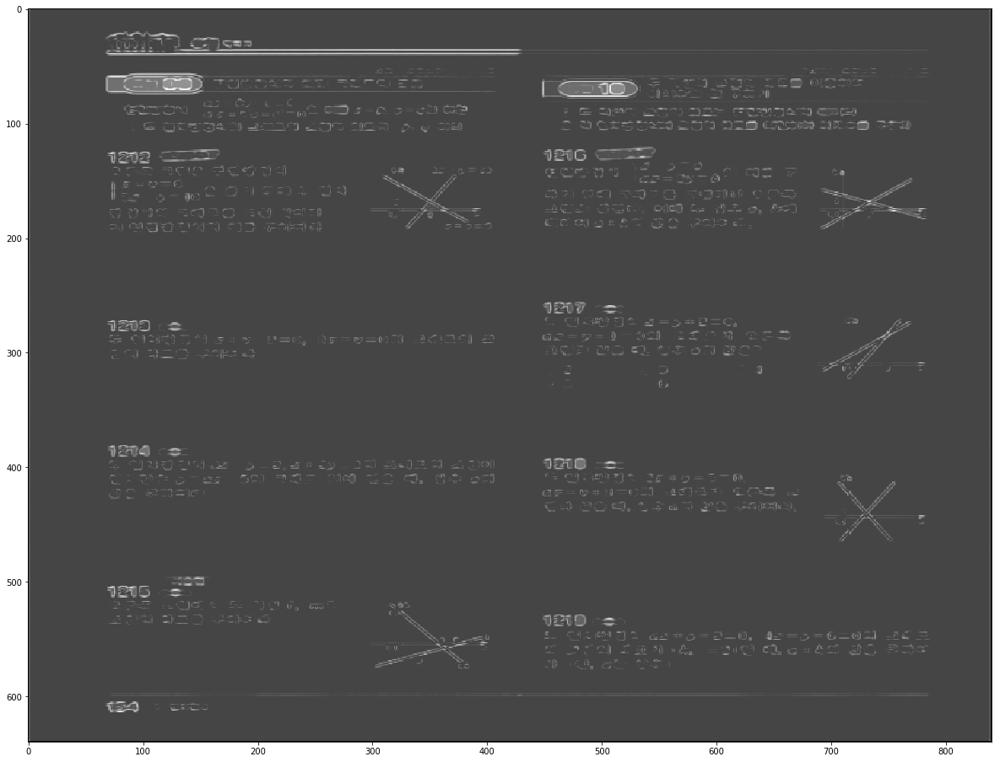

1  Pattern
IMG =  155 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

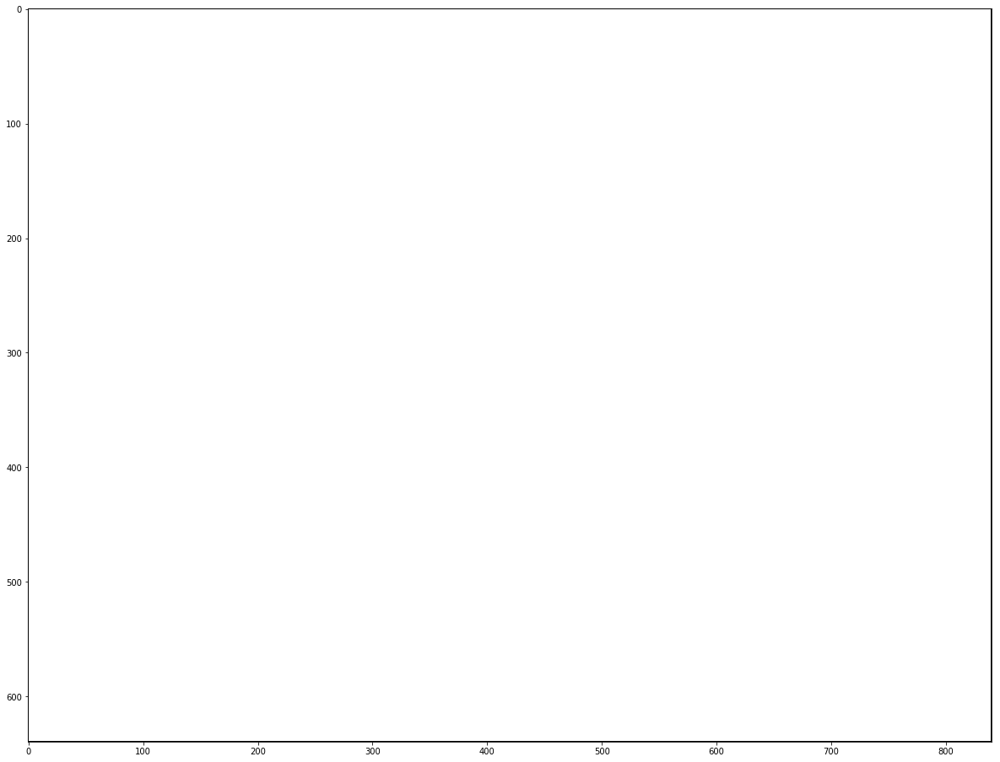

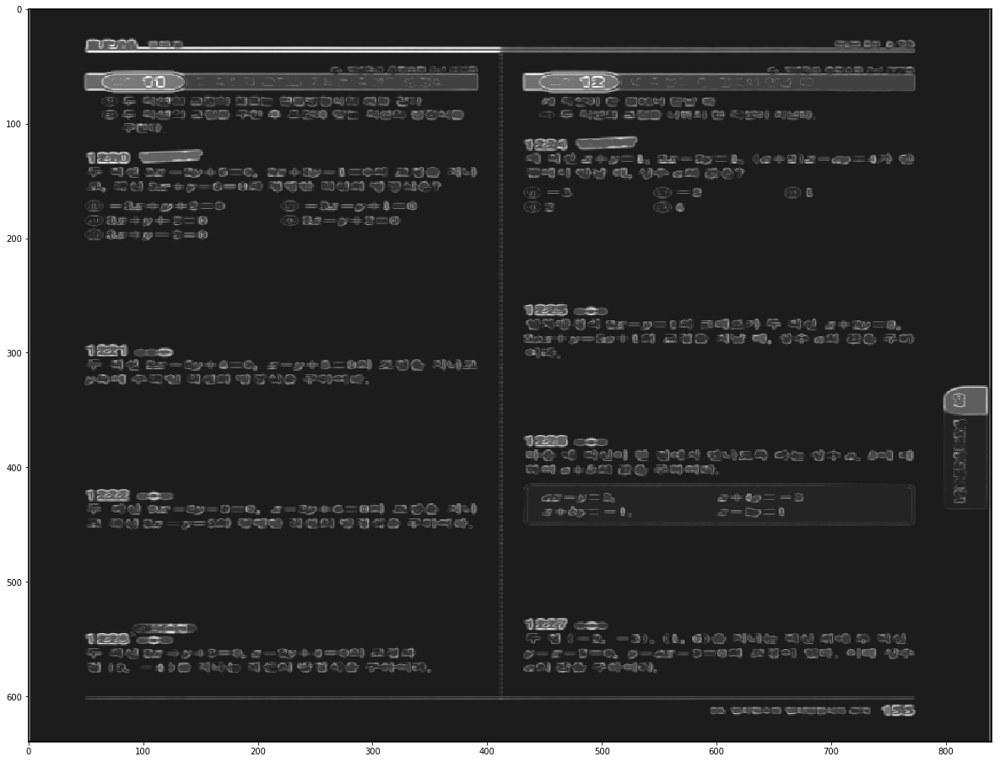

2  Pattern
IMG =  156 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

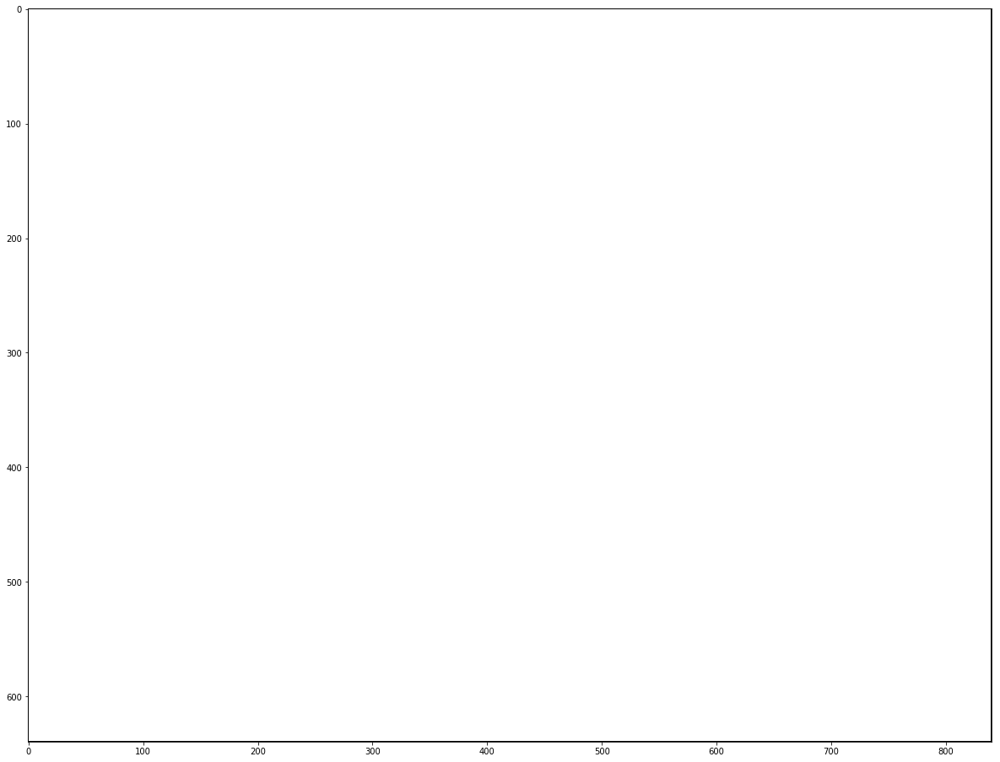

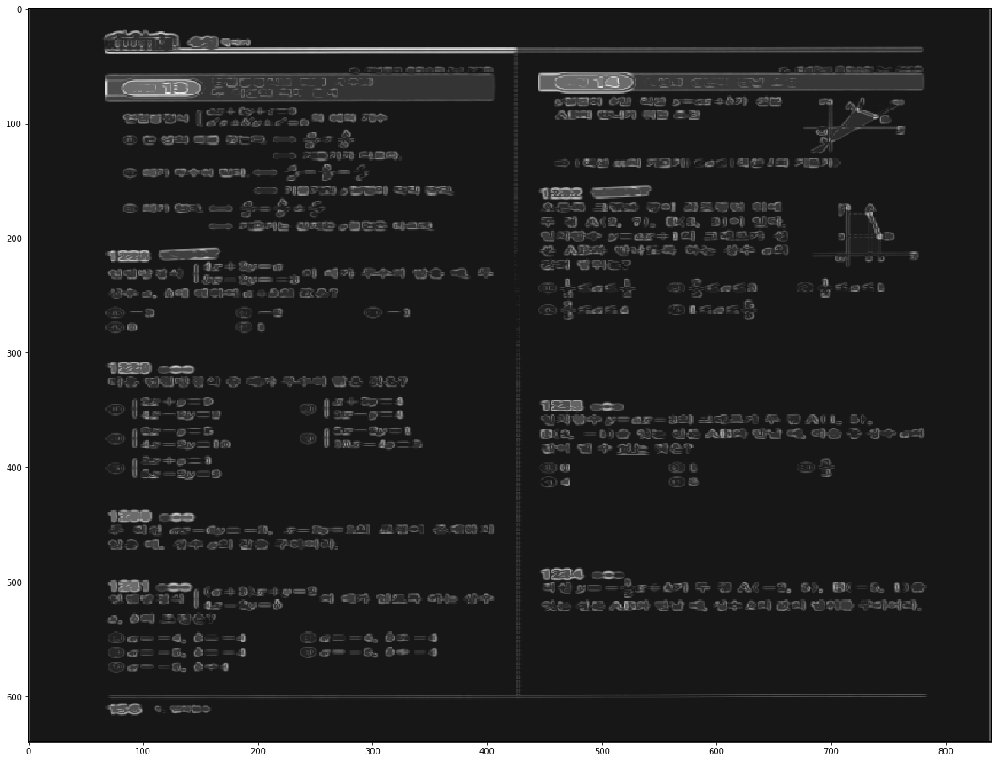

0  Pattern
IMG =  157 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

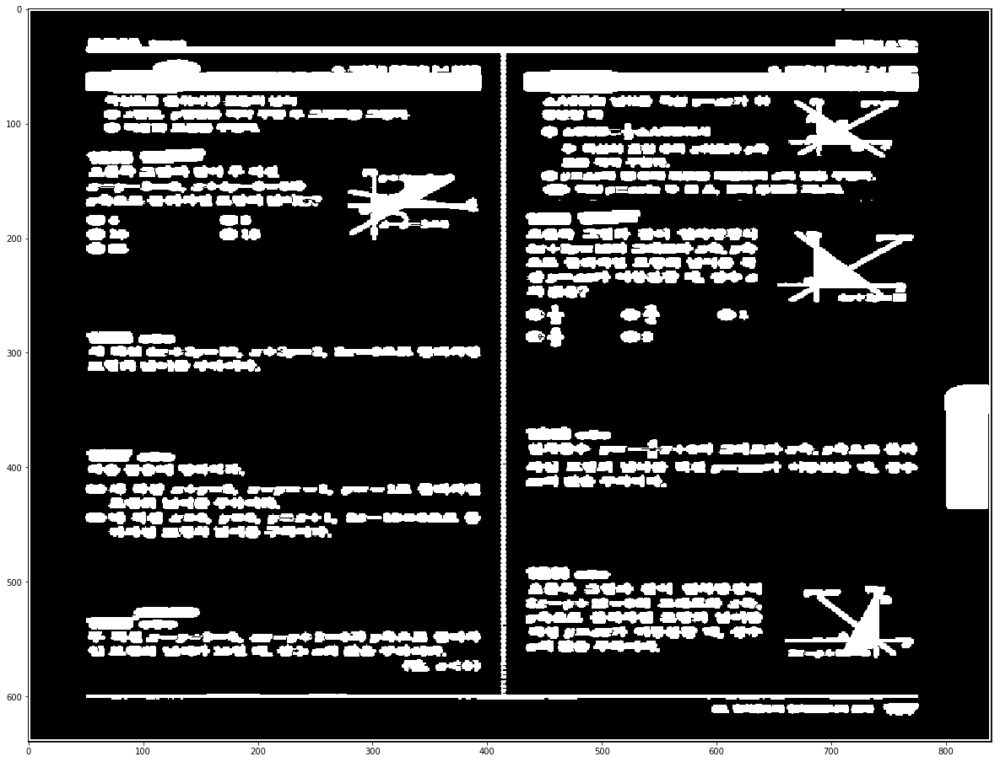

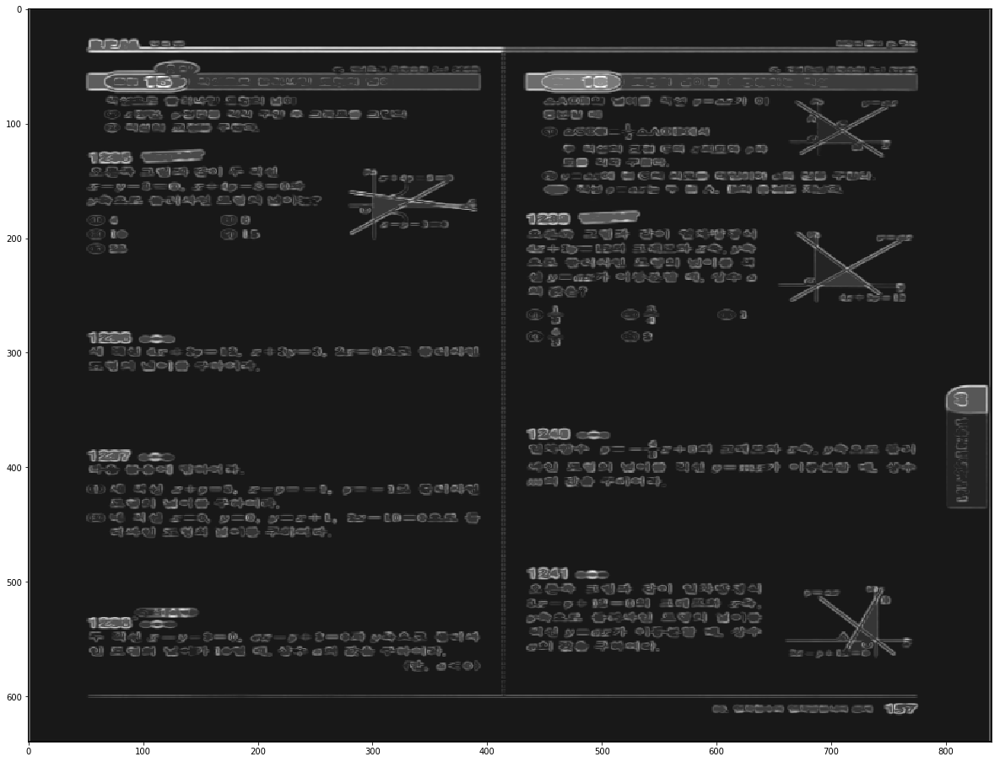

In [53]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt
from skimage.morphology import reconstruction

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def getBinary(img, th):
    fig, ax = plt.subplots(figsize=(30, 16))
    img_bin = sobel(img)
    
    seed = np.copy(img_bin)
    seed[1:-1, 1:-1] = img_bin.max()
    mask = img_bin

    filled = reconstruction(seed, mask, method='erosion')
    img_bin = filled > th
    
    ax.imshow(filled, interpolation='nearest', cmap=plt.cm.gray)
    return img_bin

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

# def denoiseWeakCon(img, y_value):
#     height, width = img.shape
#     upper_img = img[:y_value]
#     upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
#     img[:y_value] = upper_img
#     return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        h, w = self.body.shape
        ticks = [np.arange(0, w, 5), np.arange(0, h, 5)]
        ax.set_xticks(ticks[0])
        ax.set_yticks(ticks[1])
        ax.grid(which='both')
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
#         fig, ax = plt.subplots(figsize=(30, 16))
#         fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        ticks = [np.arange(0, w, 5), np.arange(0, h, 10)]
        ax2.set_xticks(ticks[0])
        ax2.set_yticks(ticks[1])
        ax2.grid(which='both')
        
#         ax1.imshow(filled, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
        
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
#         vmap = standardize(vmap)
        
#         vmap = removeFirst(vmap)
#         vmap = denoiseBoundary(vmap, 5, 10)
#         if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
#         if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

#         contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.
#         for n, contour in enumerate(contours):
#             ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
#         ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        img = denoiseBoundary(img, 10, 8)
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()
    
    fig, ax = plt.subplots(figsize=(30, 16))
      
    img_bin = getBinary(img, 0.05)

    ax.imshow(img_bin, interpolation='nearest', cmap=plt.cm.gray)
#     edges = canny(img_bin, sigma=.5)
#     p = Page(edges)
#     p.showColumnCont(1,"body")
#     p.showColumnCont(2,"body")
#     p.getContour()
    plt.show()
#     del p
    
 
    

1  Pattern
IMG =  012 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

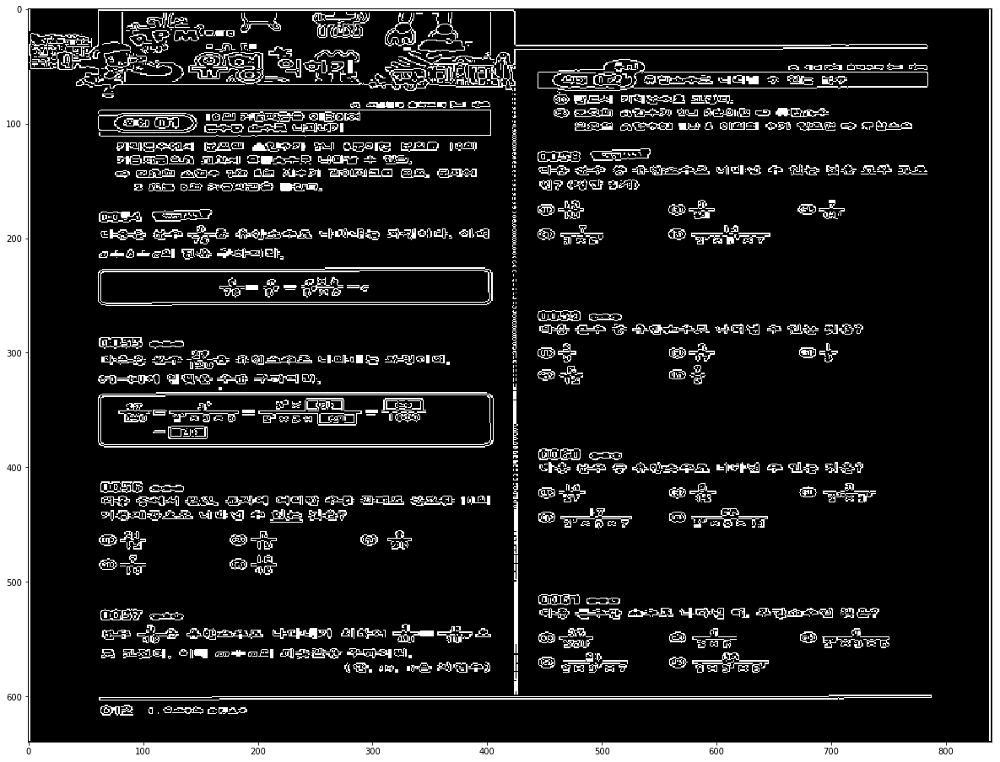

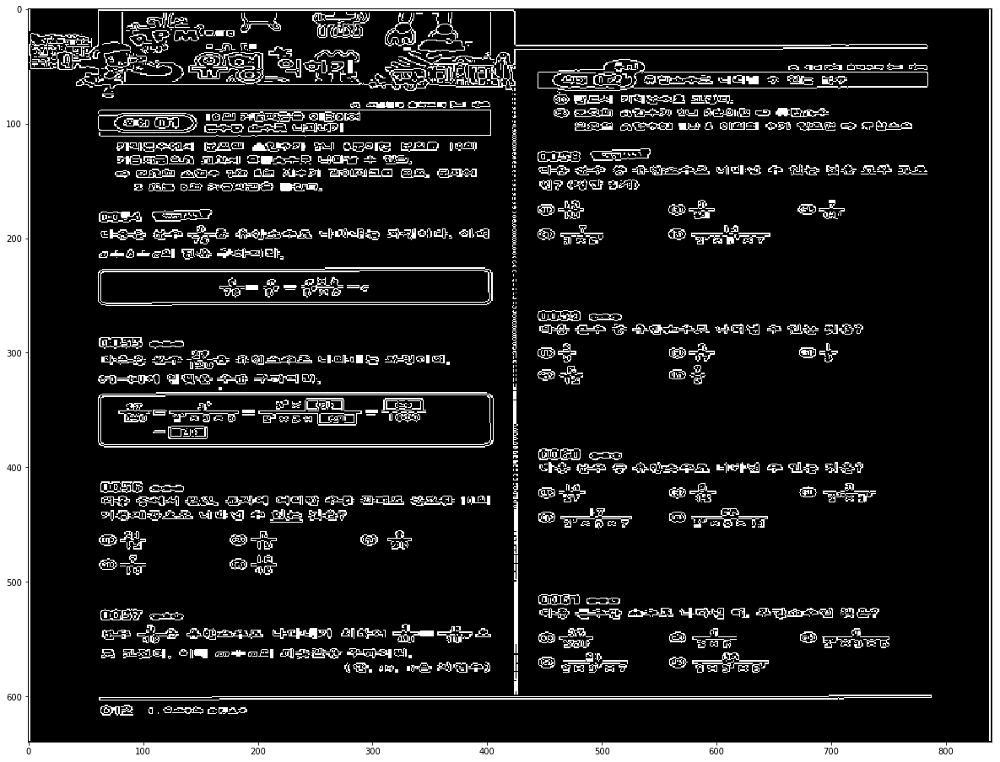

2  Pattern
IMG =  013 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

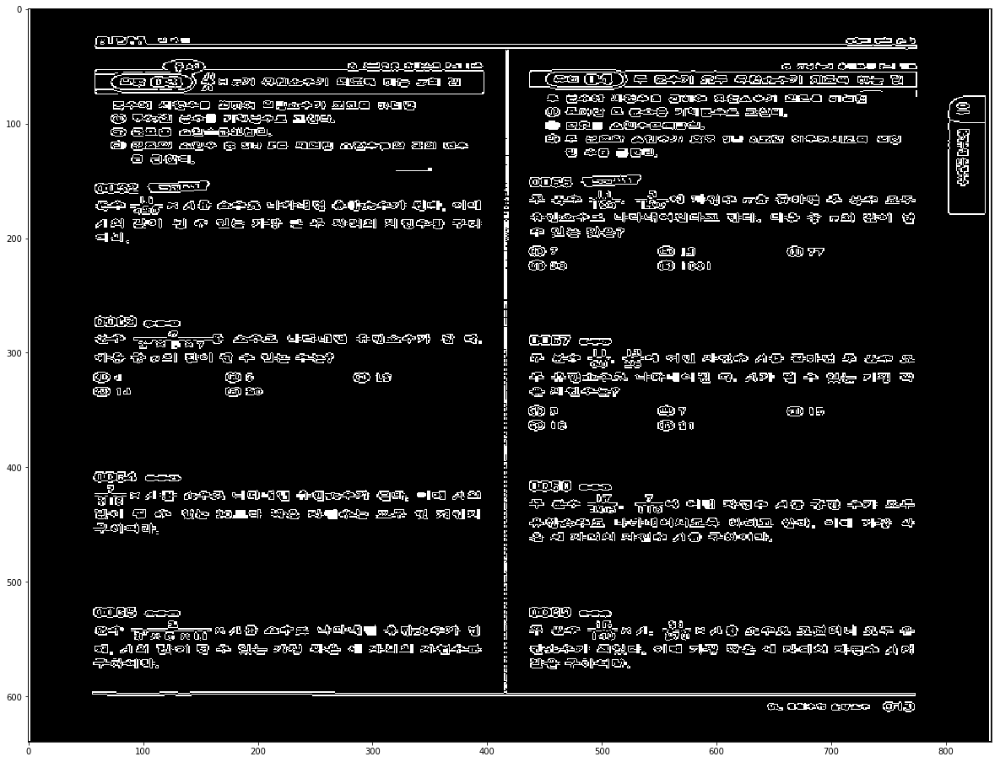

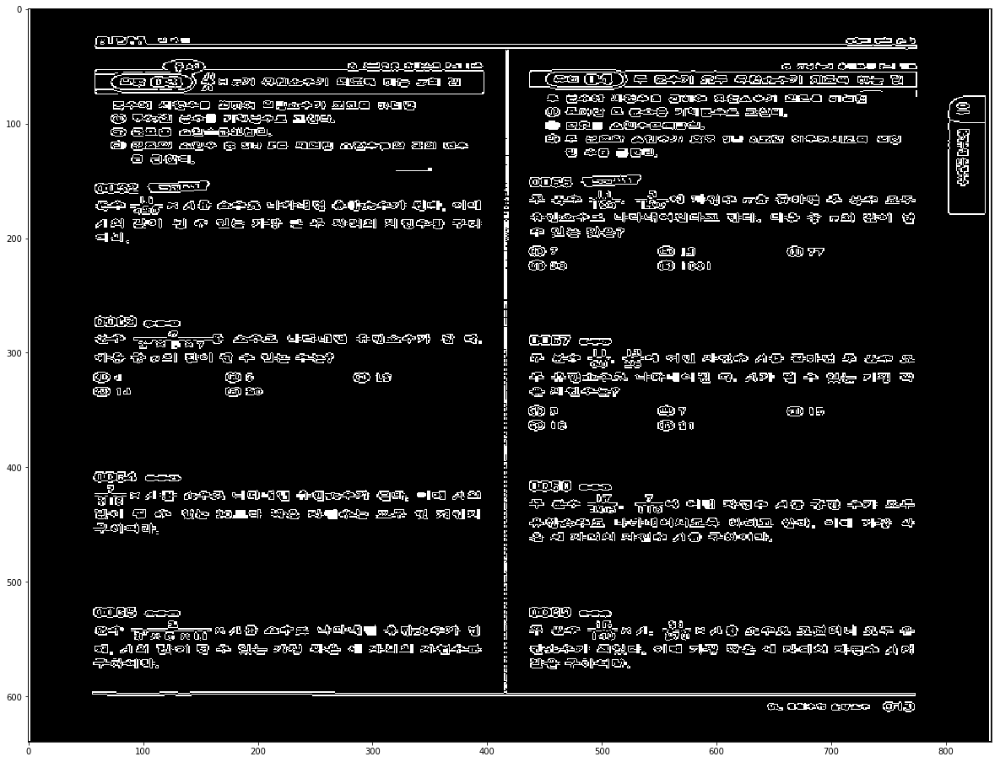

0  Pattern
IMG =  014 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

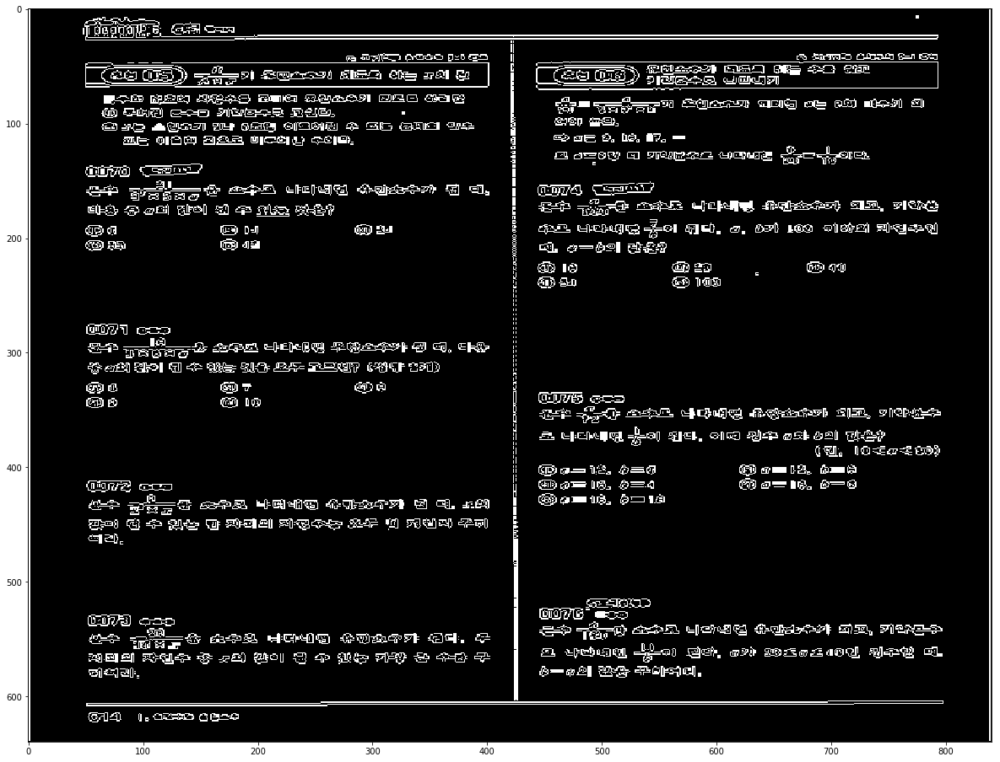

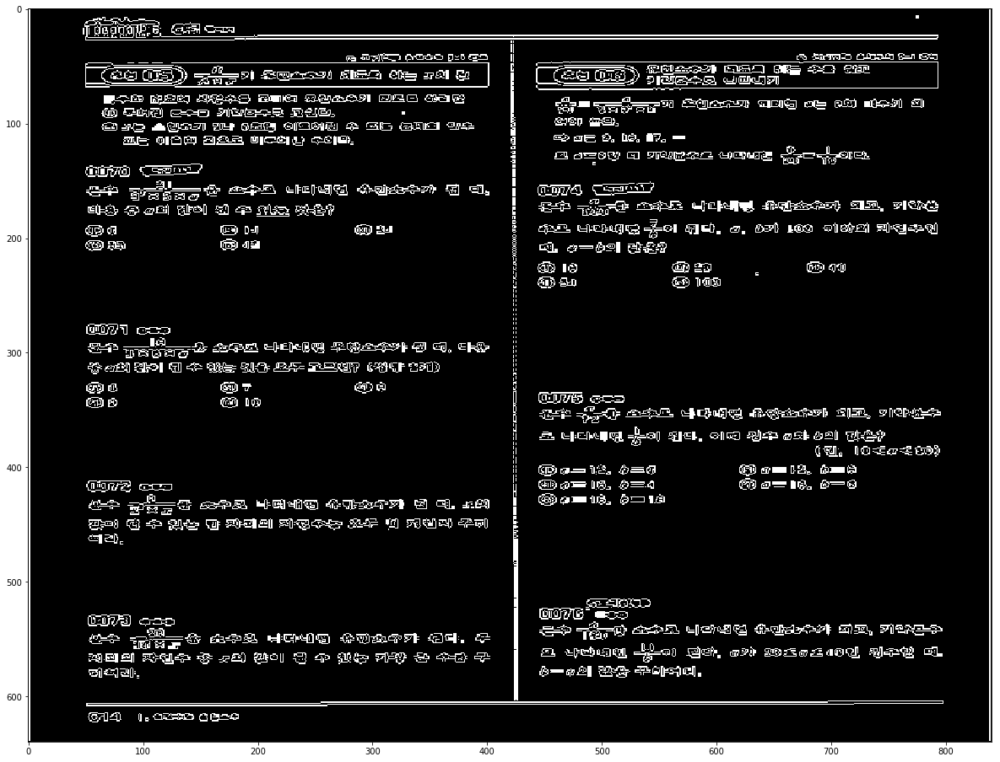

3  Pattern
IMG =  015 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

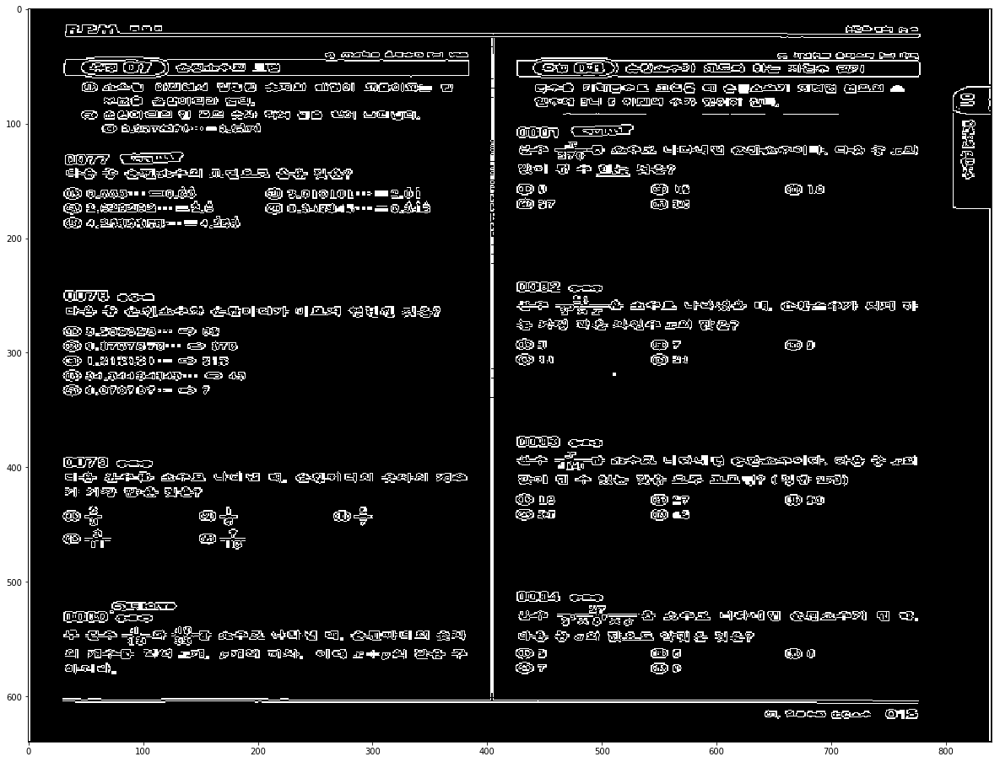

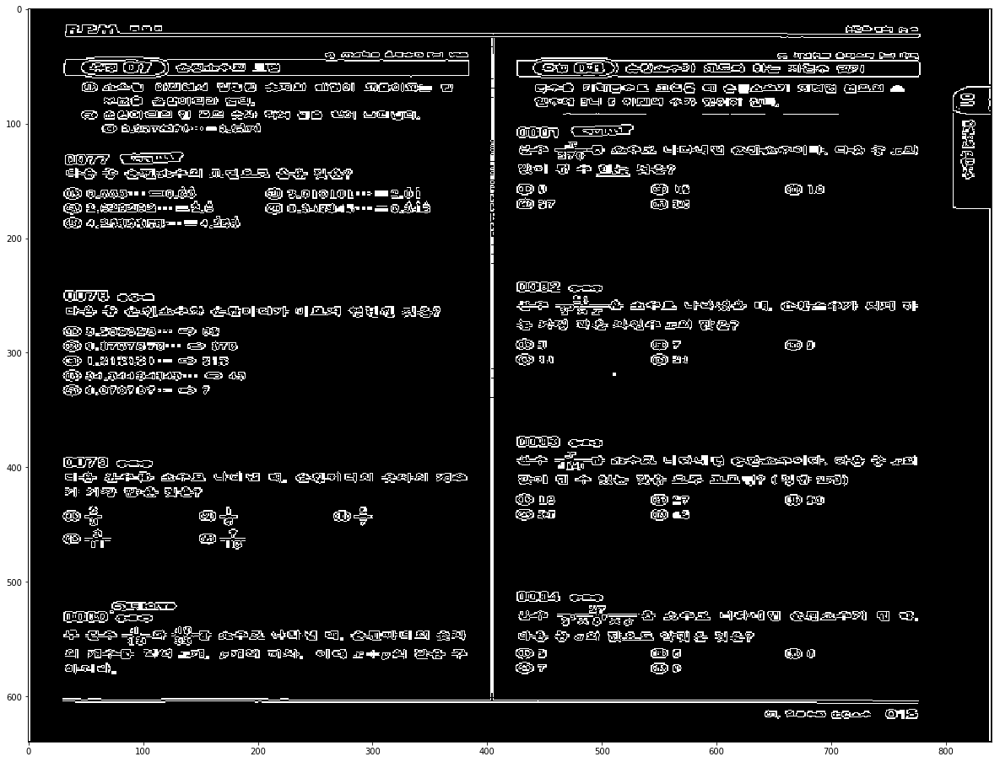

3  Pattern
IMG =  016 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

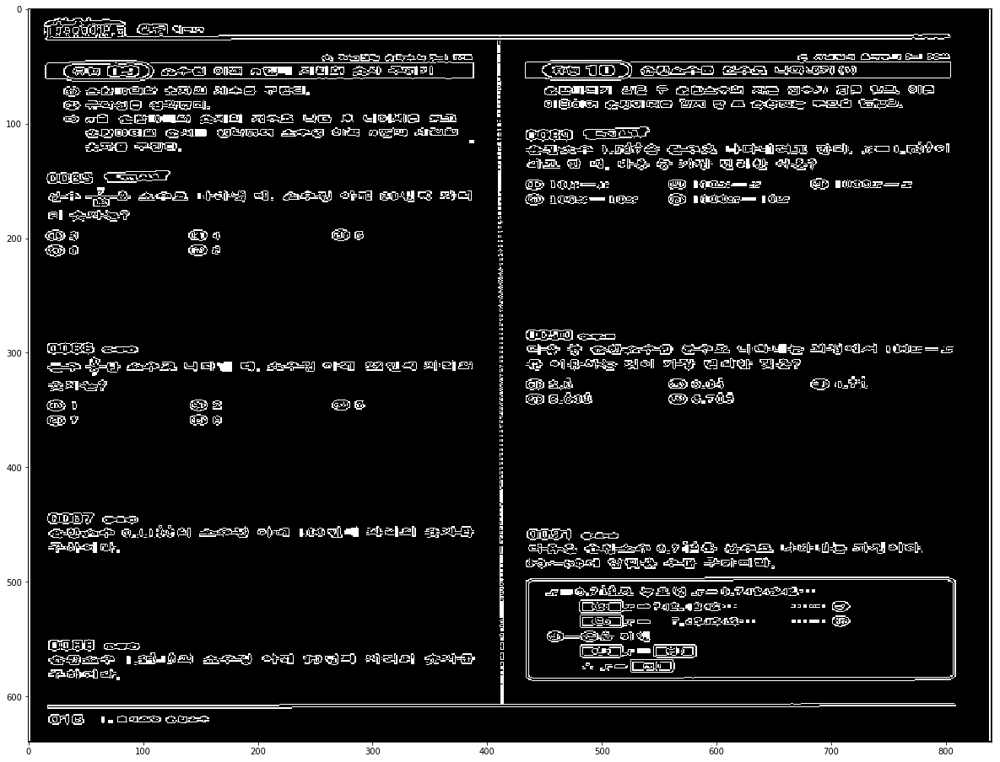

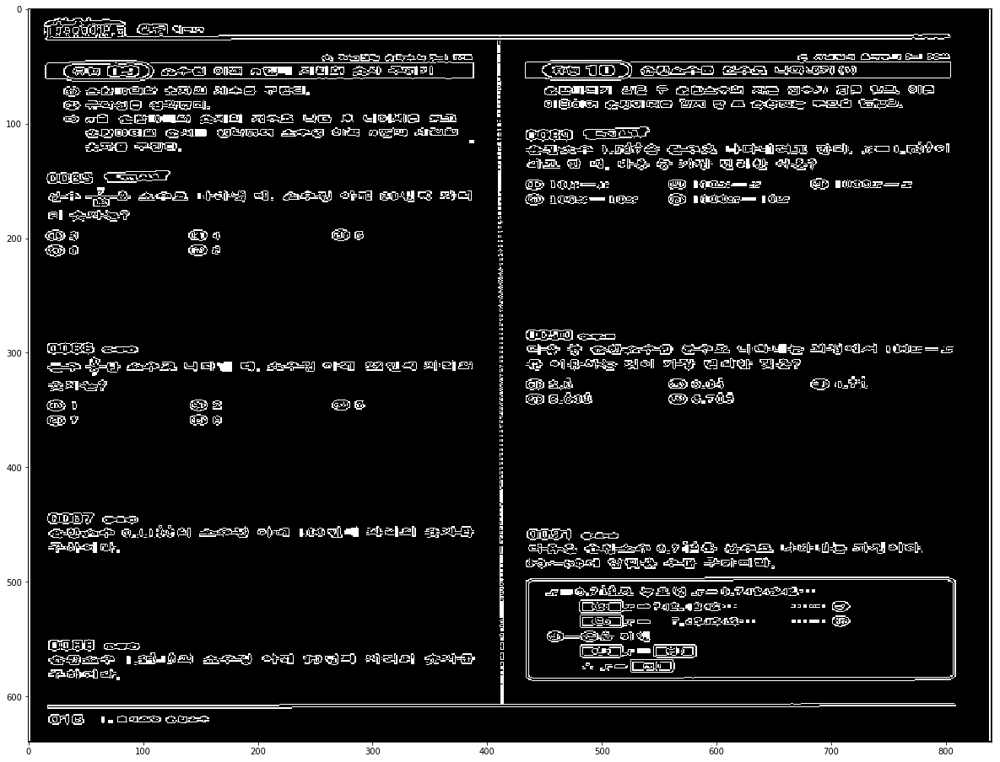

0  Pattern
IMG =  017 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

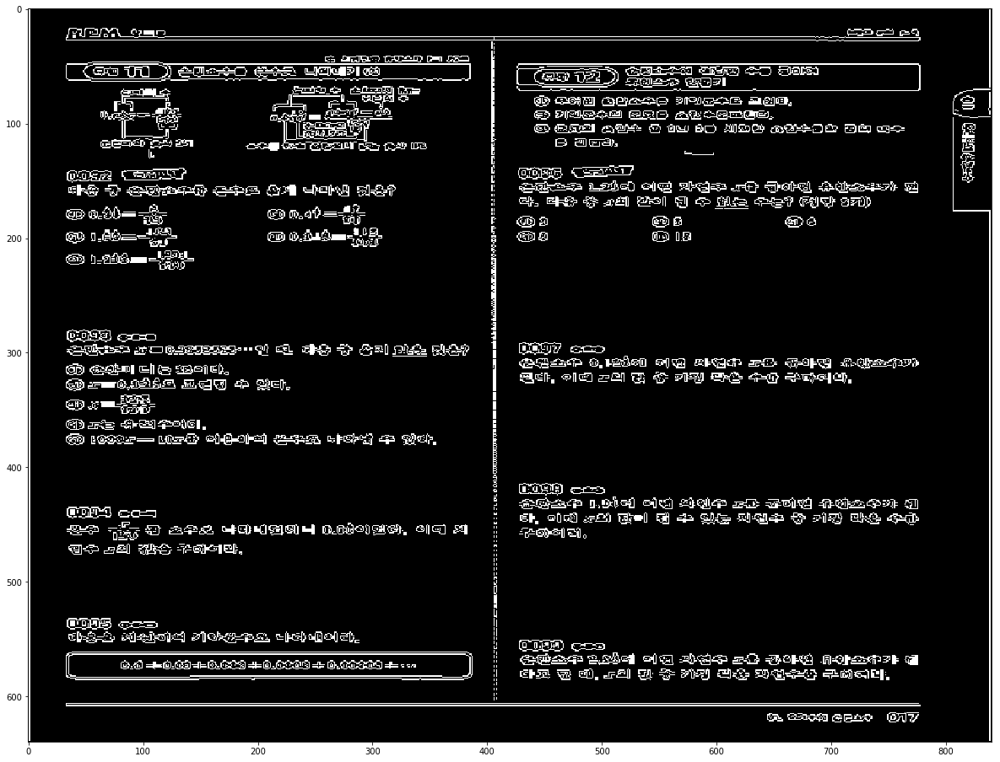

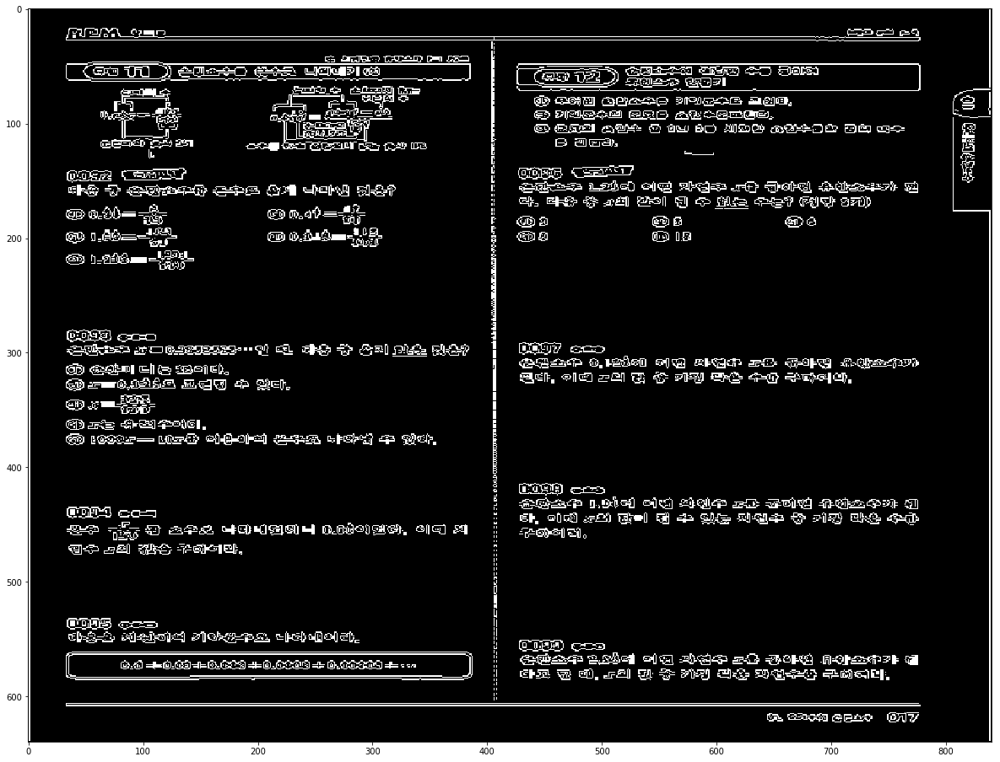

2  Pattern
IMG =  018 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

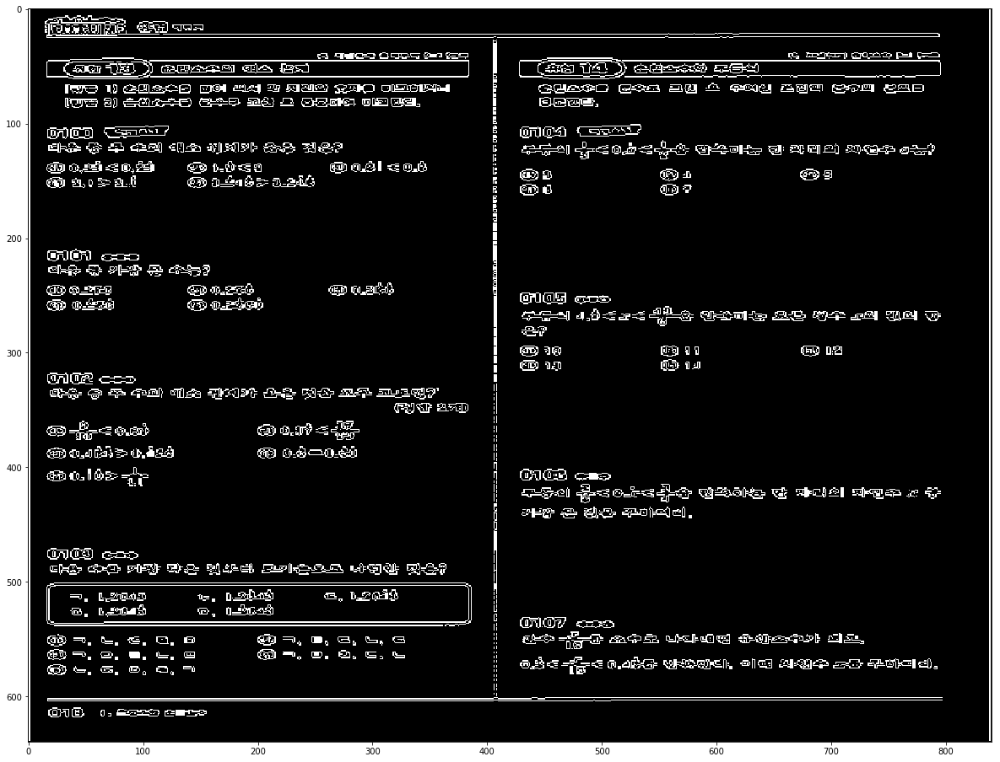

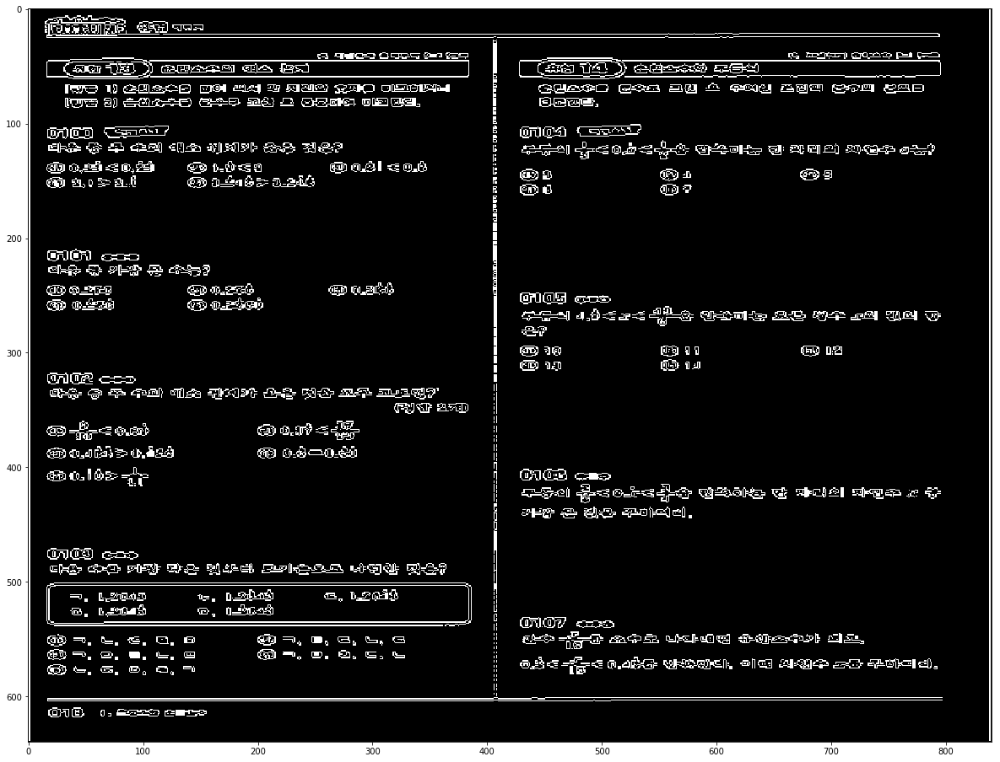

1  Pattern
IMG =  019 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

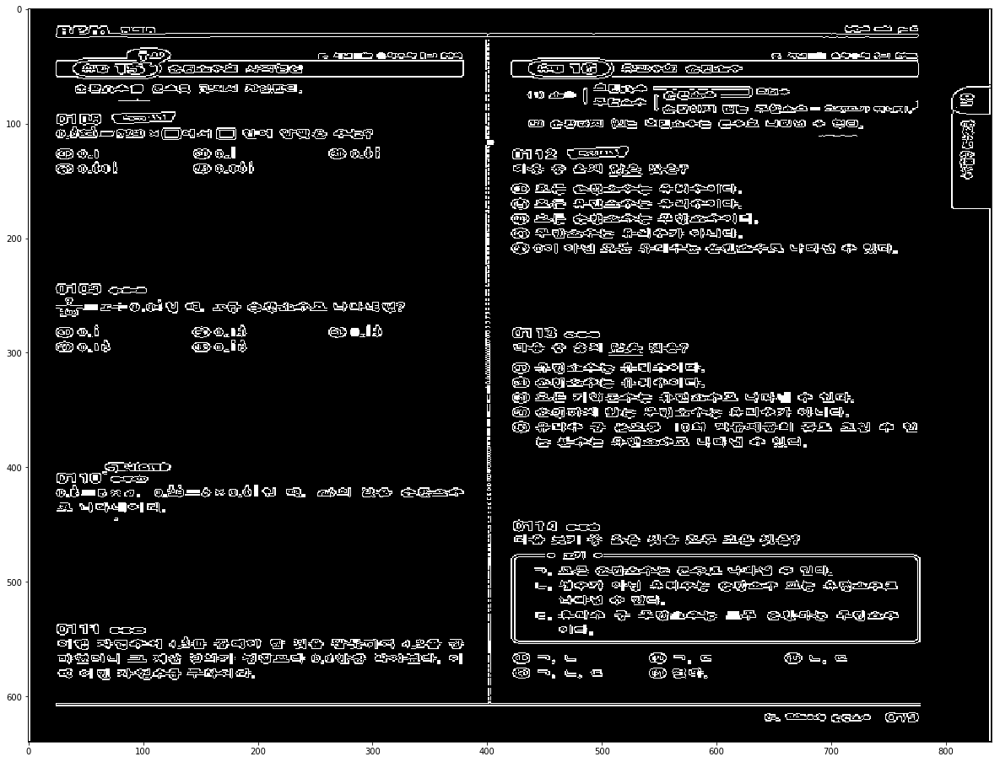

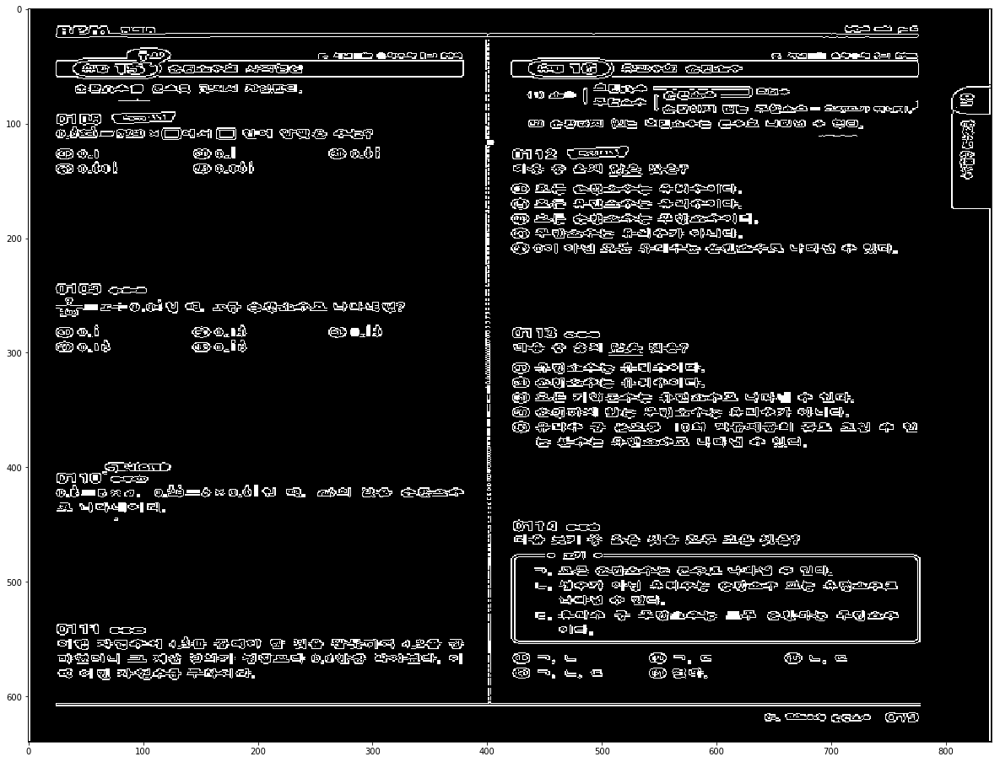

1  Pattern
IMG =  030 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

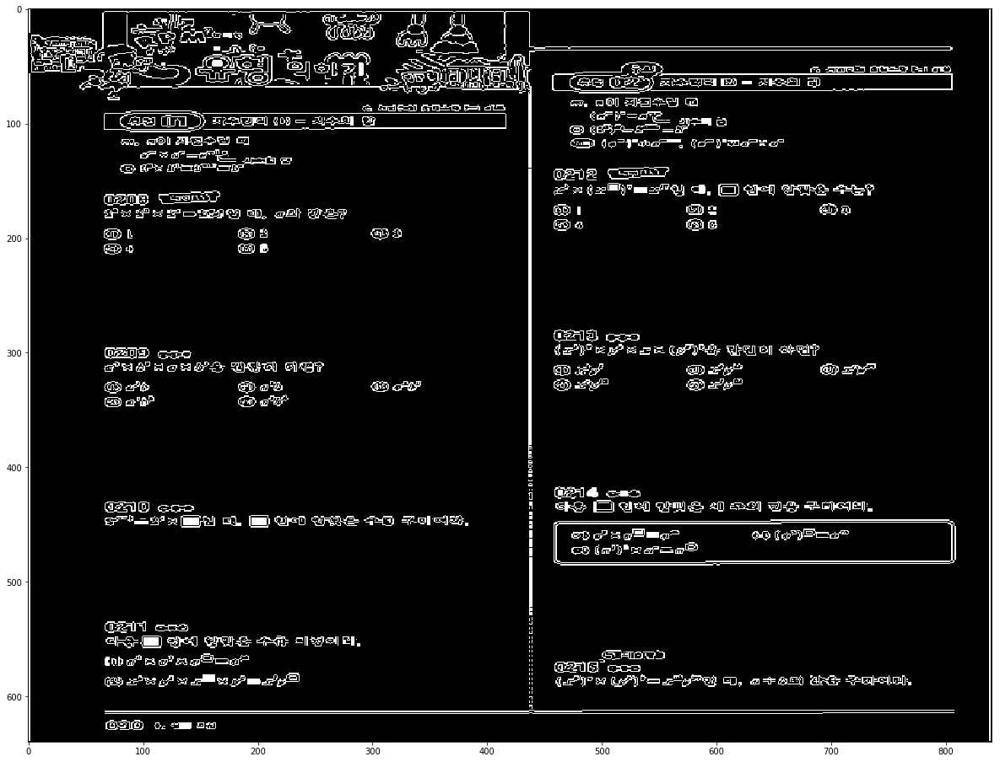

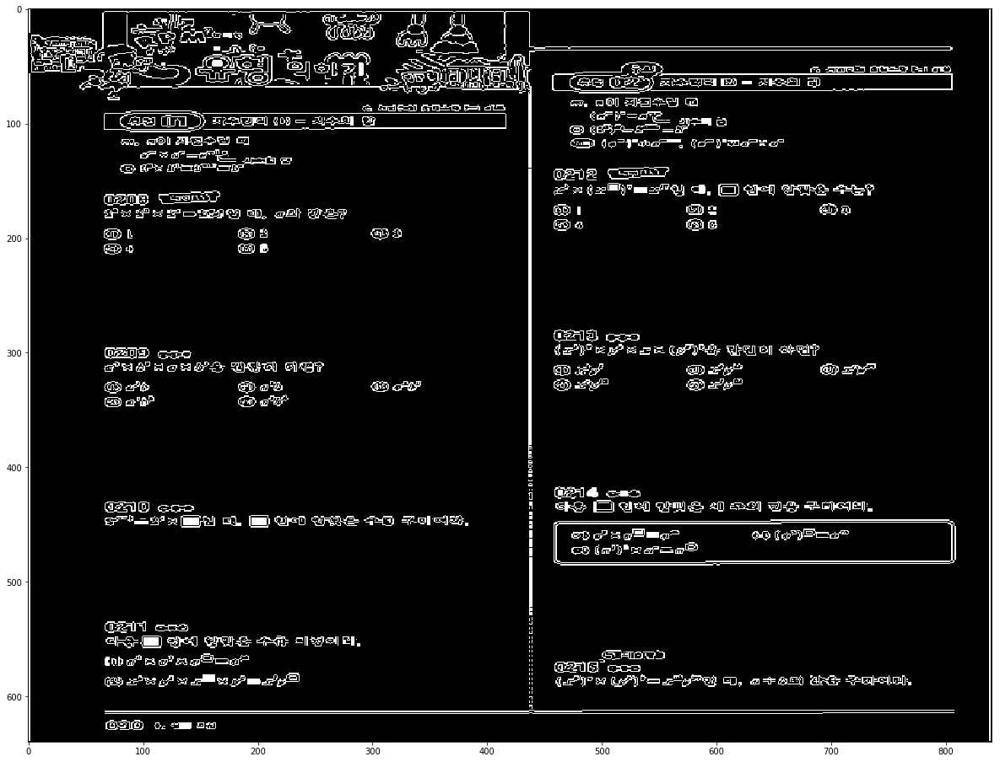

2  Pattern
IMG =  031 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

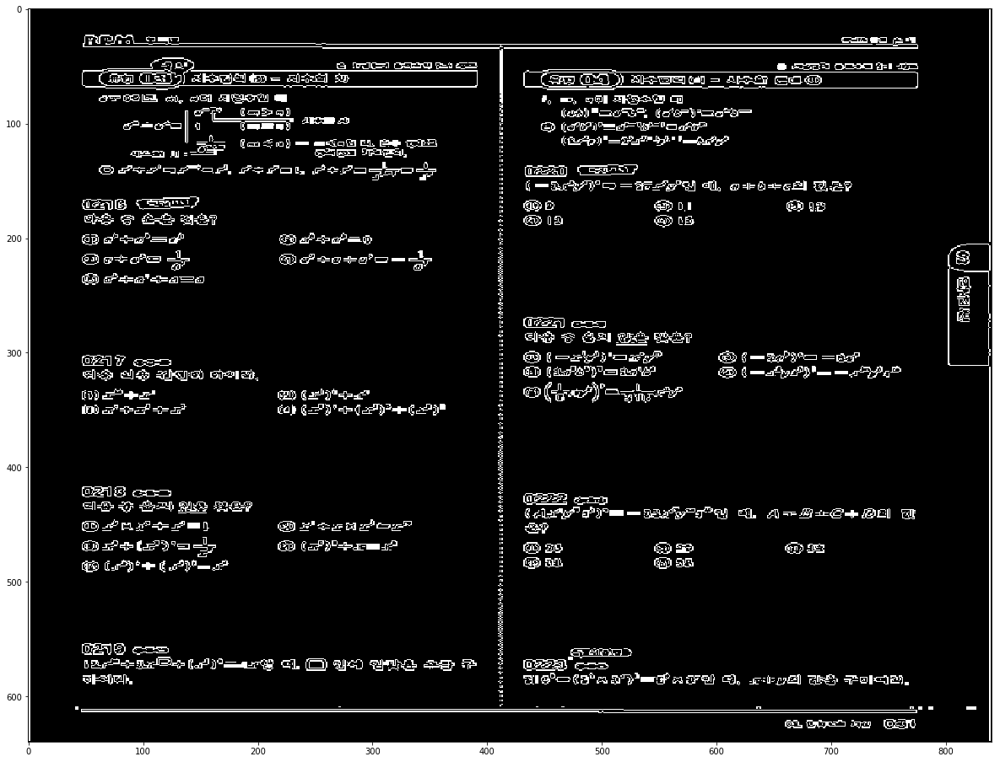

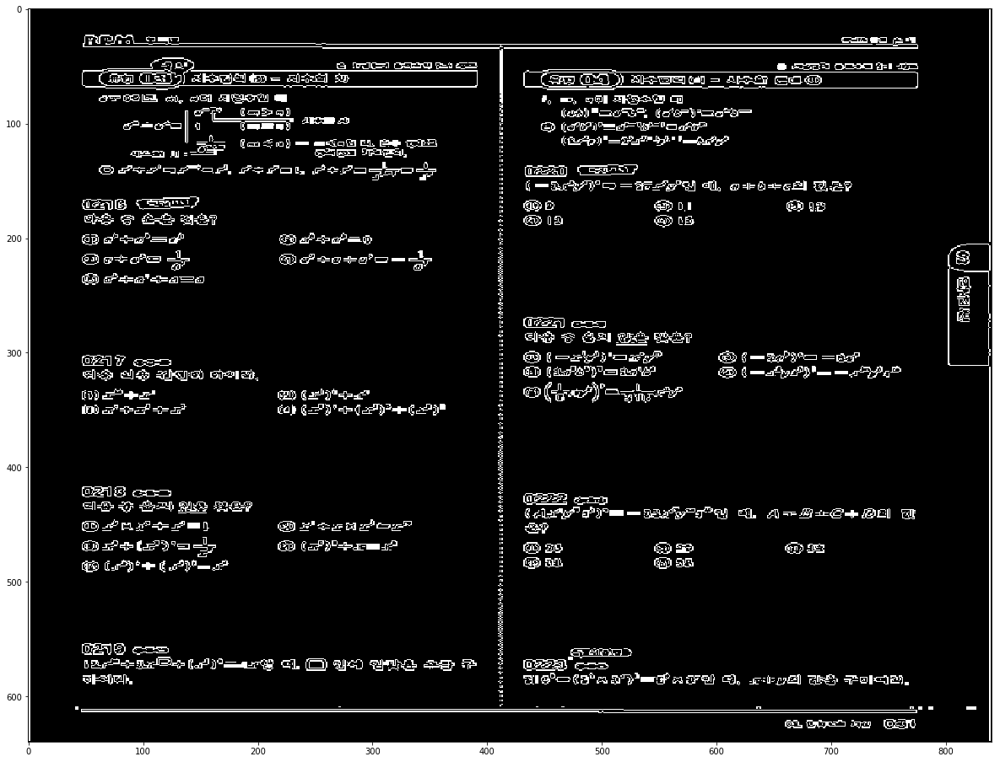

0  Pattern
IMG =  032 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

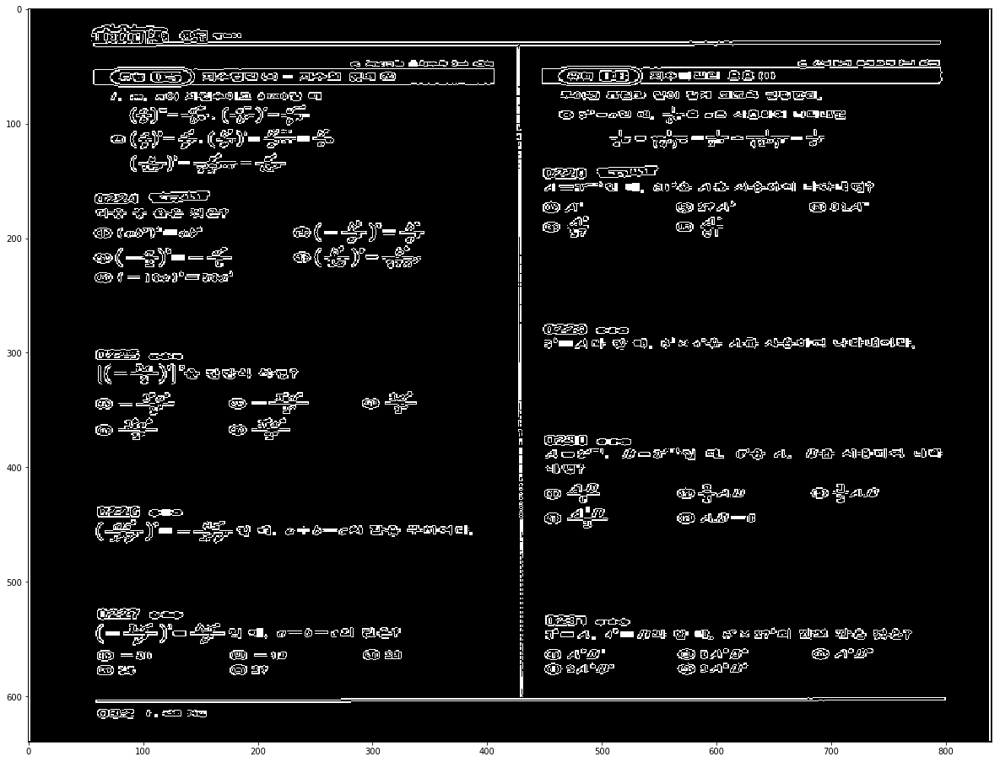

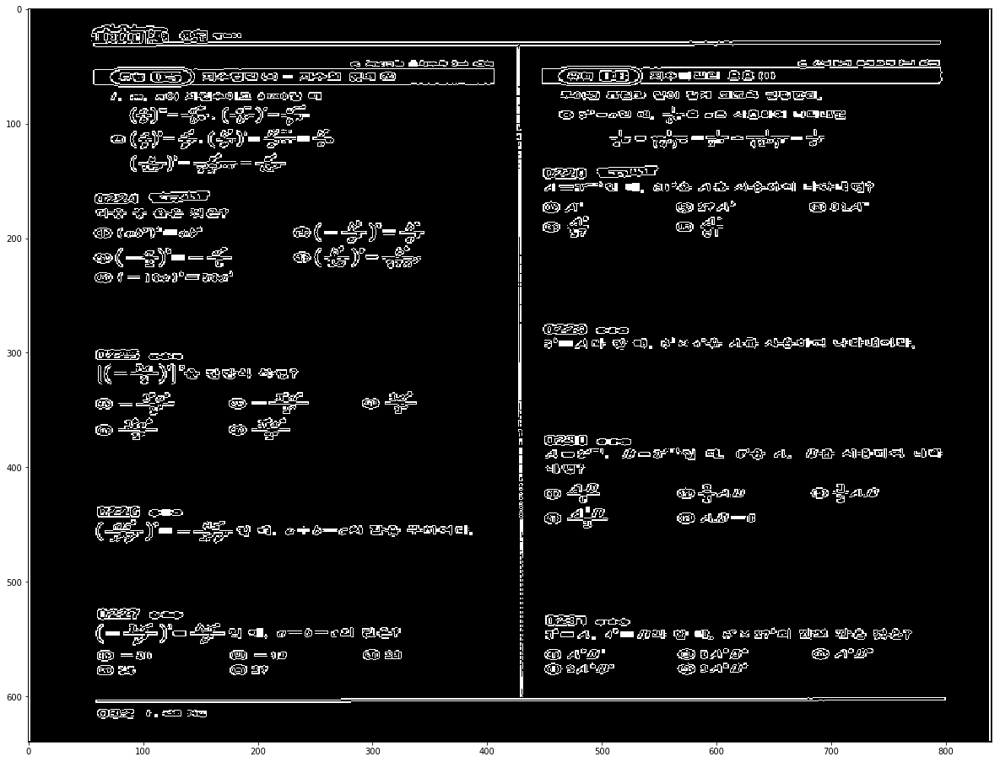

3  Pattern
IMG =  033 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

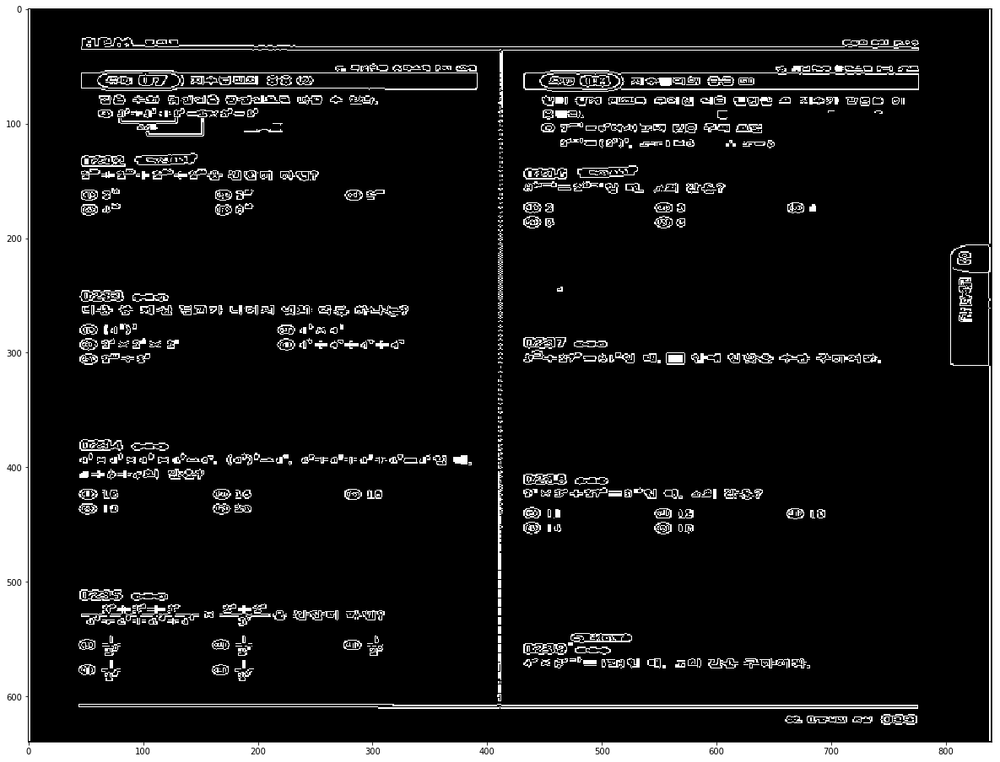

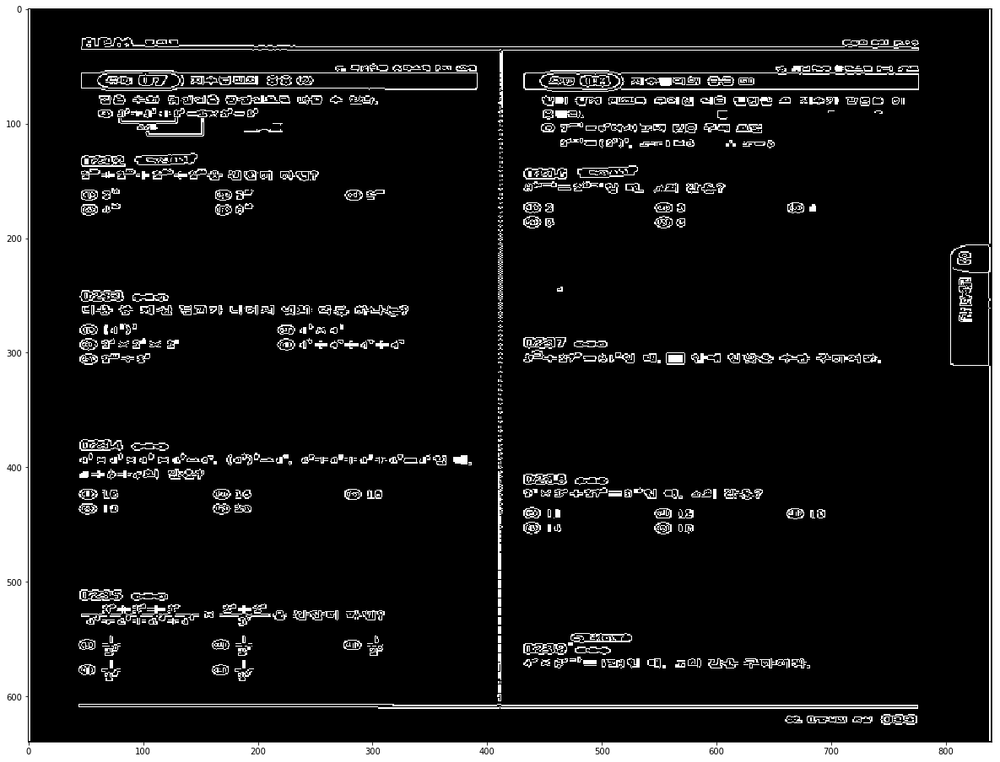

3  Pattern
IMG = 

C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


 034 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

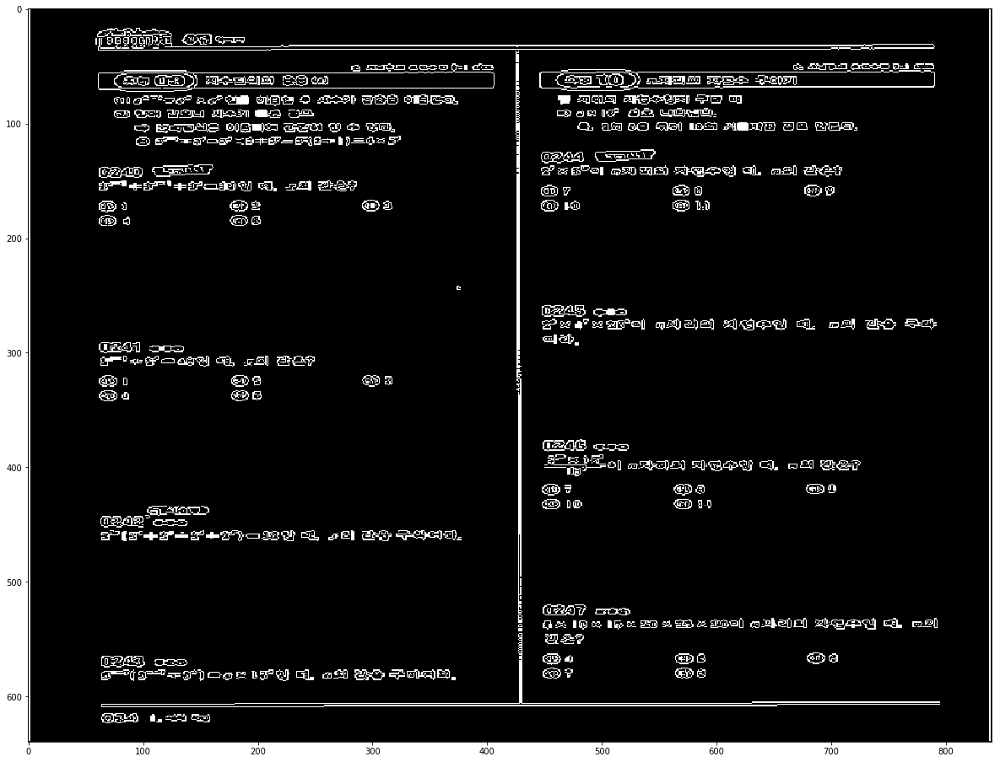

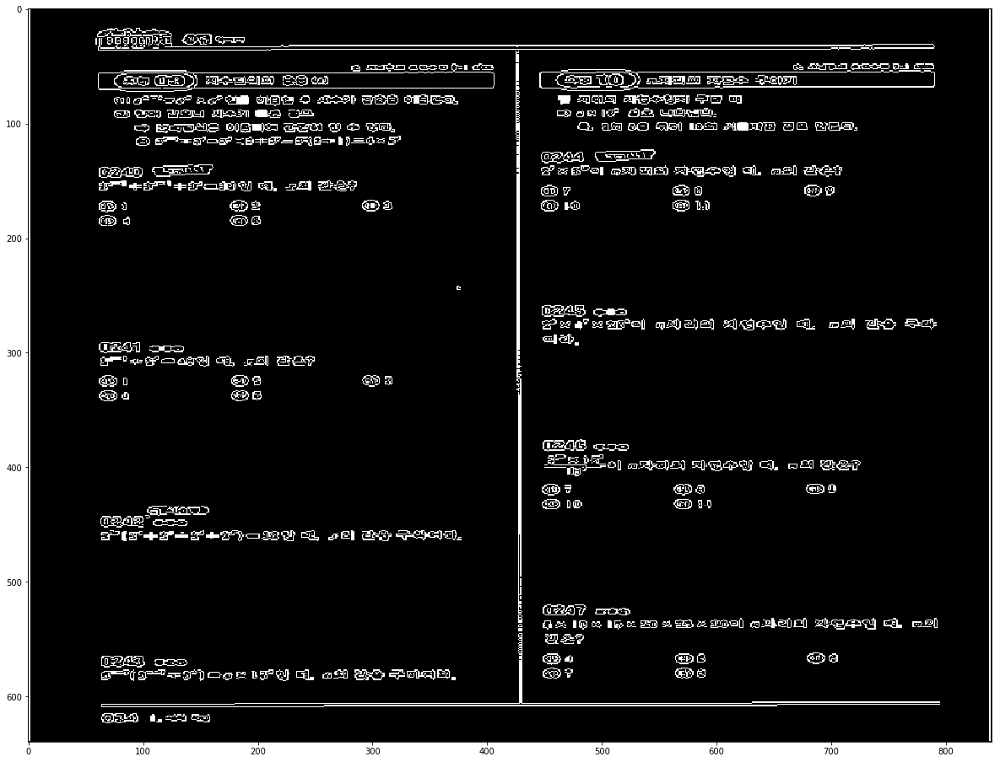

0  Pattern
IMG =  035 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

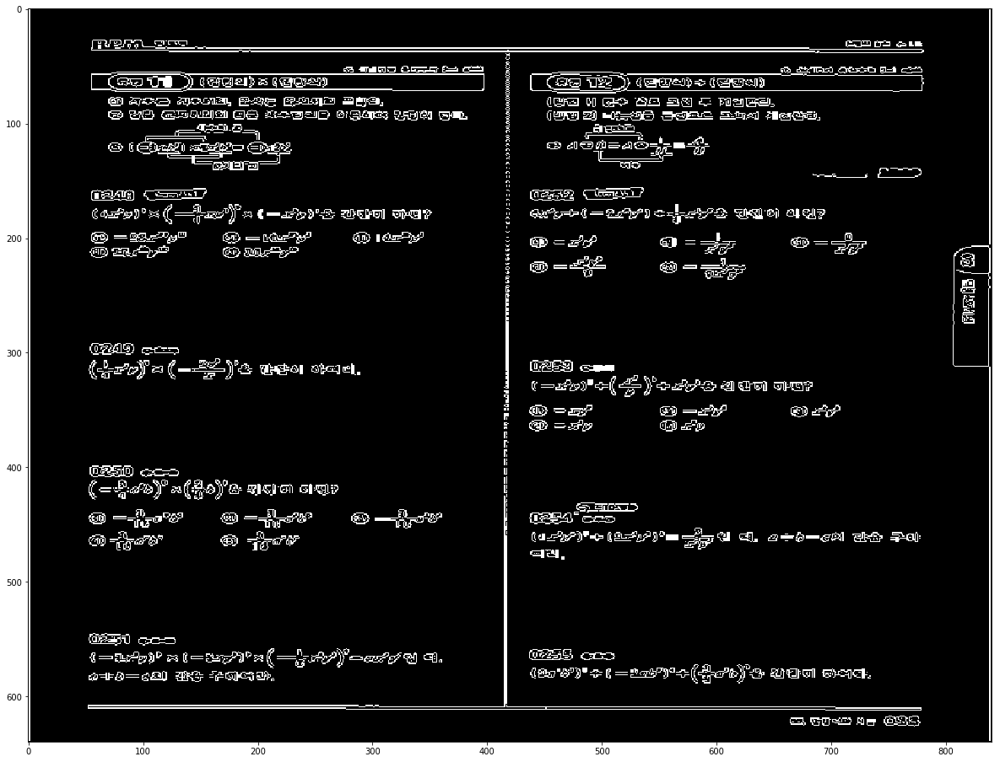

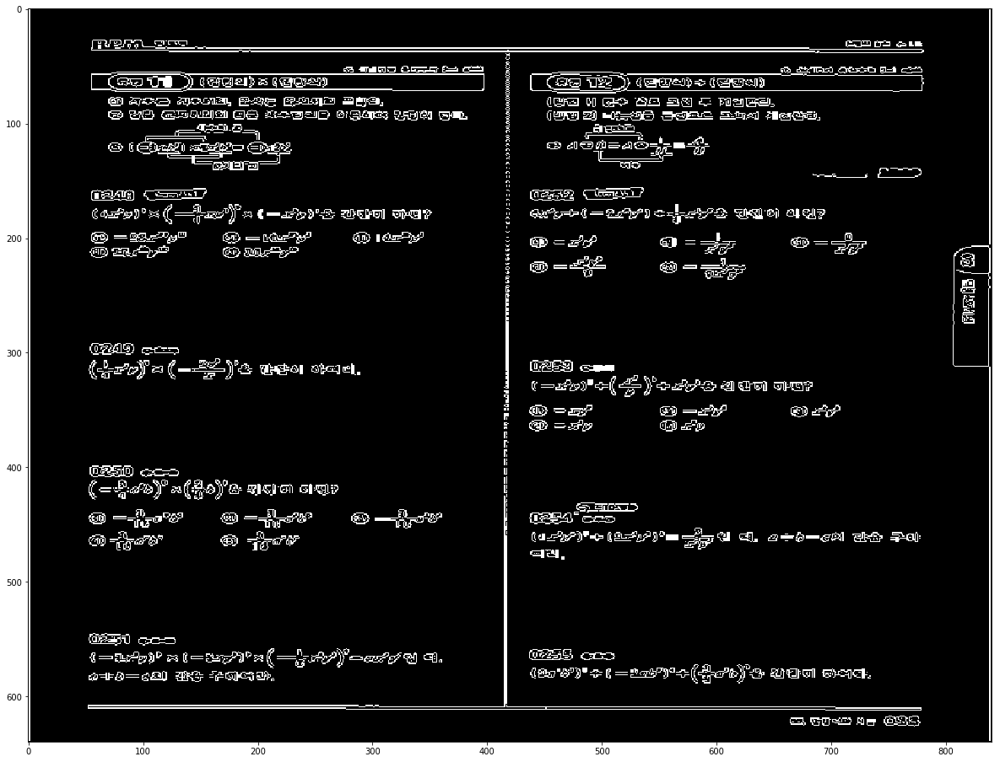

2  Pattern
IMG =  036 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

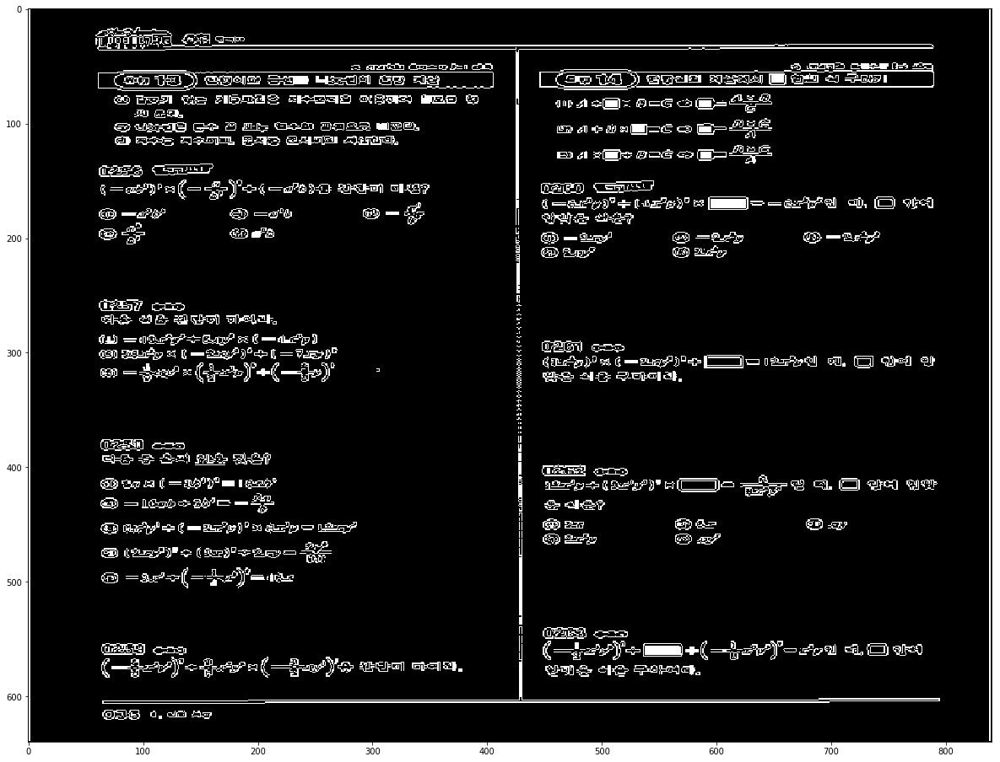

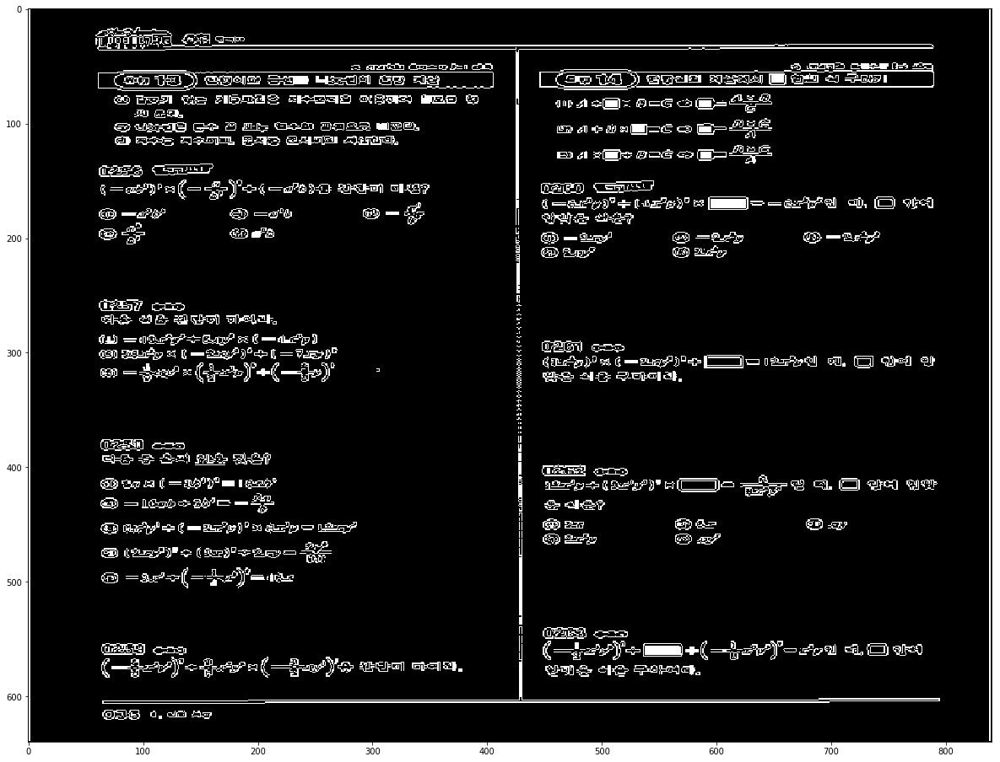

1  Pattern
IMG =  037 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

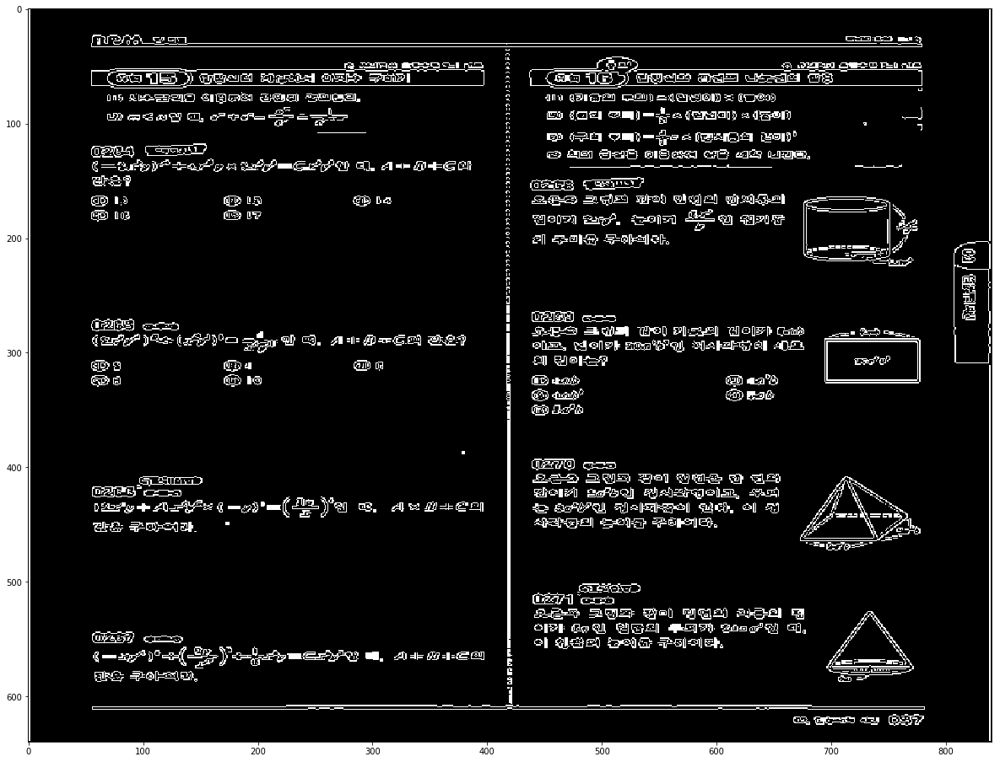

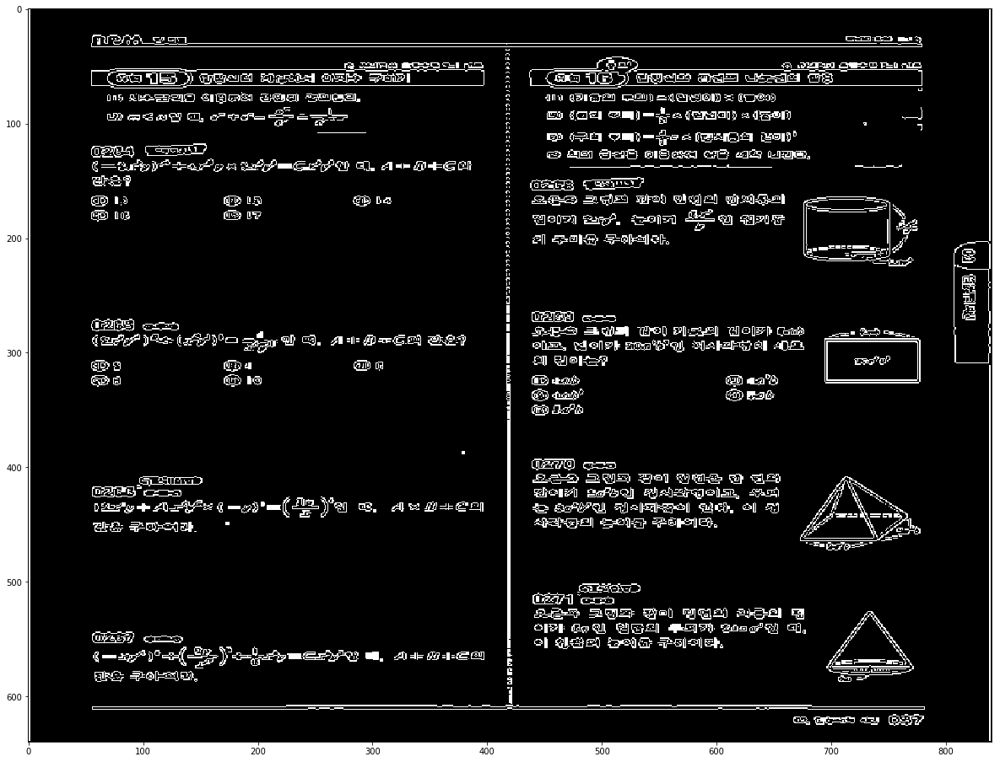

1  Pattern
IMG =  046 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

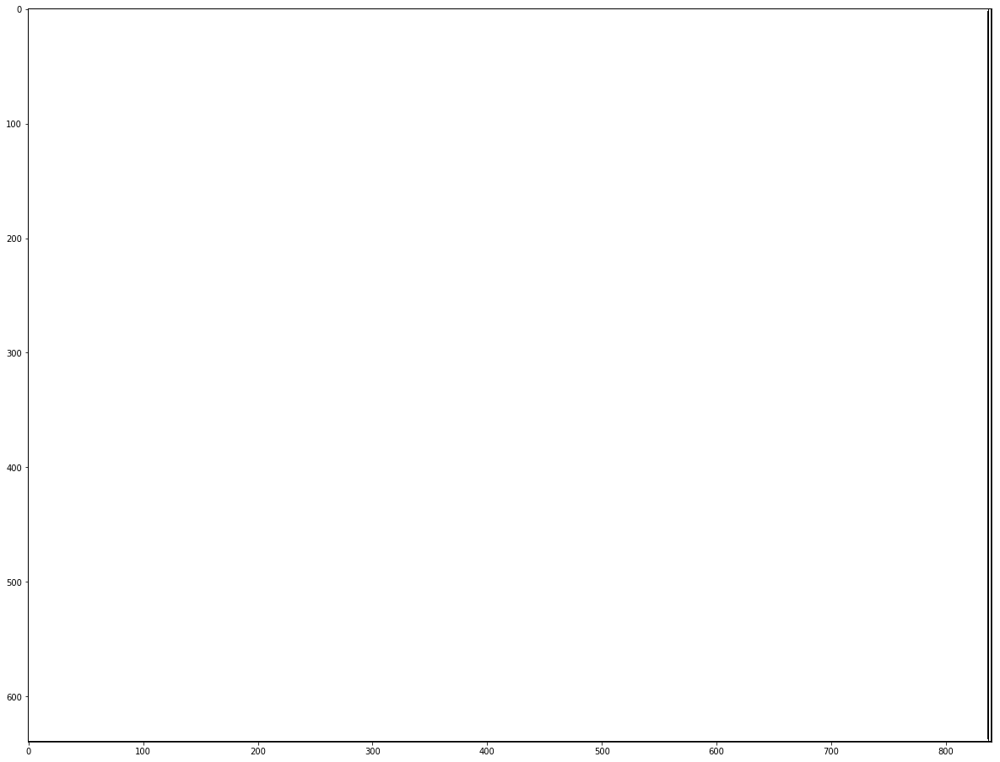

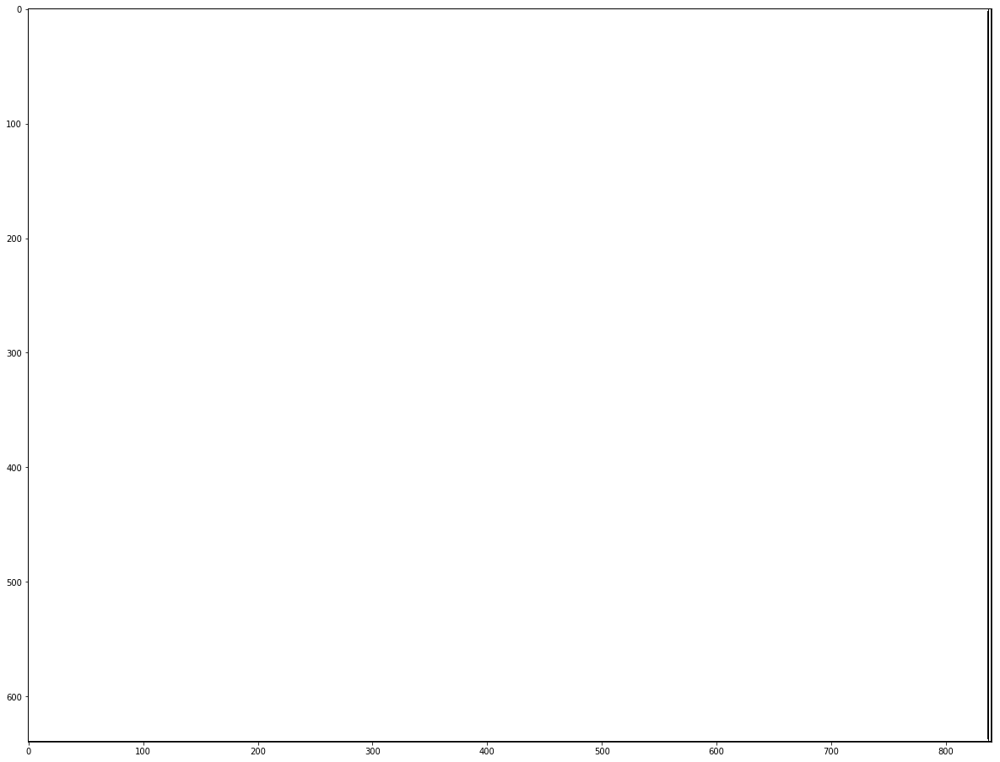

2  Pattern
IMG =  047 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

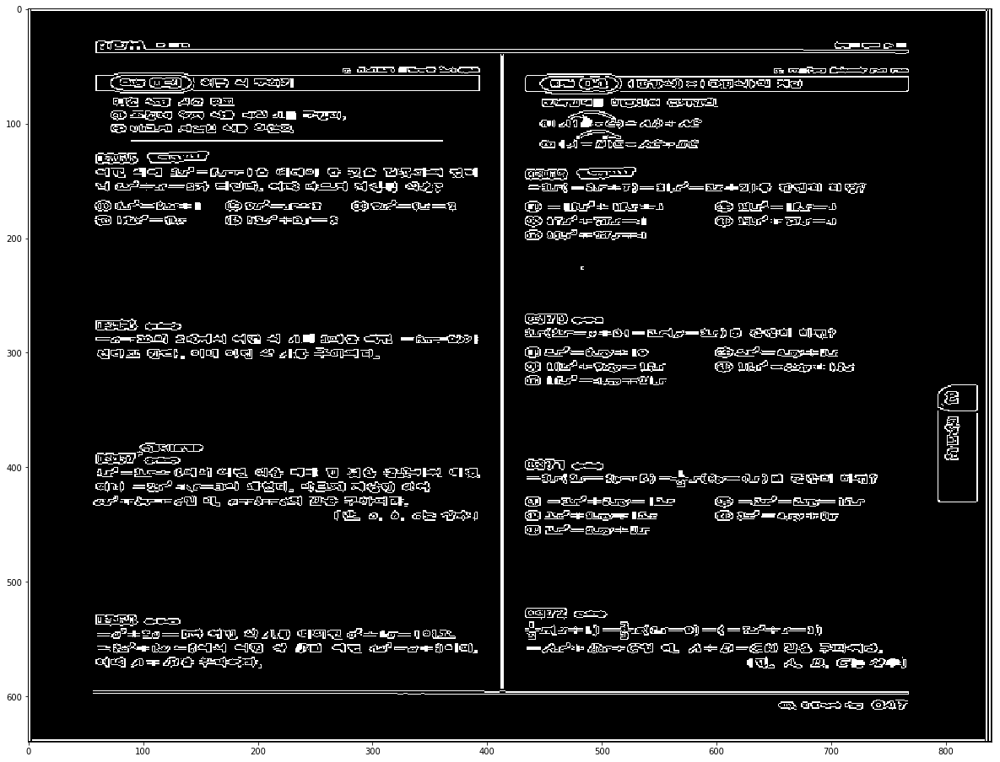

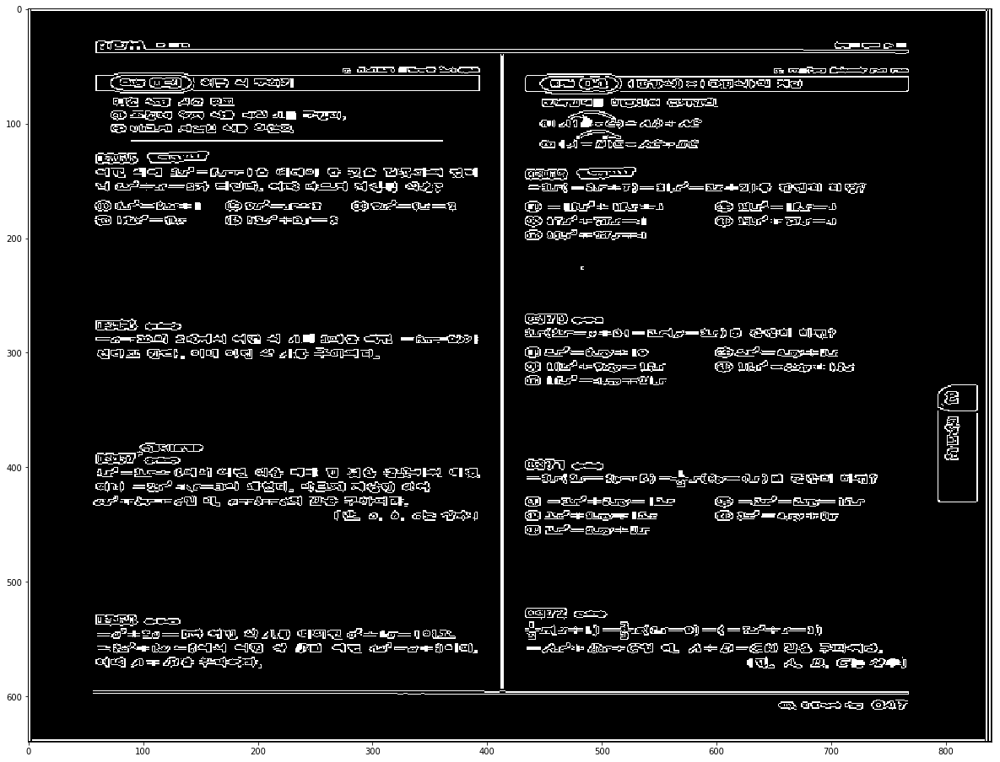

0  Pattern
IMG = 

C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


 048 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

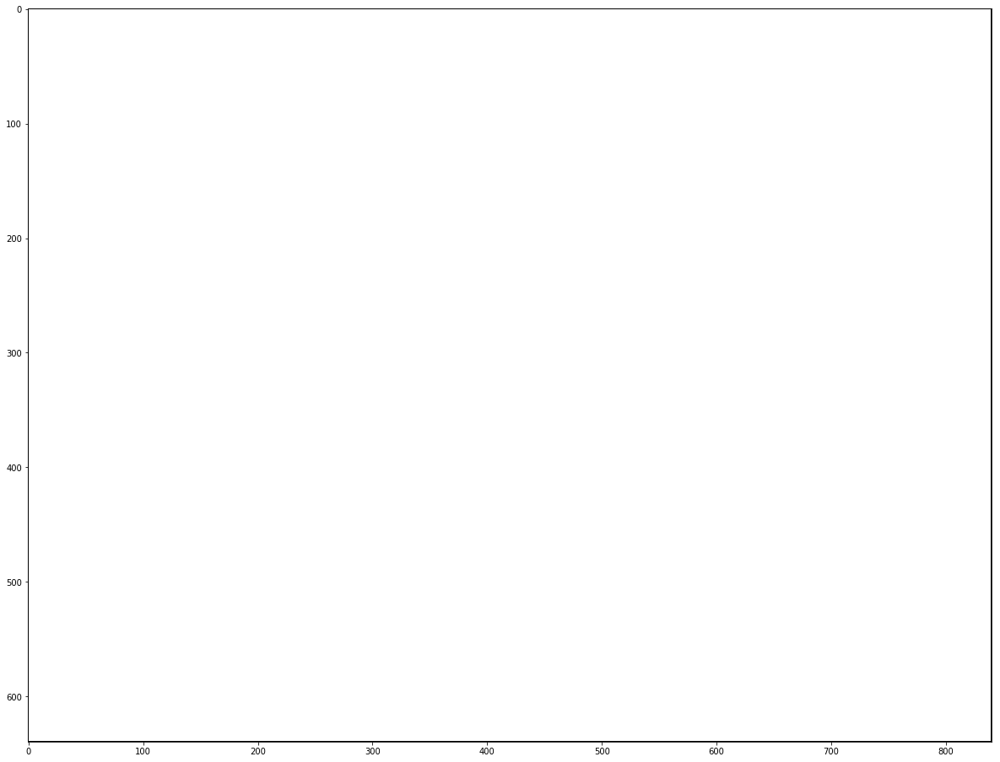

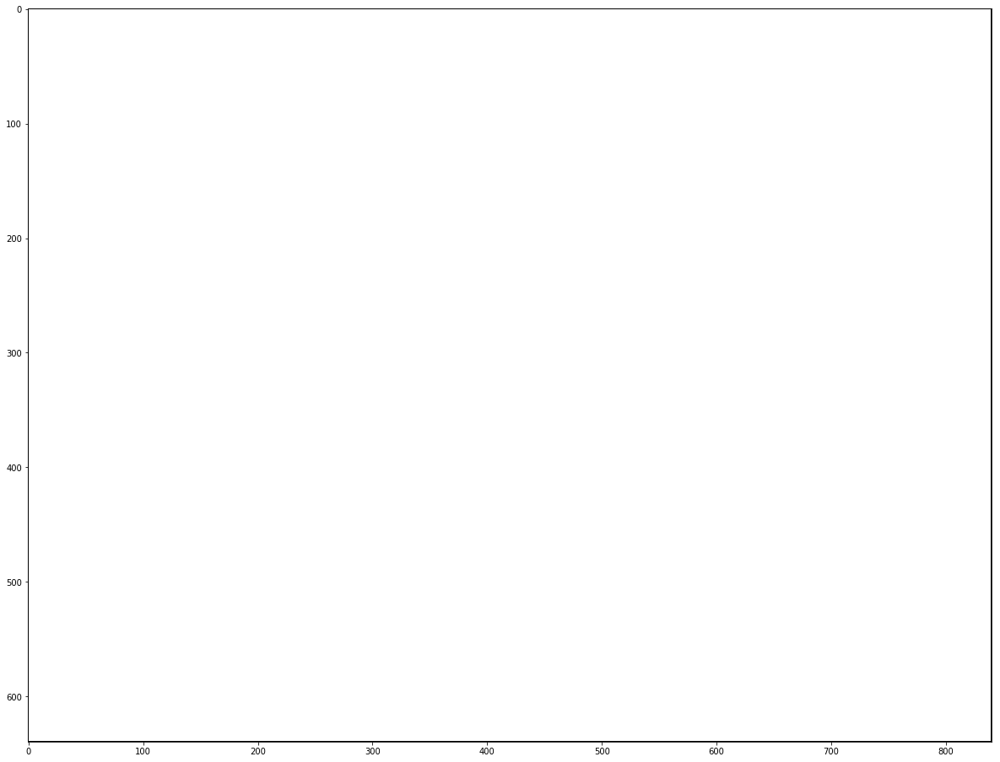

3  Pattern
IMG =  049 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

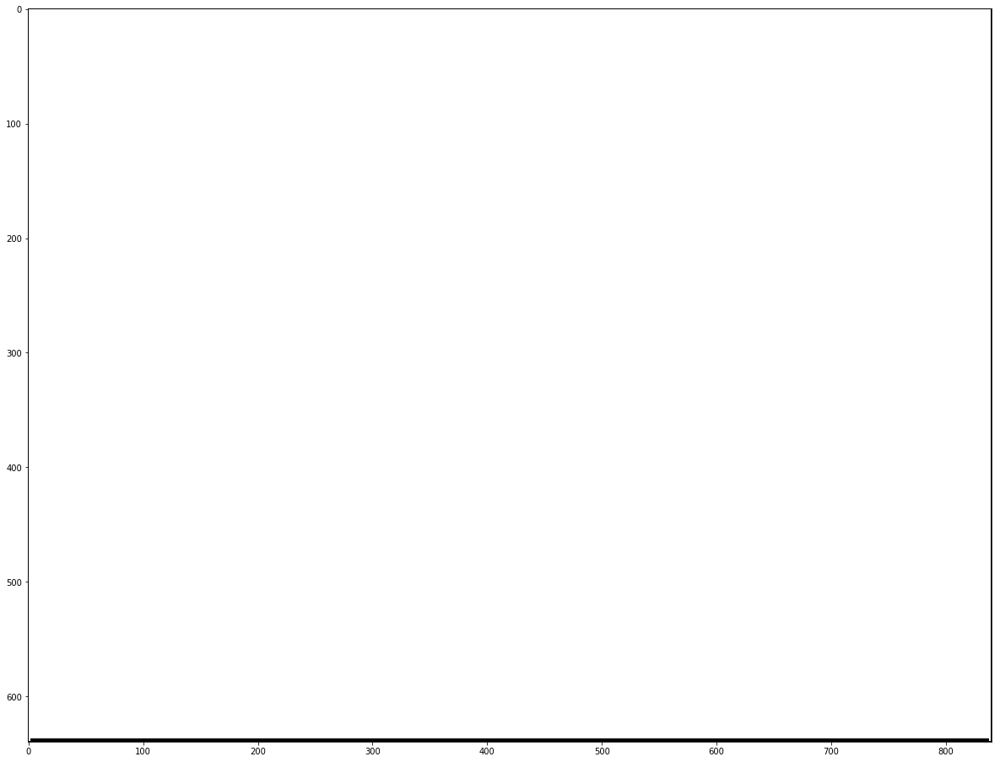

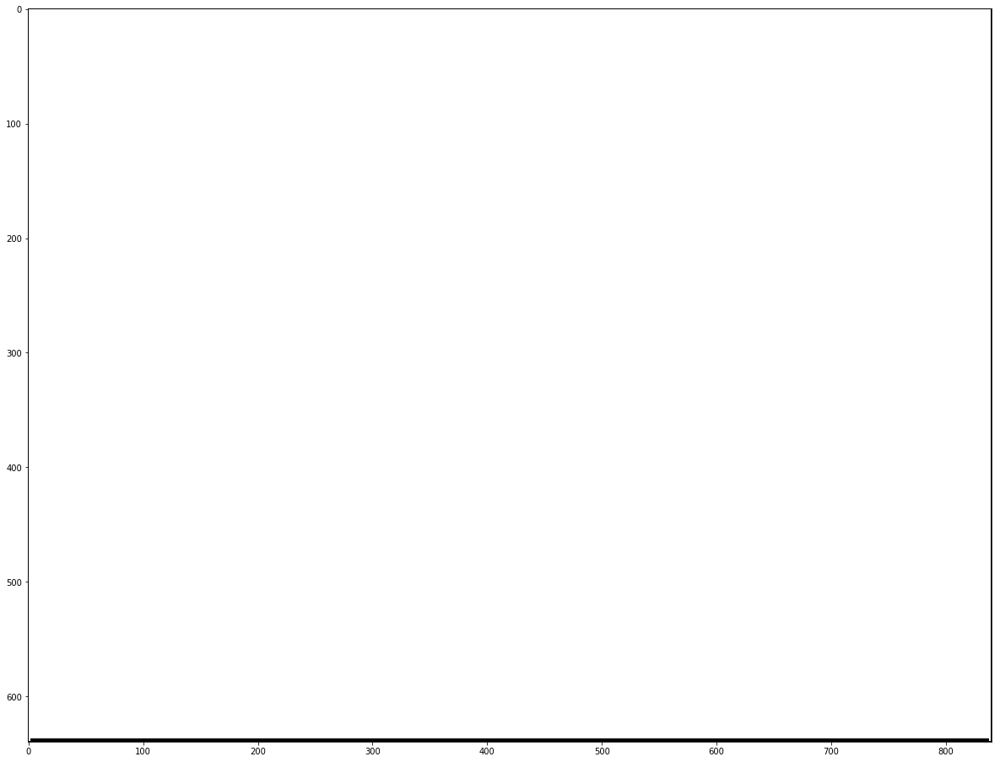

3  Pattern
IMG =  050 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

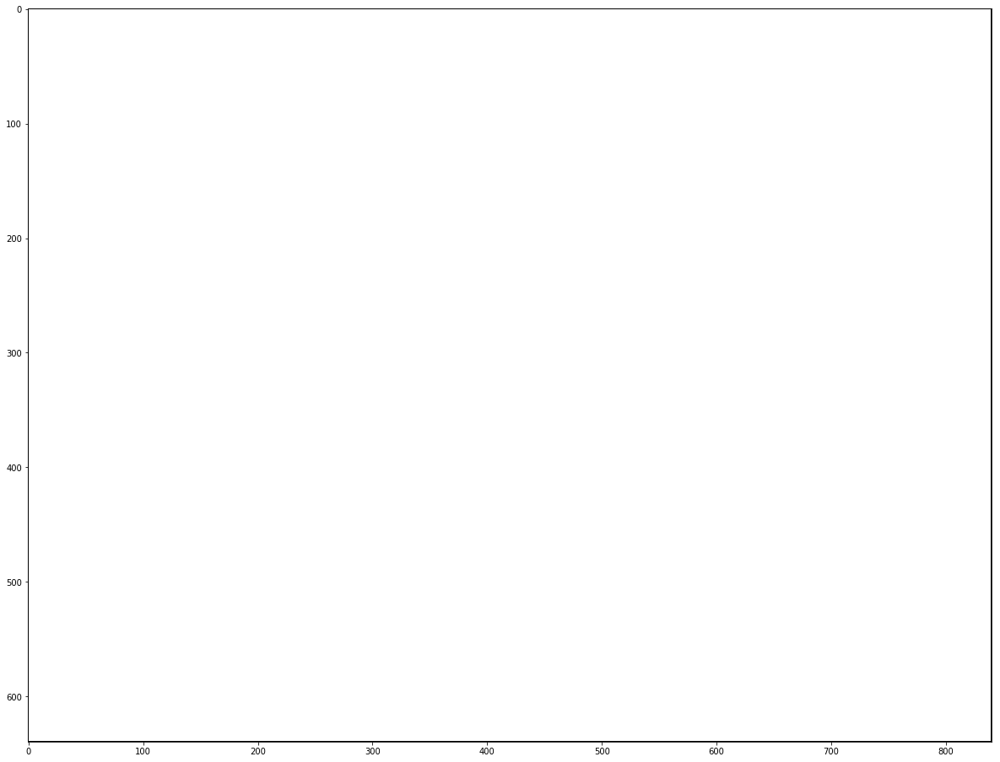

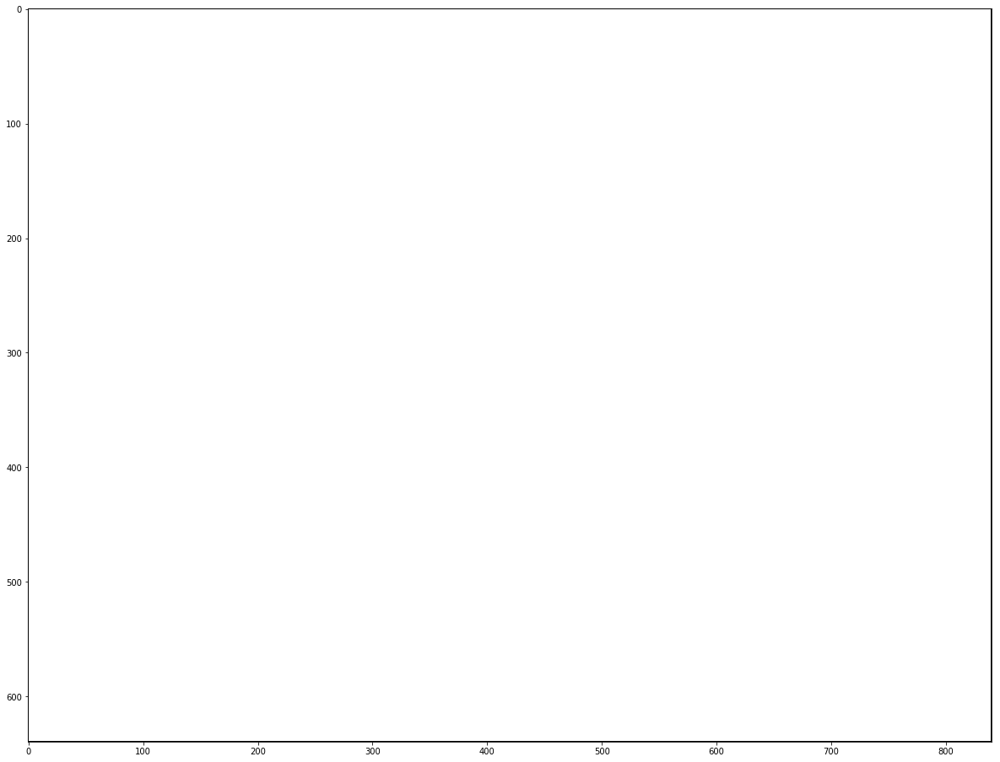

0  Pattern
IMG =  051 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

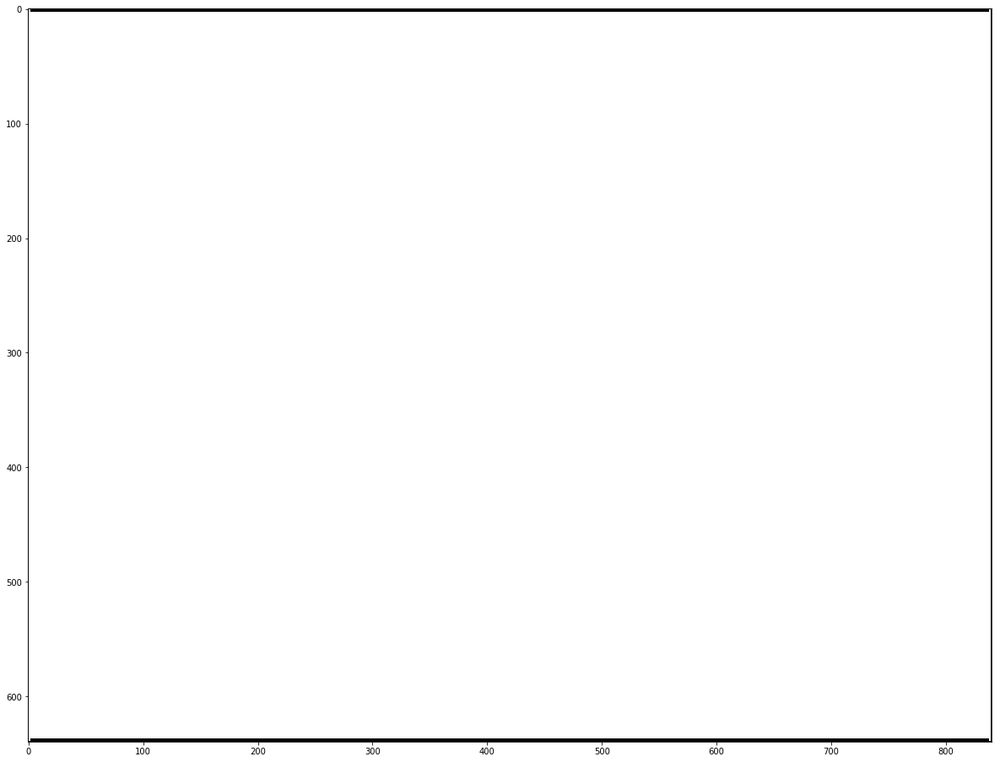

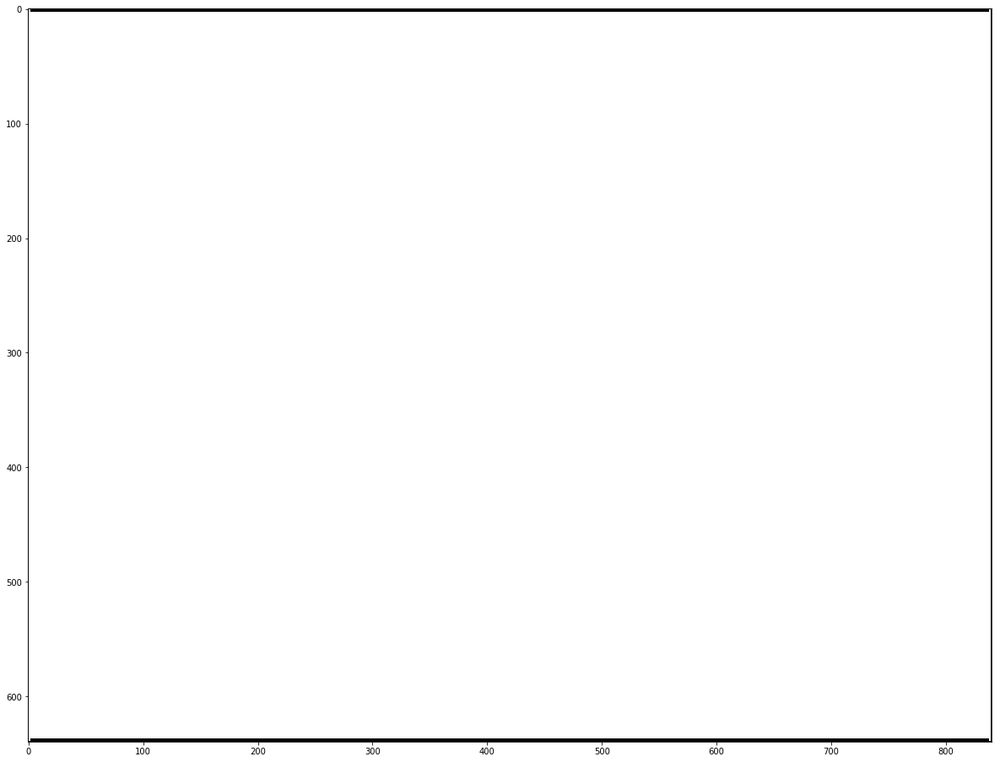

2  Pattern
IMG =  052 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

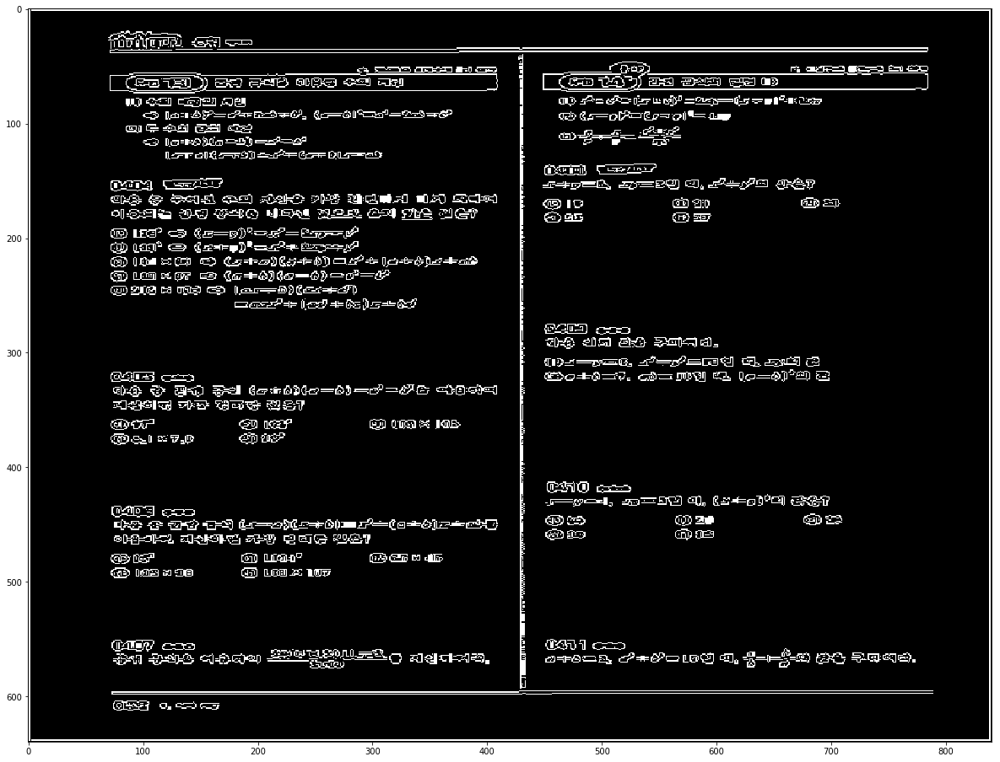

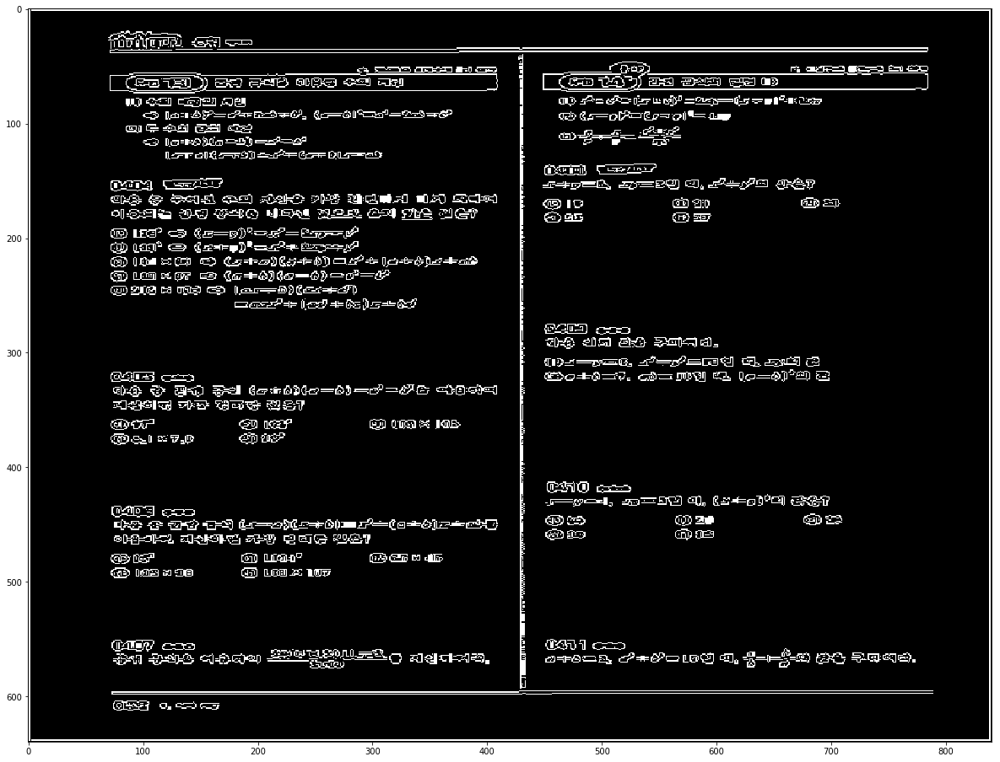

1  Pattern
IMG =  053 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

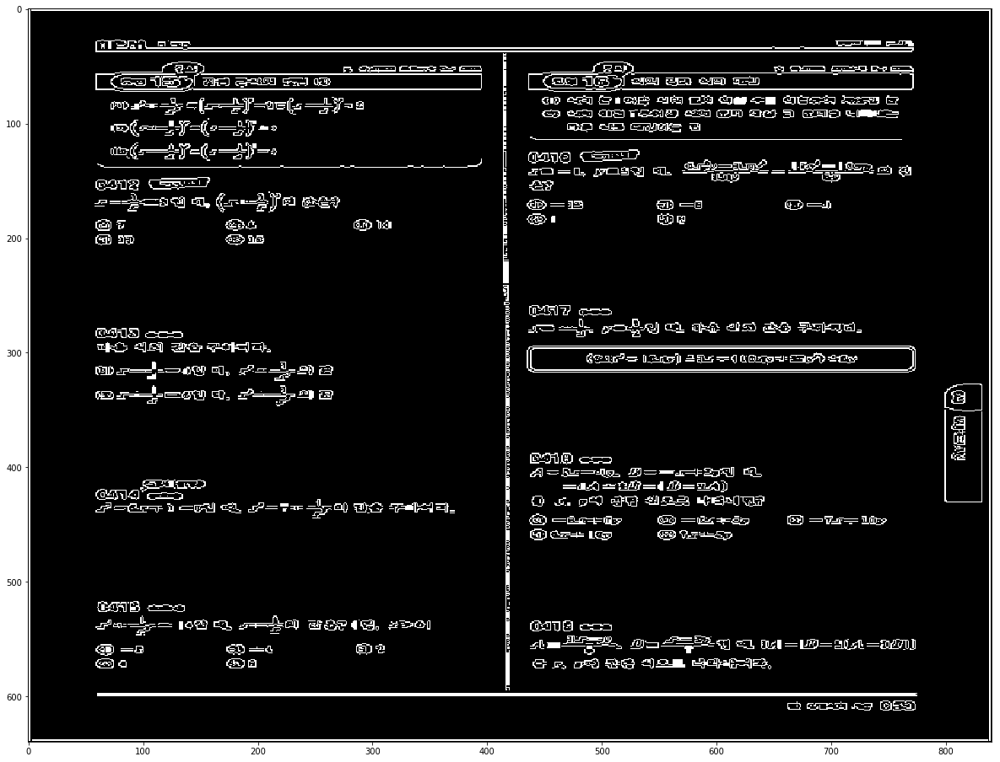

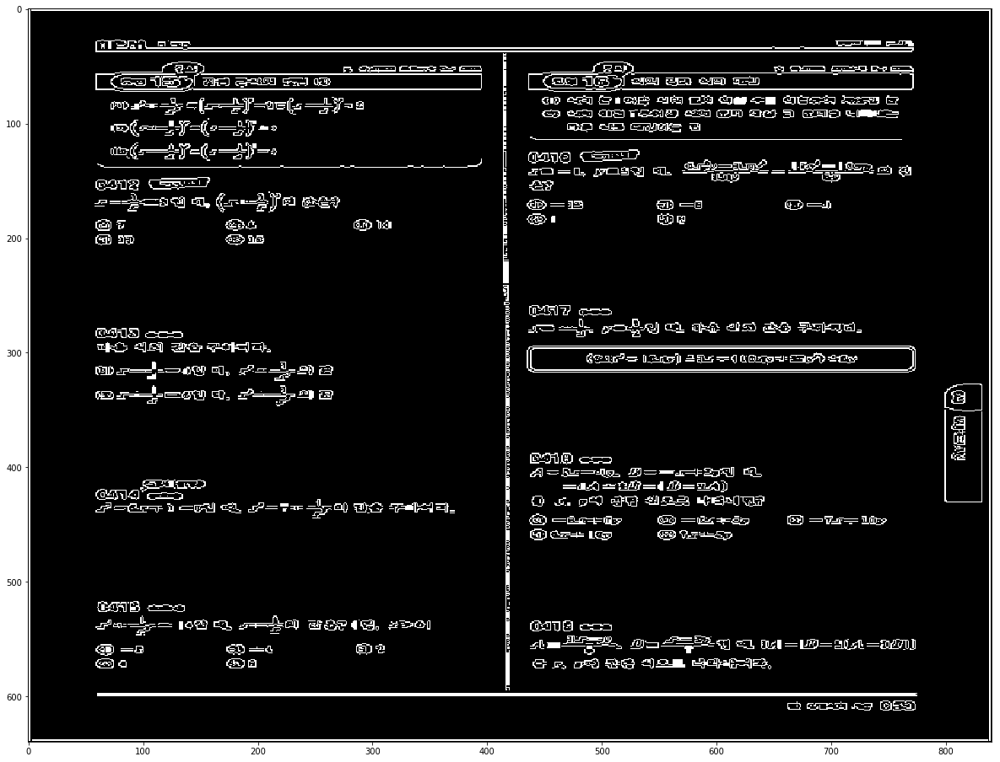

1  Pattern
IMG =  054 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

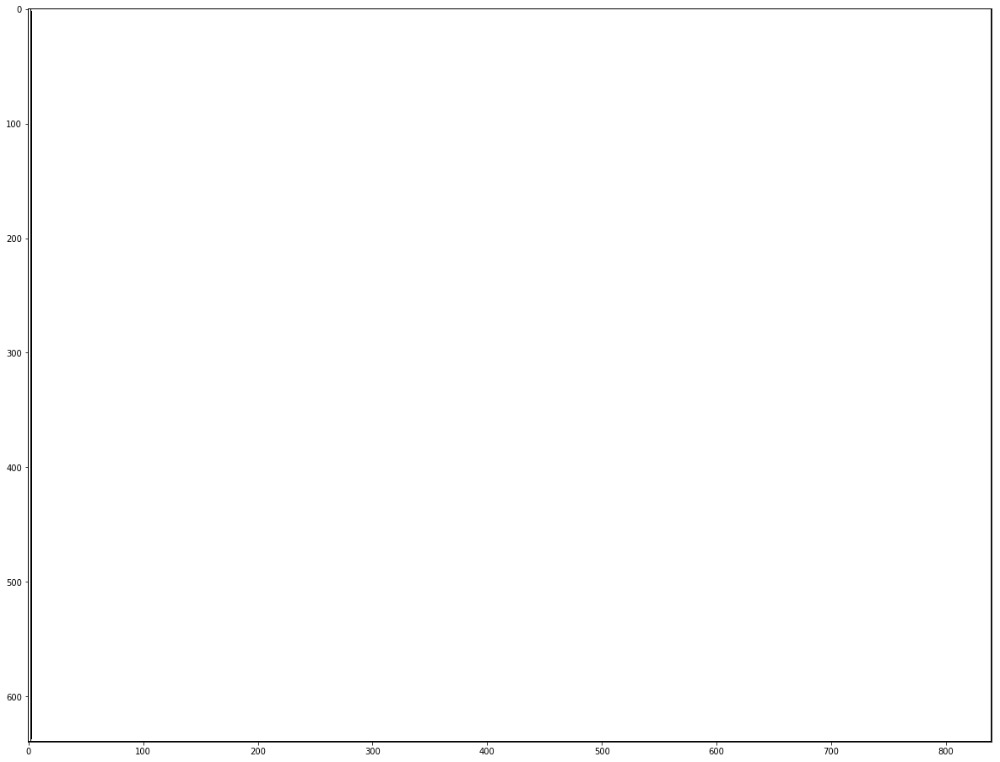

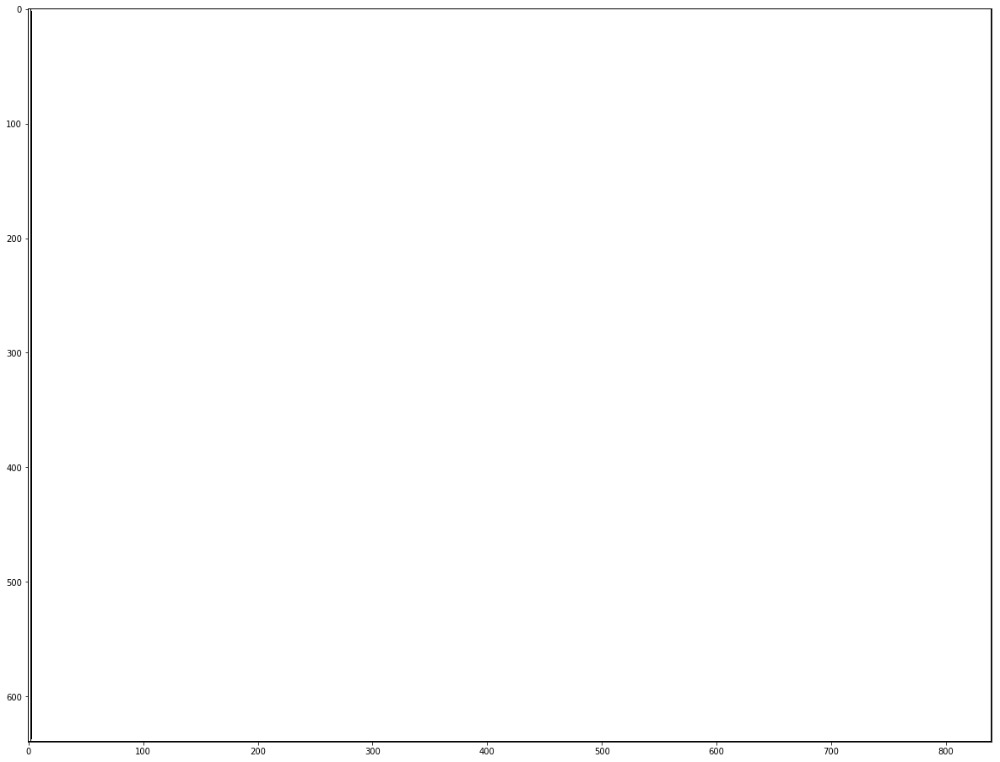

2  Pattern
IMG =  055 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

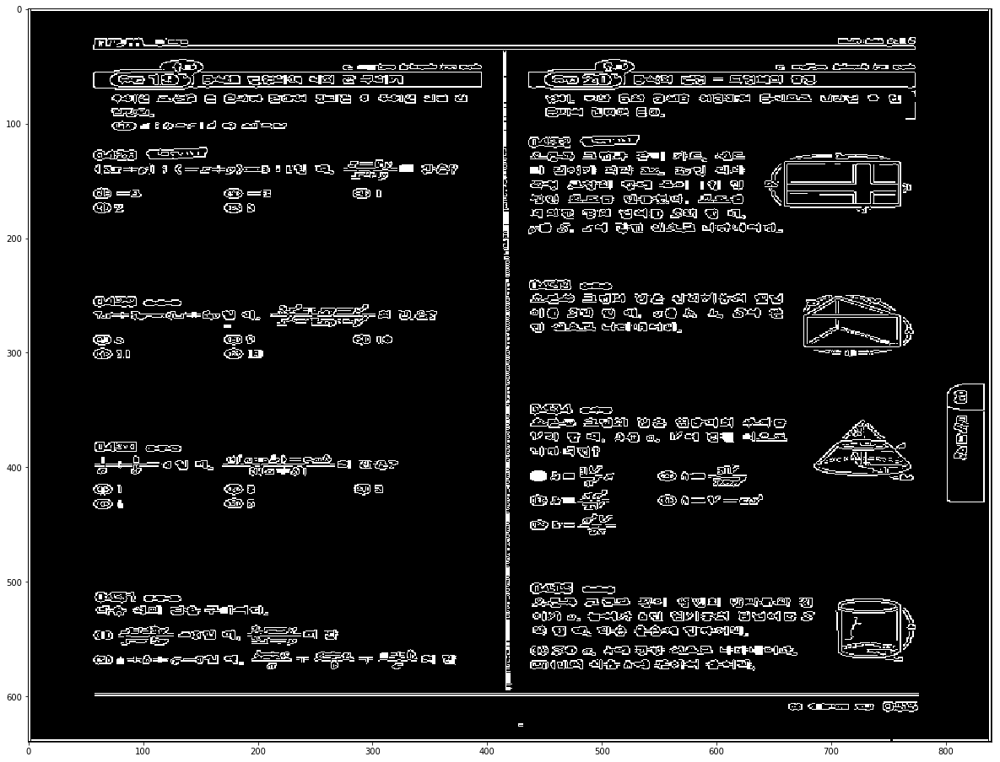

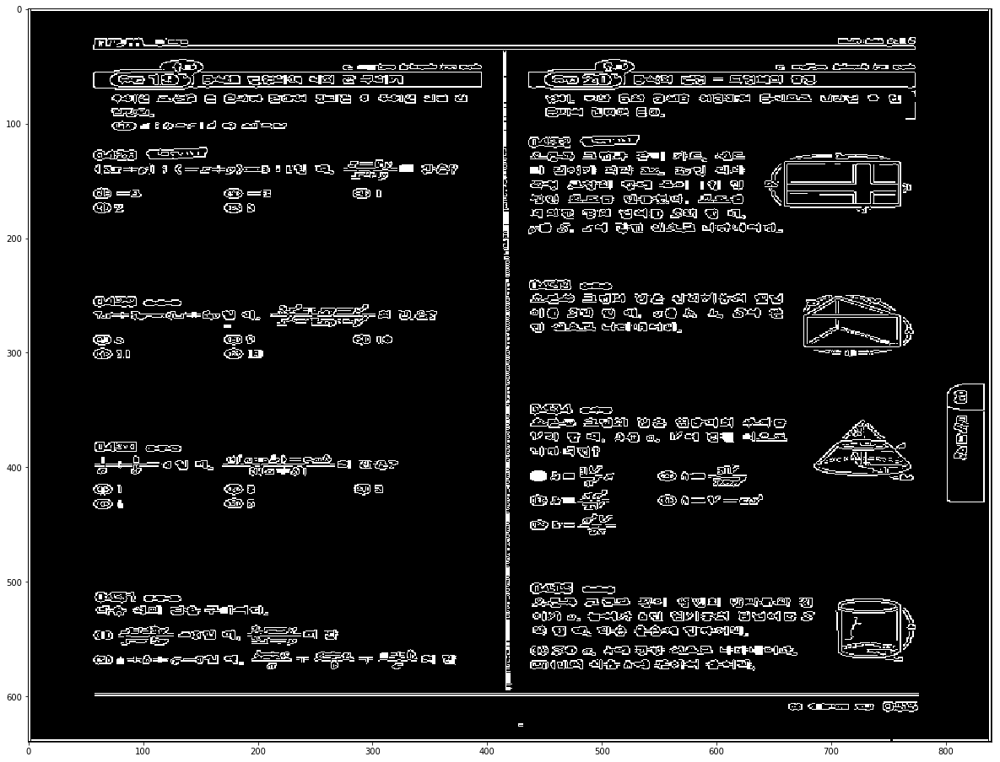

0  Pattern


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


IMG =  066 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

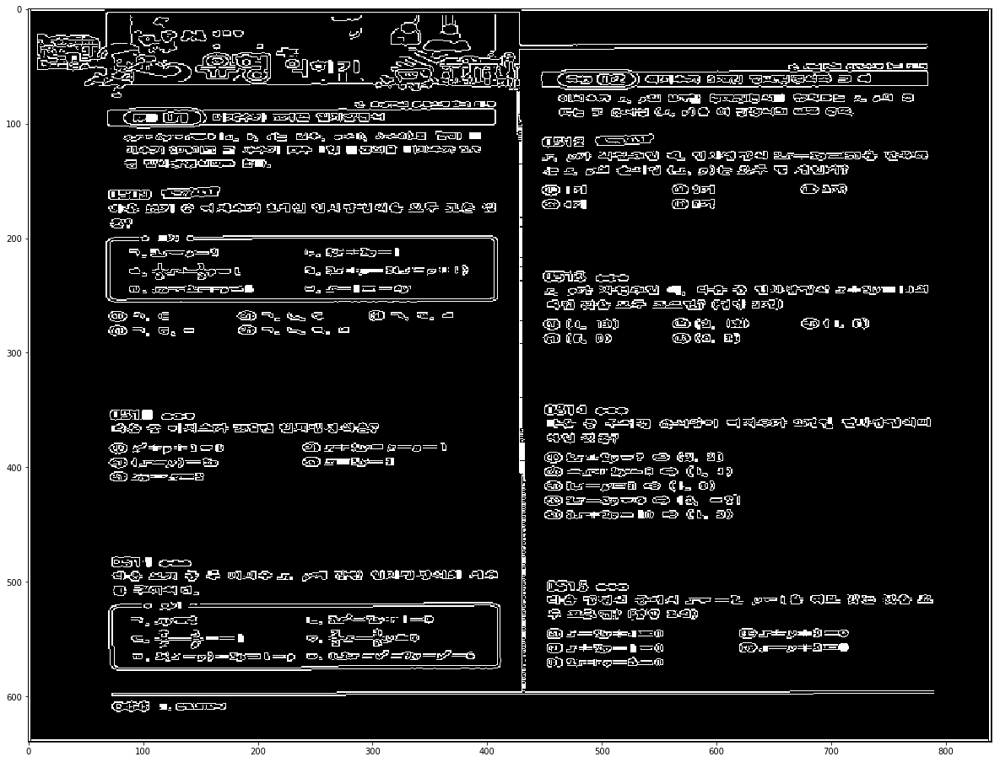

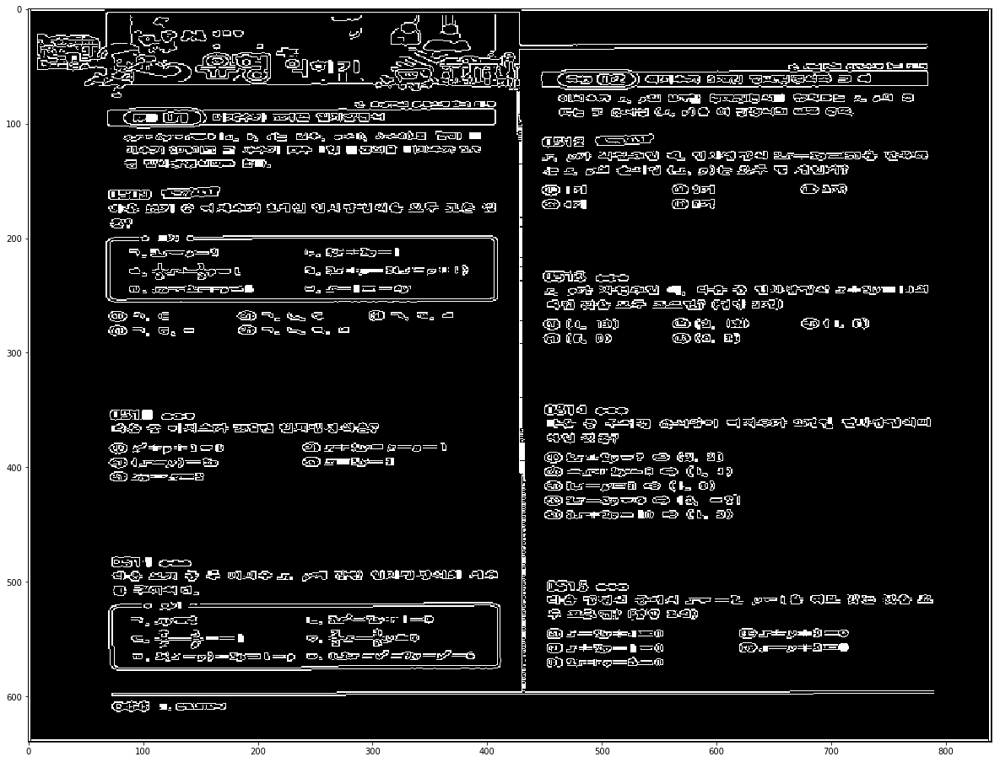

3  Pattern
IMG =  068 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

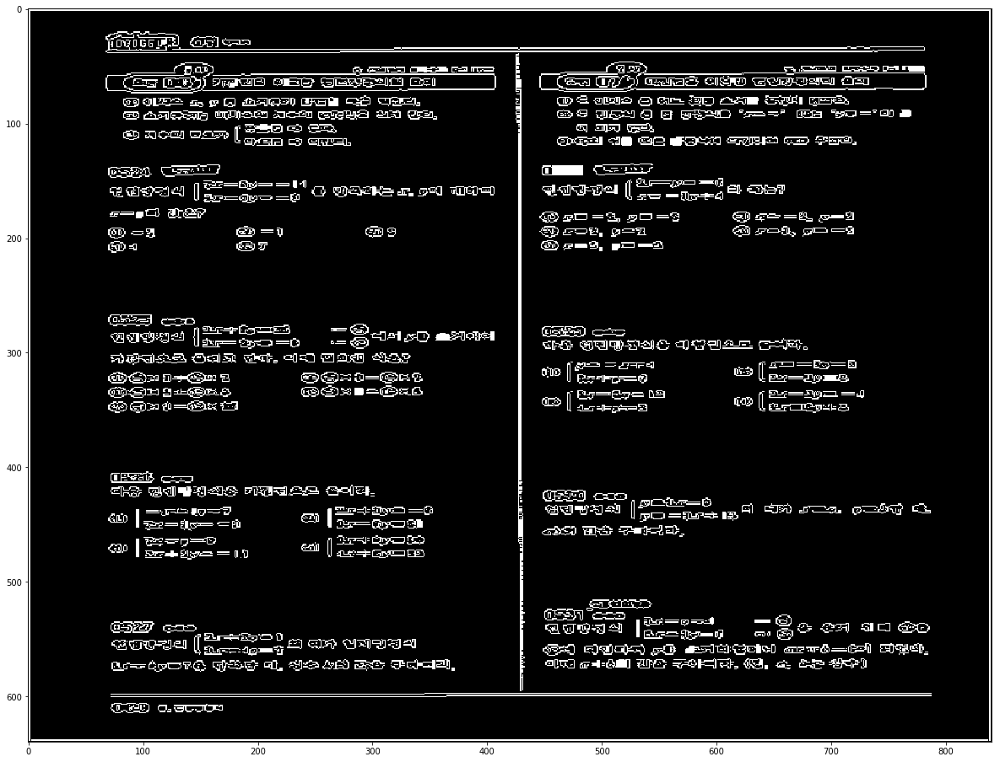

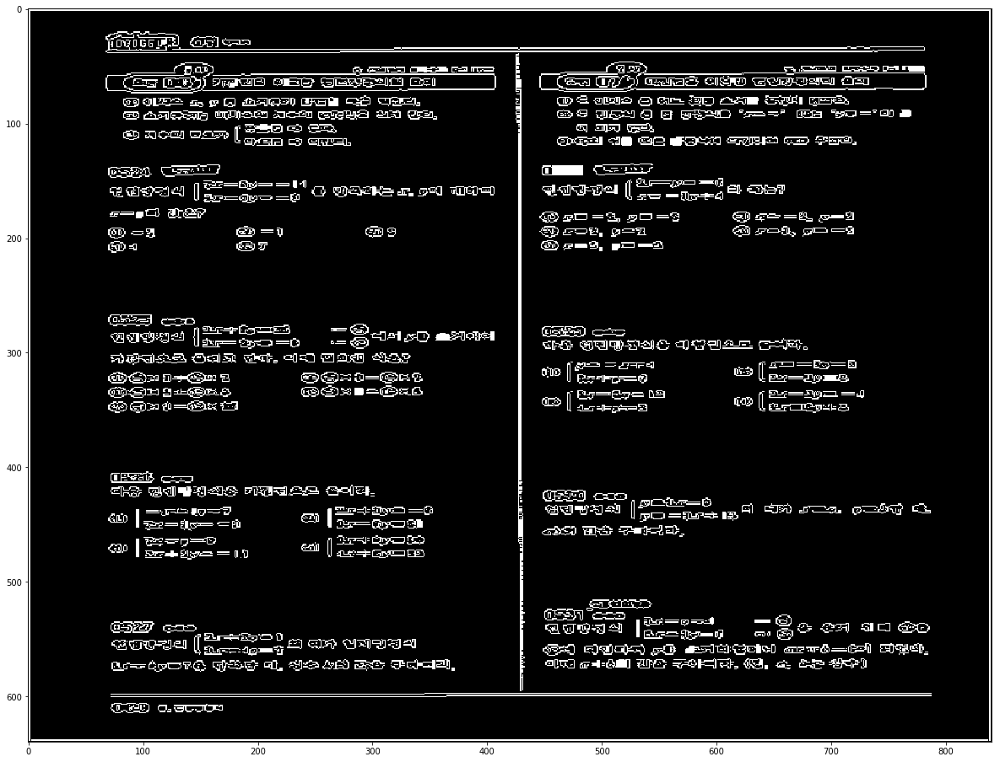

3  Pattern
IMG = 

C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


 069 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

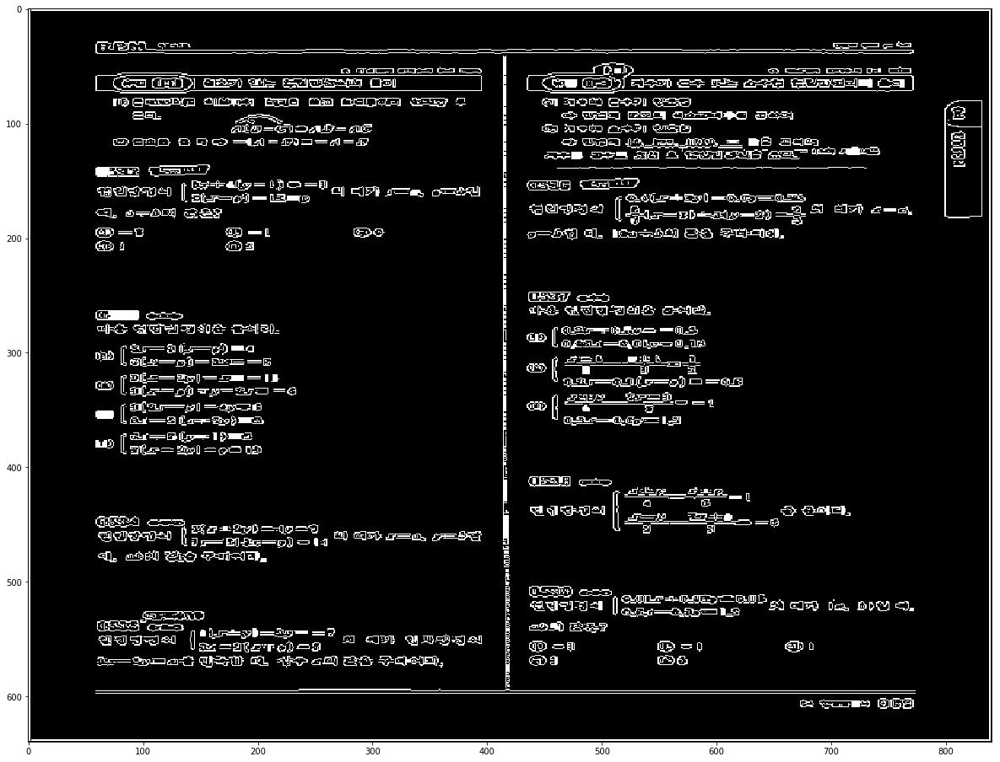

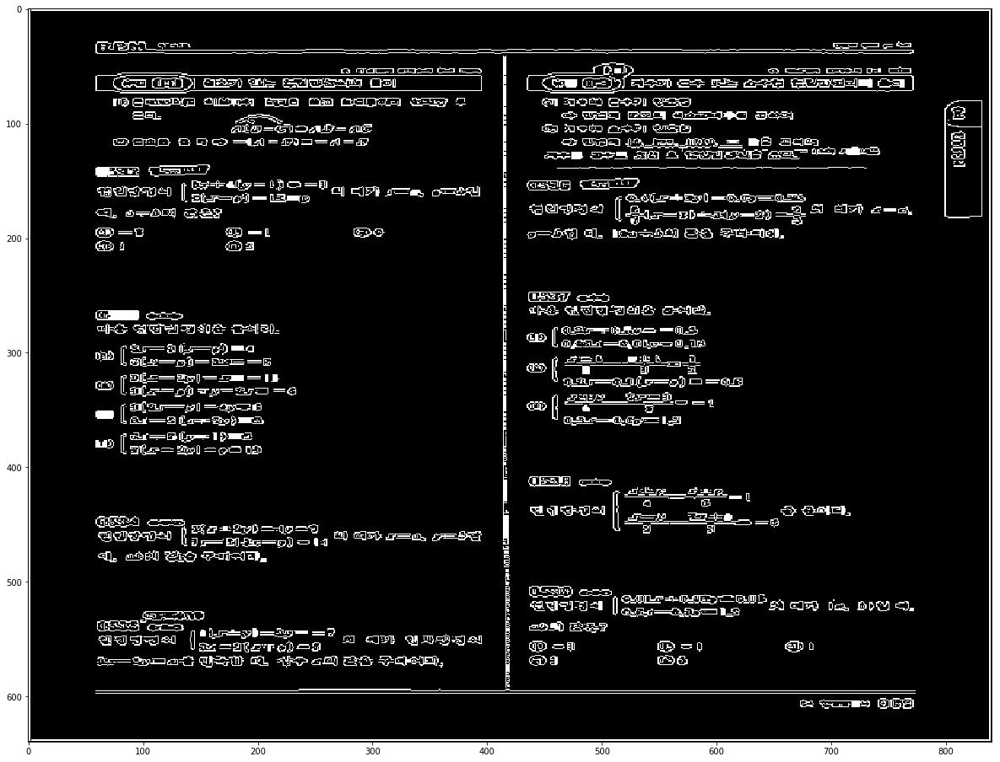

0  Pattern
IMG =  071 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

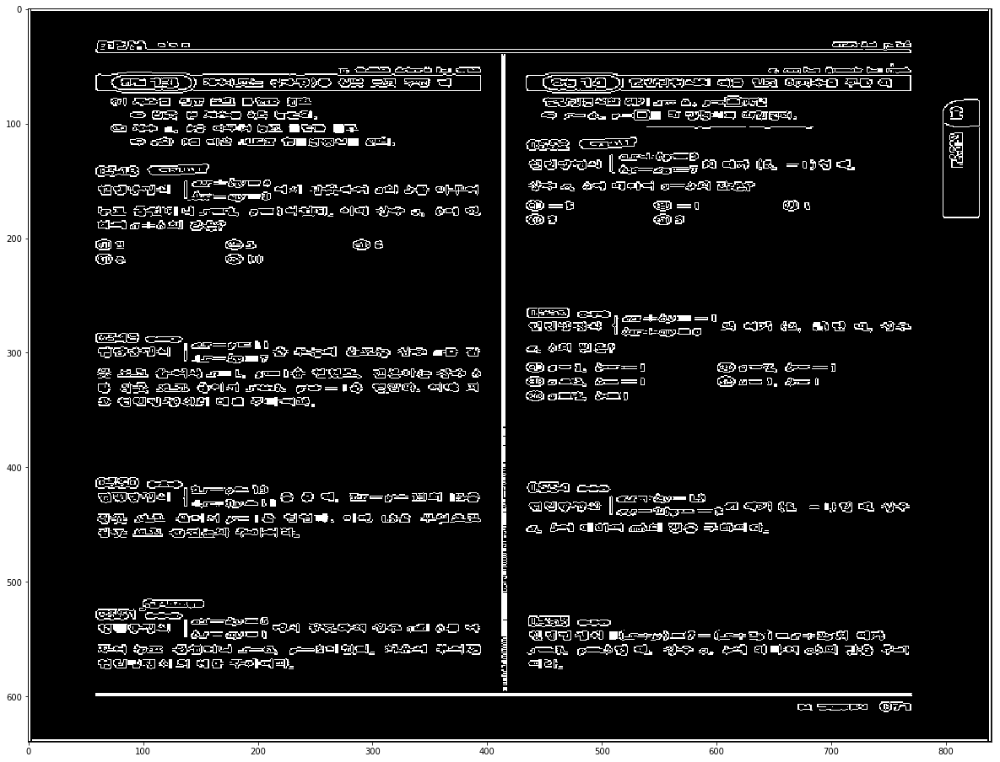

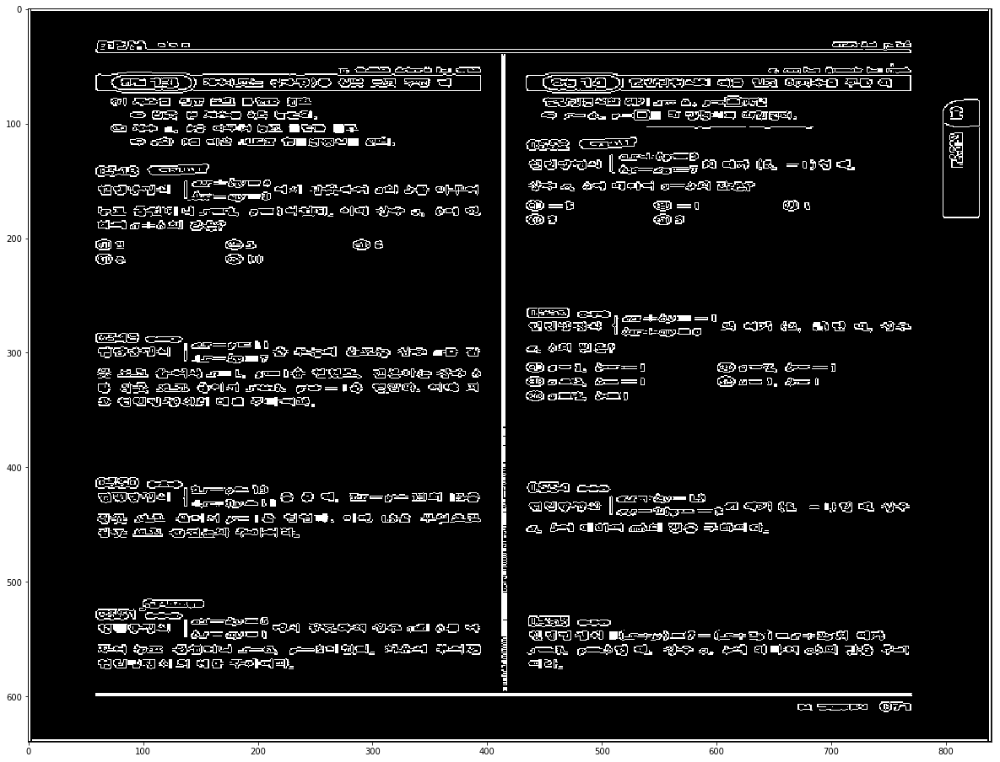

2  Pattern
IMG =  072 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

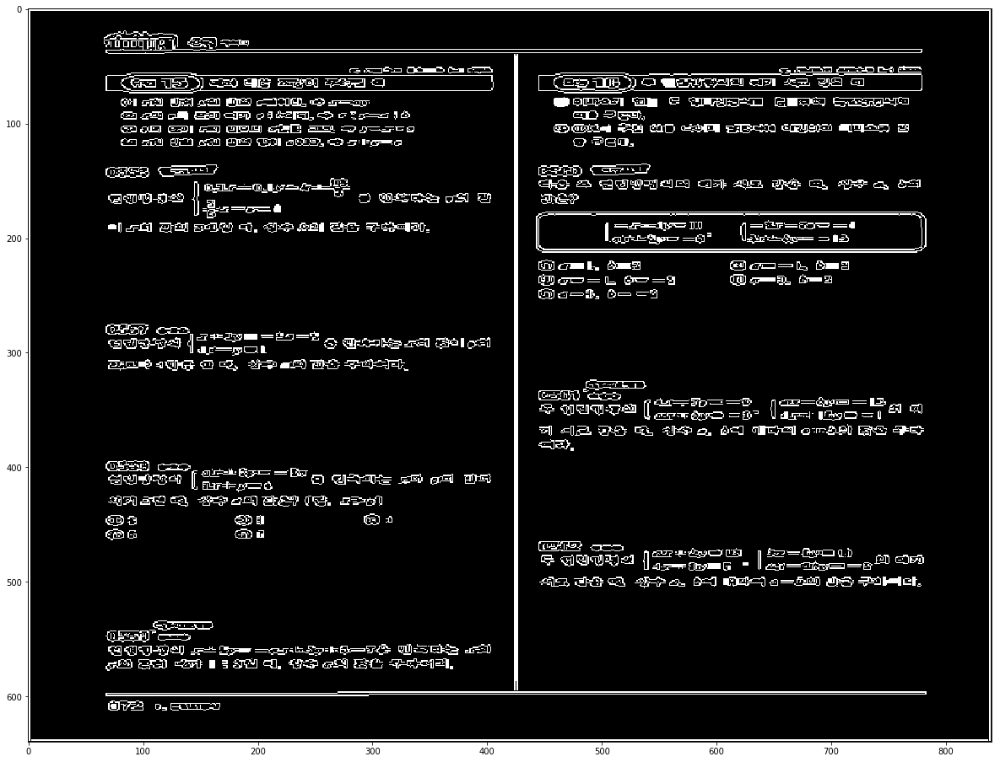

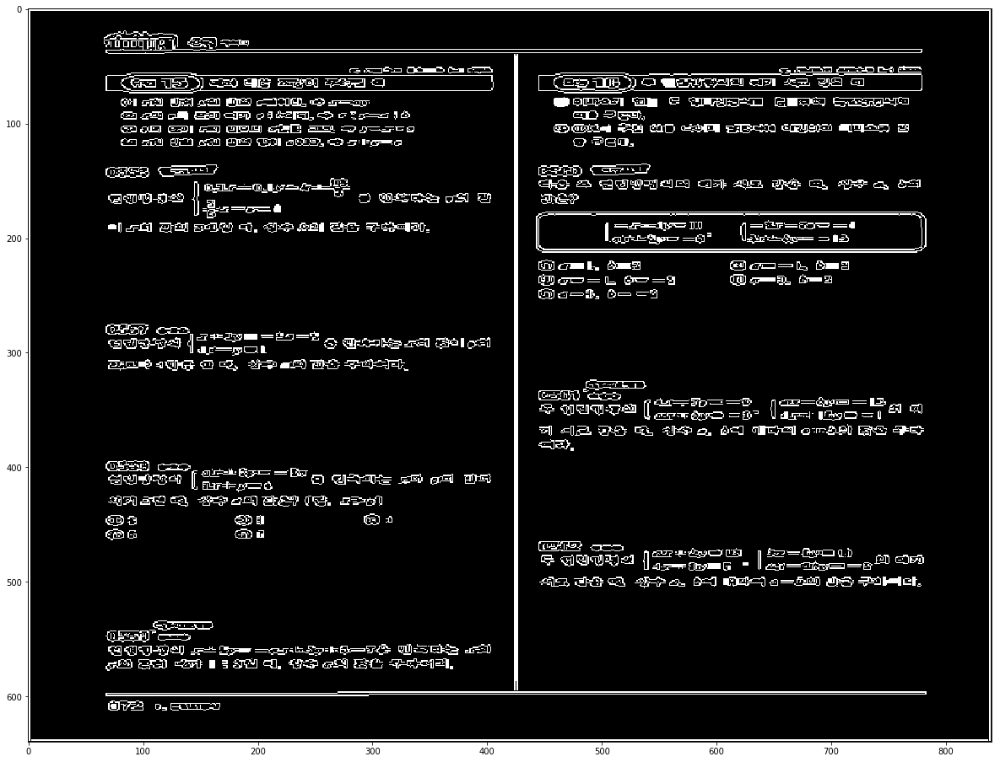

1  Pattern
IMG =  073 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

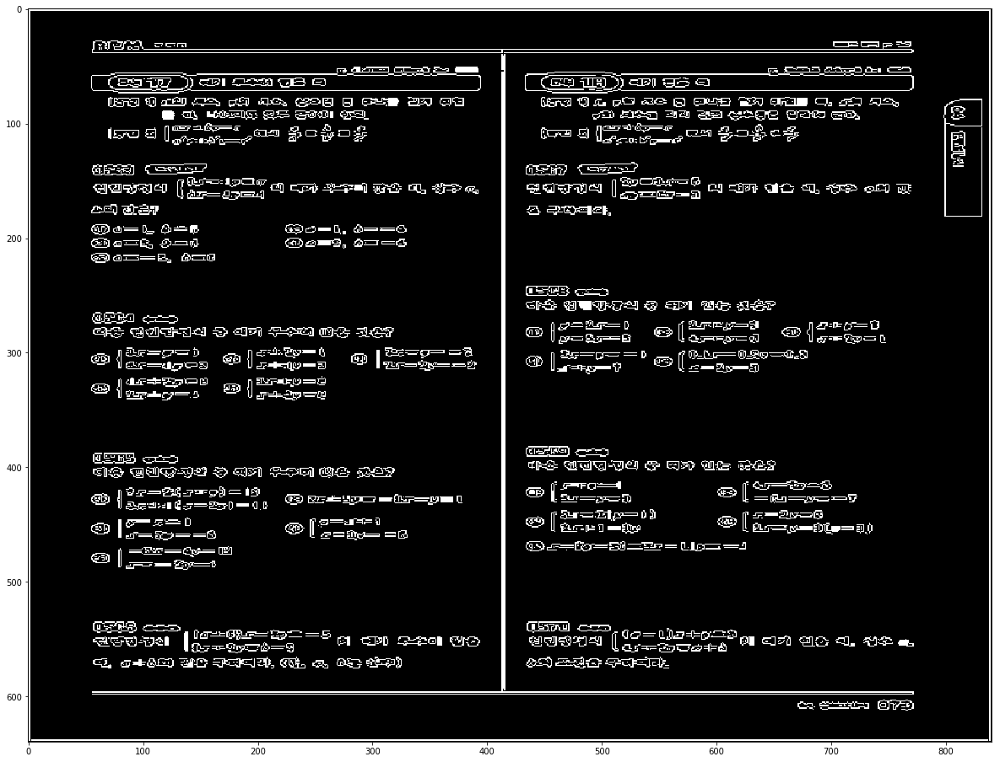

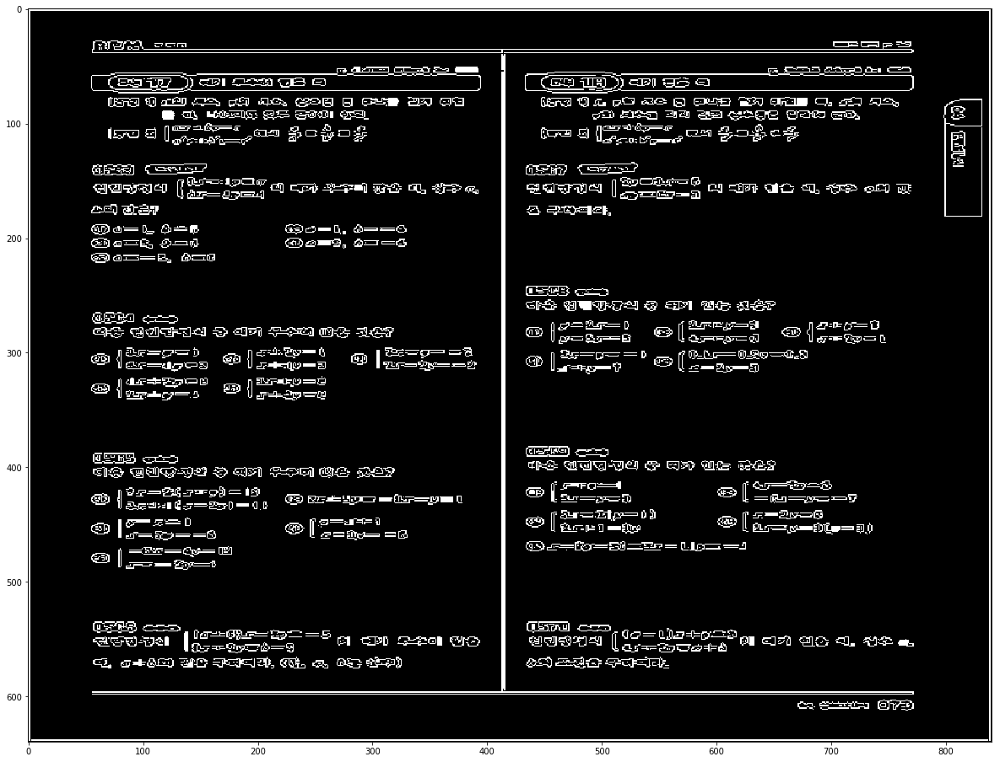

1  Pattern


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


IMG =  081 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

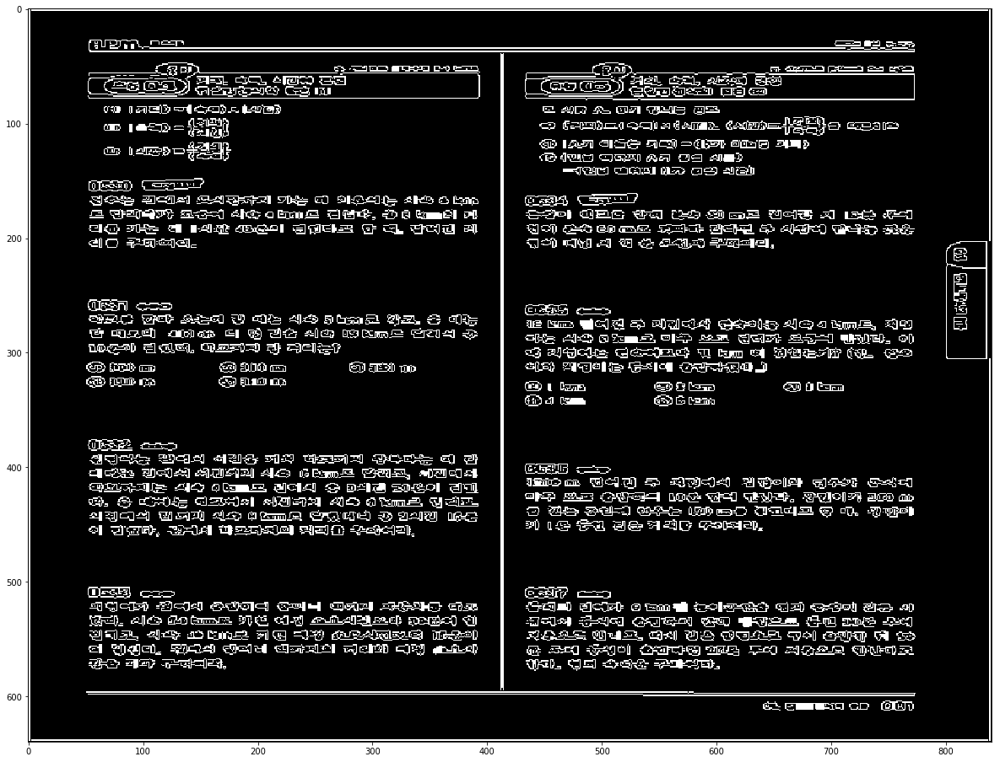

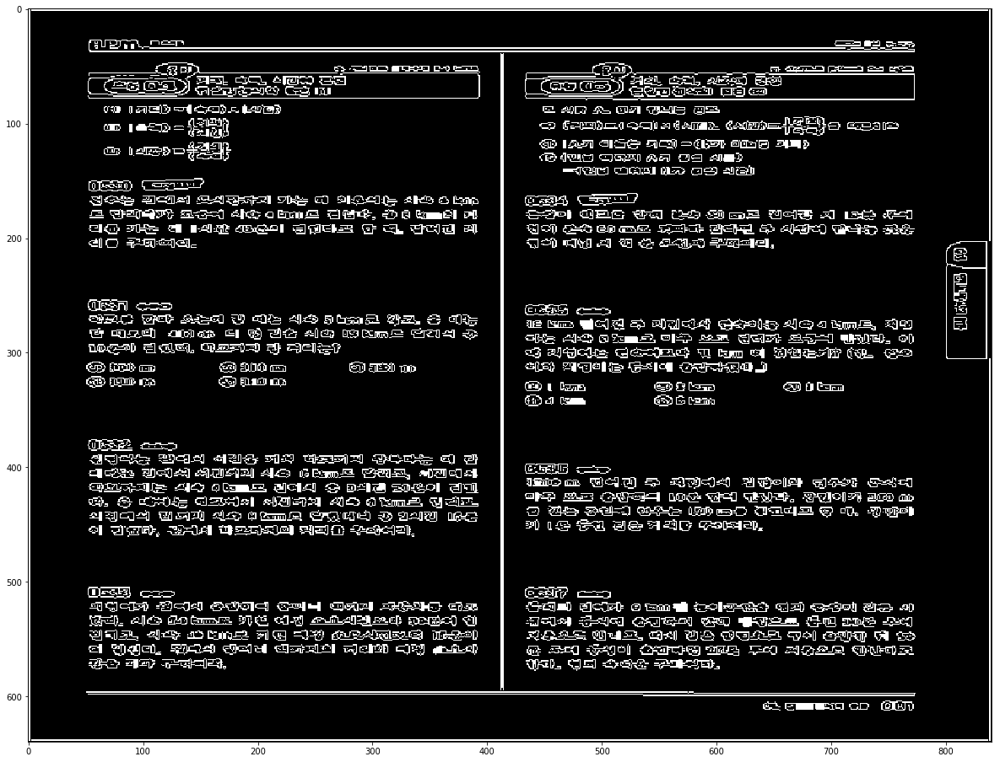

2  Pattern
IMG =  082 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

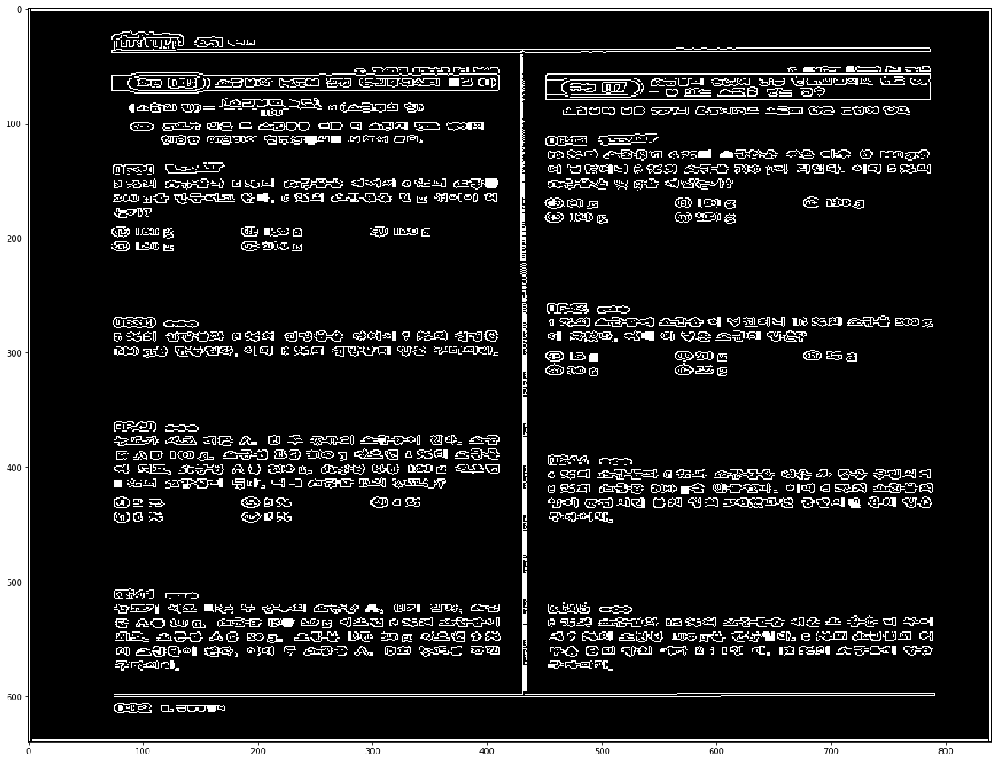

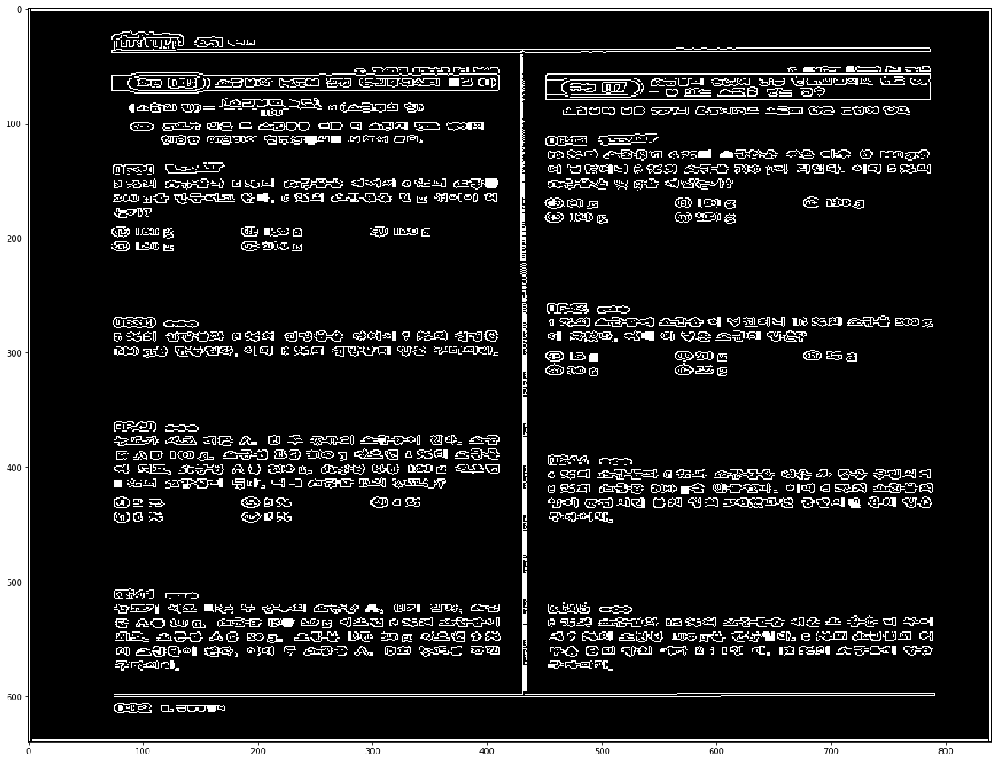

0  Pattern
IMG =  083 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

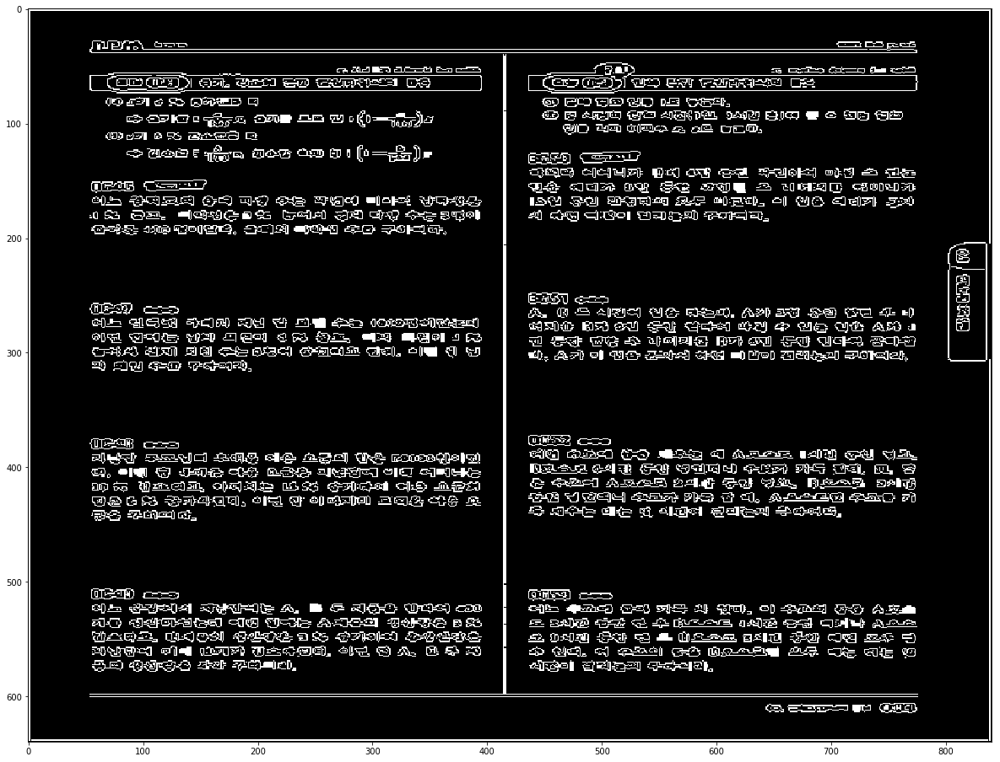

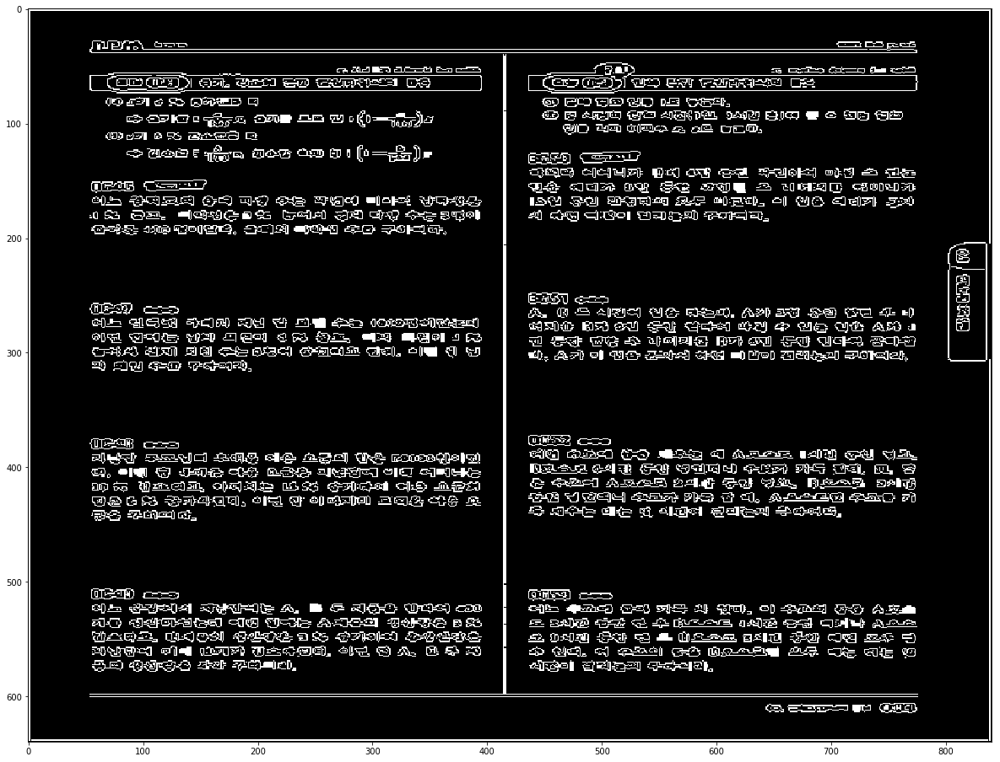

3  Pattern


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


IMG =  097 ( WIDTH :  840  HEIGHT :  640  )


<Figure size 432x288 with 0 Axes>

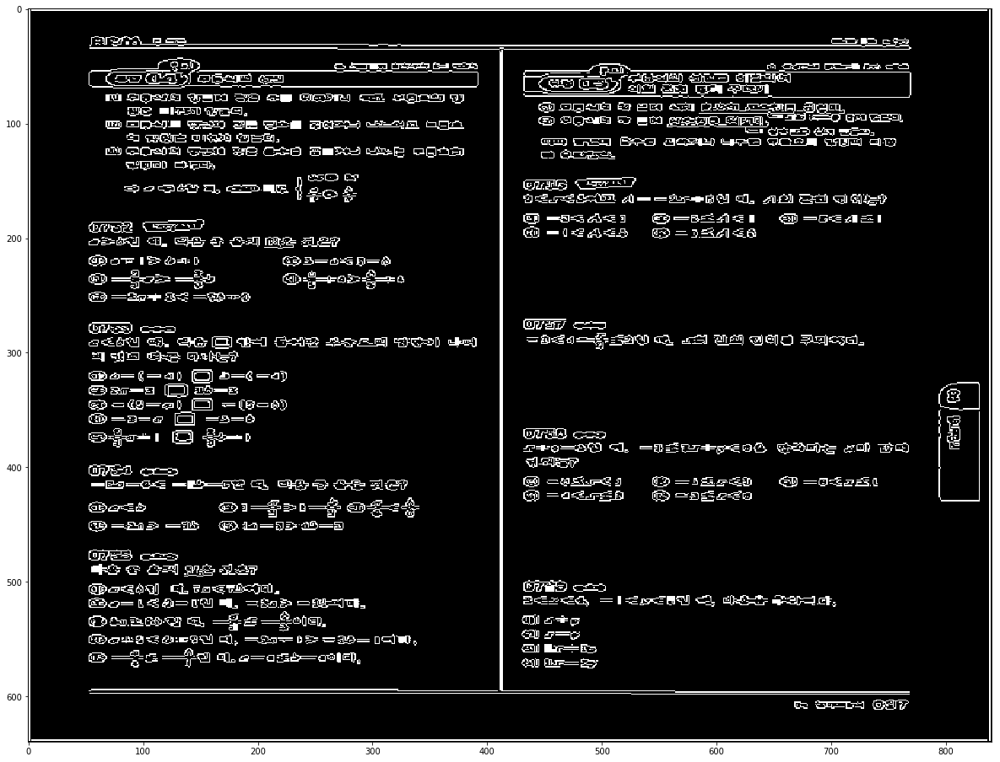

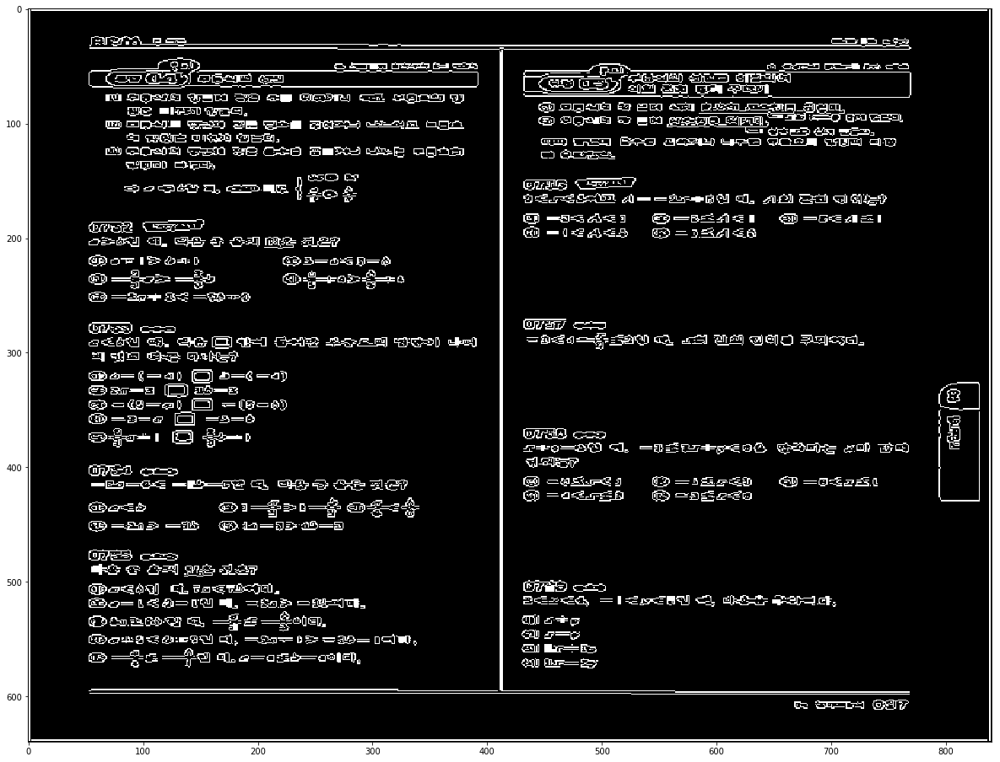

3  Pattern
IMG =  099 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

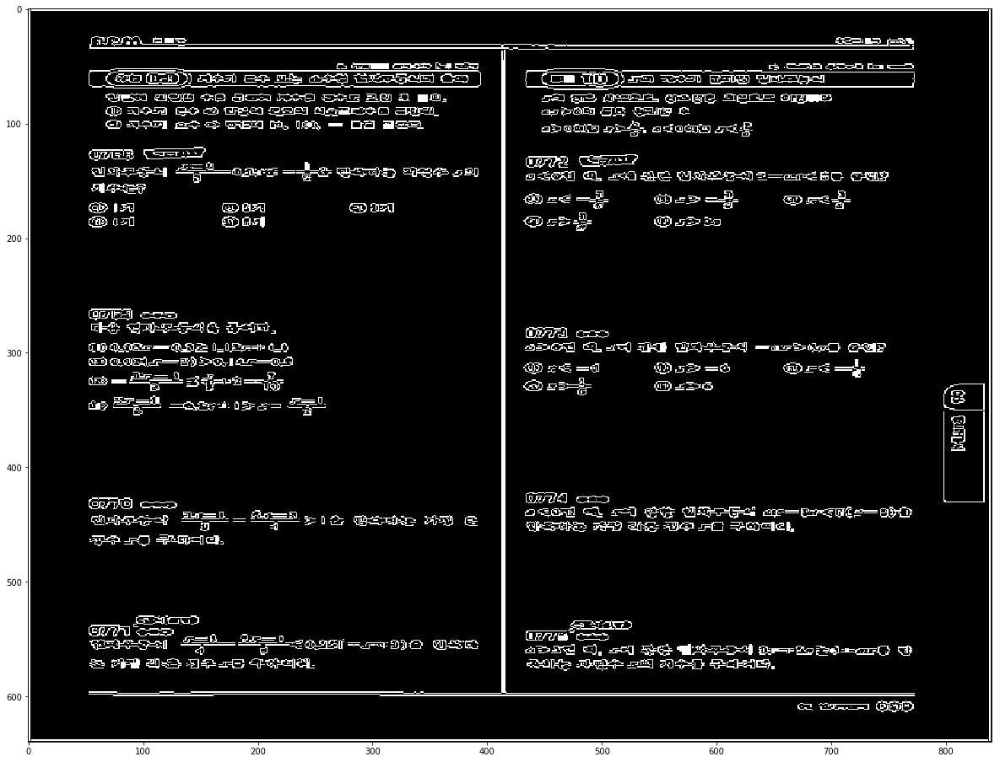

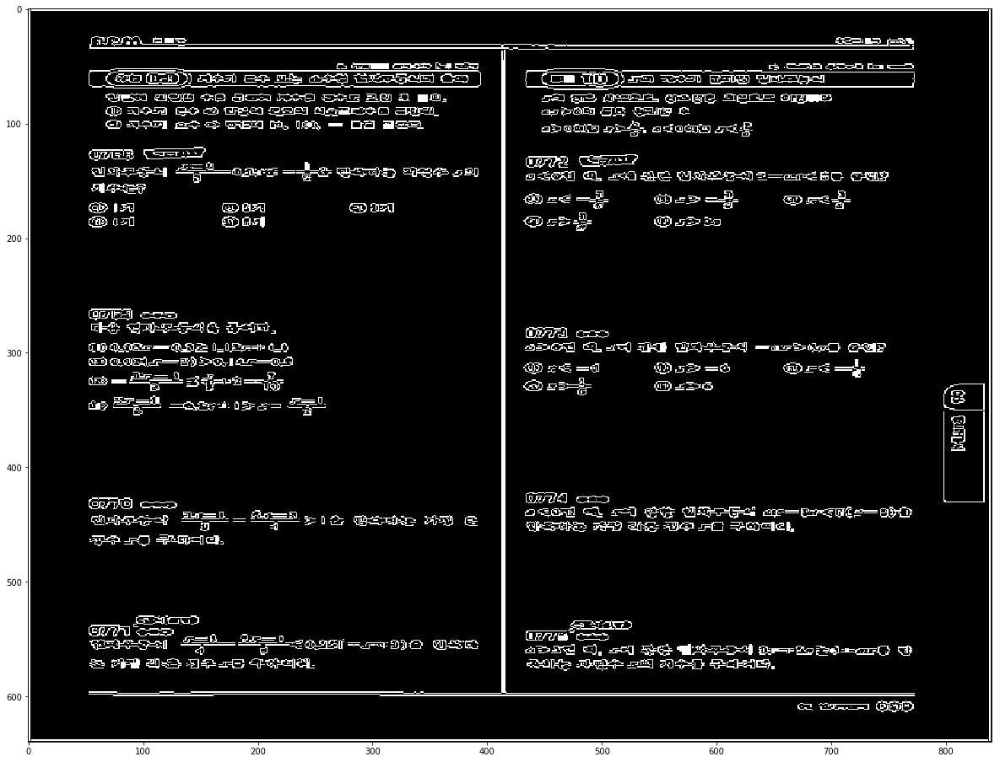

0  Pattern
IMG =  100 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

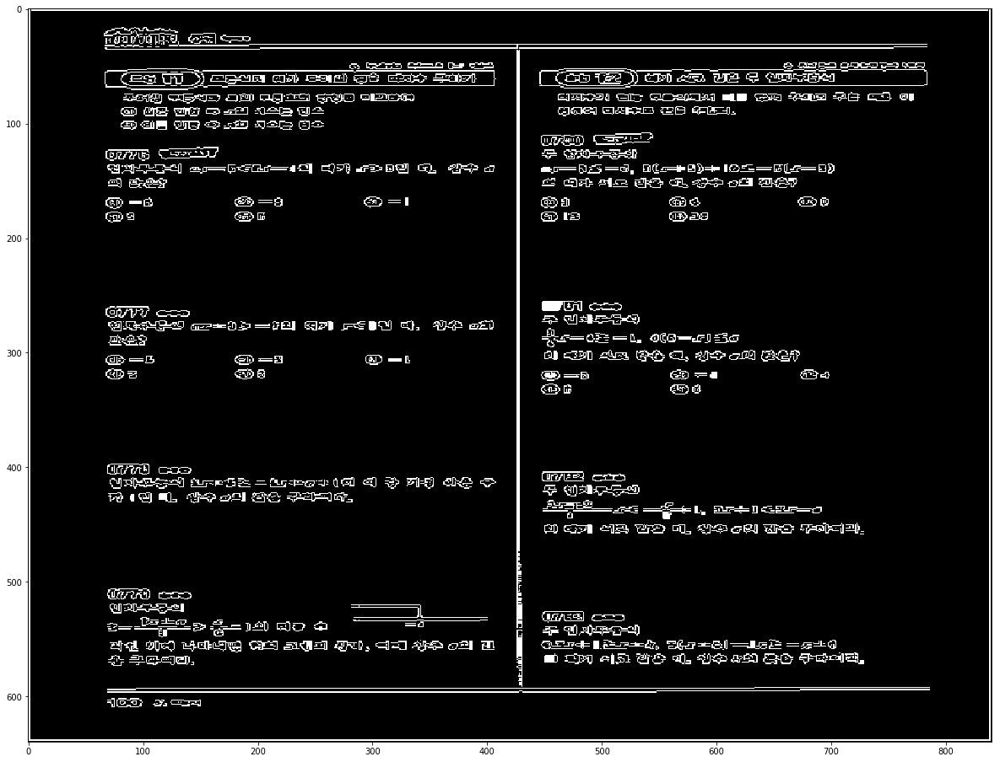

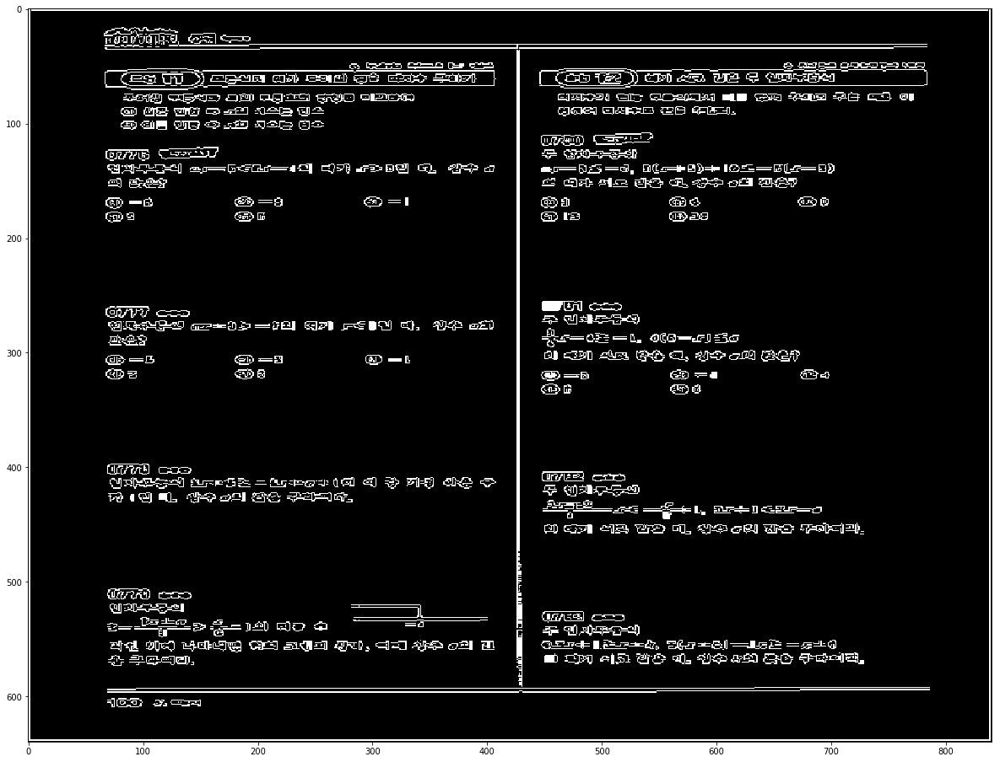

2  Pattern
IMG =  102 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

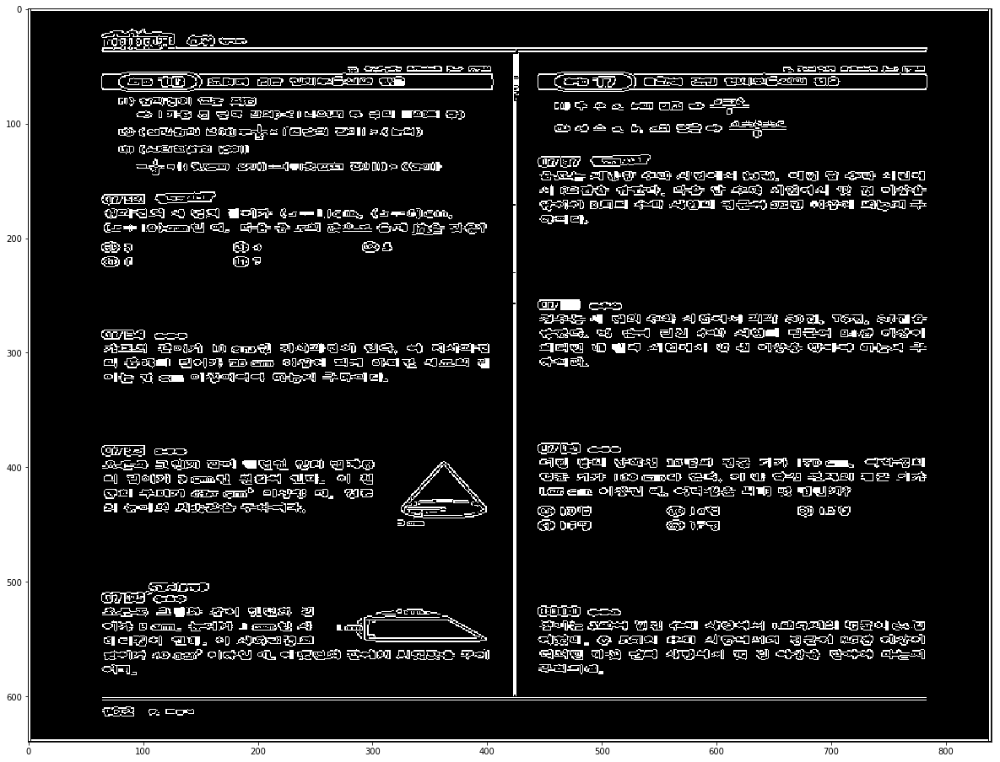

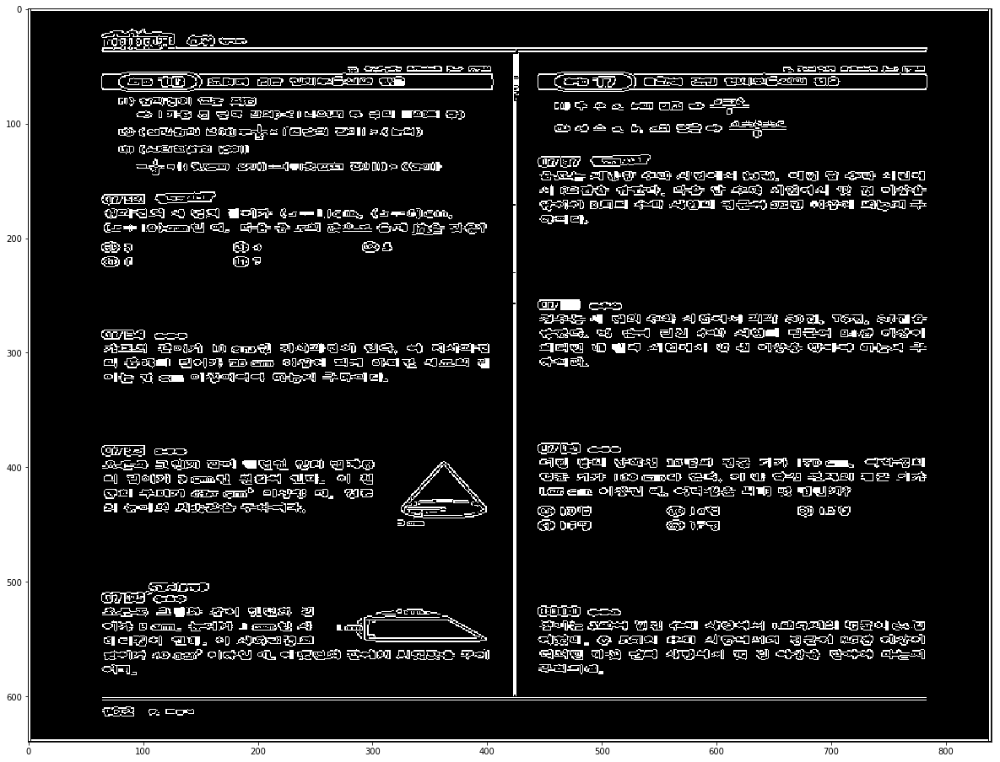

1  Pattern
IMG =  103 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

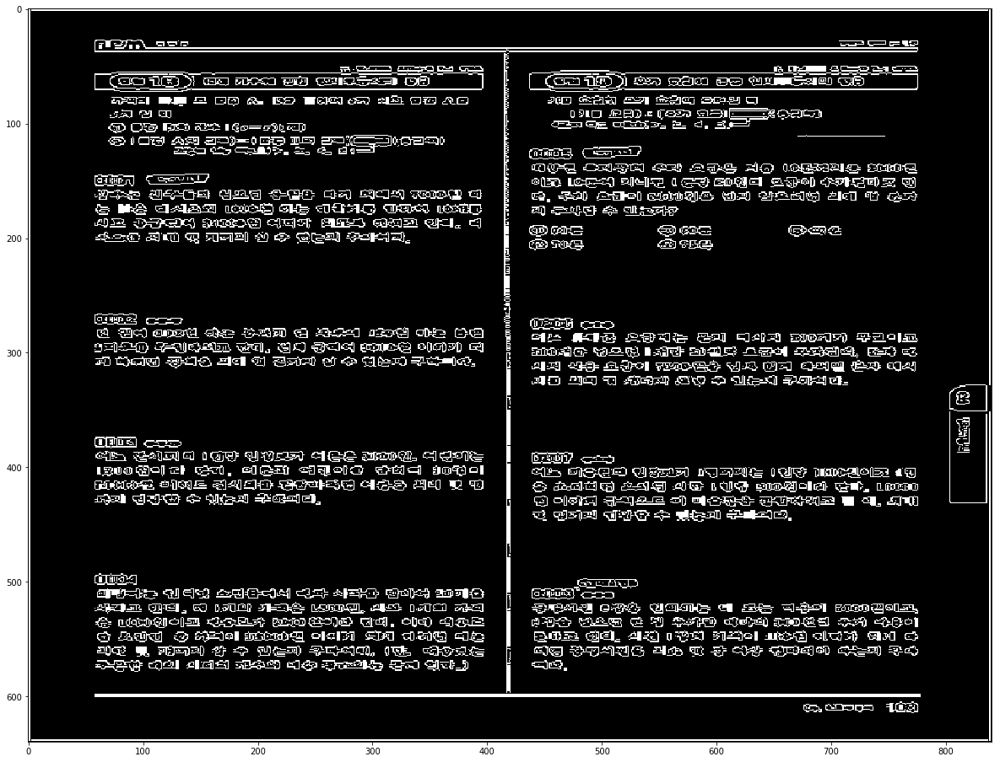

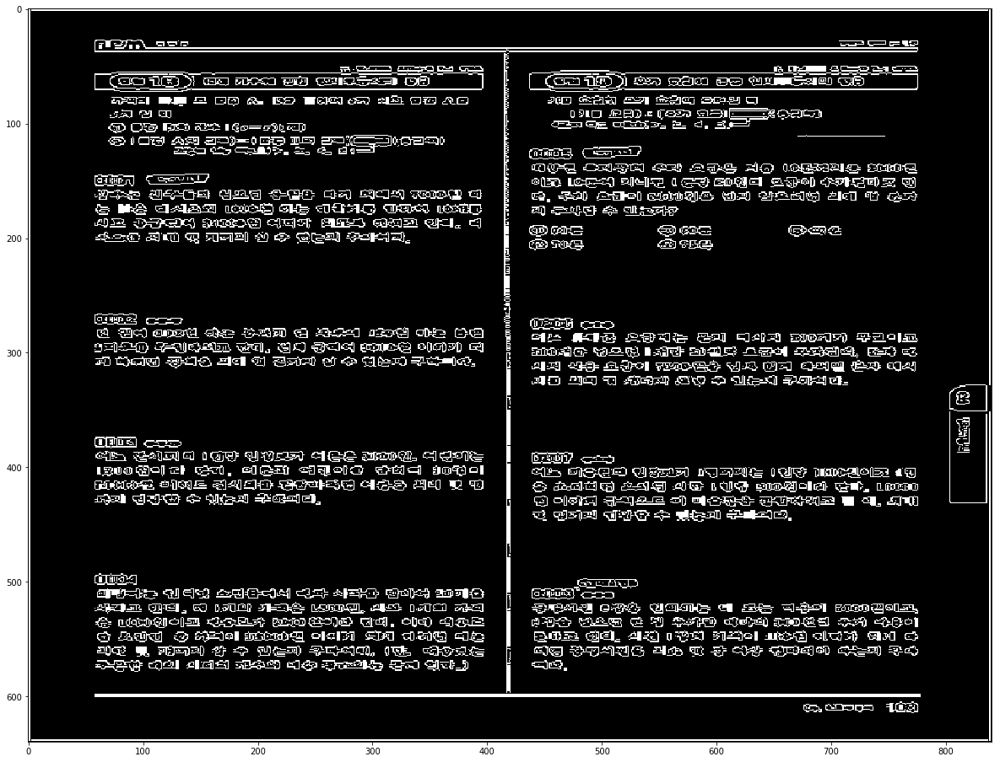

1  Pattern
IMG =  104 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

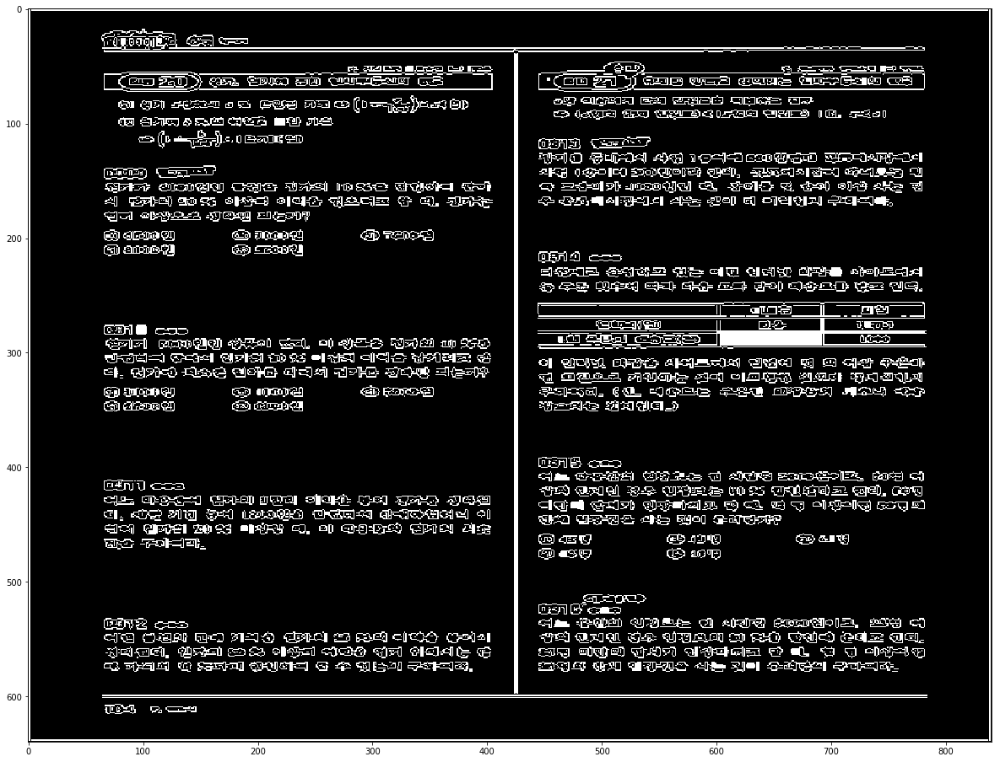

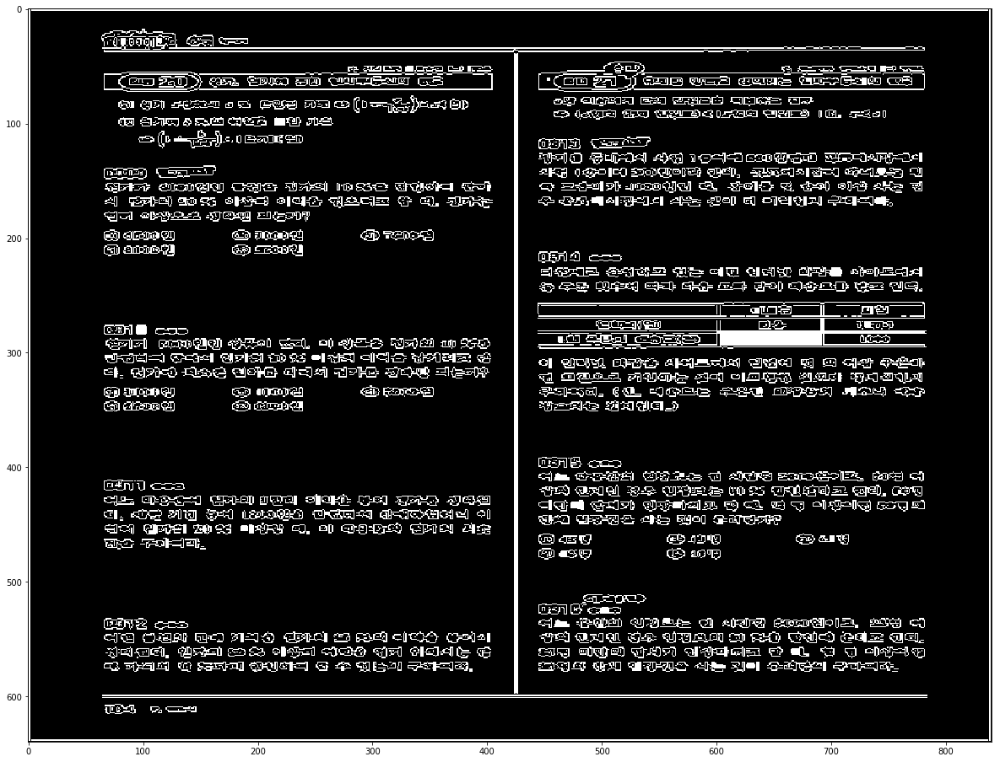

2  Pattern
IMG =  105 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

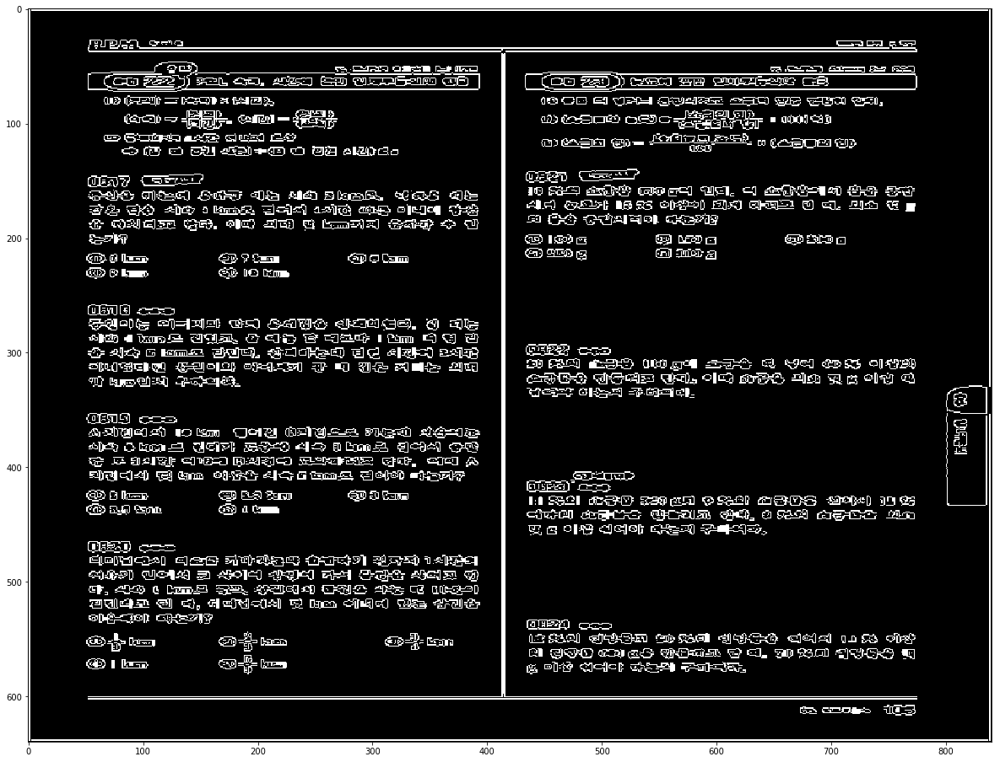

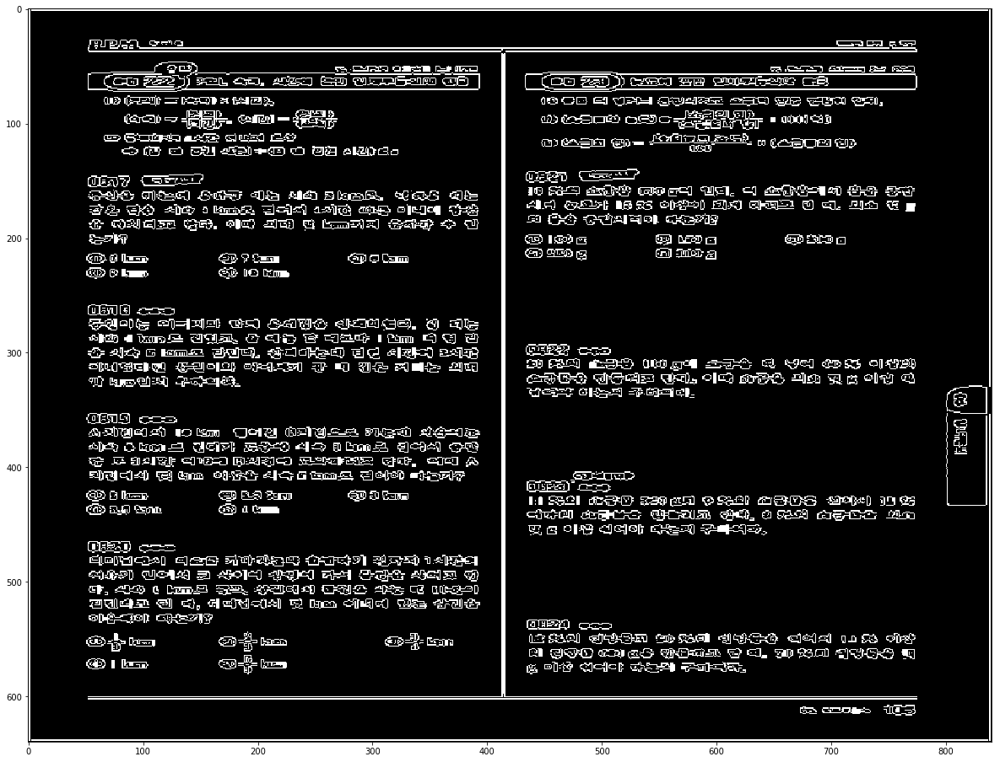

0  Pattern
IMG =  114 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

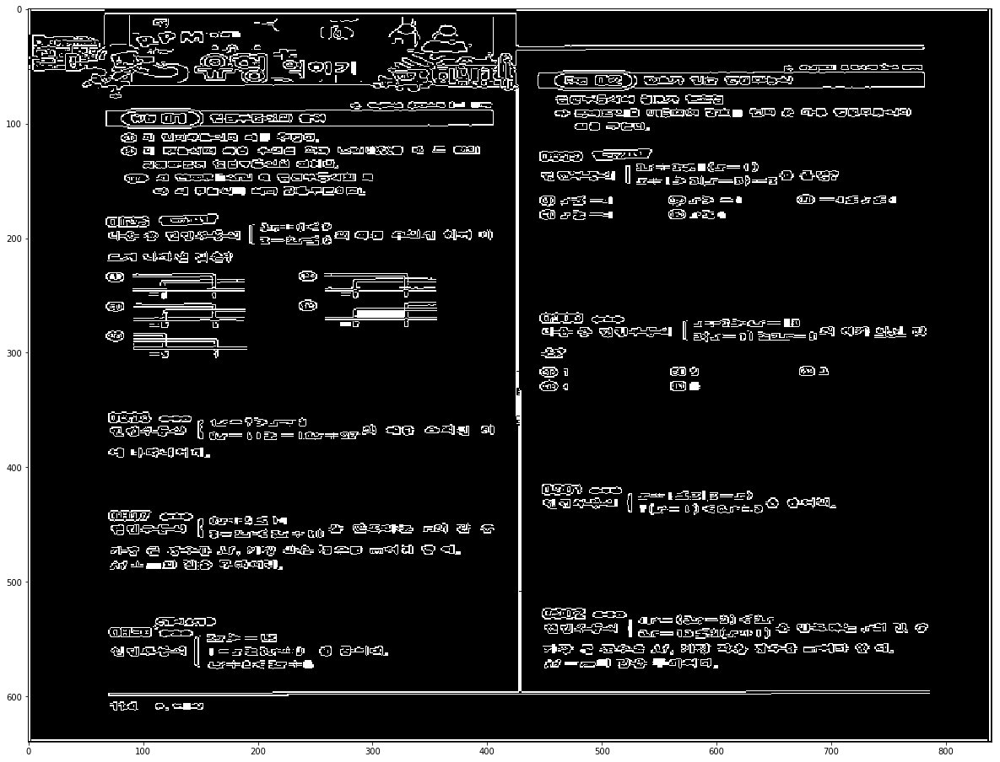

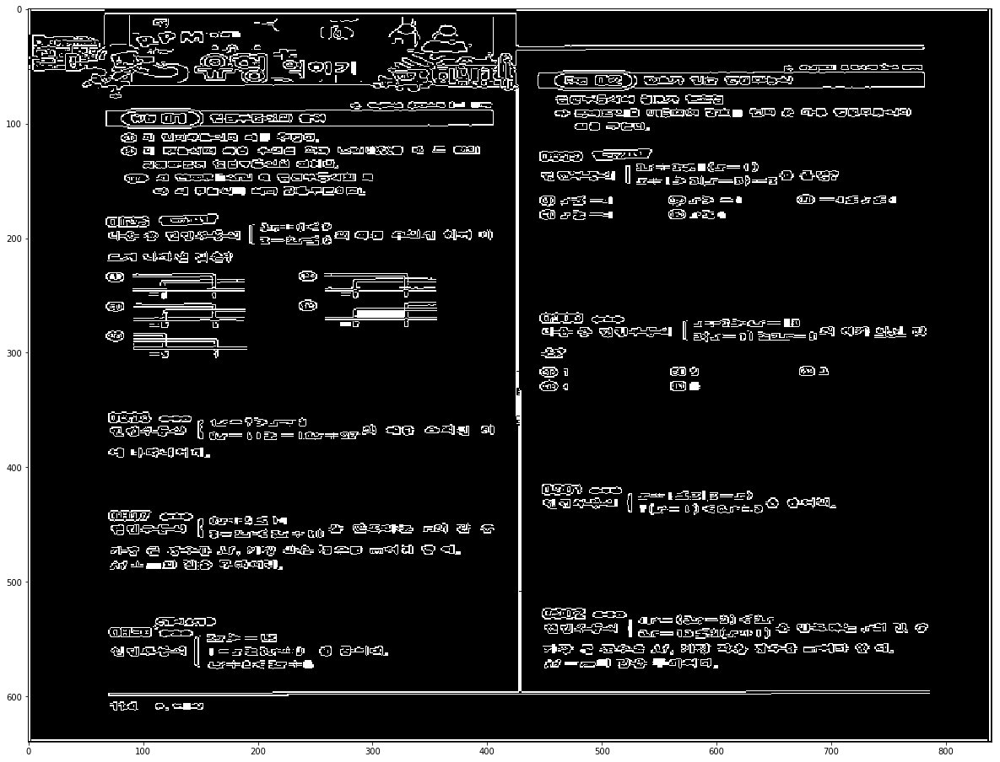

3  Pattern
IMG =  115 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

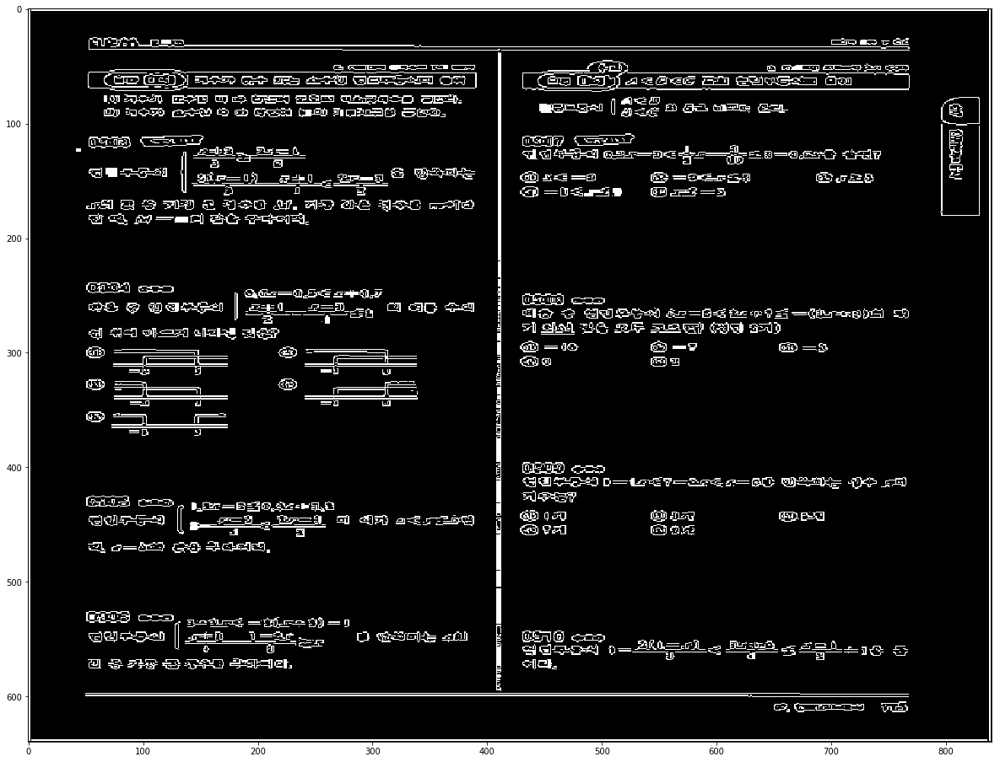

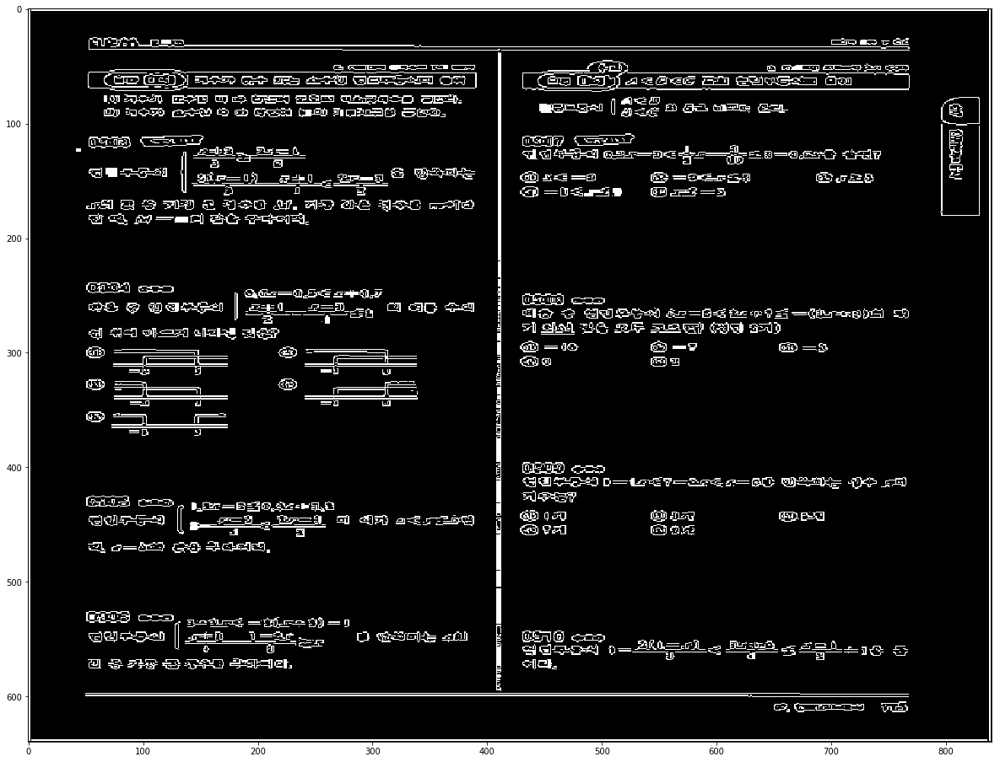

3  Pattern
IMG =  116 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

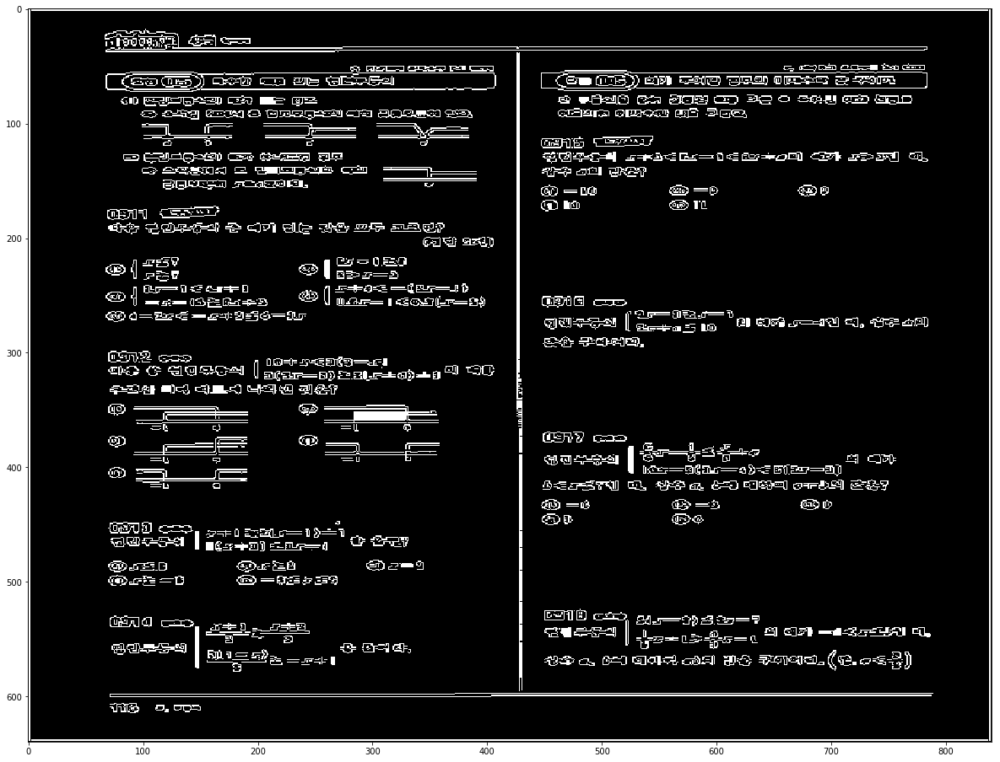

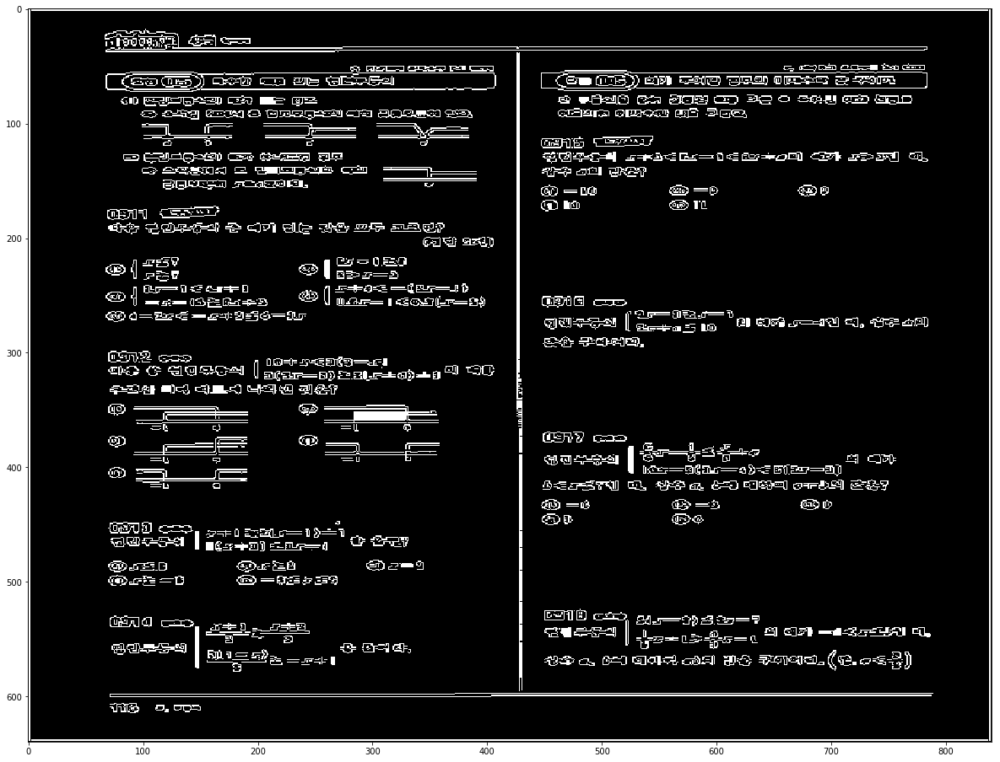

0  Pattern
IMG =  117 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

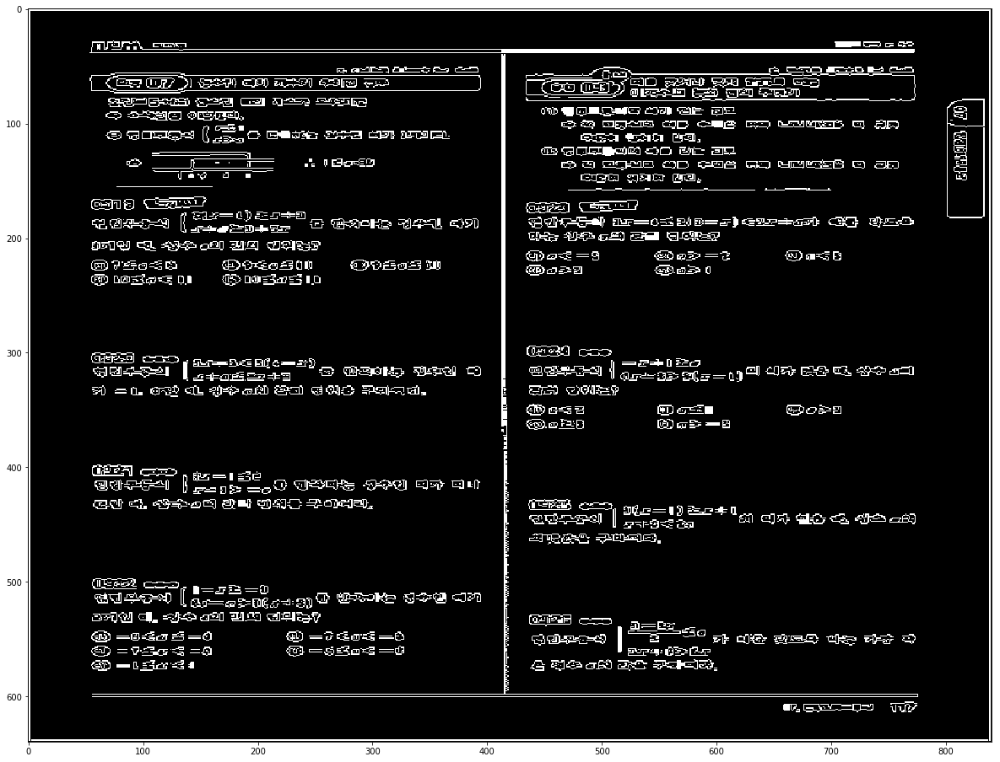

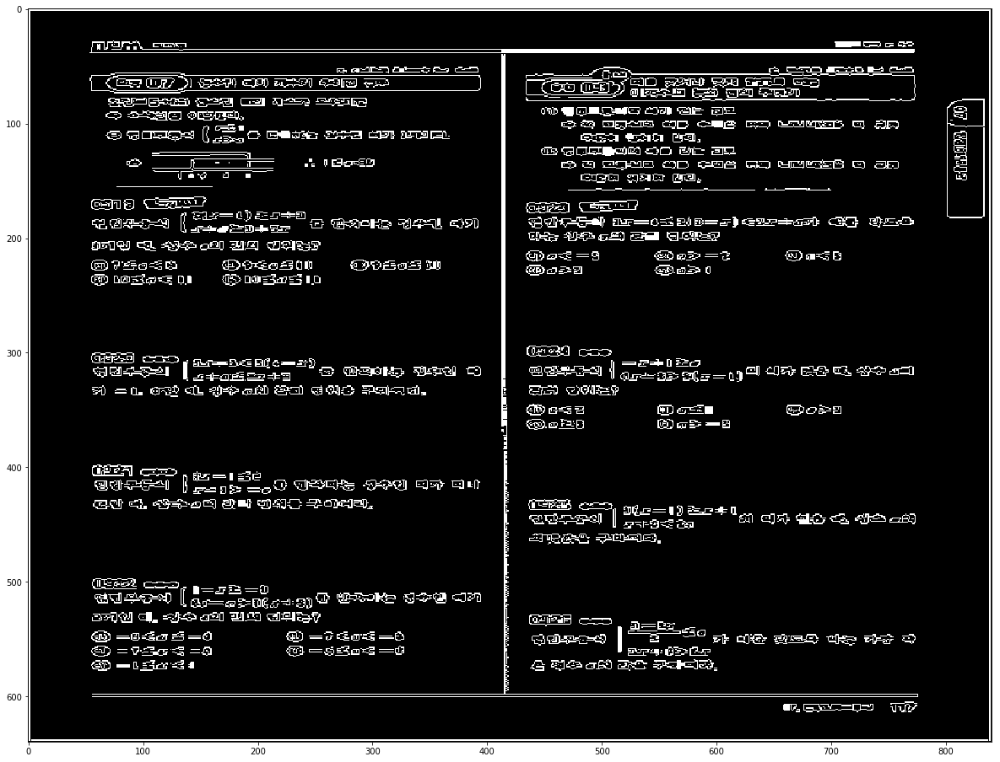

2  Pattern
IMG =  118 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

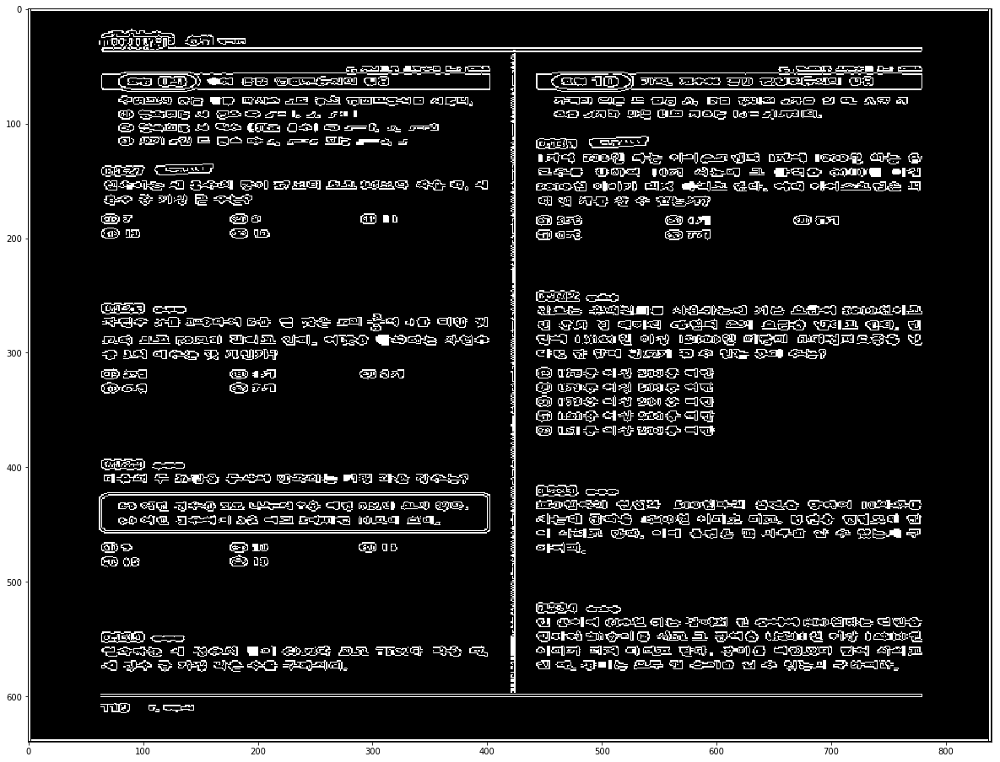

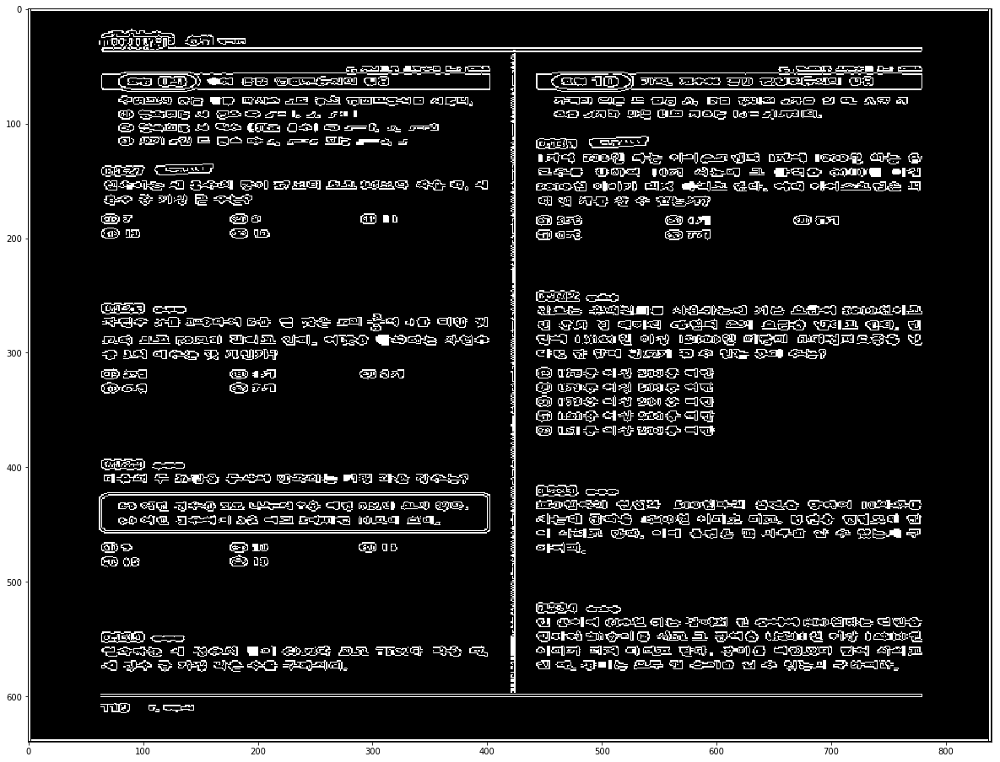

1  Pattern
IMG =  119 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

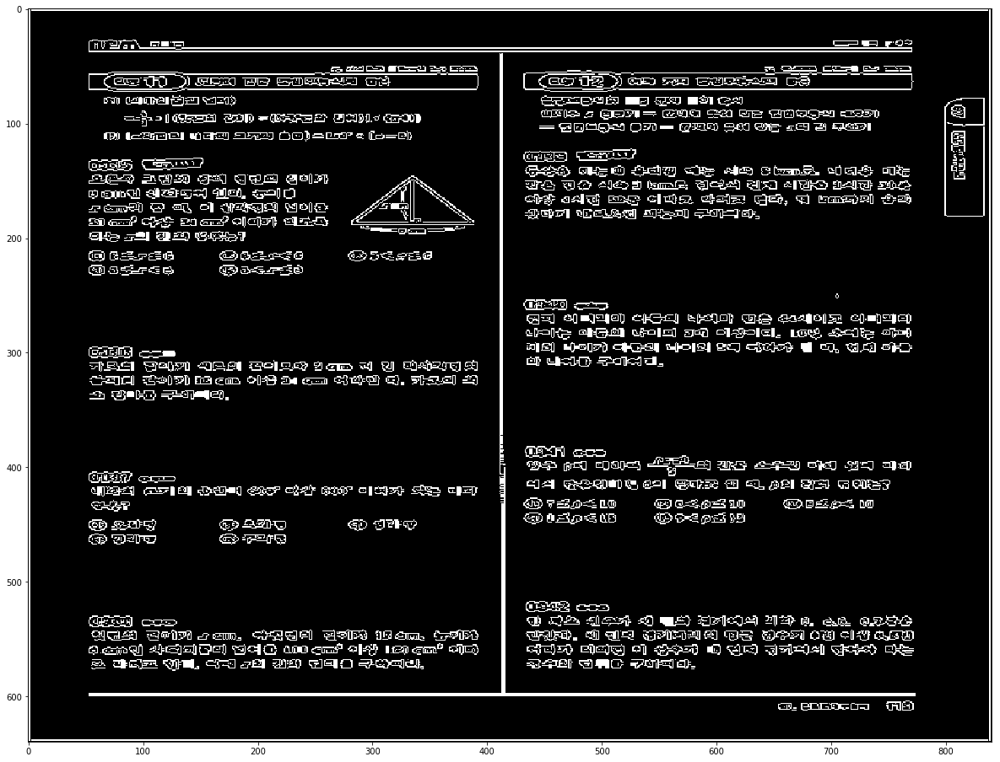

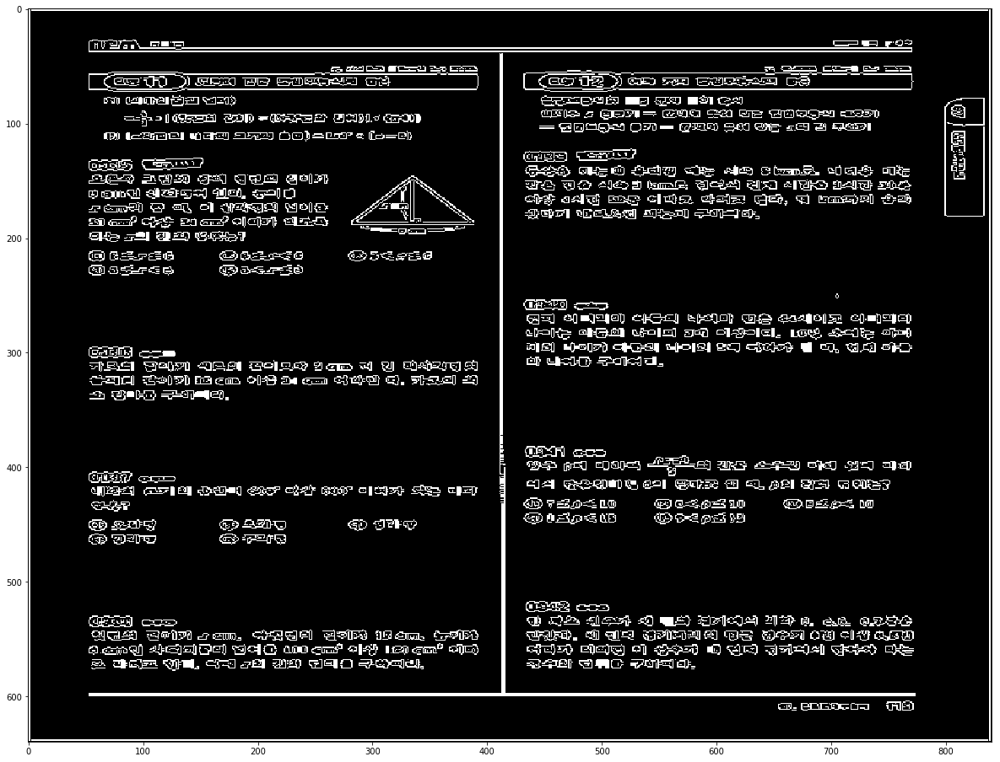

1  Pattern
IMG =  120 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

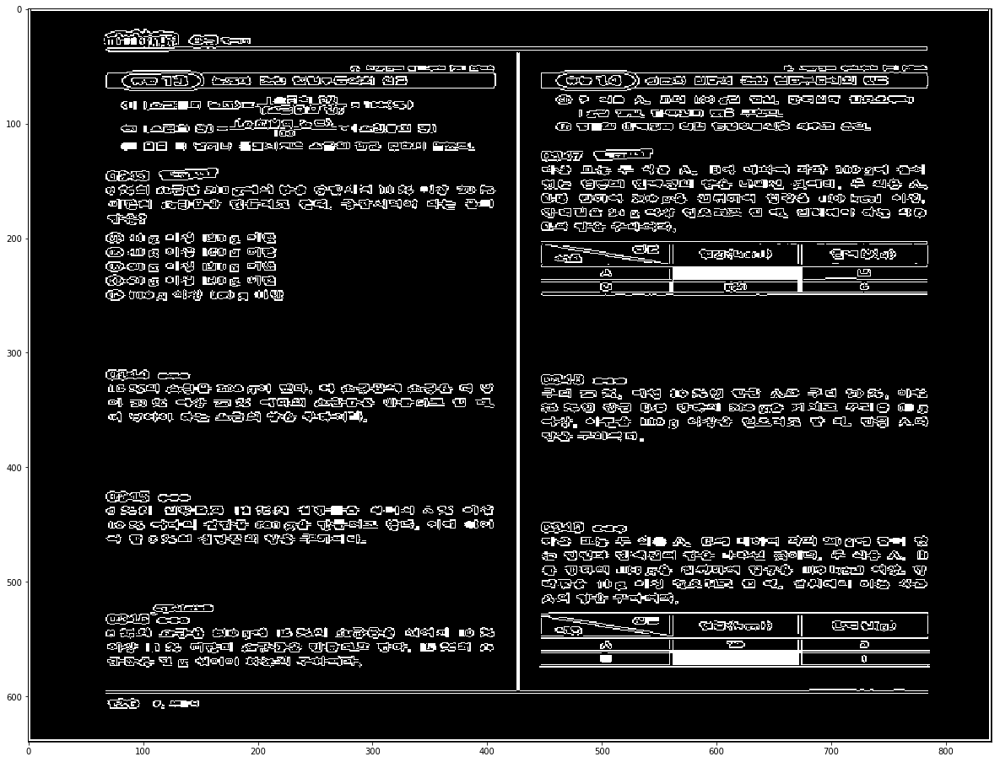

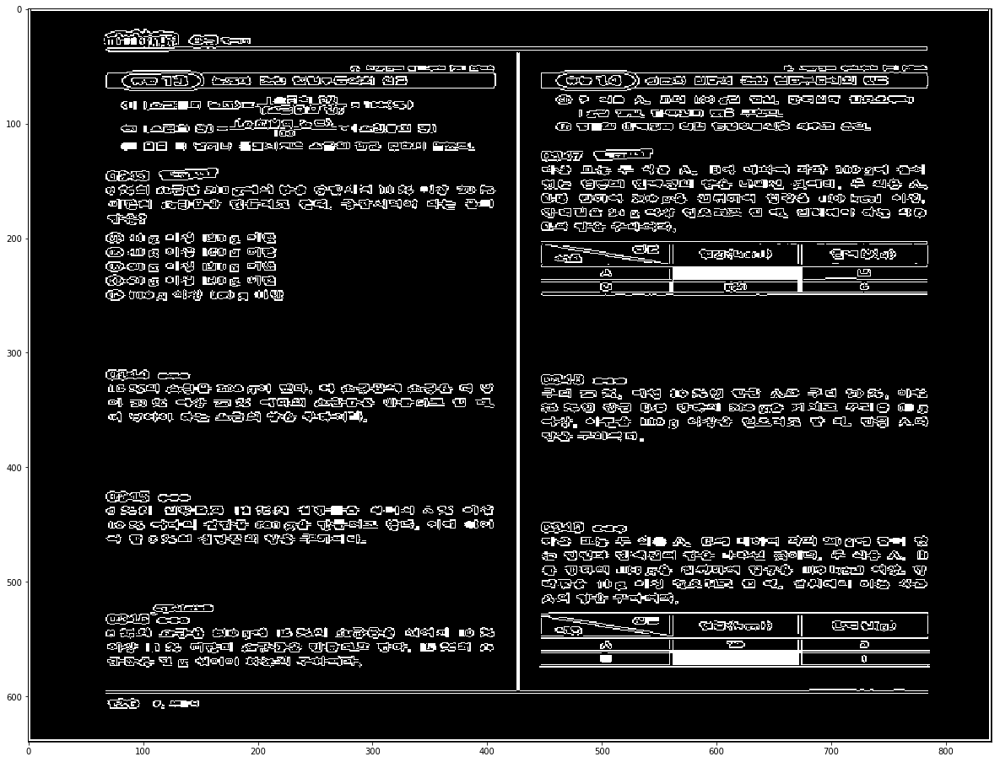

2  Pattern
IMG =  121 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

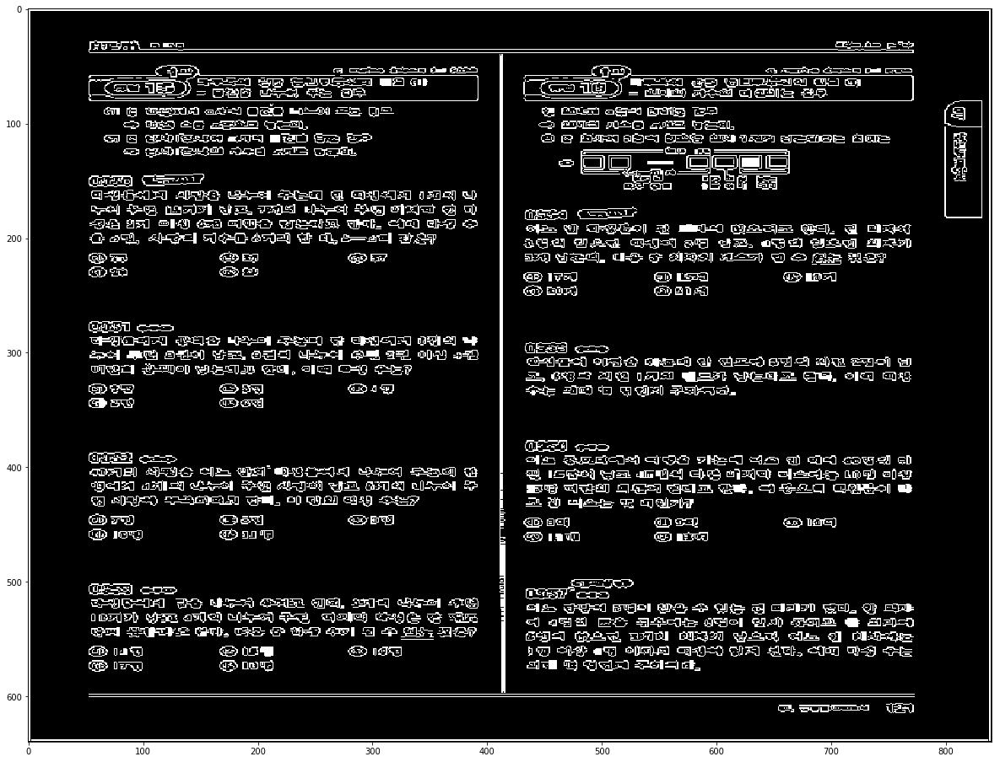

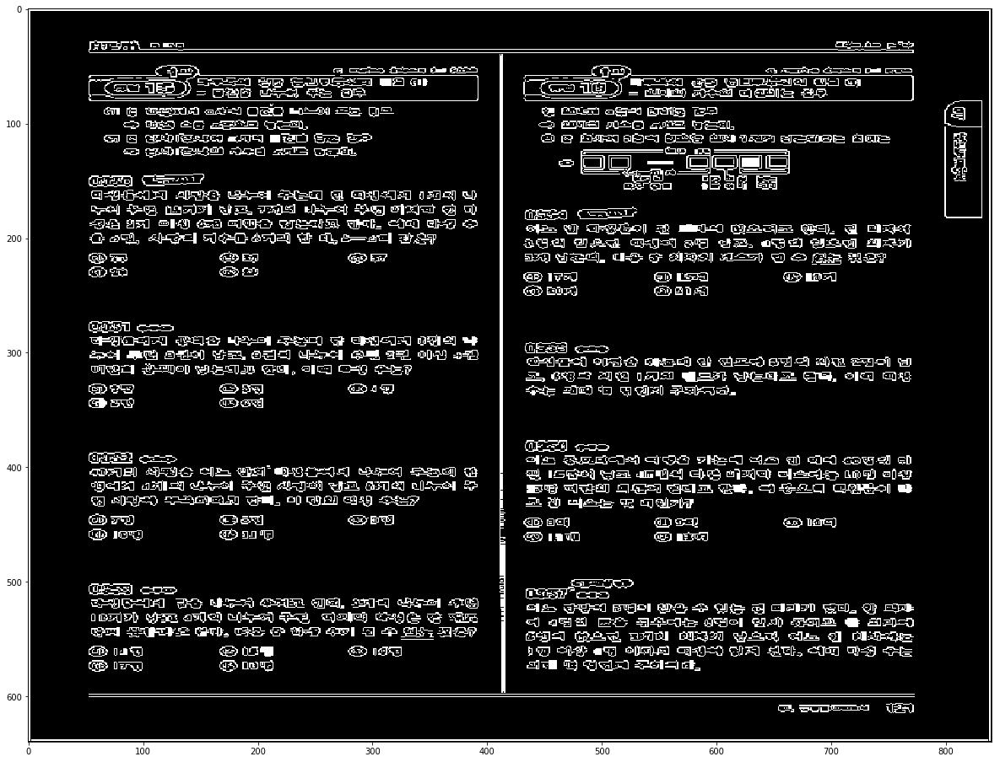

0  Pattern
IMG =  132 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

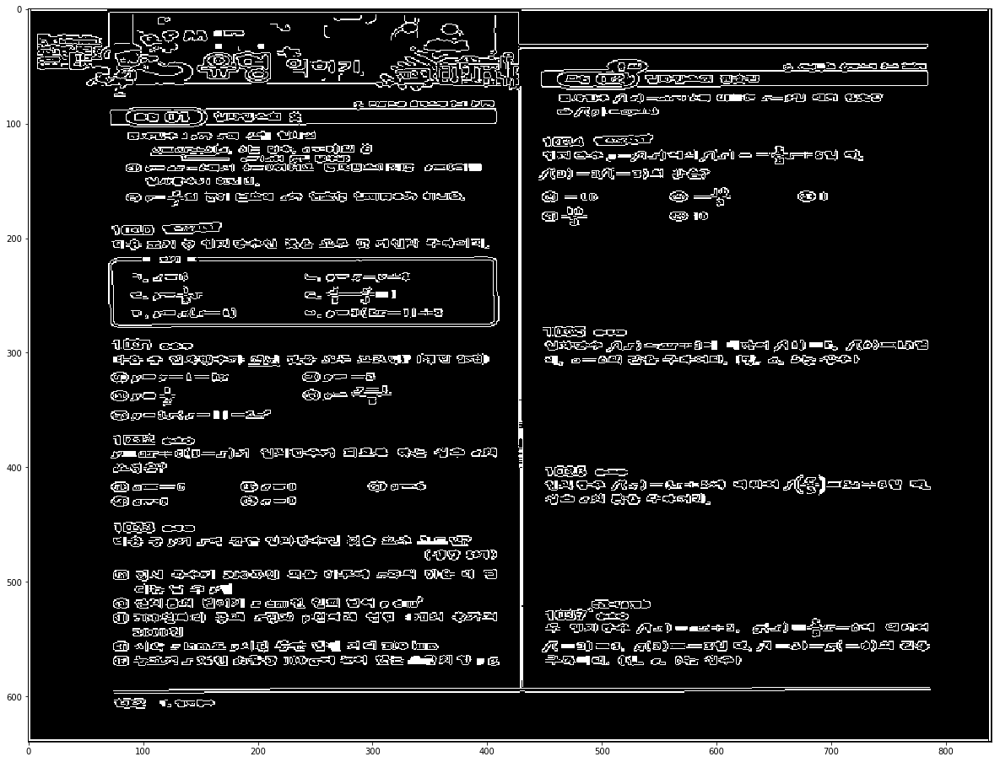

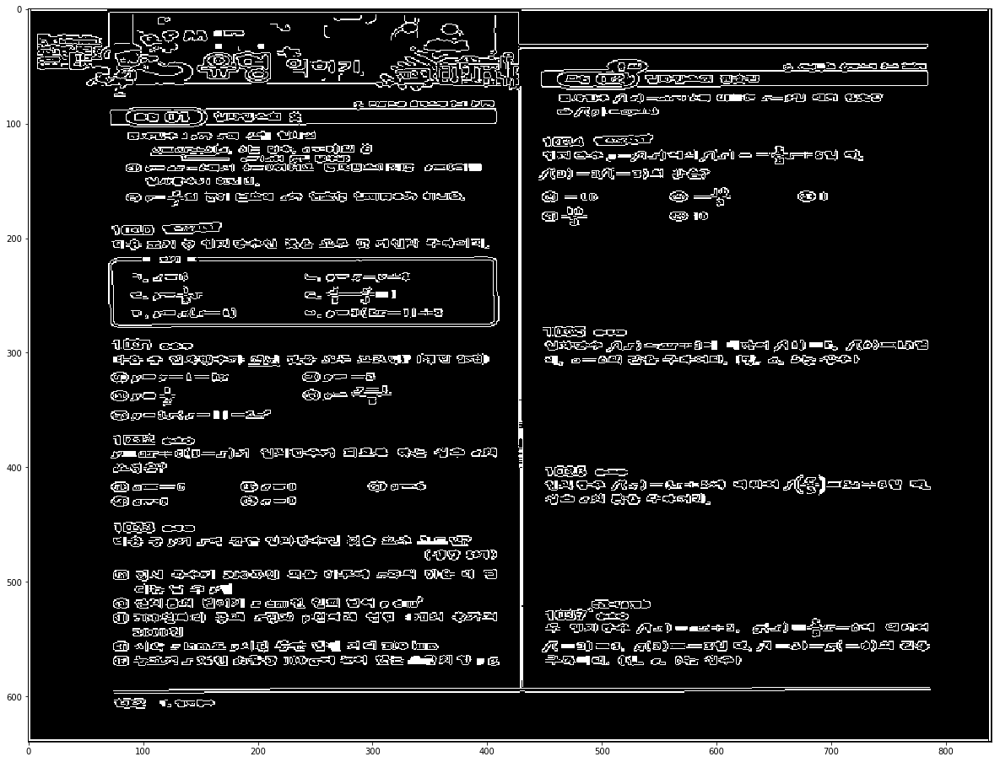

3  Pattern
IMG =  133 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

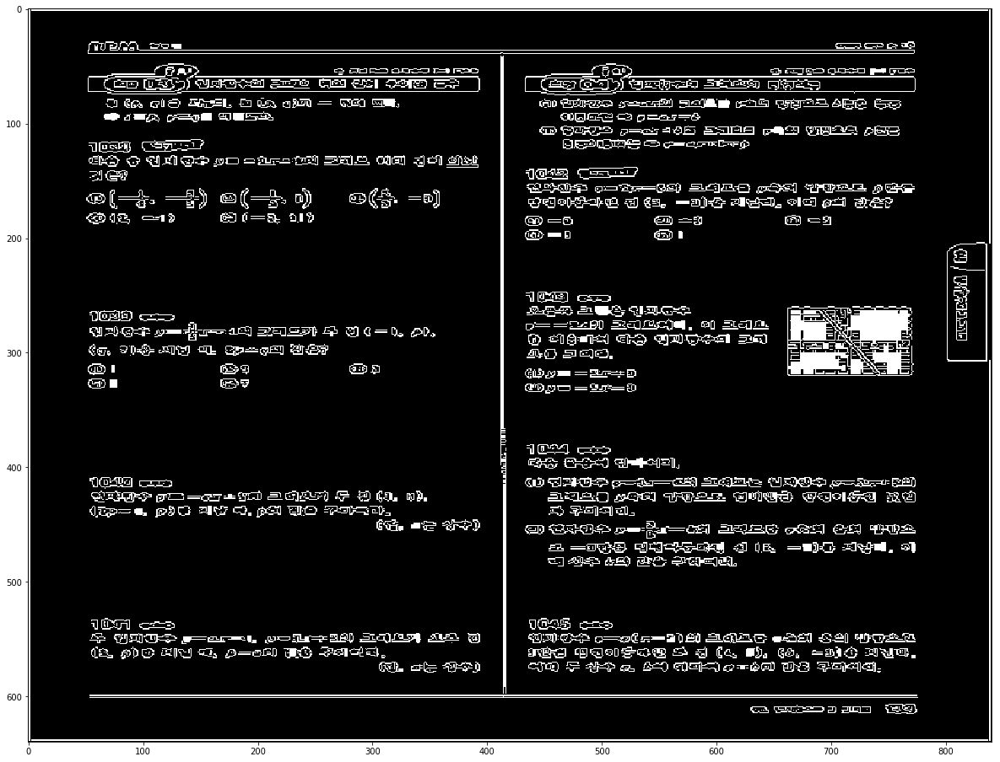

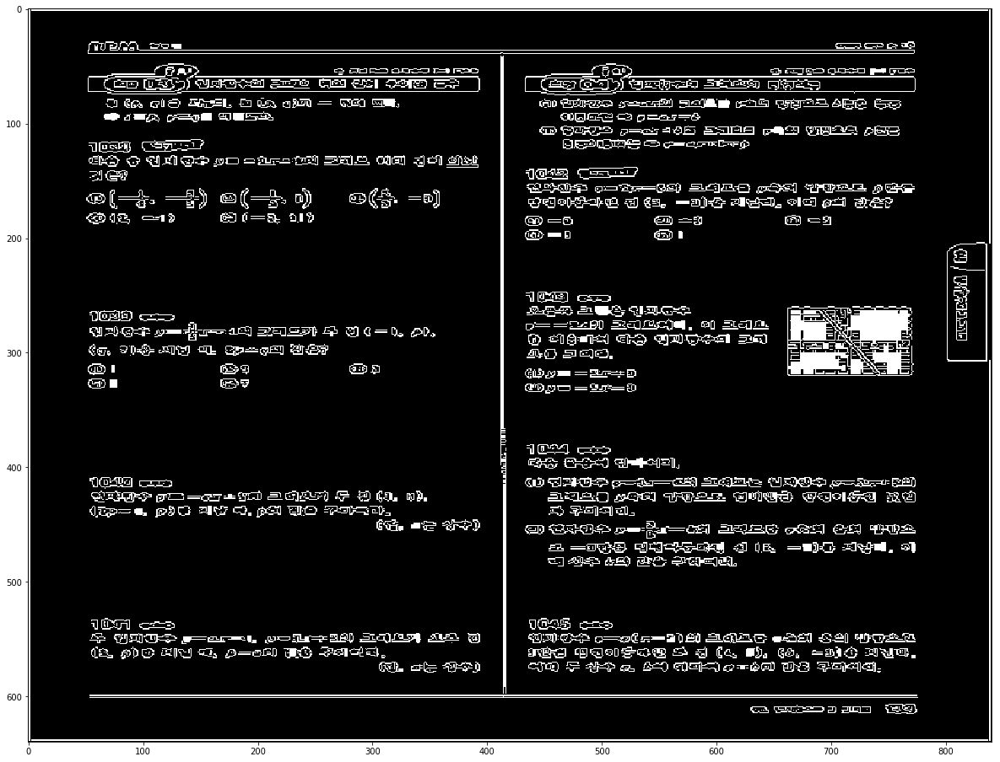

3  Pattern
IMG =  134 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

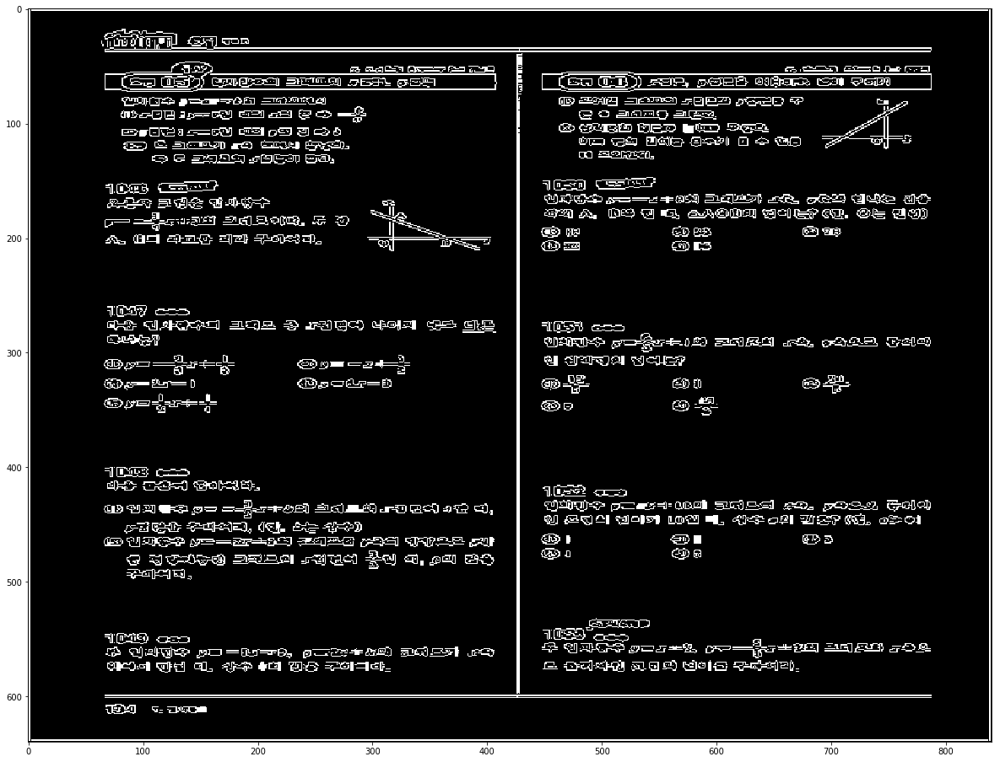

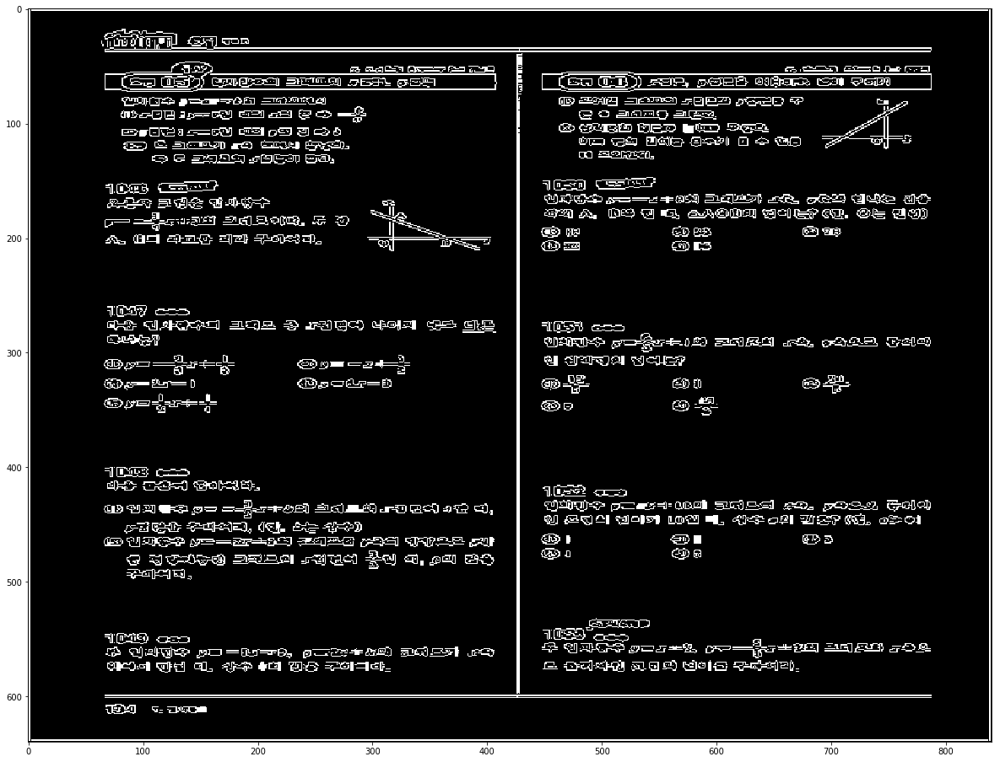

0  Pattern
IMG =  135 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

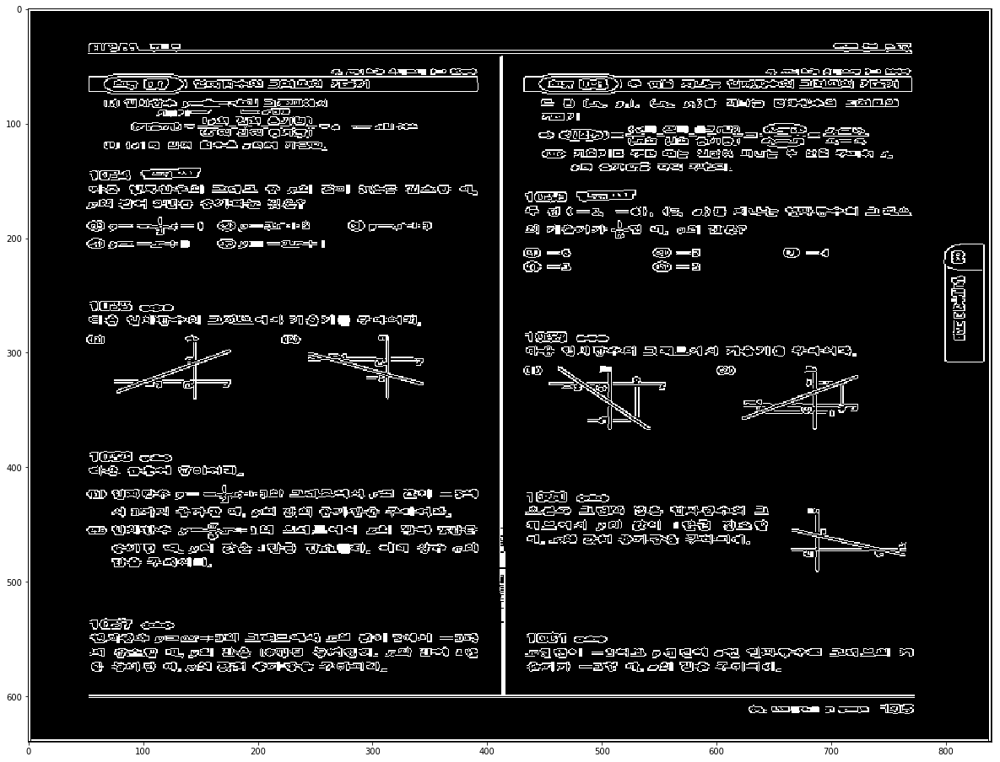

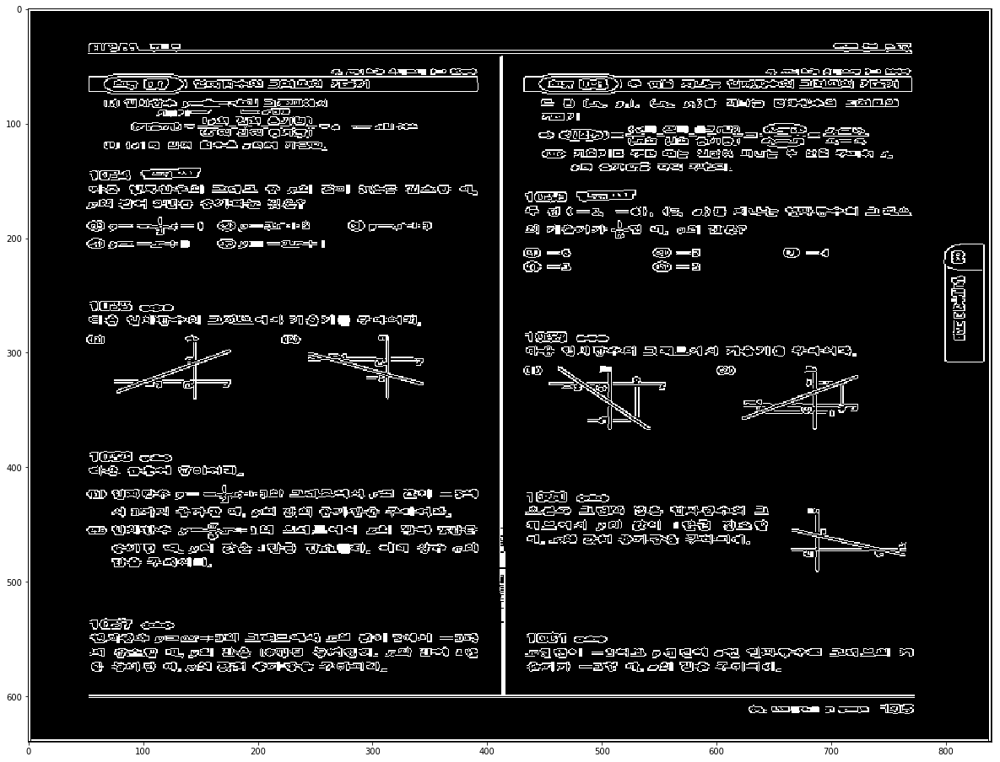

2  Pattern
IMG =  137 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

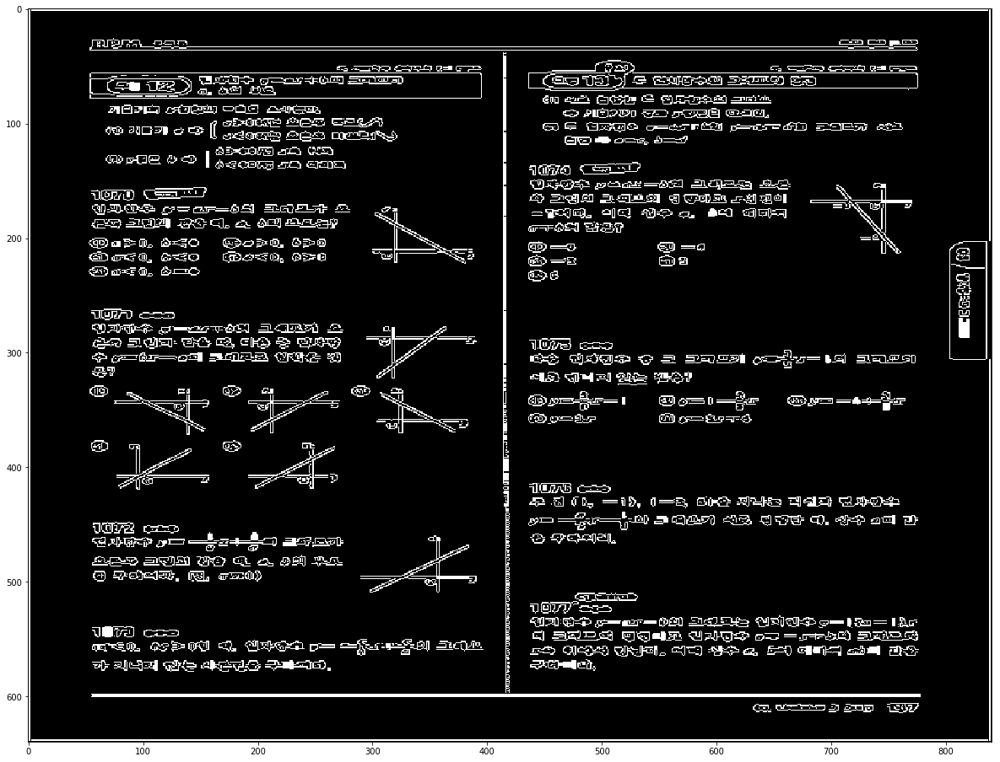

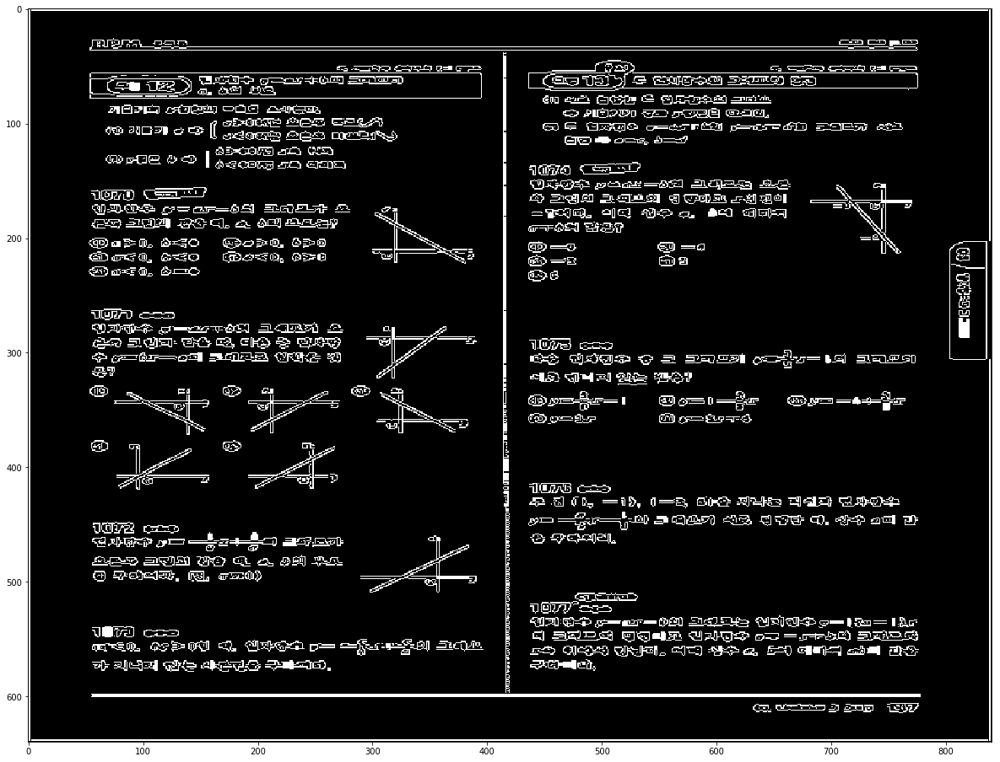

1  Pattern
IMG =  138 ( WIDTH :  840  HEIGHT :  640  )


C:\Users\Juyoung\Miniconda3\envs\venv\lib\site-packages\skimage\transform\_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


<Figure size 432x288 with 0 Axes>

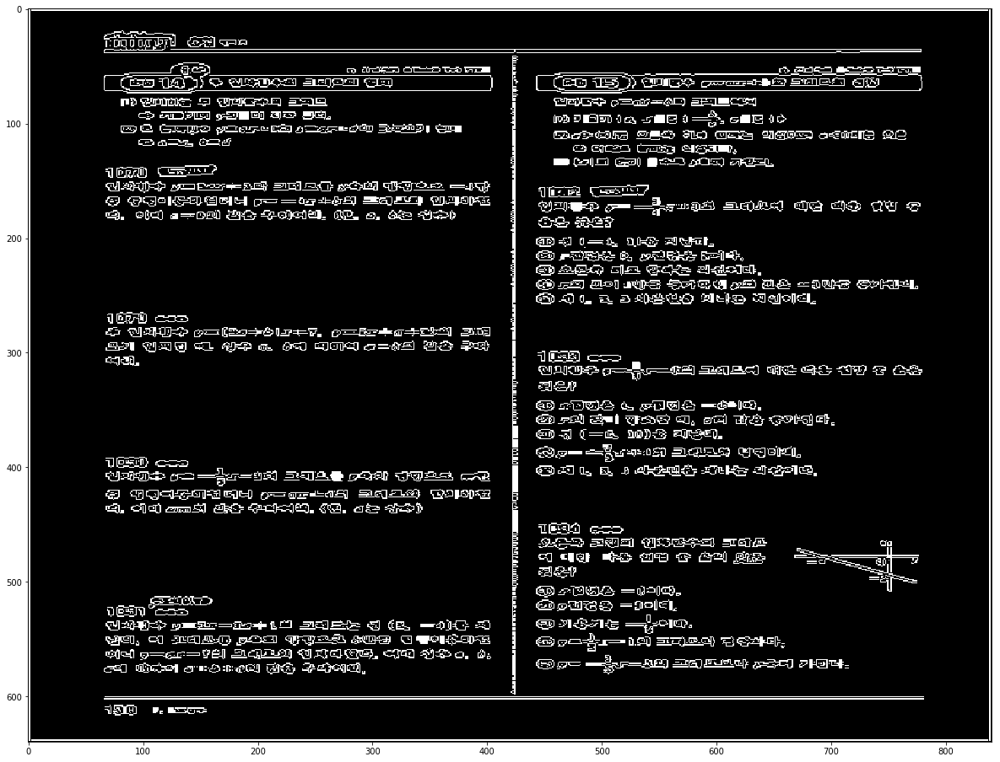

KeyboardInterrupt: 

In [57]:
# image preprocessing - columnize for base line
from os import makedirs, path, listdir
import numpy as np

from skimage import img_as_uint, img_as_ubyte, filters, measure, morphology, segmentation, color
from skimage.io import imread, imsave, imshow
from skimage.feature import canny
from skimage.filters import sobel, threshold_otsu
from skimage.transform import resize
from scipy.ndimage.morphology import distance_transform_edt

%matplotlib inline
import matplotlib.pyplot as plt
import statistics

def getBinary(img, th):
    fig, ax = plt.subplots(figsize=(30, 16))
    img_bin = canny(img, sigma=.5)
    
    seed = np.copy(img_bin)
    seed[1:-1, 1:-1] = img_bin.max()
    mask = img_bin

    filled = reconstruction(seed, mask, method='erosion')
    img_bin = filled > th
    
    ax.imshow(filled, interpolation='nearest', cmap=plt.cm.gray)
    return img_bin

def crop(img, area):
    y1 = int(area[2])
    y2 = int(area[3])
    x1 = int(area[0])
    x2 = int(area[1])
    return img[y1:y2, x1:x2]

def findIndices_x(arr):
    min_indice, max_indice = len(arr[0]), 0

    for i in range(0, len(arr)):
        row = arr[i]
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                if(max_indice < j):
                    max_indice = j
                if(j < min_indice):
                    min_indice = j
                    
    if(min_indice <= 20):
#         print("min x indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, len(row)):
                x = row[j]
                if(x == 255):
                    if(j < min_indice):
                        if(j <= 20): continue
                        min_indice = j
                        
#     print("min x indice is now ", min_indice)
                        
    if(len(arr[0]) - max_indice <= 20):
#         print("max x indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(0, len(arr)):
            row = arr[i]
            for j in range(start_index, end_index):
                x = row[j]
                if(x == 255):
                    if(max_indice < j):
                        if(len(arr[0]) - j <= 20): continue
                        max_indice = j
    
#     print("max x indice is now", max_indice)
    
    return (min_indice, max_indice)

def findIndices_y(arr):
    min_indice, max_indice = len(arr), 0

    for i in range(0, len(arr)):
        row = arr[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            if(max_indice < i):
                 max_indice = i
            if(i < min_indice):
                min_indice = i
    
    if(min_indice <= 10):
#         print("min y indice is ", min_indice)
        start_index = min_indice + 1
        min_indice = len(arr)
        for i in range(start_index, len(arr)):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(i < min_indice):
                    if(i <= 10): continue
                    min_indice = i
    
#     print("min y indice is now ", min_indice)
    
    if(len(arr) - max_indice <= 10):
#         print("max y indice is ", max_indice)
        start_index = min_indice + 1
        end_index = max_indice
        max_indice = start_index
        for i in range(start_index, end_index):
            row = arr[i]
            has_x = False

            for j in range(0, len(row)):
                x = row[j]
                if(x == 255):
                    has_x = True
                    break
                    
            if(has_x):
                if(max_indice < i):
                    max_indice = i
    
#     print("max y indice is now", max_indice)
    
    return (min_indice, max_indice)

def columnize(img):
    h, w = img.shape
    middle_line = filters.median(img, selem=np.ones((h,1)))

    x_min, x_max = findIndices_x(middle_line)
    line_width = x_max - x_min
    col1, col2 = crop(img, [0, x_min, 0, h]), crop(img, [x_max, w, 0, h])
    
    return (col1, col2, line_width)

def parseArea(img):
    h, w = img.shape
    valid_map = filters.median(img, selem=np.ones((1,w)))
    
    y_min, y_max = findIndices_y(valid_map)
    
    header, body, footer = crop(img, [0, w, 0, y_min]), crop(img, [0, w, y_min, y_max]), crop(img, [0, w, y_max, h])
    
    return (header, body, footer, (y_min, y_max))

def denoiseBoundary(img, x_value, y_value):
    height, width = img.shape 
    
    for i in range(0, height):
        if(i <= y_value or height - i <= y_value):
            for j in range(0, width):
                img[i][j] = 0
        else:
            for j in range(0, x_value+1):
                img[i][j] = 0
            for j in range(width - x_value, width):
                img[i][j] = 0    
                
    return img

def denoiseEdge_R(img, x_value):
    height, width = img.shape
    
    for i in range(0, height):
        for j in range(width - x_value, width):
            img[i][j] = 0  
            
    return img

def denoiseEdge_L(img, x_value):
    height, width = img.shape 
    
    for i in range(0, height):
        for j in range(0, x_value):
            img[i][j] = 0
            
    return img

# def denoiseWeakCon(img, y_value):
#     height, width = img.shape
#     upper_img = img[:y_value]
#     upper_img = filters.median(upper_img, selem=np.ones((1, int(width * .7))))
#     img[:y_value] = upper_img
#     return img

def partialFilter(img, target_area , kernal_size):
    height, width = img.shape
    y_min, y_max = target_area
    target = img[y_min, y_max]

def standardize(img):
    for i in range(0, len(img)):
        row = img[i]
        has_x = False
        
        for j in range(0, len(row)):
            x = row[j]
            if(x == 255):
                has_x = True
                break;
                
        if(has_x):
            for j in range(0, len(row)):
                img[i][j] = 255

    return img

def removeFirst(img):
    min_index, max_index = 0, 0
    isStart = False
    for i in range(0, len(img)):
        if(img[i][0] != 255 and isStart):
            max_index = i
            break
        if(isStart): continue
        if(img[i][0] == 255 and not isStart):
            isStart = True
            min_index = i
        
    for i in range(min_index, max_index):
        for j in range(0, len(img[0])):
            img[i][j] = 0
    
    return img
    
class Column:
    def __init__(self, img):
        self.image = img
        self.header, self.body, self.footer, __ = parseArea(img)
        
    def __delete(self, instance):
        del self.image
        del self.header, self.body, self.footer
    
    def showColumn(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.image, interpolation='nearest', cmap=plt.cm.gray)
        
    def showHeader(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        
    def showBody(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        h, w = self.body.shape
        ticks = [np.arange(0, w, 5), np.arange(0, h, 5)]
        ax.set_xticks(ticks[0])
        ax.set_yticks(ticks[1])
        ax.grid(which='both')
        ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
    
    def showFooter(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
        
    def showAll(self):
        fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        fig3, ax3 = plt.subplots(figsize=(30, 16))
        
        ax1.imshow(self.header, interpolation='nearest', cmap=plt.cm.gray)
        ax2.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
        ax3.imshow(self.footer, interpolation='nearest', cmap=plt.cm.gray)
    
    def getColumn(self):
        height, width = self.image.shape
        return ((0,0), width, height)
    
    def getHeader(self):
        height, width = self.header.shape
        return ((0,0), width, height)
    
    def getBody(self):
        header = self.getHeader()
        h_header = header[2]
        h_body, w_body = self.body.shape
        p = (h_header, 0)
        return (p, w_body, h_body)
    
    def getFooter(self):
        body = self.getBody()
        h_body = body[2]
        p_body = body[0]
        h_footer, w_footer = self.footer.shape
        p_y, p_x = p_body[0] + h_body, 0
        p = (p_y, p_x)
        return (p, w_footer, h_footer)
    
    def getContour(self, col_flag):
#         fig, ax = plt.subplots(figsize=(30, 16))
#         fig1, ax1 = plt.subplots(figsize=(30, 16))
        fig2, ax2 = plt.subplots(figsize=(30, 16))
        __, w, h = self.getBody()
        ticks = [np.arange(0, w, 5), np.arange(0, h, 10)]
        ax2.set_xticks(ticks[0])
        ax2.set_yticks(ticks[1])
        ax2.grid(which='both')
        
#         ax1.imshow(filled, interpolation='nearest', cmap=plt.cm.gray)
        
        vmap = denoiseBoundary(self.body, 5, 10)
        if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)
        vmap = filters.median(self.body, selem=np.ones((2,2)))

        for i in range(0,15): #어느정도 blur 되어 이미지들이 클러스터링이 되면 반복적으로 filtering 하여  contour를 추출하기 쉽게함 
            vmap = filters.median(vmap, selem=np.ones((6,1)))
            vmap = filters.median(vmap, selem=np.ones((1,6)))
        
        ax2.imshow(vmap, interpolation='nearest', cmap=plt.cm.gray)
        
#         vmap = standardize(vmap)
        
#         vmap = removeFirst(vmap)
#         vmap = denoiseBoundary(vmap, 5, 10)
#         if(col_flag == 1): vmap = denoiseEdge_L(vmap, 20)
#         if(col_flag == 2): vmap = denoiseEdge_R(vmap, 40)

#         contours = measure.find_contours(vmap, 1)#주어진 distance map으로 contour찾기.
#         for n, contour in enumerate(contours):
#             ax.plot(contour[:, 1], contour[:, 0], linewidth=2, color='r')
           
#         ax.imshow(self.body, interpolation='nearest', cmap=plt.cm.gray)
               
class Page:
    def __init__(self, img):
        img = denoiseBoundary(img, 10, 8)
        col1, col2, line_gap = columnize(img)
        self.page = img
        self.mid_line = line_gap
        self.col1 = Column(col1)
        self.col2 = Column(col2)
        
    def __delete__(self, instance):
        del self.page, self.mid_line, self.col1, self.col2
        
        
    def showPage(self):
        fig, ax = plt.subplots(figsize=(30, 16))
        ax.imshow(self.page, interpolation='nearest', cmap=plt.cm.gray)
        
    def showColumn(self, i):
        if(i == 1): self.col1.showColumn()
        elif(i == 2): self.col2.showColumn()
    
    def showColumns(self):
        self.col1.showColumn()
        self.col2.showColumn()
    
    def showColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): self.col1.showHeader()
            elif(string == "body"): self.col1.showBody()
            elif(string == "footer"): self.col1.showFooter()
            elif(string == "all"): self.col1.showAll()      
        elif(i == 2): 
            if(string == "header"): self.col2.showHeader()
            elif(string == "body"): self.col2.showBody()
            elif(string == "footer"): self.col2.showFooter()
            elif(string == "all"): self.col2.showAll()   
                
    def showColumnsCont(self):
        self.col1.showColumn()
        self.col1.showHeader()
        self.col1.showBody()
        self.col1.showFooter()
        self.col2.showColumn()
        self.col2.showHeader()
        self.col2.showBody()
        self.col2.showFooter()
           
    def getColumnCont(self, i, string):
        if(i == 1): 
            if(string == "header"): return self.col1.getHeader()
            elif(string == "body"): return self.col1.getBody()
            elif(string == "footer"): return self.col1.getFooter()
            elif(string == "all"): return (self.col1.getHeader(), self.col1.getBody(), self.col1.getFooter())
        elif(i == 2):
            offset = self.col1.image.shape[1] + self.mid_line
            if(string == "header"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                return (new_p, header[1], header[2])
            elif(string == "body"):
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                return (new_p, body[1], body[2])
            elif(string == "footer"):
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                return (new_p, footer[1], footer[2]) 
            elif(string == "all"):
                header = self.col2.getHeader()
                x = offset
                y = header[0][0]
                new_p = (y, x)
                r_header = (new_p, header[1], header[2])
                body = self.col2.getBody()
                x = offset
                y = body[0][0]
                new_p = (y, x)
                r_body = (new_p, body[1], body[2])
                footer = self.col2.getFooter()
                x = offset
                y = footer[0][0]
                new_p = (y, x)
                r_footer = (new_p, footer[1], footer[2]) 
                return (r_header, r_body, r_footer)
      
    def getContour(self):
        self.col1.getContour(1)
        self.col2.getContour(2)
    
        
case = ['case_a/', 'case_b/']
base_path = './resrc/capstone/'
src_dir = base_path + case[0]
png = '.png'

elements = listdir(src_dir)
f_list = []

for e in elements:
    f_list.append(e.split(".")[0])
    
pattern = 1
for index, file_name in enumerate(f_list):
    pattern += index
    pattern %= 4
    print(pattern, " Pattern")
    
    img = imread(src_dir + file_name + png, as_grey=True)
    img = resize(img, (640, 840))
    height_img, width_img = img.shape
    print("IMG = ", file_name, "( WIDTH : ", width_img, " HEIGHT : ", height_img, " )")
    plt.figure()
    
    fig, ax = plt.subplots(figsize=(30, 16))
      
    img_bin = getBinary(img)

    ax.imshow(img_bin, interpolation='nearest', cmap=plt.cm.gray)

#     p = Page(edges)
#     p.showColumnCont(1,"body")
#     p.showColumnCont(2,"body")
#     p.getContour()
    plt.show()
#     del p
    
 
    